In [1]:
!pip install ultralytics --upgrade


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 3.6 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of mkl-fft to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-random to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of mkl-umath to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 21.3 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 101.0 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 95.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
!pip uninstall opencv-python opencv-python-headless -y

Found existing installation: opencv-python 4.12.0.88
Uninstalling opencv-python-4.12.0.88:
  Successfully uninstalled opencv-python-4.12.0.88
Found existing installation: opencv-python-headless 4.12.0.88
Uninstalling opencv-python-headless-4.12.0.88:
  Successfully uninstalled opencv-python-headless-4.12.0.88


In [3]:
!pip install opencv-python==4.8.0.76

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 31.7 MB/s eta 0:00:00:00:0100:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dopamine-rl 4.1.2 requires gymnasium>=1.0.0, but you have gymnasium 0.29.0 which is incompatible.


In [4]:
!pip uninstall -y numpy


Found existing installation: numpy 2.2.6
Uninstalling numpy-2.2.6:
  Successfully uninstalled numpy-2.2.6


In [5]:
!pip install numpy==1.26.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 99.9 MB/s eta 0:00:00:00:0100:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
easyocr 1.7.2 requires opencv-python-headless, which is not installed.
bigframes 2.12.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
albumentations 2.0.8 requires opencv-python-headless>=4.9.0.80, which is not installed.
albucore 0.0.24 requires opencv-python-headless>=4.9.0.80, which is not installed.
datasets 4.4.1 requires pyarrow>=21.0.0, but you have pyarrow 19.0.1 which is incompatible.
cesium 0.12.4 requires numpy<3.0,>=2.0, but you have numpy 1.26.4 which is incompatible.
google-colab 1.0.0 requires notebook==6.5.7, but you have notebook 6.5.4 which is incompatible.
google-colab 1.0.0 requires pandas==2.2.

# Face Detection

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Starting Step 1: Loading Dataset and Model...

Extracting LFW Dataset...
✓ Dataset extracted to: /kaggle/working/lfw_funneled

Dataset Statistics
Total identities: 5749
Total images: 13233

First 10 identities:
  1. AJ_Cook: 1 images
  2. AJ_Lamas: 1 images
  3. Aaron_Eckhart: 1 images
  4. Aaron_Guiel: 1 images
  5. Aaron_Patterson: 1 images
  6. Aaron_Peirsol: 4 images
  7. Aaron_Pena: 1 images
  8. Aaron_Sorkin: 2 images
  9. Aaron_Tippin: 1 images
  10. Abba_Eban: 1 images

Loading YOLOv8-Face Model...
✓ Model loaded from: /kaggle/input/yolov8n/yolov8n-face.pt

Testing Face Detection on Sample Image...
Sample image: /kaggle/working/lfw_funneled/Jean_Carnahan/Jean_Carnahan_0001

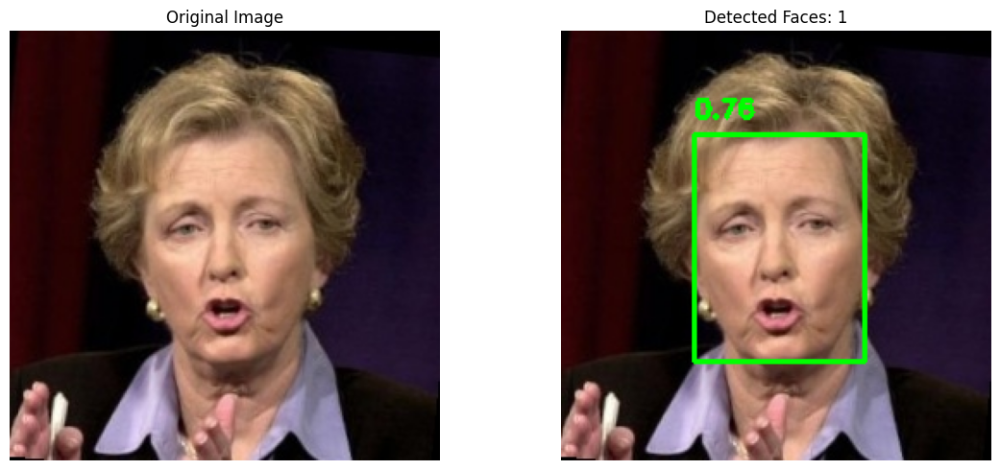


✓ Detected 1 face(s)

Testing on Multiple Sample Images...


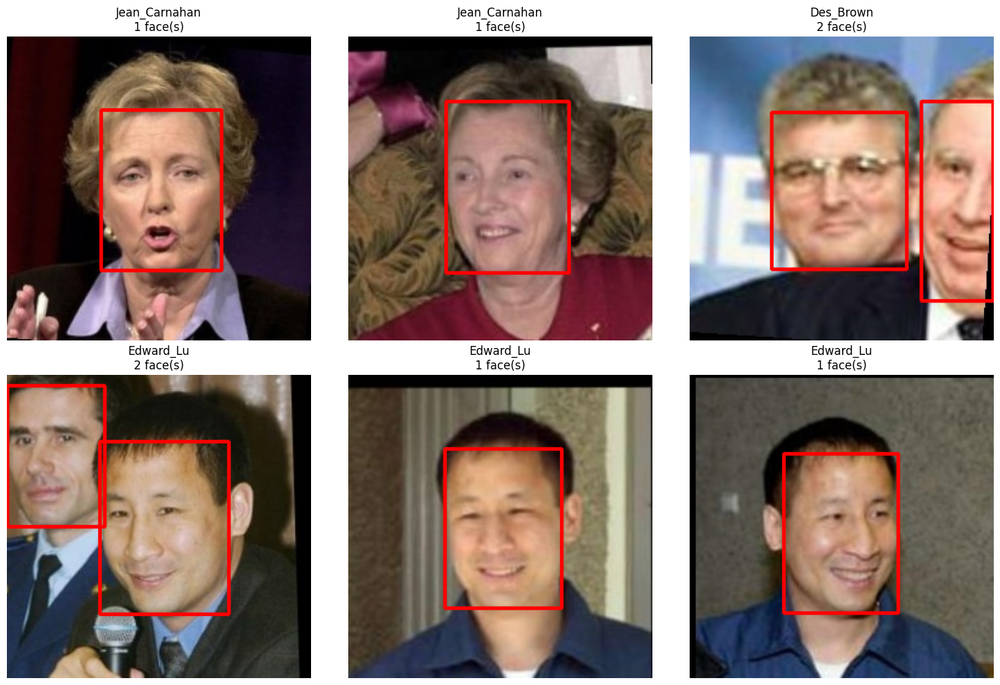

✓ Sample detections completed!

STEP 1 COMPLETE ✓
Dataset loaded: 13233 images from 5749 identities
YOLOv8-Face model loaded successfully
Test detection working properly

Ready for Step 2: Face Detection and Cropping


In [6]:
# ============================================================================
# STEP 1: Load LFW Dataset and YOLOv8-Face Model (STABLE VERSION)
# ============================================================================

import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from ultralytics import YOLO
import warnings
import shutil

# Suppress warnings
warnings.filterwarnings('ignore')

print("Starting Step 1: Loading Dataset and Model...\n")

# ============================================================================
# 1.1: Extract LFW Dataset
# ============================================================================

print("="*60)
print("Extracting LFW Dataset...")
print("="*60)

lfw_tgz_path = '/kaggle/input/lfwpeople/lfw-funneled.tgz'
!tar -xzf {lfw_tgz_path} -C /kaggle/working/

lfw_path = Path('/kaggle/working/lfw_funneled')
if lfw_path.exists():
    print(f"✓ Dataset extracted to: {lfw_path}")
else:
    raise FileNotFoundError("✗ LFW extraction failed!")

# ============================================================================
# 1.2: Explore Dataset Structure
# ============================================================================

print("\n" + "="*60)
print("Dataset Statistics")
print("="*60)

identities = sorted([d for d in lfw_path.iterdir() if d.is_dir()])
total_images = sum(len(list(d.glob('*.jpg'))) for d in identities)

print(f"Total identities: {len(identities)}")
print(f"Total images: {total_images}")

print("\nFirst 10 identities:")
for i, identity in enumerate(identities[:10]):
    num_images = len(list(identity.glob('*.jpg')))
    print(f"  {i+1}. {identity.name}: {num_images} images")

# ============================================================================
# 1.3: Load YOLOv8-Face Model
# ============================================================================

print("\n" + "="*60)
print("Loading YOLOv8-Face Model...")
print("="*60)

model_path = '/kaggle/input/yolov8n/yolov8n-face.pt'
model = YOLO(model_path)
print(f"✓ Model loaded from: {model_path}")

# ============================================================================
# 1.4: Test Detection on Sample Image
# ============================================================================

print("\n" + "="*60)
print("Testing Face Detection on Sample Image...")
print("="*60)

# Sample image
sample_image_path = list(lfw_path.glob('*/*.jpg'))[0]
print(f"Sample image: {sample_image_path}")

# Read and prepare image
image_bgr = cv2.imread(str(sample_image_path))
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
image_rgb = np.ascontiguousarray(image_rgb, dtype=np.uint8)

# Run detection
results = model(image_rgb, conf=0.25, verbose=False)

# Visualization
image_with_boxes = image_rgb.copy()
num_faces = 0
for result in results:
    boxes = result.boxes
    for box in boxes:
        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
        conf = box.conf[0].cpu().numpy()
        cv2.rectangle(image_with_boxes, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2.putText(image_with_boxes, f'{conf:.2f}', (int(x1), int(y1)-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        num_faces += 1

# Display
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
axes[0].imshow(image_rgb)
axes[0].set_title('Original Image')
axes[0].axis('off')
axes[1].imshow(image_with_boxes)
axes[1].set_title(f'Detected Faces: {num_faces}')
axes[1].axis('off')
plt.tight_layout()
plt.show()

print(f"\n✓ Detected {num_faces} face(s)")

# ============================================================================
# 1.5: Test on Multiple Sample Images
# ============================================================================

print("\n" + "="*60)
print("Testing on Multiple Sample Images...")
print("="*60)

sample_images = list(lfw_path.glob('*/*.jpg'))[:6]
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()

for idx, img_path in enumerate(sample_images):
    img_bgr = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_rgb = np.ascontiguousarray(img_rgb, dtype=np.uint8)
    
    results = model(img_rgb, conf=0.25, verbose=False)
    
    image_with_boxes = img_rgb.copy()
    num_faces = 0
    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            conf = box.conf[0].cpu().numpy()
            cv2.rectangle(image_with_boxes, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
            num_faces += 1
    
    axes[idx].imshow(image_with_boxes)
    axes[idx].set_title(f'{img_path.parent.name}\n{num_faces} face(s)')
    axes[idx].axis('off')

plt.tight_layout()
plt.show()

print("✓ Sample detections completed!")

# ============================================================================
# Summary
# ============================================================================

print("\n" + "="*70)
print("STEP 1 COMPLETE ✓")
print("="*70)
print(f"Dataset loaded: {total_images} images from {len(identities)} identities")
print(f"YOLOv8-Face model loaded successfully")
print(f"Test detection working properly")
print("\nReady for Step 2: Face Detection and Cropping")
print("="*70)


# Preprocessing

Step 1: Extracting LFW Dataset...
✓ Dataset extracted to: /kaggle/working/lfw_funneled
Total identities: 5749
Total images: 13233

First 10 identities:
  1. AJ_Cook: 1 images
  2. AJ_Lamas: 1 images
  3. Aaron_Eckhart: 1 images
  4. Aaron_Guiel: 1 images
  5. Aaron_Patterson: 1 images
  6. Aaron_Peirsol: 4 images
  7. Aaron_Pena: 1 images
  8. Aaron_Sorkin: 2 images
  9. Aaron_Tippin: 1 images
  10. Abba_Eban: 1 images

Loading YOLOv8-Face Model...
✓ Model loaded from: /kaggle/input/yolov8n/yolov8n-face.pt

Testing on 6 sample images...


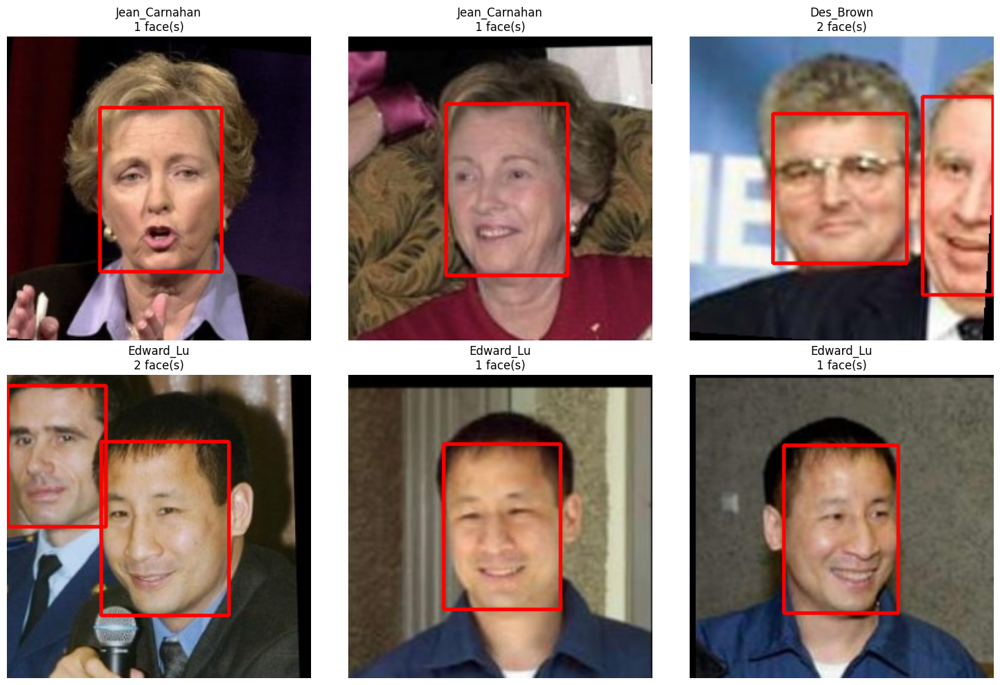


✓ Step 1 Complete


In [7]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from ultralytics import YOLO
import warnings
import shutil

# Suppress warnings
warnings.filterwarnings('ignore')


def run_step1(lfw_tgz_path, yolo_model_path, temp_dir_path='/kaggle/working/temp_images', sample_count=20):
    """
    Step 1: Load LFW dataset, YOLOv8-Face model, and test detections.

    Args:
        lfw_tgz_path (str or Path): Path to the lfw-funneled.tgz file.
        yolo_model_path (str or Path): Path to the YOLOv8-face .pt model.
        temp_dir_path (str or Path): Path to temporary folder for processing.
        sample_count (int): Number of sample images to visualize detections.
    
    Returns:
        tuple: (lfw_path, model, identities, total_images)
    """
    print("="*60)
    print("Step 1: Extracting LFW Dataset...")
    print("="*60)

    # Ensure Path objects
    lfw_tgz_path = Path(lfw_tgz_path)
    temp_dir = Path(temp_dir_path)

    # Extract dataset
    os.makedirs(temp_dir, exist_ok=True)
    !tar -xzf {lfw_tgz_path} -C /kaggle/working/

    lfw_path = Path('/kaggle/working/lfw_funneled')
    if not lfw_path.exists():
        raise FileNotFoundError("LFW extraction failed!")

    # Dataset statistics
    identities = sorted([d for d in lfw_path.iterdir() if d.is_dir()])
    total_images = sum(len(list(identity.glob('*.jpg'))) for identity in identities)

    print(f"✓ Dataset extracted to: {lfw_path}")
    print(f"Total identities: {len(identities)}")
    print(f"Total images: {total_images}")
    print("\nFirst 10 identities:")
    for i, identity in enumerate(identities[:10]):
        print(f"  {i+1}. {identity.name}: {len(list(identity.glob('*.jpg')))} images")

    # Load YOLOv8-face model
    print("\n" + "="*60)
    print("Loading YOLOv8-Face Model...")
    print("="*60)
    model = YOLO(str(yolo_model_path))
    print(f"✓ Model loaded from: {yolo_model_path}")

    # Test detection on a few sample images
    print("\n" + "="*60)
    print(f"Testing on {sample_count} sample images...")
    print("="*60)

    sample_images = list(lfw_path.glob('*/*.jpg'))[:sample_count]
    fig, axes = plt.subplots(2, (sample_count+1)//2, figsize=(15, 10))
    axes = axes.flatten()

    for idx, img_path in enumerate(sample_images):
        temp_img = temp_dir / f'temp_{idx}.jpg'
        shutil.copy(img_path, temp_img)

        # Run detection
        results = model(str(temp_img), conf=0.25, verbose=False)

        # Read and convert image
        img_bgr = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

        # Draw bounding boxes
        num_faces = 0
        for result in results:
            boxes = result.boxes
            for box in boxes:
                x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
                conf = box.conf[0].cpu().numpy()
                cv2.rectangle(img_rgb, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
                num_faces += 1

        axes[idx].imshow(img_rgb)
        axes[idx].set_title(f'{img_path.parent.name}\n{num_faces} face(s)')
        axes[idx].axis('off')

    plt.tight_layout()
    plt.show()

    # Cleanup
    shutil.rmtree(temp_dir)

    print("\n✓ Step 1 Complete")
    return lfw_path, model, identities, total_images


# ===========================
# Example usage
# ===========================

lfw_path, model, identities, total_images = run_step1(
    lfw_tgz_path='/kaggle/input/lfwpeople/lfw-funneled.tgz',
    yolo_model_path='/kaggle/input/yolov8n/yolov8n-face.pt',
    sample_count=6
)


Processing LFW: 100%|██████████| 13233/13233 [03:16<00:00, 67.31it/s]



Processing Complete
{'total': 13233, 'single_face': 10351, 'multiple_faces': 2880, 'no_face': 2}


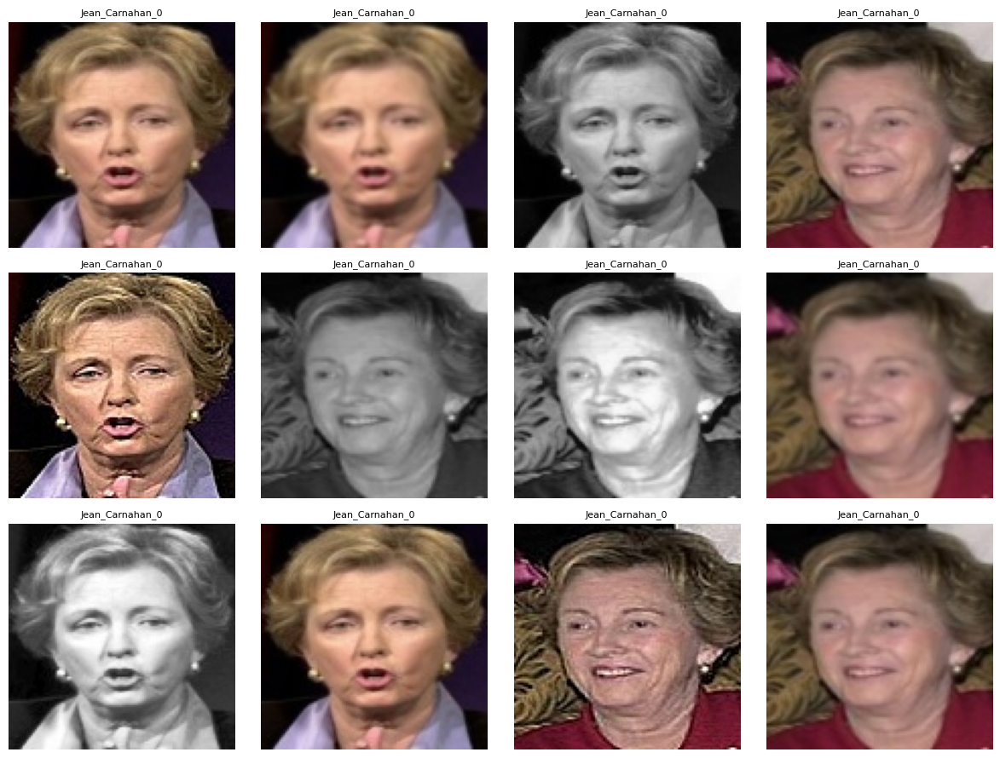

In [8]:
import os
import cv2
import numpy as np
from pathlib import Path
from ultralytics import YOLO
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings('ignore')


# ==========================
# Face Detection & Cropping
# ==========================
def detect_faces(image_path, model, conf_threshold=0.25):
    image = cv2.imread(str(image_path))
    if image is None:
        return None, []
    results = model(image, conf=conf_threshold, verbose=False)
    faces = []
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            conf = box.conf[0].cpu().numpy()
            faces.append((int(x1), int(y1), int(x2), int(y2), float(conf)))
    return image, faces


def crop_face_with_margin(image, bbox, margin=0.3, target_size=(112, 112)):
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    w, h = x2 - x1, y2 - y1
    margin_w, margin_h = int(w * margin), int(h * margin)
    x1_new = max(0, x1 - margin_w)
    y1_new = max(0, y1 - margin_h)
    x2_new = min(image.shape[1], x2 + margin_w)
    y2_new = min(image.shape[0], y2 + margin_h)
    cropped = image[y1_new:y2_new, x1_new:x2_new]
    if cropped.size > 0:
        return cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA)
    else:
        return np.zeros((*target_size[::-1], 3), dtype=np.uint8)


# ==========================
# Preprocessing Techniques
# ==========================
def preprocess_face(face_img):
    """
    Apply multiple preprocessing techniques to a cropped face.
    
    Returns:
        dict: {'original': ..., 'gray': ..., 'hist_eq': ..., 'normalized': ...}
    """
    processed = {}
    
    # Original
    processed['original'] = face_img.copy()
    
    # Grayscale
    gray = cv2.cvtColor(face_img, cv2.COLOR_BGR2GRAY)
    processed['gray'] = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
    
    # Histogram equalization (on grayscale)
    hist_eq = cv2.equalizeHist(gray)
    processed['hist_eq'] = cv2.cvtColor(hist_eq, cv2.COLOR_GRAY2BGR)
    
    # Normalized (0-1 float)
    normalized = face_img.astype(np.float32) / 255.0
    processed['normalized'] = (normalized * 255).astype(np.uint8)
    
    # Optional: Gaussian blur
    processed['blur'] = cv2.GaussianBlur(face_img, (3, 3), 0)
    
    # Optional: Edge enhancement
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    processed['sharpen'] = cv2.filter2D(face_img, -1, kernel)
    
    return processed


# ==========================
# Full Dataset Pipeline
# ==========================
def process_lfw_with_preprocessing(lfw_path, model, output_dir='/kaggle/working/lfw_preprocessed',
                                   margin=0.3, target_size=(112, 112), conf_threshold=0.25):
    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)
    
    images = list(lfw_path.glob('*/*.jpg'))
    stats = {'total': 0, 'single_face': 0, 'multiple_faces': 0, 'no_face': 0}
    
    for img_path in tqdm(images, desc="Processing LFW"):
        stats['total'] += 1
        image, faces = detect_faces(img_path, model, conf_threshold)
        if image is None:
            continue
        
        if len(faces) == 0:
            stats['no_face'] += 1
            # fallback: center crop
            h, w = image.shape[:2]
            cropped = cv2.resize(image[int(h*0.1):int(h*0.9), int(w*0.1):int(w*0.9)], target_size)
        elif len(faces) == 1:
            stats['single_face'] += 1
            cropped = crop_face_with_margin(image, faces[0], margin, target_size)
        else:
            stats['multiple_faces'] += 1
            largest_face = max(faces, key=lambda f: (f[2]-f[0])*(f[3]-f[1]))
            cropped = crop_face_with_margin(image, largest_face, margin, target_size)
        
        # Apply multiple preprocessing
        processed_faces = preprocess_face(cropped)
        
        # Save each processed version
        identity_dir = output_dir / img_path.parent.name
        identity_dir.mkdir(exist_ok=True)
        for key, proc_img in processed_faces.items():
            save_path = identity_dir / f'{img_path.stem}_{key}.jpg'
            cv2.imwrite(str(save_path), proc_img)
    
    print("\nProcessing Complete")
    print(stats)
    return stats


# ==========================
# Example Usage
# ==========================
lfw_folder = '/kaggle/working/lfw_funneled'
output_folder = '/kaggle/working/lfw_preprocessed'

model = YOLO('/kaggle/input/yolov8n/yolov8n-face.pt')
stats = process_lfw_with_preprocessing(lfw_folder, model)

# Optional: visualize a few processed images
def visualize_sample_processed(output_dir, max_images=12):
    images = list(Path(output_dir).glob('*/*.jpg'))[:max_images]
    cols = 4
    rows = (len(images) + cols - 1)//cols
    fig, axes = plt.subplots(rows, cols, figsize=(12, 3*rows))
    axes = axes.flatten()
    for idx, img_path in enumerate(images):
        img = cv2.imread(str(img_path))
        axes[idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axes[idx].set_title(img_path.stem[:15], fontsize=8)
        axes[idx].axis('off')
    for ax in axes[len(images):]:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

visualize_sample_processed(output_folder, max_images=12)


Processing LFW:   0%|          | 11/13233 [00:00<04:16, 51.48it/s]

[SINGLE FACE] Cropped face from Jean_Carnahan_0001.jpg
[SINGLE FACE] Cropped face from Jean_Carnahan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Des_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Lu_0001.jpg
[SINGLE FACE] Cropped face from Edward_Lu_0004.jpg
[SINGLE FACE] Cropped face from Edward_Lu_0005.jpg
[SINGLE FACE] Cropped face from Edward_Lu_0002.jpg
[SINGLE FACE] Cropped face from Edward_Lu_0003.jpg
[SINGLE FACE] Cropped face from Edward_Lu_0006.jpg
[SINGLE FACE] Cropped face from Osama_Al_Baz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dave_Ragone_0001.jpg
[SINGLE FACE] Cropped face from Tim_Allen_0002.jpg
[SINGLE FACE] Cropped face from Tim_Allen_0001.jpg


Processing LFW:   0%|          | 25/13233 [00:00<03:41, 59.57it/s]

[MULTIPLE FACES] Cropped largest face from Tim_Allen_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Allen_0004.jpg
[SINGLE FACE] Cropped face from Jennie_Finch_0001.jpg
[SINGLE FACE] Cropped face from Morris_Dees_0001.jpg
[SINGLE FACE] Cropped face from Teddy_Kollek_0001.jpg
[MULTIPLE FACES] Cropped largest face from Natalia_Dmitrieva_0001.jpg
[SINGLE FACE] Cropped face from Tyler_Grillo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Amanda_Beard_0002.jpg
[SINGLE FACE] Cropped face from Amanda_Beard_0001.jpg
[SINGLE FACE] Cropped face from Vladimir_Voltchkov_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Voltchkov_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Goold_0001.jpg
[SINGLE FACE] Cropped face from Costas_Simitis_0003.jpg
[SINGLE FACE] Cropped face from Costas_Simitis_0002.jpg


Processing LFW:   0%|          | 39/13233 [00:00<03:22, 65.14it/s]

[MULTIPLE FACES] Cropped largest face from Costas_Simitis_0001.jpg
[SINGLE FACE] Cropped face from Costas_Simitis_0005.jpg
[MULTIPLE FACES] Cropped largest face from Costas_Simitis_0004.jpg
[SINGLE FACE] Cropped face from Costas_Simitis_0006.jpg
[SINGLE FACE] Cropped face from Elisabeth_Welch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kelly_Osbourne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hunter_Bates_0001.jpg
[SINGLE FACE] Cropped face from Greg_Owen_0001.jpg
[SINGLE FACE] Cropped face from Greg_Owen_0002.jpg
[SINGLE FACE] Cropped face from Peter_Hollingworth_0001.jpg
[SINGLE FACE] Cropped face from Tara_Kirk_0001.jpg
[SINGLE FACE] Cropped face from Mitt_Romney_0001.jpg
[SINGLE FACE] Cropped face from Chris_Matthews_0001.jpg
[SINGLE FACE] Cropped face from Matt_Roney_0001.jpg
[SINGLE FACE] Cropped face from Aly_Wagner_0001.jpg


Processing LFW:   0%|          | 54/13233 [00:00<03:16, 66.98it/s]

[SINGLE FACE] Cropped face from Urmila_Matondkar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vecdi_Gonul_0001.jpg
[MULTIPLE FACES] Cropped largest face from Felix_Doh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Glenn_Plummer_0001.jpg
[SINGLE FACE] Cropped face from Chen_Tsai-chin_0001.jpg
[SINGLE FACE] Cropped face from Derek_Bond_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Arguelles_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karen_Mok_0002.jpg
[SINGLE FACE] Cropped face from Karen_Mok_0001.jpg
[SINGLE FACE] Cropped face from Vince_Vaughan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jerry_Regier_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jerry_Regier_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Regier_0003.jpg
[SINGLE FACE] Cropped face from Jerry_Regier_0004.jpg


Processing LFW:   1%|          | 68/13233 [00:01<03:14, 67.72it/s]

[SINGLE FACE] Cropped face from Maurice_Papon_0001.jpg
[SINGLE FACE] Cropped face from Michael_Kors_0001.jpg
[SINGLE FACE] Cropped face from Babe_Ruth_0001.jpg
[SINGLE FACE] Cropped face from Sohail_Abbas_0001.jpg
[SINGLE FACE] Cropped face from Christian_Longo_0001.jpg
[SINGLE FACE] Cropped face from Christian_Longo_0003.jpg
[SINGLE FACE] Cropped face from Christian_Longo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lino_Oviedo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lino_Oviedo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lino_Oviedo_0003.jpg
[MULTIPLE FACES] Cropped largest face from Derek_Abney_0001.jpg
[SINGLE FACE] Cropped face from Evgeni_Plushenko_0001.jpg
[SINGLE FACE] Cropped face from Chick_Hearn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chick_Hearn_0003.jpg


Processing LFW:   1%|          | 84/13233 [00:01<03:07, 70.20it/s]

[SINGLE FACE] Cropped face from Chick_Hearn_0002.jpg
[MULTIPLE FACES] Cropped largest face from Liv_Tyler_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Kasyanov_0004.jpg
[SINGLE FACE] Cropped face from Mikhail_Kasyanov_0003.jpg
[SINGLE FACE] Cropped face from Mikhail_Kasyanov_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Kasyanov_0002.jpg
[MULTIPLE FACES] Cropped largest face from Coco_dEste_0001.jpg
[SINGLE FACE] Cropped face from Dan_Ackroyd_0001.jpg
[SINGLE FACE] Cropped face from Cora_Cambell_0001.jpg
[SINGLE FACE] Cropped face from Brenda_van_Dam_0001.jpg
[SINGLE FACE] Cropped face from Pauline_Phillips_0001.jpg
[SINGLE FACE] Cropped face from Robin_Johansen_0001.jpg
[SINGLE FACE] Cropped face from Eddie_Jordan_0001.jpg
[SINGLE FACE] Cropped face from Tammy_Helm_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Cunning_0001.jpg


Processing LFW:   1%|          | 100/13233 [00:01<03:05, 70.75it/s]

[MULTIPLE FACES] Cropped largest face from Paul_Desmarais_0001.jpg
[SINGLE FACE] Cropped face from Nila_Ferran_0001.jpg
[SINGLE FACE] Cropped face from Sebastian_Cuattrin_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Alba_0002.jpg
[SINGLE FACE] Cropped face from Jessica_Alba_0001.jpg
[SINGLE FACE] Cropped face from Prem_Kumar_Nair_0001.jpg
[SINGLE FACE] Cropped face from Magui_Serna_0001.jpg
[SINGLE FACE] Cropped face from Magui_Serna_0002.jpg
[MULTIPLE FACES] Cropped largest face from Park_Na-kyong_0001.jpg
[SINGLE FACE] Cropped face from Craig_David_0001.jpg
[SINGLE FACE] Cropped face from Mario_Gallegos_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Kozlowski_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Kozlowski_0002.jpg
[MULTIPLE FACES] Cropped largest face from Marcus_Garrettson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Pujols_0001.jpg


Processing LFW:   1%|          | 108/13233 [00:01<03:06, 70.55it/s]

[SINGLE FACE] Cropped face from Gregory_Geoffroy_0001.jpg
[SINGLE FACE] Cropped face from Gregory_Geoffroy_0002.jpg
[SINGLE FACE] Cropped face from Dan_Dickau_0001.jpg
[SINGLE FACE] Cropped face from James_Kelly_0010.jpg
[SINGLE FACE] Cropped face from James_Kelly_0003.jpg
[SINGLE FACE] Cropped face from James_Kelly_0002.jpg
[SINGLE FACE] Cropped face from James_Kelly_0006.jpg
[SINGLE FACE] Cropped face from James_Kelly_0004.jpg
[SINGLE FACE] Cropped face from James_Kelly_0007.jpg
[SINGLE FACE] Cropped face from James_Kelly_0011.jpg
[SINGLE FACE] Cropped face from James_Kelly_0008.jpg
[SINGLE FACE] Cropped face from James_Kelly_0009.jpg
[SINGLE FACE] Cropped face from James_Kelly_0005.jpg
[SINGLE FACE] Cropped face from James_Kelly_0001.jpg


Processing LFW:   1%|          | 123/13233 [00:01<03:15, 67.18it/s]

[SINGLE FACE] Cropped face from Adriana_Perez_Navarro_0001.jpg
[SINGLE FACE] Cropped face from Maria_Callas_0001.jpg
[SINGLE FACE] Cropped face from Lawrence_Di_Rita_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_Franklin_0001.jpg
[SINGLE FACE] Cropped face from Keith_Olbermann_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lili_Marinho_0001.jpg
[SINGLE FACE] Cropped face from Steve_Valentine_0001.jpg
[MULTIPLE FACES] Cropped largest face from Emmanuelle_Jagodsinski_0001.jpg
[SINGLE FACE] Cropped face from Ciro_Gomes_0001.jpg
[SINGLE FACE] Cropped face from Ciro_Gomes_0003.jpg
[SINGLE FACE] Cropped face from Ciro_Gomes_0005.jpg
[SINGLE FACE] Cropped face from Ciro_Gomes_0004.jpg
[SINGLE FACE] Cropped face from Ciro_Gomes_0002.jpg
[SINGLE FACE] Cropped face from Eric_Snow_0001.jpg


Processing LFW:   1%|          | 137/13233 [00:02<03:23, 64.22it/s]

[SINGLE FACE] Cropped face from Luis_Ernesto_Derbez_Bautista_0001.jpg
[SINGLE FACE] Cropped face from Luis_Ernesto_Derbez_Bautista_0003.jpg
[SINGLE FACE] Cropped face from Luis_Ernesto_Derbez_Bautista_0006.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Ernesto_Derbez_Bautista_0002.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Ernesto_Derbez_Bautista_0004.jpg
[SINGLE FACE] Cropped face from Luis_Ernesto_Derbez_Bautista_0005.jpg
[MULTIPLE FACES] Cropped largest face from Pamela_Melroy_0001.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0008.jpg
[MULTIPLE FACES] Cropped largest face from Mahathir_Mohamad_0009.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0007.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0011.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0014.jpg
[MULTIPLE FACES] Cropped largest face from Mahathir_Mohamad_0003.jpg


Processing LFW:   1%|          | 151/13233 [00:02<03:18, 65.81it/s]

[SINGLE FACE] Cropped face from Mahathir_Mohamad_0001.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0010.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0006.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0012.jpg
[SINGLE FACE] Cropped face from Mahathir_Mohamad_0013.jpg
[MULTIPLE FACES] Cropped largest face from Mahathir_Mohamad_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mahathir_Mohamad_0005.jpg
[MULTIPLE FACES] Cropped largest face from Mahathir_Mohamad_0004.jpg
[SINGLE FACE] Cropped face from Tim_Curley_0001.jpg
[SINGLE FACE] Cropped face from Cosmo_Iacavazzi_0001.jpg
[SINGLE FACE] Cropped face from Charles_Pickering_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Caroline_0002.jpg
[SINGLE FACE] Cropped face from Princess_Caroline_0005.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Caroline_0004.jpg


Processing LFW:   1%|          | 165/13233 [00:02<03:16, 66.53it/s]

[MULTIPLE FACES] Cropped largest face from Princess_Caroline_0003.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Caroline_0001.jpg
[SINGLE FACE] Cropped face from Johannes_Rau_0001.jpg
[SINGLE FACE] Cropped face from George_Robertson_0010.jpg
[SINGLE FACE] Cropped face from George_Robertson_0014.jpg
[SINGLE FACE] Cropped face from George_Robertson_0006.jpg
[SINGLE FACE] Cropped face from George_Robertson_0002.jpg
[SINGLE FACE] Cropped face from George_Robertson_0009.jpg
[SINGLE FACE] Cropped face from George_Robertson_0004.jpg
[SINGLE FACE] Cropped face from George_Robertson_0001.jpg
[MULTIPLE FACES] Cropped largest face from George_Robertson_0018.jpg
[SINGLE FACE] Cropped face from George_Robertson_0017.jpg
[SINGLE FACE] Cropped face from George_Robertson_0007.jpg
[SINGLE FACE] Cropped face from George_Robertson_0021.jpg


Processing LFW:   1%|▏         | 179/13233 [00:02<03:13, 67.40it/s]

[SINGLE FACE] Cropped face from George_Robertson_0015.jpg
[MULTIPLE FACES] Cropped largest face from George_Robertson_0022.jpg
[SINGLE FACE] Cropped face from George_Robertson_0013.jpg
[MULTIPLE FACES] Cropped largest face from George_Robertson_0003.jpg
[SINGLE FACE] Cropped face from George_Robertson_0016.jpg
[SINGLE FACE] Cropped face from George_Robertson_0005.jpg
[SINGLE FACE] Cropped face from George_Robertson_0011.jpg
[SINGLE FACE] Cropped face from George_Robertson_0019.jpg
[SINGLE FACE] Cropped face from George_Robertson_0012.jpg
[SINGLE FACE] Cropped face from George_Robertson_0008.jpg
[SINGLE FACE] Cropped face from George_Robertson_0020.jpg
[SINGLE FACE] Cropped face from Ronde_Barber_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Doba_0001.jpg
[SINGLE FACE] Cropped face from Hal_McCoy_0001.jpg


Processing LFW:   1%|▏         | 195/13233 [00:02<03:06, 70.02it/s]

[SINGLE FACE] Cropped face from Sophie_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Abizaid_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Abizaid_0005.jpg
[SINGLE FACE] Cropped face from John_Abizaid_0004.jpg
[SINGLE FACE] Cropped face from John_Abizaid_0006.jpg
[SINGLE FACE] Cropped face from John_Abizaid_0008.jpg
[MULTIPLE FACES] Cropped largest face from John_Abizaid_0007.jpg
[MULTIPLE FACES] Cropped largest face from John_Abizaid_0009.jpg
[SINGLE FACE] Cropped face from John_Abizaid_0003.jpg
[SINGLE FACE] Cropped face from John_Abizaid_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mehmet_Ali_Sahin_0001.jpg
[SINGLE FACE] Cropped face from Richard_Carl_0001.jpg
[SINGLE FACE] Cropped face from Craig_Morgan_0001.jpg
[SINGLE FACE] Cropped face from Mike_Bryan_0001.jpg
[SINGLE FACE] Cropped face from Takashi_Yamamoto_0001.jpg


Processing LFW:   2%|▏         | 211/13233 [00:03<03:01, 71.91it/s]

[SINGLE FACE] Cropped face from Stephen_Crampton_0001.jpg
[SINGLE FACE] Cropped face from Severino_Antinori_0001.jpg
[SINGLE FACE] Cropped face from Didier_Defago_0001.jpg
[SINGLE FACE] Cropped face from Jen_Schefft_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Burnett_0001.jpg
[SINGLE FACE] Cropped face from John_Baldacci_0001.jpg
[SINGLE FACE] Cropped face from Haydar_Aliyev_0001.jpg
[SINGLE FACE] Cropped face from Marcella_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Luis_Gonzalez_0001.jpg
[SINGLE FACE] Cropped face from Abbas_Kiarostami_0001.jpg
[SINGLE FACE] Cropped face from Tom_Sizemore_0001.jpg
[SINGLE FACE] Cropped face from Christina_Aguilera_0003.jpg
[SINGLE FACE] Cropped face from Christina_Aguilera_0004.jpg
[SINGLE FACE] Cropped face from Christina_Aguilera_0002.jpg
[SINGLE FACE] Cropped face from Christina_Aguilera_0001.jpg


Processing LFW:   2%|▏         | 227/13233 [00:03<03:04, 70.41it/s]

[SINGLE FACE] Cropped face from Warren_Granados_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlo_Azeglio_Ciampi_0001.jpg
[SINGLE FACE] Cropped face from Rod_Thorn_0001.jpg
[SINGLE FACE] Cropped face from Toshi_Izawa_0001.jpg
[SINGLE FACE] Cropped face from Elliott_Mincberg_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Doerger_0001.jpg
[SINGLE FACE] Cropped face from Kim_Yun-kyu_0001.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0011.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0002.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0008.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0009.jpg
[MULTIPLE FACES] Cropped largest face from Sergey_Lavrov_0006.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0003.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0010.jpg


Processing LFW:   2%|▏         | 235/13233 [00:03<03:08, 68.93it/s]

[SINGLE FACE] Cropped face from Sergey_Lavrov_0007.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0001.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0004.jpg
[SINGLE FACE] Cropped face from Sergey_Lavrov_0005.jpg
[SINGLE FACE] Cropped face from Teruaki_Masumoto_0001.jpg
[SINGLE FACE] Cropped face from James_Ballenger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_Van_Essen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marina_Anissina_0002.jpg
[SINGLE FACE] Cropped face from Marina_Anissina_0001.jpg
[SINGLE FACE] Cropped face from Edwin_Edwards_0002.jpg
[MULTIPLE FACES] Cropped largest face from Edwin_Edwards_0003.jpg
[SINGLE FACE] Cropped face from Edwin_Edwards_0001.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0007.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0001.jpg


Processing LFW:   2%|▏         | 249/13233 [00:03<03:18, 65.51it/s]

[SINGLE FACE] Cropped face from Al_Sharpton_0005.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0002.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0004.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0003.jpg
[SINGLE FACE] Cropped face from Al_Sharpton_0006.jpg
[MULTIPLE FACES] Cropped largest face from Stan_Kasten_0001.jpg
[MULTIPLE FACES] Cropped largest face from Fruit_Chan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yusaku_Miyazato_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roberto_Canessa_0001.jpg
[SINGLE FACE] Cropped face from Jack_Osbourne_0001.jpg
[SINGLE FACE] Cropped face from David_McCullough_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Marc_Olive_0001.jpg
[SINGLE FACE] Cropped face from Mike_Price_0002.jpg


Processing LFW:   2%|▏         | 263/13233 [00:03<03:19, 65.02it/s]

[SINGLE FACE] Cropped face from Mike_Price_0001.jpg
[SINGLE FACE] Cropped face from Lorraine_Bracco_0001.jpg
[SINGLE FACE] Cropped face from Hichiro_Naemura_0002.jpg
[SINGLE FACE] Cropped face from Hichiro_Naemura_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Towne_0001.jpg
[SINGLE FACE] Cropped face from Reggie_Miller_0001.jpg
[SINGLE FACE] Cropped face from Reggie_Miller_0002.jpg
[MULTIPLE FACES] Cropped largest face from Sarah_Wynter_0001.jpg
[SINGLE FACE] Cropped face from Rob_Moore_0001.jpg
[SINGLE FACE] Cropped face from Prince_Harry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Harry_0003.jpg
[SINGLE FACE] Cropped face from Prince_Harry_0002.jpg
[SINGLE FACE] Cropped face from Frank_Pallone_0001.jpg
[SINGLE FACE] Cropped face from Gregory_Peck_0001.jpg


Processing LFW:   2%|▏         | 279/13233 [00:04<03:11, 67.66it/s]

[SINGLE FACE] Cropped face from Shania_Twain_0001.jpg
[SINGLE FACE] Cropped face from David_Beckham_0029.jpg
[SINGLE FACE] Cropped face from David_Beckham_0015.jpg
[SINGLE FACE] Cropped face from David_Beckham_0010.jpg
[SINGLE FACE] Cropped face from David_Beckham_0005.jpg
[SINGLE FACE] Cropped face from David_Beckham_0018.jpg
[SINGLE FACE] Cropped face from David_Beckham_0011.jpg
[SINGLE FACE] Cropped face from David_Beckham_0016.jpg
[MULTIPLE FACES] Cropped largest face from David_Beckham_0003.jpg
[SINGLE FACE] Cropped face from David_Beckham_0028.jpg
[SINGLE FACE] Cropped face from David_Beckham_0014.jpg
[SINGLE FACE] Cropped face from David_Beckham_0019.jpg
[SINGLE FACE] Cropped face from David_Beckham_0021.jpg
[SINGLE FACE] Cropped face from David_Beckham_0001.jpg


Processing LFW:   2%|▏         | 293/13233 [00:04<03:09, 68.36it/s]

[MULTIPLE FACES] Cropped largest face from David_Beckham_0024.jpg
[SINGLE FACE] Cropped face from David_Beckham_0008.jpg
[SINGLE FACE] Cropped face from David_Beckham_0026.jpg
[SINGLE FACE] Cropped face from David_Beckham_0031.jpg
[MULTIPLE FACES] Cropped largest face from David_Beckham_0020.jpg
[SINGLE FACE] Cropped face from David_Beckham_0025.jpg
[SINGLE FACE] Cropped face from David_Beckham_0027.jpg
[SINGLE FACE] Cropped face from David_Beckham_0022.jpg
[SINGLE FACE] Cropped face from David_Beckham_0009.jpg
[SINGLE FACE] Cropped face from David_Beckham_0004.jpg
[SINGLE FACE] Cropped face from David_Beckham_0013.jpg
[SINGLE FACE] Cropped face from David_Beckham_0007.jpg
[SINGLE FACE] Cropped face from David_Beckham_0012.jpg
[SINGLE FACE] Cropped face from David_Beckham_0023.jpg
[SINGLE FACE] Cropped face from David_Beckham_0017.jpg


Processing LFW:   2%|▏         | 309/13233 [00:04<03:03, 70.37it/s]

[MULTIPLE FACES] Cropped largest face from David_Beckham_0030.jpg
[SINGLE FACE] Cropped face from David_Beckham_0002.jpg
[SINGLE FACE] Cropped face from David_Beckham_0006.jpg
[SINGLE FACE] Cropped face from Lionel_Chalmers_0001.jpg
[SINGLE FACE] Cropped face from Kajsa_Bergqvist_0001.jpg
[SINGLE FACE] Cropped face from Eunice_Barber_0002.jpg
[SINGLE FACE] Cropped face from Eunice_Barber_0001.jpg
[SINGLE FACE] Cropped face from Connie_Chung_0001.jpg
[SINGLE FACE] Cropped face from Keith_Bishop_Jr_0001.jpg
[SINGLE FACE] Cropped face from Isabelle_Huppert_0001.jpg
[SINGLE FACE] Cropped face from Isabelle_Huppert_0002.jpg
[MULTIPLE FACES] Cropped largest face from David_Dorfman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Makhdoom_Amin_Fahim_0002.jpg
[MULTIPLE FACES] Cropped largest face from Makhdoom_Amin_Fahim_0001.jpg
[SINGLE FACE] Cropped face from Makhdoom_Amin_Fahim_0003.jpg


Processing LFW:   2%|▏         | 325/13233 [00:04<03:01, 71.16it/s]

[SINGLE FACE] Cropped face from Thor_Pedersen_0001.jpg
[SINGLE FACE] Cropped face from Steven_Kinlock_0001.jpg
[SINGLE FACE] Cropped face from Russell_Crowe_0002.jpg
[MULTIPLE FACES] Cropped largest face from Russell_Crowe_0001.jpg
[SINGLE FACE] Cropped face from Wilson_Alvarez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nancy_Sinatra_0002.jpg
[SINGLE FACE] Cropped face from Nancy_Sinatra_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Chin_0001.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0033.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0005.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0025.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0015.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0016.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0022.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0037.jpg


Processing LFW:   3%|▎         | 340/13233 [00:05<03:11, 67.39it/s]

[SINGLE FACE] Cropped face from Nestor_Kirchner_0010.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0017.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0029.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0006.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0028.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0023.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0004.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0007.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0003.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0034.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0012.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0021.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0031.jpg


Processing LFW:   3%|▎         | 347/13233 [00:05<03:16, 65.73it/s]

[SINGLE FACE] Cropped face from Nestor_Kirchner_0009.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0002.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0030.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0024.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0020.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0013.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0001.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0026.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0014.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0027.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0011.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0008.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0032.jpg


Processing LFW:   3%|▎         | 361/13233 [00:05<03:18, 64.82it/s]

[SINGLE FACE] Cropped face from Nestor_Kirchner_0019.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0035.jpg
[MULTIPLE FACES] Cropped largest face from Nestor_Kirchner_0036.jpg
[SINGLE FACE] Cropped face from Nestor_Kirchner_0018.jpg
[SINGLE FACE] Cropped face from Kong_Quan_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Woodgate_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Matheson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Allan_Houston_0001.jpg
[SINGLE FACE] Cropped face from David_Millar_0001.jpg
[SINGLE FACE] Cropped face from Omar_Khan_Sharif_0001.jpg
[SINGLE FACE] Cropped face from Ray_Lucas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Regan_0001.jpg
[SINGLE FACE] Cropped face from Horacio_de_Jesus_Montoya_0001.jpg


Processing LFW:   3%|▎         | 375/13233 [00:05<03:17, 65.12it/s]

[SINGLE FACE] Cropped face from Rebecca_Romijn-Stamos_0002.jpg
[SINGLE FACE] Cropped face from Rebecca_Romijn-Stamos_0003.jpg
[MULTIPLE FACES] Cropped largest face from Rebecca_Romijn-Stamos_0004.jpg
[MULTIPLE FACES] Cropped largest face from Rebecca_Romijn-Stamos_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Kurtzer_0001.jpg
[SINGLE FACE] Cropped face from Mary_Blige_0001.jpg
[SINGLE FACE] Cropped face from Aiysha_Smith_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karen_Allen_0001.jpg
[SINGLE FACE] Cropped face from Jeff_Van_Gundy_0003.jpg
[SINGLE FACE] Cropped face from Jeff_Van_Gundy_0001.jpg
[SINGLE FACE] Cropped face from Jeff_Van_Gundy_0002.jpg
[SINGLE FACE] Cropped face from Amy_Smart_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Perelman_0001.jpg
[SINGLE FACE] Cropped face from Shi_Guangsheng_0001.jpg


Processing LFW:   3%|▎         | 389/13233 [00:05<03:10, 67.36it/s]

[SINGLE FACE] Cropped face from Bill_Gates_0013.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0016.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0009.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0001.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0015.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0005.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0017.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0006.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0012.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0008.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0010.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0014.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Gates_0004.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0003.jpg


Processing LFW:   3%|▎         | 404/13233 [00:06<03:18, 64.72it/s]

[SINGLE FACE] Cropped face from Bill_Gates_0007.jpg
[SINGLE FACE] Cropped face from Bill_Gates_0011.jpg
[SINGLE FACE] Cropped face from Normand_Legault_0001.jpg
[SINGLE FACE] Cropped face from Tony_Parker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Parker_0002.jpg
[SINGLE FACE] Cropped face from Franz_Beckenbauer_0002.jpg
[SINGLE FACE] Cropped face from Franz_Beckenbauer_0001.jpg
[SINGLE FACE] Cropped face from Clint_Howard_0001.jpg
[SINGLE FACE] Cropped face from Michael_Piuze_0001.jpg
[SINGLE FACE] Cropped face from Khaled_Sawalhi_0001.jpg
[SINGLE FACE] Cropped face from Marina_Kuptsova_0001.jpg
[SINGLE FACE] Cropped face from Gonzalo_Barrientos_0001.jpg
[SINGLE FACE] Cropped face from Donny_Osmond_0001.jpg


Processing LFW:   3%|▎         | 418/13233 [00:06<03:11, 66.95it/s]

[SINGLE FACE] Cropped face from David_Caraway_0001.jpg
[SINGLE FACE] Cropped face from David_Caraway_0002.jpg
[SINGLE FACE] Cropped face from Bob_Krueger_0001.jpg
[SINGLE FACE] Cropped face from Monica_Serra_0001.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0017.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0015.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0009.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0002.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0011.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0001.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0008.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0003.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0004.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0006.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0013.jpg


Processing LFW:   3%|▎         | 434/13233 [00:06<03:03, 69.62it/s]

[SINGLE FACE] Cropped face from Abdullah_Gul_0005.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0019.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0014.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0018.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0012.jpg
[SINGLE FACE] Cropped face from Abdullah_Gul_0007.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0010.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_Gul_0016.jpg
[SINGLE FACE] Cropped face from Keith_Van_Horn_0001.jpg
[SINGLE FACE] Cropped face from Mauricio_Macri_0001.jpg
[SINGLE FACE] Cropped face from Michael_Caine_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Caine_0004.jpg
[SINGLE FACE] Cropped face from Michael_Caine_0003.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Caine_0001.jpg
[SINGLE FACE] Cropped face from Heather_Whitestone_McCallum_0001.jpg


Processing LFW:   3%|▎         | 450/13233 [00:06<03:02, 69.89it/s]

[MULTIPLE FACES] Cropped largest face from Robbie_Naish_0001.jpg
[SINGLE FACE] Cropped face from Bartosz_Kizierowski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Moore_0001.jpg
[SINGLE FACE] Cropped face from Michael_Moore_0003.jpg
[SINGLE FACE] Cropped face from Michael_Moore_0002.jpg
[SINGLE FACE] Cropped face from Carrie-Anne_Moss_0004.jpg
[MULTIPLE FACES] Cropped largest face from Carrie-Anne_Moss_0003.jpg
[SINGLE FACE] Cropped face from Carrie-Anne_Moss_0002.jpg
[MULTIPLE FACES] Cropped largest face from Carrie-Anne_Moss_0005.jpg
[MULTIPLE FACES] Cropped largest face from Carrie-Anne_Moss_0001.jpg
[SINGLE FACE] Cropped face from Mike_Gable_0001.jpg
[SINGLE FACE] Cropped face from Sybille_Schmid_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marco_Irizarry_0001.jpg
[SINGLE FACE] Cropped face from Suzanne_Gaudet_0001.jpg


Processing LFW:   4%|▎         | 464/13233 [00:06<03:13, 65.88it/s]

[SINGLE FACE] Cropped face from Suzanne_Gaudet_0002.jpg
[SINGLE FACE] Cropped face from Georgia_Giddings_0001.jpg
[SINGLE FACE] Cropped face from Jeff_Schiffner_0001.jpg
[SINGLE FACE] Cropped face from Keith_Osik_0001.jpg
[SINGLE FACE] Cropped face from Mirela_Manjani_0001.jpg
[SINGLE FACE] Cropped face from Gunilla_Backman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Seymour_Cassell_0001.jpg
[SINGLE FACE] Cropped face from Nate_Blackwell_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Niccol_0002.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Niccol_0001.jpg
[SINGLE FACE] Cropped face from Tian_Zhuang_Zhuang_0001.jpg
[SINGLE FACE] Cropped face from Pete_Beaudrault_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Leach_0001.jpg


Processing LFW:   4%|▎         | 478/13233 [00:07<03:18, 64.18it/s]

[SINGLE FACE] Cropped face from Wilfredo_Moreno_0001.jpg
[SINGLE FACE] Cropped face from Jeffery_Strelzin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Pawlenty_0001.jpg
[SINGLE FACE] Cropped face from Paul_Ebert_0001.jpg
[SINGLE FACE] Cropped face from Dexter_Jackson_0001.jpg
[SINGLE FACE] Cropped face from Dexter_Jackson_0002.jpg
[SINGLE FACE] Cropped face from Alexandra_Pelosi_0001.jpg
[SINGLE FACE] Cropped face from Mark_Hamister_0002.jpg
[SINGLE FACE] Cropped face from Mark_Hamister_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jessica_Lange_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Lange_0002.jpg
[SINGLE FACE] Cropped face from Nick_Nolte_0003.jpg
[SINGLE FACE] Cropped face from Nick_Nolte_0001.jpg


Processing LFW:   4%|▎         | 492/13233 [00:07<03:15, 65.17it/s]

[SINGLE FACE] Cropped face from Nick_Nolte_0005.jpg
[MULTIPLE FACES] Cropped largest face from Nick_Nolte_0004.jpg
[MULTIPLE FACES] Cropped largest face from Nick_Nolte_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Wong_0001.jpg
[SINGLE FACE] Cropped face from Terry_Hoeppner_0001.jpg
[SINGLE FACE] Cropped face from John_Ferguson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patrick_McEnroe_0002.jpg
[SINGLE FACE] Cropped face from Patrick_McEnroe_0001.jpg
[SINGLE FACE] Cropped face from Ryan_Newman_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Marie_Presley_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Marie_Presley_0002.jpg
[SINGLE FACE] Cropped face from Lisa_Marie_Presley_0004.jpg
[SINGLE FACE] Cropped face from Lisa_Marie_Presley_0003.jpg
[MULTIPLE FACES] Cropped largest face from Evander_Holyfield_0002.jpg


Processing LFW:   4%|▍         | 499/13233 [00:07<03:11, 66.37it/s]

[SINGLE FACE] Cropped face from Evander_Holyfield_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Quayle_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Landry_0003.jpg
[SINGLE FACE] Cropped face from Bernard_Landry_0004.jpg
[MULTIPLE FACES] Cropped largest face from Bernard_Landry_0002.jpg
[SINGLE FACE] Cropped face from Bernard_Landry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Bachelet_0001.jpg
[SINGLE FACE] Cropped face from Enos_Slaughter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cecilia_Cheung_0001.jpg
[SINGLE FACE] Cropped face from Will_Ferrell_0001.jpg
[SINGLE FACE] Cropped face from Allen_Iverson_0001.jpg
[SINGLE FACE] Cropped face from Allen_Iverson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Farouk_al-Sharaa_0001.jpg
[SINGLE FACE] Cropped face from Farouk_al-Sharaa_0003.jpg
[SINGLE FACE] Cropped face from Farouk_al-Sharaa_0002.jpg


Processing LFW:   4%|▍         | 521/13233 [00:07<03:08, 67.52it/s]

[SINGLE FACE] Cropped face from Ben_Stein_0001.jpg
[SINGLE FACE] Cropped face from James_Kopp_0002.jpg
[SINGLE FACE] Cropped face from James_Kopp_0003.jpg
[SINGLE FACE] Cropped face from James_Kopp_0004.jpg
[SINGLE FACE] Cropped face from James_Kopp_0001.jpg
[SINGLE FACE] Cropped face from Fabiola_Zuluaga_0002.jpg
[SINGLE FACE] Cropped face from Fabiola_Zuluaga_0001.jpg
[SINGLE FACE] Cropped face from Cristina_Torrens_Valero_0001.jpg
[SINGLE FACE] Cropped face from Kiki_Vandeweghe_0001.jpg
[SINGLE FACE] Cropped face from Kiki_Vandeweghe_0002.jpg
[SINGLE FACE] Cropped face from Stacy_Dragila_0001.jpg
[SINGLE FACE] Cropped face from Stacy_Dragila_0002.jpg
[SINGLE FACE] Cropped face from Rohinton_Mistry_0001.jpg
[SINGLE FACE] Cropped face from Larry_Hahn_0001.jpg


Processing LFW:   4%|▍         | 529/13233 [00:07<03:03, 69.06it/s]

[SINGLE FACE] Cropped face from James_Hughes_0001.jpg
[SINGLE FACE] Cropped face from Judi_Patton_0001.jpg
[SINGLE FACE] Cropped face from Phil_Morris_0001.jpg
[SINGLE FACE] Cropped face from Nick_Cassavetes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jan_De_Bont_0001.jpg
[SINGLE FACE] Cropped face from Paul_Brandt_0001.jpg
[SINGLE FACE] Cropped face from John_Nimmo_0001.jpg
[SINGLE FACE] Cropped face from Terrence_Kiel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Wellstone_0002.jpg
[SINGLE FACE] Cropped face from Paul_Wellstone_0001.jpg
[SINGLE FACE] Cropped face from Paul_Wellstone_0003.jpg
[SINGLE FACE] Cropped face from Sharon_Robinson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rubens_Barrichello_0006.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0005.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0007.jpg


Processing LFW:   4%|▍         | 545/13233 [00:08<03:00, 70.35it/s]

[SINGLE FACE] Cropped face from Rubens_Barrichello_0012.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0008.jpg
[MULTIPLE FACES] Cropped largest face from Rubens_Barrichello_0009.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0004.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0011.jpg
[MULTIPLE FACES] Cropped largest face from Rubens_Barrichello_0003.jpg
[MULTIPLE FACES] Cropped largest face from Rubens_Barrichello_0002.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0001.jpg
[SINGLE FACE] Cropped face from Rubens_Barrichello_0010.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Shelby_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stellan_Skarsgard_0001.jpg
[SINGLE FACE] Cropped face from Stellan_Skarsgard_0002.jpg
[SINGLE FACE] Cropped face from Alma_Powell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Gilman_0001.jpg
[SINGLE FACE] Cropped face from Mile_Mrksic_0001.jpg


Processing LFW:   4%|▍         | 561/13233 [00:08<02:55, 72.02it/s]

[SINGLE FACE] Cropped face from Holly_Hunter_0002.jpg
[SINGLE FACE] Cropped face from Holly_Hunter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Holly_Hunter_0007.jpg
[SINGLE FACE] Cropped face from Holly_Hunter_0005.jpg
[SINGLE FACE] Cropped face from Holly_Hunter_0006.jpg
[MULTIPLE FACES] Cropped largest face from Holly_Hunter_0004.jpg
[SINGLE FACE] Cropped face from Holly_Hunter_0003.jpg
[SINGLE FACE] Cropped face from Guangdong_Ou_Guangyuan_0001.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0021.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0030.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0004.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0010.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0039.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0006.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0008.jpg


Processing LFW:   4%|▍         | 577/13233 [00:08<02:55, 72.26it/s]

[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0033.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0029.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0037.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0025.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0031.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0007.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0026.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0040.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0020.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0023.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0005.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0041.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0019.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0027.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegge

Processing LFW:   4%|▍         | 593/13233 [00:08<03:03, 68.97it/s]

[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0018.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0028.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0014.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0042.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0002.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0012.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0011.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0003.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0032.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0013.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0016.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0022.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0036.jpg
[MULTIPLE FACES] Cropped largest face from Arnold_Schwarzenegger_0001.jpg


Processing LFW:   5%|▍         | 607/13233 [00:09<03:11, 65.97it/s]

[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0009.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0024.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0038.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0017.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0015.jpg
[SINGLE FACE] Cropped face from Arnold_Schwarzenegger_0034.jpg
[SINGLE FACE] Cropped face from Kosuke_Kitajima_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kosuke_Kitajima_0002.jpg
[SINGLE FACE] Cropped face from Peter_Rasch_0001.jpg
[SINGLE FACE] Cropped face from Donald_Evans_0001.jpg
[SINGLE FACE] Cropped face from Donald_Evans_0002.jpg
[SINGLE FACE] Cropped face from Valdas_Adamkus_0002.jpg
[SINGLE FACE] Cropped face from Valdas_Adamkus_0001.jpg


Processing LFW:   5%|▍         | 621/13233 [00:09<03:09, 66.61it/s]

[SINGLE FACE] Cropped face from Jack_Smith_0001.jpg
[MULTIPLE FACES] Cropped largest face from Horacio_Julio_Pina_0001.jpg
[SINGLE FACE] Cropped face from Jean-Sebastien_Giguere_0001.jpg
[SINGLE FACE] Cropped face from Jean-Sebastien_Giguere_0002.jpg
[SINGLE FACE] Cropped face from Alvaro_Silva_Calderon_0003.jpg
[SINGLE FACE] Cropped face from Alvaro_Silva_Calderon_0004.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Silva_Calderon_0002.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Silva_Calderon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sanja_Papic_0001.jpg
[SINGLE FACE] Cropped face from Jason_Biggs_0001.jpg
[SINGLE FACE] Cropped face from Darryl_McDaniels_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ivo_Dubs_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Dam_0001.jpg
[SINGLE FACE] Cropped face from Joanne_Duquette_0001.jpg


Processing LFW:   5%|▍         | 637/13233 [00:09<03:01, 69.48it/s]

[SINGLE FACE] Cropped face from Lim_Dong-won_0002.jpg
[SINGLE FACE] Cropped face from Lim_Dong-won_0001.jpg
[SINGLE FACE] Cropped face from Helio_Rubens_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Sebastien_Grosjean_0003.jpg
[SINGLE FACE] Cropped face from Sebastien_Grosjean_0002.jpg
[SINGLE FACE] Cropped face from Sebastien_Grosjean_0001.jpg
[SINGLE FACE] Cropped face from Sebastien_Grosjean_0004.jpg
[SINGLE FACE] Cropped face from Giuseppe_Morchio_0001.jpg
[SINGLE FACE] Cropped face from Dawn_Staley_0001.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0005.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0002.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0001.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0003.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0004.jpg
[SINGLE FACE] Cropped face from Valery_Giscard_dEstaing_0006.jpg


Processing LFW:   5%|▍         | 651/13233 [00:09<03:01, 69.15it/s]

[SINGLE FACE] Cropped face from Christian_Von_Wernich_0001.jpg
[SINGLE FACE] Cropped face from Sean_Patrick_Thomas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Carlos_Morales_0001.jpg
[MULTIPLE FACES] Cropped largest face from Miguel_Jimenez_0001.jpg
[SINGLE FACE] Cropped face from Garry_Witherall_0001.jpg
[SINGLE FACE] Cropped face from Ron_Kirk_0001.jpg
[SINGLE FACE] Cropped face from Calbert_Cheaney_0001.jpg
[SINGLE FACE] Cropped face from Chhouk_Rin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Lopez_Beltran_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marina_Canetti_0001.jpg
[SINGLE FACE] Cropped face from Larry_Thompson_0004.jpg
[SINGLE FACE] Cropped face from Larry_Thompson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Thompson_0001.jpg
[SINGLE FACE] Cropped face from Larry_Thompson_0003.jpg


Processing LFW:   5%|▍         | 659/13233 [00:09<03:00, 69.72it/s]

[SINGLE FACE] Cropped face from Kim_Su_Nam_0001.jpg
[SINGLE FACE] Cropped face from Richard_Harris_0001.jpg
[SINGLE FACE] Cropped face from Andy_Wisecarver_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Lynch_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Lynch_0002.jpg
[SINGLE FACE] Cropped face from Gianni_Agnelli_0001.jpg
[SINGLE FACE] Cropped face from Bryan_Murray_0001.jpg
[SINGLE FACE] Cropped face from Christoph_Daum_0001.jpg
[SINGLE FACE] Cropped face from William_Perry_0001.jpg
[SINGLE FACE] Cropped face from Brian_Grazier_0001.jpg
[SINGLE FACE] Cropped face from Helen_Clark_0003.jpg
[SINGLE FACE] Cropped face from Helen_Clark_0001.jpg
[MULTIPLE FACES] Cropped largest face from Helen_Clark_0002.jpg
[SINGLE FACE] Cropped face from Helen_Clark_0004.jpg
[SINGLE FACE] Cropped face from Melinda_Czink_0001.jpg


Processing LFW:   5%|▌         | 675/13233 [00:09<02:57, 70.93it/s]

[SINGLE FACE] Cropped face from Robert_Downey_Jr_0001.jpg
[SINGLE FACE] Cropped face from Marisol_Breton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Carlos_Ortega_0001.jpg
[SINGLE FACE] Cropped face from Jason_Priestley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kostya_Tszyu_0001.jpg
[SINGLE FACE] Cropped face from Andrea_Yates_0001.jpg
[SINGLE FACE] Cropped face from Rolandas_Paksas_0001.jpg
[SINGLE FACE] Cropped face from Rolandas_Paksas_0002.jpg
[SINGLE FACE] Cropped face from Lucia_Kenny_Anthony_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nursultan_Nazarbayev_0002.jpg
[SINGLE FACE] Cropped face from Nursultan_Nazarbayev_0001.jpg
[SINGLE FACE] Cropped face from Richard_Butler_0001.jpg
[SINGLE FACE] Cropped face from Richard_Butler_0002.jpg
[MULTIPLE FACES] Cropped largest face from Anne_ONeil_0001.jpg
[SINGLE FACE] Cropped face from Luis_Berrondo_0001.jpg


Processing LFW:   5%|▌         | 691/13233 [00:10<02:55, 71.49it/s]

[SINGLE FACE] Cropped face from Andrew_Bunner_0002.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Bunner_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Aniston_0010.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Aniston_0015.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0014.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0017.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0018.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0021.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0019.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Aniston_0013.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0008.jpg


Processing LFW:   5%|▌         | 707/13233 [00:10<02:57, 70.63it/s]

[SINGLE FACE] Cropped face from Jennifer_Aniston_0020.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0016.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0007.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0006.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0011.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0012.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0005.jpg
[SINGLE FACE] Cropped face from Jennifer_Aniston_0001.jpg
[MULTIPLE FACES] Cropped largest face from T_Boone_Pickens_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Torricelli_0001.jpg
[SINGLE FACE] Cropped face from Robert_Torricelli_0003.jpg
[SINGLE FACE] Cropped face from Robert_Torricelli_0002.jpg
[SINGLE FACE] Cropped face from Duncan_Fletcher_0001.jpg
[SINGLE FACE] Cropped face from Amanda_Coetzer_0001.jpg
[SINGLE FACE] Cropped face from Amanda_Coetzer_0002.jpg


Processing LFW:   5%|▌         | 723/13233 [00:10<03:05, 67.59it/s]

[MULTIPLE FACES] Cropped largest face from Carroll_Weimer_0001.jpg
[SINGLE FACE] Cropped face from Rob_Lowe_0002.jpg
[SINGLE FACE] Cropped face from Rob_Lowe_0001.jpg
[SINGLE FACE] Cropped face from Rob_Lowe_0003.jpg
[MULTIPLE FACES] Cropped largest face from Rob_Lowe_0004.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Stack_0001.jpg
[SINGLE FACE] Cropped face from Robert_Stack_0002.jpg
[SINGLE FACE] Cropped face from Sergio_Castellitto_0001.jpg
[MULTIPLE FACES] Cropped largest face from Corey_Maggette_0001.jpg
[SINGLE FACE] Cropped face from Masahiko_Nagasawa_0001.jpg
[SINGLE FACE] Cropped face from Masahiko_Nagasawa_0002.jpg
[SINGLE FACE] Cropped face from Michael_J_Sheehan_0001.jpg
[SINGLE FACE] Cropped face from Michael_J_Sheehan_0002.jpg


Processing LFW:   6%|▌         | 730/13233 [00:10<03:11, 65.38it/s]

[SINGLE FACE] Cropped face from Pat_Riley_0001.jpg
[SINGLE FACE] Cropped face from Luis_Gonzalez_Macchi_0004.jpg
[SINGLE FACE] Cropped face from Luis_Gonzalez_Macchi_0003.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Gonzalez_Macchi_0001.jpg
[SINGLE FACE] Cropped face from Luis_Gonzalez_Macchi_0005.jpg
[SINGLE FACE] Cropped face from Luis_Gonzalez_Macchi_0002.jpg
[SINGLE FACE] Cropped face from Kevin_Costner_0005.jpg
[SINGLE FACE] Cropped face from Kevin_Costner_0006.jpg
[SINGLE FACE] Cropped face from Kevin_Costner_0007.jpg
[SINGLE FACE] Cropped face from Kevin_Costner_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Costner_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Costner_0008.jpg


Processing LFW:   6%|▌         | 744/13233 [00:11<03:23, 61.33it/s]

[SINGLE FACE] Cropped face from Kevin_Costner_0004.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Costner_0002.jpg
[SINGLE FACE] Cropped face from Radovan_Karadzic_0001.jpg
[SINGLE FACE] Cropped face from Chip_Ganassi_0001.jpg
[SINGLE FACE] Cropped face from Roger_Grimes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Lopez-Alegria_0001.jpg
[SINGLE FACE] Cropped face from Eric_Idle_0001.jpg
[SINGLE FACE] Cropped face from Naomi_Bronstein_0001.jpg
[SINGLE FACE] Cropped face from Reyyan_Uzuner_0001.jpg
[MULTIPLE FACES] Cropped largest face from Li_Peng_0002.jpg
[SINGLE FACE] Cropped face from Li_Peng_0001.jpg
[SINGLE FACE] Cropped face from Li_Peng_0005.jpg


Processing LFW:   6%|▌         | 758/13233 [00:11<03:20, 62.37it/s]

[SINGLE FACE] Cropped face from Li_Peng_0009.jpg
[SINGLE FACE] Cropped face from Li_Peng_0007.jpg
[SINGLE FACE] Cropped face from Li_Peng_0008.jpg
[MULTIPLE FACES] Cropped largest face from Li_Peng_0003.jpg
[MULTIPLE FACES] Cropped largest face from Li_Peng_0006.jpg
[SINGLE FACE] Cropped face from Li_Peng_0004.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Murkowski_0001.jpg
[SINGLE FACE] Cropped face from Wu_Peng_0001.jpg
[SINGLE FACE] Cropped face from Paul_Reiser_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ataollah_Mohajerani_0001.jpg
[SINGLE FACE] Cropped face from Dan_Boyle_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stuart_Knoll_0001.jpg
[SINGLE FACE] Cropped face from Goran_Persson_0001.jpg
[SINGLE FACE] Cropped face from Goran_Persson_0002.jpg


Processing LFW:   6%|▌         | 772/13233 [00:11<03:10, 65.41it/s]

[SINGLE FACE] Cropped face from Nicolas_Latorre_0001.jpg
[MULTIPLE FACES] Cropped largest face from Darlene_Garrettson_0001.jpg
[SINGLE FACE] Cropped face from Bob_Cantrell_0001.jpg
[SINGLE FACE] Cropped face from Taylor_Twellman_0001.jpg
[SINGLE FACE] Cropped face from Brian_Schneider_0001.jpg
[MULTIPLE FACES] Cropped largest face from Romario_Farias_0001.jpg
[SINGLE FACE] Cropped face from Bobby_Goldwater_0002.jpg
[SINGLE FACE] Cropped face from Bobby_Goldwater_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zach_Safrin_0001.jpg
[SINGLE FACE] Cropped face from Will_Ofenheusle_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Eyzaguirre_0001.jpg
[SINGLE FACE] Cropped face from Charlotte_Chambers_0001.jpg
[SINGLE FACE] Cropped face from Ray_Young_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Branagh_0001.jpg


Processing LFW:   6%|▌         | 786/13233 [00:11<03:08, 66.00it/s]

[SINGLE FACE] Cropped face from Kenneth_Branagh_0002.jpg
[SINGLE FACE] Cropped face from Evan_Rachel_Wood_0001.jpg
[SINGLE FACE] Cropped face from Evan_Rachel_Wood_0003.jpg
[SINGLE FACE] Cropped face from Evan_Rachel_Wood_0002.jpg
[SINGLE FACE] Cropped face from Ahmet_Necdet_Sezer_0002.jpg
[SINGLE FACE] Cropped face from Ahmet_Necdet_Sezer_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Sununu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Bowen_0002.jpg
[SINGLE FACE] Cropped face from Martha_Bowen_0001.jpg
[SINGLE FACE] Cropped face from Gabi_Zimmer_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Obey_0001.jpg
[SINGLE FACE] Cropped face from Wayne_Brady_0001.jpg
[SINGLE FACE] Cropped face from Eliane_Karp_0003.jpg
[SINGLE FACE] Cropped face from Eliane_Karp_0002.jpg


Processing LFW:   6%|▌         | 800/13233 [00:11<03:04, 67.30it/s]

[MULTIPLE FACES] Cropped largest face from Eliane_Karp_0001.jpg
[SINGLE FACE] Cropped face from Eliane_Karp_0004.jpg
[SINGLE FACE] Cropped face from Mauro_Viza_0001.jpg
[SINGLE FACE] Cropped face from Jen_Bice_0001.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0013.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0006.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0007.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0001.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0003.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0004.jpg
[MULTIPLE FACES] Cropped largest face from George_HW_Bush_0009.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0011.jpg
[MULTIPLE FACES] Cropped largest face from George_HW_Bush_0008.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0012.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0010.jpg


Processing LFW:   6%|▌         | 816/13233 [00:12<02:59, 69.32it/s]

[MULTIPLE FACES] Cropped largest face from George_HW_Bush_0005.jpg
[SINGLE FACE] Cropped face from George_HW_Bush_0002.jpg
[SINGLE FACE] Cropped face from Takashi_Sorimachi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Takashi_Sorimachi_0002.jpg
[MULTIPLE FACES] Cropped largest face from Doug_Duncan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Doug_Duncan_0001.jpg
[SINGLE FACE] Cropped face from Bo_Pelini_0002.jpg
[SINGLE FACE] Cropped face from Bo_Pelini_0001.jpg
[SINGLE FACE] Cropped face from John_Timoney_0001.jpg
[SINGLE FACE] Cropped face from John_Timoney_0002.jpg
[SINGLE FACE] Cropped face from Bonnie_Fuller_0001.jpg
[SINGLE FACE] Cropped face from Daryl_Smith_0001.jpg
[SINGLE FACE] Cropped face from Steven_Seagal_0001.jpg
[SINGLE FACE] Cropped face from Steven_Seagal_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pierre_Png_0001.jpg


Processing LFW:   6%|▋         | 830/13233 [00:12<02:58, 69.61it/s]

[MULTIPLE FACES] Cropped largest face from Julie_Taymor_0001.jpg
[SINGLE FACE] Cropped face from Julie_Taymor_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mickey_Gilley_0001.jpg
[SINGLE FACE] Cropped face from Ilan_Goldfajn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sasha_Alexander_0001.jpg
[SINGLE FACE] Cropped face from Jake_Plummer_0001.jpg
[SINGLE FACE] Cropped face from Steffi_Graf_0002.jpg
[SINGLE FACE] Cropped face from Steffi_Graf_0005.jpg
[SINGLE FACE] Cropped face from Steffi_Graf_0004.jpg
[SINGLE FACE] Cropped face from Steffi_Graf_0001.jpg
[SINGLE FACE] Cropped face from Steffi_Graf_0003.jpg
[SINGLE FACE] Cropped face from Laurie_Hobbs_0001.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0007.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0001.jpg


Processing LFW:   6%|▋         | 844/13233 [00:12<03:06, 66.40it/s]

[MULTIPLE FACES] Cropped largest face from Amelia_Vega_0005.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0006.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0002.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0003.jpg
[SINGLE FACE] Cropped face from Amelia_Vega_0004.jpg
[MULTIPLE FACES] Cropped largest face from Sarah_Canale_0001.jpg
[SINGLE FACE] Cropped face from Frederique_van_der_Wal_0001.jpg
[SINGLE FACE] Cropped face from Roy_Moore_0006.jpg
[MULTIPLE FACES] Cropped largest face from Roy_Moore_0003.jpg
[SINGLE FACE] Cropped face from Roy_Moore_0002.jpg
[MULTIPLE FACES] Cropped largest face from Roy_Moore_0004.jpg
[MULTIPLE FACES] Cropped largest face from Roy_Moore_0005.jpg
[MULTIPLE FACES] Cropped largest face from Roy_Moore_0001.jpg


Processing LFW:   6%|▋         | 858/13233 [00:12<03:16, 62.83it/s]

[SINGLE FACE] Cropped face from Nora_Ephron_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Lucia_Ramirez_0003.jpg
[SINGLE FACE] Cropped face from Martha_Lucia_Ramirez_0002.jpg
[SINGLE FACE] Cropped face from Martha_Lucia_Ramirez_0001.jpg
[SINGLE FACE] Cropped face from Martha_Lucia_Ramirez_0004.jpg
[SINGLE FACE] Cropped face from Larry_Hagman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Scioli_0001.jpg
[SINGLE FACE] Cropped face from Gary_Bauer_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Laratro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Foley_0001.jpg
[SINGLE FACE] Cropped face from Alex_Cabrera_0001.jpg
[SINGLE FACE] Cropped face from Richard_Parsons_0001.jpg


Processing LFW:   7%|▋         | 872/13233 [00:12<03:11, 64.58it/s]

[SINGLE FACE] Cropped face from Lucie_Lapovsky_0001.jpg
[SINGLE FACE] Cropped face from Rafidah_Aziz_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Young_Jr_0001.jpg
[SINGLE FACE] Cropped face from Steve_Backley_0002.jpg
[SINGLE FACE] Cropped face from Steve_Backley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Al_Pacino_0002.jpg
[MULTIPLE FACES] Cropped largest face from Al_Pacino_0003.jpg
[SINGLE FACE] Cropped face from Al_Pacino_0001.jpg
[SINGLE FACE] Cropped face from James_Brosnahan_0001.jpg
[SINGLE FACE] Cropped face from Michael_Linscott_0001.jpg
[SINGLE FACE] Cropped face from Antonio_Banderas_0004.jpg
[MULTIPLE FACES] Cropped largest face from Antonio_Banderas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Antonio_Banderas_0005.jpg
[SINGLE FACE] Cropped face from Antonio_Banderas_0002.jpg


Processing LFW:   7%|▋         | 887/13233 [00:13<03:02, 67.55it/s]

[SINGLE FACE] Cropped face from Antonio_Banderas_0003.jpg
[MULTIPLE FACES] Cropped largest face from Lew_Rywin_0001.jpg
[SINGLE FACE] Cropped face from Tayshaun_Prince_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andre_Techine_0001.jpg
[SINGLE FACE] Cropped face from Brad_Wilk_0001.jpg
[SINGLE FACE] Cropped face from Richard_Hamilton_0001.jpg
[SINGLE FACE] Cropped face from Andrea_Kiser_0001.jpg
[SINGLE FACE] Cropped face from Shawn_Kemp_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elijan_Ingram_0001.jpg
[SINGLE FACE] Cropped face from Khatol_Mohammad_Zai_0001.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0001.jpg
[MULTIPLE FACES] Cropped largest face from Meryl_Streep_0005.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0006.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0004.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0008.jpg


Processing LFW:   7%|▋         | 902/13233 [00:13<03:00, 68.39it/s]

[SINGLE FACE] Cropped face from Meryl_Streep_0014.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0015.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0011.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0010.jpg
[MULTIPLE FACES] Cropped largest face from Meryl_Streep_0003.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0002.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0007.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0009.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0013.jpg
[SINGLE FACE] Cropped face from Meryl_Streep_0012.jpg
[MULTIPLE FACES] Cropped largest face from Sean_Astin_0003.jpg
[SINGLE FACE] Cropped face from Sean_Astin_0001.jpg
[SINGLE FACE] Cropped face from Sean_Astin_0002.jpg
[SINGLE FACE] Cropped face from Kevin_Harvick_0001.jpg


Processing LFW:   7%|▋         | 910/13233 [00:13<02:58, 69.23it/s]

[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0023.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0002.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0021.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0019.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0016.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0005.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0001.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0015.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0008.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0024.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0010.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0022.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0004.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0003.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0018.jpg


Processing LFW:   7%|▋         | 926/13233 [00:13<02:54, 70.69it/s]

[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0017.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0006.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0014.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0011.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0013.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0020.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0009.jpg
[MULTIPLE FACES] Cropped largest face from Atal_Bihari_Vajpayee_0012.jpg
[SINGLE FACE] Cropped face from Atal_Bihari_Vajpayee_0007.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0004.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Bremer_0013.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0012.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0015.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0020.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0008.jpg


Processing LFW:   7%|▋         | 942/13233 [00:13<02:50, 71.93it/s]

[SINGLE FACE] Cropped face from Paul_Bremer_0007.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0001.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0005.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0011.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0003.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0019.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0009.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0010.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0006.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0017.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0018.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0014.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Bremer_0002.jpg
[SINGLE FACE] Cropped face from Paul_Bremer_0016.jpg
[MULTIPLE FACES] Cropped largest face from LK_Advani_0003.jpg


Processing LFW:   7%|▋         | 957/13233 [00:14<03:00, 68.10it/s]

[MULTIPLE FACES] Cropped largest face from LK_Advani_0001.jpg
[MULTIPLE FACES] Cropped largest face from LK_Advani_0002.jpg
[SINGLE FACE] Cropped face from Warren_Buffett_0003.jpg
[SINGLE FACE] Cropped face from Warren_Buffett_0001.jpg
[SINGLE FACE] Cropped face from Warren_Buffett_0002.jpg
[SINGLE FACE] Cropped face from Derek_Lowe_0002.jpg
[SINGLE FACE] Cropped face from Derek_Lowe_0001.jpg
[SINGLE FACE] Cropped face from Spike_Lee_0001.jpg
[SINGLE FACE] Cropped face from Tom_Crean_0005.jpg
[SINGLE FACE] Cropped face from Tom_Crean_0002.jpg
[SINGLE FACE] Cropped face from Tom_Crean_0001.jpg
[SINGLE FACE] Cropped face from Tom_Crean_0004.jpg
[SINGLE FACE] Cropped face from Tom_Crean_0003.jpg


Processing LFW:   7%|▋         | 971/13233 [00:14<03:07, 65.48it/s]

[SINGLE FACE] Cropped face from Dean_Jacek_0001.jpg
[SINGLE FACE] Cropped face from Augusto_Roa_Bastos_0002.jpg
[SINGLE FACE] Cropped face from Augusto_Roa_Bastos_0001.jpg
[SINGLE FACE] Cropped face from Michael_Taylor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Miyako_Miyazaki_0002.jpg
[SINGLE FACE] Cropped face from Miyako_Miyazaki_0001.jpg
[SINGLE FACE] Cropped face from Cindy_Margolis_0002.jpg
[SINGLE FACE] Cropped face from Cindy_Margolis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chea_Sophara_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Tiomkin_0001.jpg
[SINGLE FACE] Cropped face from Eglis_Yaima_Cruz_0001.jpg
[SINGLE FACE] Cropped face from Matt_Damon_0002.jpg
[SINGLE FACE] Cropped face from Matt_Damon_0004.jpg


Processing LFW:   7%|▋         | 985/13233 [00:14<03:08, 65.11it/s]

[SINGLE FACE] Cropped face from Matt_Damon_0001.jpg
[SINGLE FACE] Cropped face from Matt_Damon_0003.jpg
[MULTIPLE FACES] Cropped largest face from Lokendra_Bahadur_Chand_0001.jpg
[SINGLE FACE] Cropped face from Colleen_Jones_0001.jpg
[SINGLE FACE] Cropped face from Paul_Burrell_0005.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Burrell_0006.jpg
[SINGLE FACE] Cropped face from Paul_Burrell_0002.jpg
[SINGLE FACE] Cropped face from Paul_Burrell_0003.jpg
[SINGLE FACE] Cropped face from Paul_Burrell_0011.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Burrell_0007.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Burrell_0008.jpg
[SINGLE FACE] Cropped face from Paul_Burrell_0010.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Burrell_0009.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Burrell_0001.jpg


Processing LFW:   8%|▊         | 1001/13233 [00:14<02:58, 68.35it/s]

[SINGLE FACE] Cropped face from Paul_Burrell_0004.jpg
[SINGLE FACE] Cropped face from Strom_Thurmond_0001.jpg
[SINGLE FACE] Cropped face from Strom_Thurmond_0002.jpg
[SINGLE FACE] Cropped face from Strom_Thurmond_0003.jpg
[SINGLE FACE] Cropped face from Renato_Soru_0001.jpg
[SINGLE FACE] Cropped face from Masum_Turker_0003.jpg
[SINGLE FACE] Cropped face from Masum_Turker_0001.jpg
[SINGLE FACE] Cropped face from Masum_Turker_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ekaterina_Dmitriev_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Pierce_0002.jpg
[SINGLE FACE] Cropped face from Paul_Pierce_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Nash_0001.jpg
[SINGLE FACE] Cropped face from Steve_Nash_0002.jpg
[SINGLE FACE] Cropped face from Steve_Nash_0005.jpg
[SINGLE FACE] Cropped face from Steve_Nash_0004.jpg


Processing LFW:   8%|▊         | 1015/13233 [00:15<02:58, 68.58it/s]

[SINGLE FACE] Cropped face from Steve_Nash_0003.jpg
[SINGLE FACE] Cropped face from Sarah_Weddington_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prakash_Hinduja_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jamie_Martin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nick_Rahall_0001.jpg
[MULTIPLE FACES] Cropped largest face from Betsy_Smith_0002.jpg
[MULTIPLE FACES] Cropped largest face from Betsy_Smith_0001.jpg
[SINGLE FACE] Cropped face from Nathan_Powell_0001.jpg
[SINGLE FACE] Cropped face from Curtis_Strange_0001.jpg
[SINGLE FACE] Cropped face from Tom_Watson_0001.jpg
[SINGLE FACE] Cropped face from Tom_Watson_0002.jpg
[SINGLE FACE] Cropped face from Tom_Watson_0003.jpg
[SINGLE FACE] Cropped face from Charlie_Sheen_0001.jpg
[SINGLE FACE] Cropped face from Ivan_Lee_0001.jpg


Processing LFW:   8%|▊         | 1030/13233 [00:15<02:55, 69.40it/s]

[SINGLE FACE] Cropped face from Chang_Jae_On_0001.jpg
[SINGLE FACE] Cropped face from Lee_Yuan-tseh_0001.jpg
[SINGLE FACE] Cropped face from Lee_Nam-shin_0001.jpg
[SINGLE FACE] Cropped face from Buzz_Hargrove_0001.jpg
[SINGLE FACE] Cropped face from Salman_Rushdie_0003.jpg
[SINGLE FACE] Cropped face from Salman_Rushdie_0002.jpg
[SINGLE FACE] Cropped face from Salman_Rushdie_0001.jpg
[SINGLE FACE] Cropped face from Ben_Betts_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alex_Holmes_0001.jpg
[SINGLE FACE] Cropped face from Bill_Carmody_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Amaker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Terunobu_Maeda_0001.jpg
[SINGLE FACE] Cropped face from Takuma_Sato_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elvis_Costello_0001.jpg
[SINGLE FACE] Cropped face from Danny_Green_0001.jpg


Processing LFW:   8%|▊         | 1045/13233 [00:15<02:54, 69.92it/s]

[SINGLE FACE] Cropped face from Jeff_Bzdelik_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Jones_0001.jpg
[SINGLE FACE] Cropped face from Barry_Hinson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Claude_Van_Damme_0001.jpg
[SINGLE FACE] Cropped face from Collis_Temple_III_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Iturgaitz_0001.jpg
[SINGLE FACE] Cropped face from Linda_Ham_0001.jpg
[SINGLE FACE] Cropped face from Ignacio_Antonio_Velasco_0001.jpg
[SINGLE FACE] Cropped face from Claire_Danes_0001.jpg
[SINGLE FACE] Cropped face from Claire_Danes_0002.jpg
[SINGLE FACE] Cropped face from Claire_Danes_0003.jpg
[SINGLE FACE] Cropped face from Christine_Gregoire_0003.jpg
[SINGLE FACE] Cropped face from Christine_Gregoire_0004.jpg
[SINGLE FACE] Cropped face from Christine_Gregoire_0002.jpg
[SINGLE FACE] Cropped face from Christine_Gregoire_0001.jpg


Processing LFW:   8%|▊         | 1061/13233 [00:15<02:53, 69.96it/s]

[SINGLE FACE] Cropped face from Andrew_Sabey_0001.jpg
[SINGLE FACE] Cropped face from Se_Hyuk_Joo_0001.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0007.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0001.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0010.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0009.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0012.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0008.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0006.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0003.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0002.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0004.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0011.jpg
[MULTIPLE FACES] Cropped largest face from Norah_Jones_0013.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0014.jpg


Processing LFW:   8%|▊         | 1068/13233 [00:15<03:00, 67.49it/s]

[SINGLE FACE] Cropped face from Norah_Jones_0005.jpg
[SINGLE FACE] Cropped face from Norah_Jones_0015.jpg
[SINGLE FACE] Cropped face from Fredric_Seaman_0001.jpg
[SINGLE FACE] Cropped face from Carin_Koch_0001.jpg
[SINGLE FACE] Cropped face from Luca_Cordero_di_Montezemolo_0001.jpg
[SINGLE FACE] Cropped face from Landon_Donovan_0001.jpg
[SINGLE FACE] Cropped face from Turner_Stevenson_0001.jpg
[SINGLE FACE] Cropped face from Thierry_Mariani_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Kelly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Miguel_Hakim_0001.jpg
[SINGLE FACE] Cropped face from Don_Hewitt_0001.jpg
[SINGLE FACE] Cropped face from Nicklas_Lidstrom_0001.jpg
[SINGLE FACE] Cropped face from Mukesh_Ambani_0003.jpg


Processing LFW:   8%|▊         | 1082/13233 [00:16<03:12, 63.05it/s]

[SINGLE FACE] Cropped face from Mukesh_Ambani_0001.jpg
[SINGLE FACE] Cropped face from Mukesh_Ambani_0002.jpg
[SINGLE FACE] Cropped face from Dragan_Covic_0001.jpg
[SINGLE FACE] Cropped face from Padraig_Harrington_0002.jpg
[SINGLE FACE] Cropped face from Padraig_Harrington_0003.jpg
[SINGLE FACE] Cropped face from Padraig_Harrington_0004.jpg
[SINGLE FACE] Cropped face from Padraig_Harrington_0001.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0014.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0015.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0032.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0019.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0023.jpg


Processing LFW:   8%|▊         | 1096/13233 [00:16<03:15, 62.22it/s]

[SINGLE FACE] Cropped face from Tom_Ridge_0009.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0008.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0001.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0027.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0024.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0002.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0030.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0004.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Ridge_0020.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0026.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0005.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0016.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0031.jpg


Processing LFW:   8%|▊         | 1110/13233 [00:16<03:05, 65.31it/s]

[SINGLE FACE] Cropped face from Tom_Ridge_0007.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0028.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0025.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0013.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0033.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Ridge_0012.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Ridge_0018.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0006.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0021.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0011.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0017.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0022.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0010.jpg
[SINGLE FACE] Cropped face from Tom_Ridge_0029.jpg


Processing LFW:   9%|▊         | 1126/13233 [00:16<02:56, 68.58it/s]

[SINGLE FACE] Cropped face from Gilberto_Simoni_0001.jpg
[SINGLE FACE] Cropped face from Keith_Tyson_0001.jpg
[SINGLE FACE] Cropped face from Kobe_Bryant_0003.jpg
[SINGLE FACE] Cropped face from Kobe_Bryant_0002.jpg
[SINGLE FACE] Cropped face from Kobe_Bryant_0001.jpg
[SINGLE FACE] Cropped face from Rene_Portland_0001.jpg
[MULTIPLE FACES] Cropped largest face from Catherine_Woodard_0001.jpg
[SINGLE FACE] Cropped face from Isabela_Moraes_0001.jpg
[SINGLE FACE] Cropped face from Jack_Welch_0001.jpg
[SINGLE FACE] Cropped face from Joe_Nichols_0001.jpg
[SINGLE FACE] Cropped face from Joe_Nichols_0002.jpg
[SINGLE FACE] Cropped face from Joe_Nichols_0003.jpg
[SINGLE FACE] Cropped face from Joe_Nichols_0004.jpg
[SINGLE FACE] Cropped face from Ana_Paula_Gerard_0001.jpg
[SINGLE FACE] Cropped face from James_Hill_0001.jpg


Processing LFW:   9%|▊         | 1141/13233 [00:16<02:54, 69.40it/s]

[MULTIPLE FACES] Cropped largest face from Michael_Broad_0001.jpg
[SINGLE FACE] Cropped face from Dalia_Rabin-Pelosoff_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leslie_Ann_Woodward_0002.jpg
[MULTIPLE FACES] Cropped largest face from Leslie_Ann_Woodward_0001.jpg
[SINGLE FACE] Cropped face from Thierry_Falise_0003.jpg
[SINGLE FACE] Cropped face from Thierry_Falise_0001.jpg
[SINGLE FACE] Cropped face from Thierry_Falise_0002.jpg
[SINGLE FACE] Cropped face from Alex_Ferguson_0001.jpg
[SINGLE FACE] Cropped face from Carolina_Kluft_0003.jpg
[SINGLE FACE] Cropped face from Carolina_Kluft_0002.jpg
[SINGLE FACE] Cropped face from Carolina_Kluft_0001.jpg
[SINGLE FACE] Cropped face from Elgin_Baylor_0001.jpg
[SINGLE FACE] Cropped face from Gael_Garcia_Bermal_0001.jpg
[SINGLE FACE] Cropped face from Jacques_Villeneuve_0001.jpg
[MULTIPLE FACES] Cropped largest face from Grace_Dodd_0001.jpg


Processing LFW:   9%|▊         | 1157/13233 [00:17<02:51, 70.37it/s]

[MULTIPLE FACES] Cropped largest face from Donald_Fehr_0003.jpg
[SINGLE FACE] Cropped face from Donald_Fehr_0002.jpg
[SINGLE FACE] Cropped face from Donald_Fehr_0001.jpg
[SINGLE FACE] Cropped face from Donald_Fehr_0004.jpg
[MULTIPLE FACES] Cropped largest face from Zhang_Ziyi_0004.jpg
[SINGLE FACE] Cropped face from Zhang_Ziyi_0002.jpg
[SINGLE FACE] Cropped face from Zhang_Ziyi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zhang_Ziyi_0003.jpg
[SINGLE FACE] Cropped face from Elva_Hsiao_0001.jpg
[SINGLE FACE] Cropped face from Graeme_Smith_0001.jpg
[SINGLE FACE] Cropped face from David_Myers_0001.jpg
[SINGLE FACE] Cropped face from David_Myers_0002.jpg
[SINGLE FACE] Cropped face from Hassanal_Bolkiah_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yasser_Arafat_0001.jpg
[SINGLE FACE] Cropped face from Yasser_Arafat_0004.jpg


Processing LFW:   9%|▉         | 1173/13233 [00:17<02:50, 70.80it/s]

[MULTIPLE FACES] Cropped largest face from Yasser_Arafat_0002.jpg
[SINGLE FACE] Cropped face from Yasser_Arafat_0006.jpg
[SINGLE FACE] Cropped face from Yasser_Arafat_0007.jpg
[MULTIPLE FACES] Cropped largest face from Yasser_Arafat_0008.jpg
[MULTIPLE FACES] Cropped largest face from Yasser_Arafat_0003.jpg
[MULTIPLE FACES] Cropped largest face from Yasser_Arafat_0005.jpg
[SINGLE FACE] Cropped face from Gerhard_Boekel_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Robredo_0003.jpg
[SINGLE FACE] Cropped face from Tommy_Robredo_0002.jpg
[SINGLE FACE] Cropped face from Tommy_Robredo_0001.jpg
[SINGLE FACE] Cropped face from Mireya_Moscoso_0005.jpg
[SINGLE FACE] Cropped face from Mireya_Moscoso_0001.jpg
[SINGLE FACE] Cropped face from Mireya_Moscoso_0002.jpg
[SINGLE FACE] Cropped face from Mireya_Moscoso_0003.jpg
[SINGLE FACE] Cropped face from Mireya_Moscoso_0004.jpg


Processing LFW:   9%|▉         | 1181/13233 [00:17<03:00, 66.91it/s]

[SINGLE FACE] Cropped face from Gwyneth_Paltrow_0002.jpg
[SINGLE FACE] Cropped face from Gwyneth_Paltrow_0006.jpg
[SINGLE FACE] Cropped face from Gwyneth_Paltrow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gwyneth_Paltrow_0005.jpg
[SINGLE FACE] Cropped face from Gwyneth_Paltrow_0004.jpg
[MULTIPLE FACES] Cropped largest face from Gwyneth_Paltrow_0003.jpg
[SINGLE FACE] Cropped face from Glenn_Rivers_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Marshall_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juanes_0003.jpg
[MULTIPLE FACES] Cropped largest face from Juanes_0002.jpg
[SINGLE FACE] Cropped face from Juanes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cristina_Kirchner_0001.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0007.jpg


Processing LFW:   9%|▉         | 1195/13233 [00:17<03:01, 66.45it/s]

[SINGLE FACE] Cropped face from Jelena_Dokic_0005.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0008.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0001.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0002.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0004.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0003.jpg
[SINGLE FACE] Cropped face from Jelena_Dokic_0006.jpg
[SINGLE FACE] Cropped face from Lindy_Ruff_0001.jpg
[SINGLE FACE] Cropped face from Dave_McGinnis_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0004.jpg
[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0005.jpg
[MULTIPLE FACES] Cropped largest face from Fernando_Henrique_Cardoso_0006.jpg
[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0008.jpg


Processing LFW:   9%|▉         | 1209/13233 [00:17<03:11, 62.87it/s]

[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0003.jpg
[SINGLE FACE] Cropped face from Fernando_Henrique_Cardoso_0007.jpg
[MULTIPLE FACES] Cropped largest face from Fernando_Henrique_Cardoso_0002.jpg
[SINGLE FACE] Cropped face from Calvin_Joseph_Coleman_0001.jpg
[SINGLE FACE] Cropped face from Selma_Phoenix_0001.jpg
[SINGLE FACE] Cropped face from Peter_Ueberroth_0001.jpg
[SINGLE FACE] Cropped face from Omar_Vizquel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Evie_Lazarou_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nikki_Reed_0002.jpg
[SINGLE FACE] Cropped face from Nikki_Reed_0001.jpg
[SINGLE FACE] Cropped face from Giannina_Facio_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anibal_Ibarra_0003.jpg
[MULTIPLE FACES] Cropped largest face from Anibal_Ibarra_0001.jpg


Processing LFW:   9%|▉         | 1223/13233 [00:18<03:03, 65.40it/s]

[MULTIPLE FACES] Cropped largest face from Anibal_Ibarra_0002.jpg
[SINGLE FACE] Cropped face from Bill_Self_0001.jpg
[SINGLE FACE] Cropped face from Janet_Ecker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kareena_Kapoor_0001.jpg
[SINGLE FACE] Cropped face from Spike_Helmick_0001.jpg
[SINGLE FACE] Cropped face from Geovani_Lapentti_0001.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0003.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0004.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0001.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0006.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0005.jpg
[SINGLE FACE] Cropped face from Fujio_Cho_0002.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Ehrlich_0002.jpg
[SINGLE FACE] Cropped face from Robert_Ehrlich_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chakib_Khelil_0001.jpg


Processing LFW:   9%|▉         | 1238/13233 [00:18<02:56, 67.82it/s]

[MULTIPLE FACES] Cropped largest face from Chakib_Khelil_0002.jpg
[SINGLE FACE] Cropped face from Tom_Coverdale_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Coverdale_0001.jpg
[SINGLE FACE] Cropped face from Julie_Andrews_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gene_Robinson_0003.jpg
[SINGLE FACE] Cropped face from Gene_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Gene_Robinson_0004.jpg
[SINGLE FACE] Cropped face from Gene_Robinson_0002.jpg
[SINGLE FACE] Cropped face from Gene_Robinson_0005.jpg
[SINGLE FACE] Cropped face from Larry_Coker_0003.jpg
[SINGLE FACE] Cropped face from Larry_Coker_0004.jpg
[SINGLE FACE] Cropped face from Larry_Coker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Coker_0002.jpg
[SINGLE FACE] Cropped face from Pete_Aldridge_0001.jpg
[SINGLE FACE] Cropped face from Bob_Ferguson_0001.jpg


Processing LFW:   9%|▉         | 1252/13233 [00:18<02:55, 68.23it/s]

[SINGLE FACE] Cropped face from Martin_Sheen_0002.jpg
[MULTIPLE FACES] Cropped largest face from Martin_Sheen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cho_Myung-kyun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Mohammed_Maher_0001.jpg
[MULTIPLE FACES] Cropped largest face from Suzanne_Torrance_0001.jpg
[SINGLE FACE] Cropped face from Brian_Meadors_0001.jpg
[SINGLE FACE] Cropped face from Don_Lake_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vinnie_Jones_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Shvydkoi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Loretta_Lynn_Harper_0001.jpg
[SINGLE FACE] Cropped face from Larry_Nichols_0001.jpg
[SINGLE FACE] Cropped face from Mike_Brey_0001.jpg
[SINGLE FACE] Cropped face from Mike_Brey_0002.jpg
[SINGLE FACE] Cropped face from William_Ragland_0001.jpg


Processing LFW:  10%|▉         | 1268/13233 [00:18<02:50, 70.32it/s]

[MULTIPLE FACES] Cropped largest face from Jean_Brumley_0002.jpg
[SINGLE FACE] Cropped face from Jean_Brumley_0001.jpg
[SINGLE FACE] Cropped face from William_Burns_0001.jpg
[SINGLE FACE] Cropped face from William_Burns_0002.jpg
[MULTIPLE FACES] Cropped largest face from Luciano_Pavarotti_0001.jpg
[SINGLE FACE] Cropped face from Luciano_Pavarotti_0003.jpg
[SINGLE FACE] Cropped face from Luciano_Pavarotti_0002.jpg
[SINGLE FACE] Cropped face from Bode_Miller_0002.jpg
[SINGLE FACE] Cropped face from Bode_Miller_0001.jpg
[SINGLE FACE] Cropped face from James_Wolfensohn_0003.jpg
[SINGLE FACE] Cropped face from James_Wolfensohn_0002.jpg
[SINGLE FACE] Cropped face from James_Wolfensohn_0005.jpg
[SINGLE FACE] Cropped face from James_Wolfensohn_0004.jpg
[SINGLE FACE] Cropped face from James_Wolfensohn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mahdi_Al_Bassam_0001.jpg


Processing LFW:  10%|▉         | 1284/13233 [00:19<02:47, 71.26it/s]

[SINGLE FACE] Cropped face from Ben_Affleck_0004.jpg
[SINGLE FACE] Cropped face from Ben_Affleck_0002.jpg
[SINGLE FACE] Cropped face from Ben_Affleck_0005.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Affleck_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Affleck_0007.jpg
[SINGLE FACE] Cropped face from Ben_Affleck_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Affleck_0006.jpg
[SINGLE FACE] Cropped face from Kimberly_Bruckner_0001.jpg
[SINGLE FACE] Cropped face from Suzanne_Somers_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Khodorkovsky_0001.jpg
[SINGLE FACE] Cropped face from Heath_Ledger_0004.jpg
[SINGLE FACE] Cropped face from Heath_Ledger_0003.jpg
[MULTIPLE FACES] Cropped largest face from Heath_Ledger_0002.jpg
[MULTIPLE FACES] Cropped largest face from Heath_Ledger_0001.jpg
[SINGLE FACE] Cropped face from Wilbert_Elki_Meza_Majino_0001.jpg


Processing LFW:  10%|▉         | 1300/13233 [00:19<02:55, 68.14it/s]

[SINGLE FACE] Cropped face from Orrin_Hatch_0002.jpg
[MULTIPLE FACES] Cropped largest face from Orrin_Hatch_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Lewis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Smith_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hugh_Grant_0008.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0007.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0005.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0006.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0002.jpg
[SINGLE FACE] Cropped face from Hugh_Grant_0004.jpg
[MULTIPLE FACES] Cropped largest face from Hugh_Grant_0009.jpg


Processing LFW:  10%|▉         | 1314/13233 [00:19<03:00, 66.15it/s]

[MULTIPLE FACES] Cropped largest face from Heidi_Klum_0001.jpg
[SINGLE FACE] Cropped face from Heidi_Klum_0003.jpg
[MULTIPLE FACES] Cropped largest face from Heidi_Klum_0002.jpg
[SINGLE FACE] Cropped face from Heidi_Klum_0004.jpg
[SINGLE FACE] Cropped face from Heidi_Klum_0005.jpg
[SINGLE FACE] Cropped face from Joe_Finley_0001.jpg
[SINGLE FACE] Cropped face from Tom_Kelly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Danielle_Spencer_0001.jpg
[SINGLE FACE] Cropped face from Dolma_Tsering_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dolma_Tsering_0002.jpg
[SINGLE FACE] Cropped face from Jada_Pinkett_Smith_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jada_Pinkett_Smith_0001.jpg
[SINGLE FACE] Cropped face from Edward_Johnson_0001.jpg


Processing LFW:  10%|▉         | 1321/13233 [00:19<03:04, 64.40it/s]

[SINGLE FACE] Cropped face from Mohammed_Salmane_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Unitas_0002.jpg
[SINGLE FACE] Cropped face from Johnny_Unitas_0001.jpg
[SINGLE FACE] Cropped face from Max_Mosley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ruth_Pearce_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Philippe_0001.jpg
[SINGLE FACE] Cropped face from Shane_Hmiel_0001.jpg
[SINGLE FACE] Cropped face from Abdul_Rahman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Art_Hoffmann_0002.jpg
[SINGLE FACE] Cropped face from Art_Hoffmann_0001.jpg
[SINGLE FACE] Cropped face from Poala_Suarez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Murphy_0001.jpg
[SINGLE FACE] Cropped face from Mike_Easley_0001.jpg


Processing LFW:  10%|█         | 1335/13233 [00:19<03:01, 65.44it/s]

[MULTIPLE FACES] Cropped largest face from Dyab_Abou_Jahjah_0001.jpg
[SINGLE FACE] Cropped face from Leisel_Jones_0001.jpg
[SINGLE FACE] Cropped face from Allan_Wagner_0001.jpg
[SINGLE FACE] Cropped face from Marc_Grossman_0002.jpg
[MULTIPLE FACES] Cropped largest face from Marc_Grossman_0001.jpg
[SINGLE FACE] Cropped face from Marc_Grossman_0004.jpg
[MULTIPLE FACES] Cropped largest face from Marc_Grossman_0003.jpg
[SINGLE FACE] Cropped face from Frank_Wycheck_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zdravko_Mucic_0001.jpg
[SINGLE FACE] Cropped face from Michel_Therrien_0002.jpg
[SINGLE FACE] Cropped face from Michel_Therrien_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lennox_Lewis_0002.jpg
[SINGLE FACE] Cropped face from Lennox_Lewis_0003.jpg
[SINGLE FACE] Cropped face from Lennox_Lewis_0001.jpg


Processing LFW:  10%|█         | 1350/13233 [00:20<02:55, 67.65it/s]

[MULTIPLE FACES] Cropped largest face from Enrique_Medina_Gomez_0001.jpg
[SINGLE FACE] Cropped face from Leon_Silver_0001.jpg
[MULTIPLE FACES] Cropped largest face from Saman_Shali_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Egan_0001.jpg
[SINGLE FACE] Cropped face from Terry_Gilliam_0001.jpg
[SINGLE FACE] Cropped face from John_Geoghan_0001.jpg
[SINGLE FACE] Cropped face from Larry_Eustachy_0001.jpg
[SINGLE FACE] Cropped face from Marina_Silva_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Gaynor_0001.jpg
[SINGLE FACE] Cropped face from Alex_King_0001.jpg
[SINGLE FACE] Cropped face from Anneli_Jaatteenmaki_0001.jpg
[SINGLE FACE] Cropped face from Anneli_Jaatteenmaki_0002.jpg
[MULTIPLE FACES] Cropped largest face from Diana_Munz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Diana_Munz_0003.jpg


Processing LFW:  10%|█         | 1364/13233 [00:20<02:55, 67.57it/s]

[SINGLE FACE] Cropped face from Diana_Munz_0001.jpg
[SINGLE FACE] Cropped face from Sedigh_Barmak_0001.jpg
[SINGLE FACE] Cropped face from Jay_Rasulo_0002.jpg
[SINGLE FACE] Cropped face from Jay_Rasulo_0001.jpg
[SINGLE FACE] Cropped face from Ray_Allen_0001.jpg
[SINGLE FACE] Cropped face from Ray_Allen_0002.jpg
[SINGLE FACE] Cropped face from Ray_Allen_0003.jpg
[SINGLE FACE] Cropped face from Bill_Kollar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Evans_0002.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Evans_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Evans_0003.jpg
[SINGLE FACE] Cropped face from Phil_Bennett_0001.jpg
[SINGLE FACE] Cropped face from Terri_Clark_0001.jpg
[SINGLE FACE] Cropped face from Alec_Baldwin_0003.jpg


Processing LFW:  10%|█         | 1379/13233 [00:20<02:51, 69.30it/s]

[MULTIPLE FACES] Cropped largest face from Alec_Baldwin_0001.jpg
[SINGLE FACE] Cropped face from Alec_Baldwin_0002.jpg
[MULTIPLE FACES] Cropped largest face from Alec_Baldwin_0004.jpg
[SINGLE FACE] Cropped face from Rosario_Dawson_0001.jpg
[SINGLE FACE] Cropped face from Richard_Cohen_0001.jpg
[SINGLE FACE] Cropped face from Colin_Farrell_0004.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Farrell_0005.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Farrell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Farrell_0003.jpg
[SINGLE FACE] Cropped face from Colin_Farrell_0009.jpg
[SINGLE FACE] Cropped face from Colin_Farrell_0007.jpg
[SINGLE FACE] Cropped face from Colin_Farrell_0008.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Farrell_0006.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Farrell_0002.jpg
[SINGLE FACE] Cropped face from Danny_Ainge_0001.jpg


Processing LFW:  11%|█         | 1395/13233 [00:20<02:45, 71.39it/s]

[SINGLE FACE] Cropped face from Isidro_Pastor_0001.jpg
[SINGLE FACE] Cropped face from Pa_Kou_Hang_0001.jpg
[SINGLE FACE] Cropped face from Joaquim_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Eddie_Sutton_0002.jpg
[SINGLE FACE] Cropped face from Eddie_Sutton_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Murray_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Bowersox_0003.jpg
[SINGLE FACE] Cropped face from Kenneth_Bowersox_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Bowersox_0002.jpg
[SINGLE FACE] Cropped face from Nathan_Lane_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nathan_Lane_0002.jpg
[MULTIPLE FACES] Cropped largest face from Chita_Rivera_0001.jpg
[SINGLE FACE] Cropped face from Chita_Rivera_0002.jpg
[SINGLE FACE] Cropped face from Kay_Behrensmeyer_0001.jpg
[SINGLE FACE] Cropped face from Masja_Juel_0001.jpg


Processing LFW:  11%|█         | 1411/13233 [00:20<02:46, 71.06it/s]

[SINGLE FACE] Cropped face from Pete_Sampras_0017.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0020.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0018.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0014.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0012.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0021.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0011.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0010.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0009.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0006.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0016.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0007.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0001.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0022.jpg


Processing LFW:  11%|█         | 1426/13233 [00:21<02:53, 68.02it/s]

[SINGLE FACE] Cropped face from Pete_Sampras_0019.jpg
[MULTIPLE FACES] Cropped largest face from Pete_Sampras_0002.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0013.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0005.jpg
[MULTIPLE FACES] Cropped largest face from Pete_Sampras_0008.jpg
[MULTIPLE FACES] Cropped largest face from Pete_Sampras_0003.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0004.jpg
[SINGLE FACE] Cropped face from Pete_Sampras_0015.jpg
[SINGLE FACE] Cropped face from Troy_Aikman_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Whittle_0001.jpg
[SINGLE FACE] Cropped face from Noah_Wyle_0001.jpg
[SINGLE FACE] Cropped face from Noah_Wyle_0002.jpg
[SINGLE FACE] Cropped face from Noah_Wyle_0003.jpg
[SINGLE FACE] Cropped face from Lars_Burgsmuller_0001.jpg


Processing LFW:  11%|█         | 1440/13233 [00:21<03:00, 65.45it/s]

[SINGLE FACE] Cropped face from Cecilia_Chang_0001.jpg
[SINGLE FACE] Cropped face from Roger_Clemens_0002.jpg
[SINGLE FACE] Cropped face from Roger_Clemens_0001.jpg
[SINGLE FACE] Cropped face from Helo_Pinheiro_0001.jpg
[SINGLE FACE] Cropped face from Franz_Muentefering_0003.jpg
[MULTIPLE FACES] Cropped largest face from Franz_Muentefering_0004.jpg
[SINGLE FACE] Cropped face from Franz_Muentefering_0002.jpg
[SINGLE FACE] Cropped face from Franz_Muentefering_0001.jpg
[SINGLE FACE] Cropped face from Daniele_Bergamin_0001.jpg
[SINGLE FACE] Cropped face from Manuela_Montebrun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Giulietta_Masina_0001.jpg
[SINGLE FACE] Cropped face from Mark_Martin_0001.jpg
[SINGLE FACE] Cropped face from Tina_Andrews_0001.jpg


Processing LFW:  11%|█         | 1447/13233 [00:21<03:01, 65.02it/s]

[MULTIPLE FACES] Cropped largest face from Jerry_Tarkanian_0001.jpg
[SINGLE FACE] Cropped face from Antje_Buschschulte_0001.jpg
[SINGLE FACE] Cropped face from Arnaud_Lagardere_0001.jpg
[SINGLE FACE] Cropped face from Matthew_McConaughey_0001.jpg
[SINGLE FACE] Cropped face from Soenarno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andres_DAlessandro_0001.jpg
[SINGLE FACE] Cropped face from Aung_San_Suu_Kyi_0001.jpg
[SINGLE FACE] Cropped face from Aung_San_Suu_Kyi_0002.jpg
[SINGLE FACE] Cropped face from George_Gregan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eduard_Limonov_0001.jpg
[SINGLE FACE] Cropped face from Hannah_Stockbauer_0001.jpg
[SINGLE FACE] Cropped face from Hannah_Stockbauer_0002.jpg
[MULTIPLE FACES] Cropped largest face from Garry_McCoy_0001.jpg
[SINGLE FACE] Cropped face from Terry_Stotts_0002.jpg


Processing LFW:  11%|█         | 1463/13233 [00:21<02:50, 68.94it/s]

[SINGLE FACE] Cropped face from Terry_Stotts_0001.jpg
[SINGLE FACE] Cropped face from Julius_Erving_0001.jpg
[SINGLE FACE] Cropped face from Tony_LaRussa_0001.jpg
[SINGLE FACE] Cropped face from Damon_van_Dam_0002.jpg
[SINGLE FACE] Cropped face from Damon_van_Dam_0001.jpg
[MULTIPLE FACES] Cropped largest face from Phan_Van_Khai_0002.jpg
[SINGLE FACE] Cropped face from Phan_Van_Khai_0001.jpg
[SINGLE FACE] Cropped face from Phan_Van_Khai_0003.jpg
[SINGLE FACE] Cropped face from Gavyn_Davies_0001.jpg
[SINGLE FACE] Cropped face from Dale_Bosworth_0001.jpg
[SINGLE FACE] Cropped face from Bison_Dele_0001.jpg
[SINGLE FACE] Cropped face from Paulo_Cesar_Pinheiro_0001.jpg
[SINGLE FACE] Cropped face from Paulo_Cesar_Pinheiro_0002.jpg
[SINGLE FACE] Cropped face from Jim_Abbott_0001.jpg
[SINGLE FACE] Cropped face from Carla_Moreno_0001.jpg


Processing LFW:  11%|█         | 1478/13233 [00:21<02:50, 69.00it/s]

[SINGLE FACE] Cropped face from Tiago_Splitter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sharon_Davis_0001.jpg
[SINGLE FACE] Cropped face from Sharon_Davis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bijan_Darvish_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bijan_Darvish_0003.jpg
[SINGLE FACE] Cropped face from Bijan_Darvish_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pupi_Avati_0001.jpg
[SINGLE FACE] Cropped face from Pupi_Avati_0004.jpg
[MULTIPLE FACES] Cropped largest face from Pupi_Avati_0002.jpg
[SINGLE FACE] Cropped face from Pupi_Avati_0003.jpg
[SINGLE FACE] Cropped face from Laura_Schlessinger_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Valenzuela_0001.jpg
[SINGLE FACE] Cropped face from Emmanuel_Milingo_0001.jpg
[SINGLE FACE] Cropped face from Penelope_Ann_Miller_0002.jpg


Processing LFW:  11%|█▏        | 1494/13233 [00:22<02:46, 70.58it/s]

[SINGLE FACE] Cropped face from Penelope_Ann_Miller_0001.jpg
[SINGLE FACE] Cropped face from Seydou_Diarra_0001.jpg
[SINGLE FACE] Cropped face from Terry_McAuliffe_0002.jpg
[SINGLE FACE] Cropped face from Terry_McAuliffe_0003.jpg
[SINGLE FACE] Cropped face from Terry_McAuliffe_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Dick_0001.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0009.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0008.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0005.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0007.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0006.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0001.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0002.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0011.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0010.jpg


Processing LFW:  11%|█▏        | 1510/13233 [00:22<02:44, 71.45it/s]

[SINGLE FACE] Cropped face from John_Paul_II_0003.jpg
[SINGLE FACE] Cropped face from John_Paul_II_0004.jpg
[SINGLE FACE] Cropped face from Christian_Fittipaldi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christian_Fittipaldi_0002.jpg
[SINGLE FACE] Cropped face from Dai_Bachtiar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dai_Bachtiar_0002.jpg
[SINGLE FACE] Cropped face from Daniel_Montgomery_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Branch_0002.jpg
[SINGLE FACE] Cropped face from Michelle_Branch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Cassell_0003.jpg
[SINGLE FACE] Cropped face from Frank_Cassell_0001.jpg
[SINGLE FACE] Cropped face from Frank_Cassell_0002.jpg
[SINGLE FACE] Cropped face from Paul_Wollnough_0001.jpg
[SINGLE FACE] Cropped face from Chris_Hernandez_0001.jpg
[SINGLE FACE] Cropped face from Chang_Tso_0001.jpg


Processing LFW:  12%|█▏        | 1526/13233 [00:22<02:44, 71.08it/s]

[SINGLE FACE] Cropped face from Janusz_Kaminski_0001.jpg
[SINGLE FACE] Cropped face from Hubert_Green_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Stallings_0002.jpg
[SINGLE FACE] Cropped face from Kevin_Stallings_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mario_Dominguez_0001.jpg
[SINGLE FACE] Cropped face from Rani_Mukherjee_0001.jpg
[SINGLE FACE] Cropped face from Takaloo_0001.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0009.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0001.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0007.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0006.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0004.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0010.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0011.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0002.jpg


Processing LFW:  12%|█▏        | 1541/13233 [00:22<02:53, 67.54it/s]

[SINGLE FACE] Cropped face from Ann_Veneman_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ann_Veneman_0008.jpg
[SINGLE FACE] Cropped face from Ann_Veneman_0005.jpg
[MULTIPLE FACES] Cropped largest face from Abraham_Foxman_0001.jpg
[SINGLE FACE] Cropped face from Stefanie_De_Roux_0001.jpg
[SINGLE FACE] Cropped face from Sidney_Kimmel_0001.jpg
[SINGLE FACE] Cropped face from Eli_Broad_0001.jpg
[SINGLE FACE] Cropped face from Irina_Yatchenko_0001.jpg
[SINGLE FACE] Cropped face from Gary_Winnick_0002.jpg
[SINGLE FACE] Cropped face from Gary_Winnick_0001.jpg
[SINGLE FACE] Cropped face from Peter_Mansbridge_0001.jpg
[SINGLE FACE] Cropped face from Dudley_Rogers_0001.jpg
[SINGLE FACE] Cropped face from Gus_Frerotte_0001.jpg


Processing LFW:  12%|█▏        | 1548/13233 [00:22<02:55, 66.73it/s]

[SINGLE FACE] Cropped face from Kurt_Budke_0001.jpg
[SINGLE FACE] Cropped face from Mohammad_Al-Sharief_0001.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0001.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0003.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0007.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0004.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0002.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0006.jpg
[SINGLE FACE] Cropped face from Ralf_Schumacher_0005.jpg
[MULTIPLE FACES] Cropped largest face from Ralf_Schumacher_0008.jpg
[MULTIPLE FACES] Cropped largest face from Randy_Jackson_0001.jpg
[SINGLE FACE] Cropped face from Geraldo_Rivera_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eugene_Melnyk_0001.jpg


Processing LFW:  12%|█▏        | 1562/13233 [00:23<03:02, 63.97it/s]

[MULTIPLE FACES] Cropped largest face from John_Jumper_0002.jpg
[SINGLE FACE] Cropped face from John_Jumper_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stanley_Tong_0002.jpg
[SINGLE FACE] Cropped face from Stanley_Tong_0001.jpg
[SINGLE FACE] Cropped face from Anne_Donovan_0001.jpg
[SINGLE FACE] Cropped face from Michael_McNeely_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lidija_Djukanovic_0001.jpg
[SINGLE FACE] Cropped face from Nadia_Petrova_0002.jpg
[SINGLE FACE] Cropped face from Nadia_Petrova_0003.jpg
[SINGLE FACE] Cropped face from Nadia_Petrova_0005.jpg
[SINGLE FACE] Cropped face from Nadia_Petrova_0004.jpg
[SINGLE FACE] Cropped face from Nadia_Petrova_0001.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Crawford_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rosalyn_Carter_0001.jpg


Processing LFW:  12%|█▏        | 1577/13233 [00:23<02:53, 67.25it/s]

[SINGLE FACE] Cropped face from Robert_Horan_0002.jpg
[SINGLE FACE] Cropped face from Robert_Horan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Julio_Cesar_Chavez_0001.jpg
[SINGLE FACE] Cropped face from Chuck_Woolery_0001.jpg
[SINGLE FACE] Cropped face from Martin_Luther_King_III_0001.jpg
[SINGLE FACE] Cropped face from Barry_Nakell_0001.jpg
[SINGLE FACE] Cropped face from Ted_Turner_0001.jpg
[SINGLE FACE] Cropped face from Naomi_Campbell_0002.jpg
[SINGLE FACE] Cropped face from Naomi_Campbell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Margaret_Hasley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Willem-Alexander_0002.jpg
[SINGLE FACE] Cropped face from Prince_Willem-Alexander_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Willem-Alexander_0003.jpg
[MULTIPLE FACES] Cropped largest face from Camryn_Manheim_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kwon_Young-gil_0001.jpg


Processing LFW:  12%|█▏        | 1591/13233 [00:23<02:52, 67.58it/s]

[SINGLE FACE] Cropped face from William_Morrow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0008.jpg
[SINGLE FACE] Cropped face from Nicanor_Duarte_Frutos_0011.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0006.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0002.jpg
[SINGLE FACE] Cropped face from Nicanor_Duarte_Frutos_0004.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0009.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0010.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0007.jpg
[SINGLE FACE] Cropped face from Nicanor_Duarte_Frutos_0005.jpg
[MULTIPLE FACES] Cropped largest face from Nicanor_Duarte_Frutos_0001.jpg
[SINGLE FACE] Cropped face from Nicanor_Duarte_Frutos_0003.jpg
[SINGLE FACE] Cropped face from John_Tyson_0001.jpg
[SINGLE FACE] Cropped face from Katrin_Cartlidge_0001.jpg


Processing LFW:  12%|█▏        | 1606/13233 [00:23<02:49, 68.43it/s]

[SINGLE FACE] Cropped face from Mike_Flanagan_0001.jpg
[SINGLE FACE] Cropped face from Munir_Akram_0002.jpg
[SINGLE FACE] Cropped face from Munir_Akram_0001.jpg
[SINGLE FACE] Cropped face from Clive_Lloyd_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Ruckauf_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ryan_Goodman_0001.jpg
[SINGLE FACE] Cropped face from Greg_Frers_0001.jpg
[MULTIPLE FACES] Cropped largest face from Boris_Becker_0004.jpg
[MULTIPLE FACES] Cropped largest face from Boris_Becker_0001.jpg
[SINGLE FACE] Cropped face from Boris_Becker_0005.jpg
[SINGLE FACE] Cropped face from Boris_Becker_0003.jpg
[MULTIPLE FACES] Cropped largest face from Boris_Becker_0006.jpg
[SINGLE FACE] Cropped face from Boris_Becker_0002.jpg
[SINGLE FACE] Cropped face from Stacey_Yamaguchi_0001.jpg
[SINGLE FACE] Cropped face from Pedro_Velasquez_0001.jpg


Processing LFW:  12%|█▏        | 1622/13233 [00:23<02:45, 70.09it/s]

[MULTIPLE FACES] Cropped largest face from Irene_Kahn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Choi_Sung-hong_0001.jpg
[MULTIPLE FACES] Cropped largest face from Choi_Sung-hong_0004.jpg
[MULTIPLE FACES] Cropped largest face from Choi_Sung-hong_0003.jpg
[SINGLE FACE] Cropped face from Choi_Sung-hong_0005.jpg
[SINGLE FACE] Cropped face from Choi_Sung-hong_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Barragan_0001.jpg
[SINGLE FACE] Cropped face from Christian_Malcolm_0001.jpg
[SINGLE FACE] Cropped face from Osmond_Smith_0001.jpg
[SINGLE FACE] Cropped face from Julio_De_Brun_0001.jpg
[SINGLE FACE] Cropped face from Antonio_Bernardo_0001.jpg
[SINGLE FACE] Cropped face from Jamie_Carey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alexandra_Stevenson_0003.jpg
[SINGLE FACE] Cropped face from Alexandra_Stevenson_0002.jpg
[SINGLE FACE] Cropped face from Alexandra_Stevenson_0001.jpg


Processing LFW:  12%|█▏        | 1638/13233 [00:24<02:43, 70.71it/s]

[SINGLE FACE] Cropped face from Joe_Garner_0001.jpg
[SINGLE FACE] Cropped face from Shane_Reynolds_0001.jpg
[SINGLE FACE] Cropped face from Nadine_Vinzens_0002.jpg
[SINGLE FACE] Cropped face from Nadine_Vinzens_0001.jpg
[SINGLE FACE] Cropped face from Sally_Field_0003.jpg
[SINGLE FACE] Cropped face from Sally_Field_0002.jpg
[SINGLE FACE] Cropped face from Sally_Field_0001.jpg
[SINGLE FACE] Cropped face from Sally_Field_0004.jpg
[SINGLE FACE] Cropped face from Tommy_Maddox_0001.jpg
[SINGLE FACE] Cropped face from Ringo_Starr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Natalie_Maines_0005.jpg
[SINGLE FACE] Cropped face from Natalie_Maines_0003.jpg
[MULTIPLE FACES] Cropped largest face from Natalie_Maines_0004.jpg
[SINGLE FACE] Cropped face from Natalie_Maines_0001.jpg


Processing LFW:  12%|█▏        | 1653/13233 [00:24<02:53, 66.57it/s]

[MULTIPLE FACES] Cropped largest face from Natalie_Maines_0002.jpg
[SINGLE FACE] Cropped face from Gabriel_Farhi_0001.jpg
[SINGLE FACE] Cropped face from Nicole_Parker_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Spann_0001.jpg
[MULTIPLE FACES] Cropped largest face from Antanas_Valionis_0001.jpg
[SINGLE FACE] Cropped face from Will_Smith_0002.jpg
[SINGLE FACE] Cropped face from Will_Smith_0001.jpg
[SINGLE FACE] Cropped face from Anja_Paerson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Phil_Vassar_0002.jpg
[SINGLE FACE] Cropped face from Phil_Vassar_0001.jpg
[SINGLE FACE] Cropped face from Jim_Flaherty_0001.jpg
[SINGLE FACE] Cropped face from Romeo_Gigli_0001.jpg
[SINGLE FACE] Cropped face from Efrain_Rios_Montt_0001.jpg


Processing LFW:  13%|█▎        | 1667/13233 [00:24<02:58, 64.78it/s]

[SINGLE FACE] Cropped face from Joan_Jett_0001.jpg
[SINGLE FACE] Cropped face from Chelsea_Clinton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Desmon_Farmer_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Szymanski_0001.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0027.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0020.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0024.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0008.jpg
[MULTIPLE FACES] Cropped largest face from Kofi_Annan_0007.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0031.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0009.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0032.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0013.jpg


Processing LFW:  13%|█▎        | 1674/13233 [00:24<03:02, 63.22it/s]

[SINGLE FACE] Cropped face from Kofi_Annan_0004.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0030.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0025.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0011.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0021.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0015.jpg
[MULTIPLE FACES] Cropped largest face from Kofi_Annan_0016.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0003.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0014.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0005.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0019.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0017.jpg
[MULTIPLE FACES] Cropped largest face from Kofi_Annan_0010.jpg


Processing LFW:  13%|█▎        | 1689/13233 [00:25<02:53, 66.45it/s]

[SINGLE FACE] Cropped face from Kofi_Annan_0026.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0028.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0022.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0002.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0029.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0001.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0018.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0012.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0006.jpg
[SINGLE FACE] Cropped face from Kofi_Annan_0023.jpg
[SINGLE FACE] Cropped face from Dick_Jauron_0001.jpg
[SINGLE FACE] Cropped face from Ramon_Ponce_de_Leon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Curtis_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Ciaran_Hinds_0001.jpg
[SINGLE FACE] Cropped face from Christine_Todd_Whitman_0003.jpg


Processing LFW:  13%|█▎        | 1704/13233 [00:25<02:49, 68.21it/s]

[SINGLE FACE] Cropped face from Christine_Todd_Whitman_0002.jpg
[SINGLE FACE] Cropped face from Christine_Todd_Whitman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christine_Todd_Whitman_0005.jpg
[MULTIPLE FACES] Cropped largest face from Christine_Todd_Whitman_0006.jpg
[SINGLE FACE] Cropped face from Christine_Todd_Whitman_0004.jpg
[SINGLE FACE] Cropped face from Vyacheslav_Fetisov_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stephane_Rousseau_0001.jpg
[SINGLE FACE] Cropped face from Paul_McNulty_0001.jpg
[SINGLE FACE] Cropped face from Paul_McNulty_0002.jpg
[MULTIPLE FACES] Cropped largest face from George_Harrison_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ivan_Shvedoff_0001.jpg
[SINGLE FACE] Cropped face from Sada_Jacobson_0001.jpg
[SINGLE FACE] Cropped face from Hidetoshi_Nakata_0001.jpg
[SINGLE FACE] Cropped face from Natalia_Verbeke_0001.jpg


Processing LFW:  13%|█▎        | 1719/13233 [00:25<02:46, 69.23it/s]

[SINGLE FACE] Cropped face from James_Williams_0001.jpg
[SINGLE FACE] Cropped face from Mae_Jemison_0001.jpg
[SINGLE FACE] Cropped face from Alain_Cervantes_0001.jpg
[SINGLE FACE] Cropped face from Pedro_Pauleta_0001.jpg
[MULTIPLE FACES] Cropped largest face from Philip_Zalewski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alberta_Lee_0001.jpg
[SINGLE FACE] Cropped face from Chris_Kolanas_0001.jpg
[SINGLE FACE] Cropped face from Mahmoud_Al_Zhar_0001.jpg
[SINGLE FACE] Cropped face from Wan_Yanhai_0001.jpg
[SINGLE FACE] Cropped face from Valentina_Tereshkova_0001.jpg
[SINGLE FACE] Cropped face from Leonardo_Del_Vecchio_0001.jpg
[SINGLE FACE] Cropped face from Denise_van_Outen_0001.jpg
[SINGLE FACE] Cropped face from Lou_Piniella_0003.jpg
[SINGLE FACE] Cropped face from Lou_Piniella_0001.jpg
[SINGLE FACE] Cropped face from Lou_Piniella_0002.jpg


Processing LFW:  13%|█▎        | 1735/13233 [00:25<02:43, 70.31it/s]

[SINGLE FACE] Cropped face from Cheryl_Little_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roberto_Robaina_0001.jpg
[SINGLE FACE] Cropped face from Greg_Rusedski_0001.jpg
[SINGLE FACE] Cropped face from Greg_Rusedski_0003.jpg
[SINGLE FACE] Cropped face from Greg_Rusedski_0004.jpg
[SINGLE FACE] Cropped face from Greg_Rusedski_0002.jpg
[SINGLE FACE] Cropped face from Steve_Mariucci_0002.jpg
[SINGLE FACE] Cropped face from Steve_Mariucci_0001.jpg
[SINGLE FACE] Cropped face from Steve_Mariucci_0003.jpg
[MULTIPLE FACES] Cropped largest face from David_Collenette_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Lavagna_0001.jpg
[SINGLE FACE] Cropped face from Mario_Puzo_0001.jpg
[SINGLE FACE] Cropped face from Stefan_Koubek_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Leach_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Maxima_0001.jpg


Processing LFW:  13%|█▎        | 1751/13233 [00:25<02:41, 70.98it/s]

[SINGLE FACE] Cropped face from John_Rosa_0001.jpg
[SINGLE FACE] Cropped face from John_Rosa_0003.jpg
[SINGLE FACE] Cropped face from John_Rosa_0002.jpg
[SINGLE FACE] Cropped face from Pierre_Boulanger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pierre_Boulanger_0002.jpg
[SINGLE FACE] Cropped face from John_Brady_0001.jpg
[SINGLE FACE] Cropped face from John_Brady_0002.jpg
[SINGLE FACE] Cropped face from Chyung_Dai-chul_0001.jpg
[SINGLE FACE] Cropped face from Mike_Matheny_0001.jpg
[MULTIPLE FACES] Cropped largest face from Janette_Husarova_0001.jpg
[SINGLE FACE] Cropped face from Priscilla_Owen_0002.jpg
[SINGLE FACE] Cropped face from Priscilla_Owen_0001.jpg
[SINGLE FACE] Cropped face from Taku_Yamasaki_0001.jpg
[SINGLE FACE] Cropped face from Giuseppe_Gibilisco_0004.jpg


Processing LFW:  13%|█▎        | 1759/13233 [00:26<02:55, 65.56it/s]

[SINGLE FACE] Cropped face from Giuseppe_Gibilisco_0002.jpg
[SINGLE FACE] Cropped face from Giuseppe_Gibilisco_0003.jpg
[SINGLE FACE] Cropped face from Giuseppe_Gibilisco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Clare_Short_0001.jpg
[SINGLE FACE] Cropped face from Clare_Short_0004.jpg
[SINGLE FACE] Cropped face from Clare_Short_0002.jpg
[SINGLE FACE] Cropped face from Clare_Short_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kathleen_Abernathy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Arlen_Specter_0002.jpg
[SINGLE FACE] Cropped face from Arlen_Specter_0003.jpg
[SINGLE FACE] Cropped face from Arlen_Specter_0001.jpg
[SINGLE FACE] Cropped face from Chen_Shui-bian_0003.jpg


Processing LFW:  13%|█▎        | 1773/13233 [00:26<02:58, 64.19it/s]

[MULTIPLE FACES] Cropped largest face from Chen_Shui-bian_0005.jpg
[SINGLE FACE] Cropped face from Chen_Shui-bian_0004.jpg
[SINGLE FACE] Cropped face from Chen_Shui-bian_0001.jpg
[SINGLE FACE] Cropped face from Chen_Shui-bian_0002.jpg
[SINGLE FACE] Cropped face from Hector_Grullon_0001.jpg
[SINGLE FACE] Cropped face from Ramiro_Goben_Reducindo_0001.jpg
[SINGLE FACE] Cropped face from David_Provost_0001.jpg
[SINGLE FACE] Cropped face from Ahmed_Ibrahim_Bilal_0001.jpg
[SINGLE FACE] Cropped face from Missy_Crider_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chris_Tucker_0002.jpg
[SINGLE FACE] Cropped face from Chris_Tucker_0001.jpg
[SINGLE FACE] Cropped face from Mel_Karmazin_0001.jpg
[SINGLE FACE] Cropped face from Janet_Thorpe_0001.jpg


Processing LFW:  14%|█▎        | 1787/13233 [00:26<03:02, 62.73it/s]

[SINGLE FACE] Cropped face from Janet_Thorpe_0002.jpg
[SINGLE FACE] Cropped face from Pascal_Lamy_0002.jpg
[SINGLE FACE] Cropped face from Pascal_Lamy_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_McCormack_0001.jpg
[SINGLE FACE] Cropped face from John_McCormack_0002.jpg
[SINGLE FACE] Cropped face from Laura_Pausini_0001.jpg
[SINGLE FACE] Cropped face from Barry_Zito_0002.jpg
[SINGLE FACE] Cropped face from Barry_Zito_0001.jpg
[SINGLE FACE] Cropped face from Armando_Calderon_Sol_0001.jpg
[SINGLE FACE] Cropped face from Red_Auerbach_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stefano_Accorsi_0001.jpg
[SINGLE FACE] Cropped face from Stefano_Accorsi_0002.jpg
[SINGLE FACE] Cropped face from Chris_Byrd_0001.jpg


Processing LFW:  14%|█▎        | 1802/13233 [00:26<02:55, 65.18it/s]

[MULTIPLE FACES] Cropped largest face from Chris_Byrd_0002.jpg
[SINGLE FACE] Cropped face from Anthony_Fauci_0002.jpg
[SINGLE FACE] Cropped face from Anthony_Fauci_0001.jpg
[SINGLE FACE] Cropped face from Tatjana_Gsell_0001.jpg
[SINGLE FACE] Cropped face from Andy_Rooney_0001.jpg
[SINGLE FACE] Cropped face from Jack_Knowlton_0001.jpg
[SINGLE FACE] Cropped face from Sasha_Cohen_0001.jpg
[SINGLE FACE] Cropped face from Jim_Kelly_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Granholm_0001.jpg
[SINGLE FACE] Cropped face from Chang_Dae-whan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chang_Dae-whan_0002.jpg
[SINGLE FACE] Cropped face from Janica_Kostelic_0001.jpg
[SINGLE FACE] Cropped face from Janica_Kostelic_0002.jpg
[SINGLE FACE] Cropped face from Tom_Osborne_0001.jpg


Processing LFW:  14%|█▎        | 1816/13233 [00:26<02:49, 67.35it/s]

[SINGLE FACE] Cropped face from Heinz_Feldmann_0002.jpg
[SINGLE FACE] Cropped face from Heinz_Feldmann_0001.jpg
[SINGLE FACE] Cropped face from Heinz_Feldmann_0003.jpg
[SINGLE FACE] Cropped face from David_Dodge_0001.jpg
[SINGLE FACE] Cropped face from David_Dodge_0002.jpg
[SINGLE FACE] Cropped face from Gen_Meredith_0001.jpg
[SINGLE FACE] Cropped face from Allyson_Felix_0002.jpg
[SINGLE FACE] Cropped face from Allyson_Felix_0005.jpg
[SINGLE FACE] Cropped face from Allyson_Felix_0004.jpg
[SINGLE FACE] Cropped face from Allyson_Felix_0001.jpg
[SINGLE FACE] Cropped face from Allyson_Felix_0003.jpg
[SINGLE FACE] Cropped face from Eriko_Tamura_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paulina_Rodriguez_Davila_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brawley_King_0001.jpg
[SINGLE FACE] Cropped face from Edward_Seaga_0001.jpg


Processing LFW:  14%|█▍        | 1830/13233 [00:27<02:47, 68.08it/s]

[MULTIPLE FACES] Cropped largest face from Guillermo_Ruiz_Polanco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Franck_Cerutti_0001.jpg
[SINGLE FACE] Cropped face from Elena_Bovina_0001.jpg
[SINGLE FACE] Cropped face from Elena_Bovina_0002.jpg
[SINGLE FACE] Cropped face from Elena_Bovina_0003.jpg
[SINGLE FACE] Cropped face from Elena_Tihomirova_0001.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0004.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0001.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0005.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0006.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0002.jpg
[SINGLE FACE] Cropped face from Monica_Seles_0003.jpg
[SINGLE FACE] Cropped face from Vince_Gill_0002.jpg
[SINGLE FACE] Cropped face from Vince_Gill_0001.jpg


Processing LFW:  14%|█▍        | 1846/13233 [00:27<02:43, 69.84it/s]

[MULTIPLE FACES] Cropped largest face from Vaclav_Klaus_0002.jpg
[SINGLE FACE] Cropped face from Vaclav_Klaus_0001.jpg
[SINGLE FACE] Cropped face from Davis_Love_III_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Bach_0001.jpg
[SINGLE FACE] Cropped face from Nan_Wang_0002.jpg
[SINGLE FACE] Cropped face from Nan_Wang_0003.jpg
[SINGLE FACE] Cropped face from Nan_Wang_0001.jpg
[SINGLE FACE] Cropped face from Nan_Wang_0004.jpg
[SINGLE FACE] Cropped face from Larry_Tanenbaum_0001.jpg
[SINGLE FACE] Cropped face from Donald_Trump_0001.jpg
[SINGLE FACE] Cropped face from Pablo_Latras_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Luisa_Mendonca_0002.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Luisa_Mendonca_0001.jpg
[SINGLE FACE] Cropped face from Ilan_Ramon_0002.jpg
[SINGLE FACE] Cropped face from Ilan_Ramon_0003.jpg


Processing LFW:  14%|█▍        | 1860/13233 [00:27<02:46, 68.28it/s]

[SINGLE FACE] Cropped face from Ilan_Ramon_0001.jpg
[SINGLE FACE] Cropped face from Lawrence_Roberts_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joseph_Ganim_0001.jpg
[MULTIPLE FACES] Cropped largest face from Keith_Lockhart_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Estrada_0002.jpg
[SINGLE FACE] Cropped face from Joseph_Estrada_0003.jpg
[SINGLE FACE] Cropped face from Joseph_Estrada_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Estrada_0004.jpg
[SINGLE FACE] Cropped face from Svend_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Thanongsak_Tuvinan_0001.jpg
[SINGLE FACE] Cropped face from Charles_Rogers_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jerry_Bruckheimer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Masako_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Masako_0002.jpg


Processing LFW:  14%|█▍        | 1874/13233 [00:27<02:45, 68.48it/s]

[SINGLE FACE] Cropped face from James_Layug_0001.jpg
[SINGLE FACE] Cropped face from Guillaume_Cannet_0001.jpg
[MULTIPLE FACES] Cropped largest face from Colleen_Ryan_0001.jpg
[SINGLE FACE] Cropped face from Mike_Fisher_0001.jpg
[SINGLE FACE] Cropped face from Jan_Petersen_0001.jpg
[SINGLE FACE] Cropped face from James_Watt_0001.jpg
[SINGLE FACE] Cropped face from Alastair_Johnston_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gary_Barnett_0001.jpg
[SINGLE FACE] Cropped face from Zhong_Nanshan_0001.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0015.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0002.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0013.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0028.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0023.jpg


Processing LFW:  14%|█▍        | 1889/13233 [00:27<02:43, 69.18it/s]

[SINGLE FACE] Cropped face from John_Ashcroft_0031.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0008.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0017.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0010.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0001.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0021.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0035.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0033.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0052.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0032.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0040.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0005.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0039.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0043.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0034.jpg


Processing LFW:  14%|█▍        | 1903/13233 [00:28<02:49, 66.90it/s]

[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0027.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0042.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0026.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0046.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0045.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0053.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0009.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0048.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0014.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0044.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0041.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0011.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0047.jpg


Processing LFW:  14%|█▍        | 1917/13233 [00:28<02:52, 65.57it/s]

[SINGLE FACE] Cropped face from John_Ashcroft_0036.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0019.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0024.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0018.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0004.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0022.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0006.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0012.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0020.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0025.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0003.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0051.jpg
[MULTIPLE FACES] Cropped largest face from John_Ashcroft_0007.jpg


Processing LFW:  15%|█▍        | 1931/13233 [00:28<02:56, 63.88it/s]

[SINGLE FACE] Cropped face from John_Ashcroft_0016.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0038.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0030.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0049.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0029.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0037.jpg
[SINGLE FACE] Cropped face from John_Ashcroft_0050.jpg
[SINGLE FACE] Cropped face from Jeanne_Anne_Schroeder_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luke_Smith_0001.jpg
[SINGLE FACE] Cropped face from Lin_Yung_Hsi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sandy_Smith_0001.jpg
[SINGLE FACE] Cropped face from Jana_Pittman_0001.jpg
[SINGLE FACE] Cropped face from Ted_Washington_0001.jpg


Processing LFW:  15%|█▍        | 1938/13233 [00:28<02:54, 64.72it/s]

[SINGLE FACE] Cropped face from Dick_Bennett_0001.jpg
[SINGLE FACE] Cropped face from John_McCain_0004.jpg
[SINGLE FACE] Cropped face from John_McCain_0007.jpg
[SINGLE FACE] Cropped face from John_McCain_0005.jpg
[SINGLE FACE] Cropped face from John_McCain_0001.jpg
[SINGLE FACE] Cropped face from John_McCain_0006.jpg
[SINGLE FACE] Cropped face from John_McCain_0002.jpg
[SINGLE FACE] Cropped face from John_McCain_0003.jpg
[SINGLE FACE] Cropped face from Mike_Davis_0001.jpg
[SINGLE FACE] Cropped face from Sue_Grafton_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Sorbo_0001.jpg
[SINGLE FACE] Cropped face from Morris_Watts_0001.jpg
[SINGLE FACE] Cropped face from Doug_Wilson_0001.jpg


Processing LFW:  15%|█▍        | 1952/13233 [00:28<03:02, 61.95it/s]

[SINGLE FACE] Cropped face from Michelle_Lecky_0001.jpg
[SINGLE FACE] Cropped face from Flavia_Delaroli_0001.jpg
[SINGLE FACE] Cropped face from Flavia_Delaroli_0002.jpg
[SINGLE FACE] Cropped face from Richard_Ward_0001.jpg
[SINGLE FACE] Cropped face from OJ_Simpson_0001.jpg
[SINGLE FACE] Cropped face from OJ_Simpson_0002.jpg
[SINGLE FACE] Cropped face from Emmy_Rossum_0001.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0010.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0006.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0017.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0018.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0005.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0015.jpg


Processing LFW:  15%|█▍        | 1966/13233 [00:29<02:57, 63.35it/s]

[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0012.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0001.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0004.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0013.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0007.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0003.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0016.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0014.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0002.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0008.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0011.jpg
[MULTIPLE FACES] Cropped largest face from Igor_Ivanov_0009.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0020.jpg
[SINGLE FACE] Cropped face from Igor_Ivanov_0019.jpg


Processing LFW:  15%|█▍        | 1982/13233 [00:29<02:45, 67.80it/s]

[SINGLE FACE] Cropped face from Gordon_Campbell_0002.jpg
[SINGLE FACE] Cropped face from Gordon_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Colin_Jackson_0002.jpg
[SINGLE FACE] Cropped face from Colin_Jackson_0001.jpg
[SINGLE FACE] Cropped face from Wim_Duisenberg_0001.jpg
[SINGLE FACE] Cropped face from Denys_Arcand_0001.jpg
[SINGLE FACE] Cropped face from Mike_Alden_0001.jpg
[SINGLE FACE] Cropped face from Laura_Hernandez_0002.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Hernandez_0001.jpg
[SINGLE FACE] Cropped face from Francis_Ford_Coppola_0002.jpg
[SINGLE FACE] Cropped face from Francis_Ford_Coppola_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sachin_Tendulkar_0001.jpg
[SINGLE FACE] Cropped face from Michael_Bolton_0001.jpg
[SINGLE FACE] Cropped face from Charles_Ingram_0001.jpg
[MULTIPLE FACES] Cropped largest face from Colleen_Donovan_0001.jpg


Processing LFW:  15%|█▌        | 1998/13233 [00:29<02:42, 69.21it/s]

[SINGLE FACE] Cropped face from Chuck_Yeager_0002.jpg
[SINGLE FACE] Cropped face from Chuck_Yeager_0001.jpg
[SINGLE FACE] Cropped face from Jacqueline_Marris_0001.jpg
[SINGLE FACE] Cropped face from Judy_Locy_0001.jpg
[SINGLE FACE] Cropped face from Amy_Pascal_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Aiko_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Aiko_0002.jpg
[SINGLE FACE] Cropped face from Kurt_Thomas_0001.jpg
[SINGLE FACE] Cropped face from Tyrone_Medley_0001.jpg
[SINGLE FACE] Cropped face from Tyra_Banks_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tyra_Banks_0002.jpg
[MULTIPLE FACES] Cropped largest face from Constance_Marie_0001.jpg
[SINGLE FACE] Cropped face from Constance_Marie_0003.jpg
[SINGLE FACE] Cropped face from Constance_Marie_0002.jpg
[MULTIPLE FACES] Cropped largest face from Astrid_Eyzaguirre_0001.jpg


Processing LFW:  15%|█▌        | 2013/13233 [00:29<02:42, 69.21it/s]

[MULTIPLE FACES] Cropped largest face from Bashar_Assad_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bashar_Assad_0002.jpg
[SINGLE FACE] Cropped face from Bashar_Assad_0003.jpg
[MULTIPLE FACES] Cropped largest face from Bashar_Assad_0004.jpg
[MULTIPLE FACES] Cropped largest face from Tatsuya_Fuji_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Fine_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Canary_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Maduro_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Maduro_0002.jpg
[SINGLE FACE] Cropped face from Inga_Hall_0001.jpg
[SINGLE FACE] Cropped face from Antony_Leung_0003.jpg
[SINGLE FACE] Cropped face from Antony_Leung_0004.jpg
[SINGLE FACE] Cropped face from Antony_Leung_0002.jpg
[SINGLE FACE] Cropped face from Antony_Leung_0001.jpg


Processing LFW:  15%|█▌        | 2027/13233 [00:30<02:48, 66.64it/s]

[SINGLE FACE] Cropped face from Vanessa_Redgrave_0005.jpg
[MULTIPLE FACES] Cropped largest face from Vanessa_Redgrave_0004.jpg
[SINGLE FACE] Cropped face from Vanessa_Redgrave_0003.jpg
[MULTIPLE FACES] Cropped largest face from Vanessa_Redgrave_0001.jpg
[SINGLE FACE] Cropped face from Vanessa_Redgrave_0002.jpg
[SINGLE FACE] Cropped face from Ricky_Barnes_0002.jpg
[SINGLE FACE] Cropped face from Ricky_Barnes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Einars_Repse_0001.jpg
[SINGLE FACE] Cropped face from Rosalie_Perkov_0001.jpg
[SINGLE FACE] Cropped face from Thomas_OBrien_0002.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_OBrien_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_OBrien_0008.jpg
[SINGLE FACE] Cropped face from Thomas_OBrien_0003.jpg
[SINGLE FACE] Cropped face from Thomas_OBrien_0004.jpg


Processing LFW:  15%|█▌        | 2041/13233 [00:30<02:55, 63.73it/s]

[SINGLE FACE] Cropped face from Thomas_OBrien_0005.jpg
[SINGLE FACE] Cropped face from Thomas_OBrien_0009.jpg
[SINGLE FACE] Cropped face from Thomas_OBrien_0007.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_OBrien_0006.jpg
[SINGLE FACE] Cropped face from John_Kerry_0007.jpg
[SINGLE FACE] Cropped face from John_Kerry_0017.jpg
[SINGLE FACE] Cropped face from John_Kerry_0008.jpg
[SINGLE FACE] Cropped face from John_Kerry_0001.jpg
[SINGLE FACE] Cropped face from John_Kerry_0013.jpg
[SINGLE FACE] Cropped face from John_Kerry_0016.jpg
[SINGLE FACE] Cropped face from John_Kerry_0010.jpg
[SINGLE FACE] Cropped face from John_Kerry_0003.jpg
[SINGLE FACE] Cropped face from John_Kerry_0014.jpg


Processing LFW:  16%|█▌        | 2055/13233 [00:30<02:52, 64.92it/s]

[SINGLE FACE] Cropped face from John_Kerry_0005.jpg
[SINGLE FACE] Cropped face from John_Kerry_0002.jpg
[SINGLE FACE] Cropped face from John_Kerry_0012.jpg
[SINGLE FACE] Cropped face from John_Kerry_0009.jpg
[SINGLE FACE] Cropped face from John_Kerry_0015.jpg
[SINGLE FACE] Cropped face from John_Kerry_0011.jpg
[SINGLE FACE] Cropped face from John_Kerry_0004.jpg
[SINGLE FACE] Cropped face from John_Kerry_0006.jpg
[SINGLE FACE] Cropped face from Miles_Stewart_0001.jpg
[MULTIPLE FACES] Cropped largest face from Katharine_Hepburn_0001.jpg
[SINGLE FACE] Cropped face from Franco_Dragone_0001.jpg
[MULTIPLE FACES] Cropped largest face from Franco_Dragone_0002.jpg
[MULTIPLE FACES] Cropped largest face from Damon_Stoudamire_0001.jpg
[SINGLE FACE] Cropped face from Ibrahim_Jaafari_0002.jpg


Processing LFW:  16%|█▌        | 2069/13233 [00:30<02:47, 66.52it/s]

[MULTIPLE FACES] Cropped largest face from Ibrahim_Jaafari_0001.jpg
[SINGLE FACE] Cropped face from Robert_F_Kennedy_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Evo_Morales_0001.jpg
[SINGLE FACE] Cropped face from Sylvie_Guillem_0001.jpg
[SINGLE FACE] Cropped face from Steven_Feldman_0001.jpg
[SINGLE FACE] Cropped face from Bob_Holden_0001.jpg
[SINGLE FACE] Cropped face from Miranda_Otto_0001.jpg
[SINGLE FACE] Cropped face from Hasan_Wirayuda_0001.jpg
[SINGLE FACE] Cropped face from Wilton_Gregory_0001.jpg
[SINGLE FACE] Cropped face from Chris_Penn_0001.jpg
[SINGLE FACE] Cropped face from Dita_Von_Tesse_0001.jpg
[SINGLE FACE] Cropped face from Hana_Makhmalbaf_0001.jpg
[SINGLE FACE] Cropped face from Mitchell_Crooks_0001.jpg
[SINGLE FACE] Cropped face from Imad_Moustapha_0002.jpg


Processing LFW:  16%|█▌        | 2083/13233 [00:30<02:46, 67.09it/s]

[SINGLE FACE] Cropped face from Imad_Moustapha_0001.jpg
[SINGLE FACE] Cropped face from Olene_Walker_0001.jpg
[SINGLE FACE] Cropped face from Paul_Vathis_0001.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0010.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0004.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0001.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0011.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0003.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0008.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0009.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0012.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0002.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0013.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0006.jpg


Processing LFW:  16%|█▌        | 2098/13233 [00:31<02:41, 68.91it/s]

[SINGLE FACE] Cropped face from Dick_Cheney_0007.jpg
[MULTIPLE FACES] Cropped largest face from Dick_Cheney_0005.jpg
[SINGLE FACE] Cropped face from Dick_Cheney_0014.jpg
[SINGLE FACE] Cropped face from Lara_Logan_0001.jpg
[SINGLE FACE] Cropped face from Dereck_Whittenburg_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marieta_Chrousala_0001.jpg
[SINGLE FACE] Cropped face from Marieta_Chrousala_0003.jpg
[SINGLE FACE] Cropped face from Marieta_Chrousala_0002.jpg
[SINGLE FACE] Cropped face from Max_Biaggi_0001.jpg
[SINGLE FACE] Cropped face from Claire_Tomalin_0001.jpg
[SINGLE FACE] Cropped face from Osrat_Iosef_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wanda_de_la_Jesus_0001.jpg
[SINGLE FACE] Cropped face from Wes_Craven_0001.jpg
[SINGLE FACE] Cropped face from Dave_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Michel_Charles_Chretien_0001.jpg


Processing LFW:  16%|█▌        | 2113/13233 [00:31<02:38, 70.32it/s]

[MULTIPLE FACES] Cropped largest face from Lesley_Coppin_0001.jpg
[SINGLE FACE] Cropped face from Sananda_Maitreya_0001.jpg
[SINGLE FACE] Cropped face from Craig_MacTavish_0001.jpg
[SINGLE FACE] Cropped face from Phil_Johnson_0001.jpg
[SINGLE FACE] Cropped face from King_Bhumibol_Adulyadej_0001.jpg
[SINGLE FACE] Cropped face from John_Danforth_0001.jpg
[SINGLE FACE] Cropped face from Jim_Bunning_0001.jpg
[SINGLE FACE] Cropped face from Laurie_Pirtle_0001.jpg
[SINGLE FACE] Cropped face from Maria_Shriver_0002.jpg
[SINGLE FACE] Cropped face from Maria_Shriver_0005.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Shriver_0004.jpg
[SINGLE FACE] Cropped face from Maria_Shriver_0007.jpg
[SINGLE FACE] Cropped face from Maria_Shriver_0008.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Shriver_0003.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Shriver_0001.jpg


Processing LFW:  16%|█▌        | 2121/13233 [00:31<02:38, 70.19it/s]

[SINGLE FACE] Cropped face from Maria_Shriver_0006.jpg
[MULTIPLE FACES] Cropped largest face from Rob_Schneider_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rob_Schneider_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lindsay_Benko_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lindsay_Benko_0001.jpg
[SINGLE FACE] Cropped face from Christine_Baumgartner_0004.jpg
[MULTIPLE FACES] Cropped largest face from Christine_Baumgartner_0003.jpg
[SINGLE FACE] Cropped face from Christine_Baumgartner_0005.jpg
[SINGLE FACE] Cropped face from Christine_Baumgartner_0002.jpg
[MULTIPLE FACES] Cropped largest face from Christine_Baumgartner_0001.jpg
[SINGLE FACE] Cropped face from Alex_Barros_0001.jpg
[SINGLE FACE] Cropped face from Alex_Barros_0002.jpg
[SINGLE FACE] Cropped face from Dave_Wannstedt_0001.jpg
[SINGLE FACE] Cropped face from Alejandro_Lerner_0001.jpg


Processing LFW:  16%|█▌        | 2136/13233 [00:31<02:46, 66.84it/s]

[SINGLE FACE] Cropped face from Roger_Cook_0001.jpg
[SINGLE FACE] Cropped face from Diana_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Koichi_Haraguchi_0001.jpg
[SINGLE FACE] Cropped face from Bob_Wright_0001.jpg
[SINGLE FACE] Cropped face from Peter_Ahearn_0001.jpg
[SINGLE FACE] Cropped face from Edward_Kennedy_0002.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Kennedy_0001.jpg
[SINGLE FACE] Cropped face from Edward_Kennedy_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jennette_Bradley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Delphine_Chuillot_0001.jpg
[SINGLE FACE] Cropped face from Pete_Carroll_0003.jpg
[SINGLE FACE] Cropped face from Pete_Carroll_0002.jpg
[SINGLE FACE] Cropped face from Pete_Carroll_0001.jpg


Processing LFW:  16%|█▌        | 2150/13233 [00:31<02:52, 64.34it/s]

[SINGLE FACE] Cropped face from Kamel_Morjane_0001.jpg
[SINGLE FACE] Cropped face from Juliette_Binoche_0001.jpg
[SINGLE FACE] Cropped face from Huang_Suey-Sheng_0001.jpg
[SINGLE FACE] Cropped face from Marie-Reine_Le_Gougne_0002.jpg
[SINGLE FACE] Cropped face from Marie-Reine_Le_Gougne_0001.jpg
[SINGLE FACE] Cropped face from Jack_LaLanne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Darcy_Regier_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jan_Paul_Miller_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Tarrant_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Shaw_0001.jpg
[SINGLE FACE] Cropped face from Pierre_Van_Hooijdonk_0001.jpg
[SINGLE FACE] Cropped face from Carol_Moseley_Braun_0001.jpg
[SINGLE FACE] Cropped face from Carol_Moseley_Braun_0002.jpg


Processing LFW:  16%|█▋        | 2164/13233 [00:32<02:51, 64.50it/s]

[SINGLE FACE] Cropped face from Svetlana_Koroleva_0001.jpg
[SINGLE FACE] Cropped face from Svetlana_Koroleva_0002.jpg
[SINGLE FACE] Cropped face from Lech_Walesa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lech_Walesa_0002.jpg
[SINGLE FACE] Cropped face from Antonio_Trillanes_0003.jpg
[MULTIPLE FACES] Cropped largest face from Antonio_Trillanes_0002.jpg
[SINGLE FACE] Cropped face from Antonio_Trillanes_0001.jpg
[SINGLE FACE] Cropped face from Eric_Vigouroux_0001.jpg
[SINGLE FACE] Cropped face from Isaiah_Washington_0002.jpg
[MULTIPLE FACES] Cropped largest face from Isaiah_Washington_0001.jpg
[SINGLE FACE] Cropped face from Princess_Elisabeth_0002.jpg
[SINGLE FACE] Cropped face from Princess_Elisabeth_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Aktar_0001.jpg
[SINGLE FACE] Cropped face from Yishan_Zhang_0001.jpg


Processing LFW:  16%|█▋        | 2179/13233 [00:32<02:45, 66.87it/s]

[SINGLE FACE] Cropped face from Dominic_Monaghan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raja_Zafar-ul-Haq_0001.jpg
[SINGLE FACE] Cropped face from Raul_Chacon_0001.jpg
[SINGLE FACE] Cropped face from Donna_Barrera_0001.jpg
[SINGLE FACE] Cropped face from John_Engler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joel_Gallen_0001.jpg
[SINGLE FACE] Cropped face from Scott_Rolen_0001.jpg
[SINGLE FACE] Cropped face from James_Coburn_0001.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0001.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0005.jpg
[MULTIPLE FACES] Cropped largest face from Hosni_Mubarak_0006.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0009.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0008.jpg
[MULTIPLE FACES] Cropped largest face from Hosni_Mubarak_0002.jpg


Processing LFW:  17%|█▋        | 2193/13233 [00:32<02:46, 66.36it/s]

[MULTIPLE FACES] Cropped largest face from Hosni_Mubarak_0004.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0007.jpg
[SINGLE FACE] Cropped face from Hosni_Mubarak_0003.jpg
[SINGLE FACE] Cropped face from John_Coomber_0001.jpg
[SINGLE FACE] Cropped face from Jamie_Cooke_0001.jpg
[SINGLE FACE] Cropped face from Peter_Mackay_0001.jpg
[SINGLE FACE] Cropped face from Joe_Friedberg_0001.jpg
[SINGLE FACE] Cropped face from Mary_Landrieu_0003.jpg
[MULTIPLE FACES] Cropped largest face from Mary_Landrieu_0002.jpg
[SINGLE FACE] Cropped face from Mary_Landrieu_0001.jpg
[SINGLE FACE] Cropped face from Gene_Autry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carolina_Barco_0001.jpg
[SINGLE FACE] Cropped face from Anna_Nicole_Smith_0002.jpg
[MULTIPLE FACES] Cropped largest face from Anna_Nicole_Smith_0001.jpg


Processing LFW:  17%|█▋        | 2207/13233 [00:32<02:43, 67.33it/s]

[SINGLE FACE] Cropped face from Mohammed_Mehdi_Saleh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Herz_0001.jpg
[SINGLE FACE] Cropped face from Billy_Edelin_0001.jpg
[SINGLE FACE] Cropped face from Iveta_Benesova_0001.jpg
[SINGLE FACE] Cropped face from Julie_Goodenough_0001.jpg
[SINGLE FACE] Cropped face from Leonard_Hamilton_0001.jpg
[SINGLE FACE] Cropped face from Leonard_Hamilton_0002.jpg
[MULTIPLE FACES] Cropped largest face from Muhammad_Saeed_al-Sahhaf_0005.jpg
[SINGLE FACE] Cropped face from Muhammad_Saeed_al-Sahhaf_0004.jpg
[SINGLE FACE] Cropped face from Muhammad_Saeed_al-Sahhaf_0002.jpg
[SINGLE FACE] Cropped face from Muhammad_Saeed_al-Sahhaf_0003.jpg
[SINGLE FACE] Cropped face from Muhammad_Saeed_al-Sahhaf_0001.jpg
[SINGLE FACE] Cropped face from Louis_Van_Gaal_0001.jpg
[SINGLE FACE] Cropped face from John_Lithgow_0001.jpg


Processing LFW:  17%|█▋        | 2223/13233 [00:33<02:38, 69.38it/s]

[SINGLE FACE] Cropped face from George_Pataki_0005.jpg
[SINGLE FACE] Cropped face from George_Pataki_0003.jpg
[SINGLE FACE] Cropped face from George_Pataki_0004.jpg
[SINGLE FACE] Cropped face from George_Pataki_0002.jpg
[SINGLE FACE] Cropped face from George_Pataki_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nancy_Greenlaw_0001.jpg
[SINGLE FACE] Cropped face from Laura_Romero_0001.jpg
[SINGLE FACE] Cropped face from Lloyd_Mudiwa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cindy_Crawford_0001.jpg
[SINGLE FACE] Cropped face from Cindy_Crawford_0003.jpg
[SINGLE FACE] Cropped face from Cindy_Crawford_0002.jpg
[MULTIPLE FACES] Cropped largest face from Liam_Neeson_0001.jpg
[SINGLE FACE] Cropped face from Liam_Neeson_0002.jpg
[SINGLE FACE] Cropped face from Liam_Neeson_0003.jpg
[SINGLE FACE] Cropped face from Alek_Wek_0001.jpg


Processing LFW:  17%|█▋        | 2238/13233 [00:33<02:39, 68.93it/s]

[SINGLE FACE] Cropped face from Oracene_Williams_0001.jpg
[SINGLE FACE] Cropped face from James_Murdoch_0001.jpg
[SINGLE FACE] Cropped face from Howard_Wilkinson_0001.jpg
[SINGLE FACE] Cropped face from John_F_Kennedy_Jr_0001.jpg
[SINGLE FACE] Cropped face from John_F_Kennedy_Jr_0002.jpg
[SINGLE FACE] Cropped face from Robert_Pollack_0001.jpg
[SINGLE FACE] Cropped face from Jeannette_Biedermann_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Jones_0001.jpg
[SINGLE FACE] Cropped face from Rick_Perry_0003.jpg
[SINGLE FACE] Cropped face from Rick_Perry_0005.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Perry_0006.jpg
[SINGLE FACE] Cropped face from Rick_Perry_0002.jpg
[SINGLE FACE] Cropped face from Rick_Perry_0004.jpg
[SINGLE FACE] Cropped face from Rick_Perry_0001.jpg


Processing LFW:  17%|█▋        | 2253/13233 [00:33<02:40, 68.38it/s]

[MULTIPLE FACES] Cropped largest face from Robert_Mugabe_0001.jpg
[SINGLE FACE] Cropped face from Robert_Mugabe_0002.jpg
[SINGLE FACE] Cropped face from Markus_Naslund_0002.jpg
[SINGLE FACE] Cropped face from Markus_Naslund_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Prinster_0001.jpg
[SINGLE FACE] Cropped face from Rina_Lazo_0001.jpg
[SINGLE FACE] Cropped face from Larry_Greene_0001.jpg
[SINGLE FACE] Cropped face from Robert_Morvillo_0001.jpg
[SINGLE FACE] Cropped face from Colleen_Atwood_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Malan_0003.jpg
[SINGLE FACE] Cropped face from Pedro_Malan_0001.jpg
[SINGLE FACE] Cropped face from Pedro_Malan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Malan_0004.jpg
[SINGLE FACE] Cropped face from Pedro_Malan_0005.jpg


Processing LFW:  17%|█▋        | 2261/13233 [00:33<02:38, 69.29it/s]

[SINGLE FACE] Cropped face from Shane_Loux_0001.jpg
[SINGLE FACE] Cropped face from David_Hilt_0001.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0020.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0007.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0013.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0015.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0009.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0008.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0021.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0011.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0012.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0022.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0016.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0024.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0004.jpg


Processing LFW:  17%|█▋        | 2277/13233 [00:33<02:36, 69.88it/s]

[SINGLE FACE] Cropped face from Rudolph_Giuliani_0017.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0019.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0002.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0001.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0005.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0006.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0014.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0025.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0018.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0026.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0003.jpg
[SINGLE FACE] Cropped face from Rudolph_Giuliani_0010.jpg
[MULTIPLE FACES] Cropped largest face from Rudolph_Giuliani_0023.jpg
[MULTIPLE FACES] Cropped largest face from Randy_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brandon_Webb_0001.jpg


Processing LFW:  17%|█▋        | 2293/13233 [00:34<02:32, 71.72it/s]

[MULTIPLE FACES] Cropped largest face from Diane_Lane_0001.jpg
[SINGLE FACE] Cropped face from Gerald_Riley_0001.jpg
[SINGLE FACE] Cropped face from Carolina_Moraes_0002.jpg
[SINGLE FACE] Cropped face from Carolina_Moraes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pete_Gillen_0001.jpg
[SINGLE FACE] Cropped face from Dan_Duquette_0001.jpg
[SINGLE FACE] Cropped face from Fatma_Kusibeh_0001.jpg
[SINGLE FACE] Cropped face from Jose_Vicente_Rangel_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Garone_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Gurule_0001.jpg
[SINGLE FACE] Cropped face from Francisco_Maturana_0001.jpg
[SINGLE FACE] Cropped face from Timbul_Silaen_0001.jpg
[SINGLE FACE] Cropped face from Lela_Rochon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Crede_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Gilligan_0001.jpg


Processing LFW:  17%|█▋        | 2309/13233 [00:34<02:32, 71.77it/s]

[SINGLE FACE] Cropped face from David_Wells_0007.jpg
[SINGLE FACE] Cropped face from David_Wells_0002.jpg
[SINGLE FACE] Cropped face from David_Wells_0001.jpg
[SINGLE FACE] Cropped face from David_Wells_0005.jpg
[SINGLE FACE] Cropped face from David_Wells_0004.jpg
[SINGLE FACE] Cropped face from David_Wells_0006.jpg
[MULTIPLE FACES] Cropped largest face from David_Wells_0003.jpg
[SINGLE FACE] Cropped face from Anthony_Pico_0001.jpg
[MULTIPLE FACES] Cropped largest face from Matt_Welsh_0001.jpg
[SINGLE FACE] Cropped face from Michael_Weiss_0001.jpg
[SINGLE FACE] Cropped face from Sonia_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Juergen_Trittin_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Cisneros_0001.jpg
[SINGLE FACE] Cropped face from Kelvin_Sampson_0002.jpg
[SINGLE FACE] Cropped face from Kelvin_Sampson_0003.jpg


Processing LFW:  18%|█▊        | 2325/13233 [00:34<02:32, 71.66it/s]

[SINGLE FACE] Cropped face from Kelvin_Sampson_0001.jpg
[SINGLE FACE] Cropped face from Mohammad_Hasanein_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Radcliffe_0003.jpg
[SINGLE FACE] Cropped face from Daniel_Radcliffe_0002.jpg
[SINGLE FACE] Cropped face from Daniel_Radcliffe_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Radcliffe_0004.jpg
[SINGLE FACE] Cropped face from Nathalie_Gagnon_0001.jpg
[SINGLE FACE] Cropped face from Ferenc_Madl_0001.jpg
[SINGLE FACE] Cropped face from Ferenc_Madl_0002.jpg
[SINGLE FACE] Cropped face from Robert_Bullock_0002.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Bullock_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shaukat_Aziz_0001.jpg
[SINGLE FACE] Cropped face from Shaukat_Aziz_0002.jpg
[SINGLE FACE] Cropped face from Pio_Laghi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patricia_Hearst_0001.jpg


Processing LFW:  18%|█▊        | 2341/13233 [00:34<02:43, 66.50it/s]

[SINGLE FACE] Cropped face from Sergio_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Sergio_Garcia_0002.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0013.jpg
[MULTIPLE FACES] Cropped largest face from Angelina_Jolie_0012.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0015.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0011.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0001.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0010.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0008.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0014.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0009.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0018.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0006.jpg


Processing LFW:  18%|█▊        | 2348/13233 [00:34<02:49, 64.37it/s]

[MULTIPLE FACES] Cropped largest face from Angelina_Jolie_0004.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0019.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0005.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0017.jpg
[MULTIPLE FACES] Cropped largest face from Angelina_Jolie_0003.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0007.jpg
[MULTIPLE FACES] Cropped largest face from Angelina_Jolie_0002.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0020.jpg
[SINGLE FACE] Cropped face from Angelina_Jolie_0016.jpg
[MULTIPLE FACES] Cropped largest face from Sheikh_Ahmed_Yassin_0001.jpg
[SINGLE FACE] Cropped face from Pier_Ferdinando_Casini_0001.jpg
[SINGLE FACE] Cropped face from Margie_Puente_0001.jpg
[SINGLE FACE] Cropped face from Sachiko_Yamada_0003.jpg


Processing LFW:  18%|█▊        | 2362/13233 [00:35<02:52, 63.16it/s]

[SINGLE FACE] Cropped face from Sachiko_Yamada_0004.jpg
[SINGLE FACE] Cropped face from Sachiko_Yamada_0001.jpg
[SINGLE FACE] Cropped face from Sachiko_Yamada_0002.jpg
[SINGLE FACE] Cropped face from Shaun_Rusling_0001.jpg
[SINGLE FACE] Cropped face from Katrin_Susi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Mathews_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Mathews_0002.jpg
[SINGLE FACE] Cropped face from Tom_DeLay_0001.jpg
[SINGLE FACE] Cropped face from Jim_Ahern_0001.jpg
[SINGLE FACE] Cropped face from Raul_Gonzalez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohammaed_Ahmad_Al_Jarallah_0001.jpg
[SINGLE FACE] Cropped face from Queen_Noor_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Oswald_0001.jpg


Processing LFW:  18%|█▊        | 2376/13233 [00:35<02:54, 62.24it/s]

[SINGLE FACE] Cropped face from Angela_Lansbury_0001.jpg
[SINGLE FACE] Cropped face from Angela_Lansbury_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Abu_Sharia_0001.jpg
[SINGLE FACE] Cropped face from Polona_Bas_0001.jpg
[SINGLE FACE] Cropped face from Bill_Parsons_0001.jpg
[SINGLE FACE] Cropped face from Tom_Rouen_0001.jpg
[SINGLE FACE] Cropped face from Andrei_Konchalovsky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sharon_Stone_0002.jpg
[SINGLE FACE] Cropped face from Sharon_Stone_0003.jpg
[SINGLE FACE] Cropped face from Sharon_Stone_0005.jpg
[SINGLE FACE] Cropped face from Sharon_Stone_0004.jpg
[SINGLE FACE] Cropped face from Sharon_Stone_0001.jpg
[SINGLE FACE] Cropped face from Viara_Vike-Freiberga_0001.jpg


Processing LFW:  18%|█▊        | 2390/13233 [00:35<02:56, 61.39it/s]

[SINGLE FACE] Cropped face from David_Stern_0004.jpg
[MULTIPLE FACES] Cropped largest face from David_Stern_0002.jpg
[SINGLE FACE] Cropped face from David_Stern_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Stern_0003.jpg
[SINGLE FACE] Cropped face from Jessica_Brungo_0001.jpg
[SINGLE FACE] Cropped face from Craig_Wilson_0001.jpg
[SINGLE FACE] Cropped face from Hideki_Matsui_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hideki_Matsui_0001.jpg
[SINGLE FACE] Cropped face from George_Roy_Hill_0002.jpg
[MULTIPLE FACES] Cropped largest face from George_Roy_Hill_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jayne_Yarris_0001.jpg
[SINGLE FACE] Cropped face from James_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Saeb_Erekat_0001.jpg


Processing LFW:  18%|█▊        | 2404/13233 [00:35<03:03, 59.13it/s]

[SINGLE FACE] Cropped face from Saeb_Erekat_0002.jpg
[SINGLE FACE] Cropped face from Eddie_Lewis_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Weston_0001.jpg
[SINGLE FACE] Cropped face from Mary_Robinson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Barbara_Becker_0001.jpg
[SINGLE FACE] Cropped face from Jim_OBrien_0003.jpg
[SINGLE FACE] Cropped face from Jim_OBrien_0002.jpg
[SINGLE FACE] Cropped face from Jim_OBrien_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jimmy_Carter_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0003.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0009.jpg


Processing LFW:  18%|█▊        | 2417/13233 [00:35<03:07, 57.64it/s]

[SINGLE FACE] Cropped face from Jimmy_Carter_0002.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0008.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0005.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0004.jpg
[SINGLE FACE] Cropped face from Jimmy_Carter_0007.jpg
[SINGLE FACE] Cropped face from Alberto_Gonzales_0001.jpg
[SINGLE FACE] Cropped face from Herman_Edwards_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Poggiali_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Poggiali_0002.jpg
[SINGLE FACE] Cropped face from Don_Siegelman_0001.jpg
[SINGLE FACE] Cropped face from Don_Siegelman_0002.jpg
[SINGLE FACE] Cropped face from Don_Siegelman_0003.jpg


Processing LFW:  18%|█▊        | 2429/13233 [00:36<03:06, 57.83it/s]

[SINGLE FACE] Cropped face from Don_Siegelman_0004.jpg
[SINGLE FACE] Cropped face from Manuel_Pellegrini_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Kimmel_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Kimmel_0002.jpg
[SINGLE FACE] Cropped face from Eric_Staal_0001.jpg
[SINGLE FACE] Cropped face from Frank_Keating_0001.jpg
[SINGLE FACE] Cropped face from Mike_Maroth_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Satterfield_0001.jpg
[MULTIPLE FACES] Cropped largest face from Heather_Mills_0002.jpg
[SINGLE FACE] Cropped face from Heather_Mills_0004.jpg
[SINGLE FACE] Cropped face from Heather_Mills_0001.jpg
[SINGLE FACE] Cropped face from Heather_Mills_0003.jpg


Processing LFW:  18%|█▊        | 2442/13233 [00:36<03:01, 59.35it/s]

[MULTIPLE FACES] Cropped largest face from James_Collinson_0001.jpg
[SINGLE FACE] Cropped face from Franco_Frattini_0001.jpg
[SINGLE FACE] Cropped face from Alan_Stonecipher_0001.jpg
[SINGLE FACE] Cropped face from Roy_Rogers_0001.jpg
[SINGLE FACE] Cropped face from Colin_Prescot_0001.jpg
[SINGLE FACE] Cropped face from Astou_Ndiaye-Diatta_0001.jpg
[SINGLE FACE] Cropped face from Priscilla_Presley_0002.jpg
[SINGLE FACE] Cropped face from Priscilla_Presley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Davis_0001.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0007.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0004.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0002.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0003.jpg


Processing LFW:  19%|█▊        | 2455/13233 [00:36<02:59, 60.17it/s]

[SINGLE FACE] Cropped face from Michael_Chang_0008.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0005.jpg
[SINGLE FACE] Cropped face from Michael_Chang_0006.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Chang_0001.jpg
[SINGLE FACE] Cropped face from Rick_Romley_0001.jpg
[SINGLE FACE] Cropped face from Rick_Romley_0003.jpg
[SINGLE FACE] Cropped face from Rick_Romley_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ruth_Harlow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ruth_Harlow_0002.jpg
[SINGLE FACE] Cropped face from Clay_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Prince_Claus_0001.jpg
[SINGLE FACE] Cropped face from Prince_Claus_0004.jpg
[SINGLE FACE] Cropped face from Prince_Claus_0003.jpg


Processing LFW:  19%|█▊        | 2462/13233 [00:36<02:57, 60.83it/s]

[SINGLE FACE] Cropped face from Prince_Claus_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joan_Dangerfield_0001.jpg
[SINGLE FACE] Cropped face from Michael_Kirby_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0011.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0008.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0018.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0013.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0015.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0012.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0019.jpg


Processing LFW:  19%|█▊        | 2476/13233 [00:36<02:56, 60.99it/s]

[SINGLE FACE] Cropped face from Jennifer_Lopez_0004.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0021.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0020.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0010.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0014.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0006.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0017.jpg
[SINGLE FACE] Cropped face from Jennifer_Lopez_0016.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Lopez_0005.jpg
[SINGLE FACE] Cropped face from George_Ryan_0004.jpg
[MULTIPLE FACES] Cropped largest face from George_Ryan_0001.jpg


Processing LFW:  19%|█▉        | 2490/13233 [00:37<02:53, 61.85it/s]

[SINGLE FACE] Cropped face from George_Ryan_0002.jpg
[SINGLE FACE] Cropped face from George_Ryan_0003.jpg
[SINGLE FACE] Cropped face from Felix_Trinidad_0001.jpg
[MULTIPLE FACES] Cropped largest face from Abid_Hamid_Mahmud_Al-Tikriti_0003.jpg
[SINGLE FACE] Cropped face from Abid_Hamid_Mahmud_Al-Tikriti_0002.jpg
[SINGLE FACE] Cropped face from Abid_Hamid_Mahmud_Al-Tikriti_0001.jpg
[SINGLE FACE] Cropped face from Diana_Renee_Valdivieso_Dubon_0001.jpg
[SINGLE FACE] Cropped face from Elisabeth_Schumacher_0002.jpg
[SINGLE FACE] Cropped face from Elisabeth_Schumacher_0001.jpg
[SINGLE FACE] Cropped face from Mark_Broxmeyer_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Russell_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Russell_0002.jpg
[SINGLE FACE] Cropped face from Guenter_Verheugen_0001.jpg


Processing LFW:  19%|█▉        | 2504/13233 [00:37<02:55, 61.03it/s]

[SINGLE FACE] Cropped face from Patricia_Heaton_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Heaton_0002.jpg
[SINGLE FACE] Cropped face from John_Wolf_0001.jpg
[SINGLE FACE] Cropped face from John_Wolf_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Jackson_0006.jpg
[SINGLE FACE] Cropped face from Jesse_Jackson_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Jackson_0009.jpg
[SINGLE FACE] Cropped face from Jesse_Jackson_0008.jpg
[SINGLE FACE] Cropped face from Jesse_Jackson_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Jackson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Jackson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Jackson_0003.jpg
[SINGLE FACE] Cropped face from Jesse_Jackson_0004.jpg


Processing LFW:  19%|█▉        | 2518/13233 [00:37<02:52, 61.96it/s]

[SINGLE FACE] Cropped face from Mark_Swartz_0001.jpg
[SINGLE FACE] Cropped face from Ricky_Ray_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shoshana_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Hanan_Ashrawi_0002.jpg
[SINGLE FACE] Cropped face from Hanan_Ashrawi_0001.jpg
[SINGLE FACE] Cropped face from Maribel_Dominguez_0001.jpg
[SINGLE FACE] Cropped face from Dan_Reeves_0001.jpg
[SINGLE FACE] Cropped face from Lima_Azimi_0001.jpg
[SINGLE FACE] Cropped face from Paul_Henderson_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schneiderhan_0001.jpg
[SINGLE FACE] Cropped face from Nathan_Smith_0001.jpg
[SINGLE FACE] Cropped face from Beecher_Ray_Kirby_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alessandra_Cerna_0001.jpg


Processing LFW:  19%|█▉        | 2532/13233 [00:37<02:55, 60.86it/s]

[SINGLE FACE] Cropped face from Brandon_Knight_0001.jpg
[SINGLE FACE] Cropped face from Michel_Minard_0001.jpg
[SINGLE FACE] Cropped face from Gore_Vidal_0001.jpg
[SINGLE FACE] Cropped face from Supachai_Panitchpakdi_0001.jpg
[SINGLE FACE] Cropped face from Richard_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Richard_Sambrook_0001.jpg
[SINGLE FACE] Cropped face from Richard_Sambrook_0002.jpg
[MULTIPLE FACES] Cropped largest face from Natalia_Motuziuk_0001.jpg
[SINGLE FACE] Cropped face from David_Braley_0001.jpg
[SINGLE FACE] Cropped face from Kenny_Brack_0001.jpg
[SINGLE FACE] Cropped face from Dion_Glover_0001.jpg
[SINGLE FACE] Cropped face from John_Cornyn_0001.jpg
[SINGLE FACE] Cropped face from Jose_Genoino_0001.jpg


Processing LFW:  19%|█▉        | 2539/13233 [00:37<02:56, 60.72it/s]

[MULTIPLE FACES] Cropped largest face from Charlie_Garner_0001.jpg
[SINGLE FACE] Cropped face from Timothy_Goebel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michelangelo_Antonioni_0001.jpg
[MULTIPLE FACES] Cropped largest face from Samira_Makhmalbaf_0001.jpg
[SINGLE FACE] Cropped face from Samira_Makhmalbaf_0002.jpg
[SINGLE FACE] Cropped face from Lene_Espersen_0001.jpg
[SINGLE FACE] Cropped face from Goran_Zivkovic_0001.jpg
[MULTIPLE FACES] Cropped largest face from Manijeh_Hekmat_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patsy_Hardy_0001.jpg
[SINGLE FACE] Cropped face from Justin_Leonard_0001.jpg
[SINGLE FACE] Cropped face from Justin_Leonard_0004.jpg
[SINGLE FACE] Cropped face from Justin_Leonard_0003.jpg
[SINGLE FACE] Cropped face from Justin_Leonard_0002.jpg


Processing LFW:  19%|█▉        | 2553/13233 [00:38<02:58, 59.73it/s]

[SINGLE FACE] Cropped face from Jose_Canseco_Sr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vojislav_Seselj_0001.jpg
[SINGLE FACE] Cropped face from Rodney_Rempt_0001.jpg
[SINGLE FACE] Cropped face from Francis_Ricciardone_0001.jpg
[MULTIPLE FACES] Cropped largest face from Julia_Tymoshenko_0003.jpg
[SINGLE FACE] Cropped face from Julia_Tymoshenko_0002.jpg
[MULTIPLE FACES] Cropped largest face from Julia_Tymoshenko_0001.jpg
[SINGLE FACE] Cropped face from Asif_Hanif_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jamie_Lee_Curtis_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Fastow_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0011.jpg
[MULTIPLE FACES] Cropped largest face from Catherine_Zeta-Jones_0006.jpg


Processing LFW:  19%|█▉        | 2566/13233 [00:38<02:57, 59.94it/s]

[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0002.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0008.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0009.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0010.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0007.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0003.jpg
[SINGLE FACE] Cropped face from Catherine_Zeta-Jones_0004.jpg
[MULTIPLE FACES] Cropped largest face from Catherine_Zeta-Jones_0005.jpg
[SINGLE FACE] Cropped face from Patti_Lank_0001.jpg
[SINGLE FACE] Cropped face from David_Spade_0001.jpg
[SINGLE FACE] Cropped face from David_Spade_0002.jpg
[SINGLE FACE] Cropped face from James_Meredeth_0001.jpg


Processing LFW:  19%|█▉        | 2579/13233 [00:38<02:57, 59.90it/s]

[MULTIPLE FACES] Cropped largest face from Lionel_Hampton_0001.jpg
[SINGLE FACE] Cropped face from Adoor_Gopalakarishnan_0001.jpg
[SINGLE FACE] Cropped face from Lutz_Freitag_0001.jpg
[SINGLE FACE] Cropped face from Amy_Yasbeck_0001.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0002.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0004.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0007.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0001.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0010.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0009.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0006.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0005.jpg
[SINGLE FACE] Cropped face from Bill_McBride_0008.jpg


Processing LFW:  20%|█▉        | 2593/13233 [00:38<02:57, 59.96it/s]

[SINGLE FACE] Cropped face from Bill_McBride_0003.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0017.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0002.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0012.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Charest_0001.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0010.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Charest_0005.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0013.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0016.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0003.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0006.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0008.jpg


Processing LFW:  20%|█▉        | 2607/13233 [00:39<02:54, 60.88it/s]

[MULTIPLE FACES] Cropped largest face from Jean_Charest_0014.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Charest_0004.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0015.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0011.jpg
[SINGLE FACE] Cropped face from Jean_Charest_0007.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Stewart_0006.jpg
[SINGLE FACE] Cropped face from Tony_Stewart_0002.jpg
[SINGLE FACE] Cropped face from Tony_Stewart_0005.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Tony_Stewart_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Stewart_0004.jpg
[SINGLE FACE] Cropped face from Kim_Jong-Il_0003.jpg
[SINGLE FACE] Cropped face from Kim_Jong-Il_0004.jpg


Processing LFW:  20%|█▉        | 2621/13233 [00:39<02:57, 59.85it/s]

[SINGLE FACE] Cropped face from Kim_Jong-Il_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Jong-Il_0001.jpg
[SINGLE FACE] Cropped face from Martha_Burk_0002.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Burk_0004.jpg
[SINGLE FACE] Cropped face from Martha_Burk_0003.jpg
[SINGLE FACE] Cropped face from Martha_Burk_0001.jpg
[SINGLE FACE] Cropped face from Kirsten_Dunst_0001.jpg
[SINGLE FACE] Cropped face from Yashwant_Sinha_0003.jpg
[SINGLE FACE] Cropped face from Yashwant_Sinha_0007.jpg
[MULTIPLE FACES] Cropped largest face from Yashwant_Sinha_0005.jpg
[MULTIPLE FACES] Cropped largest face from Yashwant_Sinha_0002.jpg
[SINGLE FACE] Cropped face from Yashwant_Sinha_0004.jpg


Processing LFW:  20%|█▉        | 2628/13233 [00:39<02:56, 60.21it/s]

[SINGLE FACE] Cropped face from Yashwant_Sinha_0006.jpg
[MULTIPLE FACES] Cropped largest face from Yashwant_Sinha_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anwar_Ibrahim_0001.jpg
[SINGLE FACE] Cropped face from Anwar_Ibrahim_0002.jpg
[SINGLE FACE] Cropped face from Paul_Patton_0001.jpg
[SINGLE FACE] Cropped face from Paul_Patton_0002.jpg
[MULTIPLE FACES] Cropped largest face from Cristina_Fernandez_0002.jpg
[SINGLE FACE] Cropped face from Cristina_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Hubie_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Norodom_Chakrapong_0001.jpg
[SINGLE FACE] Cropped face from Tonga_0001.jpg
[SINGLE FACE] Cropped face from Alan_Zemaitis_0001.jpg
[SINGLE FACE] Cropped face from Mstislav_Rostropovich_0001.jpg


Processing LFW:  20%|█▉        | 2642/13233 [00:39<02:55, 60.38it/s]

[SINGLE FACE] Cropped face from Nancy_Reagan_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Reagan_0002.jpg
[SINGLE FACE] Cropped face from Nastia_Liukin_0001.jpg
[SINGLE FACE] Cropped face from Helmut_Panke_0001.jpg
[SINGLE FACE] Cropped face from Richard_Greenberg_0001.jpg
[SINGLE FACE] Cropped face from Robert_Weitzel_0001.jpg
[SINGLE FACE] Cropped face from Asa_Hutchinson_0002.jpg
[SINGLE FACE] Cropped face from Asa_Hutchinson_0001.jpg
[SINGLE FACE] Cropped face from Yves_Brodeur_0001.jpg
[SINGLE FACE] Cropped face from Roger_Staubach_0001.jpg
[SINGLE FACE] Cropped face from Chan_Gailey_0001.jpg
[SINGLE FACE] Cropped face from Chan_Gailey_0003.jpg
[SINGLE FACE] Cropped face from Chan_Gailey_0002.jpg


Processing LFW:  20%|██        | 2656/13233 [00:39<02:54, 60.54it/s]

[MULTIPLE FACES] Cropped largest face from Bak_Chang-Ryun_0001.jpg
[SINGLE FACE] Cropped face from Billy_Donovan_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Post_0001.jpg
[SINGLE FACE] Cropped face from Erin_Brockovich_0001.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0004.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0003.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0006.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0002.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0005.jpg
[SINGLE FACE] Cropped face from Clay_Aiken_0001.jpg
[SINGLE FACE] Cropped face from Arie_Haan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tatiana_Paus_0001.jpg
[SINGLE FACE] Cropped face from Margaret_Hoelzer_0001.jpg


Processing LFW:  20%|██        | 2670/13233 [00:40<02:53, 60.79it/s]

[SINGLE FACE] Cropped face from Kevin_James_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pat_DAmuro_0001.jpg
[SINGLE FACE] Cropped face from Mark_Sisk_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Avila_0003.jpg
[SINGLE FACE] Cropped face from Alejandro_Avila_0001.jpg
[NO FACE] Center crop used for Alejandro_Avila_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Richt_0003.jpg
[SINGLE FACE] Cropped face from Mark_Richt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Richt_0002.jpg
[SINGLE FACE] Cropped face from Brendan_Fraser_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0021.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0017.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0004.jpg


Processing LFW:  20%|██        | 2684/13233 [00:40<02:57, 59.34it/s]

[SINGLE FACE] Cropped face from Ricardo_Lagos_0013.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0002.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0020.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0006.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0019.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0027.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0003.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0022.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0010.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0018.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0024.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0008.jpg


Processing LFW:  20%|██        | 2698/13233 [00:40<02:55, 60.06it/s]

[SINGLE FACE] Cropped face from Ricardo_Lagos_0025.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0011.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0009.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0007.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0023.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0026.jpg
[MULTIPLE FACES] Cropped largest face from Ricardo_Lagos_0005.jpg
[NO FACE] Center crop used for Ricardo_Lagos_0016.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0015.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ricardo_Lagos_0014.jpg
[SINGLE FACE] Cropped face from Ricardo_Lagos_0012.jpg
[SINGLE FACE] Cropped face from Dave_Robertson_0001.jpg


Processing LFW:  20%|██        | 2705/13233 [00:40<02:55, 60.02it/s]

[MULTIPLE FACES] Cropped largest face from Dan_Bylsma_0001.jpg
[SINGLE FACE] Cropped face from Malik_Mahmud_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kristin_Scott_0001.jpg
[SINGLE FACE] Cropped face from Liu_Mingkang_0002.jpg
[SINGLE FACE] Cropped face from Liu_Mingkang_0001.jpg
[SINGLE FACE] Cropped face from Katie_Smith_0001.jpg
[SINGLE FACE] Cropped face from Boris_Jordan_0001.jpg
[SINGLE FACE] Cropped face from Narendra_Modi_0001.jpg
[SINGLE FACE] Cropped face from Suk_Chung_Hong_0001.jpg
[SINGLE FACE] Cropped face from Mary_Frances_Seiter_0001.jpg
[SINGLE FACE] Cropped face from Brian_McIntyre_0001.jpg
[SINGLE FACE] Cropped face from Jean_Nagel_0001.jpg
[SINGLE FACE] Cropped face from Paul_Wals_0001.jpg


Processing LFW:  21%|██        | 2724/13233 [00:41<02:58, 58.99it/s]

[SINGLE FACE] Cropped face from Ibrahim_Al-Marashi_0001.jpg
[SINGLE FACE] Cropped face from James_Harris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pauline_Landers_0001.jpg
[SINGLE FACE] Cropped face from Filippo_Inzaghi_0002.jpg
[SINGLE FACE] Cropped face from Filippo_Inzaghi_0001.jpg
[SINGLE FACE] Cropped face from Filippo_Inzaghi_0003.jpg
[SINGLE FACE] Cropped face from Justine_Pasek_0003.jpg
[MULTIPLE FACES] Cropped largest face from Justine_Pasek_0001.jpg
[SINGLE FACE] Cropped face from Justine_Pasek_0007.jpg
[SINGLE FACE] Cropped face from Justine_Pasek_0005.jpg
[SINGLE FACE] Cropped face from Justine_Pasek_0006.jpg
[MULTIPLE FACES] Cropped largest face from Justine_Pasek_0002.jpg


Processing LFW:  21%|██        | 2736/13233 [00:41<02:57, 58.99it/s]

[SINGLE FACE] Cropped face from Justine_Pasek_0004.jpg
[SINGLE FACE] Cropped face from Lachlan_Murdoch_0001.jpg
[SINGLE FACE] Cropped face from Javier_Delgado_0001.jpg
[SINGLE FACE] Cropped face from Paul_Celluci_0001.jpg
[SINGLE FACE] Cropped face from Jo_Dee_Messina_0001.jpg
[SINGLE FACE] Cropped face from Jo_Dee_Messina_0002.jpg
[SINGLE FACE] Cropped face from Ruth_Dreifuss_0002.jpg
[SINGLE FACE] Cropped face from Ruth_Dreifuss_0001.jpg
[SINGLE FACE] Cropped face from Kristen_Rivera_0001.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0019.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0001.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0002.jpg


Processing LFW:  21%|██        | 2748/13233 [00:41<02:56, 59.36it/s]

[SINGLE FACE] Cropped face from Michael_Bloomberg_0014.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0012.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0003.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0013.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0009.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0020.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0011.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0004.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0008.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0007.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0010.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0006.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0005.jpg


Processing LFW:  21%|██        | 2761/13233 [00:41<02:55, 59.53it/s]

[SINGLE FACE] Cropped face from Michael_Bloomberg_0018.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0017.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Bloomberg_0015.jpg
[SINGLE FACE] Cropped face from Michael_Bloomberg_0016.jpg
[SINGLE FACE] Cropped face from Colin_Montgomerie_0002.jpg
[SINGLE FACE] Cropped face from Colin_Montgomerie_0004.jpg
[SINGLE FACE] Cropped face from Colin_Montgomerie_0003.jpg
[SINGLE FACE] Cropped face from Colin_Montgomerie_0001.jpg
[SINGLE FACE] Cropped face from Colin_Montgomerie_0005.jpg
[MULTIPLE FACES] Cropped largest face from Julio_Rossi_0001.jpg
[SINGLE FACE] Cropped face from Trista_Rehn_0001.jpg
[SINGLE FACE] Cropped face from Frank_Beamer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pham_Sy_Chien_0001.jpg


Processing LFW:  21%|██        | 2773/13233 [00:41<02:56, 59.28it/s]

[SINGLE FACE] Cropped face from Barry_Alvarez_0002.jpg
[SINGLE FACE] Cropped face from Barry_Alvarez_0001.jpg
[SINGLE FACE] Cropped face from Sofyan_Dawood_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Kempson_0001.jpg
[SINGLE FACE] Cropped face from Tony_Curtis_0001.jpg
[SINGLE FACE] Cropped face from Tony_Curtis_0002.jpg
[SINGLE FACE] Cropped face from Paul_Lockhart_0001.jpg
[SINGLE FACE] Cropped face from Prince_Rainier_III_0001.jpg
[SINGLE FACE] Cropped face from Mike_Stefanik_0001.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0012.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0005.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0008.jpg


Processing LFW:  21%|██        | 2785/13233 [00:42<02:59, 58.15it/s]

[MULTIPLE FACES] Cropped largest face from Gonzalo_Sanchez_de_Lozada_0007.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0011.jpg
[MULTIPLE FACES] Cropped largest face from Gonzalo_Sanchez_de_Lozada_0009.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0003.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gonzalo_Sanchez_de_Lozada_0010.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0004.jpg
[SINGLE FACE] Cropped face from Gonzalo_Sanchez_de_Lozada_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gonzalo_Sanchez_de_Lozada_0006.jpg
[MULTIPLE FACES] Cropped largest face from Edward_James_Olmos_0002.jpg
[SINGLE FACE] Cropped face from Edward_James_Olmos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alfred_Sant_0001.jpg


Processing LFW:  21%|██        | 2797/13233 [00:42<02:58, 58.42it/s]

[MULTIPLE FACES] Cropped largest face from Gerhard_Schmid_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peggy_McGuinness_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Beauprez_0001.jpg
[SINGLE FACE] Cropped face from Bob_Beauprez_0002.jpg
[SINGLE FACE] Cropped face from Jim_Calhoun_0001.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0011.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0008.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0006.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0002.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0003.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0001.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0010.jpg


Processing LFW:  21%|██        | 2809/13233 [00:42<02:56, 59.00it/s]

[SINGLE FACE] Cropped face from Jiri_Novak_0009.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0007.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0005.jpg
[SINGLE FACE] Cropped face from Jiri_Novak_0004.jpg
[SINGLE FACE] Cropped face from Antonio_Cassano_0001.jpg
[SINGLE FACE] Cropped face from Curtis_Joseph_0001.jpg
[SINGLE FACE] Cropped face from Sterling_Hitchcock_0001.jpg
[SINGLE FACE] Cropped face from Damon_Dash_0001.jpg
[SINGLE FACE] Cropped face from Rod_Blagojevich_0002.jpg
[MULTIPLE FACES] Cropped largest face from Rod_Blagojevich_0001.jpg
[SINGLE FACE] Cropped face from Jim_Furyk_0002.jpg
[SINGLE FACE] Cropped face from Jim_Furyk_0005.jpg
[SINGLE FACE] Cropped face from Jim_Furyk_0006.jpg


Processing LFW:  21%|██▏       | 2822/13233 [00:42<02:54, 59.68it/s]

[SINGLE FACE] Cropped face from Jim_Furyk_0001.jpg
[SINGLE FACE] Cropped face from Jim_Furyk_0004.jpg
[SINGLE FACE] Cropped face from Jim_Furyk_0003.jpg
[SINGLE FACE] Cropped face from Ian_Knop_0001.jpg
[SINGLE FACE] Cropped face from Chris_Neil_0001.jpg
[SINGLE FACE] Cropped face from Helio_Castroneves_0001.jpg
[SINGLE FACE] Cropped face from Rudi_Voeller_0001.jpg
[SINGLE FACE] Cropped face from Mariano_Zabaleta_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ethan_Hawke_0004.jpg
[MULTIPLE FACES] Cropped largest face from Ethan_Hawke_0003.jpg
[SINGLE FACE] Cropped face from Ethan_Hawke_0001.jpg
[SINGLE FACE] Cropped face from Ethan_Hawke_0002.jpg
[SINGLE FACE] Cropped face from Hugo_Colace_0001.jpg


Processing LFW:  21%|██▏       | 2835/13233 [00:42<02:54, 59.52it/s]

[SINGLE FACE] Cropped face from Harbhajan_Singh_0002.jpg
[SINGLE FACE] Cropped face from Harbhajan_Singh_0001.jpg
[SINGLE FACE] Cropped face from Miguel_Angel_Rodriguez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joan_Collins_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Clement_0001.jpg
[SINGLE FACE] Cropped face from Michael_Pfleger_0001.jpg
[SINGLE FACE] Cropped face from Nicole_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Deiss_0003.jpg
[SINGLE FACE] Cropped face from Joseph_Deiss_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Deiss_0002.jpg
[SINGLE FACE] Cropped face from Eminem_0001.jpg
[SINGLE FACE] Cropped face from Earl_Fritts_0001.jpg


Processing LFW:  22%|██▏       | 2848/13233 [00:43<02:52, 60.31it/s]

[SINGLE FACE] Cropped face from Christine_Ebersole_0001.jpg
[SINGLE FACE] Cropped face from Christine_Ebersole_0002.jpg
[SINGLE FACE] Cropped face from Terje_Roed-Larsen_0001.jpg
[SINGLE FACE] Cropped face from Terje_Roed-Larsen_0002.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0001.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0004.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0002.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0006.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0005.jpg
[SINGLE FACE] Cropped face from Zinedine_Zidane_0003.jpg
[SINGLE FACE] Cropped face from Philip_Murtaugh_0001.jpg
[SINGLE FACE] Cropped face from Justin_Wilson_0001.jpg
[SINGLE FACE] Cropped face from Satnarine_Sharma_0001.jpg


Processing LFW:  22%|██▏       | 2855/13233 [00:43<02:54, 59.35it/s]

[SINGLE FACE] Cropped face from Andrei_Mikhnevich_0002.jpg
[SINGLE FACE] Cropped face from Andrei_Mikhnevich_0001.jpg
[SINGLE FACE] Cropped face from Jim_Hendry_0001.jpg
[SINGLE FACE] Cropped face from Richard_Krajicek_0001.jpg
[SINGLE FACE] Cropped face from Richard_Krajicek_0002.jpg
[SINGLE FACE] Cropped face from Richard_Krajicek_0003.jpg
[SINGLE FACE] Cropped face from Solomon_Passy_0001.jpg
[SINGLE FACE] Cropped face from Melanie_Griffith_0003.jpg
[SINGLE FACE] Cropped face from Melanie_Griffith_0001.jpg
[SINGLE FACE] Cropped face from Melanie_Griffith_0002.jpg
[SINGLE FACE] Cropped face from Cha_Yung-gu_0001.jpg
[SINGLE FACE] Cropped face from Betsy_Coffin_0001.jpg


Processing LFW:  22%|██▏       | 2868/13233 [00:43<02:53, 59.60it/s]

[SINGLE FACE] Cropped face from Dennis_Archer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Guillaume_Soro_0001.jpg
[SINGLE FACE] Cropped face from Guillaume_Soro_0002.jpg
[SINGLE FACE] Cropped face from Larry_Johnson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Johnson_0002.jpg
[SINGLE FACE] Cropped face from John_Leguizamo_0001.jpg
[SINGLE FACE] Cropped face from Leon_LaPorte_0001.jpg
[SINGLE FACE] Cropped face from Leon_LaPorte_0002.jpg
[SINGLE FACE] Cropped face from Uzi_Even_0001.jpg
[SINGLE FACE] Cropped face from Eduardo_Romero_0001.jpg
[SINGLE FACE] Cropped face from Surya_Bahadur_Thapa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tono_Suratman_0001.jpg
[SINGLE FACE] Cropped face from Gary_Leon_Ridgway_0001.jpg


Processing LFW:  22%|██▏       | 2881/13233 [00:43<02:53, 59.81it/s]

[SINGLE FACE] Cropped face from James_Young_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patricia_Phillips_0001.jpg
[MULTIPLE FACES] Cropped largest face from Amy_Brenneman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Toni_Braxton_0002.jpg
[SINGLE FACE] Cropped face from Toni_Braxton_0003.jpg
[SINGLE FACE] Cropped face from Toni_Braxton_0001.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0003.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0006.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0007.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0001.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0004.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0002.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0010.jpg


Processing LFW:  22%|██▏       | 2895/13233 [00:43<02:50, 60.52it/s]

[SINGLE FACE] Cropped face from Anna_Kournikova_0008.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0009.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0005.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0012.jpg
[SINGLE FACE] Cropped face from Anna_Kournikova_0011.jpg
[SINGLE FACE] Cropped face from Bart_Freundlich_0001.jpg
[SINGLE FACE] Cropped face from Meghann_Shaughnessy_0001.jpg
[SINGLE FACE] Cropped face from Meghann_Shaughnessy_0002.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0008.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0005.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0001.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0013.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0002.jpg


Processing LFW:  22%|██▏       | 2909/13233 [00:44<02:50, 60.59it/s]

[SINGLE FACE] Cropped face from Gordon_Brown_0004.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0011.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0009.jpg
[MULTIPLE FACES] Cropped largest face from Gordon_Brown_0006.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0010.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0012.jpg
[MULTIPLE FACES] Cropped largest face from Gordon_Brown_0007.jpg
[SINGLE FACE] Cropped face from Gordon_Brown_0003.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Kocharian_0003.jpg
[SINGLE FACE] Cropped face from Robert_Kocharian_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Kocharian_0004.jpg
[SINGLE FACE] Cropped face from Robert_Kocharian_0005.jpg
[SINGLE FACE] Cropped face from Robert_Kocharian_0002.jpg


Processing LFW:  22%|██▏       | 2923/13233 [00:44<02:52, 59.87it/s]

[SINGLE FACE] Cropped face from Natalie_Cole_0002.jpg
[SINGLE FACE] Cropped face from Natalie_Cole_0003.jpg
[SINGLE FACE] Cropped face from Natalie_Cole_0001.jpg
[SINGLE FACE] Cropped face from Donald_Keck_0001.jpg
[SINGLE FACE] Cropped face from Dyana_Calub_0001.jpg
[SINGLE FACE] Cropped face from Bettina_Rheims_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gary_Bergeron_0001.jpg
[SINGLE FACE] Cropped face from Gary_Bergeron_0002.jpg
[SINGLE FACE] Cropped face from Margaret_Thatcher_0002.jpg
[SINGLE FACE] Cropped face from Margaret_Thatcher_0001.jpg
[SINGLE FACE] Cropped face from Ellen_Engleman_0001.jpg
[SINGLE FACE] Cropped face from Ellen_Engleman_0002.jpg
[SINGLE FACE] Cropped face from Susan_Sarandon_0005.jpg


Processing LFW:  22%|██▏       | 2937/13233 [00:44<02:51, 60.21it/s]

[MULTIPLE FACES] Cropped largest face from Susan_Sarandon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Susan_Sarandon_0002.jpg
[SINGLE FACE] Cropped face from Susan_Sarandon_0003.jpg
[SINGLE FACE] Cropped face from Susan_Sarandon_0004.jpg
[SINGLE FACE] Cropped face from Susan_Sarandon_0006.jpg
[SINGLE FACE] Cropped face from Nizar_Trabelsi_0001.jpg
[SINGLE FACE] Cropped face from John_Howard_0002.jpg
[SINGLE FACE] Cropped face from John_Howard_0013.jpg
[SINGLE FACE] Cropped face from John_Howard_0008.jpg
[MULTIPLE FACES] Cropped largest face from John_Howard_0018.jpg
[SINGLE FACE] Cropped face from John_Howard_0015.jpg
[SINGLE FACE] Cropped face from John_Howard_0016.jpg
[MULTIPLE FACES] Cropped largest face from John_Howard_0006.jpg


Processing LFW:  22%|██▏       | 2951/13233 [00:44<02:49, 60.51it/s]

[SINGLE FACE] Cropped face from John_Howard_0014.jpg
[SINGLE FACE] Cropped face from John_Howard_0009.jpg
[SINGLE FACE] Cropped face from John_Howard_0010.jpg
[SINGLE FACE] Cropped face from John_Howard_0004.jpg
[SINGLE FACE] Cropped face from John_Howard_0012.jpg
[SINGLE FACE] Cropped face from John_Howard_0001.jpg
[SINGLE FACE] Cropped face from John_Howard_0019.jpg
[SINGLE FACE] Cropped face from John_Howard_0005.jpg
[MULTIPLE FACES] Cropped largest face from John_Howard_0017.jpg
[SINGLE FACE] Cropped face from John_Howard_0007.jpg
[MULTIPLE FACES] Cropped largest face from John_Howard_0011.jpg
[SINGLE FACE] Cropped face from John_Howard_0003.jpg
[SINGLE FACE] Cropped face from Billy_Rork_0001.jpg


Processing LFW:  22%|██▏       | 2965/13233 [00:45<02:48, 60.98it/s]

[SINGLE FACE] Cropped face from Brian_Pavlich_0001.jpg
[SINGLE FACE] Cropped face from Roy_Halladay_0001.jpg
[SINGLE FACE] Cropped face from Jean-Patrick_Nazon_0001.jpg
[SINGLE FACE] Cropped face from Donald_Hays_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Bove_0001.jpg
[MULTIPLE FACES] Cropped largest face from Petro_Symonenko_0002.jpg
[SINGLE FACE] Cropped face from Petro_Symonenko_0001.jpg
[SINGLE FACE] Cropped face from John_Wright_0001.jpg
[SINGLE FACE] Cropped face from Jacob_Frenkel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maggie_Smith_0001.jpg
[SINGLE FACE] Cropped face from Maggie_Smith_0002.jpg
[MULTIPLE FACES] Cropped largest face from Park_Jie-won_0001.jpg
[MULTIPLE FACES] Cropped largest face from Courtney_Cox_0001.jpg


Processing LFW:  22%|██▏       | 2972/13233 [00:45<02:50, 60.28it/s]

[SINGLE FACE] Cropped face from Tommy_Thompson_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Thompson_0008.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0005.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0009.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0010.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0003.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0006.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0007.jpg
[SINGLE FACE] Cropped face from Tommy_Thompson_0004.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0007.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0012.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0001.jpg


Processing LFW:  23%|██▎       | 2986/13233 [00:45<02:48, 60.71it/s]

[SINGLE FACE] Cropped face from Michael_Jackson_0011.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0006.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Jackson_0003.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0002.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0009.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0005.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0008.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0010.jpg
[SINGLE FACE] Cropped face from Michael_Jackson_0004.jpg
[SINGLE FACE] Cropped face from Carlos_Juarez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alistair_MacDonald_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rodrigo_Borja_0002.jpg
[SINGLE FACE] Cropped face from Rodrigo_Borja_0001.jpg


Processing LFW:  23%|██▎       | 3000/13233 [00:45<02:52, 59.40it/s]

[SINGLE FACE] Cropped face from Jesse_Ventura_0002.jpg
[SINGLE FACE] Cropped face from Jesse_Ventura_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_Ventura_0001.jpg
[SINGLE FACE] Cropped face from Hootie_Johnson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hootie_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Casey_Mears_0001.jpg
[SINGLE FACE] Cropped face from Eric_Lloyd_0001.jpg
[SINGLE FACE] Cropped face from Norman_Mineta_0001.jpg
[SINGLE FACE] Cropped face from Sean_OKeefe_0004.jpg
[SINGLE FACE] Cropped face from Sean_OKeefe_0003.jpg
[SINGLE FACE] Cropped face from Sean_OKeefe_0005.jpg
[SINGLE FACE] Cropped face from Sean_OKeefe_0002.jpg


Processing LFW:  23%|██▎       | 3012/13233 [00:45<02:55, 58.31it/s]

[SINGLE FACE] Cropped face from Sean_OKeefe_0001.jpg
[SINGLE FACE] Cropped face from Phil_Cullen_0001.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0006.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0001.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0003.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0005.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0002.jpg
[SINGLE FACE] Cropped face from Natalie_Coughlin_0004.jpg
[SINGLE FACE] Cropped face from Luis_Fonsi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paula_Locke_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tali_Imani_0001.jpg


Processing LFW:  23%|██▎       | 3025/13233 [00:46<03:01, 56.34it/s]

[MULTIPLE FACES] Cropped largest face from Toni_Jennings_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raul_Cubas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Tyson_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Tyson_0002.jpg
[SINGLE FACE] Cropped face from Mike_Tyson_0003.jpg
[SINGLE FACE] Cropped face from Mike_Tyson_0001.jpg
[SINGLE FACE] Cropped face from Tim_Howard_0001.jpg
[SINGLE FACE] Cropped face from Marie_Haghal_0001.jpg
[SINGLE FACE] Cropped face from Patrice_Chereau_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patrice_Chereau_0002.jpg
[SINGLE FACE] Cropped face from Charles_Bell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Geoffrey_Davis_0001.jpg


Processing LFW:  23%|██▎       | 3037/13233 [00:46<02:58, 57.09it/s]

[SINGLE FACE] Cropped face from Meles_Zenawi_0001.jpg
[SINGLE FACE] Cropped face from Gerard_Kleisterlee_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paula_Abdul_0001.jpg
[SINGLE FACE] Cropped face from Itzhak_Perlman_0001.jpg
[SINGLE FACE] Cropped face from James_Wattana_0001.jpg
[SINGLE FACE] Cropped face from Tina_Conner_0001.jpg
[SINGLE FACE] Cropped face from Lesley_McCulloch_0003.jpg
[SINGLE FACE] Cropped face from Lesley_McCulloch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lesley_McCulloch_0002.jpg
[MULTIPLE FACES] Cropped largest face from David_Trimble_0004.jpg
[SINGLE FACE] Cropped face from David_Trimble_0002.jpg
[SINGLE FACE] Cropped face from David_Trimble_0001.jpg


Processing LFW:  23%|██▎       | 3049/13233 [00:46<02:55, 57.88it/s]

[SINGLE FACE] Cropped face from David_Trimble_0005.jpg
[MULTIPLE FACES] Cropped largest face from David_Trimble_0003.jpg
[MULTIPLE FACES] Cropped largest face from Warren_Beatty_0002.jpg
[SINGLE FACE] Cropped face from Warren_Beatty_0001.jpg
[SINGLE FACE] Cropped face from Mark_Bellhorn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bill_King_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Goodale_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sid_Caesar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andrea_De_Cruz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jesus_Cardenal_0001.jpg
[SINGLE FACE] Cropped face from Steve_Blake_0001.jpg
[SINGLE FACE] Cropped face from Dave_McNally_0001.jpg


Processing LFW:  23%|██▎       | 3062/13233 [00:46<02:51, 59.23it/s]

[SINGLE FACE] Cropped face from Bob_Stoops_0003.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0002.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0001.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0005.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0006.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0007.jpg
[SINGLE FACE] Cropped face from Bob_Stoops_0004.jpg
[SINGLE FACE] Cropped face from Mathias_Reichhold_0001.jpg
[SINGLE FACE] Cropped face from Mathias_Reichhold_0003.jpg
[SINGLE FACE] Cropped face from Mathias_Reichhold_0002.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0008.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0004.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0003.jpg


Processing LFW:  23%|██▎       | 3076/13233 [00:47<02:48, 60.21it/s]

[SINGLE FACE] Cropped face from Ron_Dittemore_0007.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0006.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0001.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0005.jpg
[SINGLE FACE] Cropped face from Ron_Dittemore_0002.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0014.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0006.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0011.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0012.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0005.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0009.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0001.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0013.jpg


Processing LFW:  23%|██▎       | 3083/13233 [00:47<02:47, 60.47it/s]

[SINGLE FACE] Cropped face from Kim_Clijsters_0010.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0008.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0003.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0002.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0007.jpg
[SINGLE FACE] Cropped face from Kim_Clijsters_0004.jpg
[SINGLE FACE] Cropped face from Chen_Kaige_0001.jpg
[SINGLE FACE] Cropped face from Sun_Myung_Moon_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Cusack_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Cusack_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Dewayne_Williams_0001.jpg
[SINGLE FACE] Cropped face from Edouard_Michelin_0001.jpg
[SINGLE FACE] Cropped face from Lucio_Cecchinello_0001.jpg


Processing LFW:  23%|██▎       | 3097/13233 [00:47<02:49, 59.84it/s]

[SINGLE FACE] Cropped face from Patti_Labelle_0002.jpg
[SINGLE FACE] Cropped face from Patti_Labelle_0001.jpg
[SINGLE FACE] Cropped face from Patti_Labelle_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ruth_Christofferson_0001.jpg
[SINGLE FACE] Cropped face from Rodney_Dangerfield_0001.jpg
[SINGLE FACE] Cropped face from Scott_Wallach_0001.jpg
[SINGLE FACE] Cropped face from Kathy_Bates_0001.jpg
[SINGLE FACE] Cropped face from Andrea_Bocelli_0001.jpg
[SINGLE FACE] Cropped face from Yoon_Young-kwan_0001.jpg
[SINGLE FACE] Cropped face from Corinna_Harfouch_0001.jpg
[SINGLE FACE] Cropped face from Joe_Dumars_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Dumars_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luther_Htu_0001.jpg


Processing LFW:  24%|██▎       | 3110/13233 [00:47<02:47, 60.32it/s]

[SINGLE FACE] Cropped face from Tippi_Hedren_0001.jpg
[SINGLE FACE] Cropped face from Tippi_Hedren_0002.jpg
[SINGLE FACE] Cropped face from Nabil_Shaath_0002.jpg
[SINGLE FACE] Cropped face from Nabil_Shaath_0003.jpg
[SINGLE FACE] Cropped face from Nabil_Shaath_0001.jpg
[SINGLE FACE] Cropped face from Tatiana_Shchegoleva_0001.jpg
[SINGLE FACE] Cropped face from Kathleen_Kennedy_Townsend_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kathleen_Kennedy_Townsend_0002.jpg
[SINGLE FACE] Cropped face from Kathleen_Kennedy_Townsend_0001.jpg
[SINGLE FACE] Cropped face from Kathleen_Kennedy_Townsend_0004.jpg
[SINGLE FACE] Cropped face from Rudolph_Holton_0001.jpg
[SINGLE FACE] Cropped face from Cuba_Gooding_Jr_0001.jpg
[SINGLE FACE] Cropped face from Larry_Pleau_0001.jpg


Processing LFW:  24%|██▎       | 3124/13233 [00:47<02:46, 60.54it/s]

[SINGLE FACE] Cropped face from Arye_Mekel_0002.jpg
[SINGLE FACE] Cropped face from Arye_Mekel_0001.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0005.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0003.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0001.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0002.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0004.jpg
[SINGLE FACE] Cropped face from Rob_Marshall_0006.jpg
[SINGLE FACE] Cropped face from Lewis_Booth_0001.jpg
[SINGLE FACE] Cropped face from John_Paul_DeJoria_0001.jpg
[SINGLE FACE] Cropped face from Dan_Snyder_0001.jpg
[SINGLE FACE] Cropped face from Ward_Cuff_0001.jpg
[SINGLE FACE] Cropped face from Dick_Armey_0001.jpg


Processing LFW:  24%|██▎       | 3138/13233 [00:48<02:46, 60.49it/s]

[MULTIPLE FACES] Cropped largest face from Nestor_Santillan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mian_Khursheed_Mehmood_Kasuri_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mian_Khursheed_Mehmood_Kasuri_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mian_Khursheed_Mehmood_Kasuri_0001.jpg
[SINGLE FACE] Cropped face from Mian_Khursheed_Mehmood_Kasuri_0003.jpg
[SINGLE FACE] Cropped face from Bill_Cartwright_0001.jpg
[SINGLE FACE] Cropped face from Juljia_Vysotskij_0001.jpg
[SINGLE FACE] Cropped face from Tony_Clement_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Comey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Esther_Macklin_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0013.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0012.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0004.jpg


Processing LFW:  24%|██▍       | 3152/13233 [00:48<02:48, 59.68it/s]

[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0040.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0041.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0009.jpg
[MULTIPLE FACES] Cropped largest face from Gloria_Macapagal_Arroyo_0019.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0011.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0021.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0033.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0018.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0016.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0032.jpg
[MULTIPLE FACES] Cropped largest face from Gloria_Macapagal_Arroyo_0003.jpg


Processing LFW:  24%|██▍       | 3165/13233 [00:48<02:49, 59.39it/s]

[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0035.jpg
[MULTIPLE FACES] Cropped largest face from Gloria_Macapagal_Arroyo_0022.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0036.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0002.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0038.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0044.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0008.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0031.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0030.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0043.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0037.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0005.jpg


Processing LFW:  24%|██▍       | 3177/13233 [00:48<02:52, 58.32it/s]

[MULTIPLE FACES] Cropped largest face from Gloria_Macapagal_Arroyo_0028.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0014.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0034.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0017.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0020.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0027.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0007.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0023.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0024.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0039.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0025.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0042.jpg


Processing LFW:  24%|██▍       | 3183/13233 [00:48<02:53, 57.87it/s]

[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0015.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0006.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0010.jpg
[SINGLE FACE] Cropped face from Gloria_Macapagal_Arroyo_0026.jpg
[MULTIPLE FACES] Cropped largest face from Gloria_Macapagal_Arroyo_0029.jpg
[SINGLE FACE] Cropped face from Mario_Cipollini_0001.jpg
[SINGLE FACE] Cropped face from Mario_Cipollini_0002.jpg
[SINGLE FACE] Cropped face from Juan_Valencia_Osorio_0001.jpg
[SINGLE FACE] Cropped face from Juan_Valencia_Osorio_0002.jpg
[SINGLE FACE] Cropped face from David_Sousa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hernan_Diaz_0001.jpg
[SINGLE FACE] Cropped face from Andy_Graves_0001.jpg
[SINGLE FACE] Cropped face from Frank_Coraci_0001.jpg


Processing LFW:  24%|██▍       | 3197/13233 [00:49<02:49, 59.36it/s]

[SINGLE FACE] Cropped face from Andre_Agassi_0008.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0026.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0015.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0014.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0025.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0034.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0004.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0021.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0031.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0035.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0023.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0028.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0027.jpg


Processing LFW:  24%|██▍       | 3211/13233 [00:49<02:46, 60.07it/s]

[MULTIPLE FACES] Cropped largest face from Andre_Agassi_0002.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0032.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0013.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0011.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0007.jpg
[MULTIPLE FACES] Cropped largest face from Andre_Agassi_0019.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0017.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0012.jpg
[MULTIPLE FACES] Cropped largest face from Andre_Agassi_0001.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0024.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0005.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0020.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0016.jpg


Processing LFW:  24%|██▍       | 3225/13233 [00:49<02:43, 61.29it/s]

[SINGLE FACE] Cropped face from Andre_Agassi_0003.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0033.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0030.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0010.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0018.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0036.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0029.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0006.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0022.jpg
[SINGLE FACE] Cropped face from Andre_Agassi_0009.jpg
[SINGLE FACE] Cropped face from Carson_Palmer_0002.jpg
[SINGLE FACE] Cropped face from Carson_Palmer_0001.jpg
[SINGLE FACE] Cropped face from Carson_Palmer_0004.jpg


Processing LFW:  24%|██▍       | 3239/13233 [00:49<02:42, 61.35it/s]

[MULTIPLE FACES] Cropped largest face from Carson_Palmer_0003.jpg
[SINGLE FACE] Cropped face from Jamie_Dimon_0001.jpg
[SINGLE FACE] Cropped face from Andreas_Vinciguerra_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bruce_Paltrow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dunn_Lampton_0001.jpg
[SINGLE FACE] Cropped face from Gillian_Anderson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gillian_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Princess_Diana_0001.jpg
[SINGLE FACE] Cropped face from John_McKay_0001.jpg
[SINGLE FACE] Cropped face from Bill_Byrne_0001.jpg
[SINGLE FACE] Cropped face from Alexander_Downer_0004.jpg
[SINGLE FACE] Cropped face from Alexander_Downer_0001.jpg
[SINGLE FACE] Cropped face from Alexander_Downer_0003.jpg


Processing LFW:  25%|██▍       | 3253/13233 [00:49<02:43, 61.06it/s]

[SINGLE FACE] Cropped face from Alexander_Downer_0002.jpg
[MULTIPLE FACES] Cropped largest face from Harold_Scott_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roberto_Tovar_0001.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0016.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0017.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0015.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0008.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0002.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0011.jpg
[MULTIPLE FACES] Cropped largest face from Spencer_Abraham_0006.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0004.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0005.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0003.jpg


Processing LFW:  25%|██▍       | 3267/13233 [00:50<02:44, 60.43it/s]

[SINGLE FACE] Cropped face from Spencer_Abraham_0014.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0012.jpg
[MULTIPLE FACES] Cropped largest face from Spencer_Abraham_0009.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0010.jpg
[MULTIPLE FACES] Cropped largest face from Spencer_Abraham_0001.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0007.jpg
[SINGLE FACE] Cropped face from Spencer_Abraham_0013.jpg
[SINGLE FACE] Cropped face from Paul_William_Hurley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_William_Hurley_0002.jpg
[SINGLE FACE] Cropped face from Sabah_Al-Ahmad_Al-Jaber_Al-Sabah_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Carlsen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zurab_Tsereteli_0001.jpg
[SINGLE FACE] Cropped face from James_Butts_0002.jpg


Processing LFW:  25%|██▍       | 3281/13233 [00:50<02:44, 60.60it/s]

[MULTIPLE FACES] Cropped largest face from James_Butts_0001.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Morante_0001.jpg
[SINGLE FACE] Cropped face from Jim_Fassel_0001.jpg
[SINGLE FACE] Cropped face from Colin_Cowie_0001.jpg
[MULTIPLE FACES] Cropped largest face from Teresa_Williams_0001.jpg
[SINGLE FACE] Cropped face from Ricky_Quick_0001.jpg
[SINGLE FACE] Cropped face from Ellen_MacArthur_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Russell_0001.jpg
[SINGLE FACE] Cropped face from Trevor_McDonald_0001.jpg
[SINGLE FACE] Cropped face from Ed_Case_0001.jpg
[SINGLE FACE] Cropped face from Jennie_Garth_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gabrielle_Union_0001.jpg
[SINGLE FACE] Cropped face from David_Gest_0001.jpg


Processing LFW:  25%|██▍       | 3288/13233 [00:50<02:43, 61.00it/s]

[SINGLE FACE] Cropped face from Derian_Hatcher_0001.jpg
[SINGLE FACE] Cropped face from Orlando_Bloom_0003.jpg
[SINGLE FACE] Cropped face from Orlando_Bloom_0002.jpg
[MULTIPLE FACES] Cropped largest face from Orlando_Bloom_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hilmi_Akin_Zorlu_0001.jpg
[SINGLE FACE] Cropped face from Alicia_Molik_0001.jpg
[SINGLE FACE] Cropped face from Matthew_Broderick_0004.jpg
[SINGLE FACE] Cropped face from Matthew_Broderick_0003.jpg
[SINGLE FACE] Cropped face from Matthew_Broderick_0002.jpg
[SINGLE FACE] Cropped face from Matthew_Broderick_0001.jpg
[SINGLE FACE] Cropped face from Natalie_Williams_0001.jpg
[SINGLE FACE] Cropped face from Craig_Burley_0001.jpg
[SINGLE FACE] Cropped face from Garry_Trudeau_0002.jpg


Processing LFW:  25%|██▍       | 3302/13233 [00:50<02:42, 61.08it/s]

[SINGLE FACE] Cropped face from Garry_Trudeau_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kitin_Munoz_0001.jpg
[SINGLE FACE] Cropped face from Ronald_White_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Fails_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Blackwill_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Blackwill_0002.jpg
[MULTIPLE FACES] Cropped largest face from Adrian_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Davey_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Leon_de_Aranoa_0001.jpg
[SINGLE FACE] Cropped face from Masaru_Hayami_0001.jpg
[SINGLE FACE] Cropped face from Anette_Hosoi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chloe_Sevigny_0001.jpg
[MULTIPLE FACES] Cropped largest face from Don_Nickles_0001.jpg


Processing LFW:  25%|██▌       | 3316/13233 [00:50<02:41, 61.22it/s]

[MULTIPLE FACES] Cropped largest face from Don_Nickles_0002.jpg
[SINGLE FACE] Cropped face from David_Rivkin_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wen_Jiabao_0008.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0007.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0013.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0006.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0009.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0004.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0005.jpg
[MULTIPLE FACES] Cropped largest face from Wen_Jiabao_0003.jpg
[MULTIPLE FACES] Cropped largest face from Wen_Jiabao_0012.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0010.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0001.jpg


Processing LFW:  25%|██▌       | 3330/13233 [00:51<02:44, 60.18it/s]

[SINGLE FACE] Cropped face from Wen_Jiabao_0011.jpg
[SINGLE FACE] Cropped face from Wen_Jiabao_0002.jpg
[SINGLE FACE] Cropped face from Ridley_Scott_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Khatami_0008.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0002.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0010.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0006.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Khatami_0009.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0005.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Khatami_0003.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0001.jpg
[SINGLE FACE] Cropped face from Mohammad_Khatami_0007.jpg


Processing LFW:  25%|██▌       | 3344/13233 [00:51<02:42, 60.68it/s]

[SINGLE FACE] Cropped face from Mohammad_Khatami_0004.jpg
[SINGLE FACE] Cropped face from Anderson_Varejao_0001.jpg
[SINGLE FACE] Cropped face from Gene_Keady_0001.jpg
[MULTIPLE FACES] Cropped largest face from Angelo_Genova_0001.jpg
[SINGLE FACE] Cropped face from Martin_Frost_0001.jpg
[SINGLE FACE] Cropped face from Seth_Gorney_0001.jpg
[SINGLE FACE] Cropped face from Jeffrey_Pfeffer_0001.jpg
[SINGLE FACE] Cropped face from Paris_Hilton_0001.jpg
[SINGLE FACE] Cropped face from Paris_Hilton_0002.jpg
[SINGLE FACE] Cropped face from Ernest_Hollings_0001.jpg
[SINGLE FACE] Cropped face from Camilla_Parker_Bowles_0002.jpg
[MULTIPLE FACES] Cropped largest face from Camilla_Parker_Bowles_0001.jpg
[SINGLE FACE] Cropped face from Charles_Moose_0001.jpg


Processing LFW:  25%|██▌       | 3351/13233 [00:51<02:43, 60.54it/s]

[MULTIPLE FACES] Cropped largest face from Charles_Moose_0002.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0008.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0011.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0006.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0009.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0007.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0010.jpg
[SINGLE FACE] Cropped face from Charles_Moose_0013.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0004.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0012.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Moose_0003.jpg
[SINGLE FACE] Cropped face from Charles_Moose_0005.jpg
[SINGLE FACE] Cropped face from Robert_Vowler_0001.jpg


Processing LFW:  25%|██▌       | 3365/13233 [00:51<02:42, 60.78it/s]

[MULTIPLE FACES] Cropped largest face from Richard_Gere_0005.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0007.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0003.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0002.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0004.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0006.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Gere_0008.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0010.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0001.jpg
[SINGLE FACE] Cropped face from Richard_Gere_0009.jpg
[SINGLE FACE] Cropped face from Warren_Truss_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Hogan_0002.jpg
[SINGLE FACE] Cropped face from Paul_Hogan_0001.jpg


Processing LFW:  26%|██▌       | 3379/13233 [00:52<02:42, 60.58it/s]

[SINGLE FACE] Cropped face from George_Tenet_0001.jpg
[SINGLE FACE] Cropped face from George_Tenet_0002.jpg
[MULTIPLE FACES] Cropped largest face from Fabrice_Santoro_0003.jpg
[SINGLE FACE] Cropped face from Fabrice_Santoro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Fabrice_Santoro_0002.jpg
[MULTIPLE FACES] Cropped largest face from Guillaume_Depardieu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dave_Lewis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jorge_Castaneda_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Castaneda_0002.jpg
[SINGLE FACE] Cropped face from John_Anderson_0001.jpg
[SINGLE FACE] Cropped face from AJ_Cook_0001.jpg
[SINGLE FACE] Cropped face from Mark_Wahlberg_0002.jpg
[SINGLE FACE] Cropped face from Mark_Wahlberg_0003.jpg


Processing LFW:  26%|██▌       | 3393/13233 [00:52<02:43, 60.02it/s]

[MULTIPLE FACES] Cropped largest face from Mark_Wahlberg_0004.jpg
[SINGLE FACE] Cropped face from Mark_Wahlberg_0001.jpg
[SINGLE FACE] Cropped face from Albaro_Recoba_0001.jpg
[SINGLE FACE] Cropped face from Noor_Mohammed_0001.jpg
[SINGLE FACE] Cropped face from Qais_al-Kazali_0001.jpg
[SINGLE FACE] Cropped face from Horace_Newcomb_0001.jpg
[SINGLE FACE] Cropped face from Brett_Hull_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michel_Kratochvil_0001.jpg
[SINGLE FACE] Cropped face from Michael_Guiler_0001.jpg
[SINGLE FACE] Cropped face from Bill_Sizemore_0001.jpg
[SINGLE FACE] Cropped face from Bill_Sizemore_0002.jpg
[SINGLE FACE] Cropped face from Daja_Bedanova_0001.jpg


Processing LFW:  26%|██▌       | 3407/13233 [00:52<02:44, 59.75it/s]

[SINGLE FACE] Cropped face from Lloyd_Novick_0001.jpg
[SINGLE FACE] Cropped face from William_Delahunt_0001.jpg
[SINGLE FACE] Cropped face from Harry_Belafonte_0001.jpg
[SINGLE FACE] Cropped face from Harry_Belafonte_0002.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Rockwell_0001.jpg
[SINGLE FACE] Cropped face from Hikmat_al-Azzawi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_McCartney_0002.jpg
[MULTIPLE FACES] Cropped largest face from Paul_McCartney_0007.jpg
[MULTIPLE FACES] Cropped largest face from Paul_McCartney_0003.jpg
[MULTIPLE FACES] Cropped largest face from Paul_McCartney_0005.jpg
[SINGLE FACE] Cropped face from Paul_McCartney_0001.jpg
[SINGLE FACE] Cropped face from Paul_McCartney_0004.jpg


Processing LFW:  26%|██▌       | 3421/13233 [00:52<02:42, 60.25it/s]

[SINGLE FACE] Cropped face from Paul_McCartney_0006.jpg
[SINGLE FACE] Cropped face from Francois_Botha_0001.jpg
[SINGLE FACE] Cropped face from Malcolm_Glazer_0001.jpg
[SINGLE FACE] Cropped face from Ozzie_Smith_0001.jpg
[SINGLE FACE] Cropped face from Claire_De_Gryse_0001.jpg
[SINGLE FACE] Cropped face from Michael_Peat_0001.jpg
[MULTIPLE FACES] Cropped largest face from Coretta_Scott_King_0002.jpg
[SINGLE FACE] Cropped face from Coretta_Scott_King_0001.jpg
[MULTIPLE FACES] Cropped largest face from Coretta_Scott_King_0003.jpg
[SINGLE FACE] Cropped face from Jaouad_Gharib_0001.jpg
[MULTIPLE FACES] Cropped largest face from Barry_Collier_0001.jpg
[SINGLE FACE] Cropped face from George_Maxwell_Richards_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Hochul_0002.jpg


Processing LFW:  26%|██▌       | 3428/13233 [00:52<02:42, 60.31it/s]

[SINGLE FACE] Cropped face from William_Hochul_0001.jpg
[SINGLE FACE] Cropped face from Jason_Jennings_0002.jpg
[SINGLE FACE] Cropped face from Jason_Jennings_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Ralston_0002.jpg
[SINGLE FACE] Cropped face from Joseph_Ralston_0001.jpg
[SINGLE FACE] Cropped face from Faisal_Saleh_Hayat_0001.jpg
[SINGLE FACE] Cropped face from Debra_Rose_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paola_Espinoza_0001.jpg
[SINGLE FACE] Cropped face from Kyoko_Nakayama_0001.jpg
[SINGLE FACE] Cropped face from Mekhi_Phifer_0001.jpg
[SINGLE FACE] Cropped face from Al_Cardenas_0001.jpg
[SINGLE FACE] Cropped face from Petria_Thomas_0002.jpg
[SINGLE FACE] Cropped face from Petria_Thomas_0003.jpg


Processing LFW:  26%|██▌       | 3442/13233 [00:53<02:41, 60.46it/s]

[SINGLE FACE] Cropped face from Petria_Thomas_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Llorente_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Wessling_0001.jpg
[SINGLE FACE] Cropped face from Jim_Bollman_0001.jpg
[SINGLE FACE] Cropped face from Jose_Carlo_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Dave_McNealey_0001.jpg
[SINGLE FACE] Cropped face from Columba_Bush_0001.jpg
[SINGLE FACE] Cropped face from Darko_Milicic_0001.jpg
[SINGLE FACE] Cropped face from Jon_Constance_0001.jpg
[SINGLE FACE] Cropped face from Paul_Kagame_0002.jpg
[SINGLE FACE] Cropped face from Paul_Kagame_0001.jpg
[MULTIPLE FACES] Cropped largest face from Emily_Stevens_0001.jpg
[SINGLE FACE] Cropped face from Yasushi_Akashi_0001.jpg


Processing LFW:  26%|██▌       | 3456/13233 [00:53<02:42, 60.06it/s]

[MULTIPLE FACES] Cropped largest face from Dino_Risi_0001.jpg
[SINGLE FACE] Cropped face from Ashraf_Alasmar_0001.jpg
[SINGLE FACE] Cropped face from Edina_Batar_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Hammond_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Gottschalk_0001.jpg
[SINGLE FACE] Cropped face from Laura_Elena_Harring_0001.jpg
[SINGLE FACE] Cropped face from Ken_Wharfe_0001.jpg
[SINGLE FACE] Cropped face from Lyle_Vanclief_0002.jpg
[SINGLE FACE] Cropped face from Lyle_Vanclief_0001.jpg
[SINGLE FACE] Cropped face from James_Schultz_0001.jpg
[SINGLE FACE] Cropped face from James_Schultz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Madeleine_Webber_0001.jpg


Processing LFW:  26%|██▌       | 3470/13233 [00:53<02:41, 60.54it/s]

[SINGLE FACE] Cropped face from Hal_Gehman_0005.jpg
[SINGLE FACE] Cropped face from Hal_Gehman_0001.jpg
[SINGLE FACE] Cropped face from Hal_Gehman_0003.jpg
[SINGLE FACE] Cropped face from Hal_Gehman_0004.jpg
[SINGLE FACE] Cropped face from Hal_Gehman_0002.jpg
[SINGLE FACE] Cropped face from Rolf_Eckrodt_0001.jpg
[SINGLE FACE] Cropped face from Rolf_Eckrodt_0002.jpg
[SINGLE FACE] Cropped face from Peter_Arnett_0003.jpg
[SINGLE FACE] Cropped face from Peter_Arnett_0001.jpg
[SINGLE FACE] Cropped face from Peter_Arnett_0002.jpg
[SINGLE FACE] Cropped face from Jorge_Moreno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ashley_Olsen_0001.jpg
[SINGLE FACE] Cropped face from Mike_Sweeney_0001.jpg


Processing LFW:  26%|██▋       | 3484/13233 [00:53<02:43, 59.57it/s]

[SINGLE FACE] Cropped face from Eva_Amurri_0001.jpg
[SINGLE FACE] Cropped face from Martin_Landau_0001.jpg
[SINGLE FACE] Cropped face from Madge_Overhouse_0001.jpg
[SINGLE FACE] Cropped face from Linus_Roache_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ed_Rendell_0001.jpg
[SINGLE FACE] Cropped face from Matt_Herden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Korzeniowski_0001.jpg
[SINGLE FACE] Cropped face from Julia_Ormond_0001.jpg
[SINGLE FACE] Cropped face from Evan_Marriott_0001.jpg
[SINGLE FACE] Cropped face from Aleksander_Kwasniewski_0003.jpg
[SINGLE FACE] Cropped face from Aleksander_Kwasniewski_0001.jpg
[SINGLE FACE] Cropped face from Aleksander_Kwasniewski_0002.jpg


Processing LFW:  26%|██▋       | 3497/13233 [00:53<02:41, 60.12it/s]

[SINGLE FACE] Cropped face from Aleksander_Kwasniewski_0004.jpg
[SINGLE FACE] Cropped face from Daniel_Bruehl_0001.jpg
[SINGLE FACE] Cropped face from Lucas_Wysocki_0001.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0003.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0047.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0032.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0059.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0056.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0007.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0042.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0035.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0052.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0054.jpg


Processing LFW:  26%|██▋       | 3504/13233 [00:54<02:42, 59.87it/s]

[SINGLE FACE] Cropped face from Junichiro_Koizumi_0053.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0024.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0008.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0013.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0011.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0004.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0029.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0049.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0026.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0006.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0051.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0022.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0055.jpg


Processing LFW:  27%|██▋       | 3518/13233 [00:54<02:41, 60.13it/s]

[SINGLE FACE] Cropped face from Junichiro_Koizumi_0023.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0012.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0040.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0046.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0002.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0034.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0045.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0016.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0033.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0050.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0001.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0057.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0019.jpg


Processing LFW:  27%|██▋       | 3532/13233 [00:54<02:42, 59.86it/s]

[SINGLE FACE] Cropped face from Junichiro_Koizumi_0005.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0010.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0027.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0017.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0031.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0058.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0009.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0037.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0015.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0041.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0021.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0060.jpg


Processing LFW:  27%|██▋       | 3544/13233 [00:54<02:43, 59.30it/s]

[SINGLE FACE] Cropped face from Junichiro_Koizumi_0043.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0014.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0028.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0048.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0018.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0038.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0044.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0020.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0039.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0036.jpg
[MULTIPLE FACES] Cropped largest face from Junichiro_Koizumi_0025.jpg
[SINGLE FACE] Cropped face from Junichiro_Koizumi_0030.jpg


Processing LFW:  27%|██▋       | 3556/13233 [00:54<02:45, 58.40it/s]

[SINGLE FACE] Cropped face from Joey_Mantia_0001.jpg
[SINGLE FACE] Cropped face from Greg_Kinsey_0001.jpg
[SINGLE FACE] Cropped face from Enola_Rice_0001.jpg
[SINGLE FACE] Cropped face from Eileen_Spina_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_McEnroe_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_McEnroe_0001.jpg
[SINGLE FACE] Cropped face from Keiko_Sofia_Fujimori_0001.jpg
[SINGLE FACE] Cropped face from Mary_Elizabeth_Mastrantonio_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yang_Pao-yu_0001.jpg
[SINGLE FACE] Cropped face from Deepa_Mehta_0001.jpg
[SINGLE FACE] Cropped face from Carey_Lowell_0001.jpg
[SINGLE FACE] Cropped face from Werner_Schlager_0001.jpg


Processing LFW:  27%|██▋       | 3568/13233 [00:55<02:43, 59.00it/s]

[SINGLE FACE] Cropped face from Mariah_Carey_0007.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0004.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0005.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0006.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0002.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0003.jpg
[SINGLE FACE] Cropped face from Mariah_Carey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ahmad_Jbarah_0001.jpg
[MULTIPLE FACES] Cropped largest face from Johnnie_Lynn_0001.jpg
[SINGLE FACE] Cropped face from Lon_Kruger_0001.jpg
[SINGLE FACE] Cropped face from Lon_Kruger_0002.jpg
[SINGLE FACE] Cropped face from Bryan_Chui_0001.jpg


Processing LFW:  27%|██▋       | 3580/13233 [00:55<02:44, 58.59it/s]

[SINGLE FACE] Cropped face from Phil_Donahue_0001.jpg
[SINGLE FACE] Cropped face from Budd_Schulberg_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Hefner_0001.jpg
[SINGLE FACE] Cropped face from Jim_Parque_0001.jpg
[SINGLE FACE] Cropped face from Blythe_Hartley_0001.jpg
[SINGLE FACE] Cropped face from Blythe_Hartley_0002.jpg
[SINGLE FACE] Cropped face from Peter_Mullan_0001.jpg
[SINGLE FACE] Cropped face from Ronnie_Jagday_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Kwan_0008.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Kwan_0002.jpg
[SINGLE FACE] Cropped face from Michelle_Kwan_0003.jpg
[SINGLE FACE] Cropped face from Michelle_Kwan_0005.jpg


Processing LFW:  27%|██▋       | 3593/13233 [00:55<02:44, 58.75it/s]

[SINGLE FACE] Cropped face from Michelle_Kwan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Kwan_0004.jpg
[SINGLE FACE] Cropped face from Michelle_Kwan_0006.jpg
[SINGLE FACE] Cropped face from Michelle_Kwan_0007.jpg
[SINGLE FACE] Cropped face from Miguel_Estrada_0002.jpg
[SINGLE FACE] Cropped face from Miguel_Estrada_0001.jpg
[SINGLE FACE] Cropped face from Terrence_Trammell_0001.jpg
[SINGLE FACE] Cropped face from John_Manley_0007.jpg
[SINGLE FACE] Cropped face from John_Manley_0006.jpg
[MULTIPLE FACES] Cropped largest face from John_Manley_0004.jpg
[SINGLE FACE] Cropped face from John_Manley_0003.jpg
[SINGLE FACE] Cropped face from John_Manley_0002.jpg


Processing LFW:  27%|██▋       | 3606/13233 [00:55<02:44, 58.60it/s]

[SINGLE FACE] Cropped face from John_Manley_0001.jpg
[SINGLE FACE] Cropped face from John_Manley_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_McCoy_0001.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0007.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0008.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0005.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0001.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0006.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0004.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0002.jpg
[SINGLE FACE] Cropped face from Paul_Martin_0003.jpg
[MULTIPLE FACES] Cropped largest face from Anders_Ebbeson_0003.jpg
[SINGLE FACE] Cropped face from Anders_Ebbeson_0001.jpg


Processing LFW:  27%|██▋       | 3618/13233 [00:56<02:51, 56.15it/s]

[MULTIPLE FACES] Cropped largest face from Anders_Ebbeson_0002.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0008.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0003.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0004.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0006.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0002.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0007.jpg
[SINGLE FACE] Cropped face from Jonathan_Edwards_0005.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0006.jpg
[MULTIPLE FACES] Cropped largest face from Celine_Dion_0007.jpg


Processing LFW:  27%|██▋       | 3631/13233 [00:56<02:44, 58.20it/s]

[SINGLE FACE] Cropped face from Celine_Dion_0002.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0005.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0003.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0001.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0008.jpg
[SINGLE FACE] Cropped face from Celine_Dion_0004.jpg
[SINGLE FACE] Cropped face from Jason_Petty_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eileen_Coparropa_0003.jpg
[SINGLE FACE] Cropped face from Eileen_Coparropa_0002.jpg
[SINGLE FACE] Cropped face from Eileen_Coparropa_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Inge_0001.jpg
[SINGLE FACE] Cropped face from Albert_Costa_0005.jpg
[SINGLE FACE] Cropped face from Albert_Costa_0003.jpg


Processing LFW:  28%|██▊       | 3645/13233 [00:56<02:41, 59.39it/s]

[SINGLE FACE] Cropped face from Albert_Costa_0002.jpg
[SINGLE FACE] Cropped face from Albert_Costa_0006.jpg
[SINGLE FACE] Cropped face from Albert_Costa_0001.jpg
[SINGLE FACE] Cropped face from Albert_Costa_0004.jpg
[SINGLE FACE] Cropped face from Roberto_Benigni_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Benigni_0002.jpg
[SINGLE FACE] Cropped face from Wycliffe_Grousbeck_0001.jpg
[SINGLE FACE] Cropped face from Chip_Knight_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Quiroga_0001.jpg
[SINGLE FACE] Cropped face from Yann_Martel_0001.jpg
[SINGLE FACE] Cropped face from Yann_Martel_0002.jpg
[SINGLE FACE] Cropped face from Federico_Castelan_Sayre_0001.jpg
[SINGLE FACE] Cropped face from Mitzi_Gaynor_0001.jpg


Processing LFW:  28%|██▊       | 3652/13233 [00:56<02:40, 59.87it/s]

[SINGLE FACE] Cropped face from Mike_Myers_0005.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Myers_0007.jpg
[SINGLE FACE] Cropped face from Mike_Myers_0004.jpg
[SINGLE FACE] Cropped face from Mike_Myers_0006.jpg
[SINGLE FACE] Cropped face from Mike_Myers_0001.jpg
[SINGLE FACE] Cropped face from Mike_Myers_0003.jpg
[SINGLE FACE] Cropped face from Mike_Myers_0002.jpg
[SINGLE FACE] Cropped face from Rafiq_Hariri_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anjum_Hussain_0001.jpg
[SINGLE FACE] Cropped face from Robert_Hanssen_0001.jpg
[SINGLE FACE] Cropped face from Abdullah_Nasseef_0001.jpg
[SINGLE FACE] Cropped face from David_Coulthard_0001.jpg
[SINGLE FACE] Cropped face from David_Coulthard_0002.jpg


Processing LFW:  28%|██▊       | 3666/13233 [00:56<02:38, 60.50it/s]

[SINGLE FACE] Cropped face from Svetoslav_Todorov_0001.jpg
[SINGLE FACE] Cropped face from Madonna_0002.jpg
[SINGLE FACE] Cropped face from Madonna_0003.jpg
[SINGLE FACE] Cropped face from Madonna_0005.jpg
[MULTIPLE FACES] Cropped largest face from Madonna_0004.jpg
[SINGLE FACE] Cropped face from Madonna_0001.jpg
[SINGLE FACE] Cropped face from Edward_Norton_0002.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Norton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Keith_Foulke_0001.jpg
[SINGLE FACE] Cropped face from Kim_Jin-sun_0001.jpg
[SINGLE FACE] Cropped face from Kim_Jin-sun_0002.jpg
[SINGLE FACE] Cropped face from Eddie_Compass_0001.jpg
[SINGLE FACE] Cropped face from Carson_Daly_0002.jpg


Processing LFW:  28%|██▊       | 3680/13233 [00:57<02:34, 61.98it/s]

[MULTIPLE FACES] Cropped largest face from Carson_Daly_0001.jpg
[SINGLE FACE] Cropped face from Alfredo_Moreno_0001.jpg
[SINGLE FACE] Cropped face from Jesse_Harris_0003.jpg
[SINGLE FACE] Cropped face from Jesse_Harris_0001.jpg
[SINGLE FACE] Cropped face from Jesse_Harris_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lili_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Lili_Taylor_0002.jpg
[SINGLE FACE] Cropped face from Brian_Henson_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Conyers_0001.jpg
[SINGLE FACE] Cropped face from Zara_Akhmadova_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Fogel_0001.jpg
[SINGLE FACE] Cropped face from Bruce_Lunsford_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Bourrat_0001.jpg


Processing LFW:  28%|██▊       | 3694/13233 [00:57<02:36, 60.82it/s]

[SINGLE FACE] Cropped face from Kristen_Breitweiser_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kristen_Breitweiser_0003.jpg
[SINGLE FACE] Cropped face from Kristen_Breitweiser_0002.jpg
[SINGLE FACE] Cropped face from Shigeo_Nagashima_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Glisan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Glisan_0001.jpg
[SINGLE FACE] Cropped face from Kaspar_Villiger_0001.jpg
[SINGLE FACE] Cropped face from Lawrence_MacAulay_0002.jpg
[SINGLE FACE] Cropped face from Lawrence_MacAulay_0001.jpg
[SINGLE FACE] Cropped face from Parthiv_Patel_0001.jpg
[SINGLE FACE] Cropped face from Richard_Langille_0001.jpg
[SINGLE FACE] Cropped face from Nina_Jacobson_0001.jpg


Processing LFW:  28%|██▊       | 3707/13233 [00:57<02:40, 59.53it/s]

[SINGLE FACE] Cropped face from Keith_Snyder_0001.jpg
[SINGLE FACE] Cropped face from Dusty_Baker_0001.jpg
[SINGLE FACE] Cropped face from Lester_Holt_0001.jpg
[MULTIPLE FACES] Cropped largest face from JC_Chasez_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Cooper_0001.jpg
[SINGLE FACE] Cropped face from Cecile_de_France_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karen_Clarkson_0001.jpg
[SINGLE FACE] Cropped face from Martin_Short_0001.jpg
[SINGLE FACE] Cropped face from Ray_Halbritter_0001.jpg
[SINGLE FACE] Cropped face from Bill_Richardson_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Blatter_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Blatter_0002.jpg


Processing LFW:  28%|██▊       | 3714/13233 [00:57<02:39, 59.68it/s]

[SINGLE FACE] Cropped face from Frank_Shea_0001.jpg
[SINGLE FACE] Cropped face from Dario_Franchitti_0001.jpg
[SINGLE FACE] Cropped face from Joey_Buttafuoco_0001.jpg
[SINGLE FACE] Cropped face from David_Alpay_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Wetzler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bridgette_Wilson-Sampras_0003.jpg
[SINGLE FACE] Cropped face from Bridgette_Wilson-Sampras_0001.jpg
[SINGLE FACE] Cropped face from Bridgette_Wilson-Sampras_0002.jpg
[SINGLE FACE] Cropped face from Shobha_De_0001.jpg
[SINGLE FACE] Cropped face from John_Fenn_0001.jpg
[SINGLE FACE] Cropped face from James_Sensenbrenner_0001.jpg
[SINGLE FACE] Cropped face from David_Anderson_0004.jpg
[SINGLE FACE] Cropped face from David_Anderson_0002.jpg


Processing LFW:  28%|██▊       | 3728/13233 [00:57<02:38, 60.06it/s]

[SINGLE FACE] Cropped face from David_Anderson_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Anderson_0003.jpg
[SINGLE FACE] Cropped face from David_Anderson_0005.jpg
[SINGLE FACE] Cropped face from Charles_Holzner_0001.jpg
[SINGLE FACE] Cropped face from David_Kelly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brendan_Hansen_0002.jpg
[SINGLE FACE] Cropped face from Brendan_Hansen_0001.jpg
[MULTIPLE FACES] Cropped largest face from JP_Suarez_0001.jpg
[SINGLE FACE] Cropped face from Alanna_Ubach_0001.jpg
[SINGLE FACE] Cropped face from Svend_Aage_Jensby_0001.jpg
[SINGLE FACE] Cropped face from Mariana_Ohata_0001.jpg
[SINGLE FACE] Cropped face from Craig_OClair_0001.jpg
[SINGLE FACE] Cropped face from Brian_Billick_0001.jpg


Processing LFW:  28%|██▊       | 3742/13233 [00:58<02:35, 61.22it/s]

[MULTIPLE FACES] Cropped largest face from Erika_Christensen_0001.jpg
[SINGLE FACE] Cropped face from Erika_Christensen_0002.jpg
[SINGLE FACE] Cropped face from Alejandro_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Sven_Goran_Eriksson_0001.jpg
[SINGLE FACE] Cropped face from Calista_Flockhart_0004.jpg
[MULTIPLE FACES] Cropped largest face from Calista_Flockhart_0001.jpg
[SINGLE FACE] Cropped face from Calista_Flockhart_0005.jpg
[MULTIPLE FACES] Cropped largest face from Calista_Flockhart_0002.jpg
[SINGLE FACE] Cropped face from Calista_Flockhart_0003.jpg
[SINGLE FACE] Cropped face from Calista_Flockhart_0006.jpg
[SINGLE FACE] Cropped face from Garth_Drabinsky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brenda_Magana_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cheryl_Hines_0001.jpg


Processing LFW:  28%|██▊       | 3756/13233 [00:58<02:32, 62.05it/s]

[SINGLE FACE] Cropped face from Joan_Claybrook_0001.jpg
[SINGLE FACE] Cropped face from Joan_Claybrook_0002.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0010.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0008.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0006.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0003.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0012.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0014.jpg
[MULTIPLE FACES] Cropped largest face from Yoriko_Kawaguchi_0005.jpg
[MULTIPLE FACES] Cropped largest face from Yoriko_Kawaguchi_0009.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0002.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0001.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0011.jpg


Processing LFW:  28%|██▊       | 3770/13233 [00:58<02:32, 62.25it/s]

[MULTIPLE FACES] Cropped largest face from Yoriko_Kawaguchi_0013.jpg
[MULTIPLE FACES] Cropped largest face from Yoriko_Kawaguchi_0007.jpg
[SINGLE FACE] Cropped face from Yoriko_Kawaguchi_0004.jpg
[SINGLE FACE] Cropped face from Raghad_Saddam_Hussein_0001.jpg
[SINGLE FACE] Cropped face from Raghad_Saddam_Hussein_0002.jpg
[SINGLE FACE] Cropped face from Jerry_Rice_0001.jpg
[SINGLE FACE] Cropped face from Hamad_Bin_Jassim_0001.jpg
[SINGLE FACE] Cropped face from Dick_Posthumus_0001.jpg
[SINGLE FACE] Cropped face from Gaston_Gaudio_0001.jpg
[SINGLE FACE] Cropped face from Mona_Rishmawi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Arsenault_0001.jpg
[SINGLE FACE] Cropped face from Jamie_Olis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bruno_Junquiera_0001.jpg


Processing LFW:  29%|██▊       | 3784/13233 [00:58<02:29, 63.00it/s]

[SINGLE FACE] Cropped face from Bill_Bradley_0001.jpg
[SINGLE FACE] Cropped face from Jose_Dirceu_0002.jpg
[SINGLE FACE] Cropped face from Jose_Dirceu_0001.jpg
[SINGLE FACE] Cropped face from Federico_Trillo_0002.jpg
[SINGLE FACE] Cropped face from Federico_Trillo_0001.jpg
[SINGLE FACE] Cropped face from Federico_Trillo_0003.jpg
[SINGLE FACE] Cropped face from Jack_Valenti_0001.jpg
[SINGLE FACE] Cropped face from Roger_Etchegaray_0001.jpg
[SINGLE FACE] Cropped face from Vincent_Gallo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Vincent_Gallo_0003.jpg
[SINGLE FACE] Cropped face from Vincent_Gallo_0001.jpg
[SINGLE FACE] Cropped face from Justin_Timberlake_0004.jpg
[SINGLE FACE] Cropped face from Justin_Timberlake_0008.jpg


Processing LFW:  29%|██▊       | 3798/13233 [00:59<02:28, 63.74it/s]

[SINGLE FACE] Cropped face from Justin_Timberlake_0007.jpg
[MULTIPLE FACES] Cropped largest face from Justin_Timberlake_0002.jpg
[SINGLE FACE] Cropped face from Justin_Timberlake_0005.jpg
[MULTIPLE FACES] Cropped largest face from Justin_Timberlake_0001.jpg
[SINGLE FACE] Cropped face from Justin_Timberlake_0006.jpg
[SINGLE FACE] Cropped face from Justin_Timberlake_0003.jpg
[SINGLE FACE] Cropped face from William_Bratton_0003.jpg
[SINGLE FACE] Cropped face from William_Bratton_0001.jpg
[SINGLE FACE] Cropped face from William_Bratton_0002.jpg
[SINGLE FACE] Cropped face from Tom_Hanusik_0001.jpg
[SINGLE FACE] Cropped face from Ascencion_Barajas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Viegas_Filho_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Viegas_Filho_0002.jpg


Processing LFW:  29%|██▉       | 3812/13233 [00:59<02:32, 61.82it/s]

[MULTIPLE FACES] Cropped largest face from Abdulaziz_Kamilov_0001.jpg
[SINGLE FACE] Cropped face from Randall_Terry_0001.jpg
[SINGLE FACE] Cropped face from Julio_Toro_0001.jpg
[SINGLE FACE] Cropped face from William_Shatner_0001.jpg
[SINGLE FACE] Cropped face from Doug_Christie_0001.jpg
[SINGLE FACE] Cropped face from Fatmir_Limaj_0001.jpg
[SINGLE FACE] Cropped face from Monica_Bellucci_0003.jpg
[MULTIPLE FACES] Cropped largest face from Monica_Bellucci_0002.jpg
[MULTIPLE FACES] Cropped largest face from Monica_Bellucci_0001.jpg
[MULTIPLE FACES] Cropped largest face from Monica_Bellucci_0004.jpg
[SINGLE FACE] Cropped face from Ron_Lantz_0001.jpg
[SINGLE FACE] Cropped face from Marcelo_Ebrard_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marcelo_Ebrard_0003.jpg


Processing LFW:  29%|██▉       | 3819/13233 [00:59<02:35, 60.47it/s]

[MULTIPLE FACES] Cropped largest face from Marcelo_Ebrard_0002.jpg
[MULTIPLE FACES] Cropped largest face from Atom_Egoyan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sourav_Ganguly_0002.jpg
[SINGLE FACE] Cropped face from Sourav_Ganguly_0003.jpg
[SINGLE FACE] Cropped face from Sourav_Ganguly_0005.jpg
[SINGLE FACE] Cropped face from Sourav_Ganguly_0001.jpg
[SINGLE FACE] Cropped face from Sourav_Ganguly_0004.jpg
[SINGLE FACE] Cropped face from Scott_Hubbard_0001.jpg
[SINGLE FACE] Cropped face from Joe_Vandever_0001.jpg
[SINGLE FACE] Cropped face from Fujio_Mitarai_0001.jpg
[SINGLE FACE] Cropped face from Robert_Durst_0001.jpg
[SINGLE FACE] Cropped face from Hee-Won_Han_0001.jpg
[SINGLE FACE] Cropped face from Hee-Won_Han_0003.jpg


Processing LFW:  29%|██▉       | 3833/13233 [00:59<02:35, 60.57it/s]

[SINGLE FACE] Cropped face from Hee-Won_Han_0002.jpg
[SINGLE FACE] Cropped face from Elizabeth_Berkeley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Imran_Khan_0001.jpg
[SINGLE FACE] Cropped face from Saparmurat_Niyazov_0001.jpg
[MULTIPLE FACES] Cropped largest face from Saparmurat_Niyazov_0002.jpg
[SINGLE FACE] Cropped face from Matt_Dillon_0002.jpg
[MULTIPLE FACES] Cropped largest face from Matt_Dillon_0003.jpg
[SINGLE FACE] Cropped face from Matt_Dillon_0001.jpg
[SINGLE FACE] Cropped face from Mary_Catherine_Correll_0001.jpg
[MULTIPLE FACES] Cropped largest face from Donnie_Brennan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tassos_Papadopoulos_0001.jpg
[SINGLE FACE] Cropped face from Tassos_Papadopoulos_0002.jpg
[SINGLE FACE] Cropped face from Tassos_Papadopoulos_0003.jpg


Processing LFW:  29%|██▉       | 3847/13233 [00:59<02:28, 63.38it/s]

[SINGLE FACE] Cropped face from Diego_Diego_Lerman_0001.jpg
[SINGLE FACE] Cropped face from Ismael_Miranda_0001.jpg
[SINGLE FACE] Cropped face from Brian_Gregory_0001.jpg
[SINGLE FACE] Cropped face from Josh_Evans_0001.jpg
[SINGLE FACE] Cropped face from Queen_Silvia_0001.jpg
[SINGLE FACE] Cropped face from Scott_Dickson_0001.jpg
[SINGLE FACE] Cropped face from Lenny_Kravitz_0001.jpg
[SINGLE FACE] Cropped face from Leslie_Caldwell_0003.jpg
[MULTIPLE FACES] Cropped largest face from Leslie_Caldwell_0002.jpg
[SINGLE FACE] Cropped face from Leslie_Caldwell_0001.jpg
[SINGLE FACE] Cropped face from Wendell_Bryant_0001.jpg
[SINGLE FACE] Cropped face from John_Rusnak_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Keener_0001.jpg
[SINGLE FACE] Cropped face from Mark_Warner_0001.jpg


Processing LFW:  29%|██▉       | 3863/13233 [01:00<02:18, 67.58it/s]

[MULTIPLE FACES] Cropped largest face from Mark_Warner_0002.jpg
[SINGLE FACE] Cropped face from Joseph_Hoy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Oscar_Bolanos_0001.jpg
[SINGLE FACE] Cropped face from Michael_Leavitt_0001.jpg
[SINGLE FACE] Cropped face from Michael_Leavitt_0002.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0006.jpg
[MULTIPLE FACES] Cropped largest face from Ana_Guevara_0007.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0004.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0005.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0002.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0003.jpg
[SINGLE FACE] Cropped face from Ana_Guevara_0001.jpg
[SINGLE FACE] Cropped face from Emily_Robison_0001.jpg
[MULTIPLE FACES] Cropped largest face from Emily_Robison_0002.jpg
[SINGLE FACE] Cropped face from Bruce_Willis_0001.jpg


Processing LFW:  29%|██▉       | 3877/13233 [01:00<02:17, 68.09it/s]

[SINGLE FACE] Cropped face from Darin_Erstad_0001.jpg
[SINGLE FACE] Cropped face from Michael_Stark_0001.jpg
[SINGLE FACE] Cropped face from Dora_Bakoyianni_0001.jpg
[SINGLE FACE] Cropped face from Yasar_Yakis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yasar_Yakis_0004.jpg
[MULTIPLE FACES] Cropped largest face from Yasar_Yakis_0003.jpg
[SINGLE FACE] Cropped face from Yasar_Yakis_0002.jpg
[SINGLE FACE] Cropped face from Raymond_Odierno_0002.jpg
[SINGLE FACE] Cropped face from Raymond_Odierno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Russell_0001.jpg
[SINGLE FACE] Cropped face from Lina_Krasnoroutskaya_0001.jpg
[SINGLE FACE] Cropped face from Lina_Krasnoroutskaya_0002.jpg
[SINGLE FACE] Cropped face from Reggie_Sanders_0001.jpg
[SINGLE FACE] Cropped face from Ann_Godbehere_0001.jpg


Processing LFW:  29%|██▉       | 3892/13233 [01:00<02:13, 69.86it/s]

[SINGLE FACE] Cropped face from Erick_Barkley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ricardo_Lopez_Murphy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ricardo_Lopez_Murphy_0002.jpg
[SINGLE FACE] Cropped face from Adrianna_Zuzic_0001.jpg
[SINGLE FACE] Cropped face from Talisa_Bratt_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Powell_0001.jpg
[SINGLE FACE] Cropped face from Brian_De_Palma_0001.jpg
[SINGLE FACE] Cropped face from Robin_Wright_Penn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Glen_Clark_0001.jpg
[SINGLE FACE] Cropped face from John_Ruiz_0002.jpg
[SINGLE FACE] Cropped face from John_Ruiz_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Law_0005.jpg
[SINGLE FACE] Cropped face from Bernard_Law_0004.jpg
[SINGLE FACE] Cropped face from Bernard_Law_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Law_0003.jpg


Processing LFW:  30%|██▉       | 3908/13233 [01:00<02:09, 72.00it/s]

[SINGLE FACE] Cropped face from Bernard_Law_0002.jpg
[SINGLE FACE] Cropped face from Leah_Remini_0001.jpg
[SINGLE FACE] Cropped face from Rick_Wagoner_0002.jpg
[SINGLE FACE] Cropped face from Rick_Wagoner_0001.jpg
[SINGLE FACE] Cropped face from Paul_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Chiklis_0001.jpg
[SINGLE FACE] Cropped face from Walter_Woods_0001.jpg
[SINGLE FACE] Cropped face from Peter_Care_0001.jpg
[SINGLE FACE] Cropped face from Ed_Book_0001.jpg
[SINGLE FACE] Cropped face from Arthur_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Lorraine_Fenton_0001.jpg
[SINGLE FACE] Cropped face from Jim_Freudenberg_0001.jpg
[SINGLE FACE] Cropped face from Mathilda_Karel_Spak_0001.jpg
[SINGLE FACE] Cropped face from Brian_Olson_0001.jpg
[SINGLE FACE] Cropped face from Sean_Combs_0001.jpg
[SINGLE FACE] Cropped face from Bruce_Weber_0001.jpg


Processing LFW:  30%|██▉       | 3924/13233 [01:00<02:09, 72.10it/s]

[SINGLE FACE] Cropped face from Bruce_Weber_0002.jpg
[SINGLE FACE] Cropped face from Joe_DeLamielleure_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Falwell_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Falwell_0002.jpg
[SINGLE FACE] Cropped face from Jose_Acasuso_0001.jpg
[MULTIPLE FACES] Cropped largest face from Qazi_Afzal_0001.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0003.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0004.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0002.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0008.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0006.jpg
[MULTIPLE FACES] Cropped largest face from Hu_Jintao_0015.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0012.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0013.jpg
[MULTIPLE FACES] Cropped largest face from Hu_Jintao_0001.jpg


Processing LFW:  30%|██▉       | 3940/13233 [01:01<02:10, 71.29it/s]

[SINGLE FACE] Cropped face from Hu_Jintao_0014.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0010.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0007.jpg
[SINGLE FACE] Cropped face from Hu_Jintao_0009.jpg
[MULTIPLE FACES] Cropped largest face from Hu_Jintao_0005.jpg
[MULTIPLE FACES] Cropped largest face from Hu_Jintao_0011.jpg
[MULTIPLE FACES] Cropped largest face from Dot_Helms_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Gorbachev_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mikhail_Gorbachev_0001.jpg
[SINGLE FACE] Cropped face from Marwan_Barghouthi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marwan_Barghouthi_0002.jpg
[SINGLE FACE] Cropped face from Barry_Ford_0001.jpg
[MULTIPLE FACES] Cropped largest face from Naomi_Watts_0018.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0001.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0005.jpg


Processing LFW:  30%|██▉       | 3948/13233 [01:01<02:12, 70.10it/s]

[SINGLE FACE] Cropped face from Naomi_Watts_0012.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0011.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0021.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0019.jpg
[MULTIPLE FACES] Cropped largest face from Naomi_Watts_0014.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0003.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0002.jpg
[MULTIPLE FACES] Cropped largest face from Naomi_Watts_0010.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0016.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0022.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0006.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0017.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0015.jpg


Processing LFW:  30%|██▉       | 3963/13233 [01:01<02:22, 65.22it/s]

[SINGLE FACE] Cropped face from Naomi_Watts_0013.jpg
[MULTIPLE FACES] Cropped largest face from Naomi_Watts_0009.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0007.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0008.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0004.jpg
[SINGLE FACE] Cropped face from Naomi_Watts_0020.jpg
[SINGLE FACE] Cropped face from Alex_Cejka_0001.jpg
[SINGLE FACE] Cropped face from Donald_Regan_0001.jpg
[SINGLE FACE] Cropped face from Ilie_Nastase_0001.jpg
[SINGLE FACE] Cropped face from Mikulas_Dzurinda_0002.jpg
[SINGLE FACE] Cropped face from Mikulas_Dzurinda_0001.jpg
[SINGLE FACE] Cropped face from Bobo_Balde_0001.jpg
[MULTIPLE FACES] Cropped largest face from Norodom_Sihanouk_0003.jpg


Processing LFW:  30%|███       | 3977/13233 [01:01<02:25, 63.49it/s]

[MULTIPLE FACES] Cropped largest face from Norodom_Sihanouk_0002.jpg
[SINGLE FACE] Cropped face from Norodom_Sihanouk_0001.jpg
[SINGLE FACE] Cropped face from Karol_Kucera_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0013.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0010.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0005.jpg
[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0007.jpg
[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0009.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0012.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0004.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0008.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0011.jpg
[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0006.jpg


Processing LFW:  30%|███       | 3992/13233 [01:01<02:20, 65.69it/s]

[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lucio_Gutierrez_0003.jpg
[SINGLE FACE] Cropped face from Lucio_Gutierrez_0001.jpg
[SINGLE FACE] Cropped face from Grace_Brinell_0001.jpg
[SINGLE FACE] Cropped face from Sammy_Knight_0001.jpg
[SINGLE FACE] Cropped face from Peter_Max_0001.jpg
[SINGLE FACE] Cropped face from Dave_Barr_0001.jpg
[SINGLE FACE] Cropped face from Ted_Williams_0001.jpg
[SINGLE FACE] Cropped face from Diana_Silvius_0001.jpg
[SINGLE FACE] Cropped face from Jerome_Jenkins_0001.jpg
[SINGLE FACE] Cropped face from Steve_Nesbitt_0001.jpg
[SINGLE FACE] Cropped face from Randall_Tobias_0001.jpg
[MULTIPLE FACES] Cropped largest face from Aitor_Gonzalez_0002.jpg
[SINGLE FACE] Cropped face from Aitor_Gonzalez_0001.jpg


Processing LFW:  30%|███       | 4007/13233 [01:02<02:14, 68.57it/s]

[SINGLE FACE] Cropped face from Amber_Frey_0001.jpg
[SINGLE FACE] Cropped face from Hilmi_Ozkok_0002.jpg
[SINGLE FACE] Cropped face from Hilmi_Ozkok_0001.jpg
[SINGLE FACE] Cropped face from Annette_Lu_0001.jpg
[SINGLE FACE] Cropped face from Annette_Lu_0003.jpg
[SINGLE FACE] Cropped face from Annette_Lu_0002.jpg
[SINGLE FACE] Cropped face from Mary_Anne_Souza_0001.jpg
[SINGLE FACE] Cropped face from Penelope_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Jean-Claude_Braquet_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Claude_Braquet_0001.jpg
[SINGLE FACE] Cropped face from Jose_Mourinho_0001.jpg
[SINGLE FACE] Cropped face from Jose_Mourinho_0002.jpg
[SINGLE FACE] Cropped face from Edwina_Currie_0002.jpg
[SINGLE FACE] Cropped face from Edwina_Currie_0004.jpg
[SINGLE FACE] Cropped face from Edwina_Currie_0003.jpg


Processing LFW:  30%|███       | 4022/13233 [01:02<02:13, 68.98it/s]

[MULTIPLE FACES] Cropped largest face from Edwina_Currie_0001.jpg
[SINGLE FACE] Cropped face from Martin_Burnham_0001.jpg
[SINGLE FACE] Cropped face from John_Mabry_0001.jpg
[SINGLE FACE] Cropped face from Marc_Racicot_0001.jpg
[SINGLE FACE] Cropped face from Hal_Sellers_0001.jpg
[SINGLE FACE] Cropped face from Brajesh_Mishra_0001.jpg
[SINGLE FACE] Cropped face from Stefaan_Declerk_0001.jpg
[SINGLE FACE] Cropped face from Don_Carcieri_0001.jpg
[SINGLE FACE] Cropped face from Shane_Warne_0002.jpg
[MULTIPLE FACES] Cropped largest face from Shane_Warne_0001.jpg
[SINGLE FACE] Cropped face from Talal_Keenaan_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Suzuki_0001.jpg
[SINGLE FACE] Cropped face from Mario_Lobo_Zagallo_0001.jpg
[SINGLE FACE] Cropped face from Dick_Clark_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dick_Clark_0003.jpg


Processing LFW:  31%|███       | 4038/13233 [01:02<02:09, 70.75it/s]

[SINGLE FACE] Cropped face from Dick_Clark_0001.jpg
[SINGLE FACE] Cropped face from Laura_Marlow_0001.jpg
[SINGLE FACE] Cropped face from Alfonso_Soriano_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Roberts_0001.jpg
[SINGLE FACE] Cropped face from Vincent_Cianci_Jr_0001.jpg
[SINGLE FACE] Cropped face from Gary_Sinise_0001.jpg
[SINGLE FACE] Cropped face from James_McMahon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Morgan_Fairchild_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Marshall_0001.jpg
[SINGLE FACE] Cropped face from Romain_Duris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leigh_Winchell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chok_Tong_Goh_0001.jpg
[SINGLE FACE] Cropped face from Chok_Tong_Goh_0002.jpg
[MULTIPLE FACES] Cropped largest face from Margaret_Caruso_0001.jpg
[SINGLE FACE] Cropped face from Peter_Chan_0001.jpg


Processing LFW:  31%|███       | 4054/13233 [01:02<02:07, 71.84it/s]

[SINGLE FACE] Cropped face from Dick_Latessa_0001.jpg
[SINGLE FACE] Cropped face from Dick_Latessa_0002.jpg
[SINGLE FACE] Cropped face from Laura_Flessel_0001.jpg
[SINGLE FACE] Cropped face from Brian_Kerr_0001.jpg
[SINGLE FACE] Cropped face from Jim_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Allison_Searing_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lee_Yeo-jin_0001.jpg
[SINGLE FACE] Cropped face from Kaio_Almeida_0001.jpg
[SINGLE FACE] Cropped face from Colin_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Ben_Cohen_0001.jpg
[SINGLE FACE] Cropped face from Jules_Asner_0001.jpg
[SINGLE FACE] Cropped face from Alexander_Lukashenko_0001.jpg
[SINGLE FACE] Cropped face from Alastair_Campbell_0002.jpg
[SINGLE FACE] Cropped face from Alastair_Campbell_0003.jpg
[SINGLE FACE] Cropped face from Alastair_Campbell_0004.jpg


Processing LFW:  31%|███       | 4062/13233 [01:02<02:09, 71.07it/s]

[SINGLE FACE] Cropped face from Alastair_Campbell_0005.jpg
[SINGLE FACE] Cropped face from Alastair_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Vidar_Helgesen_0001.jpg
[SINGLE FACE] Cropped face from Vidar_Helgesen_0002.jpg
[SINGLE FACE] Cropped face from Ken_Loach_0001.jpg
[SINGLE FACE] Cropped face from Galen_Rowell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Surakait_Sathirathai_0002.jpg
[SINGLE FACE] Cropped face from Surakait_Sathirathai_0001.jpg
[SINGLE FACE] Cropped face from Ann_Morgan_0001.jpg
[SINGLE FACE] Cropped face from Bob_Goldman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Grassley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Grassley_0002.jpg
[SINGLE FACE] Cropped face from Jake_Gyllenhaal_0001.jpg
[SINGLE FACE] Cropped face from Jake_Gyllenhaal_0002.jpg


Processing LFW:  31%|███       | 4077/13233 [01:03<02:18, 66.27it/s]

[SINGLE FACE] Cropped face from Jake_Gyllenhaal_0003.jpg
[SINGLE FACE] Cropped face from Jake_Gyllenhaal_0005.jpg
[SINGLE FACE] Cropped face from Jake_Gyllenhaal_0004.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0006.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0016.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0012.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0007.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0009.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0015.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0003.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0010.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0002.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0011.jpg


Processing LFW:  31%|███       | 4091/13233 [01:03<02:24, 63.30it/s]

[MULTIPLE FACES] Cropped largest face from Halle_Berry_0008.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0005.jpg
[MULTIPLE FACES] Cropped largest face from Halle_Berry_0001.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0014.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0013.jpg
[SINGLE FACE] Cropped face from Halle_Berry_0004.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Hanks_0004.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0006.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Hanks_0002.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0010.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0008.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0005.jpg


Processing LFW:  31%|███       | 4106/13233 [01:03<02:19, 65.45it/s]

[MULTIPLE FACES] Cropped largest face from Tom_Hanks_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Hanks_0007.jpg
[SINGLE FACE] Cropped face from Tom_Hanks_0009.jpg
[SINGLE FACE] Cropped face from Howard_Ross_0001.jpg
[SINGLE FACE] Cropped face from Katie_Couric_0001.jpg
[SINGLE FACE] Cropped face from Freddy_Vasques_Kinchokpe_0001.jpg
[SINGLE FACE] Cropped face from Melana_Scantlin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kirsten_Gilham_0001.jpg
[SINGLE FACE] Cropped face from Robert_McKee_0001.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0005.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0006.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0003.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0002.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0008.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0004.jpg


Processing LFW:  31%|███       | 4121/13233 [01:03<02:16, 66.55it/s]

[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0001.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0007.jpg
[SINGLE FACE] Cropped face from Leonardo_DiCaprio_0009.jpg
[SINGLE FACE] Cropped face from Artieas_Shanks_0001.jpg
[SINGLE FACE] Cropped face from Ted_Nolan_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Russo_0001.jpg
[SINGLE FACE] Cropped face from Pat_Wharton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dinah_Turner_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kamal_Kharrazi_0004.jpg
[MULTIPLE FACES] Cropped largest face from Kamal_Kharrazi_0002.jpg
[SINGLE FACE] Cropped face from Kamal_Kharrazi_0003.jpg
[SINGLE FACE] Cropped face from Kamal_Kharrazi_0006.jpg
[SINGLE FACE] Cropped face from Kamal_Kharrazi_0005.jpg
[SINGLE FACE] Cropped face from Kamal_Kharrazi_0001.jpg


Processing LFW:  31%|███       | 4135/13233 [01:04<02:14, 67.60it/s]

[MULTIPLE FACES] Cropped largest face from Maria_Guida_0001.jpg
[SINGLE FACE] Cropped face from Chris_Pronger_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Miller_0001.jpg
[SINGLE FACE] Cropped face from Guy_Hemmings_0002.jpg
[SINGLE FACE] Cropped face from Guy_Hemmings_0001.jpg
[SINGLE FACE] Cropped face from Tony_Fernandes_0001.jpg
[SINGLE FACE] Cropped face from Jalal_Talabani_0001.jpg
[SINGLE FACE] Cropped face from Anastasia_Myskina_0001.jpg
[SINGLE FACE] Cropped face from Anastasia_Myskina_0002.jpg
[SINGLE FACE] Cropped face from Anastasia_Myskina_0003.jpg
[SINGLE FACE] Cropped face from Bruce_Arena_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Simon_0001.jpg
[SINGLE FACE] Cropped face from Sergei_Yushenkov_0001.jpg
[SINGLE FACE] Cropped face from Ronaldo_Luis_Nazario_de_Lima_0002.jpg
[SINGLE FACE] Cropped face from Ronaldo_Luis_Nazario_de_Lima_0001.jpg


Processing LFW:  31%|███▏      | 4151/13233 [01:04<02:08, 70.52it/s]

[SINGLE FACE] Cropped face from Ronaldo_Luis_Nazario_de_Lima_0003.jpg
[SINGLE FACE] Cropped face from Ronaldo_Luis_Nazario_de_Lima_0004.jpg
[SINGLE FACE] Cropped face from Daniel_Barenboim_0001.jpg
[SINGLE FACE] Cropped face from Charlotte_Church_0001.jpg
[SINGLE FACE] Cropped face from Dustan_Mohr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Giulio_Andreotti_0001.jpg
[SINGLE FACE] Cropped face from Ravan_AG_Farhadi_0001.jpg
[SINGLE FACE] Cropped face from Alberto_Ruiz_Gallardon_0002.jpg
[SINGLE FACE] Cropped face from Alberto_Ruiz_Gallardon_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Shane_Steiner_0001.jpg
[SINGLE FACE] Cropped face from Michael_Munoz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maurice_Strong_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Wehbe_0003.jpg
[SINGLE FACE] Cropped face from Mikhail_Wehbe_0004.jpg
[SINGLE FACE] Cropped face from Mikhail_Wehbe_0002.jpg


Processing LFW:  31%|███▏      | 4167/13233 [01:04<02:06, 71.48it/s]

[MULTIPLE FACES] Cropped largest face from Mikhail_Wehbe_0001.jpg
[SINGLE FACE] Cropped face from Yasushi_Chimura_0001.jpg
[SINGLE FACE] Cropped face from Susie_Castillo_0001.jpg
[SINGLE FACE] Cropped face from Susie_Castillo_0002.jpg
[SINGLE FACE] Cropped face from Wallace_Capel_0001.jpg
[SINGLE FACE] Cropped face from Larry_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Tamara_Mowry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Reginald_Hudlin_0001.jpg
[SINGLE FACE] Cropped face from Lee_Hoi-chang_0001.jpg
[SINGLE FACE] Cropped face from Lee_Hoi-chang_0002.jpg
[SINGLE FACE] Cropped face from Lee_Hoi-chang_0004.jpg
[MULTIPLE FACES] Cropped largest face from Lee_Hoi-chang_0003.jpg
[SINGLE FACE] Cropped face from Dianne_Feinstein_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dianne_Feinstein_0001.jpg
[SINGLE FACE] Cropped face from Dianne_Feinstein_0003.jpg


Processing LFW:  32%|███▏      | 4175/13233 [01:04<02:08, 70.61it/s]

[SINGLE FACE] Cropped face from Lincoln_Chafee_0001.jpg
[SINGLE FACE] Cropped face from John_Richardson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jewel_Howard-Taylor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charlotte_Rampling_0002.jpg
[SINGLE FACE] Cropped face from Charlotte_Rampling_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Velazquez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jimmy_Iovine_0001.jpg
[SINGLE FACE] Cropped face from Tuncay_Sanli_0001.jpg
[SINGLE FACE] Cropped face from Scott_OGrady_0001.jpg
[SINGLE FACE] Cropped face from Rene_Antonio_Leon_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Michael_Friedman_0001.jpg
[SINGLE FACE] Cropped face from Francisco_Urenda_0001.jpg
[MULTIPLE FACES] Cropped largest face from Danny_Morgan_0001.jpg
[SINGLE FACE] Cropped face from Jeanette_Stauffer_0001.jpg


Processing LFW:  32%|███▏      | 4190/13233 [01:04<02:19, 64.74it/s]

[SINGLE FACE] Cropped face from Roger_Penske_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ibrahim_Hilal_0001.jpg
[SINGLE FACE] Cropped face from Cindy_Moll_0001.jpg
[MULTIPLE FACES] Cropped largest face from Veronica_Lake_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ryan_Nyquist_0001.jpg
[SINGLE FACE] Cropped face from David_Leahy_0002.jpg
[SINGLE FACE] Cropped face from David_Leahy_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Galante_0001.jpg
[SINGLE FACE] Cropped face from Pete_Rose_0001.jpg
[SINGLE FACE] Cropped face from Pete_Rose_0002.jpg
[SINGLE FACE] Cropped face from Janet_Chandler_0001.jpg
[SINGLE FACE] Cropped face from Brian_Wells_0001.jpg


Processing LFW:  32%|███▏      | 4204/13233 [01:05<02:25, 62.00it/s]

[SINGLE FACE] Cropped face from Brian_Wells_0002.jpg
[SINGLE FACE] Cropped face from Joe_Cravens_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dennis_Franchione_0001.jpg
[SINGLE FACE] Cropped face from Conchita_Martinez_0002.jpg
[SINGLE FACE] Cropped face from Conchita_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Conchita_Martinez_0003.jpg
[MULTIPLE FACES] Cropped largest face from Zahir_Shah_0001.jpg
[SINGLE FACE] Cropped face from Akiko_Morigami_0001.jpg
[SINGLE FACE] Cropped face from Arif_Mardin_0001.jpg
[SINGLE FACE] Cropped face from Svetlana_Belousova_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0021.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0005.jpg


Processing LFW:  32%|███▏      | 4218/13233 [01:05<02:24, 62.56it/s]

[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0034.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0028.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0039.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0018.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0015.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0030.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0029.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0019.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0004.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0013.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0031.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0012.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0001.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0026.jpg


Processing LFW:  32%|███▏      | 4234/13233 [01:05<02:15, 66.26it/s]

[SINGLE FACE] Cropped face from Alejandro_Toledo_0035.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0023.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0032.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0036.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0025.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0003.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0010.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0014.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0037.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0027.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0017.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0007.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0033.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0016.jpg


Processing LFW:  32%|███▏      | 4248/13233 [01:05<02:15, 66.37it/s]

[SINGLE FACE] Cropped face from Alejandro_Toledo_0038.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0022.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0020.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0009.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Toledo_0024.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0008.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0002.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0006.jpg
[SINGLE FACE] Cropped face from Alejandro_Toledo_0011.jpg
[SINGLE FACE] Cropped face from Steve_Wariner_0001.jpg
[SINGLE FACE] Cropped face from Troy_Hudson_0001.jpg
[SINGLE FACE] Cropped face from Elijah_Wood_0001.jpg
[SINGLE FACE] Cropped face from Elijah_Wood_0003.jpg
[SINGLE FACE] Cropped face from Elijah_Wood_0002.jpg


Processing LFW:  32%|███▏      | 4262/13233 [01:05<02:15, 65.99it/s]

[SINGLE FACE] Cropped face from Richard_Reid_0001.jpg
[SINGLE FACE] Cropped face from Kirsten_Clark_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bryan_Adams_0001.jpg
[SINGLE FACE] Cropped face from Debra_Shank_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Metz_0001.jpg
[SINGLE FACE] Cropped face from Gretchen_Mol_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dennis_Powell_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Powell_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Olowokandi_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Smith_0001.jpg
[SINGLE FACE] Cropped face from Bill_Duffey_0001.jpg
[SINGLE FACE] Cropped face from Tom_Koenigs_0001.jpg
[SINGLE FACE] Cropped face from Hatsui_Hasuike_0001.jpg


Processing LFW:  32%|███▏      | 4269/13233 [01:06<02:20, 63.79it/s]

[SINGLE FACE] Cropped face from Sylvester_Stallone_0003.jpg
[SINGLE FACE] Cropped face from Sylvester_Stallone_0007.jpg
[MULTIPLE FACES] Cropped largest face from Sylvester_Stallone_0005.jpg
[MULTIPLE FACES] Cropped largest face from Sylvester_Stallone_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sylvester_Stallone_0009.jpg
[SINGLE FACE] Cropped face from Sylvester_Stallone_0008.jpg
[SINGLE FACE] Cropped face from Sylvester_Stallone_0004.jpg
[MULTIPLE FACES] Cropped largest face from Sylvester_Stallone_0006.jpg
[SINGLE FACE] Cropped face from Sylvester_Stallone_0002.jpg
[SINGLE FACE] Cropped face from Gordon_Lightfoot_0001.jpg
[SINGLE FACE] Cropped face from Robert_Flodquist_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tracee_Treadwell_0001.jpg
[SINGLE FACE] Cropped face from Heinrich_Wolfgang_0001.jpg
[SINGLE FACE] Cropped face from Tirunesh_Dibaba_0001.jpg


Processing LFW:  32%|███▏      | 4285/13233 [01:06<02:12, 67.57it/s]

[SINGLE FACE] Cropped face from Raul_Castaneda_0001.jpg
[SINGLE FACE] Cropped face from John_Duprey_0001.jpg
[SINGLE FACE] Cropped face from Martin_Gecht_0001.jpg
[SINGLE FACE] Cropped face from Cheryl_Tiegs_0001.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0004.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0001.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0006.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0002.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0003.jpg
[SINGLE FACE] Cropped face from Paula_Radcliffe_0005.jpg
[SINGLE FACE] Cropped face from Biljana_Plavsic_0001.jpg
[SINGLE FACE] Cropped face from Biljana_Plavsic_0002.jpg
[SINGLE FACE] Cropped face from Biljana_Plavsic_0003.jpg
[SINGLE FACE] Cropped face from Camille_Lewis_0001.jpg
[SINGLE FACE] Cropped face from Christian_Patino_0001.jpg


Processing LFW:  32%|███▏      | 4299/13233 [01:06<02:15, 65.69it/s]

[SINGLE FACE] Cropped face from Vincent_Spadea_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carla_Del_Ponte_0004.jpg
[SINGLE FACE] Cropped face from Carla_Del_Ponte_0005.jpg
[SINGLE FACE] Cropped face from Carla_Del_Ponte_0003.jpg
[SINGLE FACE] Cropped face from Carla_Del_Ponte_0002.jpg
[SINGLE FACE] Cropped face from Carla_Del_Ponte_0001.jpg
[SINGLE FACE] Cropped face from Tomas_Malik_0001.jpg
[SINGLE FACE] Cropped face from John_Norquist_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gerard_Depardieu_0002.jpg
[SINGLE FACE] Cropped face from Gerard_Depardieu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dick_Devine_0001.jpg
[SINGLE FACE] Cropped face from Georgina_Bardach_0001.jpg
[SINGLE FACE] Cropped face from Cherie_Blair_0004.jpg


Processing LFW:  33%|███▎      | 4313/13233 [01:06<02:20, 63.68it/s]

[MULTIPLE FACES] Cropped largest face from Cherie_Blair_0002.jpg
[SINGLE FACE] Cropped face from Cherie_Blair_0001.jpg
[SINGLE FACE] Cropped face from Cherie_Blair_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jeff_Bridges_0001.jpg
[SINGLE FACE] Cropped face from Aicha_El_Ouafi_0003.jpg
[SINGLE FACE] Cropped face from Aicha_El_Ouafi_0002.jpg
[SINGLE FACE] Cropped face from Aicha_El_Ouafi_0001.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0014.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0009.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0015.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0006.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0001.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0016.jpg


Processing LFW:  33%|███▎      | 4327/13233 [01:06<02:21, 63.12it/s]

[SINGLE FACE] Cropped face from Trent_Lott_0008.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0002.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0012.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0003.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0007.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0011.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0010.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0005.jpg
[SINGLE FACE] Cropped face from Trent_Lott_0013.jpg
[MULTIPLE FACES] Cropped largest face from Trent_Lott_0004.jpg
[SINGLE FACE] Cropped face from Michael_Diekmann_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ray_Bradbury_0001.jpg
[SINGLE FACE] Cropped face from Marcos_Milinkovic_0001.jpg
[SINGLE FACE] Cropped face from John_Eder_0001.jpg


Processing LFW:  33%|███▎      | 4342/13233 [01:07<02:13, 66.42it/s]

[SINGLE FACE] Cropped face from Prince_Naruhito_0002.jpg
[SINGLE FACE] Cropped face from Prince_Naruhito_0003.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Naruhito_0001.jpg
[SINGLE FACE] Cropped face from Chistian_Stahl_0001.jpg
[MULTIPLE FACES] Cropped largest face from Geraldine_Chaplin_0002.jpg
[SINGLE FACE] Cropped face from Geraldine_Chaplin_0004.jpg
[MULTIPLE FACES] Cropped largest face from Geraldine_Chaplin_0001.jpg
[SINGLE FACE] Cropped face from Geraldine_Chaplin_0003.jpg
[SINGLE FACE] Cropped face from Crispin_Glover_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Dunham_Jr_0001.jpg
[SINGLE FACE] Cropped face from Frank_Dunham_Jr_0002.jpg
[SINGLE FACE] Cropped face from Claudia_Coslovich_0001.jpg
[SINGLE FACE] Cropped face from Robin_McGraw_0001.jpg
[SINGLE FACE] Cropped face from Mark_Cuban_0001.jpg
[SINGLE FACE] Cropped face from Mark_Cuban_0002.jpg


Processing LFW:  33%|███▎      | 4356/13233 [01:07<02:10, 68.12it/s]

[SINGLE FACE] Cropped face from Donna_Walker_0001.jpg
[SINGLE FACE] Cropped face from Micah_Knorr_0001.jpg
[SINGLE FACE] Cropped face from Mick_Jagger_0004.jpg
[SINGLE FACE] Cropped face from Mick_Jagger_0001.jpg
[SINGLE FACE] Cropped face from Mick_Jagger_0005.jpg
[SINGLE FACE] Cropped face from Mick_Jagger_0003.jpg
[SINGLE FACE] Cropped face from Mick_Jagger_0002.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Brown_0006.jpg
[SINGLE FACE] Cropped face from Larry_Brown_0004.jpg
[SINGLE FACE] Cropped face from Larry_Brown_0007.jpg
[SINGLE FACE] Cropped face from Larry_Brown_0002.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Brown_0005.jpg
[SINGLE FACE] Cropped face from Larry_Brown_0003.jpg


Processing LFW:  33%|███▎      | 4371/13233 [01:07<02:09, 68.59it/s]

[SINGLE FACE] Cropped face from Bud_Selig_0003.jpg
[SINGLE FACE] Cropped face from Bud_Selig_0004.jpg
[SINGLE FACE] Cropped face from Bud_Selig_0002.jpg
[SINGLE FACE] Cropped face from Bud_Selig_0001.jpg
[SINGLE FACE] Cropped face from Moon-So-ri_0001.jpg
[SINGLE FACE] Cropped face from Ilham_Aliev_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Van_Ecke_0001.jpg
[SINGLE FACE] Cropped face from Takenori_Kanzaki_0001.jpg
[SINGLE FACE] Cropped face from Angela_Mascia-Frye_0001.jpg
[SINGLE FACE] Cropped face from Mark_Salter_0001.jpg
[SINGLE FACE] Cropped face from Michael_Winterbottom_0001.jpg
[SINGLE FACE] Cropped face from Michael_Winterbottom_0002.jpg
[SINGLE FACE] Cropped face from Michael_Winterbottom_0003.jpg
[SINGLE FACE] Cropped face from Mike_Slive_0001.jpg
[MULTIPLE FACES] Cropped largest face from Diane_Ladd_0001.jpg


Processing LFW:  33%|███▎      | 4387/13233 [01:07<02:06, 69.88it/s]

[MULTIPLE FACES] Cropped largest face from Robert_De_Niro_0001.jpg
[SINGLE FACE] Cropped face from Robert_De_Niro_0002.jpg
[SINGLE FACE] Cropped face from Robert_De_Niro_0003.jpg
[SINGLE FACE] Cropped face from Robert_De_Niro_0005.jpg
[SINGLE FACE] Cropped face from Robert_De_Niro_0006.jpg
[SINGLE FACE] Cropped face from Robert_De_Niro_0004.jpg
[SINGLE FACE] Cropped face from Stella_McCartney_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_Neulander_0001.jpg
[SINGLE FACE] Cropped face from Tim_Welsh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cristina_Saralegui_0002.jpg
[MULTIPLE FACES] Cropped largest face from Cristina_Saralegui_0001.jpg
[SINGLE FACE] Cropped face from Najib_al-Salhi_0001.jpg
[SINGLE FACE] Cropped face from Bart_Hendricks_0001.jpg
[SINGLE FACE] Cropped face from Otto_Schily_0001.jpg
[SINGLE FACE] Cropped face from Ernie_Eves_0001.jpg


Processing LFW:  33%|███▎      | 4403/13233 [01:08<02:05, 70.11it/s]

[SINGLE FACE] Cropped face from Ernie_Eves_0002.jpg
[SINGLE FACE] Cropped face from Donald_Pettit_0002.jpg
[SINGLE FACE] Cropped face from Donald_Pettit_0001.jpg
[SINGLE FACE] Cropped face from Donald_Pettit_0003.jpg
[SINGLE FACE] Cropped face from Wang_Nan_0001.jpg
[SINGLE FACE] Cropped face from Sigourney_Weaver_0001.jpg
[SINGLE FACE] Cropped face from Brad_Russ_0001.jpg
[SINGLE FACE] Cropped face from Martin_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Lucrecia_Orozco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karen_Sharpe_Kramer_0001.jpg
[SINGLE FACE] Cropped face from Eloy_Gutierrez_0001.jpg
[SINGLE FACE] Cropped face from Koichiro_Matsuura_0001.jpg
[SINGLE FACE] Cropped face from Bruce_Springsteen_0004.jpg
[SINGLE FACE] Cropped face from Bruce_Springsteen_0002.jpg


Processing LFW:  33%|███▎      | 4411/13233 [01:08<02:12, 66.76it/s]

[SINGLE FACE] Cropped face from Bruce_Springsteen_0003.jpg
[SINGLE FACE] Cropped face from Bruce_Springsteen_0001.jpg
[SINGLE FACE] Cropped face from John_Lynch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gene_Orza_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Klestil_0001.jpg
[SINGLE FACE] Cropped face from Ray_Price_0001.jpg
[SINGLE FACE] Cropped face from Hans-Christian_Schmid_0001.jpg
[SINGLE FACE] Cropped face from Edward_Lohn_0001.jpg
[SINGLE FACE] Cropped face from Iva_Majoli_0001.jpg
[SINGLE FACE] Cropped face from Iva_Majoli_0002.jpg
[SINGLE FACE] Cropped face from Adisai_Bodharamik_0001.jpg
[SINGLE FACE] Cropped face from Na_Na_Keum_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tammy_Lynn_Michaels_0001.jpg


Processing LFW:  33%|███▎      | 4425/13233 [01:08<02:20, 62.55it/s]

[MULTIPLE FACES] Cropped largest face from Tammy_Lynn_Michaels_0002.jpg
[MULTIPLE FACES] Cropped largest face from Diego_Armando_Maradona_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mickey_Rooney_0001.jpg
[SINGLE FACE] Cropped face from Herb_Dhaliwal_0001.jpg
[SINGLE FACE] Cropped face from Rick_Carlisle_0003.jpg
[SINGLE FACE] Cropped face from Rick_Carlisle_0004.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Carlisle_0001.jpg
[SINGLE FACE] Cropped face from Rick_Carlisle_0002.jpg
[SINGLE FACE] Cropped face from Festus_Mogae_0001.jpg
[SINGLE FACE] Cropped face from Laurent_Jalabert_0001.jpg
[SINGLE FACE] Cropped face from Laurent_Jalabert_0002.jpg
[SINGLE FACE] Cropped face from Daniel_Coats_0001.jpg
[SINGLE FACE] Cropped face from Alison_Krauss_0001.jpg


Processing LFW:  34%|███▎      | 4439/13233 [01:08<02:20, 62.61it/s]

[MULTIPLE FACES] Cropped largest face from Arsinee_Khanjian_0002.jpg
[SINGLE FACE] Cropped face from Arsinee_Khanjian_0001.jpg
[SINGLE FACE] Cropped face from Abel_Aguilar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tab_Turner_0001.jpg
[SINGLE FACE] Cropped face from Harald_Ringstorff_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Kerik_0001.jpg
[SINGLE FACE] Cropped face from Ana_Palacio_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ana_Palacio_0002.jpg
[SINGLE FACE] Cropped face from Ana_Palacio_0003.jpg
[SINGLE FACE] Cropped face from Ana_Palacio_0004.jpg
[SINGLE FACE] Cropped face from Ana_Palacio_0008.jpg
[SINGLE FACE] Cropped face from Ana_Palacio_0006.jpg
[MULTIPLE FACES] Cropped largest face from Ana_Palacio_0007.jpg
[MULTIPLE FACES] Cropped largest face from Ana_Palacio_0005.jpg


Processing LFW:  34%|███▎      | 4454/13233 [01:08<02:11, 66.75it/s]

[SINGLE FACE] Cropped face from Andrew_Cuomo_0002.jpg
[SINGLE FACE] Cropped face from Andrew_Cuomo_0001.jpg
[SINGLE FACE] Cropped face from Larry_Templeton_0001.jpg
[SINGLE FACE] Cropped face from Cathy_Chisholm_0001.jpg
[MULTIPLE FACES] Cropped largest face from Megan_Mullally_0001.jpg
[SINGLE FACE] Cropped face from Megan_Mullally_0002.jpg
[SINGLE FACE] Cropped face from Megan_Mullally_0003.jpg
[SINGLE FACE] Cropped face from Prince_Charles_0003.jpg
[SINGLE FACE] Cropped face from Prince_Charles_0001.jpg
[SINGLE FACE] Cropped face from Prince_Charles_0005.jpg
[SINGLE FACE] Cropped face from Prince_Charles_0002.jpg
[SINGLE FACE] Cropped face from Prince_Charles_0004.jpg
[SINGLE FACE] Cropped face from John_Burkett_0001.jpg
[SINGLE FACE] Cropped face from Dwayne_Wade_0001.jpg
[SINGLE FACE] Cropped face from Angela_Merkel_0002.jpg


Processing LFW:  34%|███▍      | 4470/13233 [01:09<02:07, 68.97it/s]

[SINGLE FACE] Cropped face from Angela_Merkel_0005.jpg
[SINGLE FACE] Cropped face from Angela_Merkel_0004.jpg
[SINGLE FACE] Cropped face from Angela_Merkel_0003.jpg
[SINGLE FACE] Cropped face from Angela_Merkel_0001.jpg
[SINGLE FACE] Cropped face from Matthew_Vaughan_0001.jpg
[SINGLE FACE] Cropped face from Walid_Al-Awadi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Wayne_0001.jpg
[SINGLE FACE] Cropped face from Sandra_Banning_0001.jpg
[SINGLE FACE] Cropped face from Sarah_Jessica_Parker_0001.jpg
[SINGLE FACE] Cropped face from Sarah_Jessica_Parker_0002.jpg
[SINGLE FACE] Cropped face from Sarah_Jessica_Parker_0003.jpg
[MULTIPLE FACES] Cropped largest face from Sarah_Jessica_Parker_0004.jpg
[SINGLE FACE] Cropped face from Sarah_Jessica_Parker_0006.jpg
[SINGLE FACE] Cropped face from Sarah_Jessica_Parker_0005.jpg
[SINGLE FACE] Cropped face from James_Parker_0001.jpg


Processing LFW:  34%|███▍      | 4485/13233 [01:09<02:05, 69.50it/s]

[SINGLE FACE] Cropped face from James_Parker_0002.jpg
[SINGLE FACE] Cropped face from Chance_Mock_0001.jpg
[SINGLE FACE] Cropped face from Ziwang_Xu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jack_Goodman_0001.jpg
[SINGLE FACE] Cropped face from Anastasia_Kelesidou_0001.jpg
[SINGLE FACE] Cropped face from Christine_Rau_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roger_Moore_0005.jpg
[MULTIPLE FACES] Cropped largest face from Roger_Moore_0003.jpg
[SINGLE FACE] Cropped face from Roger_Moore_0001.jpg
[SINGLE FACE] Cropped face from Roger_Moore_0002.jpg
[SINGLE FACE] Cropped face from Roger_Moore_0004.jpg
[SINGLE FACE] Cropped face from Ashraf_Ghani_0001.jpg
[MULTIPLE FACES] Cropped largest face from Heather_Chinnock_0001.jpg
[SINGLE FACE] Cropped face from Zeng_Qinghong_0001.jpg
[SINGLE FACE] Cropped face from Greg_Gilbert_0002.jpg


Processing LFW:  34%|███▍      | 4501/13233 [01:09<02:01, 71.66it/s]

[SINGLE FACE] Cropped face from Greg_Gilbert_0001.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0010.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0008.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0002.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0009.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0007.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0001.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jacques_Rogge_0004.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0005.jpg
[SINGLE FACE] Cropped face from Jacques_Rogge_0003.jpg
[SINGLE FACE] Cropped face from Jesse_James_Leija_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jesse_James_Leija_0002.jpg
[SINGLE FACE] Cropped face from Martin_Boryczewski_0001.jpg
[SINGLE FACE] Cropped face from Charlie_Zaa_0002.jpg


Processing LFW:  34%|███▍      | 4517/13233 [01:09<02:02, 70.94it/s]

[MULTIPLE FACES] Cropped largest face from Charlie_Zaa_0001.jpg
[SINGLE FACE] Cropped face from Daryl_Hannah_0002.jpg
[MULTIPLE FACES] Cropped largest face from Daryl_Hannah_0001.jpg
[SINGLE FACE] Cropped face from Cari_Davis_0001.jpg
[SINGLE FACE] Cropped face from Khin_Nyunt_0001.jpg
[SINGLE FACE] Cropped face from Malak_Habbak_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Walters_0004.jpg
[SINGLE FACE] Cropped face from Barbara_Walters_0003.jpg
[SINGLE FACE] Cropped face from Barbara_Walters_0002.jpg
[MULTIPLE FACES] Cropped largest face from Barbara_Walters_0001.jpg
[MULTIPLE FACES] Cropped largest face from Oswaldo_Paya_0005.jpg
[SINGLE FACE] Cropped face from Oswaldo_Paya_0001.jpg
[SINGLE FACE] Cropped face from Oswaldo_Paya_0003.jpg
[SINGLE FACE] Cropped face from Oswaldo_Paya_0004.jpg


Processing LFW:  34%|███▍      | 4525/13233 [01:09<02:09, 67.34it/s]

[SINGLE FACE] Cropped face from Oswaldo_Paya_0002.jpg
[SINGLE FACE] Cropped face from Kathy_Winters_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kathy_Winters_0002.jpg
[SINGLE FACE] Cropped face from Barry_Switzer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_Birmingham_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Birmingham_0002.jpg
[SINGLE FACE] Cropped face from Doug_Collins_0002.jpg
[SINGLE FACE] Cropped face from Doug_Collins_0001.jpg
[SINGLE FACE] Cropped face from Odilia_Collazo_0001.jpg
[SINGLE FACE] Cropped face from George_Bovell_0001.jpg
[SINGLE FACE] Cropped face from German_Khan_0001.jpg
[SINGLE FACE] Cropped face from Szu_Yu_Chen_0001.jpg
[SINGLE FACE] Cropped face from Job_Cohen_0001.jpg


Processing LFW:  34%|███▍      | 4539/13233 [01:10<02:13, 65.09it/s]

[MULTIPLE FACES] Cropped largest face from Job_Cohen_0002.jpg
[SINGLE FACE] Cropped face from Bryan_Cooley_0001.jpg
[SINGLE FACE] Cropped face from Aparna_Pillai_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Cavalli_0001.jpg
[SINGLE FACE] Cropped face from Scott_Verplank_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chris_Moore_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yossi_Beilin_0001.jpg
[SINGLE FACE] Cropped face from Yossi_Beilin_0002.jpg
[SINGLE FACE] Cropped face from Brian_Williams_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carla_Sullivan_0001.jpg
[SINGLE FACE] Cropped face from Mark_Komara_0001.jpg
[SINGLE FACE] Cropped face from Bobby_Bowden_0001.jpg
[SINGLE FACE] Cropped face from Mitchell_McLaughlin_0001.jpg


Processing LFW:  34%|███▍      | 4553/13233 [01:10<02:17, 63.16it/s]

[SINGLE FACE] Cropped face from Richard_Fine_0001.jpg
[SINGLE FACE] Cropped face from Hussam_Mohammed_Amin_0001.jpg
[SINGLE FACE] Cropped face from George_P_Bush_0001.jpg
[MULTIPLE FACES] Cropped largest face from George_P_Bush_0002.jpg
[SINGLE FACE] Cropped face from Sherry_Irving_0001.jpg
[SINGLE FACE] Cropped face from Keith_Bogans_0002.jpg
[SINGLE FACE] Cropped face from Keith_Bogans_0003.jpg
[SINGLE FACE] Cropped face from Keith_Bogans_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mara_Georges_0001.jpg
[SINGLE FACE] Cropped face from Clare_Latimer_0001.jpg
[SINGLE FACE] Cropped face from Tom_Jones_0001.jpg
[SINGLE FACE] Cropped face from Tom_Jones_0002.jpg
[SINGLE FACE] Cropped face from Leon_Barmore_0001.jpg


Processing LFW:  35%|███▍      | 4568/13233 [01:10<02:10, 66.28it/s]

[SINGLE FACE] Cropped face from Lauren_Hutton_0001.jpg
[SINGLE FACE] Cropped face from Lauren_Hutton_0002.jpg
[SINGLE FACE] Cropped face from Ben_Chandler_0001.jpg
[SINGLE FACE] Cropped face from Kay_Bailey_Hutchison_0001.jpg
[SINGLE FACE] Cropped face from Diana_Ross_0001.jpg
[SINGLE FACE] Cropped face from Marianne_Stanley_0001.jpg
[SINGLE FACE] Cropped face from Peter_Gilmour_0001.jpg
[SINGLE FACE] Cropped face from Mohammed_Abulhasan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nathirah_Hussein_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Raymond_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lisa_Raymond_0002.jpg
[SINGLE FACE] Cropped face from Catherine_Ndereba_0001.jpg
[SINGLE FACE] Cropped face from Hilary_Duff_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hilary_Duff_0001.jpg
[SINGLE FACE] Cropped face from Hilary_Duff_0002.jpg


Processing LFW:  35%|███▍      | 4582/13233 [01:10<02:07, 67.71it/s]

[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0007.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0006.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0003.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0002.jpg
[MULTIPLE FACES] Cropped largest face from Sergio_Vieira_De_Mello_0011.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0010.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0008.jpg
[MULTIPLE FACES] Cropped largest face from Sergio_Vieira_De_Mello_0009.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0005.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0004.jpg
[SINGLE FACE] Cropped face from Sergio_Vieira_De_Mello_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Tomas_Enge_0001.jpg
[SINGLE FACE] Cropped face from Etta_James_0001.jpg


Processing LFW:  35%|███▍      | 4596/13233 [01:10<02:08, 67.03it/s]

[SINGLE FACE] Cropped face from Renee_Zellweger_0012.jpg
[MULTIPLE FACES] Cropped largest face from Renee_Zellweger_0016.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0007.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0010.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0017.jpg
[MULTIPLE FACES] Cropped largest face from Renee_Zellweger_0015.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0006.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0005.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0011.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0003.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0013.jpg
[MULTIPLE FACES] Cropped largest face from Renee_Zellweger_0002.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0008.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0001.jpg


Processing LFW:  35%|███▍      | 4610/13233 [01:11<02:13, 64.71it/s]

[SINGLE FACE] Cropped face from Renee_Zellweger_0009.jpg
[SINGLE FACE] Cropped face from Renee_Zellweger_0004.jpg
[MULTIPLE FACES] Cropped largest face from Renee_Zellweger_0014.jpg
[SINGLE FACE] Cropped face from Gavin_Degraw_0001.jpg
[SINGLE FACE] Cropped face from Irina_Framtsova_0001.jpg
[SINGLE FACE] Cropped face from Lee_Byung-woong_0001.jpg
[SINGLE FACE] Cropped face from Ana_Claudia_Talancon_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0004.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Moya_0015.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0010.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Moya_0005.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0014.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0016.jpg


Processing LFW:  35%|███▍      | 4624/13233 [01:11<02:09, 66.34it/s]

[SINGLE FACE] Cropped face from Carlos_Moya_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0003.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Moya_0006.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0012.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0013.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0009.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0011.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0018.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0007.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0017.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0019.jpg
[SINGLE FACE] Cropped face from Carlos_Moya_0008.jpg
[SINGLE FACE] Cropped face from Javier_Zanetti_0001.jpg


Processing LFW:  35%|███▌      | 4638/13233 [01:11<02:18, 62.20it/s]

[MULTIPLE FACES] Cropped largest face from Syed_Abdul_Rahman_Geelani_0001.jpg
[SINGLE FACE] Cropped face from Lord_Hutton_0001.jpg
[SINGLE FACE] Cropped face from Lord_Hutton_0002.jpg
[SINGLE FACE] Cropped face from Rita_Grande_0003.jpg
[SINGLE FACE] Cropped face from Rita_Grande_0001.jpg
[SINGLE FACE] Cropped face from Rita_Grande_0002.jpg
[SINGLE FACE] Cropped face from Oliver_Neuville_0001.jpg
[SINGLE FACE] Cropped face from Katie_Boone_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Paternina_0001.jpg
[SINGLE FACE] Cropped face from Alejandro_Lembo_0001.jpg
[SINGLE FACE] Cropped face from Bill_Belichick_0002.jpg
[SINGLE FACE] Cropped face from Bill_Belichick_0001.jpg


Processing LFW:  35%|███▌      | 4645/13233 [01:11<02:23, 59.77it/s]

[SINGLE FACE] Cropped face from Stephen_Push_0001.jpg
[SINGLE FACE] Cropped face from Serge_Klarsfeld_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karin_Pilsaeter_0001.jpg
[SINGLE FACE] Cropped face from David_Zeplowitz_0001.jpg
[SINGLE FACE] Cropped face from Arnaud_Clement_0002.jpg
[SINGLE FACE] Cropped face from Arnaud_Clement_0001.jpg
[SINGLE FACE] Cropped face from Adam_Freier_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dariusz_Michalczewski_0001.jpg
[SINGLE FACE] Cropped face from Lionel_Richie_0002.jpg
[SINGLE FACE] Cropped face from Lionel_Richie_0001.jpg
[SINGLE FACE] Cropped face from Tangra_Riggle_0001.jpg
[SINGLE FACE] Cropped face from Bob_Dole_0002.jpg


Processing LFW:  35%|███▌      | 4659/13233 [01:11<02:24, 59.44it/s]

[MULTIPLE FACES] Cropped largest face from Bob_Dole_0001.jpg
[SINGLE FACE] Cropped face from Bob_Dole_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ed_Mekertichian_0001.jpg
[SINGLE FACE] Cropped face from Matthew_During_0001.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0006.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0015.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0013.jpg
[MULTIPLE FACES] Cropped largest face from Julie_Gerberding_0002.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0012.jpg
[MULTIPLE FACES] Cropped largest face from Julie_Gerberding_0014.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0001.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0004.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0010.jpg


Processing LFW:  35%|███▌      | 4673/13233 [01:12<02:16, 62.58it/s]

[SINGLE FACE] Cropped face from Julie_Gerberding_0011.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0007.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0003.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0009.jpg
[SINGLE FACE] Cropped face from Julie_Gerberding_0005.jpg
[MULTIPLE FACES] Cropped largest face from Julie_Gerberding_0008.jpg
[SINGLE FACE] Cropped face from Alan_Ball_0002.jpg
[SINGLE FACE] Cropped face from Alan_Ball_0001.jpg
[SINGLE FACE] Cropped face from John_Spencer_0001.jpg
[SINGLE FACE] Cropped face from John_Spencer_0002.jpg
[SINGLE FACE] Cropped face from Atsushi_Sato_0001.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0006.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Pablo_Montoya_0005.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0001.jpg


Processing LFW:  35%|███▌      | 4688/13233 [01:12<02:07, 66.88it/s]

[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0002.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0003.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0004.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0008.jpg
[SINGLE FACE] Cropped face from Juan_Pablo_Montoya_0007.jpg
[SINGLE FACE] Cropped face from Ben_Howland_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Howland_0002.jpg
[SINGLE FACE] Cropped face from Ben_Howland_0001.jpg
[SINGLE FACE] Cropped face from Ben_Howland_0004.jpg
[SINGLE FACE] Cropped face from Prince_Edward_0002.jpg
[SINGLE FACE] Cropped face from Prince_Edward_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Mulder_0001.jpg
[SINGLE FACE] Cropped face from Matt_Anderson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brook_Robinson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gus_Van_Sant_0001.jpg


Processing LFW:  36%|███▌      | 4702/13233 [01:12<02:06, 67.46it/s]

[SINGLE FACE] Cropped face from Gus_Van_Sant_0003.jpg
[SINGLE FACE] Cropped face from Gus_Van_Sant_0002.jpg
[SINGLE FACE] Cropped face from Brad_Pitt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cecilia_Bolocco_0001.jpg
[SINGLE FACE] Cropped face from Cecilia_Bolocco_0002.jpg
[SINGLE FACE] Cropped face from Cecilia_Bolocco_0003.jpg
[MULTIPLE FACES] Cropped largest face from Marissa_Jaret_Winokur_0001.jpg
[SINGLE FACE] Cropped face from Marissa_Jaret_Winokur_0002.jpg
[SINGLE FACE] Cropped face from Nasser_al-Kidwa_0001.jpg
[SINGLE FACE] Cropped face from Nasser_al-Kidwa_0002.jpg
[SINGLE FACE] Cropped face from Pedro_Duque_0001.jpg
[MULTIPLE FACES] Cropped largest face from Manfred_Stolpe_0001.jpg
[SINGLE FACE] Cropped face from Manfred_Stolpe_0002.jpg
[SINGLE FACE] Cropped face from James_Kirtley_0001.jpg


Processing LFW:  36%|███▌      | 4716/13233 [01:12<02:06, 67.27it/s]

[MULTIPLE FACES] Cropped largest face from Steve_Stirling_0001.jpg
[MULTIPLE FACES] Cropped largest face from Olesya_Bonabarenko_0001.jpg
[SINGLE FACE] Cropped face from Olesya_Bonabarenko_0002.jpg
[SINGLE FACE] Cropped face from Gary_Paer_0001.jpg
[SINGLE FACE] Cropped face from Marsha_Sharp_0001.jpg
[SINGLE FACE] Cropped face from Martin_Bandier_0001.jpg
[SINGLE FACE] Cropped face from Larry_Lindsey_0002.jpg
[SINGLE FACE] Cropped face from Larry_Lindsey_0001.jpg
[SINGLE FACE] Cropped face from Mercedes_Amor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leni_Bjorklund_0001.jpg
[SINGLE FACE] Cropped face from Sonya_Walger_0001.jpg
[SINGLE FACE] Cropped face from Hisashi_Owada_0001.jpg
[SINGLE FACE] Cropped face from John_Kerr_0001.jpg
[SINGLE FACE] Cropped face from Thaksin_Shinawatra_0002.jpg


Processing LFW:  36%|███▌      | 4731/13233 [01:13<02:03, 68.57it/s]

[MULTIPLE FACES] Cropped largest face from Thaksin_Shinawatra_0003.jpg
[MULTIPLE FACES] Cropped largest face from Thaksin_Shinawatra_0001.jpg
[SINGLE FACE] Cropped face from Thaksin_Shinawatra_0006.jpg
[MULTIPLE FACES] Cropped largest face from Thaksin_Shinawatra_0005.jpg
[SINGLE FACE] Cropped face from Thaksin_Shinawatra_0004.jpg
[SINGLE FACE] Cropped face from Mark_Geragos_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Geragos_0001.jpg
[SINGLE FACE] Cropped face from Kathryn_Morris_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Wyman_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Wyman_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dan_LaCoutre_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Rafter_0001.jpg
[SINGLE FACE] Cropped face from Gina_Lollobrigida_0001.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0022.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0011.jpg


Processing LFW:  36%|███▌      | 4746/13233 [01:13<02:04, 68.02it/s]

[SINGLE FACE] Cropped face from Tiger_Woods_0004.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0002.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0005.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0009.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0006.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0018.jpg
[MULTIPLE FACES] Cropped largest face from Tiger_Woods_0020.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0015.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0023.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0007.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0012.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0017.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0019.jpg


Processing LFW:  36%|███▌      | 4760/13233 [01:13<02:13, 63.62it/s]

[SINGLE FACE] Cropped face from Tiger_Woods_0001.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0014.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0021.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0003.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0013.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0008.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0016.jpg
[SINGLE FACE] Cropped face from Tiger_Woods_0010.jpg
[SINGLE FACE] Cropped face from Gordana_Grubin_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Ferguson_0001.jpg
[SINGLE FACE] Cropped face from Igor_Trunov_0001.jpg
[SINGLE FACE] Cropped face from David_Siegel_0001.jpg
[SINGLE FACE] Cropped face from Don_Henley_0001.jpg


Processing LFW:  36%|███▌      | 4774/13233 [01:13<02:15, 62.43it/s]

[SINGLE FACE] Cropped face from Anthony_Lee_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Francesco_Totti_0001.jpg
[SINGLE FACE] Cropped face from Paul_Wilson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Floyd_Mayweather_0001.jpg
[SINGLE FACE] Cropped face from Hedayat_Amin_Arsala_0001.jpg
[SINGLE FACE] Cropped face from Taufik_Kiemas_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Garotinho_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Suazo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gregor_Gysi_0001.jpg
[SINGLE FACE] Cropped face from Oleksandr_Moroz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Oleksandr_Moroz_0002.jpg
[SINGLE FACE] Cropped face from Rod_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Rod_Stewart_0002.jpg


Processing LFW:  36%|███▌      | 4788/13233 [01:13<02:15, 62.35it/s]

[MULTIPLE FACES] Cropped largest face from Rod_Stewart_0003.jpg
[SINGLE FACE] Cropped face from Charles_Tannok_0001.jpg
[SINGLE FACE] Cropped face from Arnie_Boehm_0001.jpg
[SINGLE FACE] Cropped face from Gene_Hackman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Demetrius_Ferraciu_0002.jpg
[MULTIPLE FACES] Cropped largest face from Demetrius_Ferraciu_0001.jpg
[SINGLE FACE] Cropped face from Tina_Fey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bertrand_Bonello_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bertrand_Bonello_0002.jpg
[SINGLE FACE] Cropped face from Suzanne_Fox_0001.jpg
[SINGLE FACE] Cropped face from Jeff_Feldman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sanjay_Chawla_0001.jpg
[SINGLE FACE] Cropped face from Steve_Ballmer_0002.jpg


Processing LFW:  36%|███▋      | 4802/13233 [01:14<02:10, 64.70it/s]

[SINGLE FACE] Cropped face from Steve_Ballmer_0001.jpg
[SINGLE FACE] Cropped face from Steve_Ballmer_0003.jpg
[SINGLE FACE] Cropped face from Marta_Dominguz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tracee_Ellis_Ross_0001.jpg
[SINGLE FACE] Cropped face from Tracee_Ellis_Ross_0002.jpg
[MULTIPLE FACES] Cropped largest face from Itamar_Franco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bijan_Namdar_Zangeneh_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bijan_Namdar_Zangeneh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tomoko_Hagiwara_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tomoko_Hagiwara_0002.jpg
[SINGLE FACE] Cropped face from Liu_Xiaoqing_0001.jpg
[SINGLE FACE] Cropped face from Paul_Gannon_0001.jpg
[SINGLE FACE] Cropped face from Tom_Moss_0001.jpg
[SINGLE FACE] Cropped face from Edward_Albee_0001.jpg


Processing LFW:  36%|███▋      | 4809/13233 [01:14<02:09, 65.06it/s]

[SINGLE FACE] Cropped face from Amram_Mitzna_0001.jpg
[MULTIPLE FACES] Cropped largest face from Amram_Mitzna_0002.jpg
[SINGLE FACE] Cropped face from Hernan_Crespo_0001.jpg
[SINGLE FACE] Cropped face from Michael_Rolinee_0001.jpg
[SINGLE FACE] Cropped face from Mario_Lemieux_0001.jpg
[SINGLE FACE] Cropped face from Yoshiyuki_Kamei_0001.jpg
[SINGLE FACE] Cropped face from Tatiana_Panova_0001.jpg
[SINGLE FACE] Cropped face from Johnson_Panjaitan_0001.jpg
[SINGLE FACE] Cropped face from Johnson_Panjaitan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Pfeiffer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Pfeiffer_0002.jpg
[SINGLE FACE] Cropped face from Michelle_Pfeiffer_0003.jpg
[MULTIPLE FACES] Cropped largest face from Gerard_de_Cortanze_0001.jpg
[SINGLE FACE] Cropped face from Tonya_Payne_0001.jpg


Processing LFW:  36%|███▋      | 4830/13233 [01:14<02:06, 66.34it/s]

[SINGLE FACE] Cropped face from Charmaine_Crooks_0001.jpg
[SINGLE FACE] Cropped face from Klaus_Zwickel_0002.jpg
[SINGLE FACE] Cropped face from Klaus_Zwickel_0001.jpg
[SINGLE FACE] Cropped face from Jaime_Pressly_0001.jpg
[SINGLE FACE] Cropped face from Perry_Compton_0001.jpg
[SINGLE FACE] Cropped face from Jerelle_Kraus_0001.jpg
[SINGLE FACE] Cropped face from David_Shayler_0001.jpg
[SINGLE FACE] Cropped face from Bill_Readdy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Janet_Leigh_0001.jpg
[SINGLE FACE] Cropped face from David_Eldon_0001.jpg
[SINGLE FACE] Cropped face from Susan_Collins_0002.jpg
[MULTIPLE FACES] Cropped largest face from Susan_Collins_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ellen_Barkin_0001.jpg
[SINGLE FACE] Cropped face from Martina_Hingis_0001.jpg


Processing LFW:  37%|███▋      | 4838/13233 [01:14<02:04, 67.59it/s]

[SINGLE FACE] Cropped face from Martina_Hingis_0003.jpg
[SINGLE FACE] Cropped face from Martina_Hingis_0002.jpg
[SINGLE FACE] Cropped face from Suzanne_Haik_Terrell_0001.jpg
[SINGLE FACE] Cropped face from Adam_Herbert_0001.jpg
[SINGLE FACE] Cropped face from Kit_Bond_0001.jpg
[SINGLE FACE] Cropped face from Bill_Fennelly_0001.jpg
[SINGLE FACE] Cropped face from Agnes_Bruckner_0001.jpg
[SINGLE FACE] Cropped face from Marat_Safin_0003.jpg
[SINGLE FACE] Cropped face from Marat_Safin_0001.jpg
[SINGLE FACE] Cropped face from Marat_Safin_0002.jpg
[SINGLE FACE] Cropped face from Flavia_Pennetta_0001.jpg
[SINGLE FACE] Cropped face from Mahima_Chaudhari_0001.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0010.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0007.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0012.jpg


Processing LFW:  37%|███▋      | 4853/13233 [01:14<02:01, 68.86it/s]

[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0005.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0001.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0006.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0015.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0009.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0002.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0011.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0004.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0013.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0008.jpg
[MULTIPLE FACES] Cropped largest face from Pierce_Brosnan_0003.jpg
[SINGLE FACE] Cropped face from Pierce_Brosnan_0014.jpg
[SINGLE FACE] Cropped face from Sargis_Sargsian_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Richardson_0001.jpg


Processing LFW:  37%|███▋      | 4867/13233 [01:15<02:06, 66.32it/s]

[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0001.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0005.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0017.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0011.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0019.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0015.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0003.jpg
[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0008.jpg
[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0010.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0012.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0007.jpg
[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0002.jpg
[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0006.jpg


Processing LFW:  37%|███▋      | 4881/13233 [01:15<02:11, 63.33it/s]

[SINGLE FACE] Cropped face from Julianne_Moore_0014.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0004.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0013.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0009.jpg
[SINGLE FACE] Cropped face from Julianne_Moore_0018.jpg
[MULTIPLE FACES] Cropped largest face from Julianne_Moore_0016.jpg
[SINGLE FACE] Cropped face from Nanni_Moretti_0002.jpg
[MULTIPLE FACES] Cropped largest face from Nanni_Moretti_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hayden_Panettiere_0001.jpg
[SINGLE FACE] Cropped face from Donna_Ralston_0001.jpg
[SINGLE FACE] Cropped face from Pat_Summerall_0001.jpg
[SINGLE FACE] Cropped face from Alejandro_Atchugarry_0002.jpg
[SINGLE FACE] Cropped face from Alejandro_Atchugarry_0001.jpg


Processing LFW:  37%|███▋      | 4895/13233 [01:15<02:12, 62.92it/s]

[SINGLE FACE] Cropped face from Ashley_Judd_0001.jpg
[SINGLE FACE] Cropped face from Roger_Suarez_0001.jpg
[SINGLE FACE] Cropped face from David_Sibleyk_0001.jpg
[SINGLE FACE] Cropped face from Susan_Whelan_0001.jpg
[SINGLE FACE] Cropped face from Stella_Tennant_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Stewart_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patrick_Stewart_0002.jpg
[SINGLE FACE] Cropped face from Barbara_Brezigar_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Brezigar_0002.jpg
[SINGLE FACE] Cropped face from Doug_Moe_0001.jpg
[SINGLE FACE] Cropped face from Eric_Schacht_0001.jpg
[SINGLE FACE] Cropped face from Naoto_Kan_0004.jpg
[SINGLE FACE] Cropped face from Naoto_Kan_0003.jpg


Processing LFW:  37%|███▋      | 4909/13233 [01:15<02:08, 64.99it/s]

[SINGLE FACE] Cropped face from Naoto_Kan_0002.jpg
[SINGLE FACE] Cropped face from Naoto_Kan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edgar_Savisaar_0001.jpg
[SINGLE FACE] Cropped face from Judith_Nathan_0001.jpg
[SINGLE FACE] Cropped face from Tex_Ritter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Holmgren_0002.jpg
[SINGLE FACE] Cropped face from Mike_Holmgren_0001.jpg
[SINGLE FACE] Cropped face from Steve_Largent_0001.jpg
[SINGLE FACE] Cropped face from Ranil_Wickremasinghe_0001.jpg
[SINGLE FACE] Cropped face from Ranil_Wickremasinghe_0003.jpg
[SINGLE FACE] Cropped face from Ranil_Wickremasinghe_0002.jpg
[SINGLE FACE] Cropped face from Brad_Alexander_Smith_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0012.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0003.jpg


Processing LFW:  37%|███▋      | 4923/13233 [01:16<02:11, 63.41it/s]

[MULTIPLE FACES] Cropped largest face from Nancy_Pelosi_0005.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0009.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0006.jpg
[MULTIPLE FACES] Cropped largest face from Nancy_Pelosi_0010.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0002.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0011.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0013.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0014.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0015.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0008.jpg
[MULTIPLE FACES] Cropped largest face from Nancy_Pelosi_0004.jpg
[SINGLE FACE] Cropped face from Nancy_Pelosi_0007.jpg


Processing LFW:  37%|███▋      | 4937/13233 [01:16<02:06, 65.58it/s]

[SINGLE FACE] Cropped face from Michael_Adams_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dieter_Holzer_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Furminger_0001.jpg
[SINGLE FACE] Cropped face from Charles_Schumer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Schumer_0002.jpg
[SINGLE FACE] Cropped face from Sila_Calderon_0003.jpg
[SINGLE FACE] Cropped face from Sila_Calderon_0002.jpg
[SINGLE FACE] Cropped face from Sila_Calderon_0001.jpg
[SINGLE FACE] Cropped face from Sila_Calderon_0004.jpg
[MULTIPLE FACES] Cropped largest face from Queen_Latifah_0003.jpg
[MULTIPLE FACES] Cropped largest face from Queen_Latifah_0004.jpg
[SINGLE FACE] Cropped face from Queen_Latifah_0001.jpg
[SINGLE FACE] Cropped face from Queen_Latifah_0002.jpg
[SINGLE FACE] Cropped face from Heidi_Fleiss_0003.jpg


Processing LFW:  37%|███▋      | 4952/13233 [01:16<02:00, 68.66it/s]

[SINGLE FACE] Cropped face from Heidi_Fleiss_0002.jpg
[SINGLE FACE] Cropped face from Heidi_Fleiss_0004.jpg
[SINGLE FACE] Cropped face from Heidi_Fleiss_0001.jpg
[SINGLE FACE] Cropped face from Stefano_Gabbana_0001.jpg
[SINGLE FACE] Cropped face from Nebojsa_Pavkovic_0002.jpg
[SINGLE FACE] Cropped face from Nebojsa_Pavkovic_0001.jpg
[SINGLE FACE] Cropped face from Lee_Ann_Knight_0001.jpg
[SINGLE FACE] Cropped face from Aidan_Quinn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dianne_Reeves_0001.jpg
[SINGLE FACE] Cropped face from Gina_Centrello_0001.jpg
[SINGLE FACE] Cropped face from Peter_Fisher_0001.jpg
[SINGLE FACE] Cropped face from Marian_Dolan_0001.jpg
[SINGLE FACE] Cropped face from Mario_Austin_0001.jpg
[SINGLE FACE] Cropped face from Richard_Tubb_0001.jpg
[SINGLE FACE] Cropped face from Hans_Corell_0001.jpg


Processing LFW:  38%|███▊      | 4968/13233 [01:16<01:56, 71.16it/s]

[SINGLE FACE] Cropped face from Stephen_Webster_0001.jpg
[SINGLE FACE] Cropped face from Ronnie_Musgrove_0001.jpg
[SINGLE FACE] Cropped face from John_Jones_0001.jpg
[SINGLE FACE] Cropped face from Jerome_Golmard_0001.jpg
[MULTIPLE FACES] Cropped largest face from Debra_Messing_0002.jpg
[SINGLE FACE] Cropped face from Debra_Messing_0003.jpg
[SINGLE FACE] Cropped face from Debra_Messing_0001.jpg
[SINGLE FACE] Cropped face from Tina_Sinatra_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hector_Babenco_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hector_Babenco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hector_Babenco_0002.jpg
[SINGLE FACE] Cropped face from Zico_0001.jpg
[SINGLE FACE] Cropped face from Zico_0003.jpg
[SINGLE FACE] Cropped face from Zico_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dean_Sheremet_0001.jpg


Processing LFW:  38%|███▊      | 4976/13233 [01:16<01:59, 69.17it/s]

[SINGLE FACE] Cropped face from Ellen_DeGeneres_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ellen_DeGeneres_0001.jpg
[MULTIPLE FACES] Cropped largest face from Madeleine_Albright_0003.jpg
[SINGLE FACE] Cropped face from Madeleine_Albright_0001.jpg
[MULTIPLE FACES] Cropped largest face from Madeleine_Albright_0002.jpg
[SINGLE FACE] Cropped face from Saburo_Kawabuchi_0001.jpg
[SINGLE FACE] Cropped face from Saburo_Kawabuchi_0002.jpg
[SINGLE FACE] Cropped face from Matt_Doherty_0003.jpg
[SINGLE FACE] Cropped face from Matt_Doherty_0001.jpg
[SINGLE FACE] Cropped face from Matt_Doherty_0002.jpg
[SINGLE FACE] Cropped face from Sim_Yong_0001.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0007.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0003.jpg


Processing LFW:  38%|███▊      | 4990/13233 [01:16<02:06, 64.93it/s]

[SINGLE FACE] Cropped face from Ian_Thorpe_0001.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0008.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0010.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0005.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0009.jpg
[MULTIPLE FACES] Cropped largest face from Ian_Thorpe_0006.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0002.jpg
[SINGLE FACE] Cropped face from Ian_Thorpe_0004.jpg
[SINGLE FACE] Cropped face from Valeri_Bure_0001.jpg
[SINGLE FACE] Cropped face from Angie_Arzola_0001.jpg
[SINGLE FACE] Cropped face from Janela_Jara_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Friedgen_0001.jpg
[SINGLE FACE] Cropped face from Nona_Gaye_0001.jpg


Processing LFW:  38%|███▊      | 5004/13233 [01:17<02:09, 63.72it/s]

[SINGLE FACE] Cropped face from Jiang_Zemin_0008.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0018.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0010.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0002.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0017.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0012.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0020.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jiang_Zemin_0004.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0016.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0007.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0019.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0015.jpg


Processing LFW:  38%|███▊      | 5018/13233 [01:17<02:08, 64.17it/s]

[SINGLE FACE] Cropped face from Jiang_Zemin_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jiang_Zemin_0005.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0013.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0006.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0011.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0014.jpg
[SINGLE FACE] Cropped face from Jiang_Zemin_0009.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0330.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0056.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0483.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0173.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0143.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0166.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0316.jpg


Processing LFW:  38%|███▊      | 5033/13233 [01:17<02:02, 66.88it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0372.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0230.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0407.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0255.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0125.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0516.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0217.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0348.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0077.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0022.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0243.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0384.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0063.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0490.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0452.jpg


Processing LFW:  38%|███▊      | 5047/13233 [01:17<02:01, 67.56it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0430.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0310.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0197.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0295.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0050.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0398.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0498.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0112.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0004.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0519.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0123.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0205.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0176.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0053.jpg


Processing LFW:  38%|███▊      | 5062/13233 [01:18<01:59, 68.65it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0497.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0433.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0374.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0381.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0001.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0240.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0151.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0102.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0073.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0512.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0424.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0161.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0298.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0248.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0234.jpg


Processing LFW:  38%|███▊      | 5078/13233 [01:18<01:55, 70.43it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0328.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0108.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0467.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0363.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0236.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0334.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0368.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0162.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0513.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0297.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0493.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0465.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0189.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0185.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0259.jpg


Processing LFW:  38%|███▊      | 5094/13233 [01:18<01:57, 69.22it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0089.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0387.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0133.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0485.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0191.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0317.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0455.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0119.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0175.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0484.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0501.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0244.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0530.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0174.jpg


Processing LFW:  39%|███▊      | 5108/13233 [01:18<01:58, 68.45it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0388.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0385.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0132.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0177.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0209.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0332.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0476.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0436.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0529.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0062.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0037.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0351.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0349.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0257.jpg


Processing LFW:  39%|███▊      | 5122/13233 [01:18<02:03, 65.84it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0227.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0076.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0009.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0146.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0084.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0158.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0275.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0517.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0200.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0352.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0464.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0202.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0207.jpg


Processing LFW:  39%|███▉      | 5129/13233 [01:19<02:07, 63.44it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0426.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0472.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0503.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0283.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0279.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0458.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0046.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0359.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0376.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0110.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0281.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0183.jpg


Processing LFW:  39%|███▉      | 5143/13233 [01:19<02:12, 61.24it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0427.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0346.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0188.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0203.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0403.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0473.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0250.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0256.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0235.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0409.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0460.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0443.jpg


Processing LFW:  39%|███▉      | 5157/13233 [01:19<02:09, 62.24it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0152.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0291.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0262.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0075.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0449.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0457.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0140.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0033.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0440.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0120.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0265.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0098.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0096.jpg


Processing LFW:  39%|███▉      | 5171/13233 [01:19<02:02, 65.58it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0502.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0241.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0254.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0261.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0239.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0083.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0308.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0167.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0299.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0441.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0192.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0090.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0360.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0101.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0194.jpg


Processing LFW:  39%|███▉      | 5185/13233 [01:19<01:59, 67.42it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0380.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0127.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0184.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0126.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0429.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0168.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0246.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0061.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0492.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0069.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0520.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0333.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0311.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0478.jpg


Processing LFW:  39%|███▉      | 5200/13233 [01:20<01:56, 69.22it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0118.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0496.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0258.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0082.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0480.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0093.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0434.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0225.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0017.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0211.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0064.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0406.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0354.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0314.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0057.jpg


Processing LFW:  39%|███▉      | 5216/13233 [01:20<01:53, 70.55it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0304.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0378.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0172.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0157.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0221.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0343.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0468.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0086.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0218.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0242.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0419.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0481.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0397.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0327.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0431.jpg


Processing LFW:  40%|███▉      | 5232/13233 [01:20<01:53, 70.78it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0103.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0024.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0364.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0324.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0444.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0325.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0286.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0144.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0032.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0438.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0178.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0012.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0435.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0382.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0459.jpg


Processing LFW:  40%|███▉      | 5240/13233 [01:20<01:57, 67.89it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0437.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0114.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0312.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0116.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0302.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0145.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0510.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0462.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0362.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0469.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0463.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0491.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0313.jpg


Processing LFW:  40%|███▉      | 5254/13233 [01:20<02:02, 64.93it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0500.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0321.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0155.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0226.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0335.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0319.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0160.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0337.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0066.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0215.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0193.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0136.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0442.jpg


Processing LFW:  40%|███▉      | 5268/13233 [01:21<02:05, 63.28it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0371.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0268.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0190.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0013.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0028.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0410.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0323.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0420.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0315.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0149.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0401.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0019.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0036.jpg


Processing LFW:  40%|███▉      | 5282/13233 [01:21<02:01, 65.47it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0345.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0300.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0528.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0031.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0399.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0395.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0208.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0390.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0030.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0179.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0514.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0439.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0339.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0340.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0154.jpg


Processing LFW:  40%|████      | 5297/13233 [01:21<01:58, 67.06it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0249.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0273.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0029.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0216.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0223.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0391.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0425.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0499.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0109.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0521.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0511.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0421.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0104.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0128.jpg


Processing LFW:  40%|████      | 5311/13233 [01:21<01:57, 67.46it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0505.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0373.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0071.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0055.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0051.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0415.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0087.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0383.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0515.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0010.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0080.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0432.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0357.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0290.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0306.jpg


Processing LFW:  40%|████      | 5327/13233 [01:22<01:52, 70.51it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0139.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0131.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0393.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0067.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0404.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0353.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0170.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0238.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0301.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0466.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0201.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0307.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0331.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0445.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0122.jpg


Processing LFW:  40%|████      | 5343/13233 [01:22<01:52, 70.44it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0475.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0446.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0303.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0092.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0058.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0072.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0284.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0270.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0418.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0417.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0447.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0266.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0141.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0422.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0035.jpg


Processing LFW:  40%|████      | 5358/13233 [01:22<02:00, 65.42it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0198.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0137.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0456.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0506.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0106.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0280.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0411.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0408.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0237.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0341.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0117.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0267.jpg


Processing LFW:  41%|████      | 5365/13233 [01:22<02:02, 64.04it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0105.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0450.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0224.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0153.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0018.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0222.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0278.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0288.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0021.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0169.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0199.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0494.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0379.jpg


Processing LFW:  41%|████      | 5379/13233 [01:22<02:05, 62.65it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0014.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0025.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0507.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0007.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0400.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0428.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0038.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0088.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0396.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0121.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0392.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0527.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0182.jpg


Processing LFW:  41%|████      | 5393/13233 [01:23<02:01, 64.40it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0085.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0005.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0274.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0097.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0065.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0282.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0213.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0039.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0454.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0338.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0206.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0413.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0220.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0355.jpg


Processing LFW:  41%|████      | 5407/13233 [01:23<01:57, 66.73it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0271.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0508.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0054.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0011.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0049.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0470.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0489.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0361.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0272.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0526.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0059.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0078.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0488.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0052.jpg


Processing LFW:  41%|████      | 5422/13233 [01:23<01:54, 67.96it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0081.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0129.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0479.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0263.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0367.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0471.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0347.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0044.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0451.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0171.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0204.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0375.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0163.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0196.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0486.jpg


Processing LFW:  41%|████      | 5438/13233 [01:23<01:51, 70.09it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0079.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0285.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0276.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0156.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0293.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0181.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0487.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0377.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0344.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0366.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0412.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0186.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0115.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0107.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0027.jpg


Processing LFW:  41%|████      | 5454/13233 [01:23<01:50, 70.56it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0524.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0474.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0229.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0518.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0006.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0233.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0416.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0135.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0322.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0296.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0423.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0253.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0041.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0023.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0164.jpg


Processing LFW:  41%|████▏     | 5469/13233 [01:24<01:55, 67.30it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0026.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0095.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0228.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0342.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0150.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0212.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0042.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0113.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0002.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0214.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0187.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0148.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0309.jpg


Processing LFW:  41%|████▏     | 5476/13233 [01:24<01:59, 64.73it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0320.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0008.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0020.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0305.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0159.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0070.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0099.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0294.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0094.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0210.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0219.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0016.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0482.jpg


Processing LFW:  41%|████▏     | 5490/13233 [01:24<02:03, 62.77it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0402.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0509.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0100.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0003.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0289.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0326.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0043.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0365.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0522.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0414.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0329.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0370.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0165.jpg


Processing LFW:  42%|████▏     | 5504/13233 [01:24<02:01, 63.64it/s]

[MULTIPLE FACES] Cropped largest face from George_W_Bush_0453.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0251.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0405.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0336.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0111.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0448.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0495.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0504.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0461.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0074.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0350.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0277.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0287.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0264.jpg


Processing LFW:  42%|████▏     | 5518/13233 [01:24<01:57, 65.57it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0015.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0060.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0318.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0040.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0394.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0134.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0386.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0068.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0147.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0195.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0124.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0269.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0389.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0369.jpg


Processing LFW:  42%|████▏     | 5532/13233 [01:25<01:55, 66.47it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0260.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0477.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0231.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0047.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0091.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0525.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0232.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0356.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0245.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0247.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0142.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0138.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0048.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0045.jpg


Processing LFW:  42%|████▏     | 5546/13233 [01:25<01:53, 67.96it/s]

[SINGLE FACE] Cropped face from George_W_Bush_0180.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0523.jpg
[MULTIPLE FACES] Cropped largest face from George_W_Bush_0292.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0252.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0358.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0130.jpg
[SINGLE FACE] Cropped face from George_W_Bush_0034.jpg
[MULTIPLE FACES] Cropped largest face from Victor_Hanescu_0001.jpg
[SINGLE FACE] Cropped face from Brad_Johnson_0002.jpg
[SINGLE FACE] Cropped face from Brad_Johnson_0005.jpg
[SINGLE FACE] Cropped face from Brad_Johnson_0004.jpg
[SINGLE FACE] Cropped face from Brad_Johnson_0003.jpg
[SINGLE FACE] Cropped face from Brad_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Pierre_Lacroix_0001.jpg
[SINGLE FACE] Cropped face from Tim_Norbeck_0001.jpg


Processing LFW:  42%|████▏     | 5562/13233 [01:25<01:50, 69.73it/s]

[SINGLE FACE] Cropped face from Darvis_Patton_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Jesus_0001.jpg
[SINGLE FACE] Cropped face from Lou_Reed_0001.jpg
[SINGLE FACE] Cropped face from Rudy_Tomjanovich_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Franks_0004.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0015.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0005.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Franks_0012.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Franks_0013.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0002.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0011.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0006.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Franks_0007.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0014.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0008.jpg


Processing LFW:  42%|████▏     | 5577/13233 [01:25<01:52, 68.26it/s]

[SINGLE FACE] Cropped face from Tommy_Franks_0016.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tommy_Franks_0009.jpg
[SINGLE FACE] Cropped face from Tommy_Franks_0010.jpg
[MULTIPLE FACES] Cropped largest face from Rachel_Roy_0001.jpg
[SINGLE FACE] Cropped face from Juergen_Schrempp_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sherry_Fisher_0001.jpg
[SINGLE FACE] Cropped face from Phil_Mickelson_0002.jpg
[SINGLE FACE] Cropped face from Phil_Mickelson_0001.jpg
[SINGLE FACE] Cropped face from Michael_Haneke_0001.jpg
[SINGLE FACE] Cropped face from Howard_Stern_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alex_Sink_0002.jpg


Processing LFW:  42%|████▏     | 5591/13233 [01:26<02:07, 60.03it/s]

[MULTIPLE FACES] Cropped largest face from Alex_Sink_0001.jpg
[SINGLE FACE] Cropped face from Alex_Sink_0003.jpg
[SINGLE FACE] Cropped face from Zaini_Abdullah_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Abagnale_Jr_0001.jpg
[SINGLE FACE] Cropped face from Omar_Sharif_0002.jpg
[SINGLE FACE] Cropped face from Omar_Sharif_0003.jpg
[SINGLE FACE] Cropped face from Omar_Sharif_0004.jpg
[SINGLE FACE] Cropped face from Omar_Sharif_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brian_Cook_0001.jpg
[SINGLE FACE] Cropped face from Alice_Fisher_0001.jpg
[SINGLE FACE] Cropped face from Alice_Fisher_0002.jpg


Processing LFW:  42%|████▏     | 5605/13233 [01:26<02:05, 60.73it/s]

[SINGLE FACE] Cropped face from Jimmy_Lee_0001.jpg
[SINGLE FACE] Cropped face from Martha_Stewart_0004.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Stewart_0002.jpg
[SINGLE FACE] Cropped face from Martha_Stewart_0005.jpg
[SINGLE FACE] Cropped face from Martha_Stewart_0003.jpg
[SINGLE FACE] Cropped face from Martha_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Monte_Kiffin_0001.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0006.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0017.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0015.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0001.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0016.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0011.jpg


Processing LFW:  42%|████▏     | 5612/13233 [01:26<02:04, 61.03it/s]

[SINGLE FACE] Cropped face from Tim_Henman_0004.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0019.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0010.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0009.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0012.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0003.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0013.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0018.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0002.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0014.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0005.jpg
[SINGLE FACE] Cropped face from Tim_Henman_0008.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Henman_0007.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0007.jpg


Processing LFW:  43%|████▎     | 5627/13233 [01:26<01:56, 65.51it/s]

[SINGLE FACE] Cropped face from Bob_Hope_0001.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0005.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0006.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Hope_0002.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0008.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0003.jpg
[SINGLE FACE] Cropped face from Bob_Hope_0004.jpg
[SINGLE FACE] Cropped face from Eva_Herzigova_0001.jpg
[SINGLE FACE] Cropped face from John_Cruz_0001.jpg
[SINGLE FACE] Cropped face from Tamara_Stokes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Perry_Farrell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marcos_Daniel_Jimenez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Laurie_Chan_0001.jpg
[SINGLE FACE] Cropped face from Giovanny_Cordoba_0001.jpg
[SINGLE FACE] Cropped face from Kenneth_Reichert_0001.jpg


Processing LFW:  43%|████▎     | 5642/13233 [01:26<01:52, 67.66it/s]

[SINGLE FACE] Cropped face from Marvan_Atapattu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Al_Leiter_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Erickson_0002.jpg
[SINGLE FACE] Cropped face from Dennis_Erickson_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Cooper_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Westerfield_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Maguire_0002.jpg
[SINGLE FACE] Cropped face from James_Maguire_0001.jpg
[SINGLE FACE] Cropped face from Pringe_Ernst_August_0001.jpg
[SINGLE FACE] Cropped face from Yolanda_King_0001.jpg
[SINGLE FACE] Cropped face from Stan_Kroenke_0001.jpg
[SINGLE FACE] Cropped face from Scott_Weiland_0001.jpg
[SINGLE FACE] Cropped face from Tony_Elias_0001.jpg
[SINGLE FACE] Cropped face from Nikolay_Davydenko_0001.jpg


Processing LFW:  43%|████▎     | 5657/13233 [01:27<01:49, 68.94it/s]

[SINGLE FACE] Cropped face from Mike_Eskew_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brennon_Leighton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gianna_Angelopoulos-Daskalaki_0003.jpg
[SINGLE FACE] Cropped face from Gianna_Angelopoulos-Daskalaki_0002.jpg
[SINGLE FACE] Cropped face from Gianna_Angelopoulos-Daskalaki_0001.jpg
[SINGLE FACE] Cropped face from Elin_Nordegren_0001.jpg
[SINGLE FACE] Cropped face from Elin_Nordegren_0002.jpg
[MULTIPLE FACES] Cropped largest face from Chris_Swecker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lauren_Killian_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lauren_Killian_0002.jpg
[SINGLE FACE] Cropped face from Simona_Hradil_0001.jpg
[SINGLE FACE] Cropped face from Carl_Levin_0001.jpg
[SINGLE FACE] Cropped face from Stipe_Mesic_0001.jpg
[SINGLE FACE] Cropped face from Dave_Potter_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Dennehy_0001.jpg


Processing LFW:  43%|████▎     | 5673/13233 [01:27<01:45, 71.33it/s]

[SINGLE FACE] Cropped face from Jose_Santos_0001.jpg
[SINGLE FACE] Cropped face from Noer_Moeis_0001.jpg
[SINGLE FACE] Cropped face from Nina_Pecari_0001.jpg
[SINGLE FACE] Cropped face from Jack_Grubman_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jack_Grubman_0001.jpg
[SINGLE FACE] Cropped face from Ibrahim_Rugova_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Sacco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charlton_Heston_0005.jpg
[SINGLE FACE] Cropped face from Charlton_Heston_0004.jpg
[SINGLE FACE] Cropped face from Charlton_Heston_0001.jpg
[SINGLE FACE] Cropped face from Charlton_Heston_0003.jpg
[SINGLE FACE] Cropped face from Charlton_Heston_0006.jpg
[SINGLE FACE] Cropped face from Charlton_Heston_0002.jpg
[SINGLE FACE] Cropped face from Patty_Duke_0001.jpg
[MULTIPLE FACES] Cropped largest face from Guus_Hiddink_0001.jpg


Processing LFW:  43%|████▎     | 5689/13233 [01:27<01:44, 72.29it/s]

[SINGLE FACE] Cropped face from Marty_Mornhinweg_0002.jpg
[SINGLE FACE] Cropped face from Marty_Mornhinweg_0003.jpg
[SINGLE FACE] Cropped face from Marty_Mornhinweg_0001.jpg
[SINGLE FACE] Cropped face from Barry_Bonds_0001.jpg
[SINGLE FACE] Cropped face from Lee_Chang-dong_0001.jpg
[SINGLE FACE] Cropped face from Randy_Ferbey_0001.jpg
[SINGLE FACE] Cropped face from Henrique_Meirelles_0002.jpg
[SINGLE FACE] Cropped face from Henrique_Meirelles_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Funk_0001.jpg
[SINGLE FACE] Cropped face from Ismail_Khan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Katherine_Harris_0002.jpg
[SINGLE FACE] Cropped face from Katherine_Harris_0001.jpg
[SINGLE FACE] Cropped face from Katherine_Harris_0004.jpg
[SINGLE FACE] Cropped face from Katherine_Harris_0003.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0016.jpg


Processing LFW:  43%|████▎     | 5705/13233 [01:27<01:51, 67.33it/s]

[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0014.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0022.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0017.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0001.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0019.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0008.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0021.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0006.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0026.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0011.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0027.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0030.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0015.jpg


Processing LFW:  43%|████▎     | 5712/13233 [01:27<01:55, 64.93it/s]

[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0009.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0002.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0028.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0010.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0029.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0025.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0007.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0004.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0018.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0020.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0012.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0023.jpg
[MULTIPLE FACES] Cropped largest face from Recep_Tayyip_Erdogan_0003.jpg


Processing LFW:  43%|████▎     | 5726/13233 [01:28<02:00, 62.54it/s]

[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0005.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0013.jpg
[SINGLE FACE] Cropped face from Recep_Tayyip_Erdogan_0024.jpg
[SINGLE FACE] Cropped face from Adriana_Lima_0001.jpg
[SINGLE FACE] Cropped face from Thabo_Mbeki_0003.jpg
[SINGLE FACE] Cropped face from Thabo_Mbeki_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thabo_Mbeki_0005.jpg
[SINGLE FACE] Cropped face from Thabo_Mbeki_0004.jpg
[SINGLE FACE] Cropped face from Thabo_Mbeki_0002.jpg
[SINGLE FACE] Cropped face from Chuck_Amato_0001.jpg
[SINGLE FACE] Cropped face from Chuck_Amato_0002.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0003.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0002.jpg


Processing LFW:  43%|████▎     | 5740/13233 [01:28<01:56, 64.43it/s]

[SINGLE FACE] Cropped face from Howard_Dean_0012.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0005.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0006.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0009.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0008.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0011.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0007.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0010.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0004.jpg
[SINGLE FACE] Cropped face from Howard_Dean_0001.jpg
[SINGLE FACE] Cropped face from Rolf_Zimmermann_0001.jpg
[SINGLE FACE] Cropped face from Nestor_Gonzalez_0001.jpg
[SINGLE FACE] Cropped face from Anne_Cavers_0001.jpg
[SINGLE FACE] Cropped face from Xiang_Huaicheng_0001.jpg


Processing LFW:  43%|████▎     | 5754/13233 [01:28<01:53, 66.18it/s]

[SINGLE FACE] Cropped face from Aileen_Riggin_Soule_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Tilly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Katie_Harman_0003.jpg
[MULTIPLE FACES] Cropped largest face from Katie_Harman_0002.jpg
[SINGLE FACE] Cropped face from Katie_Harman_0001.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0011.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0012.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0003.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0013.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jackie_Chan_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jackie_Chan_0004.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0008.jpg
[MULTIPLE FACES] Cropped largest face from Jackie_Chan_0005.jpg


Processing LFW:  44%|████▎     | 5768/13233 [01:28<01:51, 67.01it/s]

[MULTIPLE FACES] Cropped largest face from Jackie_Chan_0001.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0010.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0007.jpg
[SINGLE FACE] Cropped face from Jackie_Chan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Sadam_Hassan_0001.jpg
[SINGLE FACE] Cropped face from Pharrell_Williams_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Zelman_0001.jpg
[SINGLE FACE] Cropped face from Svetislav_Pesic_0001.jpg
[SINGLE FACE] Cropped face from Pedro_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Daniele_Hypolito_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pierre_Pettigrew_0001.jpg
[SINGLE FACE] Cropped face from Pierre_Pettigrew_0003.jpg
[MULTIPLE FACES] Cropped largest face from Pierre_Pettigrew_0002.jpg
[SINGLE FACE] Cropped face from Muwafak_al-Ani_0001.jpg


Processing LFW:  44%|████▎     | 5782/13233 [01:28<01:49, 68.08it/s]

[SINGLE FACE] Cropped face from Roy_Blunt_0001.jpg
[SINGLE FACE] Cropped face from William_Rehnquist_0002.jpg
[SINGLE FACE] Cropped face from William_Rehnquist_0001.jpg
[SINGLE FACE] Cropped face from Narayan_Singh_Pun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kirk_Franklin_0001.jpg
[SINGLE FACE] Cropped face from Tim_Duncan_0003.jpg
[SINGLE FACE] Cropped face from Tim_Duncan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Duncan_0004.jpg
[SINGLE FACE] Cropped face from Tim_Duncan_0001.jpg
[SINGLE FACE] Cropped face from Jacqueline_Obradors_0001.jpg
[SINGLE FACE] Cropped face from Jacqueline_Obradors_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Statham_0001.jpg
[SINGLE FACE] Cropped face from Gro_Harlem_Brundtland_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gro_Harlem_Brundtland_0001.jpg


Processing LFW:  44%|████▍     | 5796/13233 [01:29<01:54, 65.22it/s]

[SINGLE FACE] Cropped face from Henry_Castellanos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alexandre_Despatie_0001.jpg
[SINGLE FACE] Cropped face from Dan_Monson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kimberly_Stewart_0001.jpg
[SINGLE FACE] Cropped face from William_Hyde_0001.jpg
[SINGLE FACE] Cropped face from David_Donohue_0001.jpg
[SINGLE FACE] Cropped face from Kim_Cattrall_0001.jpg
[SINGLE FACE] Cropped face from Adrian_Annus_0001.jpg
[SINGLE FACE] Cropped face from Geno_Auriemma_0001.jpg
[SINGLE FACE] Cropped face from Geno_Auriemma_0002.jpg
[SINGLE FACE] Cropped face from Nick_Markakis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jerry_Oliver_0001.jpg
[SINGLE FACE] Cropped face from Alecos_Markides_0001.jpg
[SINGLE FACE] Cropped face from Olivia_Newton-John_0002.jpg


Processing LFW:  44%|████▍     | 5811/13233 [01:29<01:52, 66.09it/s]

[MULTIPLE FACES] Cropped largest face from Olivia_Newton-John_0001.jpg
[SINGLE FACE] Cropped face from Ivana_Trump_0001.jpg
[SINGLE FACE] Cropped face from Dorothy_Wilson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Adam_Mair_0001.jpg
[MULTIPLE FACES] Cropped largest face from Erin_Hershey_Presley_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Shue_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Shue_0002.jpg
[SINGLE FACE] Cropped face from Alyse_Beaupre_0001.jpg
[SINGLE FACE] Cropped face from Christine_Arron_0001.jpg
[SINGLE FACE] Cropped face from Cynthia_Nixon_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Becker_0001.jpg
[SINGLE FACE] Cropped face from Vytas_Danelius_0001.jpg
[SINGLE FACE] Cropped face from Claudine_Farrell_0001.jpg
[SINGLE FACE] Cropped face from Robert_Nillson_0001.jpg


Processing LFW:  44%|████▍     | 5825/13233 [01:29<01:56, 63.66it/s]

[SINGLE FACE] Cropped face from Florencia_Macri_0001.jpg
[SINGLE FACE] Cropped face from Alan_Mulally_0002.jpg
[SINGLE FACE] Cropped face from Alan_Mulally_0001.jpg
[SINGLE FACE] Cropped face from Lonnie_Donegan_0001.jpg
[SINGLE FACE] Cropped face from Sam_Brownback_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Ashraf_Hafiz_0001.jpg
[SINGLE FACE] Cropped face from Shaun_Pollock_0001.jpg
[SINGLE FACE] Cropped face from Herb_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Kang_Gum-sil_0001.jpg
[SINGLE FACE] Cropped face from Jon_Voight_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jon_Voight_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jon_Voight_0003.jpg
[SINGLE FACE] Cropped face from Darren_Clarke_0001.jpg


Processing LFW:  44%|████▍     | 5839/13233 [01:29<01:58, 62.52it/s]

[SINGLE FACE] Cropped face from Darren_Clarke_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ralph_Klein_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Klein_0002.jpg
[SINGLE FACE] Cropped face from Timothy_McVeigh_0001.jpg
[SINGLE FACE] Cropped face from Bob_Hartley_0001.jpg
[SINGLE FACE] Cropped face from Rafael_Ramirez_0004.jpg
[SINGLE FACE] Cropped face from Rafael_Ramirez_0001.jpg
[SINGLE FACE] Cropped face from Rafael_Ramirez_0003.jpg
[SINGLE FACE] Cropped face from Rafael_Ramirez_0002.jpg
[SINGLE FACE] Cropped face from Jeff_Hornacek_0001.jpg
[SINGLE FACE] Cropped face from Chuanyun_Li_0001.jpg
[SINGLE FACE] Cropped face from Baz_Luhrmann_0001.jpg
[SINGLE FACE] Cropped face from Michel_Duclos_0002.jpg


Processing LFW:  44%|████▍     | 5853/13233 [01:30<01:54, 64.39it/s]

[SINGLE FACE] Cropped face from Michel_Duclos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Lantos_0001.jpg
[SINGLE FACE] Cropped face from Thalia_0001.jpg
[SINGLE FACE] Cropped face from Ellen_Saracini_0001.jpg
[SINGLE FACE] Cropped face from Cynthia_Rowley_0001.jpg
[SINGLE FACE] Cropped face from Gary_Stevens_0001.jpg
[SINGLE FACE] Cropped face from Klaus_Schwab_0001.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0004.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0006.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0002.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0005.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0007.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0001.jpg
[SINGLE FACE] Cropped face from Mike_Martz_0003.jpg


Processing LFW:  44%|████▍     | 5868/13233 [01:30<01:48, 67.68it/s]

[SINGLE FACE] Cropped face from Michael_Kostelnik_0002.jpg
[SINGLE FACE] Cropped face from Michael_Kostelnik_0001.jpg
[SINGLE FACE] Cropped face from Chris_Simon_0001.jpg
[SINGLE FACE] Cropped face from Craig_Doblin_0001.jpg
[SINGLE FACE] Cropped face from Judi_Dench_0001.jpg
[MULTIPLE FACES] Cropped largest face from Judi_Dench_0002.jpg
[SINGLE FACE] Cropped face from Niall_Connolly_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_Bratt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hiroki_Gomi_0001.jpg
[SINGLE FACE] Cropped face from Henry_Kissinger_0001.jpg
[SINGLE FACE] Cropped face from Rahul_Dravid_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martha_Beatriz_Roque_0001.jpg
[SINGLE FACE] Cropped face from Martha_Beatriz_Roque_0002.jpg
[SINGLE FACE] Cropped face from Diana_Taurasi_0002.jpg
[SINGLE FACE] Cropped face from Diana_Taurasi_0001.jpg


Processing LFW:  44%|████▍     | 5883/13233 [01:30<01:47, 68.42it/s]

[SINGLE FACE] Cropped face from Michael_Goldrich_0001.jpg
[SINGLE FACE] Cropped face from Holly_Robinson_Peete_0001.jpg
[SINGLE FACE] Cropped face from Eliza_Manningham-Buller_0001.jpg
[SINGLE FACE] Cropped face from Roseanne_Barr_0003.jpg
[SINGLE FACE] Cropped face from Roseanne_Barr_0002.jpg
[SINGLE FACE] Cropped face from Roseanne_Barr_0001.jpg
[SINGLE FACE] Cropped face from John_Barnett_0001.jpg
[SINGLE FACE] Cropped face from William_Overlin_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Petty_0001.jpg
[SINGLE FACE] Cropped face from Emmit_Smith_0001.jpg
[SINGLE FACE] Cropped face from Emmit_Smith_0002.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Karlan_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Darnell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yao_Ming_0006.jpg


Processing LFW:  45%|████▍     | 5899/13233 [01:30<01:43, 70.65it/s]

[SINGLE FACE] Cropped face from Yao_Ming_0005.jpg
[MULTIPLE FACES] Cropped largest face from Yao_Ming_0004.jpg
[SINGLE FACE] Cropped face from Yao_Ming_0003.jpg
[SINGLE FACE] Cropped face from Yao_Ming_0002.jpg
[SINGLE FACE] Cropped face from Yao_Ming_0008.jpg
[SINGLE FACE] Cropped face from Yao_Ming_0001.jpg
[SINGLE FACE] Cropped face from Yao_Ming_0007.jpg
[SINGLE FACE] Cropped face from Claudio_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Mark_Redman_0001.jpg
[SINGLE FACE] Cropped face from Dale_Earnhardt_0001.jpg
[SINGLE FACE] Cropped face from Shane_Phillips_0001.jpg
[MULTIPLE FACES] Cropped largest face from Taylyn_Solomon_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Cameron_0002.jpg
[MULTIPLE FACES] Cropped largest face from James_Cameron_0003.jpg
[MULTIPLE FACES] Cropped largest face from James_Cameron_0001.jpg


Processing LFW:  45%|████▍     | 5915/13233 [01:30<01:41, 71.79it/s]

[SINGLE FACE] Cropped face from Alicia_Hollowell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roger_Toussaint_0001.jpg
[SINGLE FACE] Cropped face from Winston_Churchill_0001.jpg
[SINGLE FACE] Cropped face from Bill_Curry_0001.jpg
[SINGLE FACE] Cropped face from Muammar_Gaddafi_0002.jpg
[SINGLE FACE] Cropped face from Muammar_Gaddafi_0001.jpg
[SINGLE FACE] Cropped face from Juliette_Lewis_0001.jpg
[SINGLE FACE] Cropped face from Francis_Collins_0001.jpg
[SINGLE FACE] Cropped face from Rodrigo_de_la_Cerna_0001.jpg
[SINGLE FACE] Cropped face from JK_Rowling_0005.jpg
[SINGLE FACE] Cropped face from JK_Rowling_0004.jpg
[SINGLE FACE] Cropped face from JK_Rowling_0003.jpg
[SINGLE FACE] Cropped face from JK_Rowling_0006.jpg
[SINGLE FACE] Cropped face from JK_Rowling_0001.jpg
[MULTIPLE FACES] Cropped largest face from JK_Rowling_0002.jpg


Processing LFW:  45%|████▍     | 5923/13233 [01:30<01:42, 71.52it/s]

[SINGLE FACE] Cropped face from Jim_Piper_0001.jpg
[MULTIPLE FACES] Cropped largest face from Koichi_Tanaka_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vin_Diesel_0001.jpg
[SINGLE FACE] Cropped face from Vin_Diesel_0002.jpg
[MULTIPLE FACES] Cropped largest face from William_Pryor_Jr_0001.jpg
[SINGLE FACE] Cropped face from Jose_Theodore_0001.jpg
[SINGLE FACE] Cropped face from Jose_Theodore_0002.jpg
[SINGLE FACE] Cropped face from Alisha_Richman_0001.jpg
[SINGLE FACE] Cropped face from Gregorio_Rosal_0001.jpg
[SINGLE FACE] Cropped face from Philippe_Gagnon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Claude_Juncker_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Claude_Juncker_0002.jpg
[MULTIPLE FACES] Cropped largest face from Suzie_McConnell_Serio_0001.jpg
[SINGLE FACE] Cropped face from Michael_Douglas_0005.jpg


Processing LFW:  45%|████▍     | 5938/13233 [01:31<01:50, 65.98it/s]

[SINGLE FACE] Cropped face from Michael_Douglas_0003.jpg
[SINGLE FACE] Cropped face from Michael_Douglas_0006.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Douglas_0004.jpg
[SINGLE FACE] Cropped face from Michael_Douglas_0002.jpg
[SINGLE FACE] Cropped face from Michael_Douglas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Simon_Cowell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Simon_Cowell_0002.jpg
[SINGLE FACE] Cropped face from Rogelio_Montemayor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Caio_Blat_0001.jpg
[SINGLE FACE] Cropped face from Charles_Cope_0001.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0002.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0004.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0006.jpg


Processing LFW:  45%|████▍     | 5952/13233 [01:31<01:52, 64.50it/s]

[MULTIPLE FACES] Cropped largest face from Bill_Clinton_0025.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0026.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0019.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0015.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0028.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0023.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0029.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0018.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0003.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0017.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0012.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0022.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0027.jpg


Processing LFW:  45%|████▌     | 5966/13233 [01:31<01:52, 64.65it/s]

[SINGLE FACE] Cropped face from Bill_Clinton_0005.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0024.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Clinton_0008.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0021.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0014.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Clinton_0009.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0010.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0013.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0001.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0020.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Clinton_0007.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0016.jpg
[SINGLE FACE] Cropped face from Bill_Clinton_0011.jpg
[SINGLE FACE] Cropped face from Johan_Bruyneel_0001.jpg


Processing LFW:  45%|████▌     | 5980/13233 [01:31<01:53, 64.06it/s]

[SINGLE FACE] Cropped face from Andres_Pastrana_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Picabo_Street_0001.jpg
[SINGLE FACE] Cropped face from Pak_Gil_Yon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_William_0001.jpg
[SINGLE FACE] Cropped face from Prince_William_0002.jpg
[MULTIPLE FACES] Cropped largest face from Catriona_Le_May_Doan_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Garnett_0001.jpg
[SINGLE FACE] Cropped face from Ed_Sullivan_0001.jpg
[SINGLE FACE] Cropped face from Troy_Jenkins_0001.jpg
[SINGLE FACE] Cropped face from Shingo_Suetsugu_0001.jpg
[SINGLE FACE] Cropped face from Marc_Leger_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_McKenzie_0001.jpg


Processing LFW:  45%|████▌     | 5995/13233 [01:32<01:47, 67.02it/s]

[SINGLE FACE] Cropped face from Brian_Weaver_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Reagan_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Reagan_0003.jpg
[SINGLE FACE] Cropped face from Ronald_Reagan_0002.jpg
[SINGLE FACE] Cropped face from Ibrahim_Haddad_0001.jpg
[MULTIPLE FACES] Cropped largest face from Iban_Mayo_0002.jpg
[SINGLE FACE] Cropped face from Iban_Mayo_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Pena_0001.jpg
[SINGLE FACE] Cropped face from Paulie_Ayala_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Taylor_0002.jpg
[SINGLE FACE] Cropped face from Elizabeth_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Benson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Blythe_Danner_0002.jpg
[MULTIPLE FACES] Cropped largest face from Blythe_Danner_0001.jpg


Processing LFW:  45%|████▌     | 6010/13233 [01:32<01:45, 68.37it/s]

[SINGLE FACE] Cropped face from Ian_Gillan_0001.jpg
[SINGLE FACE] Cropped face from Adelina_Avila_0001.jpg
[MULTIPLE FACES] Cropped largest face from Crandall_Bowles_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Crenna_0002.jpg
[SINGLE FACE] Cropped face from Richard_Crenna_0001.jpg
[SINGLE FACE] Cropped face from Paul_Schrader_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pyar_Jung_Thapa_0001.jpg
[SINGLE FACE] Cropped face from Sean_Hayes_0002.jpg
[SINGLE FACE] Cropped face from Sean_Hayes_0001.jpg
[SINGLE FACE] Cropped face from Sandra_Ceccarelli_0001.jpg
[SINGLE FACE] Cropped face from Jay_Garner_0006.jpg
[SINGLE FACE] Cropped face from Jay_Garner_0002.jpg
[SINGLE FACE] Cropped face from Jay_Garner_0003.jpg
[SINGLE FACE] Cropped face from Jay_Garner_0004.jpg


Processing LFW:  45%|████▌     | 6018/13233 [01:32<01:44, 69.32it/s]

[SINGLE FACE] Cropped face from Jay_Garner_0005.jpg
[SINGLE FACE] Cropped face from Jay_Garner_0001.jpg
[SINGLE FACE] Cropped face from Eva_Marie_Saint_0001.jpg
[MULTIPLE FACES] Cropped largest face from Della_Clara_0001.jpg
[MULTIPLE FACES] Cropped largest face from Quincy_Jones_0001.jpg
[SINGLE FACE] Cropped face from Noel_Forgeard_0001.jpg
[SINGLE FACE] Cropped face from Barbra_Streisand_0002.jpg
[SINGLE FACE] Cropped face from Barbra_Streisand_0001.jpg
[SINGLE FACE] Cropped face from Barbra_Streisand_0003.jpg
[SINGLE FACE] Cropped face from Thomas_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Phillip_Seymor_Hoffmann_0001.jpg
[SINGLE FACE] Cropped face from Jaromir_Jagr_0001.jpg
[SINGLE FACE] Cropped face from Candie_Kung_0002.jpg
[SINGLE FACE] Cropped face from Candie_Kung_0004.jpg
[SINGLE FACE] Cropped face from Candie_Kung_0003.jpg


Processing LFW:  46%|████▌     | 6034/13233 [01:32<01:40, 71.55it/s]

[SINGLE FACE] Cropped face from Candie_Kung_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mario_Alfaro-Lopez_0001.jpg
[SINGLE FACE] Cropped face from Brian_StPierre_0001.jpg
[SINGLE FACE] Cropped face from Uzi_Landau_0001.jpg
[SINGLE FACE] Cropped face from Paul_Otellini_0001.jpg
[SINGLE FACE] Cropped face from Chuck_Finley_0001.jpg
[SINGLE FACE] Cropped face from Paul_Newman_0001.jpg
[SINGLE FACE] Cropped face from Arantxa_Sanchez-Vicario_0002.jpg
[SINGLE FACE] Cropped face from Arantxa_Sanchez-Vicario_0001.jpg
[SINGLE FACE] Cropped face from Francisco_Flores_0001.jpg
[MULTIPLE FACES] Cropped largest face from Francisco_Flores_0004.jpg
[SINGLE FACE] Cropped face from Francisco_Flores_0003.jpg
[SINGLE FACE] Cropped face from Francisco_Flores_0002.jpg
[SINGLE FACE] Cropped face from Joe_Gatti_0002.jpg
[SINGLE FACE] Cropped face from Joe_Gatti_0001.jpg


Processing LFW:  46%|████▌     | 6050/13233 [01:32<01:45, 67.85it/s]

[SINGLE FACE] Cropped face from Yogi_Berra_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ahmed_Qureia_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0002.jpg
[MULTIPLE FACES] Cropped largest face from Fernando_Gonzalez_0009.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0006.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0005.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0003.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0004.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0008.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0007.jpg
[SINGLE FACE] Cropped face from Fernando_Gonzalez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frances_Fisher_0001.jpg
[SINGLE FACE] Cropped face from Frances_Fisher_0002.jpg


Processing LFW:  46%|████▌     | 6064/13233 [01:33<01:49, 65.25it/s]

[SINGLE FACE] Cropped face from Harland_Braun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Asmaa_Assad_0001.jpg
[SINGLE FACE] Cropped face from Boris_Henry_0001.jpg
[SINGLE FACE] Cropped face from Soon_Yi_0001.jpg
[SINGLE FACE] Cropped face from Joe_Mantegna_0001.jpg
[SINGLE FACE] Cropped face from Frank_Schmoekel_0001.jpg
[SINGLE FACE] Cropped face from Melina_Kanakaredes_0001.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0014.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0027.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0008.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0001.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0020.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0028.jpg


Processing LFW:  46%|████▌     | 6078/13233 [01:33<01:53, 63.16it/s]

[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0005.jpg
[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0032.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0011.jpg
[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0031.jpg
[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0006.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0021.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0024.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0023.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0026.jpg
[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0002.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0013.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0029.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0018.jpg


Processing LFW:  46%|████▌     | 6093/13233 [01:33<01:48, 65.80it/s]

[SINGLE FACE] Cropped face from Roh_Moo-hyun_0012.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0003.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0007.jpg
[MULTIPLE FACES] Cropped largest face from Roh_Moo-hyun_0004.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0016.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0015.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0009.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0022.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0025.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0010.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0017.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0019.jpg
[SINGLE FACE] Cropped face from Roh_Moo-hyun_0030.jpg
[SINGLE FACE] Cropped face from Zhu_Rongji_0002.jpg


Processing LFW:  46%|████▌     | 6107/13233 [01:33<01:48, 65.87it/s]

[SINGLE FACE] Cropped face from Zhu_Rongji_0009.jpg
[SINGLE FACE] Cropped face from Zhu_Rongji_0008.jpg
[SINGLE FACE] Cropped face from Zhu_Rongji_0005.jpg
[MULTIPLE FACES] Cropped largest face from Zhu_Rongji_0006.jpg
[MULTIPLE FACES] Cropped largest face from Zhu_Rongji_0003.jpg
[SINGLE FACE] Cropped face from Zhu_Rongji_0004.jpg
[MULTIPLE FACES] Cropped largest face from Zhu_Rongji_0007.jpg
[SINGLE FACE] Cropped face from Zhu_Rongji_0001.jpg
[SINGLE FACE] Cropped face from Mark_Andrew_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roman_Tam_0001.jpg
[MULTIPLE FACES] Cropped largest face from Habib_Rizieq_0002.jpg
[MULTIPLE FACES] Cropped largest face from Habib_Rizieq_0005.jpg
[MULTIPLE FACES] Cropped largest face from Habib_Rizieq_0004.jpg
[MULTIPLE FACES] Cropped largest face from Habib_Rizieq_0001.jpg


Processing LFW:  46%|████▋     | 6121/13233 [01:33<01:46, 66.74it/s]

[MULTIPLE FACES] Cropped largest face from Habib_Rizieq_0003.jpg
[SINGLE FACE] Cropped face from Johnny_Hallyday_0001.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0089.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0020.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0037.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0046.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0007.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0068.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0074.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0094.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0079.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0105.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0026.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0077.jpg


Processing LFW:  46%|████▋     | 6129/13233 [01:34<01:43, 68.33it/s]

[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0038.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0060.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0022.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0116.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0021.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0015.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0096.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0001.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0014.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0017.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0082.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0023.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0062.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0019.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0064.jpg


Processing LFW:  46%|████▋     | 6145/13233 [01:34<01:40, 70.47it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0120.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0045.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0100.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0054.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0058.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0087.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0061.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0101.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0095.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0110.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0121.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0117.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0059.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0006.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0103.jpg


Processing LFW:  47%|████▋     | 6161/13233 [01:34<01:41, 69.85it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0035.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0029.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0034.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0107.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0040.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0119.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0027.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0093.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0053.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0039.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0004.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0113.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0036.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0049.jpg


Processing LFW:  47%|████▋     | 6175/13233 [01:34<01:47, 65.78it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0031.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0076.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0050.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0033.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0067.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0086.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0078.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0085.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0099.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0003.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0005.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0069.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0066.jpg


Processing LFW:  47%|████▋     | 6189/13233 [01:35<01:50, 63.80it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0010.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0090.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0056.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0075.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0051.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0072.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0102.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0104.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0048.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0097.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0024.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0118.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0044.jpg


Processing LFW:  47%|████▋     | 6203/13233 [01:35<01:49, 64.13it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0055.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0083.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0112.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0013.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0091.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0018.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0012.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0063.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0016.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0084.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0011.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0057.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0080.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0115.jpg


Processing LFW:  47%|████▋     | 6217/13233 [01:35<01:45, 66.75it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0109.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0043.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0108.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0028.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0098.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0111.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0070.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0002.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0042.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0008.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0041.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0065.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0030.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0047.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0025.jpg


Processing LFW:  47%|████▋     | 6232/13233 [01:35<01:42, 68.02it/s]

[SINGLE FACE] Cropped face from Donald_Rumsfeld_0088.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0114.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0009.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0052.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0071.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0073.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0081.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Rumsfeld_0106.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0032.jpg
[SINGLE FACE] Cropped face from Donald_Rumsfeld_0092.jpg
[SINGLE FACE] Cropped face from Michael_Lechner_0001.jpg
[SINGLE FACE] Cropped face from Ellen_Martin_0001.jpg
[SINGLE FACE] Cropped face from Ann_Landers_0001.jpg


Processing LFW:  47%|████▋     | 6247/13233 [01:35<01:42, 67.95it/s]

[SINGLE FACE] Cropped face from Brian_Mulroney_0002.jpg
[SINGLE FACE] Cropped face from Brian_Mulroney_0001.jpg
[SINGLE FACE] Cropped face from Neil_Moritz_0001.jpg
[SINGLE FACE] Cropped face from Lenny_Wilkens_0003.jpg
[SINGLE FACE] Cropped face from Lenny_Wilkens_0002.jpg
[SINGLE FACE] Cropped face from Lenny_Wilkens_0001.jpg
[SINGLE FACE] Cropped face from Lawrence_Foley_0001.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0007.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0002.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0008.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0005.jpg
[MULTIPLE FACES] Cropped largest face from Nicole_Kidman_0009.jpg
[MULTIPLE FACES] Cropped largest face from Nicole_Kidman_0012.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0006.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0003.jpg


Processing LFW:  47%|████▋     | 6254/13233 [01:35<01:47, 64.81it/s]

[SINGLE FACE] Cropped face from Nicole_Kidman_0001.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0011.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0015.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0019.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0018.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0010.jpg
[MULTIPLE FACES] Cropped largest face from Nicole_Kidman_0017.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0014.jpg
[MULTIPLE FACES] Cropped largest face from Nicole_Kidman_0013.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0016.jpg
[SINGLE FACE] Cropped face from Nicole_Kidman_0004.jpg
[SINGLE FACE] Cropped face from Takeo_Fukui_0001.jpg
[SINGLE FACE] Cropped face from Tom_Brady_0002.jpg


Processing LFW:  47%|████▋     | 6270/13233 [01:36<01:42, 68.07it/s]

[MULTIPLE FACES] Cropped largest face from Tom_Brady_0001.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0015.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0002.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0030.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0026.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0005.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0025.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0038.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0045.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0003.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0029.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0014.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0036.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0041.jpg


Processing LFW:  47%|████▋     | 6285/13233 [01:36<01:41, 68.58it/s]

[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0039.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0022.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0040.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0035.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0001.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0018.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0037.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0034.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0011.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0021.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0019.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0017.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0028.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_

Processing LFW:  48%|████▊     | 6299/13233 [01:36<01:40, 68.74it/s]

[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0046.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0042.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0033.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0023.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0010.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0031.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0007.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0032.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0043.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0009.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0004.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0016.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0008.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0013.jpg


Processing LFW:  48%|████▊     | 6313/13233 [01:36<01:47, 64.59it/s]

[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0048.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0027.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0012.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0006.jpg
[SINGLE FACE] Cropped face from Luiz_Inacio_Lula_da_Silva_0047.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0024.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Inacio_Lula_da_Silva_0044.jpg
[SINGLE FACE] Cropped face from Masatoshi_Koshiba_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christian_Wulff_0002.jpg
[SINGLE FACE] Cropped face from Christian_Wulff_0001.jpg
[SINGLE FACE] Cropped face from Simon_Larose_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Batlle_0002.jpg
[SINGLE FACE] Cropped face from Jorge_Batlle_0003.jpg


Processing LFW:  48%|████▊     | 6327/13233 [01:37<01:50, 62.36it/s]

[SINGLE FACE] Cropped face from Jorge_Batlle_0001.jpg
[SINGLE FACE] Cropped face from John_Henry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leticia_Van_de_Putte_0001.jpg
[SINGLE FACE] Cropped face from Scott_Dalton_0001.jpg
[SINGLE FACE] Cropped face from Michael_Patrick_King_0002.jpg
[SINGLE FACE] Cropped face from Michael_Patrick_King_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edmund_Hillary_0002.jpg
[SINGLE FACE] Cropped face from Edmund_Hillary_0003.jpg
[SINGLE FACE] Cropped face from Edmund_Hillary_0001.jpg
[MULTIPLE FACES] Cropped largest face from Philippe_Noiret_0001.jpg
[SINGLE FACE] Cropped face from Philippe_Noiret_0002.jpg
[SINGLE FACE] Cropped face from Natasa_Micic_0001.jpg
[SINGLE FACE] Cropped face from Jose_Manuel_Durao_Barroso_0004.jpg


Processing LFW:  48%|████▊     | 6341/13233 [01:37<01:49, 62.99it/s]

[SINGLE FACE] Cropped face from Jose_Manuel_Durao_Barroso_0001.jpg
[SINGLE FACE] Cropped face from Jose_Manuel_Durao_Barroso_0002.jpg
[SINGLE FACE] Cropped face from Jose_Manuel_Durao_Barroso_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Manuel_Durao_Barroso_0005.jpg
[SINGLE FACE] Cropped face from Jose_Manuel_Durao_Barroso_0006.jpg
[SINGLE FACE] Cropped face from Erik_Morales_0002.jpg
[SINGLE FACE] Cropped face from Erik_Morales_0001.jpg
[SINGLE FACE] Cropped face from Erik_Morales_0003.jpg
[SINGLE FACE] Cropped face from Todd_Petit_0001.jpg
[SINGLE FACE] Cropped face from Richard_Sterner_0001.jpg
[SINGLE FACE] Cropped face from Mamdouh_Habib_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Reilly_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Reilly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elaine_Stritch_0001.jpg


Processing LFW:  48%|████▊     | 6355/13233 [01:37<01:45, 64.94it/s]

[SINGLE FACE] Cropped face from Rafeeuddin_Ahmed_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hoda_Asfor_0001.jpg
[SINGLE FACE] Cropped face from Bill_Mauldin_0001.jpg
[SINGLE FACE] Cropped face from S_Jayakumar_0002.jpg
[SINGLE FACE] Cropped face from S_Jayakumar_0001.jpg
[SINGLE FACE] Cropped face from Ryan_Drese_0001.jpg
[SINGLE FACE] Cropped face from Byron_Scott_0002.jpg
[SINGLE FACE] Cropped face from Byron_Scott_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Bryant_0001.jpg
[MULTIPLE FACES] Cropped largest face from Markus_Beyer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Deece_Eckstein_0001.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0002.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0005.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0003.jpg


Processing LFW:  48%|████▊     | 6369/13233 [01:37<01:42, 66.87it/s]

[SINGLE FACE] Cropped face from Richard_Virenque_0008.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0007.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0006.jpg
[SINGLE FACE] Cropped face from Richard_Virenque_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Virenque_0004.jpg
[SINGLE FACE] Cropped face from Iran_Brown_0001.jpg
[SINGLE FACE] Cropped face from Butch_Davis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Butch_Davis_0001.jpg
[SINGLE FACE] Cropped face from Leo_Mullin_0001.jpg
[SINGLE FACE] Cropped face from Scott_Hamilton_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Simpson_0001.jpg
[SINGLE FACE] Cropped face from Rhina_Villatoro_0001.jpg
[SINGLE FACE] Cropped face from Ivan_Stambolic_0001.jpg
[SINGLE FACE] Cropped face from John_McCallum_0002.jpg


Processing LFW:  48%|████▊     | 6385/13233 [01:37<01:39, 69.09it/s]

[SINGLE FACE] Cropped face from John_McCallum_0001.jpg
[SINGLE FACE] Cropped face from Victoria_Beckham_0003.jpg
[SINGLE FACE] Cropped face from Victoria_Beckham_0001.jpg
[SINGLE FACE] Cropped face from Victoria_Beckham_0002.jpg
[MULTIPLE FACES] Cropped largest face from Doug_Racine_0001.jpg
[SINGLE FACE] Cropped face from Kathy_Baker_0001.jpg
[SINGLE FACE] Cropped face from Bobby_Robson_0001.jpg
[SINGLE FACE] Cropped face from Bobby_Robson_0002.jpg
[SINGLE FACE] Cropped face from Russell_Coutts_0002.jpg
[SINGLE FACE] Cropped face from Russell_Coutts_0001.jpg
[SINGLE FACE] Cropped face from Phillips_Idowu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mel_Brooks_0002.jpg
[SINGLE FACE] Cropped face from Mel_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Carson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Johnny_Carson_0002.jpg


Processing LFW:  48%|████▊     | 6400/13233 [01:38<01:37, 70.27it/s]

[MULTIPLE FACES] Cropped largest face from Nicoletta_Braschi_0001.jpg
[SINGLE FACE] Cropped face from Li_Ruihuan_0001.jpg
[SINGLE FACE] Cropped face from Liu_Ye_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rohman_al-Ghozi_0001.jpg
[SINGLE FACE] Cropped face from Christy_Turlington_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nikki_McKibbin_0001.jpg
[SINGLE FACE] Cropped face from Alicia_Silverstone_0001.jpg
[SINGLE FACE] Cropped face from Alicia_Silverstone_0002.jpg
[SINGLE FACE] Cropped face from Bobby_Jackson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pat_Cox_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pat_Cox_0001.jpg
[SINGLE FACE] Cropped face from Massoud_Barzani_0001.jpg
[SINGLE FACE] Cropped face from Brian_Cashman_0001.jpg
[SINGLE FACE] Cropped face from Michael_Sullivan_0002.jpg
[SINGLE FACE] Cropped face from Michael_Sullivan_0001.jpg


Processing LFW:  48%|████▊     | 6408/13233 [01:38<01:37, 70.11it/s]

[SINGLE FACE] Cropped face from John_Allen_Muhammad_0008.jpg
[SINGLE FACE] Cropped face from John_Allen_Muhammad_0009.jpg
[SINGLE FACE] Cropped face from John_Allen_Muhammad_0004.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0003.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0005.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0006.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0010.jpg
[MULTIPLE FACES] Cropped largest face from John_Allen_Muhammad_0011.jpg
[SINGLE FACE] Cropped face from John_Allen_Muhammad_0007.jpg
[SINGLE FACE] Cropped face from Robert_Bonner_0003.jpg
[SINGLE FACE] Cropped face from Robert_Bonner_0001.jpg
[SINGLE FACE] Cropped face from Robert_Bonner_0002.jpg


Processing LFW:  49%|████▊     | 6423/13233 [01:38<01:42, 66.74it/s]

[SINGLE FACE] Cropped face from Nathalie_Baye_0004.jpg
[SINGLE FACE] Cropped face from Nathalie_Baye_0002.jpg
[SINGLE FACE] Cropped face from Nathalie_Baye_0001.jpg
[SINGLE FACE] Cropped face from Nathalie_Baye_0003.jpg
[SINGLE FACE] Cropped face from Linda_Franklin_0001.jpg
[SINGLE FACE] Cropped face from Richard_Naughton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Lebois_0001.jpg
[SINGLE FACE] Cropped face from Susilo_Bambang_Yudhoyono_0004.jpg
[SINGLE FACE] Cropped face from Susilo_Bambang_Yudhoyono_0003.jpg
[SINGLE FACE] Cropped face from Susilo_Bambang_Yudhoyono_0002.jpg
[SINGLE FACE] Cropped face from Susilo_Bambang_Yudhoyono_0001.jpg
[SINGLE FACE] Cropped face from Bryan_Thomas_0001.jpg
[SINGLE FACE] Cropped face from Luiz_Felipe_Scolari_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luiz_Felipe_Scolari_0002.jpg


Processing LFW:  49%|████▊     | 6437/13233 [01:38<01:44, 65.21it/s]

[SINGLE FACE] Cropped face from Jennifer_Gratz_0001.jpg
[SINGLE FACE] Cropped face from Bob_Alper_0001.jpg
[SINGLE FACE] Cropped face from Joe_Mendes_0001.jpg
[SINGLE FACE] Cropped face from David_Glenn_0001.jpg
[SINGLE FACE] Cropped face from Bob_Taft_0001.jpg
[SINGLE FACE] Cropped face from Ion_Iliescu_0001.jpg
[SINGLE FACE] Cropped face from Ana_Sebastiao_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Biden_0005.jpg
[SINGLE FACE] Cropped face from Joseph_Biden_0004.jpg
[SINGLE FACE] Cropped face from Joseph_Biden_0003.jpg
[SINGLE FACE] Cropped face from Joseph_Biden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joseph_Biden_0002.jpg
[SINGLE FACE] Cropped face from Courtney_Love_0002.jpg


Processing LFW:  49%|████▊     | 6451/13233 [01:38<01:43, 65.28it/s]

[SINGLE FACE] Cropped face from Courtney_Love_0001.jpg
[SINGLE FACE] Cropped face from Ashley_Postell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Polansky_0001.jpg
[SINGLE FACE] Cropped face from Julian_Fantino_0001.jpg
[MULTIPLE FACES] Cropped largest face from Erwin_Mapasseng_0001.jpg
[SINGLE FACE] Cropped face from Graeme_Lloyd_0001.jpg
[SINGLE FACE] Cropped face from Jayson_Williams_0002.jpg
[SINGLE FACE] Cropped face from Jayson_Williams_0003.jpg
[SINGLE FACE] Cropped face from Jayson_Williams_0001.jpg
[SINGLE FACE] Cropped face from Jackie_Sherrill_0001.jpg
[SINGLE FACE] Cropped face from Sharon_Osbourne_0002.jpg
[SINGLE FACE] Cropped face from Sharon_Osbourne_0003.jpg
[MULTIPLE FACES] Cropped largest face from Sharon_Osbourne_0001.jpg
[SINGLE FACE] Cropped face from Shinya_Taniguchi_0001.jpg


Processing LFW:  49%|████▉     | 6466/13233 [01:39<01:39, 68.35it/s]

[SINGLE FACE] Cropped face from Robert_Zoellick_0002.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0005.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0006.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0003.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0004.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0007.jpg
[SINGLE FACE] Cropped face from Robert_Zoellick_0001.jpg
[SINGLE FACE] Cropped face from Michael_Chiklis_0003.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Chiklis_0005.jpg
[SINGLE FACE] Cropped face from Michael_Chiklis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Chiklis_0004.jpg
[SINGLE FACE] Cropped face from Michael_Chiklis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Al-Douri_0015.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Al-Douri_0006.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0011.jpg


Processing LFW:  49%|████▉     | 6481/13233 [01:39<01:38, 68.72it/s]

[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0005.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0010.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0003.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0009.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0013.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0014.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0007.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0002.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0008.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Al-Douri_0001.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0004.jpg
[SINGLE FACE] Cropped face from Mohammed_Al-Douri_0012.jpg
[MULTIPLE FACES] Cropped largest face from Gabriel_Valdes_0001.jpg
[SINGLE FACE] Cropped face from Gabriel_Valdes_0002.jpg
[SINGLE FACE] Cropped face from Shane_Mosley_0001.jpg


Processing LFW:  49%|████▉     | 6497/13233 [01:39<01:34, 71.02it/s]

[SINGLE FACE] Cropped face from Shane_Mosley_0002.jpg
[SINGLE FACE] Cropped face from Vladimir_Golovlyov_0001.jpg
[SINGLE FACE] Cropped face from Rick_Husband_0001.jpg
[SINGLE FACE] Cropped face from Herbie_Hancock_0001.jpg
[MULTIPLE FACES] Cropped largest face from Taia_Balk_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Gottsegen_0002.jpg
[SINGLE FACE] Cropped face from Lisa_Gottsegen_0001.jpg
[SINGLE FACE] Cropped face from Huan_Chung_Yi_0001.jpg
[SINGLE FACE] Cropped face from Valentina_Cervi_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Demme_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Demme_0002.jpg
[SINGLE FACE] Cropped face from Tom_Smothers_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Winslet_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Winslet_0003.jpg
[SINGLE FACE] Cropped face from Kate_Winslet_0001.jpg


Processing LFW:  49%|████▉     | 6513/13233 [01:39<01:32, 72.49it/s]

[SINGLE FACE] Cropped face from Kate_Winslet_0004.jpg
[SINGLE FACE] Cropped face from Alex_Popov_0001.jpg
[SINGLE FACE] Cropped face from Ruano_Pascual_0001.jpg
[SINGLE FACE] Cropped face from Ben_Broussard_0001.jpg
[SINGLE FACE] Cropped face from Daniell_Sunjata_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Sexton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michele_Placido_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vanessa_Laine_0001.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0017.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0015.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0028.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0027.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0008.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0018.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0016.jpg


Processing LFW:  49%|████▉     | 6529/13233 [01:40<01:36, 69.58it/s]

[SINGLE FACE] Cropped face from Mahmoud_Abbas_0014.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0009.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0007.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0003.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0025.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0022.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0019.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0011.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0010.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0012.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0006.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0001.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0023.jpg


Processing LFW:  49%|████▉     | 6543/13233 [01:40<01:39, 67.48it/s]

[SINGLE FACE] Cropped face from Mahmoud_Abbas_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0013.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0020.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0026.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0005.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0021.jpg
[MULTIPLE FACES] Cropped largest face from Mahmoud_Abbas_0029.jpg
[SINGLE FACE] Cropped face from Mahmoud_Abbas_0024.jpg
[MULTIPLE FACES] Cropped largest face from Ishaq_Shahryar_0001.jpg
[SINGLE FACE] Cropped face from Ishaq_Shahryar_0002.jpg
[SINGLE FACE] Cropped face from Gong_Li_0001.jpg
[SINGLE FACE] Cropped face from Claudio_Ranieri_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ismail_Merchant_0001.jpg
[SINGLE FACE] Cropped face from Ismail_Merchant_0002.jpg


Processing LFW:  50%|████▉     | 6557/13233 [01:40<01:43, 64.60it/s]

[MULTIPLE FACES] Cropped largest face from Emilio_Azcarraga_Jean_0001.jpg
[SINGLE FACE] Cropped face from Calvin_Harrison_0001.jpg
[SINGLE FACE] Cropped face from Razali_Ismail_0001.jpg
[SINGLE FACE] Cropped face from Betty_Williams_0001.jpg
[SINGLE FACE] Cropped face from Olivier_Boulay_0001.jpg
[MULTIPLE FACES] Cropped largest face from Miguel_Contreras_0002.jpg
[SINGLE FACE] Cropped face from Miguel_Contreras_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ludivine_Sagnier_0004.jpg
[MULTIPLE FACES] Cropped largest face from Ludivine_Sagnier_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ludivine_Sagnier_0001.jpg
[SINGLE FACE] Cropped face from Ludivine_Sagnier_0005.jpg
[SINGLE FACE] Cropped face from Ludivine_Sagnier_0003.jpg
[MULTIPLE FACES] Cropped largest face from Laurence_Tribe_0001.jpg


Processing LFW:  50%|████▉     | 6572/13233 [01:40<01:38, 67.70it/s]

[SINGLE FACE] Cropped face from Gary_Locke_0002.jpg
[SINGLE FACE] Cropped face from Gary_Locke_0001.jpg
[SINGLE FACE] Cropped face from Judy_Dean_0001.jpg
[SINGLE FACE] Cropped face from Dorothy_Loudon_0001.jpg
[SINGLE FACE] Cropped face from Mario_Kreutzberger_0002.jpg
[SINGLE FACE] Cropped face from Mario_Kreutzberger_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Boyd_0001.jpg
[SINGLE FACE] Cropped face from Bertrand_Delanoe_0001.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0001.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0007.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0005.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0002.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0008.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0003.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0004.jpg


Processing LFW:  50%|████▉     | 6580/13233 [01:40<01:35, 69.45it/s]

[SINGLE FACE] Cropped face from Joan_Laporta_0009.jpg
[SINGLE FACE] Cropped face from Joan_Laporta_0006.jpg
[SINGLE FACE] Cropped face from Connie_Freydell_0001.jpg
[SINGLE FACE] Cropped face from Billy_Tibbets_0001.jpg
[SINGLE FACE] Cropped face from Marc_Bulger_0001.jpg
[SINGLE FACE] Cropped face from Rose_Linkins_0001.jpg
[SINGLE FACE] Cropped face from Franco_Cangele_0001.jpg
[SINGLE FACE] Cropped face from Idi_Amin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cindy_Zagorski_0001.jpg
[SINGLE FACE] Cropped face from Eddy_Hartenstein_0001.jpg
[SINGLE FACE] Cropped face from Taufik_Hidayat_0001.jpg
[SINGLE FACE] Cropped face from Taufik_Hidayat_0002.jpg
[SINGLE FACE] Cropped face from Taufik_Hidayat_0003.jpg
[SINGLE FACE] Cropped face from Morgan_Hentzen_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Wadsworth_0001.jpg


Processing LFW:  50%|████▉     | 6596/13233 [01:41<01:34, 70.05it/s]

[MULTIPLE FACES] Cropped largest face from Chen_Liang_Yu_0001.jpg
[SINGLE FACE] Cropped face from Chen_Liang_Yu_0002.jpg
[SINGLE FACE] Cropped face from Bill_Callahan_0001.jpg
[SINGLE FACE] Cropped face from Bill_Callahan_0003.jpg
[SINGLE FACE] Cropped face from Bill_Callahan_0002.jpg
[SINGLE FACE] Cropped face from Derek_Parra_0001.jpg
[SINGLE FACE] Cropped face from Morgan_Freeman_0002.jpg
[SINGLE FACE] Cropped face from Morgan_Freeman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wendy_Kennedy_0001.jpg
[SINGLE FACE] Cropped face from Bill_Guerin_0001.jpg
[SINGLE FACE] Cropped face from Timothy_Rigas_0001.jpg
[SINGLE FACE] Cropped face from Alan_Trammell_0001.jpg
[SINGLE FACE] Cropped face from Steve_Peace_0001.jpg
[SINGLE FACE] Cropped face from Randy_Dryer_0001.jpg
[SINGLE FACE] Cropped face from Gary_Carter_0003.jpg


Processing LFW:  50%|████▉     | 6612/13233 [01:41<01:32, 71.87it/s]

[SINGLE FACE] Cropped face from Gary_Carter_0002.jpg
[SINGLE FACE] Cropped face from Gary_Carter_0001.jpg
[SINGLE FACE] Cropped face from Astrid_Betancourt_0001.jpg
[SINGLE FACE] Cropped face from Hestrie_Cloette_0001.jpg
[SINGLE FACE] Cropped face from Alexis_Bledel_0001.jpg
[SINGLE FACE] Cropped face from Eric_Daze_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Hebb_0001.jpg
[SINGLE FACE] Cropped face from Andy_Hebb_0002.jpg
[SINGLE FACE] Cropped face from Mike_Matthews_0001.jpg
[SINGLE FACE] Cropped face from Claude_Jorda_0001.jpg
[MULTIPLE FACES] Cropped largest face from Saadi_Gadhafi_0001.jpg
[SINGLE FACE] Cropped face from Kate_Capshaw_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Capshaw_0002.jpg
[SINGLE FACE] Cropped face from Jorge_Enrique_Jimenez_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Kadish_0001.jpg


Processing LFW:  50%|█████     | 6628/13233 [01:41<01:32, 71.71it/s]

[MULTIPLE FACES] Cropped largest face from Hamzah_Haz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hamzah_Haz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Fonda_0001.jpg
[MULTIPLE FACES] Cropped largest face from Intisar_Ajouri_0002.jpg
[SINGLE FACE] Cropped face from Intisar_Ajouri_0001.jpg
[MULTIPLE FACES] Cropped largest face from Intisar_Ajouri_0003.jpg
[SINGLE FACE] Cropped face from Duane_Barber_0001.jpg
[SINGLE FACE] Cropped face from Ashanti_0002.jpg
[SINGLE FACE] Cropped face from Ashanti_0004.jpg
[SINGLE FACE] Cropped face from Ashanti_0005.jpg
[SINGLE FACE] Cropped face from Ashanti_0001.jpg
[SINGLE FACE] Cropped face from Ashanti_0003.jpg
[SINGLE FACE] Cropped face from Martina_McBride_0001.jpg
[SINGLE FACE] Cropped face from Martina_McBride_0003.jpg
[SINGLE FACE] Cropped face from Martina_McBride_0002.jpg


Processing LFW:  50%|█████     | 6644/13233 [01:41<01:35, 68.76it/s]

[SINGLE FACE] Cropped face from Martina_McBride_0005.jpg
[SINGLE FACE] Cropped face from Martina_McBride_0004.jpg
[SINGLE FACE] Cropped face from John_Rowe_0001.jpg
[MULTIPLE FACES] Cropped largest face from Franklin_Damann_0001.jpg
[MULTIPLE FACES] Cropped largest face from TJ_Ford_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Shelby_0001.jpg
[SINGLE FACE] Cropped face from Richard_Shelby_0002.jpg
[SINGLE FACE] Cropped face from Anil_Ramsook_0001.jpg
[SINGLE FACE] Cropped face from Julien_Boutter_0001.jpg
[SINGLE FACE] Cropped face from LeRoy_Millette_Jr_0001.jpg
[SINGLE FACE] Cropped face from Leslie_Wiser_Jr_0001.jpg
[SINGLE FACE] Cropped face from Dustin_Brown_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Springer_0002.jpg
[SINGLE FACE] Cropped face from Jerry_Springer_0003.jpg


Processing LFW:  50%|█████     | 6658/13233 [01:41<01:36, 67.79it/s]

[SINGLE FACE] Cropped face from Jerry_Springer_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Springer_0004.jpg
[SINGLE FACE] Cropped face from Nicole_Hiltz_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Vargas_0004.jpg
[SINGLE FACE] Cropped face from Fernando_Vargas_0003.jpg
[MULTIPLE FACES] Cropped largest face from Fernando_Vargas_0002.jpg
[SINGLE FACE] Cropped face from Fernando_Vargas_0001.jpg
[SINGLE FACE] Cropped face from Clifford_Etienne_0001.jpg
[SINGLE FACE] Cropped face from Mark_Shapiro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Darrell_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Cocksedge_0001.jpg
[SINGLE FACE] Cropped face from Jody_Richards_0001.jpg
[SINGLE FACE] Cropped face from Tim_Jones_0001.jpg
[SINGLE FACE] Cropped face from Michael_J_Fox_0001.jpg


Processing LFW:  50%|█████     | 6672/13233 [01:42<01:39, 65.97it/s]

[MULTIPLE FACES] Cropped largest face from Alfredo_Pena_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Deneuve_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Deneuve_0002.jpg
[SINGLE FACE] Cropped face from Catherine_Deneuve_0004.jpg
[SINGLE FACE] Cropped face from Catherine_Deneuve_0005.jpg
[SINGLE FACE] Cropped face from Catherine_Deneuve_0003.jpg
[SINGLE FACE] Cropped face from William_Webster_0001.jpg
[SINGLE FACE] Cropped face from Adrian_Nastase_0001.jpg
[SINGLE FACE] Cropped face from Adrian_Nastase_0002.jpg
[SINGLE FACE] Cropped face from Candace_Sutton_0001.jpg
[SINGLE FACE] Cropped face from John_Wayne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Glavine_0001.jpg
[SINGLE FACE] Cropped face from Tom_Glavine_0002.jpg
[SINGLE FACE] Cropped face from Marquis_Estill_0001.jpg


Processing LFW:  51%|█████     | 6688/13233 [01:42<01:35, 68.27it/s]

[SINGLE FACE] Cropped face from Peter_Hunt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Jeffords_0001.jpg
[SINGLE FACE] Cropped face from Nancy_Kerrigan_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Karsh_0001.jpg
[SINGLE FACE] Cropped face from Claudio_Abbado_0001.jpg
[SINGLE FACE] Cropped face from Robert_Mueller_0002.jpg
[SINGLE FACE] Cropped face from Robert_Mueller_0004.jpg
[SINGLE FACE] Cropped face from Robert_Mueller_0005.jpg
[SINGLE FACE] Cropped face from Robert_Mueller_0001.jpg
[SINGLE FACE] Cropped face from Robert_Mueller_0003.jpg
[SINGLE FACE] Cropped face from Christopher_Patten_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Patten_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Hagee_0001.jpg
[MULTIPLE FACES] Cropped largest face from Amelie_Mauresmo_0005.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0013.jpg


Processing LFW:  51%|█████     | 6703/13233 [01:42<01:34, 69.13it/s]

[SINGLE FACE] Cropped face from Amelie_Mauresmo_0010.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0021.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0003.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0008.jpg
[MULTIPLE FACES] Cropped largest face from Amelie_Mauresmo_0012.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0017.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0018.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0016.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0006.jpg
[MULTIPLE FACES] Cropped largest face from Amelie_Mauresmo_0015.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0007.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0014.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0011.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0002.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0009.jpg


Processing LFW:  51%|█████     | 6718/13233 [01:42<01:31, 71.06it/s]

[SINGLE FACE] Cropped face from Amelie_Mauresmo_0020.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0019.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0004.jpg
[SINGLE FACE] Cropped face from Amelie_Mauresmo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Justine_Henin_0001.jpg
[SINGLE FACE] Cropped face from Justine_Henin_0003.jpg
[SINGLE FACE] Cropped face from Justine_Henin_0002.jpg
[SINGLE FACE] Cropped face from Michael_Phelps_0005.jpg
[SINGLE FACE] Cropped face from Michael_Phelps_0003.jpg
[SINGLE FACE] Cropped face from Michael_Phelps_0001.jpg
[SINGLE FACE] Cropped face from Michael_Phelps_0002.jpg
[SINGLE FACE] Cropped face from Michael_Phelps_0004.jpg
[SINGLE FACE] Cropped face from Steve_Coogan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gerrit_Zalm_0001.jpg
[SINGLE FACE] Cropped face from Brad_Garrett_0002.jpg


Processing LFW:  51%|█████     | 6734/13233 [01:43<01:29, 72.48it/s]

[SINGLE FACE] Cropped face from Brad_Garrett_0004.jpg
[SINGLE FACE] Cropped face from Brad_Garrett_0001.jpg
[SINGLE FACE] Cropped face from Brad_Garrett_0003.jpg
[SINGLE FACE] Cropped face from Clark_Randt_0001.jpg
[SINGLE FACE] Cropped face from Viktor_Yushchenko_0001.jpg
[SINGLE FACE] Cropped face from James_Cunningham_0002.jpg
[SINGLE FACE] Cropped face from James_Cunningham_0003.jpg
[MULTIPLE FACES] Cropped largest face from James_Cunningham_0001.jpg
[SINGLE FACE] Cropped face from David_Modell_0001.jpg
[SINGLE FACE] Cropped face from Peter_Lundgren_0001.jpg
[SINGLE FACE] Cropped face from Mitch_Kupchak_0001.jpg
[SINGLE FACE] Cropped face from Pablo_Khulental_0001.jpg
[SINGLE FACE] Cropped face from Lemuel_Montulo_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Noboa_0001.jpg
[SINGLE FACE] Cropped face from Vicente_Fernandez_0003.jpg


Processing LFW:  51%|█████     | 6742/13233 [01:43<01:29, 72.51it/s]

[SINGLE FACE] Cropped face from Vicente_Fernandez_0004.jpg
[SINGLE FACE] Cropped face from Vicente_Fernandez_0005.jpg
[SINGLE FACE] Cropped face from Vicente_Fernandez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fernandez_0002.jpg
[SINGLE FACE] Cropped face from Mukhtar_Alytnbayev_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Ambrose_0002.jpg
[SINGLE FACE] Cropped face from Stephen_Ambrose_0001.jpg
[SINGLE FACE] Cropped face from Jason_Bentley_0001.jpg
[SINGLE FACE] Cropped face from Donna_Morrissey_0001.jpg
[SINGLE FACE] Cropped face from Colin_Phillips_0001.jpg
[SINGLE FACE] Cropped face from Mona_Locke_0001.jpg
[SINGLE FACE] Cropped face from William_Macy_0003.jpg
[SINGLE FACE] Cropped face from William_Macy_0002.jpg
[SINGLE FACE] Cropped face from William_Macy_0005.jpg
[SINGLE FACE] Cropped face from William_Macy_0004.jpg


Processing LFW:  51%|█████     | 6758/13233 [01:43<01:33, 69.58it/s]

[SINGLE FACE] Cropped face from William_Macy_0001.jpg
[SINGLE FACE] Cropped face from Alexa_Loren_0001.jpg
[MULTIPLE FACES] Cropped largest face from Matt_LeBlanc_0001.jpg
[SINGLE FACE] Cropped face from Bob_Iger_0001.jpg
[SINGLE FACE] Cropped face from Susan_Walvius_0001.jpg
[SINGLE FACE] Cropped face from Steve_Redgrave_0001.jpg
[SINGLE FACE] Cropped face from Michael_Kahn_0001.jpg
[SINGLE FACE] Cropped face from Patsy_Kensit_0001.jpg
[MULTIPLE FACES] Cropped largest face from Malcolm_Jamal_Warner_0001.jpg
[SINGLE FACE] Cropped face from Karl-Heinz_Rummenigge_0001.jpg
[SINGLE FACE] Cropped face from Kieran_Prendergast_0001.jpg
[SINGLE FACE] Cropped face from Kieran_Prendergast_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ally_Sheedy_0001.jpg
[SINGLE FACE] Cropped face from Chris_Gratton_0001.jpg


Processing LFW:  51%|█████     | 6772/13233 [01:43<01:35, 67.72it/s]

[MULTIPLE FACES] Cropped largest face from Carla_Gay_Balingit_0001.jpg
[SINGLE FACE] Cropped face from Pierre_Gagnon_0001.jpg
[SINGLE FACE] Cropped face from John_Starks_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roger_Lyons_0001.jpg
[SINGLE FACE] Cropped face from Robby_Ginepri_0002.jpg
[SINGLE FACE] Cropped face from Robby_Ginepri_0001.jpg
[SINGLE FACE] Cropped face from Lindsey_Graham_0001.jpg
[SINGLE FACE] Cropped face from Lindsey_Graham_0002.jpg
[SINGLE FACE] Cropped face from Robbie_Fowler_0001.jpg
[SINGLE FACE] Cropped face from Robbie_Fowler_0002.jpg
[SINGLE FACE] Cropped face from Dario_Camuffo_0001.jpg
[SINGLE FACE] Cropped face from Julianna_Margulies_0001.jpg
[MULTIPLE FACES] Cropped largest face from Julianna_Margulies_0002.jpg


Processing LFW:  51%|█████▏    | 6786/13233 [01:43<01:38, 65.60it/s]

[SINGLE FACE] Cropped face from Arianna_Huffington_0002.jpg
[MULTIPLE FACES] Cropped largest face from Arianna_Huffington_0001.jpg
[SINGLE FACE] Cropped face from Arianna_Huffington_0003.jpg
[SINGLE FACE] Cropped face from Arianna_Huffington_0004.jpg
[SINGLE FACE] Cropped face from Brenda_Wilson_0001.jpg
[SINGLE FACE] Cropped face from Celia_Cruz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Regina_Ip_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Covey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Silvan_Shalom_0004.jpg
[SINGLE FACE] Cropped face from Silvan_Shalom_0006.jpg
[MULTIPLE FACES] Cropped largest face from Silvan_Shalom_0002.jpg
[MULTIPLE FACES] Cropped largest face from Silvan_Shalom_0005.jpg
[SINGLE FACE] Cropped face from Silvan_Shalom_0001.jpg
[MULTIPLE FACES] Cropped largest face from Silvan_Shalom_0003.jpg


Processing LFW:  51%|█████▏    | 6801/13233 [01:44<01:34, 67.84it/s]

[SINGLE FACE] Cropped face from Mohamed_Hammam_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christina_Sawaya_0001.jpg
[SINGLE FACE] Cropped face from Dawna_LoPiccolo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Scott_Fawell_0001.jpg
[SINGLE FACE] Cropped face from Judy_Genshaft_0002.jpg
[SINGLE FACE] Cropped face from Judy_Genshaft_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Mahecha_0001.jpg
[SINGLE FACE] Cropped face from Dave_Matthews_0001.jpg
[SINGLE FACE] Cropped face from Lily_Tomlin_0001.jpg
[SINGLE FACE] Cropped face from Lily_Tomlin_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bridget_Fonda_0002.jpg
[SINGLE FACE] Cropped face from Bridget_Fonda_0003.jpg
[MULTIPLE FACES] Cropped largest face from Bridget_Fonda_0001.jpg
[SINGLE FACE] Cropped face from Branko_Crvenkovski_0003.jpg
[MULTIPLE FACES] Cropped largest face from Branko_Crvenkovski_0001.jpg


Processing LFW:  52%|█████▏    | 6817/13233 [01:44<01:32, 69.63it/s]

[SINGLE FACE] Cropped face from Branko_Crvenkovski_0002.jpg
[SINGLE FACE] Cropped face from Joy_Lee_Sadler_0001.jpg
[SINGLE FACE] Cropped face from Iain_Richmond_0001.jpg
[SINGLE FACE] Cropped face from Francis_George_0001.jpg
[SINGLE FACE] Cropped face from Francis_George_0002.jpg
[SINGLE FACE] Cropped face from Beatriz_Merino_0001.jpg
[SINGLE FACE] Cropped face from Marlon_Devonish_0001.jpg
[SINGLE FACE] Cropped face from Bill_Kong_0001.jpg
[SINGLE FACE] Cropped face from Nelson_Mandela_0003.jpg
[MULTIPLE FACES] Cropped largest face from Nelson_Mandela_0001.jpg
[SINGLE FACE] Cropped face from Nelson_Mandela_0002.jpg
[SINGLE FACE] Cropped face from Nelson_Mandela_0004.jpg
[SINGLE FACE] Cropped face from Jeff_George_0001.jpg
[SINGLE FACE] Cropped face from Saeed_Mortazavi_0001.jpg
[SINGLE FACE] Cropped face from Amporn_Falise_0001.jpg


Processing LFW:  52%|█████▏    | 6832/13233 [01:44<01:30, 70.41it/s]

[SINGLE FACE] Cropped face from Ivan_Helguera_0001.jpg
[SINGLE FACE] Cropped face from Theo_Angelopoulos_0001.jpg
[SINGLE FACE] Cropped face from Walt_Harris_0001.jpg
[SINGLE FACE] Cropped face from Silvie_Cabero_0001.jpg
[SINGLE FACE] Cropped face from Zydrunas_Ilgauskas_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Firestone_0001.jpg
[SINGLE FACE] Cropped face from Ken_Dorsey_0001.jpg
[SINGLE FACE] Cropped face from Grady_Little_0001.jpg
[SINGLE FACE] Cropped face from Nikki_Cascone_0001.jpg
[SINGLE FACE] Cropped face from Akbar_Al_Baker_0001.jpg
[SINGLE FACE] Cropped face from Nuon_Chea_0001.jpg
[SINGLE FACE] Cropped face from Ali_Khamenei_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Khamenei_0003.jpg
[SINGLE FACE] Cropped face from Ali_Khamenei_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Campbell_0001.jpg


Processing LFW:  52%|█████▏    | 6848/13233 [01:44<01:29, 71.64it/s]

[SINGLE FACE] Cropped face from Mark_Hogan_0001.jpg
[SINGLE FACE] Cropped face from Mitsou_Gelinas_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Rodriguez_0002.jpg
[SINGLE FACE] Cropped face from Stephanie_Moore_0001.jpg
[SINGLE FACE] Cropped face from Mike_Scioscia_0001.jpg
[SINGLE FACE] Cropped face from Mike_Scioscia_0002.jpg
[MULTIPLE FACES] Cropped largest face from Omar_el-Heib_0001.jpg
[SINGLE FACE] Cropped face from Richard_Pennington_0001.jpg
[SINGLE FACE] Cropped face from Oswald_Gruebel_0001.jpg
[SINGLE FACE] Cropped face from Enrik_Vendt_0001.jpg
[SINGLE FACE] Cropped face from Shanna_Zolman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dorthy_Moxley_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dorthy_Moxley_0001.jpg
[SINGLE FACE] Cropped face from Stefan_Tafrov_0001.jpg


Processing LFW:  52%|█████▏    | 6864/13233 [01:44<01:28, 71.84it/s]

[SINGLE FACE] Cropped face from Patti_Smith_0001.jpg
[SINGLE FACE] Cropped face from Michael_Sheehan_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Capshaw_0001.jpg
[MULTIPLE FACES] Cropped largest face from Melissa_Manchester_0001.jpg
[SINGLE FACE] Cropped face from Paul_Krueger_0001.jpg
[SINGLE FACE] Cropped face from Melvin_Talbert_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alfred_Ford_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Corso_0001.jpg
[SINGLE FACE] Cropped face from Rosny_Desroches_0001.jpg
[SINGLE FACE] Cropped face from Ben_Braun_0001.jpg
[SINGLE FACE] Cropped face from Brad_Gushue_0001.jpg
[SINGLE FACE] Cropped face from Abdullah_al-Attiyah_0001.jpg
[MULTIPLE FACES] Cropped largest face from Abdullah_al-Attiyah_0002.jpg
[SINGLE FACE] Cropped face from Abdullah_al-Attiyah_0003.jpg
[SINGLE FACE] Cropped face from Sonia_Gandhi_0004.jpg


Processing LFW:  52%|█████▏    | 6872/13233 [01:45<01:31, 69.21it/s]

[MULTIPLE FACES] Cropped largest face from Sonia_Gandhi_0001.jpg
[SINGLE FACE] Cropped face from Sonia_Gandhi_0003.jpg
[SINGLE FACE] Cropped face from Sonia_Gandhi_0002.jpg
[SINGLE FACE] Cropped face from Audrey_Lacroix_0001.jpg
[SINGLE FACE] Cropped face from Austin_Kearns_0001.jpg
[SINGLE FACE] Cropped face from Bronson_Arroyo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Melissa_Etheridge_0002.jpg
[MULTIPLE FACES] Cropped largest face from Melissa_Etheridge_0001.jpg
[SINGLE FACE] Cropped face from Avril_Lavigne_0001.jpg
[SINGLE FACE] Cropped face from Eric_Ryan_Donnelly_0001.jpg
[SINGLE FACE] Cropped face from Scott_Peterson_0004.jpg
[SINGLE FACE] Cropped face from Scott_Peterson_0003.jpg
[SINGLE FACE] Cropped face from Scott_Peterson_0002.jpg
[SINGLE FACE] Cropped face from Scott_Peterson_0005.jpg


Processing LFW:  52%|█████▏    | 6886/13233 [01:45<01:33, 67.72it/s]

[MULTIPLE FACES] Cropped largest face from Scott_Peterson_0001.jpg
[SINGLE FACE] Cropped face from Yasein_Taher_0001.jpg
[SINGLE FACE] Cropped face from Janet_Crawford_0001.jpg
[SINGLE FACE] Cropped face from Lucio_Stanca_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joanne_Woodward_0001.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0005.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0003.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0001.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0004.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0006.jpg
[SINGLE FACE] Cropped face from Luis_Horna_0002.jpg
[SINGLE FACE] Cropped face from Jong_Thae_Hwa_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jong_Thae_Hwa_0001.jpg


Processing LFW:  52%|█████▏    | 6900/13233 [01:45<01:36, 65.47it/s]

[SINGLE FACE] Cropped face from Fred_Funk_0002.jpg
[SINGLE FACE] Cropped face from Fred_Funk_0001.jpg
[SINGLE FACE] Cropped face from Jim_Thome_0001.jpg
[SINGLE FACE] Cropped face from Maria_Burks_0001.jpg
[SINGLE FACE] Cropped face from Art_Howe_0004.jpg
[SINGLE FACE] Cropped face from Art_Howe_0002.jpg
[SINGLE FACE] Cropped face from Art_Howe_0001.jpg
[SINGLE FACE] Cropped face from Art_Howe_0003.jpg
[MULTIPLE FACES] Cropped largest face from Robbie_Williams_0003.jpg
[SINGLE FACE] Cropped face from Robbie_Williams_0001.jpg
[SINGLE FACE] Cropped face from Robbie_Williams_0002.jpg
[SINGLE FACE] Cropped face from Katerina_Smrzova_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Depp_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Depp_0002.jpg


Processing LFW:  52%|█████▏    | 6915/13233 [01:45<01:34, 67.02it/s]

[SINGLE FACE] Cropped face from Jan_Peter_Balkenende_0001.jpg
[SINGLE FACE] Cropped face from Daniela_Hantuchova_0001.jpg
[SINGLE FACE] Cropped face from Daniela_Hantuchova_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Simon_0006.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Simon_0015.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Simon_0005.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0014.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0010.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0008.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0007.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0009.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0011.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0012.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0001.jpg


Processing LFW:  52%|█████▏    | 6930/13233 [01:45<01:32, 68.49it/s]

[SINGLE FACE] Cropped face from Bill_Simon_0004.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0002.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0013.jpg
[SINGLE FACE] Cropped face from Bill_Simon_0003.jpg
[SINGLE FACE] Cropped face from Stella_Keitel_0001.jpg
[SINGLE FACE] Cropped face from Andy_Benes_0001.jpg
[SINGLE FACE] Cropped face from Gabriel_Batistuta_0001.jpg
[SINGLE FACE] Cropped face from Gabriel_Batistuta_0002.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Weissmann_0003.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Weissmann_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Weissmann_0002.jpg
[MULTIPLE FACES] Cropped largest face from Giselle_Estefania_Tavarelli_0001.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0004.jpg


Processing LFW:  52%|█████▏    | 6945/13233 [01:46<01:35, 66.00it/s]

[SINGLE FACE] Cropped face from Paul_Wolfowitz_0007.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0010.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Wolfowitz_0006.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Wolfowitz_0005.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0001.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0009.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0008.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0003.jpg
[SINGLE FACE] Cropped face from Paul_Wolfowitz_0002.jpg
[SINGLE FACE] Cropped face from Ludwig_Ovalle_0001.jpg
[SINGLE FACE] Cropped face from Cemil_Cicek_0001.jpg
[SINGLE FACE] Cropped face from Hayley_Tullett_0002.jpg
[SINGLE FACE] Cropped face from Hayley_Tullett_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tab_Baldwin_0001.jpg


Processing LFW:  53%|█████▎    | 6960/13233 [01:46<01:30, 69.21it/s]

[MULTIPLE FACES] Cropped largest face from Farida_Ragoonanan_0001.jpg
[SINGLE FACE] Cropped face from Gordon_Cooper_0001.jpg
[SINGLE FACE] Cropped face from Bustam_A_Zedan_Aljanabi_0001.jpg
[SINGLE FACE] Cropped face from Scott_Wolf_0001.jpg
[SINGLE FACE] Cropped face from Scott_Wolf_0002.jpg
[SINGLE FACE] Cropped face from Larry_Beinfest_0001.jpg
[SINGLE FACE] Cropped face from Eliza_Dushku_0001.jpg
[SINGLE FACE] Cropped face from Masamori_Tokuyama_0001.jpg
[SINGLE FACE] Cropped face from Princess_Anne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Anne_0002.jpg
[SINGLE FACE] Cropped face from Peter_Struck_0005.jpg
[SINGLE FACE] Cropped face from Peter_Struck_0002.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Struck_0003.jpg
[SINGLE FACE] Cropped face from Peter_Struck_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Struck_0004.jpg


Processing LFW:  53%|█████▎    | 6976/13233 [01:46<01:27, 71.41it/s]

[SINGLE FACE] Cropped face from Howard_Smith_0002.jpg
[SINGLE FACE] Cropped face from Howard_Smith_0001.jpg
[SINGLE FACE] Cropped face from Gian_Marco_0002.jpg
[SINGLE FACE] Cropped face from Gian_Marco_0001.jpg
[SINGLE FACE] Cropped face from Gian_Marco_0003.jpg
[SINGLE FACE] Cropped face from Eve_Ensler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Ortega_0001.jpg
[SINGLE FACE] Cropped face from Nathalia_Gillot_0001.jpg
[SINGLE FACE] Cropped face from Daisy_Fuentes_0001.jpg
[SINGLE FACE] Cropped face from Daisy_Fuentes_0003.jpg
[SINGLE FACE] Cropped face from Daisy_Fuentes_0002.jpg
[SINGLE FACE] Cropped face from Daisy_Fuentes_0004.jpg
[MULTIPLE FACES] Cropped largest face from Rodolfo_Abalos_0001.jpg
[SINGLE FACE] Cropped face from Khalid_Khannouchi_0001.jpg
[SINGLE FACE] Cropped face from Tom_Miller_0001.jpg


Processing LFW:  53%|█████▎    | 6991/13233 [01:46<01:30, 68.68it/s]

[SINGLE FACE] Cropped face from Emile_Lahoud_0002.jpg
[SINGLE FACE] Cropped face from Emile_Lahoud_0001.jpg
[SINGLE FACE] Cropped face from Carol_Williams_0001.jpg
[SINGLE FACE] Cropped face from Tom_Coughlin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hugh_Miller_0001.jpg
[SINGLE FACE] Cropped face from Keira_Knightley_0002.jpg
[MULTIPLE FACES] Cropped largest face from Keira_Knightley_0001.jpg
[SINGLE FACE] Cropped face from Allen_Rock_0001.jpg
[SINGLE FACE] Cropped face from Neil_Goldman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zavad_Zarif_0001.jpg
[SINGLE FACE] Cropped face from Marc-Andre_Fleury_0002.jpg
[SINGLE FACE] Cropped face from Marc-Andre_Fleury_0001.jpg
[MULTIPLE FACES] Cropped largest face from Miguel_Cotto_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ken_Watanabe_0001.jpg


Processing LFW:  53%|█████▎    | 6998/13233 [01:46<01:32, 67.44it/s]

[MULTIPLE FACES] Cropped largest face from Ken_Watanabe_0002.jpg
[SINGLE FACE] Cropped face from Gerry_Kelly_0001.jpg
[SINGLE FACE] Cropped face from Ahmed_Ahmed_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Kuerten_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Kuerten_0002.jpg
[SINGLE FACE] Cropped face from Gustavo_Kuerten_0003.jpg
[SINGLE FACE] Cropped face from Henry_Hyde_0001.jpg
[MULTIPLE FACES] Cropped largest face from Claire_Hentzen_0002.jpg
[MULTIPLE FACES] Cropped largest face from Claire_Hentzen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Abdel_Nasser_Assidi_0002.jpg
[MULTIPLE FACES] Cropped largest face from Abdel_Nasser_Assidi_0001.jpg
[SINGLE FACE] Cropped face from Nikki_Teasley_0001.jpg
[SINGLE FACE] Cropped face from John_Herrington_0001.jpg


Processing LFW:  53%|█████▎    | 7012/13233 [01:47<01:34, 65.80it/s]

[SINGLE FACE] Cropped face from Ernie_Preate_0001.jpg
[SINGLE FACE] Cropped face from Lazaro_Castro_0001.jpg
[SINGLE FACE] Cropped face from Eric_Fehr_0001.jpg
[SINGLE FACE] Cropped face from Todd_Parrott_0001.jpg
[SINGLE FACE] Cropped face from Dieter_Zetsche_0001.jpg
[SINGLE FACE] Cropped face from AJ_Lamas_0001.jpg
[SINGLE FACE] Cropped face from Ali_Adbul_Karim_Madani_0001.jpg
[SINGLE FACE] Cropped face from Patty_Schnyder_0001.jpg
[SINGLE FACE] Cropped face from Patty_Schnyder_0004.jpg
[SINGLE FACE] Cropped face from Patty_Schnyder_0002.jpg
[SINGLE FACE] Cropped face from Patty_Schnyder_0003.jpg
[SINGLE FACE] Cropped face from David_Hannay_0001.jpg
[SINGLE FACE] Cropped face from Robert_Douglas_0001.jpg
[SINGLE FACE] Cropped face from Patsy_Mink_0001.jpg
[SINGLE FACE] Cropped face from Oscar_De_La_Hoya_0003.jpg


Processing LFW:  53%|█████▎    | 7028/13233 [01:47<01:30, 68.75it/s]

[SINGLE FACE] Cropped face from Oscar_De_La_Hoya_0006.jpg
[SINGLE FACE] Cropped face from Oscar_De_La_Hoya_0002.jpg
[MULTIPLE FACES] Cropped largest face from Oscar_De_La_Hoya_0007.jpg
[MULTIPLE FACES] Cropped largest face from Oscar_De_La_Hoya_0004.jpg
[SINGLE FACE] Cropped face from Oscar_De_La_Hoya_0005.jpg
[MULTIPLE FACES] Cropped largest face from Oscar_De_La_Hoya_0001.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0016.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0012.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0015.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0007.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0020.jpg
[MULTIPLE FACES] Cropped largest face from Lindsay_Davenport_0019.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0021.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0014.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0009.jpg


Processing LFW:  53%|█████▎    | 7043/13233 [01:47<01:29, 69.44it/s]

[SINGLE FACE] Cropped face from Lindsay_Davenport_0022.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0004.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0002.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0003.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0011.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0017.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0008.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0013.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0018.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0005.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0006.jpg
[MULTIPLE FACES] Cropped largest face from Lindsay_Davenport_0001.jpg
[SINGLE FACE] Cropped face from Lindsay_Davenport_0010.jpg
[MULTIPLE FACES] Cropped largest face from Derek_King_0001.jpg
[SINGLE FACE] Cropped face from Yuri_Malenchenko_0002.jpg


Processing LFW:  53%|█████▎    | 7059/13233 [01:47<01:26, 71.27it/s]

[SINGLE FACE] Cropped face from Yuri_Malenchenko_0001.jpg
[SINGLE FACE] Cropped face from Vadim_Devyatovskiy_0001.jpg
[SINGLE FACE] Cropped face from Georgina_Papin_0001.jpg
[SINGLE FACE] Cropped face from Kristin_Chenoweth_0001.jpg
[SINGLE FACE] Cropped face from Zumrati_Juma_0001.jpg
[MULTIPLE FACES] Cropped largest face from Helena_Schneider_0001.jpg
[SINGLE FACE] Cropped face from Melchor_Cob_Castro_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Clawsen_0001.jpg
[SINGLE FACE] Cropped face from Karen_Pereiras_0001.jpg
[SINGLE FACE] Cropped face from Cass_Ballenger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anna_Jones_0001.jpg
[SINGLE FACE] Cropped face from Dominik_Hrbaty_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anthony_Mazur_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ahmet_Demir_0001.jpg
[SINGLE FACE] Cropped face from Ian_Huntley_0001.jpg


Processing LFW:  53%|█████▎    | 7075/13233 [01:47<01:25, 71.97it/s]

[SINGLE FACE] Cropped face from Buford_Blount_0001.jpg
[SINGLE FACE] Cropped face from Muhammad_Ibrahim_Bilal_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Medina_0001.jpg
[SINGLE FACE] Cropped face from Cathy_Freeman_0002.jpg
[MULTIPLE FACES] Cropped largest face from Cathy_Freeman_0001.jpg
[SINGLE FACE] Cropped face from Adrian_McPherson_0002.jpg
[SINGLE FACE] Cropped face from Adrian_McPherson_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Bowie_0001.jpg
[SINGLE FACE] Cropped face from Nate_Huffman_0001.jpg
[SINGLE FACE] Cropped face from Paul_Farley_0001.jpg
[SINGLE FACE] Cropped face from Hans_Peter_Briegel_0001.jpg
[SINGLE FACE] Cropped face from Larry_Donald_0001.jpg
[SINGLE FACE] Cropped face from Doc_Rivers_0001.jpg
[SINGLE FACE] Cropped face from Brendan_Stai_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raymond_Arthurs_0001.jpg


Processing LFW:  54%|█████▎    | 7091/13233 [01:48<01:25, 72.12it/s]

[SINGLE FACE] Cropped face from Herman_Moore_0001.jpg
[SINGLE FACE] Cropped face from Sinead_OConnor_0001.jpg
[SINGLE FACE] Cropped face from Joey_Harrington_0001.jpg
[SINGLE FACE] Cropped face from Lori_Berenson_0001.jpg
[SINGLE FACE] Cropped face from Joe_Plumeri_0001.jpg
[SINGLE FACE] Cropped face from Carol_Niedermayer_0001.jpg
[SINGLE FACE] Cropped face from Kenny_Chesney_0001.jpg
[SINGLE FACE] Cropped face from James_Hoffa_0001.jpg
[SINGLE FACE] Cropped face from Adam_Ant_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kelly_Clarkson_0002.jpg
[SINGLE FACE] Cropped face from Kelly_Clarkson_0001.jpg
[SINGLE FACE] Cropped face from Kelly_Clarkson_0003.jpg
[SINGLE FACE] Cropped face from Bob_Bowlsby_0001.jpg
[SINGLE FACE] Cropped face from Goh_Kun_0002.jpg


Processing LFW:  54%|█████▎    | 7106/13233 [01:48<01:30, 67.46it/s]

[SINGLE FACE] Cropped face from Goh_Kun_0001.jpg
[SINGLE FACE] Cropped face from Newt_Gingrich_0001.jpg
[SINGLE FACE] Cropped face from Richard_Daley_0001.jpg
[SINGLE FACE] Cropped face from Cameron_Diaz_0004.jpg
[SINGLE FACE] Cropped face from Cameron_Diaz_0003.jpg
[MULTIPLE FACES] Cropped largest face from Cameron_Diaz_0002.jpg
[SINGLE FACE] Cropped face from Cameron_Diaz_0005.jpg
[SINGLE FACE] Cropped face from Cameron_Diaz_0006.jpg
[SINGLE FACE] Cropped face from Cameron_Diaz_0001.jpg
[SINGLE FACE] Cropped face from Kate_Richardson_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Coleman_0001.jpg
[SINGLE FACE] Cropped face from Jorma_Huhtala_0001.jpg
[SINGLE FACE] Cropped face from James_Coviello_0001.jpg


Processing LFW:  54%|█████▍    | 7113/13233 [01:48<01:32, 66.07it/s]

[SINGLE FACE] Cropped face from Joe_Strummer_0001.jpg
[SINGLE FACE] Cropped face from Octavio_Lara_0001.jpg
[MULTIPLE FACES] Cropped largest face from Noel_Niell_0001.jpg
[SINGLE FACE] Cropped face from Albrecht_Mentz_0002.jpg
[SINGLE FACE] Cropped face from Albrecht_Mentz_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Roy_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Roy_0002.jpg
[SINGLE FACE] Cropped face from Ester_Canadas_0001.jpg
[SINGLE FACE] Cropped face from Horace_Donovan_Reid_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robin_McLaurin_Williams_0001.jpg
[SINGLE FACE] Cropped face from Robin_McLaurin_Williams_0002.jpg
[SINGLE FACE] Cropped face from Emilio_Botin_0001.jpg
[SINGLE FACE] Cropped face from Steve_Lenard_0001.jpg


Processing LFW:  54%|█████▍    | 7127/13233 [01:48<01:33, 65.05it/s]

[SINGLE FACE] Cropped face from Joao_Rocha_0001.jpg
[SINGLE FACE] Cropped face from Cheryl_Ford_0001.jpg
[SINGLE FACE] Cropped face from Anne_Heche_0001.jpg
[SINGLE FACE] Cropped face from Momcilo_Perisic_0001.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bozzo_0001.jpg
[SINGLE FACE] Cropped face from Lorne_Michaels_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leonard_Schrank_0001.jpg
[MULTIPLE FACES] Cropped largest face from JJ_Redick_0001.jpg
[MULTIPLE FACES] Cropped largest face from JJ_Redick_0002.jpg
[SINGLE FACE] Cropped face from Sarah_Michelle_Gellar_0002.jpg
[SINGLE FACE] Cropped face from Sarah_Michelle_Gellar_0003.jpg
[SINGLE FACE] Cropped face from Sarah_Michelle_Gellar_0001.jpg
[SINGLE FACE] Cropped face from Debbie_Allen_0001.jpg
[SINGLE FACE] Cropped face from Hung_Wan-ting_0001.jpg


Processing LFW:  54%|█████▍    | 7143/13233 [01:48<01:28, 68.81it/s]

[SINGLE FACE] Cropped face from Chris_Dodd_0001.jpg
[SINGLE FACE] Cropped face from Wesley_Clark_0001.jpg
[SINGLE FACE] Cropped face from Wesley_Clark_0002.jpg
[MULTIPLE FACES] Cropped largest face from Graciano_Rocchigiani_0001.jpg
[SINGLE FACE] Cropped face from Billy_Bob_Thornton_0001.jpg
[SINGLE FACE] Cropped face from Jose_Carreras_0001.jpg
[SINGLE FACE] Cropped face from John_Belushi_0001.jpg
[SINGLE FACE] Cropped face from Derrick_Battie_0001.jpg
[SINGLE FACE] Cropped face from Yingfan_Wang_0001.jpg
[SINGLE FACE] Cropped face from Adel_Al-Jubeir_0001.jpg
[SINGLE FACE] Cropped face from Adel_Al-Jubeir_0002.jpg
[SINGLE FACE] Cropped face from Adel_Al-Jubeir_0003.jpg
[SINGLE FACE] Cropped face from Alejandro_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Louisa_Baileche_0001.jpg
[SINGLE FACE] Cropped face from Luke_Ridnour_0001.jpg


Processing LFW:  54%|█████▍    | 7158/13233 [01:49<01:27, 69.39it/s]

[SINGLE FACE] Cropped face from Hank_McKinnell_0001.jpg
[SINGLE FACE] Cropped face from Emily_Mortimer_0001.jpg
[SINGLE FACE] Cropped face from Phil_Cline_0001.jpg
[SINGLE FACE] Cropped face from Hassan_Nasrallah_0001.jpg
[SINGLE FACE] Cropped face from Hassan_Nasrallah_0002.jpg
[SINGLE FACE] Cropped face from Gilles_Panizzi_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Daily_0001.jpg
[SINGLE FACE] Cropped face from Linda_Sanchez_0001.jpg
[SINGLE FACE] Cropped face from Penny_Dupuie_0001.jpg
[SINGLE FACE] Cropped face from Gerald_Calabrese_0001.jpg
[SINGLE FACE] Cropped face from Dean_Barkley_0003.jpg
[SINGLE FACE] Cropped face from Dean_Barkley_0002.jpg
[SINGLE FACE] Cropped face from Dean_Barkley_0004.jpg
[SINGLE FACE] Cropped face from Dean_Barkley_0001.jpg


Processing LFW:  54%|█████▍    | 7173/13233 [01:49<01:27, 69.56it/s]

[SINGLE FACE] Cropped face from Gao_Qiang_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gao_Qiang_0001.jpg
[SINGLE FACE] Cropped face from Gideon_Yago_0001.jpg
[SINGLE FACE] Cropped face from Dwain_Kyles_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Pisciotti_0001.jpg
[SINGLE FACE] Cropped face from Marina_Hands_0001.jpg
[MULTIPLE FACES] Cropped largest face from Felicity_Huffman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Guerrero_0001.jpg
[SINGLE FACE] Cropped face from Luis_Sanchez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edie_Falco_0002.jpg
[MULTIPLE FACES] Cropped largest face from Edie_Falco_0001.jpg
[SINGLE FACE] Cropped face from Joe_Cocker_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Youzhny_0003.jpg
[SINGLE FACE] Cropped face from Mikhail_Youzhny_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Youzhny_0002.jpg


Processing LFW:  54%|█████▍    | 7189/13233 [01:49<01:24, 71.35it/s]

[SINGLE FACE] Cropped face from Abdul_Majeed_Shobokshi_0001.jpg
[SINGLE FACE] Cropped face from Jerry_McEntee_0001.jpg
[SINGLE FACE] Cropped face from Troy_Polamalu_0001.jpg
[SINGLE FACE] Cropped face from Lena_Katina_0001.jpg
[SINGLE FACE] Cropped face from GL_Peiris_0003.jpg
[SINGLE FACE] Cropped face from GL_Peiris_0004.jpg
[SINGLE FACE] Cropped face from GL_Peiris_0002.jpg
[SINGLE FACE] Cropped face from GL_Peiris_0001.jpg
[SINGLE FACE] Cropped face from Christian_Lirette_0001.jpg
[SINGLE FACE] Cropped face from Roy_Chaderton_0001.jpg
[SINGLE FACE] Cropped face from John_Salazar_0001.jpg
[SINGLE FACE] Cropped face from Andre_Smith_0001.jpg
[SINGLE FACE] Cropped face from Alberto_Acosta_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Hong-gul_0001.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0001.jpg


Processing LFW:  54%|█████▍    | 7205/13233 [01:49<01:25, 70.21it/s]

[SINGLE FACE] Cropped face from Tom_Daschle_0023.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0017.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Daschle_0005.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0020.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Daschle_0009.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0010.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0025.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0015.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0024.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0006.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0016.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0007.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0012.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0018.jpg


Processing LFW:  55%|█████▍    | 7220/13233 [01:50<01:28, 68.26it/s]

[SINGLE FACE] Cropped face from Tom_Daschle_0004.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0021.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0003.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0002.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0008.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0014.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0011.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Daschle_0022.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0013.jpg
[SINGLE FACE] Cropped face from Tom_Daschle_0019.jpg
[SINGLE FACE] Cropped face from Victoria_Clarke_0005.jpg
[SINGLE FACE] Cropped face from Victoria_Clarke_0004.jpg
[SINGLE FACE] Cropped face from Victoria_Clarke_0001.jpg
[SINGLE FACE] Cropped face from Victoria_Clarke_0003.jpg


Processing LFW:  55%|█████▍    | 7227/13233 [01:50<01:31, 65.76it/s]

[SINGLE FACE] Cropped face from Victoria_Clarke_0002.jpg
[SINGLE FACE] Cropped face from Paul_Michael_Daniels_0001.jpg
[SINGLE FACE] Cropped face from Greg_Kinnear_0001.jpg
[SINGLE FACE] Cropped face from Gina_Torres_0001.jpg
[SINGLE FACE] Cropped face from George_Voinovich_0002.jpg
[MULTIPLE FACES] Cropped largest face from George_Voinovich_0003.jpg
[MULTIPLE FACES] Cropped largest face from George_Voinovich_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Wotherspoon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shannyn_Sossamon_0001.jpg
[SINGLE FACE] Cropped face from Nathan_Doudney_0001.jpg
[MULTIPLE FACES] Cropped largest face from Phillipe_Comtois_0001.jpg
[SINGLE FACE] Cropped face from Joaquim_Levy_0001.jpg
[SINGLE FACE] Cropped face from Willie_Wilson_0001.jpg


Processing LFW:  55%|█████▍    | 7241/13233 [01:50<01:30, 66.01it/s]

[SINGLE FACE] Cropped face from Spike_Jonze_0001.jpg
[SINGLE FACE] Cropped face from Hermes_Gamonal_0001.jpg
[SINGLE FACE] Cropped face from Stephanie_Zimbalist_0001.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0005.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0004.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0002.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0006.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0001.jpg
[SINGLE FACE] Cropped face from Mike_Krzyzewski_0003.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Greenaway_0001.jpg
[SINGLE FACE] Cropped face from Peter_Greenaway_0002.jpg
[SINGLE FACE] Cropped face from Javier_Vazquez_0001.jpg
[SINGLE FACE] Cropped face from Sivan_Klein_0001.jpg
[SINGLE FACE] Cropped face from Buddy_Ryan_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Collins_0001.jpg


Processing LFW:  55%|█████▍    | 7257/13233 [01:50<01:25, 69.68it/s]

[SINGLE FACE] Cropped face from Michelle_Collins_0002.jpg
[SINGLE FACE] Cropped face from Martin_Brodeur_0001.jpg
[SINGLE FACE] Cropped face from Martin_Brodeur_0002.jpg
[SINGLE FACE] Cropped face from Sharon_Frey_0002.jpg
[SINGLE FACE] Cropped face from Sharon_Frey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Santiago_Botero_0001.jpg
[SINGLE FACE] Cropped face from Benicio_Del_Toro_0001.jpg
[SINGLE FACE] Cropped face from Zakia_Hakki_0001.jpg
[SINGLE FACE] Cropped face from Uma_Thurman_0003.jpg
[MULTIPLE FACES] Cropped largest face from Uma_Thurman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Uma_Thurman_0002.jpg
[SINGLE FACE] Cropped face from John_Mayer_0003.jpg
[SINGLE FACE] Cropped face from John_Mayer_0001.jpg
[SINGLE FACE] Cropped face from John_Mayer_0002.jpg
[MULTIPLE FACES] Cropped largest face from Natalie_Imbruglia_0001.jpg


Processing LFW:  55%|█████▍    | 7271/13233 [01:50<01:26, 69.15it/s]

[SINGLE FACE] Cropped face from Mireille_Jospin-Dandieu_0001.jpg
[SINGLE FACE] Cropped face from Sean_Townsend_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Conte_0001.jpg
[SINGLE FACE] Cropped face from Cedric_Benson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Don_Boudria_0001.jpg
[SINGLE FACE] Cropped face from Alina_Kabaeva_0001.jpg
[SINGLE FACE] Cropped face from BB_King_0001.jpg
[SINGLE FACE] Cropped face from Gary_Condit_0001.jpg
[SINGLE FACE] Cropped face from Darrell_Issa_0002.jpg
[SINGLE FACE] Cropped face from Darrell_Issa_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Rosendo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Aldo_Paredes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Aldo_Paredes_0002.jpg
[SINGLE FACE] Cropped face from Justin_Marshall_0001.jpg


Processing LFW:  55%|█████▌    | 7286/13233 [01:51<01:24, 70.14it/s]

[SINGLE FACE] Cropped face from James_Brazelton_0001.jpg
[SINGLE FACE] Cropped face from Hunter_Kemper_0001.jpg
[SINGLE FACE] Cropped face from Chang_Saio-yue_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Marlene_Weingartner_0002.jpg
[SINGLE FACE] Cropped face from Marlene_Weingartner_0001.jpg
[SINGLE FACE] Cropped face from Douglas_Paal_0001.jpg
[SINGLE FACE] Cropped face from Hrithik_Roshan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wang_Hailan_0001.jpg
[SINGLE FACE] Cropped face from Chung_Mong-joon_0002.jpg
[SINGLE FACE] Cropped face from Chung_Mong-joon_0001.jpg
[SINGLE FACE] Cropped face from Tom_Brennan_0001.jpg
[SINGLE FACE] Cropped face from Peter_Goldmark_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Manger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hermogenes_Ebdane_Jr_0001.jpg


Processing LFW:  55%|█████▌    | 7302/13233 [01:51<01:23, 71.38it/s]

[SINGLE FACE] Cropped face from Michael_Capellas_0001.jpg
[SINGLE FACE] Cropped face from Michael_Capellas_0002.jpg
[SINGLE FACE] Cropped face from David_Ballantyne_0001.jpg
[SINGLE FACE] Cropped face from Frank_Lautenberg_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Lautenberg_0002.jpg
[SINGLE FACE] Cropped face from Piers_Sellers_0001.jpg
[SINGLE FACE] Cropped face from Linda_Amicangioli_0001.jpg
[SINGLE FACE] Cropped face from Cindy_Klassen_0001.jpg
[SINGLE FACE] Cropped face from Richard_Regenhard_0001.jpg
[MULTIPLE FACES] Cropped largest face from LeAnn_Rimes_0002.jpg
[SINGLE FACE] Cropped face from LeAnn_Rimes_0001.jpg
[SINGLE FACE] Cropped face from Kelly_Santos_0001.jpg
[SINGLE FACE] Cropped face from Jason_Alexander_0002.jpg
[SINGLE FACE] Cropped face from Jason_Alexander_0001.jpg
[SINGLE FACE] Cropped face from Halbert_Fillinger_0001.jpg


Processing LFW:  55%|█████▌    | 7318/13233 [01:51<01:26, 68.64it/s]

[MULTIPLE FACES] Cropped largest face from Marion_Barry_0001.jpg
[SINGLE FACE] Cropped face from Lee_Hong-ki_0001.jpg
[SINGLE FACE] Cropped face from Rod_Paige_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Zappa_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Alonso_0001.jpg
[SINGLE FACE] Cropped face from Peter_Harrison_0001.jpg
[SINGLE FACE] Cropped face from Peter_Harrison_0002.jpg
[SINGLE FACE] Cropped face from Laurent_Woulzy_0001.jpg
[SINGLE FACE] Cropped face from John_Sidgmore_0001.jpg
[MULTIPLE FACES] Cropped largest face from Milan_Milutinovic_0001.jpg
[SINGLE FACE] Cropped face from Choi_Yun-yong_0001.jpg
[SINGLE FACE] Cropped face from Bill_Clancy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Miller_0001.jpg


Processing LFW:  55%|█████▌    | 7332/13233 [01:51<01:27, 67.51it/s]

[MULTIPLE FACES] Cropped largest face from Mike_Miller_0002.jpg
[SINGLE FACE] Cropped face from Bobby_Kielty_0001.jpg
[SINGLE FACE] Cropped face from Jean-Rene_Fourtou_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Hill_0001.jpg
[SINGLE FACE] Cropped face from Namuddu_Florence_0001.jpg
[SINGLE FACE] Cropped face from Carly_Fiorina_0002.jpg
[SINGLE FACE] Cropped face from Carly_Fiorina_0003.jpg
[SINGLE FACE] Cropped face from Carly_Fiorina_0001.jpg
[SINGLE FACE] Cropped face from Graham_Bentley_0001.jpg
[SINGLE FACE] Cropped face from Erika_Reyes_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Enqvist_0001.jpg
[SINGLE FACE] Cropped face from Vladimir_Spidla_0001.jpg
[SINGLE FACE] Cropped face from Vladimir_Spidla_0002.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Spidla_0003.jpg


Processing LFW:  56%|█████▌    | 7346/13233 [01:51<01:31, 64.62it/s]

[SINGLE FACE] Cropped face from John_Philip_Elkann_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Brower_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sandra_Milo_0001.jpg
[SINGLE FACE] Cropped face from George_McCloud_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Leeves_0001.jpg
[SINGLE FACE] Cropped face from James_Dingemans_0001.jpg
[SINGLE FACE] Cropped face from Michael_Michele_0001.jpg
[SINGLE FACE] Cropped face from Richard_Penniman_0001.jpg
[SINGLE FACE] Cropped face from Jacqueline_Edwards_0001.jpg
[SINGLE FACE] Cropped face from Jake_Brace_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Meeks_0001.jpg
[SINGLE FACE] Cropped face from Jane_Krakowski_0001.jpg
[SINGLE FACE] Cropped face from Javier_Bardem_0001.jpg


Processing LFW:  56%|█████▌    | 7360/13233 [01:52<01:27, 66.82it/s]

[SINGLE FACE] Cropped face from Charlie_Williams_0001.jpg
[SINGLE FACE] Cropped face from Carlos_De_Abreu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ernie_Fletcher_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ernie_Fletcher_0001.jpg
[SINGLE FACE] Cropped face from Michael_Chertoff_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gary_Bettman_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Tubberville_0001.jpg
[SINGLE FACE] Cropped face from Paek_Nam_Sun_0001.jpg
[SINGLE FACE] Cropped face from Darryl_Stingley_0001.jpg
[SINGLE FACE] Cropped face from Bob_Guccione_0001.jpg
[SINGLE FACE] Cropped face from Leslie_Moonves_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leslie_Moonves_0002.jpg
[MULTIPLE FACES] Cropped largest face from Julius_Barnes_0001.jpg
[SINGLE FACE] Cropped face from Andres_Manuel_Lopez_Obrador_0001.jpg


Processing LFW:  56%|█████▌    | 7375/13233 [01:52<01:25, 68.70it/s]

[SINGLE FACE] Cropped face from Zoran_Djindjic_0002.jpg
[MULTIPLE FACES] Cropped largest face from Zoran_Djindjic_0004.jpg
[SINGLE FACE] Cropped face from Zoran_Djindjic_0001.jpg
[SINGLE FACE] Cropped face from Zoran_Djindjic_0003.jpg
[SINGLE FACE] Cropped face from Fayssal_Mekdad_0001.jpg
[SINGLE FACE] Cropped face from Fayssal_Mekdad_0004.jpg
[SINGLE FACE] Cropped face from Fayssal_Mekdad_0002.jpg
[MULTIPLE FACES] Cropped largest face from Fayssal_Mekdad_0003.jpg
[SINGLE FACE] Cropped face from Mohamed_Seineldin_0001.jpg
[SINGLE FACE] Cropped face from Vernon_Forrest_0001.jpg
[SINGLE FACE] Cropped face from Tom_Curley_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Ewing_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Ewing_0002.jpg
[SINGLE FACE] Cropped face from Darrell_Dickey_0001.jpg
[SINGLE FACE] Cropped face from Mickey_Sherman_0001.jpg


Processing LFW:  56%|█████▌    | 7389/13233 [01:52<01:25, 68.68it/s]

[SINGLE FACE] Cropped face from Natanaela_Barnova_0001.jpg
[SINGLE FACE] Cropped face from Iain_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Carlton_Baugh_0001.jpg
[SINGLE FACE] Cropped face from Jose_Luis_Rodriguez_Zapatero_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Butcher_0001.jpg
[SINGLE FACE] Cropped face from Carolyn_Dawn_Johnson_0002.jpg
[SINGLE FACE] Cropped face from Carolyn_Dawn_Johnson_0003.jpg
[SINGLE FACE] Cropped face from Carolyn_Dawn_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Tom_Schnackenberg_0001.jpg
[MULTIPLE FACES] Cropped largest face from Javier_Solana_0001.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0005.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0002.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0008.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0006.jpg


Processing LFW:  56%|█████▌    | 7405/13233 [01:52<01:22, 70.84it/s]

[SINGLE FACE] Cropped face from Javier_Solana_0004.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0009.jpg
[MULTIPLE FACES] Cropped largest face from Javier_Solana_0007.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0003.jpg
[SINGLE FACE] Cropped face from Javier_Solana_0010.jpg
[SINGLE FACE] Cropped face from Jim_Otto_0001.jpg
[SINGLE FACE] Cropped face from Martin_Scorsese_0005.jpg
[SINGLE FACE] Cropped face from Martin_Scorsese_0003.jpg
[MULTIPLE FACES] Cropped largest face from Martin_Scorsese_0001.jpg
[SINGLE FACE] Cropped face from Martin_Scorsese_0006.jpg
[MULTIPLE FACES] Cropped largest face from Martin_Scorsese_0002.jpg
[SINGLE FACE] Cropped face from Martin_Scorsese_0004.jpg
[SINGLE FACE] Cropped face from Martin_Scorsese_0007.jpg
[SINGLE FACE] Cropped face from Kathie_Louise_Saunders_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Miguel_Aleman_0001.jpg


Processing LFW:  56%|█████▌    | 7413/13233 [01:52<01:22, 70.79it/s]

[SINGLE FACE] Cropped face from Jim_Edmonds_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Edmonds_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Escude_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Escude_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gracia_Burnham_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raoul_Ruiz_0004.jpg
[SINGLE FACE] Cropped face from Raoul_Ruiz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Raoul_Ruiz_0003.jpg
[MULTIPLE FACES] Cropped largest face from Raoul_Ruiz_0001.jpg
[SINGLE FACE] Cropped face from Dan_Kellner_0001.jpg
[SINGLE FACE] Cropped face from Gabriel_Hughes_0001.jpg
[SINGLE FACE] Cropped face from Roger_Daltrey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Oliver_Phelps_0001.jpg
[SINGLE FACE] Cropped face from Edward_Belvin_0001.jpg
[SINGLE FACE] Cropped face from Jeffrey_Donaldson_0001.jpg


Processing LFW:  56%|█████▌    | 7429/13233 [01:53<01:22, 70.58it/s]

[SINGLE FACE] Cropped face from Andrew_Caldecott_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Bulger_0001.jpg
[SINGLE FACE] Cropped face from William_Bulger_0004.jpg
[SINGLE FACE] Cropped face from William_Bulger_0002.jpg
[SINGLE FACE] Cropped face from William_Bulger_0003.jpg
[SINGLE FACE] Cropped face from Nick_Reilly_0001.jpg
[SINGLE FACE] Cropped face from Gordon_McDonald_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Seinfeld_0001.jpg
[SINGLE FACE] Cropped face from Ashlea_Talbot_0001.jpg
[SINGLE FACE] Cropped face from Rashid_Qureshi_0001.jpg
[SINGLE FACE] Cropped face from Luke_Walton_0001.jpg
[SINGLE FACE] Cropped face from Luke_Walton_0002.jpg
[SINGLE FACE] Cropped face from Jeffrey_Immelt_0002.jpg
[SINGLE FACE] Cropped face from Jeffrey_Immelt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Mendes_0001.jpg


Processing LFW:  56%|█████▋    | 7445/13233 [01:53<01:21, 70.90it/s]

[MULTIPLE FACES] Cropped largest face from Sam_Mendes_0002.jpg
[SINGLE FACE] Cropped face from Yana_Klochkova_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Riley_0001.jpg
[SINGLE FACE] Cropped face from Tom_Scully_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sally_Kirkland_0002.jpg
[SINGLE FACE] Cropped face from Sally_Kirkland_0003.jpg
[SINGLE FACE] Cropped face from Sally_Kirkland_0001.jpg
[SINGLE FACE] Cropped face from Sally_Kirkland_0004.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Gandy_0001.jpg
[SINGLE FACE] Cropped face from Hadley_Bilger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Colvin_0001.jpg
[SINGLE FACE] Cropped face from Bob_Colvin_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jade_Jagger_0001.jpg
[SINGLE FACE] Cropped face from Sandra_Day_OConner_0001.jpg
[SINGLE FACE] Cropped face from Dominick_Dunne_0001.jpg


Processing LFW:  56%|█████▋    | 7460/13233 [01:53<01:24, 68.18it/s]

[SINGLE FACE] Cropped face from Rand_Miller_0001.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0001.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0005.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0008.jpg
[MULTIPLE FACES] Cropped largest face from Paul_ONeill_0003.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0004.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0007.jpg
[MULTIPLE FACES] Cropped largest face from Paul_ONeill_0009.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0002.jpg
[SINGLE FACE] Cropped face from Paul_ONeill_0006.jpg
[SINGLE FACE] Cropped face from Fred_Durst_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Angelo_0001.jpg
[SINGLE FACE] Cropped face from Eva_Mendes_0001.jpg
[SINGLE FACE] Cropped face from Osama_bin_Laden_0002.jpg


Processing LFW:  56%|█████▋    | 7474/13233 [01:53<01:26, 66.95it/s]

[SINGLE FACE] Cropped face from Osama_bin_Laden_0003.jpg
[SINGLE FACE] Cropped face from Osama_bin_Laden_0001.jpg
[SINGLE FACE] Cropped face from Osama_bin_Laden_0004.jpg
[SINGLE FACE] Cropped face from Felix_Sanchez_0001.jpg
[SINGLE FACE] Cropped face from Stacy_Nelson_0001.jpg
[SINGLE FACE] Cropped face from Ruben_Wolkowyski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lindsay_Lohan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robinson_Stevenin_0002.jpg
[SINGLE FACE] Cropped face from Robinson_Stevenin_0001.jpg
[SINGLE FACE] Cropped face from Ahmed_Ghazi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juergen_Chrobog_0001.jpg
[SINGLE FACE] Cropped face from Michael_Arif_0001.jpg
[SINGLE FACE] Cropped face from Paul_LeClerc_0001.jpg


Processing LFW:  57%|█████▋    | 7488/13233 [01:54<01:27, 65.88it/s]

[SINGLE FACE] Cropped face from Ulrich_Kueperkoch_0001.jpg
[SINGLE FACE] Cropped face from Stanislas_Wawrinka_0001.jpg
[SINGLE FACE] Cropped face from Henry_Hilow_0001.jpg
[SINGLE FACE] Cropped face from Laila_Ali_0001.jpg
[SINGLE FACE] Cropped face from Laila_Ali_0003.jpg
[MULTIPLE FACES] Cropped largest face from Laila_Ali_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joaquin_Phoenix_0001.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0004.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0015.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0008.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0013.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0001.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0002.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0006.jpg


Processing LFW:  57%|█████▋    | 7504/13233 [01:54<01:23, 68.78it/s]

[SINGLE FACE] Cropped face from Andy_Roddick_0007.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0014.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0011.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0009.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0003.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0010.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0012.jpg
[SINGLE FACE] Cropped face from Andy_Roddick_0005.jpg
[SINGLE FACE] Cropped face from Tia_Mowry_0001.jpg
[SINGLE FACE] Cropped face from Betty_Garrison_0001.jpg
[SINGLE FACE] Cropped face from Leander_Paes_0002.jpg
[SINGLE FACE] Cropped face from Leander_Paes_0001.jpg
[SINGLE FACE] Cropped face from John_Nash_0001.jpg
[SINGLE FACE] Cropped face from Peter_Medgyessy_0001.jpg
[SINGLE FACE] Cropped face from Jon_Kitna_0001.jpg


Processing LFW:  57%|█████▋    | 7519/13233 [01:54<01:23, 68.84it/s]

[SINGLE FACE] Cropped face from Alexandra_Spann_0001.jpg
[SINGLE FACE] Cropped face from Eliott_Spitzer_0001.jpg
[SINGLE FACE] Cropped face from Chin-Feng_Chen_0001.jpg
[SINGLE FACE] Cropped face from Paul_Tracy_0001.jpg
[SINGLE FACE] Cropped face from Kristy_Curry_0001.jpg
[SINGLE FACE] Cropped face from Jane_Kaczmarek_0001.jpg
[SINGLE FACE] Cropped face from Jane_Kaczmarek_0002.jpg
[SINGLE FACE] Cropped face from Goldie_Hawn_0006.jpg
[MULTIPLE FACES] Cropped largest face from Goldie_Hawn_0003.jpg
[SINGLE FACE] Cropped face from Goldie_Hawn_0007.jpg
[SINGLE FACE] Cropped face from Goldie_Hawn_0004.jpg
[SINGLE FACE] Cropped face from Goldie_Hawn_0001.jpg
[SINGLE FACE] Cropped face from Goldie_Hawn_0005.jpg
[MULTIPLE FACES] Cropped largest face from Goldie_Hawn_0002.jpg


Processing LFW:  57%|█████▋    | 7533/13233 [01:54<01:24, 67.63it/s]

[SINGLE FACE] Cropped face from Margaret_Okayo_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schwarz_0001.jpg
[SINGLE FACE] Cropped face from Erwin_Abdullah_0001.jpg
[SINGLE FACE] Cropped face from Robert_Lee_Yates_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Roman_Riquelme_0001.jpg
[SINGLE FACE] Cropped face from Amanda_Bynes_0003.jpg
[MULTIPLE FACES] Cropped largest face from Amanda_Bynes_0002.jpg
[SINGLE FACE] Cropped face from Amanda_Bynes_0004.jpg
[SINGLE FACE] Cropped face from Amanda_Bynes_0001.jpg
[SINGLE FACE] Cropped face from Alexandra_Rozovskaya_0001.jpg
[SINGLE FACE] Cropped face from Dick_Vermeil_0001.jpg
[SINGLE FACE] Cropped face from Dick_Vermeil_0002.jpg
[SINGLE FACE] Cropped face from Olivera_Labus_0001.jpg
[SINGLE FACE] Cropped face from DAngelo_Jimenez_0001.jpg


Processing LFW:  57%|█████▋    | 7549/13233 [01:54<01:21, 70.08it/s]

[SINGLE FACE] Cropped face from George_Lucas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0018.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0027.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0005.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0026.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0032.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0012.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0015.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0021.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0008.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0009.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0007.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0010.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0024.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0016.jpg


Processing LFW:  57%|█████▋    | 7557/13233 [01:55<01:21, 69.80it/s]

[SINGLE FACE] Cropped face from Alvaro_Uribe_0014.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0033.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0029.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0002.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0023.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0003.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0013.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0034.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0004.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0017.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0006.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0028.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0019.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0022.jpg


Processing LFW:  57%|█████▋    | 7571/13233 [01:55<01:24, 67.01it/s]

[MULTIPLE FACES] Cropped largest face from Alvaro_Uribe_0035.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0025.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0020.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0001.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0031.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0011.jpg
[SINGLE FACE] Cropped face from Alvaro_Uribe_0030.jpg
[SINGLE FACE] Cropped face from Steve_Allan_0001.jpg
[SINGLE FACE] Cropped face from Sheila_Fraser_0002.jpg
[SINGLE FACE] Cropped face from Sheila_Fraser_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Ling_0002.jpg
[SINGLE FACE] Cropped face from Lisa_Ling_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Schuller_0001.jpg
[SINGLE FACE] Cropped face from Qusai_Hussein_0001.jpg


Processing LFW:  57%|█████▋    | 7585/13233 [01:55<01:26, 65.00it/s]

[MULTIPLE FACES] Cropped largest face from Ken_Kutaragi_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Douglas_0001.jpg
[SINGLE FACE] Cropped face from Michael_Richards_0001.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0007.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0005.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0011.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0008.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Gephardt_0002.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0003.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0004.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0001.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0009.jpg
[SINGLE FACE] Cropped face from Richard_Gephardt_0010.jpg


Processing LFW:  57%|█████▋    | 7599/13233 [01:55<01:26, 65.21it/s]

[SINGLE FACE] Cropped face from Richard_Gephardt_0006.jpg
[SINGLE FACE] Cropped face from Robert_Tyrrell_0001.jpg
[SINGLE FACE] Cropped face from Matthias_Sammer_0001.jpg
[SINGLE FACE] Cropped face from Hisao_Oguchi_0002.jpg
[SINGLE FACE] Cropped face from Hisao_Oguchi_0001.jpg
[SINGLE FACE] Cropped face from Katja_Riemann_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Pauley_0001.jpg
[SINGLE FACE] Cropped face from Hanns_Schumacher_0001.jpg
[SINGLE FACE] Cropped face from Steve_Allee_0001.jpg
[MULTIPLE FACES] Cropped largest face from Percy_Gibson_0001.jpg
[SINGLE FACE] Cropped face from Gholamreza_Aghazadeh_0001.jpg
[SINGLE FACE] Cropped face from William_Swor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Gottfried_0003.jpg
[SINGLE FACE] Cropped face from Mark_Gottfried_0001.jpg


Processing LFW:  58%|█████▊    | 7614/13233 [01:55<01:23, 67.48it/s]

[SINGLE FACE] Cropped face from Mark_Gottfried_0002.jpg
[SINGLE FACE] Cropped face from Norbert_van_Heyst_0001.jpg
[SINGLE FACE] Cropped face from Ruth_Bader_Ginsburg_0001.jpg
[SINGLE FACE] Cropped face from Hussein_Malik_0001.jpg
[SINGLE FACE] Cropped face from Azra_Akin_0004.jpg
[SINGLE FACE] Cropped face from Azra_Akin_0003.jpg
[MULTIPLE FACES] Cropped largest face from Azra_Akin_0002.jpg
[SINGLE FACE] Cropped face from Azra_Akin_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0001.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0005.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0003.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0006.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0002.jpg
[SINGLE FACE] Cropped face from Tommy_Haas_0004.jpg


Processing LFW:  58%|█████▊    | 7628/13233 [01:56<01:26, 64.88it/s]

[SINGLE FACE] Cropped face from Chris_Forsyth_0001.jpg
[SINGLE FACE] Cropped face from Debra_Yang_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Cutler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chris_Rock_0002.jpg
[SINGLE FACE] Cropped face from Chris_Rock_0001.jpg
[SINGLE FACE] Cropped face from Li_Zhaoxing_0008.jpg
[SINGLE FACE] Cropped face from Li_Zhaoxing_0005.jpg
[SINGLE FACE] Cropped face from Li_Zhaoxing_0002.jpg
[SINGLE FACE] Cropped face from Li_Zhaoxing_0006.jpg
[MULTIPLE FACES] Cropped largest face from Li_Zhaoxing_0001.jpg
[SINGLE FACE] Cropped face from Li_Zhaoxing_0003.jpg
[MULTIPLE FACES] Cropped largest face from Li_Zhaoxing_0007.jpg
[MULTIPLE FACES] Cropped largest face from Li_Zhaoxing_0004.jpg
[SINGLE FACE] Cropped face from Woodrow_Stanley_0001.jpg


Processing LFW:  58%|█████▊    | 7643/13233 [01:56<01:22, 67.75it/s]

[SINGLE FACE] Cropped face from Aaron_Tippin_0001.jpg
[SINGLE FACE] Cropped face from Emma_Thompson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Emma_Thompson_0003.jpg
[SINGLE FACE] Cropped face from Emma_Thompson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lloyd_Richards_0001.jpg
[SINGLE FACE] Cropped face from Kimora_Lee_0001.jpg
[SINGLE FACE] Cropped face from Matt_Siebrandt_0001.jpg
[SINGLE FACE] Cropped face from Brian_Jordan_0001.jpg
[SINGLE FACE] Cropped face from Martin_Torrijos_0001.jpg
[SINGLE FACE] Cropped face from Rodrigo_Rato_0001.jpg
[SINGLE FACE] Cropped face from Taoufik_Mathlouthi_0001.jpg
[SINGLE FACE] Cropped face from Norm_Coleman_0006.jpg
[SINGLE FACE] Cropped face from Norm_Coleman_0004.jpg
[MULTIPLE FACES] Cropped largest face from Norm_Coleman_0003.jpg
[MULTIPLE FACES] Cropped largest face from Norm_Coleman_0007.jpg


Processing LFW:  58%|█████▊    | 7659/13233 [01:56<01:18, 70.58it/s]

[SINGLE FACE] Cropped face from Norm_Coleman_0002.jpg
[SINGLE FACE] Cropped face from Norm_Coleman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Norm_Coleman_0005.jpg
[SINGLE FACE] Cropped face from Carla_Tricoli_0001.jpg
[SINGLE FACE] Cropped face from Tracy_McGrady_0002.jpg
[SINGLE FACE] Cropped face from Tracy_McGrady_0001.jpg
[SINGLE FACE] Cropped face from Matt_Braker_0001.jpg
[SINGLE FACE] Cropped face from George_Galloway_0003.jpg
[SINGLE FACE] Cropped face from George_Galloway_0004.jpg
[SINGLE FACE] Cropped face from George_Galloway_0002.jpg
[SINGLE FACE] Cropped face from George_Galloway_0001.jpg
[SINGLE FACE] Cropped face from David_Blaine_0001.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0018.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0010.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0041.jpg


Processing LFW:  58%|█████▊    | 7675/13233 [01:56<01:21, 68.11it/s]

[SINGLE FACE] Cropped face from Laura_Bush_0012.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0029.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0019.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0033.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0032.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0003.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0002.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0025.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0013.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0039.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0035.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0023.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0014.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0021.jpg


Processing LFW:  58%|█████▊    | 7689/13233 [01:57<01:23, 66.23it/s]

[MULTIPLE FACES] Cropped largest face from Laura_Bush_0020.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0005.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0001.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0030.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0017.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0016.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0037.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0031.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0006.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0027.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0036.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0024.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0026.jpg


Processing LFW:  58%|█████▊    | 7696/13233 [01:57<01:27, 63.63it/s]

[SINGLE FACE] Cropped face from Laura_Bush_0040.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0011.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0028.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0034.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0007.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0022.jpg
[MULTIPLE FACES] Cropped largest face from Laura_Bush_0004.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0038.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0008.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0015.jpg
[SINGLE FACE] Cropped face from Laura_Bush_0009.jpg
[SINGLE FACE] Cropped face from Brady_Rodgers_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ed_Rosenthal_0003.jpg


Processing LFW:  58%|█████▊    | 7711/13233 [01:57<01:23, 66.10it/s]

[MULTIPLE FACES] Cropped largest face from Ed_Rosenthal_0001.jpg
[SINGLE FACE] Cropped face from Ed_Rosenthal_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Mesa_0002.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Mesa_0001.jpg
[SINGLE FACE] Cropped face from Lee_Hyung-taik_0001.jpg
[SINGLE FACE] Cropped face from Jamir_Miller_0001.jpg
[MULTIPLE FACES] Cropped largest face from Barbara_Esbin_0001.jpg
[SINGLE FACE] Cropped face from William_Umbach_0001.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ewan_McGregor_0001.jpg
[SINGLE FACE] Cropped face from Heather_Willson_0001.jpg
[SINGLE FACE] Cropped face from Mahmoud_Diyab_al-Ahmed_0001.jpg
[SINGLE FACE] Cropped face from Drew_Bledsoe_0001.jpg
[SINGLE FACE] Cropped face from Alan_Greenspan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alan_Greenspan_0002.jpg


Processing LFW:  58%|█████▊    | 7725/13233 [01:57<01:21, 67.39it/s]

[SINGLE FACE] Cropped face from Alan_Greenspan_0004.jpg
[SINGLE FACE] Cropped face from Alan_Greenspan_0003.jpg
[SINGLE FACE] Cropped face from Alan_Greenspan_0005.jpg
[MULTIPLE FACES] Cropped largest face from James_McGreevey_0003.jpg
[SINGLE FACE] Cropped face from James_McGreevey_0002.jpg
[SINGLE FACE] Cropped face from James_McGreevey_0004.jpg
[SINGLE FACE] Cropped face from James_McGreevey_0001.jpg
[SINGLE FACE] Cropped face from Dorothy_Lamour_0001.jpg
[SINGLE FACE] Cropped face from Peter_Harvey_0001.jpg
[SINGLE FACE] Cropped face from Paula_Dobriansky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Shiver_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Marquez-Ruarte_0001.jpg
[MULTIPLE FACES] Cropped largest face from Derek_Jeter_0001.jpg
[SINGLE FACE] Cropped face from Derek_Jeter_0002.jpg


Processing LFW:  58%|█████▊    | 7740/13233 [01:57<01:20, 68.46it/s]

[SINGLE FACE] Cropped face from Derek_Jeter_0003.jpg
[MULTIPLE FACES] Cropped largest face from Derek_Jeter_0004.jpg
[SINGLE FACE] Cropped face from Raul_Ibanez_0001.jpg
[SINGLE FACE] Cropped face from Piotr_Anderszewski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zoe_Ball_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alejandro_Gonzalez_Inarritu_0001.jpg
[SINGLE FACE] Cropped face from Vijay_Nambiar_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Rodriguez_0002.jpg
[SINGLE FACE] Cropped face from Michelle_Rodriguez_0001.jpg
[SINGLE FACE] Cropped face from Wayne_Ferreira_0003.jpg
[SINGLE FACE] Cropped face from Wayne_Ferreira_0002.jpg
[SINGLE FACE] Cropped face from Wayne_Ferreira_0005.jpg
[SINGLE FACE] Cropped face from Wayne_Ferreira_0004.jpg
[SINGLE FACE] Cropped face from Wayne_Ferreira_0001.jpg
[SINGLE FACE] Cropped face from Barbora_Strycova_0001.jpg


Processing LFW:  59%|█████▊    | 7756/13233 [01:57<01:17, 70.78it/s]

[SINGLE FACE] Cropped face from Ain_Seppik_0001.jpg
[SINGLE FACE] Cropped face from Mark_Dacey_0002.jpg
[SINGLE FACE] Cropped face from Mark_Dacey_0001.jpg
[SINGLE FACE] Cropped face from Jessica_Biel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Menelaus_0001.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0003.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0007.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0001.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0006.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0002.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Raffarin_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Pierre_Raffarin_0004.jpg
[SINGLE FACE] Cropped face from Hilary_McKay_0001.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0014.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0012.jpg


Processing LFW:  59%|█████▊    | 7772/13233 [01:58<01:16, 71.77it/s]

[SINGLE FACE] Cropped face from Richard_Myers_0009.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0018.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0015.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0004.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0011.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0017.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0006.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Myers_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Myers_0013.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0016.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0008.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0003.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0010.jpg
[SINGLE FACE] Cropped face from Richard_Myers_0002.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Myers_0007.jpg


Processing LFW:  59%|█████▉    | 7788/13233 [01:58<01:19, 68.70it/s]

[SINGLE FACE] Cropped face from Richard_Myers_0005.jpg
[MULTIPLE FACES] Cropped largest face from Oliver_Stone_0001.jpg
[MULTIPLE FACES] Cropped largest face from Makiya_Ali_Hassan_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Busch_0002.jpg
[SINGLE FACE] Cropped face from Kurt_Busch_0001.jpg
[SINGLE FACE] Cropped face from John_Gruden_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Watjen_0001.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0004.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0013.jpg
[MULTIPLE FACES] Cropped largest face from Britney_Spears_0012.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0001.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0009.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0005.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0008.jpg


Processing LFW:  59%|█████▉    | 7802/13233 [01:58<01:21, 66.97it/s]

[SINGLE FACE] Cropped face from Britney_Spears_0002.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0011.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0010.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0014.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0007.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0006.jpg
[SINGLE FACE] Cropped face from Britney_Spears_0003.jpg
[SINGLE FACE] Cropped face from Joe_Calzaghe_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Calzaghe_0001.jpg
[SINGLE FACE] Cropped face from Chris_Columbus_0001.jpg
[SINGLE FACE] Cropped face from Leonard_Glick_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Felt-Miller_0001.jpg
[SINGLE FACE] Cropped face from Valorie_Brabazon_0001.jpg


Processing LFW:  59%|█████▉    | 7816/13233 [01:58<01:22, 65.43it/s]

[SINGLE FACE] Cropped face from Michael_Boyce_0001.jpg
[SINGLE FACE] Cropped face from Jim_Tressel_0002.jpg
[SINGLE FACE] Cropped face from Jim_Tressel_0004.jpg
[SINGLE FACE] Cropped face from Jim_Tressel_0001.jpg
[SINGLE FACE] Cropped face from Jim_Tressel_0003.jpg
[SINGLE FACE] Cropped face from Paul_Kariya_0001.jpg
[SINGLE FACE] Cropped face from Michael_Hoffa_0001.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0005.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0011.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0002.jpg
[MULTIPLE FACES] Cropped largest face from Harrison_Ford_0004.jpg
[MULTIPLE FACES] Cropped largest face from Harrison_Ford_0003.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0001.jpg


Processing LFW:  59%|█████▉    | 7824/13233 [01:58<01:20, 67.06it/s]

[SINGLE FACE] Cropped face from Harrison_Ford_0009.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0012.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0008.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0007.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0006.jpg
[SINGLE FACE] Cropped face from Harrison_Ford_0010.jpg
[SINGLE FACE] Cropped face from Michael_Donovan_0001.jpg
[SINGLE FACE] Cropped face from Allan_Kemakeza_0001.jpg
[SINGLE FACE] Cropped face from Ajit_Agarkar_0001.jpg
[SINGLE FACE] Cropped face from Jason_Clermont_0001.jpg
[SINGLE FACE] Cropped face from Janez_Drnovsek_0001.jpg
[SINGLE FACE] Cropped face from Oscar_Elias_Biscet_0001.jpg
[SINGLE FACE] Cropped face from Oscar_Elias_Biscet_0002.jpg
[SINGLE FACE] Cropped face from Steven_Craig_0001.jpg
[SINGLE FACE] Cropped face from Gregg_Popovich_0004.jpg


Processing LFW:  59%|█████▉    | 7840/13233 [01:59<01:18, 69.05it/s]

[MULTIPLE FACES] Cropped largest face from Gregg_Popovich_0001.jpg
[SINGLE FACE] Cropped face from Gregg_Popovich_0005.jpg
[SINGLE FACE] Cropped face from Gregg_Popovich_0002.jpg
[SINGLE FACE] Cropped face from Gregg_Popovich_0003.jpg
[SINGLE FACE] Cropped face from Earl_Scruggs_0001.jpg
[SINGLE FACE] Cropped face from Fred_Rogers_0001.jpg
[SINGLE FACE] Cropped face from Laura_Linney_0003.jpg
[SINGLE FACE] Cropped face from Laura_Linney_0004.jpg
[SINGLE FACE] Cropped face from Laura_Linney_0002.jpg
[SINGLE FACE] Cropped face from Laura_Linney_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Patrick_Moynihan_0001.jpg
[SINGLE FACE] Cropped face from Charles_Chandler_IV_0001.jpg
[SINGLE FACE] Cropped face from Terry_Semel_0001.jpg
[SINGLE FACE] Cropped face from Maritza_Macias_Furano_0001.jpg
[SINGLE FACE] Cropped face from Antonio_Elias_Saca_0001.jpg


Processing LFW:  59%|█████▉    | 7855/13233 [01:59<01:17, 69.36it/s]

[SINGLE FACE] Cropped face from Dennis_Kucinich_0004.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0005.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0003.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0002.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0006.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Kucinich_0007.jpg
[MULTIPLE FACES] Cropped largest face from Moshe_Katsav_0002.jpg
[MULTIPLE FACES] Cropped largest face from Moshe_Katsav_0003.jpg
[MULTIPLE FACES] Cropped largest face from Moshe_Katsav_0004.jpg
[SINGLE FACE] Cropped face from Moshe_Katsav_0001.jpg
[SINGLE FACE] Cropped face from Steve_Blankenship_0001.jpg
[SINGLE FACE] Cropped face from Charles_Pouty_0001.jpg
[SINGLE FACE] Cropped face from David_Brown_0001.jpg
[SINGLE FACE] Cropped face from Koji_Uehara_0001.jpg


Processing LFW:  59%|█████▉    | 7871/13233 [01:59<01:15, 70.70it/s]

[MULTIPLE FACES] Cropped largest face from Gary_Doer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gary_Doer_0002.jpg
[SINGLE FACE] Cropped face from Gary_Doer_0003.jpg
[SINGLE FACE] Cropped face from Janice_Goldfinger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lars_Von_Trier_0002.jpg
[SINGLE FACE] Cropped face from Lars_Von_Trier_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lars_Von_Trier_0003.jpg
[SINGLE FACE] Cropped face from Micheal_Jourdain_Jr_0001.jpg
[SINGLE FACE] Cropped face from Christiane_Wulff_0001.jpg
[MULTIPLE FACES] Cropped largest face from Annie_Machon_0001.jpg
[SINGLE FACE] Cropped face from Chris_Whitney_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martin_Brooke_0001.jpg
[SINGLE FACE] Cropped face from Luis_Guzman_0001.jpg
[SINGLE FACE] Cropped face from Rien_Long_0001.jpg
[SINGLE FACE] Cropped face from Gisele_Bundchen_0002.jpg


Processing LFW:  60%|█████▉    | 7887/13233 [01:59<01:14, 71.65it/s]

[MULTIPLE FACES] Cropped largest face from Gisele_Bundchen_0001.jpg
[SINGLE FACE] Cropped face from John_Snow_0009.jpg
[SINGLE FACE] Cropped face from John_Snow_0012.jpg
[MULTIPLE FACES] Cropped largest face from John_Snow_0004.jpg
[MULTIPLE FACES] Cropped largest face from John_Snow_0013.jpg
[SINGLE FACE] Cropped face from John_Snow_0010.jpg
[SINGLE FACE] Cropped face from John_Snow_0003.jpg
[SINGLE FACE] Cropped face from John_Snow_0011.jpg
[SINGLE FACE] Cropped face from John_Snow_0017.jpg
[SINGLE FACE] Cropped face from John_Snow_0014.jpg
[SINGLE FACE] Cropped face from John_Snow_0001.jpg
[SINGLE FACE] Cropped face from John_Snow_0006.jpg
[SINGLE FACE] Cropped face from John_Snow_0005.jpg
[SINGLE FACE] Cropped face from John_Snow_0016.jpg
[SINGLE FACE] Cropped face from John_Snow_0007.jpg


Processing LFW:  60%|█████▉    | 7902/13233 [02:00<01:20, 66.59it/s]

[SINGLE FACE] Cropped face from John_Snow_0002.jpg
[SINGLE FACE] Cropped face from John_Snow_0008.jpg
[SINGLE FACE] Cropped face from John_Snow_0015.jpg
[MULTIPLE FACES] Cropped largest face from Jodie_Kidd_0001.jpg
[SINGLE FACE] Cropped face from Dan_Bartlett_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Franco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ron_Howard_0001.jpg
[SINGLE FACE] Cropped face from Ron_Howard_0002.jpg
[SINGLE FACE] Cropped face from Margerry_Bakley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Schwarz_0001.jpg
[SINGLE FACE] Cropped face from Joe_Leonard_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Cruise_0008.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Cruise_0003.jpg


Processing LFW:  60%|█████▉    | 7916/13233 [02:00<01:22, 64.79it/s]

[MULTIPLE FACES] Cropped largest face from Tom_Cruise_0010.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0001.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0004.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0005.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0006.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Cruise_0007.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0002.jpg
[SINGLE FACE] Cropped face from Tom_Cruise_0009.jpg
[SINGLE FACE] Cropped face from John_Reid_0002.jpg
[SINGLE FACE] Cropped face from John_Reid_0003.jpg
[SINGLE FACE] Cropped face from John_Reid_0001.jpg
[SINGLE FACE] Cropped face from George_Karl_0001.jpg
[SINGLE FACE] Cropped face from George_Karl_0002.jpg


Processing LFW:  60%|█████▉    | 7930/13233 [02:00<01:20, 65.57it/s]

[SINGLE FACE] Cropped face from Young_Kim_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Keller_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Keller_0004.jpg
[SINGLE FACE] Cropped face from Jennifer_Keller_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Keller_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jaime_Orti_0001.jpg
[SINGLE FACE] Cropped face from Myung_Yang_0001.jpg
[SINGLE FACE] Cropped face from Steffeny_Holtz_0001.jpg
[SINGLE FACE] Cropped face from Rey_Sanchez_0001.jpg
[SINGLE FACE] Cropped face from Karin_Viard_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Arroyo_0001.jpg
[SINGLE FACE] Cropped face from Mitchell_Daniels_0002.jpg
[SINGLE FACE] Cropped face from Mitchell_Daniels_0001.jpg
[SINGLE FACE] Cropped face from Mitchell_Daniels_0004.jpg


Processing LFW:  60%|██████    | 7946/13233 [02:00<01:17, 68.58it/s]

[SINGLE FACE] Cropped face from Mitchell_Daniels_0003.jpg
[MULTIPLE FACES] Cropped largest face from Nora_Bendijo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Nora_Bendijo_0001.jpg
[SINGLE FACE] Cropped face from Peter_Holmberg_0001.jpg
[SINGLE FACE] Cropped face from Ray_Nagin_0002.jpg
[SINGLE FACE] Cropped face from Ray_Nagin_0001.jpg
[SINGLE FACE] Cropped face from Ali_Hammoud_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Wagner_0001.jpg
[SINGLE FACE] Cropped face from Cabas_0001.jpg
[SINGLE FACE] Cropped face from Guennadi_Chipouline_0001.jpg
[SINGLE FACE] Cropped face from Albert_Montanes_0001.jpg
[SINGLE FACE] Cropped face from Angela_Bassett_0005.jpg
[SINGLE FACE] Cropped face from Angela_Bassett_0002.jpg
[MULTIPLE FACES] Cropped largest face from Angela_Bassett_0006.jpg
[SINGLE FACE] Cropped face from Angela_Bassett_0004.jpg


Processing LFW:  60%|██████    | 7960/13233 [02:00<01:17, 68.47it/s]

[SINGLE FACE] Cropped face from Angela_Bassett_0001.jpg
[MULTIPLE FACES] Cropped largest face from Angela_Bassett_0003.jpg
[MULTIPLE FACES] Cropped largest face from Amanda_Marsh_0001.jpg
[SINGLE FACE] Cropped face from Alanis_Morissette_0001.jpg
[MULTIPLE FACES] Cropped largest face from Antonio_Palocci_0008.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0006.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0001.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0005.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0003.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0002.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0007.jpg
[SINGLE FACE] Cropped face from Antonio_Palocci_0004.jpg
[SINGLE FACE] Cropped face from Don_Matthews_0001.jpg
[SINGLE FACE] Cropped face from William_Hurt_0001.jpg


Processing LFW:  60%|██████    | 7968/13233 [02:01<01:16, 69.26it/s]

[SINGLE FACE] Cropped face from Laszlo_Kovacs_0001.jpg
[SINGLE FACE] Cropped face from Juergen_Braehmer_0001.jpg
[SINGLE FACE] Cropped face from Francisco_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Robert_Gallo_0001.jpg
[SINGLE FACE] Cropped face from Thad_Matta_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ismail_Abu_Shanab_0001.jpg
[SINGLE FACE] Cropped face from Bernice_Wong_0001.jpg
[SINGLE FACE] Cropped face from Hermann_Maier_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hermann_Maier_0001.jpg
[SINGLE FACE] Cropped face from Casey_Crowder_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Harrison_0001.jpg
[SINGLE FACE] Cropped face from Arnold_Palmer_0002.jpg
[SINGLE FACE] Cropped face from Arnold_Palmer_0001.jpg
[SINGLE FACE] Cropped face from Arnold_Palmer_0003.jpg
[MULTIPLE FACES] Cropped largest face from Valerie_Harper_0001.jpg


Processing LFW:  60%|██████    | 7984/13233 [02:01<01:14, 70.67it/s]

[SINGLE FACE] Cropped face from Valerie_Harper_0002.jpg
[SINGLE FACE] Cropped face from Ted_Maher_0002.jpg
[SINGLE FACE] Cropped face from Ted_Maher_0001.jpg
[SINGLE FACE] Cropped face from Christian_Lacroix_0001.jpg
[SINGLE FACE] Cropped face from Julia_Glass_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_McPherson_0001.jpg
[SINGLE FACE] Cropped face from Tamika_Catchings_0001.jpg
[SINGLE FACE] Cropped face from Emmanuelle_Beart_0003.jpg
[MULTIPLE FACES] Cropped largest face from Emmanuelle_Beart_0001.jpg
[MULTIPLE FACES] Cropped largest face from Emmanuelle_Beart_0002.jpg
[SINGLE FACE] Cropped face from Tommy_Lasorda_0001.jpg
[SINGLE FACE] Cropped face from Richie_Adubato_0001.jpg
[SINGLE FACE] Cropped face from Richie_Adubato_0002.jpg
[SINGLE FACE] Cropped face from Mario_Jardel_0001.jpg
[SINGLE FACE] Cropped face from Jacky_Cheung_0001.jpg


Processing LFW:  60%|██████    | 8000/13233 [02:01<01:13, 71.32it/s]

[SINGLE FACE] Cropped face from Ted_Christopher_0001.jpg
[SINGLE FACE] Cropped face from Richard_Perle_0001.jpg
[SINGLE FACE] Cropped face from Hank_Azaria_0001.jpg
[MULTIPLE FACES] Cropped largest face from Harriet_Lessy_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Byrd_0001.jpg
[SINGLE FACE] Cropped face from Deena_Burnett_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hana_Urushima_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Hsieh_0001.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0006.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0012.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0011.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0005.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0009.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0013.jpg


Processing LFW:  61%|██████    | 8015/13233 [02:01<01:15, 68.91it/s]

[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0003.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0008.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0010.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0002.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0001.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0004.jpg
[SINGLE FACE] Cropped face from Queen_Elizabeth_II_0007.jpg
[SINGLE FACE] Cropped face from Kieran_Culkin_0001.jpg
[SINGLE FACE] Cropped face from Marcio_de_Souza_0001.jpg
[SINGLE FACE] Cropped face from Laura_Ziskin_0001.jpg
[SINGLE FACE] Cropped face from Jia_Qinglin_0002.jpg
[SINGLE FACE] Cropped face from Jia_Qinglin_0001.jpg
[SINGLE FACE] Cropped face from Jean-Pierre_Bemba_0001.jpg
[SINGLE FACE] Cropped face from Josh_Childress_0001.jpg


Processing LFW:  61%|██████    | 8029/13233 [02:01<01:18, 66.00it/s]

[SINGLE FACE] Cropped face from Herbert_Haupt_0001.jpg
[SINGLE FACE] Cropped face from Claudia_Pechstein_0005.jpg
[SINGLE FACE] Cropped face from Claudia_Pechstein_0003.jpg
[SINGLE FACE] Cropped face from Claudia_Pechstein_0002.jpg
[SINGLE FACE] Cropped face from Claudia_Pechstein_0004.jpg
[SINGLE FACE] Cropped face from Claudia_Pechstein_0001.jpg
[SINGLE FACE] Cropped face from Lucio_Angulo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brian_Lara_0001.jpg
[SINGLE FACE] Cropped face from Ernesto_Zedillo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ernesto_Zedillo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Teri_Garr_0001.jpg
[SINGLE FACE] Cropped face from Alan_Dreher_0001.jpg
[SINGLE FACE] Cropped face from Lena_Olin_0001.jpg


Processing LFW:  61%|██████    | 8043/13233 [02:02<01:18, 66.04it/s]

[SINGLE FACE] Cropped face from Jorge_Rodolfo_Canicoba_Corral_0002.jpg
[SINGLE FACE] Cropped face from Jorge_Rodolfo_Canicoba_Corral_0001.jpg
[SINGLE FACE] Cropped face from Kelly_Leigh_0001.jpg
[SINGLE FACE] Cropped face from John_Darby_0001.jpg
[SINGLE FACE] Cropped face from Donna_Shalala_0002.jpg
[SINGLE FACE] Cropped face from Donna_Shalala_0001.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0003.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0001.jpg
[MULTIPLE FACES] Cropped largest face from Muhammad_Ali_0009.jpg
[MULTIPLE FACES] Cropped largest face from Muhammad_Ali_0005.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0007.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0008.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0010.jpg
[SINGLE FACE] Cropped face from Muhammad_Ali_0004.jpg


Processing LFW:  61%|██████    | 8059/13233 [02:02<01:14, 69.23it/s]

[SINGLE FACE] Cropped face from Muhammad_Ali_0006.jpg
[MULTIPLE FACES] Cropped largest face from Muhammad_Ali_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Carona_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Lina_0001.jpg
[SINGLE FACE] Cropped face from Alexandre_Herchcovitch_0001.jpg
[SINGLE FACE] Cropped face from Laurel_Clark_0001.jpg
[SINGLE FACE] Cropped face from Maureen_Fanning_0002.jpg
[SINGLE FACE] Cropped face from Maureen_Fanning_0001.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0037.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0050.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0044.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0028.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0022.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0051.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0023.jpg


Processing LFW:  61%|██████    | 8073/13233 [02:02<01:15, 68.29it/s]

[SINGLE FACE] Cropped face from Serena_Williams_0017.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0030.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0043.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0031.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0042.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0045.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0016.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0012.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0046.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0027.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0029.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0048.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0052.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0034.jpg


Processing LFW:  61%|██████    | 8089/13233 [02:02<01:13, 70.00it/s]

[SINGLE FACE] Cropped face from Serena_Williams_0008.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0039.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0032.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0006.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0038.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0041.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0047.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0019.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0021.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0011.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0001.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0035.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0036.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0026.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0018.jpg


Processing LFW:  61%|██████    | 8097/13233 [02:02<01:12, 70.71it/s]

[SINGLE FACE] Cropped face from Serena_Williams_0005.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0015.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0014.jpg
[MULTIPLE FACES] Cropped largest face from Serena_Williams_0003.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0040.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0024.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0009.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0010.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0007.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0025.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0004.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0020.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0013.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0002.jpg
[SINGLE FACE] Cropped face from Serena_Williams_0033.jpg


Processing LFW:  61%|██████▏   | 8113/13233 [02:03<01:12, 70.58it/s]

[SINGLE FACE] Cropped face from Serena_Williams_0049.jpg
[SINGLE FACE] Cropped face from Tom_Amstutz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Bith_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Bith_0003.jpg
[SINGLE FACE] Cropped face from Sam_Bith_0002.jpg
[SINGLE FACE] Cropped face from Daniel_Montenegro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Theresa_May_0001.jpg
[MULTIPLE FACES] Cropped largest face from Theresa_May_0002.jpg
[SINGLE FACE] Cropped face from Theresa_May_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Thompson_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Thompson_0002.jpg
[SINGLE FACE] Cropped face from Jay_Leno_0002.jpg
[SINGLE FACE] Cropped face from Jay_Leno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jay_Leno_0003.jpg


Processing LFW:  61%|██████▏   | 8128/13233 [02:03<01:16, 66.42it/s]

[SINGLE FACE] Cropped face from Robert_DeFraites_0002.jpg
[SINGLE FACE] Cropped face from Robert_DeFraites_0001.jpg
[SINGLE FACE] Cropped face from Ximena_Bohorquez_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Horton_0001.jpg
[SINGLE FACE] Cropped face from Clint_Eastwood_0004.jpg
[SINGLE FACE] Cropped face from Clint_Eastwood_0002.jpg
[MULTIPLE FACES] Cropped largest face from Clint_Eastwood_0001.jpg
[MULTIPLE FACES] Cropped largest face from Clint_Eastwood_0003.jpg
[SINGLE FACE] Cropped face from Clint_Eastwood_0005.jpg
[MULTIPLE FACES] Cropped largest face from Clint_Eastwood_0006.jpg
[MULTIPLE FACES] Cropped largest face from Gil_de_Ferran_0004.jpg
[SINGLE FACE] Cropped face from Gil_de_Ferran_0001.jpg
[SINGLE FACE] Cropped face from Gil_de_Ferran_0002.jpg


Processing LFW:  62%|██████▏   | 8142/13233 [02:03<01:19, 64.28it/s]

[SINGLE FACE] Cropped face from Gil_de_Ferran_0003.jpg
[SINGLE FACE] Cropped face from Gil_de_Ferran_0005.jpg
[SINGLE FACE] Cropped face from Humberto_Espinoza_0001.jpg
[SINGLE FACE] Cropped face from William_Ford_Jr_0001.jpg
[SINGLE FACE] Cropped face from William_Ford_Jr_0007.jpg
[MULTIPLE FACES] Cropped largest face from William_Ford_Jr_0003.jpg
[SINGLE FACE] Cropped face from William_Ford_Jr_0005.jpg
[SINGLE FACE] Cropped face from William_Ford_Jr_0004.jpg
[SINGLE FACE] Cropped face from William_Ford_Jr_0002.jpg
[MULTIPLE FACES] Cropped largest face from William_Ford_Jr_0006.jpg
[MULTIPLE FACES] Cropped largest face from Patti_Balgojevich_0001.jpg
[SINGLE FACE] Cropped face from Rich_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Pascal_Rheaume_0001.jpg


Processing LFW:  62%|██████▏   | 8157/13233 [02:03<01:17, 65.25it/s]

[MULTIPLE FACES] Cropped largest face from Jackie_Dennis_0001.jpg
[SINGLE FACE] Cropped face from Kweisi_Mfume_0001.jpg
[MULTIPLE FACES] Cropped largest face from Liane_Janda_0001.jpg
[SINGLE FACE] Cropped face from Serge_Tchuruk_0001.jpg
[MULTIPLE FACES] Cropped largest face from Neri_Marcore_0001.jpg
[MULTIPLE FACES] Cropped largest face from Neri_Marcore_0002.jpg
[SINGLE FACE] Cropped face from Tim_Robbins_0003.jpg
[SINGLE FACE] Cropped face from Tim_Robbins_0005.jpg
[SINGLE FACE] Cropped face from Tim_Robbins_0004.jpg
[SINGLE FACE] Cropped face from Tim_Robbins_0001.jpg
[SINGLE FACE] Cropped face from Tim_Robbins_0002.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0009.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0024.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0005.jpg


Processing LFW:  62%|██████▏   | 8172/13233 [02:04<01:14, 68.01it/s]

[SINGLE FACE] Cropped face from Hans_Blix_0008.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0013.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0033.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0017.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0026.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0012.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0025.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0006.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0016.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0023.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0037.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0028.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0032.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0027.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0029.jpg


Processing LFW:  62%|██████▏   | 8187/13233 [02:04<01:14, 67.97it/s]

[SINGLE FACE] Cropped face from Hans_Blix_0036.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0014.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0035.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0004.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0021.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0019.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0034.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0003.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0015.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0011.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0031.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0022.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0020.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0039.jpg


Processing LFW:  62%|██████▏   | 8195/13233 [02:04<01:13, 68.85it/s]

[MULTIPLE FACES] Cropped largest face from Hans_Blix_0001.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0030.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0007.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0010.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0038.jpg
[MULTIPLE FACES] Cropped largest face from Hans_Blix_0018.jpg
[SINGLE FACE] Cropped face from Hans_Blix_0002.jpg
[SINGLE FACE] Cropped face from Bill_OReilly_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charlie_Coles_0001.jpg
[SINGLE FACE] Cropped face from Laura_Gobai_0001.jpg
[SINGLE FACE] Cropped face from Lin_Yi-fu_0001.jpg
[SINGLE FACE] Cropped face from Joshua_Perper_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Rackauckas_0001.jpg
[SINGLE FACE] Cropped face from John_Marburger_0001.jpg
[SINGLE FACE] Cropped face from Jim_Hahn_0004.jpg


Processing LFW:  62%|██████▏   | 8211/13233 [02:04<01:11, 70.48it/s]

[SINGLE FACE] Cropped face from Jim_Hahn_0001.jpg
[SINGLE FACE] Cropped face from Jim_Hahn_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Hahn_0002.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Stallone_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Stallone_0002.jpg
[SINGLE FACE] Cropped face from David_Duval_0001.jpg
[SINGLE FACE] Cropped face from Leland_Chapman_0002.jpg
[SINGLE FACE] Cropped face from Leland_Chapman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bernardo_Segura_0001.jpg
[SINGLE FACE] Cropped face from Bernardo_Segura_0002.jpg
[SINGLE FACE] Cropped face from Dominique_Perben_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elsa_Zylberstein_0005.jpg
[MULTIPLE FACES] Cropped largest face from Elsa_Zylberstein_0004.jpg
[SINGLE FACE] Cropped face from Elsa_Zylberstein_0003.jpg
[MULTIPLE FACES] Cropped largest face from Elsa_Zylberstein_0006.jpg


Processing LFW:  62%|██████▏   | 8227/13233 [02:04<01:10, 71.08it/s]

[SINGLE FACE] Cropped face from Elsa_Zylberstein_0002.jpg
[SINGLE FACE] Cropped face from Elsa_Zylberstein_0001.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0041.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0131.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0048.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0058.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0113.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0117.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0083.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0034.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0092.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0004.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0108.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0102.jpg


Processing LFW:  62%|██████▏   | 8242/13233 [02:05<01:14, 67.30it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0130.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0064.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0030.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0129.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0005.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0063.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0065.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0095.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0124.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0054.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0099.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0049.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0026.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0144.jpg


Processing LFW:  62%|██████▏   | 8256/13233 [02:05<01:15, 65.52it/s]

[MULTIPLE FACES] Cropped largest face from Tony_Blair_0106.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0047.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0128.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0090.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0096.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0008.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0081.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0040.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0007.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0036.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0062.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0115.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0003.jpg


Processing LFW:  62%|██████▏   | 8270/13233 [02:05<01:14, 66.98it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0014.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0066.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0028.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0037.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0059.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0132.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0135.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0143.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0126.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0137.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0035.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0061.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0055.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0103.jpg


Processing LFW:  63%|██████▎   | 8285/13233 [02:05<01:11, 68.73it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0114.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0119.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0077.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0001.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0071.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0052.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0011.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0039.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0086.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0044.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0100.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0075.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0019.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0022.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0094.jpg


Processing LFW:  63%|██████▎   | 8300/13233 [02:05<01:14, 66.36it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0045.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0089.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0091.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0122.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0068.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0020.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0043.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0070.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0038.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0097.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0120.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0009.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0060.jpg


Processing LFW:  63%|██████▎   | 8315/13233 [02:06<01:11, 68.70it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0109.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0133.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0079.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0031.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0032.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0121.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0018.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0116.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0134.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0016.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0051.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0118.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0105.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0104.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0080.jpg


Processing LFW:  63%|██████▎   | 8323/13233 [02:06<01:10, 69.70it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0110.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0093.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0006.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0021.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0013.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0010.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0139.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0033.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0050.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0138.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0017.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0074.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0082.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0042.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0136.jpg


Processing LFW:  63%|██████▎   | 8339/13233 [02:06<01:10, 69.11it/s]

[MULTIPLE FACES] Cropped largest face from Tony_Blair_0112.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0053.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0125.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0056.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0107.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0067.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0015.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0087.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0088.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0057.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0069.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0029.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0024.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0140.jpg


Processing LFW:  63%|██████▎   | 8353/13233 [02:06<01:13, 66.03it/s]

[SINGLE FACE] Cropped face from Tony_Blair_0127.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0046.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0027.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0002.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0098.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0072.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0025.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0111.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0142.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0078.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0123.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0012.jpg
[MULTIPLE FACES] Cropped largest face from Tony_Blair_0023.jpg


Processing LFW:  63%|██████▎   | 8367/13233 [02:06<01:17, 62.43it/s]

[MULTIPLE FACES] Cropped largest face from Tony_Blair_0084.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0073.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0141.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0085.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0101.jpg
[SINGLE FACE] Cropped face from Tony_Blair_0076.jpg
[SINGLE FACE] Cropped face from Kenneth_Brill_0001.jpg
[SINGLE FACE] Cropped face from Richard_Palmer_0001.jpg
[SINGLE FACE] Cropped face from Chris_Claiborne_0001.jpg
[SINGLE FACE] Cropped face from Carlton_Dotson_0001.jpg
[SINGLE FACE] Cropped face from Amy_Gale_0001.jpg
[SINGLE FACE] Cropped face from Ray_Evernham_0001.jpg
[MULTIPLE FACES] Cropped largest face from Griffin_Colvin_0001.jpg


Processing LFW:  63%|██████▎   | 8382/13233 [02:07<01:12, 66.78it/s]

[SINGLE FACE] Cropped face from Natasha_McElhone_0003.jpg
[SINGLE FACE] Cropped face from Natasha_McElhone_0002.jpg
[MULTIPLE FACES] Cropped largest face from Natasha_McElhone_0001.jpg
[SINGLE FACE] Cropped face from Roel_Campos_0001.jpg
[SINGLE FACE] Cropped face from Raquel_Welch_0001.jpg
[SINGLE FACE] Cropped face from Raquel_Welch_0002.jpg
[SINGLE FACE] Cropped face from Dick_Smothers_0001.jpg
[SINGLE FACE] Cropped face from Barrett_Jackman_0001.jpg
[SINGLE FACE] Cropped face from Barrett_Jackman_0002.jpg
[MULTIPLE FACES] Cropped largest face from David_Dewhurst_0001.jpg
[SINGLE FACE] Cropped face from Michael_Deutsch_0001.jpg
[SINGLE FACE] Cropped face from Michael_Milton_0001.jpg
[SINGLE FACE] Cropped face from Milton_Berle_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pamela_Anderson_0005.jpg
[SINGLE FACE] Cropped face from Pamela_Anderson_0003.jpg


Processing LFW:  63%|██████▎   | 8397/13233 [02:07<01:09, 69.11it/s]

[SINGLE FACE] Cropped face from Pamela_Anderson_0004.jpg
[MULTIPLE FACES] Cropped largest face from Pamela_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Pamela_Anderson_0002.jpg
[SINGLE FACE] Cropped face from Tino_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Keegan_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Osorno_0001.jpg
[SINGLE FACE] Cropped face from George_Murphy_0001.jpg
[SINGLE FACE] Cropped face from John_Garamendi_0001.jpg
[SINGLE FACE] Cropped face from John_Garamendi_0002.jpg
[SINGLE FACE] Cropped face from Colleen_OClair_0001.jpg
[SINGLE FACE] Cropped face from Stan_Heath_0001.jpg
[SINGLE FACE] Cropped face from Stan_Heath_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hartmut_Mehdorn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kathryn_Grayson_0001.jpg
[SINGLE FACE] Cropped face from Cindy_Taylor_0001.jpg


Processing LFW:  64%|██████▎   | 8411/13233 [02:07<01:10, 68.24it/s]

[SINGLE FACE] Cropped face from Roy_Romanow_0001.jpg
[SINGLE FACE] Cropped face from Henk_Bekedam_0001.jpg
[SINGLE FACE] Cropped face from Manuel_Gehring_0001.jpg
[SINGLE FACE] Cropped face from Latrell_Sprewell_0002.jpg
[SINGLE FACE] Cropped face from Latrell_Sprewell_0001.jpg
[SINGLE FACE] Cropped face from Eric_Wedge_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Sarney_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Sarney_0003.jpg
[SINGLE FACE] Cropped face from Jose_Sarney_0001.jpg
[SINGLE FACE] Cropped face from Elmar_Brok_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Wheatley_0001.jpg
[MULTIPLE FACES] Cropped largest face from AnFernce_Negron_0001.jpg
[SINGLE FACE] Cropped face from Kellie_Coffey_0001.jpg
[SINGLE FACE] Cropped face from Fabian_Vargas_0001.jpg


Processing LFW:  64%|██████▎   | 8427/13233 [02:07<01:08, 69.93it/s]

[MULTIPLE FACES] Cropped largest face from Woody_Allen_0001.jpg
[SINGLE FACE] Cropped face from Woody_Allen_0002.jpg
[SINGLE FACE] Cropped face from Woody_Allen_0005.jpg
[MULTIPLE FACES] Cropped largest face from Woody_Allen_0004.jpg
[SINGLE FACE] Cropped face from Woody_Allen_0003.jpg
[SINGLE FACE] Cropped face from Mike_Szymanczyk_0001.jpg
[SINGLE FACE] Cropped face from Alicia_Keys_0001.jpg
[SINGLE FACE] Cropped face from Toutai_Kefu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sheila_Wellstone_0001.jpg
[SINGLE FACE] Cropped face from Sheila_Wellstone_0002.jpg
[MULTIPLE FACES] Cropped largest face from Zulfiqar_Ahmed_0001.jpg
[SINGLE FACE] Cropped face from Rafael_Bielsa_0001.jpg
[SINGLE FACE] Cropped face from Jason_Vale_0001.jpg
[SINGLE FACE] Cropped face from Desiree_McKenzie_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sara_Elisabeth_Ahmad_0001.jpg


Processing LFW:  64%|██████▍   | 8443/13233 [02:08<01:07, 70.61it/s]

[SINGLE FACE] Cropped face from Brett_Boone_0001.jpg
[SINGLE FACE] Cropped face from Martha_Sahagun_de_Fox_0001.jpg
[SINGLE FACE] Cropped face from Tzipora_Obziler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Irv_Nathan_0001.jpg
[SINGLE FACE] Cropped face from Ed_Wade_0001.jpg
[SINGLE FACE] Cropped face from Tabare_Vazquez_0001.jpg
[SINGLE FACE] Cropped face from Andrzej_Tyszkiewicz_0001.jpg
[SINGLE FACE] Cropped face from Richard_Jewell_0001.jpg
[SINGLE FACE] Cropped face from David_Przybyszewski_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0014.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0008.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0019.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0016.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0011.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0015.jpg


Processing LFW:  64%|██████▍   | 8451/13233 [02:08<01:09, 68.91it/s]

[SINGLE FACE] Cropped face from Jeremy_Greenstock_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0020.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0012.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0005.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0010.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0023.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0017.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0022.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0024.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0006.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0013.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0002.jpg


Processing LFW:  64%|██████▍   | 8465/13233 [02:08<01:11, 66.45it/s]

[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0018.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0009.jpg
[SINGLE FACE] Cropped face from Jeremy_Greenstock_0021.jpg
[MULTIPLE FACES] Cropped largest face from Jeremy_Greenstock_0003.jpg
[SINGLE FACE] Cropped face from Tara_Reid_0001.jpg
[SINGLE FACE] Cropped face from Steve_Karsay_0001.jpg
[SINGLE FACE] Cropped face from Gary_Sayler_0001.jpg
[SINGLE FACE] Cropped face from James_Carville_0001.jpg
[SINGLE FACE] Cropped face from Gary_Coleman_0001.jpg
[SINGLE FACE] Cropped face from Edith_Masai_0001.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0018.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0004.jpg


Processing LFW:  64%|██████▍   | 8479/13233 [02:08<01:13, 64.40it/s]

[SINGLE FACE] Cropped face from Saddam_Hussein_0021.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0006.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0005.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0016.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0023.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0003.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0007.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0008.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0020.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0012.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0002.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0013.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0014.jpg


Processing LFW:  64%|██████▍   | 8494/13233 [02:08<01:10, 67.57it/s]

[SINGLE FACE] Cropped face from Saddam_Hussein_0001.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0010.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0022.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0017.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0015.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0011.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0019.jpg
[SINGLE FACE] Cropped face from Saddam_Hussein_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Doris_Schroeder_0003.jpg
[SINGLE FACE] Cropped face from Doris_Schroeder_0001.jpg
[MULTIPLE FACES] Cropped largest face from Doris_Schroeder_0002.jpg
[MULTIPLE FACES] Cropped largest face from Doris_Schroeder_0004.jpg
[SINGLE FACE] Cropped face from Gina_Gershon_0001.jpg
[SINGLE FACE] Cropped face from Scott_McNealy_0001.jpg


Processing LFW:  64%|██████▍   | 8508/13233 [02:09<01:09, 68.41it/s]

[SINGLE FACE] Cropped face from Scott_McNealy_0002.jpg
[SINGLE FACE] Cropped face from Bill_Maher_0001.jpg
[SINGLE FACE] Cropped face from Nick_Price_0001.jpg
[SINGLE FACE] Cropped face from Caroline_Dhavernas_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Barksdale_0001.jpg
[MULTIPLE FACES] Cropped largest face from Victor_Garber_0001.jpg
[SINGLE FACE] Cropped face from Mark_Everson_0001.jpg
[SINGLE FACE] Cropped face from Marsha_Thomason_0001.jpg
[SINGLE FACE] Cropped face from Christy_Ferer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Guido_Westerwelle_0002.jpg
[SINGLE FACE] Cropped face from Guido_Westerwelle_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Guaterroma_0001.jpg
[SINGLE FACE] Cropped face from Jason_Sehorn_0001.jpg
[SINGLE FACE] Cropped face from Robin_Tunney_0001.jpg
[SINGLE FACE] Cropped face from Yoko_Ono_0003.jpg


Processing LFW:  64%|██████▍   | 8524/13233 [02:09<01:07, 69.68it/s]

[MULTIPLE FACES] Cropped largest face from Yoko_Ono_0004.jpg
[SINGLE FACE] Cropped face from Yoko_Ono_0005.jpg
[MULTIPLE FACES] Cropped largest face from Yoko_Ono_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yoko_Ono_0002.jpg
[SINGLE FACE] Cropped face from Yoko_Ono_0006.jpg
[SINGLE FACE] Cropped face from Abel_Pacheco_0004.jpg
[SINGLE FACE] Cropped face from Abel_Pacheco_0001.jpg
[SINGLE FACE] Cropped face from Abel_Pacheco_0002.jpg
[MULTIPLE FACES] Cropped largest face from Abel_Pacheco_0003.jpg
[SINGLE FACE] Cropped face from Amr_Moussa_0001.jpg
[SINGLE FACE] Cropped face from Carl_Reiner_0002.jpg
[SINGLE FACE] Cropped face from Carl_Reiner_0001.jpg
[SINGLE FACE] Cropped face from Sung_Hong_Choi_0001.jpg
[SINGLE FACE] Cropped face from Desiree_Lemosi_0002.jpg
[SINGLE FACE] Cropped face from Desiree_Lemosi_0001.jpg


Processing LFW:  65%|██████▍   | 8540/13233 [02:09<01:06, 70.39it/s]

[SINGLE FACE] Cropped face from Chan_Ho_Park_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Joppy_0001.jpg
[SINGLE FACE] Cropped face from Luis_Figo_0001.jpg
[SINGLE FACE] Cropped face from Luis_Figo_0002.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Figo_0004.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Figo_0003.jpg
[SINGLE FACE] Cropped face from Abdullah_Ahmad_Badawi_0001.jpg
[SINGLE FACE] Cropped face from Theresa_Gattung_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Guiel_0001.jpg
[SINGLE FACE] Cropped face from John_Moxley_0001.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0008.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0006.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0012.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0009.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0004.jpg


Processing LFW:  65%|██████▍   | 8556/13233 [02:09<01:05, 71.51it/s]

[SINGLE FACE] Cropped face from Ari_Fleischer_0007.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0005.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0003.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0011.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0013.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0002.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0001.jpg
[SINGLE FACE] Cropped face from Ari_Fleischer_0010.jpg
[SINGLE FACE] Cropped face from Carla_Gugino_0001.jpg
[SINGLE FACE] Cropped face from Paul_Crake_0001.jpg
[SINGLE FACE] Cropped face from Reinhard_Buetikofer_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Ho_0001.jpg
[SINGLE FACE] Cropped face from Elena_Dementieva_0001.jpg
[SINGLE FACE] Cropped face from Steve_Fehr_0001.jpg
[SINGLE FACE] Cropped face from David_Montoya_0001.jpg


Processing LFW:  65%|██████▍   | 8572/13233 [02:09<01:06, 70.40it/s]

[SINGLE FACE] Cropped face from Stephen_Glassroth_0001.jpg
[SINGLE FACE] Cropped face from Janet_Napolitano_0002.jpg
[SINGLE FACE] Cropped face from Janet_Napolitano_0001.jpg
[MULTIPLE FACES] Cropped largest face from Janet_Napolitano_0003.jpg
[SINGLE FACE] Cropped face from Janet_Napolitano_0004.jpg
[SINGLE FACE] Cropped face from Kenneth_Evans_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kenneth_Evans_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kent_McCord_0001.jpg
[SINGLE FACE] Cropped face from Mohammed_Baqir_al-Hakim_0001.jpg
[SINGLE FACE] Cropped face from Mohammed_Baqir_al-Hakim_0003.jpg
[SINGLE FACE] Cropped face from Mohammed_Baqir_al-Hakim_0002.jpg
[MULTIPLE FACES] Cropped largest face from Garry_Kasparov_0001.jpg
[SINGLE FACE] Cropped face from Garry_Kasparov_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Clarke_Duncan_0001.jpg
[SINGLE FACE] Cropped face from Bob_Menendez_0001.jpg


Processing LFW:  65%|██████▍   | 8588/13233 [02:10<01:05, 70.61it/s]

[SINGLE FACE] Cropped face from William_Donaldson_0001.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0003.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0006.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0007.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0002.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0005.jpg
[SINGLE FACE] Cropped face from William_Donaldson_0004.jpg
[SINGLE FACE] Cropped face from Hitomi_Soga_0005.jpg
[SINGLE FACE] Cropped face from Hitomi_Soga_0004.jpg
[SINGLE FACE] Cropped face from Hitomi_Soga_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hitomi_Soga_0001.jpg
[SINGLE FACE] Cropped face from Hitomi_Soga_0003.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Mustapha_Miro_0001.jpg
[SINGLE FACE] Cropped face from Ricky_Martin_0002.jpg
[SINGLE FACE] Cropped face from Ricky_Martin_0001.jpg


Processing LFW:  65%|██████▍   | 8596/13233 [02:10<01:07, 68.22it/s]

[SINGLE FACE] Cropped face from Benazir_Bhutto_0003.jpg
[SINGLE FACE] Cropped face from Benazir_Bhutto_0002.jpg
[SINGLE FACE] Cropped face from Benazir_Bhutto_0001.jpg
[MULTIPLE FACES] Cropped largest face from Benazir_Bhutto_0005.jpg
[MULTIPLE FACES] Cropped largest face from Benazir_Bhutto_0004.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Morales_0003.jpg
[SINGLE FACE] Cropped face from Dan_Morales_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Morales_0002.jpg
[SINGLE FACE] Cropped face from Clive_Woodward_0001.jpg
[SINGLE FACE] Cropped face from Dimitar_Berbatov_0001.jpg
[SINGLE FACE] Cropped face from Mariangel_Ruiz_Torrealba_0003.jpg
[SINGLE FACE] Cropped face from Mariangel_Ruiz_Torrealba_0002.jpg
[SINGLE FACE] Cropped face from Mariangel_Ruiz_Torrealba_0001.jpg
[MULTIPLE FACES] Cropped largest face from Denis_Fassou-Nguesso_0001.jpg


Processing LFW:  65%|██████▌   | 8610/13233 [02:10<01:10, 65.73it/s]

[SINGLE FACE] Cropped face from Donna_Brazile_0001.jpg
[MULTIPLE FACES] Cropped largest face from Denise_Johnson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Denise_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0013.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0004.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0014.jpg
[MULTIPLE FACES] Cropped largest face from Hamid_Karzai_0019.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0012.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0017.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0015.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0010.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0008.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0009.jpg


Processing LFW:  65%|██████▌   | 8624/13233 [02:10<01:11, 64.70it/s]

[SINGLE FACE] Cropped face from Hamid_Karzai_0002.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0016.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0005.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0006.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0021.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0018.jpg
[MULTIPLE FACES] Cropped largest face from Hamid_Karzai_0011.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0022.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hamid_Karzai_0007.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0020.jpg
[SINGLE FACE] Cropped face from Hamid_Karzai_0001.jpg
[SINGLE FACE] Cropped face from Larry_Ellison_0003.jpg
[SINGLE FACE] Cropped face from Larry_Ellison_0001.jpg


Processing LFW:  65%|██████▌   | 8639/13233 [02:10<01:07, 67.95it/s]

[SINGLE FACE] Cropped face from Larry_Ellison_0002.jpg
[SINGLE FACE] Cropped face from Peter_Mugyeni_0001.jpg
[SINGLE FACE] Cropped face from Guillermo_Monroy_0001.jpg
[SINGLE FACE] Cropped face from Audrey_Sauret_0001.jpg
[SINGLE FACE] Cropped face from Magdalena_Maleeva_0003.jpg
[SINGLE FACE] Cropped face from Magdalena_Maleeva_0002.jpg
[SINGLE FACE] Cropped face from Magdalena_Maleeva_0001.jpg
[SINGLE FACE] Cropped face from Tim_Salmon_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Malchow_0002.jpg
[SINGLE FACE] Cropped face from Thomas_Malchow_0001.jpg
[SINGLE FACE] Cropped face from Juan_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Syed_Ibrahim_0001.jpg
[SINGLE FACE] Cropped face from Queen_Sofia_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Swindal_0001.jpg
[SINGLE FACE] Cropped face from Dave_Williams_0001.jpg


Processing LFW:  65%|██████▌   | 8654/13233 [02:11<01:06, 68.71it/s]

[MULTIPLE FACES] Cropped largest face from Arturo_Gatti_0002.jpg
[SINGLE FACE] Cropped face from Arturo_Gatti_0001.jpg
[SINGLE FACE] Cropped face from Arturo_Gatti_0003.jpg
[MULTIPLE FACES] Cropped largest face from Angel_Maza_0001.jpg
[SINGLE FACE] Cropped face from Henning_Scherf_0001.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0006.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0008.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0007.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0012.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0001.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0004.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0003.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0014.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0013.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0002.jpg


Processing LFW:  66%|██████▌   | 8670/13233 [02:11<01:04, 70.40it/s]

[SINGLE FACE] Cropped face from David_Nalbandian_0010.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0011.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0005.jpg
[SINGLE FACE] Cropped face from David_Nalbandian_0009.jpg
[SINGLE FACE] Cropped face from Thomas_Franklin_0001.jpg
[SINGLE FACE] Cropped face from Ryan_Leaf_0001.jpg
[SINGLE FACE] Cropped face from Douglas_Meester_0001.jpg
[SINGLE FACE] Cropped face from Frank_Solich_0004.jpg
[SINGLE FACE] Cropped face from Frank_Solich_0003.jpg
[SINGLE FACE] Cropped face from Frank_Solich_0001.jpg
[SINGLE FACE] Cropped face from Frank_Solich_0005.jpg
[SINGLE FACE] Cropped face from Frank_Solich_0002.jpg
[SINGLE FACE] Cropped face from Sergei_Yastrzhembsky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jeffrey_Archer_0002.jpg
[SINGLE FACE] Cropped face from Jeffrey_Archer_0001.jpg


Processing LFW:  66%|██████▌   | 8686/13233 [02:11<01:03, 71.79it/s]

[MULTIPLE FACES] Cropped largest face from Benedita_da_Silva_0001.jpg
[SINGLE FACE] Cropped face from Sebastian_Porto_0001.jpg
[SINGLE FACE] Cropped face from Ron_Zook_0001.jpg
[SINGLE FACE] Cropped face from Marilyn_Monroe_0001.jpg
[SINGLE FACE] Cropped face from Marilyn_Monroe_0002.jpg
[SINGLE FACE] Cropped face from Chan_Choi_0001.jpg
[SINGLE FACE] Cropped face from Rudolf_Schuster_0001.jpg
[SINGLE FACE] Cropped face from Scott_Blum_0001.jpg
[SINGLE FACE] Cropped face from Tom_Welch_0001.jpg
[SINGLE FACE] Cropped face from Li_Changchun_0001.jpg
[SINGLE FACE] Cropped face from Rocco_Buttiglione_0001.jpg
[SINGLE FACE] Cropped face from Michael_DeMinico_0001.jpg
[SINGLE FACE] Cropped face from Owen_Nolan_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Phelps_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andre_Lange_0001.jpg


Processing LFW:  66%|██████▌   | 8702/13233 [02:11<01:03, 70.92it/s]

[MULTIPLE FACES] Cropped largest face from Diana_Krall_0006.jpg
[SINGLE FACE] Cropped face from Diana_Krall_0004.jpg
[SINGLE FACE] Cropped face from Diana_Krall_0005.jpg
[MULTIPLE FACES] Cropped largest face from Diana_Krall_0003.jpg
[MULTIPLE FACES] Cropped largest face from Diana_Krall_0002.jpg
[SINGLE FACE] Cropped face from Diana_Krall_0001.jpg
[MULTIPLE FACES] Cropped largest face from Scott_Gorelick_0001.jpg
[SINGLE FACE] Cropped face from David_McKiernan_0001.jpg
[SINGLE FACE] Cropped face from Barry_Diller_0001.jpg
[SINGLE FACE] Cropped face from Ruben_Sierra_0001.jpg
[SINGLE FACE] Cropped face from John_Gordnick_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Manuel_Pruneda_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Manuel_Pruneda_0003.jpg
[SINGLE FACE] Cropped face from Carlos_Manuel_Pruneda_0002.jpg


Processing LFW:  66%|██████▌   | 8717/13233 [02:12<01:06, 68.07it/s]

[SINGLE FACE] Cropped face from Lucy_Liu_0004.jpg
[MULTIPLE FACES] Cropped largest face from Lucy_Liu_0001.jpg
[SINGLE FACE] Cropped face from Lucy_Liu_0003.jpg
[SINGLE FACE] Cropped face from Lucy_Liu_0002.jpg
[SINGLE FACE] Cropped face from Lucy_Liu_0005.jpg
[SINGLE FACE] Cropped face from Chris_Terry_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Lloyd_0001.jpg
[MULTIPLE FACES] Cropped largest face from Al_Gore_0007.jpg
[SINGLE FACE] Cropped face from Al_Gore_0002.jpg
[SINGLE FACE] Cropped face from Al_Gore_0004.jpg
[SINGLE FACE] Cropped face from Al_Gore_0005.jpg
[SINGLE FACE] Cropped face from Al_Gore_0008.jpg
[SINGLE FACE] Cropped face from Al_Gore_0006.jpg
[MULTIPLE FACES] Cropped largest face from Al_Gore_0003.jpg


Processing LFW:  66%|██████▌   | 8724/13233 [02:12<01:08, 65.84it/s]

[SINGLE FACE] Cropped face from Al_Gore_0001.jpg
[MULTIPLE FACES] Cropped largest face from Francisco_Santos_0001.jpg
[SINGLE FACE] Cropped face from Andy_Perez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Gascoigne_0003.jpg
[SINGLE FACE] Cropped face from Paul_Gascoigne_0002.jpg
[SINGLE FACE] Cropped face from Paul_Gascoigne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ian_McKellen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ian_McKellen_0002.jpg
[SINGLE FACE] Cropped face from Ian_McKellen_0003.jpg
[SINGLE FACE] Cropped face from Carolyn_Kuhl_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Bello_0001.jpg
[MULTIPLE FACES] Cropped largest face from Infanta_Cristina_0001.jpg
[SINGLE FACE] Cropped face from Angel_Lockward_0001.jpg


Processing LFW:  66%|██████▌   | 8738/13233 [02:12<01:07, 66.13it/s]

[SINGLE FACE] Cropped face from Rowan_Williams_0001.jpg
[SINGLE FACE] Cropped face from Mike_Farrar_0001.jpg
[SINGLE FACE] Cropped face from Raaf_Schefter_0001.jpg
[SINGLE FACE] Cropped face from Lynn_Redgrave_0003.jpg
[SINGLE FACE] Cropped face from Lynn_Redgrave_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lynn_Redgrave_0001.jpg
[MULTIPLE FACES] Cropped largest face from Danis_Tanovic_0001.jpg
[SINGLE FACE] Cropped face from Brad_Brownell_0001.jpg
[SINGLE FACE] Cropped face from Mark_Gangloff_0001.jpg
[MULTIPLE FACES] Cropped largest face from Franko_Simatovic_0001.jpg
[SINGLE FACE] Cropped face from Franko_Simatovic_0002.jpg
[SINGLE FACE] Cropped face from Nancy_Humbert_0001.jpg
[SINGLE FACE] Cropped face from Wu_Yi_0002.jpg
[SINGLE FACE] Cropped face from Wu_Yi_0003.jpg
[SINGLE FACE] Cropped face from Wu_Yi_0001.jpg


Processing LFW:  66%|██████▌   | 8753/13233 [02:12<01:05, 68.22it/s]

[SINGLE FACE] Cropped face from Jean-Francois_Pontal_0001.jpg
[SINGLE FACE] Cropped face from Jean-Francois_Pontal_0002.jpg
[SINGLE FACE] Cropped face from Jean-Francois_Pontal_0003.jpg
[SINGLE FACE] Cropped face from Roman_Coppola_0001.jpg
[SINGLE FACE] Cropped face from Hiroyuki_Yoshino_0001.jpg
[SINGLE FACE] Cropped face from Jane_Riley_0001.jpg
[SINGLE FACE] Cropped face from Inam-ul-Haq_0001.jpg
[SINGLE FACE] Cropped face from Inam-ul-Haq_0002.jpg
[SINGLE FACE] Cropped face from Jamie_Kellner_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Shane_Jolly_0001.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0010.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0008.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Lieberman_0002.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0005.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0003.jpg


Processing LFW:  66%|██████▋   | 8769/13233 [02:12<01:04, 69.69it/s]

[SINGLE FACE] Cropped face from Joe_Lieberman_0007.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Lieberman_0006.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0011.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Lieberman_0004.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0009.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0013.jpg
[SINGLE FACE] Cropped face from Joe_Lieberman_0012.jpg
[SINGLE FACE] Cropped face from Natalya_Sazanovich_0001.jpg
[SINGLE FACE] Cropped face from Barbara_De_Brun_0001.jpg
[SINGLE FACE] Cropped face from Bill_Parcells_0002.jpg
[SINGLE FACE] Cropped face from Bill_Parcells_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Matero_0001.jpg
[SINGLE FACE] Cropped face from Eric_Christian_Olsen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tina_Brown_0001.jpg


Processing LFW:  66%|██████▋   | 8785/13233 [02:13<01:02, 71.01it/s]

[SINGLE FACE] Cropped face from Micky_Arison_0001.jpg
[SINGLE FACE] Cropped face from Pascal_Quignard_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pascal_Quignard_0002.jpg
[SINGLE FACE] Cropped face from Pascal_Quignard_0003.jpg
[SINGLE FACE] Cropped face from Nida_Blanca_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nicola_Bono_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ted_Costa_0001.jpg
[SINGLE FACE] Cropped face from Mike_Helton_0002.jpg
[SINGLE FACE] Cropped face from Mike_Helton_0001.jpg
[SINGLE FACE] Cropped face from Alison_Lohman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alison_Lohman_0002.jpg
[SINGLE FACE] Cropped face from James_Baker_0001.jpg
[SINGLE FACE] Cropped face from Blas_Ople_0001.jpg
[SINGLE FACE] Cropped face from Sue_Wicks_0001.jpg
[SINGLE FACE] Cropped face from Sue_Wicks_0002.jpg


Processing LFW:  67%|██████▋   | 8801/13233 [02:13<01:01, 71.63it/s]

[MULTIPLE FACES] Cropped largest face from Gwendal_Peizerat_0002.jpg
[SINGLE FACE] Cropped face from Gwendal_Peizerat_0001.jpg
[SINGLE FACE] Cropped face from Gwendal_Peizerat_0003.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0012.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0003.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0007.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0015.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0014.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0010.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0006.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0011.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0013.jpg
[SINGLE FACE] Cropped face from Taha_Yassin_Ramadan_0005.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0004.jpg


Processing LFW:  67%|██████▋   | 8817/13233 [02:13<01:04, 68.78it/s]

[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0009.jpg
[MULTIPLE FACES] Cropped largest face from Taha_Yassin_Ramadan_0008.jpg
[MULTIPLE FACES] Cropped largest face from Sheldon_Silver_0001.jpg
[MULTIPLE FACES] Cropped largest face from Laurent_Gbagbo_0001.jpg
[SINGLE FACE] Cropped face from Laurent_Gbagbo_0002.jpg
[SINGLE FACE] Cropped face from John_Madden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gary_Bald_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Starbird_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Bernard_0001.jpg
[SINGLE FACE] Cropped face from Mary_McCarty_0001.jpg
[SINGLE FACE] Cropped face from Kim_Dong-hwa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Martie_Maguire_0001.jpg
[SINGLE FACE] Cropped face from Gala_Leon_Garcia_0001.jpg


Processing LFW:  67%|██████▋   | 8831/13233 [02:13<01:04, 67.93it/s]

[SINGLE FACE] Cropped face from Isabella_Rossellini_0002.jpg
[MULTIPLE FACES] Cropped largest face from Isabella_Rossellini_0001.jpg
[SINGLE FACE] Cropped face from Isabella_Rossellini_0003.jpg
[SINGLE FACE] Cropped face from Irwan_Fadzi_Idris_0001.jpg
[SINGLE FACE] Cropped face from Hashan_Tillakaratne_0001.jpg
[SINGLE FACE] Cropped face from Kyle_McLaren_0001.jpg
[SINGLE FACE] Cropped face from Ramona_Rispton_0001.jpg
[SINGLE FACE] Cropped face from Du_Qinglin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carla_Myers_0002.jpg
[SINGLE FACE] Cropped face from Carla_Myers_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Lewis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ghassan_Elashi_0001.jpg
[SINGLE FACE] Cropped face from Erika_Harold_0001.jpg
[MULTIPLE FACES] Cropped largest face from Erika_Harold_0003.jpg


Processing LFW:  67%|██████▋   | 8845/13233 [02:13<01:06, 66.11it/s]

[SINGLE FACE] Cropped face from Erika_Harold_0005.jpg
[SINGLE FACE] Cropped face from Erika_Harold_0004.jpg
[SINGLE FACE] Cropped face from Erika_Harold_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Pryor_0001.jpg
[SINGLE FACE] Cropped face from James_Robertson_Jr_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0003.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0006.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0002.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0004.jpg
[SINGLE FACE] Cropped face from Ricardo_Sanchez_0005.jpg
[SINGLE FACE] Cropped face from Harvey_Wachsman_0001.jpg
[SINGLE FACE] Cropped face from George_Foreman_0002.jpg
[SINGLE FACE] Cropped face from George_Foreman_0001.jpg


Processing LFW:  67%|██████▋   | 8860/13233 [02:14<01:04, 68.05it/s]

[MULTIPLE FACES] Cropped largest face from Nova_Esther_Guthrie_0001.jpg
[SINGLE FACE] Cropped face from Vojislav_Kostunica_0003.jpg
[SINGLE FACE] Cropped face from Vojislav_Kostunica_0006.jpg
[SINGLE FACE] Cropped face from Vojislav_Kostunica_0004.jpg
[MULTIPLE FACES] Cropped largest face from Vojislav_Kostunica_0005.jpg
[SINGLE FACE] Cropped face from Vojislav_Kostunica_0002.jpg
[MULTIPLE FACES] Cropped largest face from Vojislav_Kostunica_0007.jpg
[SINGLE FACE] Cropped face from Vojislav_Kostunica_0001.jpg
[SINGLE FACE] Cropped face from Juergen_Peters_0002.jpg
[SINGLE FACE] Cropped face from Juergen_Peters_0001.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0024.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0003.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0026.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0004.jpg


Processing LFW:  67%|██████▋   | 8876/13233 [02:14<01:02, 69.36it/s]

[MULTIPLE FACES] Cropped largest face from Juan_Carlos_Ferrero_0019.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0013.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0028.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0008.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0016.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0001.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0023.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0025.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0012.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0002.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0006.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0022.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0011.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0014.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0020.jpg


Processing LFW:  67%|██████▋   | 8890/13233 [02:14<01:03, 68.63it/s]

[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0021.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0027.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0007.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0005.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0018.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0010.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0017.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0009.jpg
[SINGLE FACE] Cropped face from Juan_Carlos_Ferrero_0015.jpg
[SINGLE FACE] Cropped face from Larry_Flynt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Keith_Lowen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0005.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0008.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0007.jpg


Processing LFW:  67%|██████▋   | 8897/13233 [02:14<01:03, 68.28it/s]

[SINGLE FACE] Cropped face from Naji_Sabri_0001.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0006.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0003.jpg
[SINGLE FACE] Cropped face from Naji_Sabri_0004.jpg
[MULTIPLE FACES] Cropped largest face from Naji_Sabri_0002.jpg
[MULTIPLE FACES] Cropped largest face from Felipe_Perez_Roque_0001.jpg
[MULTIPLE FACES] Cropped largest face from Felipe_Perez_Roque_0003.jpg
[SINGLE FACE] Cropped face from Felipe_Perez_Roque_0004.jpg
[SINGLE FACE] Cropped face from Felipe_Perez_Roque_0002.jpg
[SINGLE FACE] Cropped face from Scott_Hoch_0001.jpg
[SINGLE FACE] Cropped face from Drew_Barrymore_0002.jpg
[SINGLE FACE] Cropped face from Drew_Barrymore_0001.jpg
[MULTIPLE FACES] Cropped largest face from Devin_Harris_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Taylor_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Taylor_0001.jpg


Processing LFW:  67%|██████▋   | 8913/13233 [02:14<01:01, 70.78it/s]

[SINGLE FACE] Cropped face from Himmler_Rebu_0001.jpg
[SINGLE FACE] Cropped face from Beth_Jones_0001.jpg
[SINGLE FACE] Cropped face from Beth_Jones_0002.jpg
[SINGLE FACE] Cropped face from Aby_Har-Even_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Nader_0001.jpg
[SINGLE FACE] Cropped face from Jason_Lezak_0002.jpg
[SINGLE FACE] Cropped face from Jason_Lezak_0001.jpg
[SINGLE FACE] Cropped face from Jim_Greenwood_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edward_Greenspan_0001.jpg
[SINGLE FACE] Cropped face from Bruce_Gebhardt_0001.jpg
[SINGLE FACE] Cropped face from Silvia_Farina_Elia_0002.jpg
[SINGLE FACE] Cropped face from Silvia_Farina_Elia_0003.jpg
[SINGLE FACE] Cropped face from Silvia_Farina_Elia_0001.jpg
[SINGLE FACE] Cropped face from Enrique_Oliu_0001.jpg
[SINGLE FACE] Cropped face from Martha_Martinez_Flores_0001.jpg


Processing LFW:  67%|██████▋   | 8929/13233 [02:15<01:02, 69.31it/s]

[SINGLE FACE] Cropped face from Rob_Ramsay_0001.jpg
[SINGLE FACE] Cropped face from Suh_Chung-won_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pieter_Bouw_0001.jpg
[MULTIPLE FACES] Cropped largest face from Max_Baucus_0001.jpg
[SINGLE FACE] Cropped face from Gary_Gero_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kyra_Sedgwick_0001.jpg
[SINGLE FACE] Cropped face from Newton_Carlton_Slawson_0001.jpg
[SINGLE FACE] Cropped face from Miroljub_0002.jpg
[SINGLE FACE] Cropped face from Miroljub_0001.jpg
[SINGLE FACE] Cropped face from Hu_Maoyuan_0001.jpg
[SINGLE FACE] Cropped face from Martin_Kristof_0001.jpg
[MULTIPLE FACES] Cropped largest face from Danny_Elfman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shannon_OBrien_0002.jpg
[SINGLE FACE] Cropped face from Shannon_OBrien_0001.jpg


Processing LFW:  68%|██████▊   | 8943/13233 [02:15<01:03, 67.45it/s]

[SINGLE FACE] Cropped face from Abdullah_0001.jpg
[SINGLE FACE] Cropped face from Abdullah_0004.jpg
[SINGLE FACE] Cropped face from Abdullah_0003.jpg
[SINGLE FACE] Cropped face from Abdullah_0002.jpg
[SINGLE FACE] Cropped face from Jana_Henke_0001.jpg
[SINGLE FACE] Cropped face from Ron_Gonzales_0001.jpg
[MULTIPLE FACES] Cropped largest face from Azmi_Bishara_0001.jpg
[SINGLE FACE] Cropped face from Diego_Colorado_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Connelly_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Connelly_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Connelly_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Connelly_0004.jpg
[SINGLE FACE] Cropped face from Kjell_Magne_Bondevik_0002.jpg


Processing LFW:  68%|██████▊   | 8957/13233 [02:15<01:05, 65.17it/s]

[SINGLE FACE] Cropped face from Kjell_Magne_Bondevik_0003.jpg
[SINGLE FACE] Cropped face from Kjell_Magne_Bondevik_0001.jpg
[SINGLE FACE] Cropped face from Jacques_Kallis_0001.jpg
[SINGLE FACE] Cropped face from Samantha_Daniels_0001.jpg
[SINGLE FACE] Cropped face from Brandon_Larson_0001.jpg
[SINGLE FACE] Cropped face from Paige_Fitzgerald_0001.jpg
[SINGLE FACE] Cropped face from Tony_Bennett_0003.jpg
[SINGLE FACE] Cropped face from Tony_Bennett_0002.jpg
[SINGLE FACE] Cropped face from Tony_Bennett_0004.jpg
[SINGLE FACE] Cropped face from Tony_Bennett_0001.jpg
[SINGLE FACE] Cropped face from Joseph_LePore_0001.jpg
[SINGLE FACE] Cropped face from Ty_Votaw_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Frears_0001.jpg


Processing LFW:  68%|██████▊   | 8972/13233 [02:15<01:03, 66.91it/s]

[SINGLE FACE] Cropped face from Jeff_Weaver_0001.jpg
[SINGLE FACE] Cropped face from Mary_Zorn_0001.jpg
[SINGLE FACE] Cropped face from Robin_Williams_0001.jpg
[SINGLE FACE] Cropped face from Oleg_Romantsev_0001.jpg
[SINGLE FACE] Cropped face from Mark_Stuart_0001.jpg
[SINGLE FACE] Cropped face from Nia_Vardalos_0005.jpg
[MULTIPLE FACES] Cropped largest face from Nia_Vardalos_0004.jpg
[MULTIPLE FACES] Cropped largest face from Nia_Vardalos_0003.jpg
[SINGLE FACE] Cropped face from Nia_Vardalos_0002.jpg
[SINGLE FACE] Cropped face from Nia_Vardalos_0001.jpg
[SINGLE FACE] Cropped face from Donald_Anderson_0001.jpg
[SINGLE FACE] Cropped face from Ali_Bin_Hussein_0001.jpg
[SINGLE FACE] Cropped face from Rustu_Recber_0001.jpg
[SINGLE FACE] Cropped face from Raja_Ibrahim_0001.jpg
[SINGLE FACE] Cropped face from Xiang_Liu_0001.jpg


Processing LFW:  68%|██████▊   | 8986/13233 [02:16<01:05, 64.43it/s]

[MULTIPLE FACES] Cropped largest face from Natalia_Vodonova_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Borseth_0001.jpg
[SINGLE FACE] Cropped face from Rick_Barnes_0001.jpg
[SINGLE FACE] Cropped face from Rick_Barnes_0002.jpg
[SINGLE FACE] Cropped face from Rick_Barnes_0003.jpg
[SINGLE FACE] Cropped face from Marcelo_Rios_0003.jpg
[SINGLE FACE] Cropped face from Marcelo_Rios_0002.jpg
[MULTIPLE FACES] Cropped largest face from Marcelo_Rios_0001.jpg
[SINGLE FACE] Cropped face from Marcelo_Rios_0004.jpg
[SINGLE FACE] Cropped face from Marcelo_Rios_0005.jpg
[SINGLE FACE] Cropped face from Chris_Andrews_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Hellstrom_0001.jpg
[SINGLE FACE] Cropped face from Janine_Pietsch_0001.jpg


Processing LFW:  68%|██████▊   | 9000/13233 [02:16<01:04, 65.94it/s]

[SINGLE FACE] Cropped face from Fidel_Castro_0006.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0001.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0018.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0003.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0010.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0007.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0008.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0016.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0002.jpg
[MULTIPLE FACES] Cropped largest face from Fidel_Castro_0013.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0015.jpg
[MULTIPLE FACES] Cropped largest face from Fidel_Castro_0009.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0012.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0014.jpg


Processing LFW:  68%|██████▊   | 9016/13233 [02:16<01:00, 69.14it/s]

[SINGLE FACE] Cropped face from Fidel_Castro_0004.jpg
[SINGLE FACE] Cropped face from Fidel_Castro_0017.jpg
[MULTIPLE FACES] Cropped largest face from Fidel_Castro_0011.jpg
[MULTIPLE FACES] Cropped largest face from Fidel_Castro_0005.jpg
[SINGLE FACE] Cropped face from Hisham_Halawi_0001.jpg
[SINGLE FACE] Cropped face from Jason_Gardner_0001.jpg
[SINGLE FACE] Cropped face from Hermando_Harton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Curtis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christian_Olsson_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Caruso_0001.jpg
[SINGLE FACE] Cropped face from David_Caruso_0003.jpg
[MULTIPLE FACES] Cropped largest face from David_Caruso_0002.jpg
[SINGLE FACE] Cropped face from Annette_Bening_0001.jpg
[MULTIPLE FACES] Cropped largest face from Annette_Bening_0002.jpg
[SINGLE FACE] Cropped face from James_Wallack_0001.jpg


Processing LFW:  68%|██████▊   | 9032/13233 [02:16<00:59, 71.02it/s]

[SINGLE FACE] Cropped face from Roger_Winter_0001.jpg
[SINGLE FACE] Cropped face from Tim_Conway_0002.jpg
[SINGLE FACE] Cropped face from Tim_Conway_0001.jpg
[SINGLE FACE] Cropped face from Tim_Conway_0003.jpg
[MULTIPLE FACES] Cropped largest face from Albert_Pujols_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kaoru_Hasuike_0001.jpg
[SINGLE FACE] Cropped face from Johnny_Tapia_0003.jpg
[SINGLE FACE] Cropped face from Johnny_Tapia_0001.jpg
[MULTIPLE FACES] Cropped largest face from Johnny_Tapia_0002.jpg
[MULTIPLE FACES] Cropped largest face from Barbara_Boxer_0001.jpg
[SINGLE FACE] Cropped face from Marc_Shaiman_0001.jpg
[SINGLE FACE] Cropped face from Cristian_Barros_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Kelly_0001.jpg
[SINGLE FACE] Cropped face from Matt_Morris_0001.jpg
[SINGLE FACE] Cropped face from Abba_Eban_0001.jpg


Processing LFW:  68%|██████▊   | 9040/13233 [02:16<01:00, 69.50it/s]

[SINGLE FACE] Cropped face from Hong_Myung_0001.jpg
[SINGLE FACE] Cropped face from Rich_Gannon_0002.jpg
[SINGLE FACE] Cropped face from Rich_Gannon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Donald_Keyser_0001.jpg
[MULTIPLE FACES] Cropped largest face from Helene_Eksterowicz_0001.jpg
[SINGLE FACE] Cropped face from Priyanka_Chopra_0001.jpg
[MULTIPLE FACES] Cropped largest face from Islam_Karimov_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Lapentti_0002.jpg
[SINGLE FACE] Cropped face from Nicolas_Lapentti_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shaul_Mofaz_0002.jpg
[SINGLE FACE] Cropped face from Shaul_Mofaz_0003.jpg
[SINGLE FACE] Cropped face from Shaul_Mofaz_0001.jpg
[SINGLE FACE] Cropped face from Fiona_Milne_0001.jpg
[SINGLE FACE] Cropped face from Mickey_Loomis_0001.jpg


Processing LFW:  68%|██████▊   | 9054/13233 [02:17<01:01, 67.98it/s]

[SINGLE FACE] Cropped face from Jaap_de_Hoop_Scheffer_0001.jpg
[SINGLE FACE] Cropped face from Paul_Tagliabue_0001.jpg
[SINGLE FACE] Cropped face from Paul_Tagliabue_0002.jpg
[SINGLE FACE] Cropped face from Paul_Tagliabue_0004.jpg
[SINGLE FACE] Cropped face from Paul_Tagliabue_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hwang_Doo-yun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tayyeb_Abdel_Rahim_0001.jpg
[SINGLE FACE] Cropped face from Maggie_Cheung_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lydia_Shum_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Craddick_0001.jpg
[SINGLE FACE] Cropped face from Tom_Craddick_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Craddick_0004.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Craddick_0002.jpg
[MULTIPLE FACES] Cropped largest face from Alan_Greer_0001.jpg


Processing LFW:  69%|██████▊   | 9068/13233 [02:17<01:03, 65.49it/s]

[SINGLE FACE] Cropped face from Melissa_Gilbert_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Wheldon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dan_Wheldon_0002.jpg
[SINGLE FACE] Cropped face from Stephen_Friedman_0002.jpg
[SINGLE FACE] Cropped face from Stephen_Friedman_0001.jpg
[SINGLE FACE] Cropped face from Leo_Ramirez_0001.jpg
[SINGLE FACE] Cropped face from Kim_Hong-up_0001.jpg
[SINGLE FACE] Cropped face from Greg_Hennigar_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Chase_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anton_Balasingham_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rita_Moreno_0002.jpg
[SINGLE FACE] Cropped face from Rita_Moreno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Keith_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Smith_0002.jpg


Processing LFW:  69%|██████▊   | 9083/13233 [02:17<01:01, 67.96it/s]

[SINGLE FACE] Cropped face from James_Smith_0001.jpg
[SINGLE FACE] Cropped face from Celso_Amorim_0002.jpg
[SINGLE FACE] Cropped face from Celso_Amorim_0001.jpg
[SINGLE FACE] Cropped face from Doug_Melvin_0002.jpg
[SINGLE FACE] Cropped face from Doug_Melvin_0003.jpg
[SINGLE FACE] Cropped face from Doug_Melvin_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Ebberharter_0001.jpg
[SINGLE FACE] Cropped face from Billy_Beane_0001.jpg
[SINGLE FACE] Cropped face from Bill_Walton_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Millwood_0001.jpg
[SINGLE FACE] Cropped face from Shoshannah_Stern_0001.jpg
[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0005.jpg
[MULTIPLE FACES] Cropped largest face from Binyamin_Ben-Eliezer_0007.jpg
[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0002.jpg


Processing LFW:  69%|██████▉   | 9098/13233 [02:17<00:59, 69.01it/s]

[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0006.jpg
[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0001.jpg
[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0004.jpg
[SINGLE FACE] Cropped face from Binyamin_Ben-Eliezer_0003.jpg
[SINGLE FACE] Cropped face from Helen_Alvare_0001.jpg
[SINGLE FACE] Cropped face from Leon_Lai_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Kiefer_0001.jpg
[SINGLE FACE] Cropped face from Pilar_Montenegro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Lau_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Heller_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Heller_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jan_Pronk_0001.jpg
[SINGLE FACE] Cropped face from Atiabet_Ijan_Amabel_0001.jpg
[SINGLE FACE] Cropped face from Elinor_Caplan_0002.jpg
[SINGLE FACE] Cropped face from Elinor_Caplan_0001.jpg


Processing LFW:  69%|██████▉   | 9112/13233 [02:17<00:59, 69.29it/s]

[SINGLE FACE] Cropped face from Tyler_Hamilton_0001.jpg
[SINGLE FACE] Cropped face from Tyler_Hamilton_0002.jpg
[SINGLE FACE] Cropped face from Daniela_Cicarelli_0001.jpg
[SINGLE FACE] Cropped face from David_Brinkley_0001.jpg
[SINGLE FACE] Cropped face from Dagmar_Dunlevy_0001.jpg
[SINGLE FACE] Cropped face from Maria_Sanchez_Lorenzo_0001.jpg
[SINGLE FACE] Cropped face from Jim_Haslett_0001.jpg
[SINGLE FACE] Cropped face from Carlo_Ancelotti_0003.jpg
[SINGLE FACE] Cropped face from Carlo_Ancelotti_0002.jpg
[SINGLE FACE] Cropped face from Carlo_Ancelotti_0001.jpg
[SINGLE FACE] Cropped face from Mehdi_Baala_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Keaton_0002.jpg
[SINGLE FACE] Cropped face from Michael_Keaton_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Shockey_0002.jpg
[SINGLE FACE] Cropped face from Jeremy_Shockey_0001.jpg


Processing LFW:  69%|██████▉   | 9128/13233 [02:18<00:58, 70.59it/s]

[SINGLE FACE] Cropped face from Silvio_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Silvio_Fernandez_0002.jpg
[SINGLE FACE] Cropped face from Damarius_Bilbo_0001.jpg
[SINGLE FACE] Cropped face from David_Surrett_0001.jpg
[SINGLE FACE] Cropped face from Florencia_Kirchner_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Waugh_0002.jpg
[SINGLE FACE] Cropped face from Steve_Waugh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Lucchino_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Lucchino_0002.jpg
[SINGLE FACE] Cropped face from Jean-Francois_Lemounier_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gerard_Butler_0001.jpg
[SINGLE FACE] Cropped face from Owen_Wilson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Owen_Wilson_0001.jpg
[SINGLE FACE] Cropped face from Billy_Sollie_0001.jpg
[SINGLE FACE] Cropped face from Billy_Sollie_0002.jpg


Processing LFW:  69%|██████▉   | 9144/13233 [02:18<00:57, 71.33it/s]

[SINGLE FACE] Cropped face from TA_McLendon_0001.jpg
[SINGLE FACE] Cropped face from Franz_Fischler_0003.jpg
[SINGLE FACE] Cropped face from Franz_Fischler_0002.jpg
[SINGLE FACE] Cropped face from Franz_Fischler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Franz_Fischler_0004.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fox_de_la_Concha_0001.jpg
[SINGLE FACE] Cropped face from Marwan_Muasher_0001.jpg
[SINGLE FACE] Cropped face from Kaye_Young_0001.jpg
[SINGLE FACE] Cropped face from Ali_Naimi_0004.jpg
[SINGLE FACE] Cropped face from Ali_Naimi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Naimi_0006.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Naimi_0003.jpg
[SINGLE FACE] Cropped face from Ali_Naimi_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Naimi_0005.jpg
[SINGLE FACE] Cropped face from Ali_Naimi_0007.jpg


Processing LFW:  69%|██████▉   | 9159/13233 [02:18<01:00, 67.31it/s]

[MULTIPLE FACES] Cropped largest face from Ali_Naimi_0008.jpg
[SINGLE FACE] Cropped face from Theo_Epstein_0002.jpg
[SINGLE FACE] Cropped face from Theo_Epstein_0001.jpg
[SINGLE FACE] Cropped face from Brooke_Gordon_0001.jpg
[SINGLE FACE] Cropped face from Noer_Muis_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Smart_0003.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Smart_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Smart_0005.jpg
[SINGLE FACE] Cropped face from Elizabeth_Smart_0004.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Smart_0002.jpg
[SINGLE FACE] Cropped face from Daniel_Rouse_0001.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0008.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0009.jpg


Processing LFW:  69%|██████▉   | 9173/13233 [02:18<01:01, 66.21it/s]

[SINGLE FACE] Cropped face from Jean-David_Levitte_0005.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0006.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0001.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0010.jpg
[MULTIPLE FACES] Cropped largest face from Jean-David_Levitte_0003.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jean-David_Levitte_0007.jpg
[SINGLE FACE] Cropped face from Jean-David_Levitte_0004.jpg
[SINGLE FACE] Cropped face from Gwen_Stefani_0001.jpg
[SINGLE FACE] Cropped face from Abner_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Anna_Chicherova_0001.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0003.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0011.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0004.jpg


Processing LFW:  69%|██████▉   | 9187/13233 [02:18<01:02, 64.98it/s]

[SINGLE FACE] Cropped face from Eduardo_Duhalde_0014.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0013.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0001.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0006.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0009.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0005.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0010.jpg
[MULTIPLE FACES] Cropped largest face from Eduardo_Duhalde_0008.jpg
[MULTIPLE FACES] Cropped largest face from Eduardo_Duhalde_0002.jpg
[MULTIPLE FACES] Cropped largest face from Eduardo_Duhalde_0007.jpg
[SINGLE FACE] Cropped face from Eduardo_Duhalde_0012.jpg
[SINGLE FACE] Cropped face from Ralph_Firman_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Firman_0002.jpg
[SINGLE FACE] Cropped face from Federico_Fellini_0001.jpg


Processing LFW:  70%|██████▉   | 9202/13233 [02:19<00:59, 67.42it/s]

[SINGLE FACE] Cropped face from Ray_Sherman_0001.jpg
[SINGLE FACE] Cropped face from Frank_Hilldrup_0001.jpg
[SINGLE FACE] Cropped face from William_Rosenberg_0001.jpg
[SINGLE FACE] Cropped face from Molly_Sims_0001.jpg
[SINGLE FACE] Cropped face from Jane_Pauley_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Pauley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wen_Ho_Lee_0001.jpg
[SINGLE FACE] Cropped face from Rebekah_Chantay_Revels_0004.jpg
[MULTIPLE FACES] Cropped largest face from Rebekah_Chantay_Revels_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rebekah_Chantay_Revels_0002.jpg
[SINGLE FACE] Cropped face from Rebekah_Chantay_Revels_0003.jpg
[SINGLE FACE] Cropped face from Rogelio_Ramos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jamling_Norgay_0002.jpg
[SINGLE FACE] Cropped face from Jamling_Norgay_0001.jpg
[SINGLE FACE] Cropped face from Miranda_Gaddis_0001.jpg


Processing LFW:  70%|██████▉   | 9217/13233 [02:19<00:58, 68.77it/s]

[SINGLE FACE] Cropped face from Vincent_Sombrotto_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dalai_Lama_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dalai_Lama_0001.jpg
[MULTIPLE FACES] Cropped largest face from Krishna_Bhadur_Mahara_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hassan_Wirajuda_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hassan_Wirajuda_0002.jpg
[SINGLE FACE] Cropped face from Robert_Witt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Witt_0002.jpg
[SINGLE FACE] Cropped face from Antwun_Echols_0001.jpg
[SINGLE FACE] Cropped face from Tom_OBrien_0001.jpg
[SINGLE FACE] Cropped face from Milt_Heflin_0001.jpg
[SINGLE FACE] Cropped face from Chin-Hui_Tsao_0001.jpg
[SINGLE FACE] Cropped face from Cliff_Ellis_0001.jpg
[SINGLE FACE] Cropped face from Wayne_Newton_0001.jpg


Processing LFW:  70%|██████▉   | 9232/13233 [02:19<00:57, 69.65it/s]

[SINGLE FACE] Cropped face from Melissa_Joan_Hart_0001.jpg
[SINGLE FACE] Cropped face from Jim_Letten_0001.jpg
[SINGLE FACE] Cropped face from Arminio_Fraga_0002.jpg
[MULTIPLE FACES] Cropped largest face from Arminio_Fraga_0001.jpg
[SINGLE FACE] Cropped face from Arminio_Fraga_0003.jpg
[SINGLE FACE] Cropped face from Arminio_Fraga_0006.jpg
[SINGLE FACE] Cropped face from Arminio_Fraga_0004.jpg
[MULTIPLE FACES] Cropped largest face from Arminio_Fraga_0005.jpg
[SINGLE FACE] Cropped face from Ernie_Harwell_0001.jpg
[SINGLE FACE] Cropped face from Jeffery_Hendren_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Jessiman_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Bell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anna_Faris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Corinne_Coman_0002.jpg
[SINGLE FACE] Cropped face from Corinne_Coman_0001.jpg


Processing LFW:  70%|██████▉   | 9248/13233 [02:19<00:55, 71.44it/s]

[SINGLE FACE] Cropped face from Jonathan_Schroeder_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jawad_Boulus_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Williams_0001.jpg
[SINGLE FACE] Cropped face from E_Clay_Shaw_0001.jpg
[SINGLE FACE] Cropped face from Lee_Tae-sik_0002.jpg
[SINGLE FACE] Cropped face from Lee_Tae-sik_0001.jpg
[MULTIPLE FACES] Cropped largest face from Conan_OBrien_0001.jpg
[SINGLE FACE] Cropped face from Conan_OBrien_0004.jpg
[SINGLE FACE] Cropped face from Conan_OBrien_0003.jpg
[SINGLE FACE] Cropped face from Conan_OBrien_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mohammad_Fares_0001.jpg
[SINGLE FACE] Cropped face from Suzanne_Mubarak_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brad_Miller_0001.jpg
[SINGLE FACE] Cropped face from John_Moe_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alberto_Fujimori_0002.jpg


Processing LFW:  70%|██████▉   | 9256/13233 [02:19<00:55, 71.99it/s]

[SINGLE FACE] Cropped face from Alberto_Fujimori_0001.jpg
[SINGLE FACE] Cropped face from Elvis_Stojko_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mel_Gibson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mel_Gibson_0001.jpg
[SINGLE FACE] Cropped face from Mark_Lazarus_0001.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0005.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Dae-jung_0002.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0008.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0006.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0004.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0007.jpg
[SINGLE FACE] Cropped face from Kim_Dae-jung_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Dae-jung_0001.jpg
[SINGLE FACE] Cropped face from Mark_Mishkin_0001.jpg
[SINGLE FACE] Cropped face from Katalin_Kollat_0001.jpg


Processing LFW:  70%|███████   | 9272/13233 [02:20<00:57, 69.04it/s]

[SINGLE FACE] Cropped face from Begum_Khaleda_Zia_0002.jpg
[SINGLE FACE] Cropped face from Begum_Khaleda_Zia_0001.jpg
[SINGLE FACE] Cropped face from Lyle_Lovett_0001.jpg
[SINGLE FACE] Cropped face from Robert_Hyatt_0001.jpg
[SINGLE FACE] Cropped face from Fran_Drescher_0001.jpg
[SINGLE FACE] Cropped face from Fran_Drescher_0002.jpg
[SINGLE FACE] Cropped face from Faye_Alibocus_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0012.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0009.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Menem_0003.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Menem_0016.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Menem_0005.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0018.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0020.jpg


Processing LFW:  70%|███████   | 9286/13233 [02:20<00:58, 67.39it/s]

[SINGLE FACE] Cropped face from Carlos_Menem_0006.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0021.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Menem_0007.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0013.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0017.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0019.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0015.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0014.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0011.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0008.jpg
[SINGLE FACE] Cropped face from Carlos_Menem_0004.jpg


Processing LFW:  70%|███████   | 9300/13233 [02:20<01:00, 64.66it/s]

[SINGLE FACE] Cropped face from Carlos_Menem_0010.jpg
[SINGLE FACE] Cropped face from Gabriella_Bo_0001.jpg
[SINGLE FACE] Cropped face from Alicia_Witt_0001.jpg
[SINGLE FACE] Cropped face from Guillermo_Canas_0004.jpg
[SINGLE FACE] Cropped face from Guillermo_Canas_0003.jpg
[SINGLE FACE] Cropped face from Guillermo_Canas_0002.jpg
[SINGLE FACE] Cropped face from Guillermo_Canas_0001.jpg
[SINGLE FACE] Cropped face from Michael_Killeen_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Gobble_0001.jpg
[MULTIPLE FACES] Cropped largest face from Natalie_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Faye_Wong_0001.jpg
[SINGLE FACE] Cropped face from John_Prescott_0001.jpg
[SINGLE FACE] Cropped face from Mia_Mottley_0001.jpg


Processing LFW:  70%|███████   | 9315/13233 [02:20<00:57, 67.80it/s]

[SINGLE FACE] Cropped face from Joe_Mantello_0002.jpg
[SINGLE FACE] Cropped face from Joe_Mantello_0001.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0008.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0002.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0001.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0006.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0004.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0003.jpg
[SINGLE FACE] Cropped face from Gerry_Adams_0007.jpg
[MULTIPLE FACES] Cropped largest face from Gerry_Adams_0005.jpg
[MULTIPLE FACES] Cropped largest face from Agbani_Darego_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shawn_Bradley_0001.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0044.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0060.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0038.jpg


Processing LFW:  71%|███████   | 9331/13233 [02:21<00:56, 69.55it/s]

[SINGLE FACE] Cropped face from Ariel_Sharon_0003.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0033.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0058.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0064.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0027.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0007.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0056.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0032.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0069.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0040.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0074.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0019.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0061.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0039.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0065.jpg


Processing LFW:  71%|███████   | 9346/13233 [02:21<00:54, 70.73it/s]

[SINGLE FACE] Cropped face from Ariel_Sharon_0024.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0009.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0031.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0013.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0017.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0042.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0035.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0036.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0025.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0045.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0070.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0005.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0075.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0062.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0046.jpg


Processing LFW:  71%|███████   | 9362/13233 [02:21<00:54, 71.59it/s]

[SINGLE FACE] Cropped face from Ariel_Sharon_0008.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0049.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0021.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0006.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0004.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0048.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0030.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0028.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0020.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0051.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0052.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0066.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0076.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0043.jpg


Processing LFW:  71%|███████   | 9378/13233 [02:21<00:53, 72.05it/s]

[SINGLE FACE] Cropped face from Ariel_Sharon_0071.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0012.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0015.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0055.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0010.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0014.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0022.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0034.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0073.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0041.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0077.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0047.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0026.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0029.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0001.jpg


Processing LFW:  71%|███████   | 9386/13233 [02:21<00:55, 69.51it/s]

[SINGLE FACE] Cropped face from Ariel_Sharon_0072.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0023.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0057.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0067.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0063.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0011.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0054.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0018.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0068.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0053.jpg
[MULTIPLE FACES] Cropped largest face from Ariel_Sharon_0037.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0016.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0059.jpg
[SINGLE FACE] Cropped face from Ariel_Sharon_0050.jpg


Processing LFW:  71%|███████   | 9400/13233 [02:22<00:56, 68.17it/s]

[SINGLE FACE] Cropped face from Arnold_Scott_0001.jpg
[SINGLE FACE] Cropped face from Brooke_Adams_0001.jpg
[SINGLE FACE] Cropped face from William_Nessen_0001.jpg
[SINGLE FACE] Cropped face from Paul_Clark_0001.jpg
[SINGLE FACE] Cropped face from Peri_Gilpin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Geldof_0001.jpg
[SINGLE FACE] Cropped face from Bob_Geldof_0002.jpg
[SINGLE FACE] Cropped face from Felipe_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Justin_Guarini_0001.jpg
[SINGLE FACE] Cropped face from Justin_Guarini_0003.jpg
[MULTIPLE FACES] Cropped largest face from Justin_Guarini_0002.jpg
[SINGLE FACE] Cropped face from Ingrid_Betancourt_0001.jpg
[SINGLE FACE] Cropped face from Mike_Babcock_0002.jpg


Processing LFW:  71%|███████   | 9414/13233 [02:22<00:57, 65.89it/s]

[SINGLE FACE] Cropped face from Mike_Babcock_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Ortega_0002.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Ortega_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Ortega_0003.jpg
[SINGLE FACE] Cropped face from David_Tornberg_0001.jpg
[SINGLE FACE] Cropped face from Ken_Macha_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ken_Macha_0002.jpg
[SINGLE FACE] Cropped face from Ken_Macha_0001.jpg
[SINGLE FACE] Cropped face from Abdoulaye_Wade_0001.jpg
[SINGLE FACE] Cropped face from Abdoulaye_Wade_0002.jpg
[SINGLE FACE] Cropped face from Abdoulaye_Wade_0003.jpg
[SINGLE FACE] Cropped face from Abdoulaye_Wade_0004.jpg
[MULTIPLE FACES] Cropped largest face from Sofia_Milos_0001.jpg
[SINGLE FACE] Cropped face from Askar_Akayev_0001.jpg


Processing LFW:  71%|███████▏  | 9430/13233 [02:22<00:55, 68.42it/s]

[SINGLE FACE] Cropped face from Bob_Melvin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Evelyn_Lauder_0001.jpg
[SINGLE FACE] Cropped face from Glafcos_Clerides_0001.jpg
[MULTIPLE FACES] Cropped largest face from Glafcos_Clerides_0003.jpg
[MULTIPLE FACES] Cropped largest face from Glafcos_Clerides_0004.jpg
[SINGLE FACE] Cropped face from Glafcos_Clerides_0002.jpg
[SINGLE FACE] Cropped face from Steve_Rush_0001.jpg
[SINGLE FACE] Cropped face from Adam_Scott_0002.jpg
[SINGLE FACE] Cropped face from Adam_Scott_0001.jpg
[SINGLE FACE] Cropped face from Hamid_Efendi_0001.jpg
[SINGLE FACE] Cropped face from Jason_Sorens_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Scott_Miller_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yoon_Jin-Sik_0001.jpg
[SINGLE FACE] Cropped face from Candice_Bergen_0001.jpg
[SINGLE FACE] Cropped face from Candice_Bergen_0002.jpg


Processing LFW:  71%|███████▏  | 9444/13233 [02:22<00:55, 68.86it/s]

[MULTIPLE FACES] Cropped largest face from Candice_Bergen_0003.jpg
[SINGLE FACE] Cropped face from Alfonso_Cuaron_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Eaves_0001.jpg
[SINGLE FACE] Cropped face from Olivier_Rochus_0001.jpg
[SINGLE FACE] Cropped face from Bryant_Young_0001.jpg
[SINGLE FACE] Cropped face from Cate_Blanchett_0004.jpg
[MULTIPLE FACES] Cropped largest face from Cate_Blanchett_0003.jpg
[SINGLE FACE] Cropped face from Cate_Blanchett_0002.jpg
[SINGLE FACE] Cropped face from Cate_Blanchett_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ratna_Sari_Dewi_Sukarno_0001.jpg
[MULTIPLE FACES] Cropped largest face from Adolfo_Aguilar_Zinser_0002.jpg
[SINGLE FACE] Cropped face from Adolfo_Aguilar_Zinser_0001.jpg
[SINGLE FACE] Cropped face from Adolfo_Aguilar_Zinser_0003.jpg
[MULTIPLE FACES] Cropped largest face from Michalis_Chrisohoides_0001.jpg


Processing LFW:  71%|███████▏  | 9459/13233 [02:22<00:54, 69.17it/s]

[MULTIPLE FACES] Cropped largest face from Samuel_Waksal_0004.jpg
[SINGLE FACE] Cropped face from Samuel_Waksal_0003.jpg
[SINGLE FACE] Cropped face from Samuel_Waksal_0002.jpg
[MULTIPLE FACES] Cropped largest face from Samuel_Waksal_0001.jpg
[SINGLE FACE] Cropped face from Norm_Macdonald_0001.jpg
[SINGLE FACE] Cropped face from Alain_Ducasse_0001.jpg
[SINGLE FACE] Cropped face from Monica_Gabrielle_0001.jpg
[SINGLE FACE] Cropped face from Brock_Berlin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Guy_Verhofstadt_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nawabzada_Nasrullah_Khan_0001.jpg
[SINGLE FACE] Cropped face from Tim_Lobinger_0001.jpg
[SINGLE FACE] Cropped face from John_Hartson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohamed_ElBaradei_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mohamed_ElBaradei_0007.jpg
[MULTIPLE FACES] Cropped largest face from Mohamed_ElBaradei_0002.jpg


Processing LFW:  72%|███████▏  | 9475/13233 [02:23<00:53, 70.63it/s]

[SINGLE FACE] Cropped face from Mohamed_ElBaradei_0008.jpg
[SINGLE FACE] Cropped face from Mohamed_ElBaradei_0003.jpg
[MULTIPLE FACES] Cropped largest face from Mohamed_ElBaradei_0005.jpg
[MULTIPLE FACES] Cropped largest face from Mohamed_ElBaradei_0001.jpg
[SINGLE FACE] Cropped face from Mohamed_ElBaradei_0006.jpg
[SINGLE FACE] Cropped face from Guillermo_Ortiz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Guillermo_Ortiz_0002.jpg
[SINGLE FACE] Cropped face from Joseph_Nacchio_0001.jpg
[SINGLE FACE] Cropped face from Maurice_Cheeks_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Hunter_0004.jpg
[SINGLE FACE] Cropped face from Rachel_Hunter_0002.jpg
[SINGLE FACE] Cropped face from Rachel_Hunter_0003.jpg
[SINGLE FACE] Cropped face from Rachel_Hunter_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Tanabe_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dolly_Parton_0002.jpg


Processing LFW:  72%|███████▏  | 9491/13233 [02:23<00:53, 70.56it/s]

[SINGLE FACE] Cropped face from Dolly_Parton_0001.jpg
[SINGLE FACE] Cropped face from Rick_Reed_0001.jpg
[SINGLE FACE] Cropped face from Mike_Richter_0001.jpg
[SINGLE FACE] Cropped face from Marcos_Cafu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sally_Clark_0001.jpg
[SINGLE FACE] Cropped face from Han_Sung_Joo_0001.jpg
[SINGLE FACE] Cropped face from Milan_Kucan_0001.jpg
[SINGLE FACE] Cropped face from Clint_Lamebear_0001.jpg
[MULTIPLE FACES] Cropped largest face from Daryl_Parks_0001.jpg
[SINGLE FACE] Cropped face from Howard_Schultz_0002.jpg
[SINGLE FACE] Cropped face from Howard_Schultz_0001.jpg
[SINGLE FACE] Cropped face from Ray_Morrough_0001.jpg
[MULTIPLE FACES] Cropped largest face from Milo_Djukanovic_0002.jpg
[SINGLE FACE] Cropped face from Milo_Djukanovic_0001.jpg


Processing LFW:  72%|███████▏  | 9499/13233 [02:23<00:55, 67.54it/s]

[SINGLE FACE] Cropped face from Milo_Djukanovic_0003.jpg
[SINGLE FACE] Cropped face from Larry_Wilmore_0001.jpg
[SINGLE FACE] Cropped face from Anatoliy_Kinakh_0001.jpg
[SINGLE FACE] Cropped face from Andrew_Jarecki_0001.jpg
[SINGLE FACE] Cropped face from Franklin_Brown_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Safra_0001.jpg
[SINGLE FACE] Cropped face from Uthai_Pimchaichon_0001.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0003.jpg
[MULTIPLE FACES] Cropped largest face from Salma_Hayek_0009.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0013.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0001.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0007.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0002.jpg


Processing LFW:  72%|███████▏  | 9513/13233 [02:23<00:57, 64.71it/s]

[SINGLE FACE] Cropped face from Salma_Hayek_0006.jpg
[MULTIPLE FACES] Cropped largest face from Salma_Hayek_0010.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0012.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0005.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0004.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0008.jpg
[SINGLE FACE] Cropped face from Salma_Hayek_0011.jpg
[SINGLE FACE] Cropped face from Van_Hilley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sepp_Blatter_0001.jpg
[SINGLE FACE] Cropped face from Sepp_Blatter_0003.jpg
[SINGLE FACE] Cropped face from Sepp_Blatter_0002.jpg
[SINGLE FACE] Cropped face from Sepp_Blatter_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Alencar_0001.jpg


Processing LFW:  72%|███████▏  | 9527/13233 [02:23<00:58, 63.32it/s]

[SINGLE FACE] Cropped face from Jose_Rosado_0001.jpg
[SINGLE FACE] Cropped face from Armando_Avila_Panchame_0001.jpg
[SINGLE FACE] Cropped face from George_Lopez_0003.jpg
[SINGLE FACE] Cropped face from George_Lopez_0004.jpg
[MULTIPLE FACES] Cropped largest face from George_Lopez_0002.jpg
[SINGLE FACE] Cropped face from George_Lopez_0005.jpg
[SINGLE FACE] Cropped face from George_Lopez_0001.jpg
[MULTIPLE FACES] Cropped largest face from San_Lan_0001.jpg
[SINGLE FACE] Cropped face from Drew_Gooden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Asif_Ali_Zardari_0001.jpg
[MULTIPLE FACES] Cropped largest face from Irfan_Ahmed_0001.jpg
[SINGLE FACE] Cropped face from Frank_Marshall_0001.jpg
[SINGLE FACE] Cropped face from Will_Young_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kwame_Kilpatrick_0001.jpg


Processing LFW:  72%|███████▏  | 9541/13233 [02:24<00:56, 64.95it/s]

[SINGLE FACE] Cropped face from Sean_Penn_0001.jpg
[SINGLE FACE] Cropped face from Sean_Penn_0002.jpg
[SINGLE FACE] Cropped face from Sean_Penn_0003.jpg
[MULTIPLE FACES] Cropped largest face from Qazi_Hussain_Ahmed_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dave_Campo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dave_Campo_0003.jpg
[SINGLE FACE] Cropped face from Dave_Campo_0002.jpg
[SINGLE FACE] Cropped face from Chris_Cooper_0002.jpg
[SINGLE FACE] Cropped face from Chris_Cooper_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pham_Thi_Mai_Phuong_0001.jpg
[MULTIPLE FACES] Cropped largest face from Saied_Hadi_al_Mudarissi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Emma_Nicholson_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Jackson_0001.jpg
[SINGLE FACE] Cropped face from Leandrinho_Barbosa_0001.jpg


Processing LFW:  72%|███████▏  | 9555/13233 [02:24<00:55, 66.71it/s]

[SINGLE FACE] Cropped face from Geoff_Dixon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Romano_Prodi_0005.jpg
[SINGLE FACE] Cropped face from Romano_Prodi_0006.jpg
[SINGLE FACE] Cropped face from Romano_Prodi_0002.jpg
[MULTIPLE FACES] Cropped largest face from Romano_Prodi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Romano_Prodi_0004.jpg
[MULTIPLE FACES] Cropped largest face from Romano_Prodi_0007.jpg
[SINGLE FACE] Cropped face from Romano_Prodi_0003.jpg
[SINGLE FACE] Cropped face from Steve_Pagliuca_0001.jpg
[SINGLE FACE] Cropped face from Mike_Thibault_0001.jpg
[MULTIPLE FACES] Cropped largest face from Baburam_Bhattari_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mary_Lou_Markakis_0001.jpg
[SINGLE FACE] Cropped face from Alexander_Rumyantsev_0002.jpg
[SINGLE FACE] Cropped face from Alexander_Rumyantsev_0001.jpg


Processing LFW:  72%|███████▏  | 9569/13233 [02:24<00:54, 67.80it/s]

[SINGLE FACE] Cropped face from Eric_Robert_Rudolph_0001.jpg
[SINGLE FACE] Cropped face from Eric_Robert_Rudolph_0002.jpg
[SINGLE FACE] Cropped face from Eric_Robert_Rudolph_0003.jpg
[MULTIPLE FACES] Cropped largest face from Aretha_Franklin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Buck_Rodgers_0001.jpg
[SINGLE FACE] Cropped face from Pat_Burns_0002.jpg
[SINGLE FACE] Cropped face from Pat_Burns_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lea_Fastow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lea_Fastow_0002.jpg
[SINGLE FACE] Cropped face from Annie_Chaplin_0001.jpg
[SINGLE FACE] Cropped face from Brent_Coles_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Howard_0001.jpg
[SINGLE FACE] Cropped face from Stefan_Holm_0001.jpg
[SINGLE FACE] Cropped face from Nate_Hybl_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shae-Lynn_Bourne_0001.jpg


Processing LFW:  72%|███████▏  | 9585/13233 [02:24<00:52, 69.92it/s]

[SINGLE FACE] Cropped face from Herta_Daeubler-Gmelin_0002.jpg
[SINGLE FACE] Cropped face from Herta_Daeubler-Gmelin_0001.jpg
[SINGLE FACE] Cropped face from Lee_Ann_Terlaji_0001.jpg
[SINGLE FACE] Cropped face from Marricia_Tate_0001.jpg
[SINGLE FACE] Cropped face from Amer_al-Saadi_0003.jpg
[SINGLE FACE] Cropped face from Amer_al-Saadi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Amer_al-Saadi_0004.jpg
[MULTIPLE FACES] Cropped largest face from Amer_al-Saadi_0002.jpg
[SINGLE FACE] Cropped face from Mitchell_Garabedian_0001.jpg
[SINGLE FACE] Cropped face from Win_Aung_0002.jpg
[SINGLE FACE] Cropped face from Win_Aung_0003.jpg
[SINGLE FACE] Cropped face from Win_Aung_0001.jpg
[SINGLE FACE] Cropped face from Win_Aung_0004.jpg
[MULTIPLE FACES] Cropped largest face from Marco_Pantani_0001.jpg
[SINGLE FACE] Cropped face from Mireya_Elisa_Moscoso_Rodriguez_0001.jpg


Processing LFW:  73%|███████▎  | 9601/13233 [02:25<00:50, 71.37it/s]

[MULTIPLE FACES] Cropped largest face from Rupert_Grint_0002.jpg
[MULTIPLE FACES] Cropped largest face from Rupert_Grint_0001.jpg
[SINGLE FACE] Cropped face from Rupert_Grint_0003.jpg
[SINGLE FACE] Cropped face from Matt_Walters_0001.jpg
[SINGLE FACE] Cropped face from Uri_Lopolianski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_McManaman_0001.jpg
[SINGLE FACE] Cropped face from Bill_Herrion_0001.jpg
[MULTIPLE FACES] Cropped largest face from Noelle_Bush_0002.jpg
[MULTIPLE FACES] Cropped largest face from Noelle_Bush_0003.jpg
[SINGLE FACE] Cropped face from Noelle_Bush_0001.jpg
[SINGLE FACE] Cropped face from Noelle_Bush_0004.jpg
[SINGLE FACE] Cropped face from Mitar_Rasevic_0001.jpg
[SINGLE FACE] Cropped face from Eric_Shinseki_0001.jpg
[SINGLE FACE] Cropped face from Edward_Flynn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alyson_Hannigan_0001.jpg


Processing LFW:  73%|███████▎  | 9616/13233 [02:25<00:54, 66.46it/s]

[SINGLE FACE] Cropped face from Stuart_Whitman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Campbell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vaclav_Havel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vaclav_Havel_0009.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0004.jpg
[MULTIPLE FACES] Cropped largest face from Vaclav_Havel_0002.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0003.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0005.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0006.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0008.jpg
[SINGLE FACE] Cropped face from Vaclav_Havel_0007.jpg
[SINGLE FACE] Cropped face from Ana_Isabel_Sanchez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ed_Smart_0001.jpg


Processing LFW:  73%|███████▎  | 9630/13233 [02:25<00:56, 64.22it/s]

[SINGLE FACE] Cropped face from Ed_Smart_0002.jpg
[SINGLE FACE] Cropped face from Ed_Smart_0003.jpg
[SINGLE FACE] Cropped face from Esad_Landzo_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Schottenheimer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tatiana_Kennedy_Schlossberg_0001.jpg
[SINGLE FACE] Cropped face from Tavis_Smiley_0001.jpg
[SINGLE FACE] Cropped face from Alfredo_di_Stefano_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Lordkipanitse_0001.jpg
[SINGLE FACE] Cropped face from Marcelo_Bielsa_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Marinho_0003.jpg
[SINGLE FACE] Cropped face from Roberto_Marinho_0002.jpg
[SINGLE FACE] Cropped face from Roberto_Marinho_0001.jpg
[SINGLE FACE] Cropped face from Steve_Case_0001.jpg


Processing LFW:  73%|███████▎  | 9644/13233 [02:25<00:57, 62.20it/s]

[SINGLE FACE] Cropped face from Donald_Carty_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pauley_Perrette_0001.jpg
[SINGLE FACE] Cropped face from Princess_Victoria_0001.jpg
[SINGLE FACE] Cropped face from Michael_Bouchard_0001.jpg
[SINGLE FACE] Cropped face from Agnelo_Queiroz_0001.jpg
[SINGLE FACE] Cropped face from Enrique_Bolanos_0004.jpg
[SINGLE FACE] Cropped face from Enrique_Bolanos_0002.jpg
[SINGLE FACE] Cropped face from Enrique_Bolanos_0001.jpg
[SINGLE FACE] Cropped face from Enrique_Bolanos_0003.jpg
[SINGLE FACE] Cropped face from Enrique_Bolanos_0005.jpg
[SINGLE FACE] Cropped face from Jeffrey_Scott_Postell_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jeffrey_Scott_Postell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Khader_Rashid_Rahim_0001.jpg


Processing LFW:  73%|███████▎  | 9658/13233 [02:25<00:55, 63.90it/s]

[SINGLE FACE] Cropped face from Ricky_Ponting_0002.jpg
[SINGLE FACE] Cropped face from Ricky_Ponting_0001.jpg
[SINGLE FACE] Cropped face from Katie_Holmes_0001.jpg
[SINGLE FACE] Cropped face from Dale_Earnhardt_Jr_0003.jpg
[SINGLE FACE] Cropped face from Dale_Earnhardt_Jr_0004.jpg
[SINGLE FACE] Cropped face from Dale_Earnhardt_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dale_Earnhardt_Jr_0002.jpg
[SINGLE FACE] Cropped face from Joe_Paterno_0001.jpg
[SINGLE FACE] Cropped face from Alexa_Vega_0001.jpg
[SINGLE FACE] Cropped face from David_Brent_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maryn_McKenna_0001.jpg
[SINGLE FACE] Cropped face from Erskine_Bowles_0001.jpg
[SINGLE FACE] Cropped face from Takeshi_Kitano_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mladen_Naletilic_0001.jpg


Processing LFW:  73%|███████▎  | 9665/13233 [02:26<00:57, 62.16it/s]

[MULTIPLE FACES] Cropped largest face from Denzel_Washington_0003.jpg
[SINGLE FACE] Cropped face from Denzel_Washington_0005.jpg
[SINGLE FACE] Cropped face from Denzel_Washington_0004.jpg
[MULTIPLE FACES] Cropped largest face from Denzel_Washington_0001.jpg
[SINGLE FACE] Cropped face from Denzel_Washington_0002.jpg
[SINGLE FACE] Cropped face from Lance_Bass_0004.jpg
[MULTIPLE FACES] Cropped largest face from Lance_Bass_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lance_Bass_0005.jpg
[SINGLE FACE] Cropped face from Lance_Bass_0001.jpg
[SINGLE FACE] Cropped face from Lance_Bass_0003.jpg
[MULTIPLE FACES] Cropped largest face from Cassandra_Heise_0001.jpg
[SINGLE FACE] Cropped face from Janis_Ruth_Coulter_0001.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0019.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0028.jpg


Processing LFW:  73%|███████▎  | 9679/13233 [02:26<00:55, 64.39it/s]

[SINGLE FACE] Cropped face from Guillermo_Coria_0027.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0005.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0014.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0021.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0006.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0029.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0011.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0024.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0002.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0025.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0012.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0026.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0016.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0022.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0018.jpg


Processing LFW:  73%|███████▎  | 9695/13233 [02:26<00:51, 68.66it/s]

[SINGLE FACE] Cropped face from Guillermo_Coria_0015.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0023.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0020.jpg
[MULTIPLE FACES] Cropped largest face from Guillermo_Coria_0004.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0017.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0009.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0008.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0003.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0013.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0001.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0010.jpg
[MULTIPLE FACES] Cropped largest face from Guillermo_Coria_0007.jpg
[SINGLE FACE] Cropped face from Guillermo_Coria_0030.jpg
[SINGLE FACE] Cropped face from Art_Cooper_0001.jpg
[SINGLE FACE] Cropped face from Michael_Andretti_0001.jpg


Processing LFW:  73%|███████▎  | 9711/13233 [02:26<00:49, 71.10it/s]

[SINGLE FACE] Cropped face from Carlos_Alberto_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Walken_0003.jpg
[SINGLE FACE] Cropped face from Christopher_Walken_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Walken_0004.jpg
[SINGLE FACE] Cropped face from Christopher_Walken_0002.jpg
[SINGLE FACE] Cropped face from Tristan_Gretzky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Enrica_Fico_0001.jpg
[SINGLE FACE] Cropped face from Vassilis_Xiros_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raza_Rabbani_0001.jpg
[MULTIPLE FACES] Cropped largest face from Joy_Bryant_0001.jpg
[MULTIPLE FACES] Cropped largest face from Talisa_Soto_0001.jpg
[SINGLE FACE] Cropped face from Chuck_Hagel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Hurley_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Hurley_0005.jpg
[SINGLE FACE] Cropped face from Elizabeth_Hurley_0003.jpg


Processing LFW:  74%|███████▎  | 9727/13233 [02:26<00:49, 70.93it/s]

[SINGLE FACE] Cropped face from Elizabeth_Hurley_0004.jpg
[SINGLE FACE] Cropped face from Elizabeth_Hurley_0002.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0002.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0005.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0004.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0006.jpg
[MULTIPLE FACES] Cropped largest face from Vincent_Brooks_0007.jpg
[SINGLE FACE] Cropped face from Vincent_Brooks_0003.jpg
[SINGLE FACE] Cropped face from Rob_Morrow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Dole_0004.jpg
[SINGLE FACE] Cropped face from Elizabeth_Dole_0003.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Dole_0001.jpg
[SINGLE FACE] Cropped face from Elizabeth_Dole_0002.jpg
[SINGLE FACE] Cropped face from Glenn_Tilton_0001.jpg


Processing LFW:  74%|███████▎  | 9743/13233 [02:27<00:49, 70.66it/s]

[SINGLE FACE] Cropped face from Tim_Blake_Nelson_0001.jpg
[SINGLE FACE] Cropped face from Carol_Carmody_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charlie_Deane_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eric_Benet_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Thompson_0001.jpg
[SINGLE FACE] Cropped face from Nino_DAngelo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Trisha_Meili_0001.jpg
[SINGLE FACE] Cropped face from Brooke_Shields_0001.jpg
[SINGLE FACE] Cropped face from Brooke_Shields_0002.jpg
[SINGLE FACE] Cropped face from Deb_Santos_0001.jpg
[SINGLE FACE] Cropped face from Martin_Cauchon_0001.jpg
[SINGLE FACE] Cropped face from Martin_Cauchon_0002.jpg
[SINGLE FACE] Cropped face from Deniz_Baykal_0001.jpg
[SINGLE FACE] Cropped face from Hugh_Carey_0001.jpg


Processing LFW:  74%|███████▎  | 9758/13233 [02:27<00:53, 65.20it/s]

[MULTIPLE FACES] Cropped largest face from Park_Jung_Sung_0001.jpg
[SINGLE FACE] Cropped face from Bulent_Ecevit_0005.jpg
[SINGLE FACE] Cropped face from Bulent_Ecevit_0002.jpg
[SINGLE FACE] Cropped face from Bulent_Ecevit_0006.jpg
[SINGLE FACE] Cropped face from Bulent_Ecevit_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bulent_Ecevit_0003.jpg
[SINGLE FACE] Cropped face from Bulent_Ecevit_0004.jpg
[MULTIPLE FACES] Cropped largest face from Marc_Anthony_0001.jpg
[MULTIPLE FACES] Cropped largest face from Phil_McGraw_0001.jpg
[SINGLE FACE] Cropped face from Hana_Sadiq_0001.jpg
[SINGLE FACE] Cropped face from Stephane_Rochon_0001.jpg
[MULTIPLE FACES] Cropped largest face from William_Genego_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_McClintock_0001.jpg


Processing LFW:  74%|███████▍  | 9772/13233 [02:27<00:54, 62.99it/s]

[SINGLE FACE] Cropped face from Aline_Chretien_0001.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0153.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0095.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0066.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0020.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0221.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0050.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0190.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0222.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0125.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0097.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0078.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0082.jpg


Processing LFW:  74%|███████▍  | 9779/13233 [02:27<00:54, 62.93it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0100.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0233.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0091.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0137.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0127.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0128.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0021.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0013.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0214.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0186.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0189.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0081.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0057.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0046.jpg


Processing LFW:  74%|███████▍  | 9794/13233 [02:27<00:51, 66.19it/s]

[MULTIPLE FACES] Cropped largest face from Colin_Powell_0197.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0224.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0157.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0171.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0011.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0112.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0079.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0086.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0231.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0120.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0004.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0195.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0022.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0096.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0051.jpg


Processing LFW:  74%|███████▍  | 9809/13233 [02:28<00:50, 68.32it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0140.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0108.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0055.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0194.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0129.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0071.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0223.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0167.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0145.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0008.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0094.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0047.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0176.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0147.jpg


Processing LFW:  74%|███████▍  | 9824/13233 [02:28<00:49, 68.82it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0150.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0026.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0049.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0068.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0232.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0088.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0152.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0061.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0006.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0131.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0220.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0111.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0182.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0139.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0226.jpg


Processing LFW:  74%|███████▍  | 9840/13233 [02:28<00:48, 70.49it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0219.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0159.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0180.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0003.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0115.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0017.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0062.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0070.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0193.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0025.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0173.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0135.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0056.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0019.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0184.jpg


Processing LFW:  74%|███████▍  | 9856/13233 [02:28<00:47, 70.86it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0089.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0156.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0042.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0028.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0175.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0162.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0227.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0073.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0043.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0202.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0116.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0187.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0018.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0034.jpg


Processing LFW:  75%|███████▍  | 9871/13233 [02:29<00:51, 64.90it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0151.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0060.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0161.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0074.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0126.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0009.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0208.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0199.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0040.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0211.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0198.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0163.jpg


Processing LFW:  75%|███████▍  | 9878/13233 [02:29<00:54, 61.88it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0109.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0200.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0038.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0192.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0196.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0160.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0133.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0054.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0098.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0229.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0154.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0235.jpg


Processing LFW:  75%|███████▍  | 9892/13233 [02:29<00:53, 62.41it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0063.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0172.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0032.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0002.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0005.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0234.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0207.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0104.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0110.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0069.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0007.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0201.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0148.jpg


Processing LFW:  75%|███████▍  | 9907/13233 [02:29<00:51, 64.96it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0169.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0067.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0174.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0039.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0225.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0146.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0168.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0023.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0142.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0016.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0130.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0058.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0103.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0113.jpg


Processing LFW:  75%|███████▍  | 9921/13233 [02:29<00:49, 67.24it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0030.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0044.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0001.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0053.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0090.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0093.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0059.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0236.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0106.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0164.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0099.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0138.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0215.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0178.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0183.jpg


Processing LFW:  75%|███████▌  | 9937/13233 [02:30<00:47, 69.12it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0228.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0155.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0181.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0191.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0123.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0045.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0010.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0029.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0118.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0217.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0134.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0177.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0064.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0014.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0107.jpg


Processing LFW:  75%|███████▌  | 9952/13233 [02:30<00:46, 69.88it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0105.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0085.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0212.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0031.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0165.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0179.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0102.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0158.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0048.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0077.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0015.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0203.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0052.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0149.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0136.jpg


Processing LFW:  75%|███████▌  | 9968/13233 [02:30<00:46, 70.96it/s]

[MULTIPLE FACES] Cropped largest face from Colin_Powell_0083.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0065.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0218.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0080.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0230.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0124.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0166.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0205.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0033.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0117.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0141.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0206.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0143.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0209.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0084.jpg


Processing LFW:  75%|███████▌  | 9983/13233 [02:30<00:48, 67.61it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0132.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0092.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0075.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0037.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0122.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0036.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0101.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0210.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0012.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0185.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0024.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0144.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0170.jpg


Processing LFW:  75%|███████▌  | 9990/13233 [02:30<00:49, 64.89it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0119.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0114.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0121.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0188.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0216.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0213.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0041.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0204.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0027.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0035.jpg
[SINGLE FACE] Cropped face from Colin_Powell_0072.jpg
[MULTIPLE FACES] Cropped largest face from Colin_Powell_0076.jpg


Processing LFW:  76%|███████▌  | 10004/13233 [02:31<00:53, 60.78it/s]

[SINGLE FACE] Cropped face from Colin_Powell_0087.jpg
[SINGLE FACE] Cropped face from Steve_Avery_0001.jpg
[SINGLE FACE] Cropped face from Mary_Steenburgen_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mary_Steenburgen_0001.jpg
[SINGLE FACE] Cropped face from Mary_Steenburgen_0003.jpg
[SINGLE FACE] Cropped face from John_Swofford_0003.jpg
[SINGLE FACE] Cropped face from John_Swofford_0001.jpg
[SINGLE FACE] Cropped face from John_Swofford_0002.jpg
[MULTIPLE FACES] Cropped largest face from Abdullatif_Sener_0002.jpg
[SINGLE FACE] Cropped face from Abdullatif_Sener_0001.jpg
[SINGLE FACE] Cropped face from Malcolm_Wild_0001.jpg
[SINGLE FACE] Cropped face from Javier_Camara_0001.jpg
[SINGLE FACE] Cropped face from Vanessa_Williams_0002.jpg


Processing LFW:  76%|███████▌  | 10018/13233 [02:31<00:51, 62.18it/s]

[SINGLE FACE] Cropped face from Vanessa_Williams_0001.jpg
[SINGLE FACE] Cropped face from Vanessa_Williams_0003.jpg
[SINGLE FACE] Cropped face from Reggie_Lewis_0001.jpg
[SINGLE FACE] Cropped face from Hector_Mitelman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Soledad_Alvear_Valenzuela_0005.jpg
[SINGLE FACE] Cropped face from Maria_Soledad_Alvear_Valenzuela_0003.jpg
[SINGLE FACE] Cropped face from Maria_Soledad_Alvear_Valenzuela_0001.jpg
[MULTIPLE FACES] Cropped largest face from Maria_Soledad_Alvear_Valenzuela_0002.jpg
[SINGLE FACE] Cropped face from Maria_Soledad_Alvear_Valenzuela_0004.jpg
[MULTIPLE FACES] Cropped largest face from Alexandra_Jackson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Bettany_0001.jpg
[SINGLE FACE] Cropped face from Charlie_Hunnam_0001.jpg
[SINGLE FACE] Cropped face from Steve_Coterill_0001.jpg
[SINGLE FACE] Cropped face from Andrei_Nikolishin_0001.jpg


Processing LFW:  76%|███████▌  | 10032/13233 [02:31<00:49, 65.32it/s]

[MULTIPLE FACES] Cropped largest face from Sue_Johnston_0001.jpg
[SINGLE FACE] Cropped face from Mary_Descenza_0001.jpg
[SINGLE FACE] Cropped face from Gerry_Parsky_0001.jpg
[SINGLE FACE] Cropped face from Gerry_Parsky_0002.jpg
[SINGLE FACE] Cropped face from Steve_Park_0002.jpg
[SINGLE FACE] Cropped face from Steve_Park_0001.jpg
[SINGLE FACE] Cropped face from Emanuel_Ginobili_0003.jpg
[SINGLE FACE] Cropped face from Emanuel_Ginobili_0004.jpg
[SINGLE FACE] Cropped face from Emanuel_Ginobili_0002.jpg
[SINGLE FACE] Cropped face from Emanuel_Ginobili_0005.jpg
[SINGLE FACE] Cropped face from Emanuel_Ginobili_0001.jpg
[SINGLE FACE] Cropped face from Terence_Newman_0001.jpg
[SINGLE FACE] Cropped face from Max_Mayfield_0001.jpg
[SINGLE FACE] Cropped face from Max_Mayfield_0002.jpg


Processing LFW:  76%|███████▌  | 10046/13233 [02:31<00:47, 66.43it/s]

[SINGLE FACE] Cropped face from Patrik_Kristiansson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Penny_Lancaster_0001.jpg
[SINGLE FACE] Cropped face from Frederick_Madden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cruz_Bustamante_0003.jpg
[MULTIPLE FACES] Cropped largest face from Cruz_Bustamante_0004.jpg
[SINGLE FACE] Cropped face from Cruz_Bustamante_0002.jpg
[SINGLE FACE] Cropped face from Cruz_Bustamante_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cruz_Bustamante_0005.jpg
[SINGLE FACE] Cropped face from Angela_Alvarado_Rosa_0001.jpg
[SINGLE FACE] Cropped face from Rand_Beers_0001.jpg
[SINGLE FACE] Cropped face from Beth_Blough_0001.jpg
[SINGLE FACE] Cropped face from Alonzo_Mourning_0001.jpg
[SINGLE FACE] Cropped face from Carol_Burnett_0001.jpg
[SINGLE FACE] Cropped face from Carol_Burnett_0002.jpg


Processing LFW:  76%|███████▌  | 10060/13233 [02:31<00:48, 64.89it/s]

[MULTIPLE FACES] Cropped largest face from John_Connolly_0001.jpg
[SINGLE FACE] Cropped face from Mehmet_Okur_0001.jpg
[SINGLE FACE] Cropped face from Peter_Albertsen_0001.jpg
[SINGLE FACE] Cropped face from Paul_Luvera_0001.jpg
[SINGLE FACE] Cropped face from Brian_Van_Dusen_0001.jpg
[SINGLE FACE] Cropped face from Amy_Cotton_0001.jpg
[SINGLE FACE] Cropped face from Porter_Goss_0001.jpg
[SINGLE FACE] Cropped face from Charlotte_Casiraghi_0001.jpg
[SINGLE FACE] Cropped face from Scott_McClellan_0002.jpg
[SINGLE FACE] Cropped face from Scott_McClellan_0004.jpg
[SINGLE FACE] Cropped face from Scott_McClellan_0001.jpg
[SINGLE FACE] Cropped face from Scott_McClellan_0005.jpg
[SINGLE FACE] Cropped face from Scott_McClellan_0003.jpg


Processing LFW:  76%|███████▌  | 10074/13233 [02:32<00:49, 64.31it/s]

[SINGLE FACE] Cropped face from Venus_Williams_0006.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0017.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0015.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0013.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0008.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0001.jpg
[MULTIPLE FACES] Cropped largest face from Venus_Williams_0010.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0004.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0003.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0009.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0005.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0012.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0007.jpg


Processing LFW:  76%|███████▌  | 10088/13233 [02:32<00:49, 63.76it/s]

[SINGLE FACE] Cropped face from Venus_Williams_0014.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0002.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0016.jpg
[SINGLE FACE] Cropped face from Venus_Williams_0011.jpg
[MULTIPLE FACES] Cropped largest face from Lee_Baca_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Lisowski_0001.jpg
[SINGLE FACE] Cropped face from Imelda_Marcos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Boris_Berezovsky_0001.jpg
[MULTIPLE FACES] Cropped largest face from Boris_Berezovsky_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Luc_Bideau_0001.jpg
[SINGLE FACE] Cropped face from Steve_Alford_0001.jpg
[SINGLE FACE] Cropped face from Grant_Rossenmeyer_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Allred_0001.jpg


Processing LFW:  76%|███████▋  | 10095/13233 [02:32<00:50, 62.01it/s]

[SINGLE FACE] Cropped face from Gloria_Allred_0002.jpg
[SINGLE FACE] Cropped face from Eduardo_Chillida_0001.jpg
[SINGLE FACE] Cropped face from Brian_Clemens_0001.jpg
[SINGLE FACE] Cropped face from Georgi_Parvanov_0002.jpg
[SINGLE FACE] Cropped face from Georgi_Parvanov_0001.jpg
[SINGLE FACE] Cropped face from Reina_Hayes_0001.jpg
[SINGLE FACE] Cropped face from Fred_Huff_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Mathis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Fonda_0002.jpg
[SINGLE FACE] Cropped face from Jane_Fonda_0001.jpg
[SINGLE FACE] Cropped face from Marco_Antonio_Barrera_0002.jpg
[MULTIPLE FACES] Cropped largest face from Marco_Antonio_Barrera_0003.jpg


Processing LFW:  76%|███████▋  | 10109/13233 [02:32<00:51, 60.77it/s]

[MULTIPLE FACES] Cropped largest face from Marco_Antonio_Barrera_0006.jpg
[SINGLE FACE] Cropped face from Marco_Antonio_Barrera_0004.jpg
[SINGLE FACE] Cropped face from Marco_Antonio_Barrera_0001.jpg
[SINGLE FACE] Cropped face from Marco_Antonio_Barrera_0005.jpg
[SINGLE FACE] Cropped face from Daniel_Comisso_Urdaneta_0001.jpg
[SINGLE FACE] Cropped face from James_Morris_0002.jpg
[SINGLE FACE] Cropped face from James_Morris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Don_Flanagan_0001.jpg
[SINGLE FACE] Cropped face from Jodie_Henry_0001.jpg
[SINGLE FACE] Cropped face from Iain_Duncan_Smith_0003.jpg
[SINGLE FACE] Cropped face from Iain_Duncan_Smith_0002.jpg
[SINGLE FACE] Cropped face from Iain_Duncan_Smith_0004.jpg
[MULTIPLE FACES] Cropped largest face from Iain_Duncan_Smith_0001.jpg


Processing LFW:  76%|███████▋  | 10123/13233 [02:32<00:51, 60.34it/s]

[SINGLE FACE] Cropped face from Carlos_Barra_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vivica_Fox_0001.jpg
[SINGLE FACE] Cropped face from Vivica_Fox_0002.jpg
[MULTIPLE FACES] Cropped largest face from Brian_Heidik_0001.jpg
[SINGLE FACE] Cropped face from Brian_Heidik_0002.jpg
[SINGLE FACE] Cropped face from Lisa_Stone_0001.jpg
[SINGLE FACE] Cropped face from Sami_Al-Arian_0001.jpg
[SINGLE FACE] Cropped face from Djabir_Said-Guerni_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Hall_0001.jpg
[SINGLE FACE] Cropped face from John_Edwards_0002.jpg
[SINGLE FACE] Cropped face from John_Edwards_0008.jpg
[SINGLE FACE] Cropped face from John_Edwards_0006.jpg
[SINGLE FACE] Cropped face from John_Edwards_0001.jpg


Processing LFW:  77%|███████▋  | 10137/13233 [02:33<00:49, 62.41it/s]

[SINGLE FACE] Cropped face from John_Edwards_0005.jpg
[SINGLE FACE] Cropped face from John_Edwards_0007.jpg
[SINGLE FACE] Cropped face from John_Edwards_0003.jpg
[SINGLE FACE] Cropped face from John_Edwards_0004.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0038.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0008.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0025.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0041.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0039.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0013.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0004.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0014.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0040.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0037.jpg


Processing LFW:  77%|███████▋  | 10151/13233 [02:33<00:47, 65.20it/s]

[SINGLE FACE] Cropped face from Lleyton_Hewitt_0035.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0029.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0028.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0005.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0022.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0015.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0006.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0030.jpg
[MULTIPLE FACES] Cropped largest face from Lleyton_Hewitt_0007.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0034.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0018.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0012.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0036.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0027.jpg


Processing LFW:  77%|███████▋  | 10165/13233 [02:33<00:46, 65.69it/s]

[SINGLE FACE] Cropped face from Lleyton_Hewitt_0017.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0001.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0002.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0031.jpg
[MULTIPLE FACES] Cropped largest face from Lleyton_Hewitt_0009.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0016.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0023.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0011.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0019.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0033.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0026.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0024.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0032.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0003.jpg


Processing LFW:  77%|███████▋  | 10179/13233 [02:33<00:45, 67.11it/s]

[SINGLE FACE] Cropped face from Lleyton_Hewitt_0021.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0020.jpg
[SINGLE FACE] Cropped face from Lleyton_Hewitt_0010.jpg
[SINGLE FACE] Cropped face from Rainer_Schuettler_0003.jpg
[SINGLE FACE] Cropped face from Rainer_Schuettler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rainer_Schuettler_0005.jpg
[SINGLE FACE] Cropped face from Rainer_Schuettler_0002.jpg
[SINGLE FACE] Cropped face from Rainer_Schuettler_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mona_Ayoub_0001.jpg
[SINGLE FACE] Cropped face from Annika_Sorenstam_0001.jpg
[SINGLE FACE] Cropped face from Sven_Ottke_0001.jpg
[SINGLE FACE] Cropped face from Robin_Cook_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robin_Cook_0002.jpg
[SINGLE FACE] Cropped face from Coleen_Rowley_0001.jpg


Processing LFW:  77%|███████▋  | 10195/13233 [02:34<00:43, 69.46it/s]

[SINGLE FACE] Cropped face from Ernie_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cesar_Gaviria_0006.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0002.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0007.jpg
[MULTIPLE FACES] Cropped largest face from Cesar_Gaviria_0005.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0004.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0003.jpg
[SINGLE FACE] Cropped face from Cesar_Gaviria_0008.jpg
[MULTIPLE FACES] Cropped largest face from Micky_Ward_0001.jpg
[SINGLE FACE] Cropped face from Wally_Szczerbiak_0001.jpg
[SINGLE FACE] Cropped face from Mohamed_Benaissa_0002.jpg
[SINGLE FACE] Cropped face from Mohamed_Benaissa_0001.jpg
[SINGLE FACE] Cropped face from Caroline_Link_0001.jpg
[MULTIPLE FACES] Cropped largest face from Willie_Nelson_0001.jpg


Processing LFW:  77%|███████▋  | 10209/13233 [02:34<00:44, 68.04it/s]

[MULTIPLE FACES] Cropped largest face from Claudia_Cardinale_0001.jpg
[SINGLE FACE] Cropped face from Barbara_Bodine_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karen_Lynn_Gorney_0001.jpg
[SINGLE FACE] Cropped face from King_Abdullah_II_0005.jpg
[SINGLE FACE] Cropped face from King_Abdullah_II_0001.jpg
[MULTIPLE FACES] Cropped largest face from King_Abdullah_II_0004.jpg
[SINGLE FACE] Cropped face from King_Abdullah_II_0003.jpg
[SINGLE FACE] Cropped face from King_Abdullah_II_0002.jpg
[MULTIPLE FACES] Cropped largest face from Eli_Stutsman_0001.jpg
[SINGLE FACE] Cropped face from Juan_Antonio_Samaranch_0001.jpg
[SINGLE FACE] Cropped face from Miguel_Rosseto_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Griffith_0001.jpg
[SINGLE FACE] Cropped face from Zafarullah_Khan_Jamali_0001.jpg
[SINGLE FACE] Cropped face from Zafarullah_Khan_Jamali_0002.jpg


Processing LFW:  77%|███████▋  | 10223/13233 [02:34<00:46, 64.46it/s]

[SINGLE FACE] Cropped face from Gunter_Pleuger_0003.jpg
[SINGLE FACE] Cropped face from Gunter_Pleuger_0006.jpg
[SINGLE FACE] Cropped face from Gunter_Pleuger_0005.jpg
[SINGLE FACE] Cropped face from Gunter_Pleuger_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gunter_Pleuger_0002.jpg
[SINGLE FACE] Cropped face from Gunter_Pleuger_0007.jpg
[SINGLE FACE] Cropped face from Gunter_Pleuger_0004.jpg
[SINGLE FACE] Cropped face from Ronald_Ito_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Podlesny_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Becker_0001.jpg
[SINGLE FACE] Cropped face from Ali_Fallahian_0001.jpg
[MULTIPLE FACES] Cropped largest face from Farouk_Kaddoumi_0001.jpg
[SINGLE FACE] Cropped face from Alex_Zanardi_0001.jpg


Processing LFW:  77%|███████▋  | 10237/13233 [02:34<00:47, 63.03it/s]

[MULTIPLE FACES] Cropped largest face from Din_Samsudin_0001.jpg
[SINGLE FACE] Cropped face from Magda_Kertasz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Khalid_Qazi_0001.jpg
[SINGLE FACE] Cropped face from Timothy_Wirth_0001.jpg
[SINGLE FACE] Cropped face from Boris_Trajkovski_0001.jpg
[SINGLE FACE] Cropped face from Rafael_Vinoly_0001.jpg
[SINGLE FACE] Cropped face from Javier_Vargas_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Griffiths_0003.jpg
[SINGLE FACE] Cropped face from Rachel_Griffiths_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Griffiths_0002.jpg
[SINGLE FACE] Cropped face from Tian_Liang_0001.jpg
[SINGLE FACE] Cropped face from Stanley_Nelson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Barzan_al-Tikriti_0001.jpg


Processing LFW:  77%|███████▋  | 10251/13233 [02:34<00:47, 62.48it/s]

[SINGLE FACE] Cropped face from Adam_Rich_0001.jpg
[SINGLE FACE] Cropped face from Gregory_Hines_0002.jpg
[MULTIPLE FACES] Cropped largest face from Gregory_Hines_0001.jpg
[SINGLE FACE] Cropped face from Allison_Janney_0001.jpg
[SINGLE FACE] Cropped face from Allison_Janney_0002.jpg
[SINGLE FACE] Cropped face from Dirk_Kempthorne_0001.jpg
[SINGLE FACE] Cropped face from Humberto_Coelho_0001.jpg
[SINGLE FACE] Cropped face from Sharess_Harrell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Suh_Young-hoon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Perri_Shaw_0001.jpg
[SINGLE FACE] Cropped face from Linda_Baboolal_0001.jpg
[MULTIPLE FACES] Cropped largest face from Terry_Lynn_Barton_0001.jpg
[SINGLE FACE] Cropped face from Derrick_Taylor_0001.jpg


Processing LFW:  78%|███████▊  | 10265/13233 [02:35<00:45, 65.86it/s]

[SINGLE FACE] Cropped face from Bob_Crippen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Flor_Montulo_0002.jpg
[SINGLE FACE] Cropped face from Flor_Montulo_0001.jpg
[SINGLE FACE] Cropped face from Tom_Reilly_0001.jpg
[SINGLE FACE] Cropped face from Tom_Reilly_0002.jpg
[SINGLE FACE] Cropped face from Tom_Reilly_0003.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0004.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0005.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0002.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0001.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0006.jpg
[SINGLE FACE] Cropped face from Valentino_Rossi_0003.jpg
[SINGLE FACE] Cropped face from Carlos_Beltran_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Wall_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Reeve_0003.jpg


Processing LFW:  78%|███████▊  | 10279/13233 [02:35<00:43, 67.24it/s]

[SINGLE FACE] Cropped face from Christopher_Reeve_0004.jpg
[SINGLE FACE] Cropped face from Christopher_Reeve_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christopher_Reeve_0002.jpg
[SINGLE FACE] Cropped face from Robert_Nardelli_0001.jpg
[SINGLE FACE] Cropped face from Bill_Rainer_0001.jpg
[SINGLE FACE] Cropped face from Todd_Haynes_0004.jpg
[MULTIPLE FACES] Cropped largest face from Todd_Haynes_0001.jpg
[SINGLE FACE] Cropped face from Todd_Haynes_0003.jpg
[SINGLE FACE] Cropped face from Todd_Haynes_0002.jpg
[SINGLE FACE] Cropped face from Brian_Scalabrine_0001.jpg
[SINGLE FACE] Cropped face from Tim_Chapman_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tim_Chapman_0001.jpg
[SINGLE FACE] Cropped face from Ms_Dynamite_0001.jpg
[SINGLE FACE] Cropped face from James_Roberts_0001.jpg


Processing LFW:  78%|███████▊  | 10293/13233 [02:35<00:43, 66.98it/s]

[SINGLE FACE] Cropped face from Dave_Tucker_0001.jpg
[SINGLE FACE] Cropped face from Rick_Caruso_0001.jpg
[SINGLE FACE] Cropped face from John_Rigas_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Rigas_0002.jpg
[SINGLE FACE] Cropped face from Leonardo_Fernandez_0001.jpg
[SINGLE FACE] Cropped face from Keith_Fotta_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Macrozonaris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tara_VanDerveer_0001.jpg
[SINGLE FACE] Cropped face from Robert_Woody_Johnson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Taylor_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Taylor_0008.jpg
[SINGLE FACE] Cropped face from Charles_Taylor_0006.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Taylor_0005.jpg
[SINGLE FACE] Cropped face from Charles_Taylor_0007.jpg


Processing LFW:  78%|███████▊  | 10307/13233 [02:35<00:44, 65.45it/s]

[MULTIPLE FACES] Cropped largest face from Charles_Taylor_0003.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Taylor_0004.jpg
[SINGLE FACE] Cropped face from Charles_Taylor_0002.jpg
[SINGLE FACE] Cropped face from Charles_Taylor_0009.jpg
[SINGLE FACE] Cropped face from John_Malkovich_0003.jpg
[SINGLE FACE] Cropped face from John_Malkovich_0002.jpg
[SINGLE FACE] Cropped face from John_Malkovich_0001.jpg
[SINGLE FACE] Cropped face from Ion_Tiriac_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nelson_Acosta_0001.jpg
[SINGLE FACE] Cropped face from Kai-Uwe_Ricke_0001.jpg
[MULTIPLE FACES] Cropped largest face from Scott_Sullivan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Scott_Sullivan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gavyn_Arthur_0001.jpg


Processing LFW:  78%|███████▊  | 10314/13233 [02:35<00:44, 66.14it/s]

[SINGLE FACE] Cropped face from Marcelo_Salas_0003.jpg
[MULTIPLE FACES] Cropped largest face from Marcelo_Salas_0002.jpg
[SINGLE FACE] Cropped face from Marcelo_Salas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wendy_Selig_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rod_Jong-il_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tonino_Guerra_0001.jpg
[SINGLE FACE] Cropped face from Sherri_Coale_0001.jpg
[SINGLE FACE] Cropped face from Darla_Moore_0001.jpg
[SINGLE FACE] Cropped face from Kaisser_Bazan_0001.jpg
[SINGLE FACE] Cropped face from Gary_Gitnick_0001.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Alvarez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kristin_Scott_Thomas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Ghosn_0002.jpg


Processing LFW:  78%|███████▊  | 10328/13233 [02:36<00:46, 62.16it/s]

[SINGLE FACE] Cropped face from Carlos_Ghosn_0001.jpg
[SINGLE FACE] Cropped face from Kara_Lynn_Joyce_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jeff_Roehm_0001.jpg
[SINGLE FACE] Cropped face from Roland_Koch_0001.jpg
[SINGLE FACE] Cropped face from Vladimiro_Montesinos_0002.jpg
[SINGLE FACE] Cropped face from Vladimiro_Montesinos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vladimiro_Montesinos_0003.jpg
[SINGLE FACE] Cropped face from Rainer_Geulen_0001.jpg
[SINGLE FACE] Cropped face from Tatiana_Gratcheva_0001.jpg
[SINGLE FACE] Cropped face from Elias_Attallah_0001.jpg
[SINGLE FACE] Cropped face from Fann_Wong_0001.jpg
[SINGLE FACE] Cropped face from Kim_Chinn_0001.jpg
[SINGLE FACE] Cropped face from Anthony_LaPaglia_0002.jpg


Processing LFW:  78%|███████▊  | 10342/13233 [02:36<00:46, 61.75it/s]

[SINGLE FACE] Cropped face from Anthony_LaPaglia_0001.jpg
[MULTIPLE FACES] Cropped largest face from Francois_Ozon_0001.jpg
[SINGLE FACE] Cropped face from Edward_Said_0002.jpg
[SINGLE FACE] Cropped face from Edward_Said_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mitoji_Yabunaka_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mitoji_Yabunaka_0002.jpg
[SINGLE FACE] Cropped face from Emyr_Jones_Parry_0001.jpg
[SINGLE FACE] Cropped face from Billy_Boyd_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gabriel_Jorge_Ferreia_0001.jpg
[SINGLE FACE] Cropped face from Kent_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Fred_Thompson_0003.jpg
[SINGLE FACE] Cropped face from Fred_Thompson_0002.jpg
[SINGLE FACE] Cropped face from Fred_Thompson_0001.jpg


Processing LFW:  78%|███████▊  | 10356/13233 [02:36<00:46, 61.71it/s]

[MULTIPLE FACES] Cropped largest face from Darren_Campel_0001.jpg
[SINGLE FACE] Cropped face from Steve_Zahn_0001.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0005.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0009.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0007.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0011.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Weir_0006.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0003.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0008.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0004.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0001.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0002.jpg
[SINGLE FACE] Cropped face from Mike_Weir_0010.jpg


Processing LFW:  78%|███████▊  | 10370/13233 [02:36<00:45, 63.52it/s]

[SINGLE FACE] Cropped face from Roger_Corbett_0001.jpg
[SINGLE FACE] Cropped face from Tara_Dawn_Christensen_0001.jpg
[SINGLE FACE] Cropped face from John_Rowland_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Rowland_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Bell_0001.jpg
[SINGLE FACE] Cropped face from David_Bell_0002.jpg
[SINGLE FACE] Cropped face from Marco_Archer_Cardoso_Moreira_0001.jpg
[SINGLE FACE] Cropped face from Steve_Patterson_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Oh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ronald_Harwood_0001.jpg
[SINGLE FACE] Cropped face from Sonja_Kesselschlager_0001.jpg
[SINGLE FACE] Cropped face from Rick_Dinse_0003.jpg
[SINGLE FACE] Cropped face from Rick_Dinse_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Dinse_0002.jpg


Processing LFW:  78%|███████▊  | 10385/13233 [02:37<00:42, 66.36it/s]

[SINGLE FACE] Cropped face from Richard_Jefferson_0001.jpg
[SINGLE FACE] Cropped face from Richard_Chamberlain_0001.jpg
[SINGLE FACE] Cropped face from Yoo_Jay-Kun_0001.jpg
[SINGLE FACE] Cropped face from Kim_Yong-il_0002.jpg
[SINGLE FACE] Cropped face from Kim_Yong-il_0003.jpg
[SINGLE FACE] Cropped face from Kim_Yong-il_0001.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Sanchez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tanya_Holyk_0001.jpg
[SINGLE FACE] Cropped face from Nastassia_Kinski_0001.jpg
[SINGLE FACE] Cropped face from Nastassia_Kinski_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joerg_Haider_0001.jpg
[SINGLE FACE] Cropped face from Joerg_Haider_0002.jpg
[MULTIPLE FACES] Cropped largest face from Angie_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Mira_Sorvino_0001.jpg


Processing LFW:  79%|███████▊  | 10399/13233 [02:37<00:42, 66.57it/s]

[MULTIPLE FACES] Cropped largest face from Peter_Gabriel_0001.jpg
[SINGLE FACE] Cropped face from Jamie_King_0001.jpg
[SINGLE FACE] Cropped face from Philip_Cummings_0001.jpg
[SINGLE FACE] Cropped face from David_Bisbal_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Webster_0001.jpg
[SINGLE FACE] Cropped face from Paddy_Torsney_0001.jpg
[SINGLE FACE] Cropped face from Grace_Kelly_0001.jpg
[SINGLE FACE] Cropped face from Yoon_Won-Sik_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Ferentz_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Ferentz_0002.jpg
[SINGLE FACE] Cropped face from George_Brumley_0001.jpg
[MULTIPLE FACES] Cropped largest face from George_Brumley_0002.jpg
[MULTIPLE FACES] Cropped largest face from Xiang_Xu_0001.jpg
[SINGLE FACE] Cropped face from Sultan_Qaboos_0001.jpg


Processing LFW:  79%|███████▊  | 10413/13233 [02:37<00:41, 67.19it/s]

[MULTIPLE FACES] Cropped largest face from Carlos_Fasciolo_0001.jpg
[SINGLE FACE] Cropped face from Eugene_Teslovic_0001.jpg
[SINGLE FACE] Cropped face from Ambrose_Lee_0001.jpg
[SINGLE FACE] Cropped face from Mikhail_Kalashnikov_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Hearn_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Arce_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Arce_0002.jpg
[SINGLE FACE] Cropped face from Russell_Simmons_0001.jpg
[MULTIPLE FACES] Cropped largest face from Russell_Simmons_0003.jpg
[SINGLE FACE] Cropped face from Russell_Simmons_0002.jpg
[SINGLE FACE] Cropped face from Russell_Simmons_0004.jpg
[MULTIPLE FACES] Cropped largest face from Russell_Simmons_0005.jpg
[MULTIPLE FACES] Cropped largest face from Keith_Rodriguez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andrew_Shutley_0001.jpg


Processing LFW:  79%|███████▉  | 10427/13233 [02:37<00:41, 67.50it/s]

[SINGLE FACE] Cropped face from Jon_Corzine_0003.jpg
[SINGLE FACE] Cropped face from Jon_Corzine_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jon_Corzine_0002.jpg
[SINGLE FACE] Cropped face from Nur_Jaafar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Zorn_0001.jpg
[SINGLE FACE] Cropped face from Harry_Kalas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Harry_Kalas_0002.jpg
[SINGLE FACE] Cropped face from Eladio_Larez_0001.jpg
[SINGLE FACE] Cropped face from Peter_Hillary_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Hillary_0002.jpg
[SINGLE FACE] Cropped face from Stacey_Dales-Schuman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kalid_Kaid_0001.jpg
[SINGLE FACE] Cropped face from Frank_Sinatra_0001.jpg
[SINGLE FACE] Cropped face from Oprah_Winfrey_0004.jpg


Processing LFW:  79%|███████▉  | 10442/13233 [02:37<00:41, 66.80it/s]

[SINGLE FACE] Cropped face from Oprah_Winfrey_0003.jpg
[SINGLE FACE] Cropped face from Oprah_Winfrey_0002.jpg
[MULTIPLE FACES] Cropped largest face from Oprah_Winfrey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Rasmussen_0001.jpg
[SINGLE FACE] Cropped face from Alan_Jackson_0001.jpg
[SINGLE FACE] Cropped face from John_Thune_0001.jpg
[MULTIPLE FACES] Cropped largest face from Melissa_Stark_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Alberto_Galindo_0001.jpg
[SINGLE FACE] Cropped face from Hank_Bass_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Hanson_0001.jpg
[SINGLE FACE] Cropped face from Rosa_Haywa_de_Condori_0001.jpg
[SINGLE FACE] Cropped face from Estella_Warren_0001.jpg
[SINGLE FACE] Cropped face from Brett_Hawke_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Todt_0001.jpg


Processing LFW:  79%|███████▉  | 10456/13233 [02:38<00:42, 65.39it/s]

[SINGLE FACE] Cropped face from Mark_Philippoussis_0001.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0009.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0010.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0011.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0008.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0002.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0004.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0005.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0007.jpg
[SINGLE FACE] Cropped face from Mark_Philippoussis_0006.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Philippoussis_0003.jpg
[SINGLE FACE] Cropped face from Toby_Keith_0001.jpg
[SINGLE FACE] Cropped face from Hama_Arba_Diallo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Salinas_0001.jpg


Processing LFW:  79%|███████▉  | 10470/13233 [02:38<00:43, 63.47it/s]

[SINGLE FACE] Cropped face from Jennifer_Love_Hewitt_0001.jpg
[SINGLE FACE] Cropped face from Alexandre_Vinokourov_0001.jpg
[SINGLE FACE] Cropped face from Val_Ackerman_0001.jpg
[SINGLE FACE] Cropped face from Ben_Curtis_0003.jpg
[SINGLE FACE] Cropped face from Ben_Curtis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Curtis_0001.jpg
[SINGLE FACE] Cropped face from Jim_Paxson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kemal_Dervis_0001.jpg
[SINGLE FACE] Cropped face from Kemal_Dervis_0002.jpg
[SINGLE FACE] Cropped face from Kemal_Dervis_0003.jpg
[SINGLE FACE] Cropped face from Saeed_Anwar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Anzori_Kikalishvili_0001.jpg
[SINGLE FACE] Cropped face from Bob_Newhart_0001.jpg


Processing LFW:  79%|███████▉  | 10477/13233 [02:38<00:43, 62.69it/s]

[SINGLE FACE] Cropped face from Tori_Amos_0001.jpg
[SINGLE FACE] Cropped face from Judd_Davies_0001.jpg
[SINGLE FACE] Cropped face from Todd_MacCulloch_0001.jpg
[SINGLE FACE] Cropped face from David_Hasselhoff_0001.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Bacanovic_0002.jpg
[MULTIPLE FACES] Cropped largest face from Peter_Bacanovic_0001.jpg
[SINGLE FACE] Cropped face from Andy_Warhol_0001.jpg
[SINGLE FACE] Cropped face from Sanjay_Gupta_0001.jpg
[SINGLE FACE] Cropped face from Oxana_Fedorova_0004.jpg
[SINGLE FACE] Cropped face from Oxana_Fedorova_0002.jpg
[MULTIPLE FACES] Cropped largest face from Oxana_Fedorova_0003.jpg
[SINGLE FACE] Cropped face from Oxana_Fedorova_0001.jpg
[SINGLE FACE] Cropped face from Shirley_Jones_0001.jpg


Processing LFW:  79%|███████▉  | 10491/13233 [02:38<00:42, 64.95it/s]

[SINGLE FACE] Cropped face from Aram_Adler_0001.jpg
[SINGLE FACE] Cropped face from Slobodan_Milosevic_0004.jpg
[SINGLE FACE] Cropped face from Slobodan_Milosevic_0001.jpg
[MULTIPLE FACES] Cropped largest face from Slobodan_Milosevic_0002.jpg
[SINGLE FACE] Cropped face from Slobodan_Milosevic_0003.jpg
[MULTIPLE FACES] Cropped largest face from Adrien_Brody_0003.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0009.jpg
[MULTIPLE FACES] Cropped largest face from Adrien_Brody_0006.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0005.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0004.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0012.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0010.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0001.jpg
[SINGLE FACE] Cropped face from Adrien_Brody_0008.jpg


Processing LFW:  79%|███████▉  | 10505/13233 [02:38<00:40, 66.62it/s]

[MULTIPLE FACES] Cropped largest face from Adrien_Brody_0007.jpg
[MULTIPLE FACES] Cropped largest face from Adrien_Brody_0011.jpg
[MULTIPLE FACES] Cropped largest face from Adrien_Brody_0002.jpg
[SINGLE FACE] Cropped face from Dino_de_Laurentis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Dino_de_Laurentis_0001.jpg
[MULTIPLE FACES] Cropped largest face from King_Gyanendra_0001.jpg
[SINGLE FACE] Cropped face from Robert_Lange_0001.jpg
[SINGLE FACE] Cropped face from Rio_Ferdinand_0002.jpg
[SINGLE FACE] Cropped face from Rio_Ferdinand_0001.jpg
[SINGLE FACE] Cropped face from Toshimitsu_Motegi_0001.jpg
[SINGLE FACE] Cropped face from Chandrika_Kumaratunga_0001.jpg
[SINGLE FACE] Cropped face from Afton_Smith_0001.jpg
[SINGLE FACE] Cropped face from Tatyana_Tomashova_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gilberto_Rodriguez_Orejuela_0003.jpg


Processing LFW:  79%|███████▉  | 10519/13233 [02:39<00:40, 66.65it/s]

[SINGLE FACE] Cropped face from Gilberto_Rodriguez_Orejuela_0001.jpg
[SINGLE FACE] Cropped face from Gilberto_Rodriguez_Orejuela_0004.jpg
[MULTIPLE FACES] Cropped largest face from Gilberto_Rodriguez_Orejuela_0002.jpg
[SINGLE FACE] Cropped face from Sahim_Alwan_0001.jpg
[SINGLE FACE] Cropped face from Oscar_DLeon_0001.jpg
[SINGLE FACE] Cropped face from Gideon_Black_0001.jpg
[SINGLE FACE] Cropped face from David_Hyde_Pierce_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Hyde_Pierce_0004.jpg
[MULTIPLE FACES] Cropped largest face from David_Hyde_Pierce_0003.jpg
[MULTIPLE FACES] Cropped largest face from David_Hyde_Pierce_0002.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Ballack_0003.jpg
[SINGLE FACE] Cropped face from Michael_Ballack_0001.jpg
[SINGLE FACE] Cropped face from Michael_Ballack_0002.jpg
[SINGLE FACE] Cropped face from James_Hallock_0001.jpg


Processing LFW:  80%|███████▉  | 10533/13233 [02:39<00:39, 68.07it/s]

[SINGLE FACE] Cropped face from Jude_Law_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jude_Law_0001.jpg
[SINGLE FACE] Cropped face from Scott_Rudin_0002.jpg
[SINGLE FACE] Cropped face from Scott_Rudin_0001.jpg
[SINGLE FACE] Cropped face from Junko_Tabei_0001.jpg
[SINGLE FACE] Cropped face from Platon_Lebedev_0001.jpg
[SINGLE FACE] Cropped face from Hashim_Thaci_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hashim_Thaci_0001.jpg
[SINGLE FACE] Cropped face from Masao_Azuma_0001.jpg
[SINGLE FACE] Cropped face from JT_Snow_0001.jpg
[SINGLE FACE] Cropped face from Sandra_Bullock_0002.jpg
[SINGLE FACE] Cropped face from Sandra_Bullock_0003.jpg
[MULTIPLE FACES] Cropped largest face from Sandra_Bullock_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sandra_Bullock_0004.jpg


Processing LFW:  80%|███████▉  | 10548/13233 [02:39<00:38, 69.05it/s]

[MULTIPLE FACES] Cropped largest face from Jeb_Bush_0011.jpg
[MULTIPLE FACES] Cropped largest face from Jeb_Bush_0010.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0009.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0002.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0001.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0005.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0003.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0004.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0012.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0007.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0006.jpg
[SINGLE FACE] Cropped face from Jeb_Bush_0008.jpg
[SINGLE FACE] Cropped face from Linda_Mason_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michel_Temer_0002.jpg


Processing LFW:  80%|███████▉  | 10562/13233 [02:39<00:40, 65.19it/s]

[SINGLE FACE] Cropped face from Michel_Temer_0001.jpg
[SINGLE FACE] Cropped face from Chung_Mong-hun_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chung_Mong-hun_0002.jpg
[SINGLE FACE] Cropped face from Yannos_Papantoniou_0001.jpg
[SINGLE FACE] Cropped face from Paul_Shanley_0003.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Shanley_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Shanley_0002.jpg
[SINGLE FACE] Cropped face from Stephen_Arigbabu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Sulkin_0001.jpg
[SINGLE FACE] Cropped face from Stephane_Delajoux_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chris_Klein_0001.jpg
[SINGLE FACE] Cropped face from Ben_Cahoon_0001.jpg
[SINGLE FACE] Cropped face from John_Sweeney_0001.jpg


Processing LFW:  80%|███████▉  | 10576/13233 [02:39<00:41, 64.80it/s]

[SINGLE FACE] Cropped face from Carl_Pope_0001.jpg
[SINGLE FACE] Cropped face from Paula_Zahn_0001.jpg
[SINGLE FACE] Cropped face from Paula_Zahn_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mike_Duke_0001.jpg
[SINGLE FACE] Cropped face from Juan_Francisco_Palencia_0001.jpg
[SINGLE FACE] Cropped face from Jamie_Villafane_0002.jpg
[SINGLE FACE] Cropped face from Jamie_Villafane_0001.jpg
[SINGLE FACE] Cropped face from Juan_Jose_Lucas_0001.jpg
[SINGLE FACE] Cropped face from Mike_Samp_0001.jpg
[MULTIPLE FACES] Cropped largest face from Adam_Kennedy_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Siegel_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robin_Wagner_0001.jpg
[MULTIPLE FACES] Cropped largest face from Milo_Maestrecampo_0002.jpg


Processing LFW:  80%|████████  | 10590/13233 [02:40<00:42, 62.52it/s]

[SINGLE FACE] Cropped face from Milo_Maestrecampo_0001.jpg
[SINGLE FACE] Cropped face from Milo_Maestrecampo_0003.jpg
[MULTIPLE FACES] Cropped largest face from Robbie_Coltrane_0001.jpg
[SINGLE FACE] Cropped face from Jeffrey_Ashby_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Kabila_0001.jpg
[SINGLE FACE] Cropped face from Riek_Blanjaar_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_Welch_0001.jpg
[SINGLE FACE] Cropped face from Minnie_Mendoza_0001.jpg
[SINGLE FACE] Cropped face from Steven_Curtis_Chapman_0001.jpg
[SINGLE FACE] Cropped face from Tom_Tunney_0001.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0001.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0007.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0006.jpg


Processing LFW:  80%|████████  | 10604/13233 [02:40<00:40, 64.56it/s]

[MULTIPLE FACES] Cropped largest face from Steven_Spielberg_0002.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0003.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0004.jpg
[SINGLE FACE] Cropped face from Steven_Spielberg_0005.jpg
[SINGLE FACE] Cropped face from Rod_Bryden_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kathy_Gannon_0001.jpg
[SINGLE FACE] Cropped face from Alessandro_Nesta_0001.jpg
[SINGLE FACE] Cropped face from Gennifer_Flowers_0001.jpg
[SINGLE FACE] Cropped face from Meg_Mallon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gil_Cates_0001.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0024.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0016.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0020.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0005.jpg


Processing LFW:  80%|████████  | 10618/13233 [02:40<00:39, 65.58it/s]

[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0030.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0032.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0028.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0019.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0003.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0004.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0033.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0031.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0022.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0026.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0027.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0001.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0008.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0017.jpg


Processing LFW:  80%|████████  | 10632/13233 [02:40<00:39, 66.12it/s]

[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0023.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0018.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0014.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0015.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0007.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0006.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0013.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0012.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0002.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0021.jpg
[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0025.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0011.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0009.jpg
[SINGLE FACE] Cropped face from Megawati_Sukarnoputri_0010.jpg


Processing LFW:  80%|████████  | 10646/13233 [02:40<00:38, 66.71it/s]

[MULTIPLE FACES] Cropped largest face from Megawati_Sukarnoputri_0029.jpg
[SINGLE FACE] Cropped face from Travis_Rudolph_0001.jpg
[SINGLE FACE] Cropped face from Dwayne_Johnson_0002.jpg
[SINGLE FACE] Cropped face from Dwayne_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0033.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0004.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0024.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0012.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0038.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0020.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0029.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0008.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0016.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0002.jpg


Processing LFW:  81%|████████  | 10660/13233 [02:41<00:39, 64.74it/s]

[SINGLE FACE] Cropped face from Jennifer_Capriati_0031.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0027.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0032.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0018.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0041.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0022.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0014.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0039.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0023.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0025.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0040.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Capriati_0026.jpg


Processing LFW:  81%|████████  | 10674/13233 [02:41<00:40, 62.90it/s]

[SINGLE FACE] Cropped face from Jennifer_Capriati_0028.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0009.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0037.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0034.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Capriati_0006.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0015.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Capriati_0021.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0007.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0017.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0010.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0035.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0036.jpg


Processing LFW:  81%|████████  | 10681/13233 [02:41<00:40, 63.44it/s]

[SINGLE FACE] Cropped face from Jennifer_Capriati_0013.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0030.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0011.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0042.jpg
[SINGLE FACE] Cropped face from Jennifer_Capriati_0019.jpg
[MULTIPLE FACES] Cropped largest face from Li_Ka-shing_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bernadette_Peters_0001.jpg
[MULTIPLE FACES] Cropped largest face from Howard_Stringer_0001.jpg
[SINGLE FACE] Cropped face from Christopher_Amolsch_0001.jpg
[SINGLE FACE] Cropped face from Gerard_Tronche_0001.jpg
[SINGLE FACE] Cropped face from Akbar_Hashemi_Rafsanjani_0001.jpg
[SINGLE FACE] Cropped face from Akbar_Hashemi_Rafsanjani_0002.jpg
[SINGLE FACE] Cropped face from Akbar_Hashemi_Rafsanjani_0003.jpg


Processing LFW:  81%|████████  | 10695/13233 [02:41<00:39, 63.73it/s]

[SINGLE FACE] Cropped face from Todd_Wike_0001.jpg
[SINGLE FACE] Cropped face from Lope_Mendoza_0001.jpg
[SINGLE FACE] Cropped face from Monique_Ferreira_0001.jpg
[SINGLE FACE] Cropped face from Stuart_Townsend_0001.jpg
[SINGLE FACE] Cropped face from Bill_Stein_0001.jpg
[SINGLE FACE] Cropped face from Dule_Hill_0001.jpg
[SINGLE FACE] Cropped face from Franz_Gsell_0001.jpg
[SINGLE FACE] Cropped face from Sheila_Taormina_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chadha_Gurinder_0001.jpg
[SINGLE FACE] Cropped face from Hamza_Atiya_Muhsen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Walker_Wood_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mitchell_Swartz_0001.jpg
[SINGLE FACE] Cropped face from Ali_Ahmeti_0001.jpg


Processing LFW:  81%|████████  | 10709/13233 [02:41<00:38, 65.21it/s]

[SINGLE FACE] Cropped face from Mary_Lou_Retton_0001.jpg
[SINGLE FACE] Cropped face from Sandra_Shamas_0001.jpg
[SINGLE FACE] Cropped face from Rhett_Warrener_0001.jpg
[SINGLE FACE] Cropped face from Simon_Yam_0001.jpg
[SINGLE FACE] Cropped face from Eric_Clapton_0002.jpg
[SINGLE FACE] Cropped face from Eric_Clapton_0001.jpg
[SINGLE FACE] Cropped face from Larry_Bowa_0001.jpg
[SINGLE FACE] Cropped face from Larry_Bowa_0002.jpg
[SINGLE FACE] Cropped face from Sally_Ride_0002.jpg
[SINGLE FACE] Cropped face from Sally_Ride_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Hastert_0003.jpg
[SINGLE FACE] Cropped face from Dennis_Hastert_0004.jpg
[SINGLE FACE] Cropped face from Dennis_Hastert_0005.jpg
[SINGLE FACE] Cropped face from Dennis_Hastert_0001.jpg
[SINGLE FACE] Cropped face from Dennis_Hastert_0002.jpg


Processing LFW:  81%|████████  | 10725/13233 [02:42<00:36, 68.02it/s]

[SINGLE FACE] Cropped face from Dennis_Hastert_0006.jpg
[SINGLE FACE] Cropped face from Leandro_Andrade_0001.jpg
[SINGLE FACE] Cropped face from Casy_Preslar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jeri_Ryan_0001.jpg
[SINGLE FACE] Cropped face from Roy_Jones_Jr_0002.jpg
[SINGLE FACE] Cropped face from Roy_Jones_Jr_0001.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0006.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0010.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0003.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0008.jpg
[MULTIPLE FACES] Cropped largest face from Walter_Mondale_0007.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0001.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0009.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0005.jpg
[SINGLE FACE] Cropped face from Walter_Mondale_0004.jpg


Processing LFW:  81%|████████  | 10739/13233 [02:42<00:36, 67.84it/s]

[MULTIPLE FACES] Cropped largest face from Walter_Mondale_0002.jpg
[SINGLE FACE] Cropped face from Sara_Silverman_0001.jpg
[SINGLE FACE] Cropped face from Wei_Wu_0001.jpg
[MULTIPLE FACES] Cropped largest face from David_McCallum_0001.jpg
[SINGLE FACE] Cropped face from Paul_Lo_Duca_0001.jpg
[SINGLE FACE] Cropped face from Brian_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Darrell_Porter_0001.jpg
[SINGLE FACE] Cropped face from Darrell_Porter_0002.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Noboa_0003.jpg
[MULTIPLE FACES] Cropped largest face from Alvaro_Noboa_0001.jpg
[SINGLE FACE] Cropped face from Alvaro_Noboa_0002.jpg
[SINGLE FACE] Cropped face from Earl_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Lennart_Johansson_0001.jpg
[SINGLE FACE] Cropped face from Rita_Wilson_0003.jpg


Processing LFW:  81%|████████▏ | 10753/13233 [02:42<00:36, 67.41it/s]

[MULTIPLE FACES] Cropped largest face from Rita_Wilson_0001.jpg
[SINGLE FACE] Cropped face from Rita_Wilson_0002.jpg
[SINGLE FACE] Cropped face from Rita_Wilson_0004.jpg
[MULTIPLE FACES] Cropped largest face from Phil_Gramm_0002.jpg
[MULTIPLE FACES] Cropped largest face from Phil_Gramm_0001.jpg
[SINGLE FACE] Cropped face from Leonid_Kuchma_0006.jpg
[SINGLE FACE] Cropped face from Leonid_Kuchma_0005.jpg
[SINGLE FACE] Cropped face from Leonid_Kuchma_0004.jpg
[SINGLE FACE] Cropped face from Leonid_Kuchma_0003.jpg
[SINGLE FACE] Cropped face from Leonid_Kuchma_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leonid_Kuchma_0002.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Coppin_0001.jpg
[SINGLE FACE] Cropped face from Paul_Coppin_0002.jpg
[SINGLE FACE] Cropped face from Kristanna_Loken_0005.jpg


Processing LFW:  81%|████████▏ | 10768/13233 [02:42<00:35, 68.95it/s]

[MULTIPLE FACES] Cropped largest face from Kristanna_Loken_0002.jpg
[SINGLE FACE] Cropped face from Kristanna_Loken_0004.jpg
[SINGLE FACE] Cropped face from Kristanna_Loken_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kristanna_Loken_0003.jpg
[SINGLE FACE] Cropped face from Momir_Nikolic_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Nochols_0001.jpg
[SINGLE FACE] Cropped face from Tom_Christerson_0001.jpg
[SINGLE FACE] Cropped face from Filippo_Volandri_0001.jpg
[SINGLE FACE] Cropped face from Trevor_Watson_0001.jpg
[SINGLE FACE] Cropped face from Pernilla_Bjorn_0001.jpg
[SINGLE FACE] Cropped face from James_Traficant_0003.jpg
[SINGLE FACE] Cropped face from James_Traficant_0002.jpg
[SINGLE FACE] Cropped face from James_Traficant_0001.jpg
[SINGLE FACE] Cropped face from Prospero_Pichay_0001.jpg
[MULTIPLE FACES] Cropped largest face from Karin_Stoiber_0001.jpg


Processing LFW:  81%|████████▏ | 10783/13233 [02:43<00:36, 67.82it/s]

[SINGLE FACE] Cropped face from Karin_Stoiber_0002.jpg
[SINGLE FACE] Cropped face from Martin_Verkerk_0002.jpg
[SINGLE FACE] Cropped face from Martin_Verkerk_0003.jpg
[SINGLE FACE] Cropped face from Martin_Verkerk_0001.jpg
[SINGLE FACE] Cropped face from Joe_Glover_0001.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0002.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0006.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0001.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0007.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0008.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0009.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0005.jpg
[SINGLE FACE] Cropped face from Jose_Serra_0003.jpg


Processing LFW:  82%|████████▏ | 10797/13233 [02:43<00:36, 66.76it/s]

[SINGLE FACE] Cropped face from Jose_Serra_0004.jpg
[SINGLE FACE] Cropped face from Paul-Henri_Mathieu_0002.jpg
[SINGLE FACE] Cropped face from Paul-Henri_Mathieu_0001.jpg
[SINGLE FACE] Cropped face from Paul-Henri_Mathieu_0003.jpg
[SINGLE FACE] Cropped face from Paddy_Long_0001.jpg
[SINGLE FACE] Cropped face from Denise_Locke_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dionigi_Tettamanzi_0001.jpg
[SINGLE FACE] Cropped face from Clara_Harris_0001.jpg
[SINGLE FACE] Cropped face from Clara_Harris_0004.jpg
[SINGLE FACE] Cropped face from Clara_Harris_0005.jpg
[SINGLE FACE] Cropped face from Clara_Harris_0002.jpg
[SINGLE FACE] Cropped face from Clara_Harris_0003.jpg
[SINGLE FACE] Cropped face from Vince_Carter_0004.jpg
[SINGLE FACE] Cropped face from Vince_Carter_0002.jpg


Processing LFW:  82%|████████▏ | 10811/13233 [02:43<00:37, 63.91it/s]

[SINGLE FACE] Cropped face from Vince_Carter_0003.jpg
[SINGLE FACE] Cropped face from Vince_Carter_0001.jpg
[SINGLE FACE] Cropped face from Tom_Foy_0001.jpg
[SINGLE FACE] Cropped face from Francois_Pienaar_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Kirk_Johnson_0002.jpg
[SINGLE FACE] Cropped face from Kirk_Johnson_0003.jpg
[MULTIPLE FACES] Cropped largest face from Lynn_Abraham_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lynn_Abraham_0002.jpg
[SINGLE FACE] Cropped face from Kate_Moss_0001.jpg
[SINGLE FACE] Cropped face from Stefano_Basalini_0001.jpg
[SINGLE FACE] Cropped face from Riccardo_Muti_0001.jpg
[SINGLE FACE] Cropped face from Mary_Matalin_0001.jpg


Processing LFW:  82%|████████▏ | 10825/13233 [02:43<00:37, 64.83it/s]

[SINGLE FACE] Cropped face from Benjamin_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Dana_Vollmer_0001.jpg
[SINGLE FACE] Cropped face from Tony_Shalhoub_0004.jpg
[SINGLE FACE] Cropped face from Tony_Shalhoub_0002.jpg
[SINGLE FACE] Cropped face from Tony_Shalhoub_0001.jpg
[SINGLE FACE] Cropped face from Tony_Shalhoub_0003.jpg
[MULTIPLE FACES] Cropped largest face from Leandro_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Phillip_Fulmer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Javier_Weber_0003.jpg
[MULTIPLE FACES] Cropped largest face from Javier_Weber_0001.jpg
[SINGLE FACE] Cropped face from Javier_Weber_0002.jpg
[SINGLE FACE] Cropped face from Melissa_Mulloy_0001.jpg
[SINGLE FACE] Cropped face from Kim_Weeks_0001.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0003.jpg


Processing LFW:  82%|████████▏ | 10841/13233 [02:43<00:35, 68.21it/s]

[SINGLE FACE] Cropped face from Bill_Frist_0001.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0005.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Frist_0009.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0008.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0006.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0004.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0007.jpg
[SINGLE FACE] Cropped face from Bill_Frist_0002.jpg
[SINGLE FACE] Cropped face from Stanley_Ho_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chawki_Armali_0001.jpg
[SINGLE FACE] Cropped face from Emelie_Loit_0001.jpg
[SINGLE FACE] Cropped face from Michael_Powell_0001.jpg
[SINGLE FACE] Cropped face from Michael_Powell_0004.jpg
[SINGLE FACE] Cropped face from Michael_Powell_0003.jpg
[SINGLE FACE] Cropped face from Michael_Powell_0002.jpg


Processing LFW:  82%|████████▏ | 10855/13233 [02:44<00:35, 67.78it/s]

[SINGLE FACE] Cropped face from Michael_Powell_0005.jpg
[SINGLE FACE] Cropped face from Pedro_Almodovar_0005.jpg
[SINGLE FACE] Cropped face from Pedro_Almodovar_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Almodovar_0003.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Almodovar_0006.jpg
[SINGLE FACE] Cropped face from Pedro_Almodovar_0001.jpg
[SINGLE FACE] Cropped face from Pedro_Almodovar_0004.jpg
[SINGLE FACE] Cropped face from Pedro_Almodovar_0007.jpg
[SINGLE FACE] Cropped face from David_Scott_Morris_0001.jpg
[SINGLE FACE] Cropped face from Catherine_Donkers_0001.jpg
[SINGLE FACE] Cropped face from Daryl_Jones_0001.jpg
[SINGLE FACE] Cropped face from Stockard_Channing_0003.jpg
[SINGLE FACE] Cropped face from Stockard_Channing_0001.jpg
[SINGLE FACE] Cropped face from Stockard_Channing_0002.jpg


Processing LFW:  82%|████████▏ | 10869/13233 [02:44<00:34, 67.96it/s]

[SINGLE FACE] Cropped face from Wayne_Gretzky_0001.jpg
[SINGLE FACE] Cropped face from Wayne_Gretzky_0002.jpg
[SINGLE FACE] Cropped face from Wayne_Gretzky_0004.jpg
[MULTIPLE FACES] Cropped largest face from Wayne_Gretzky_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jeffrey_Jones_0002.jpg
[SINGLE FACE] Cropped face from Jeffrey_Jones_0001.jpg
[SINGLE FACE] Cropped face from Gorden_Tallis_0001.jpg
[SINGLE FACE] Cropped face from Shia_LaBeouf_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shia_LaBeouf_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Doyle_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Jo_Joong-hyon_0001.jpg
[SINGLE FACE] Cropped face from Richard_Branson_0002.jpg
[SINGLE FACE] Cropped face from Richard_Branson_0001.jpg


Processing LFW:  82%|████████▏ | 10883/13233 [02:44<00:34, 68.77it/s]

[SINGLE FACE] Cropped face from Jerry_Colangelo_0001.jpg
[SINGLE FACE] Cropped face from Hitoshi_Tanaka_0001.jpg
[SINGLE FACE] Cropped face from Beyonce_Knowles_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jane_Rooney_0001.jpg
[SINGLE FACE] Cropped face from Assad_Ahmadi_0001.jpg
[SINGLE FACE] Cropped face from Wilbert_Foy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Elizabeth_Pena_0001.jpg
[SINGLE FACE] Cropped face from Ornella_Muti_0001.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0003.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0011.jpg
[MULTIPLE FACES] Cropped largest face from Lance_Armstrong_0012.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0018.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0002.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0016.jpg


Processing LFW:  82%|████████▏ | 10897/13233 [02:44<00:33, 68.90it/s]

[SINGLE FACE] Cropped face from Lance_Armstrong_0007.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0010.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0005.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0008.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0006.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0015.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0009.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0014.jpg
[MULTIPLE FACES] Cropped largest face from Lance_Armstrong_0004.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0013.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0017.jpg
[SINGLE FACE] Cropped face from Lance_Armstrong_0001.jpg
[SINGLE FACE] Cropped face from Sophia_Loren_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sophia_Loren_0004.jpg


Processing LFW:  82%|████████▏ | 10911/13233 [02:44<00:33, 68.81it/s]

[SINGLE FACE] Cropped face from Sophia_Loren_0006.jpg
[SINGLE FACE] Cropped face from Sophia_Loren_0002.jpg
[SINGLE FACE] Cropped face from Sophia_Loren_0007.jpg
[SINGLE FACE] Cropped face from Sophia_Loren_0003.jpg
[MULTIPLE FACES] Cropped largest face from Sophia_Loren_0005.jpg
[MULTIPLE FACES] Cropped largest face from Amy_Redford_0001.jpg
[SINGLE FACE] Cropped face from Ian_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Ramon_Delgado_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yukiko_Okudo_0002.jpg
[SINGLE FACE] Cropped face from Yukiko_Okudo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Raja_Qureshi_0001.jpg
[SINGLE FACE] Cropped face from Pele_0001.jpg
[SINGLE FACE] Cropped face from Sureyya_Ayhan_0001.jpg
[SINGLE FACE] Cropped face from George_Brumley_III_0001.jpg


Processing LFW:  83%|████████▎ | 10925/13233 [02:45<00:34, 66.47it/s]

[SINGLE FACE] Cropped face from Imre_Kertasz_0001.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0002.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0009.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0001.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0010.jpg
[MULTIPLE FACES] Cropped largest face from Keanu_Reeves_0005.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0004.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0007.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0011.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0003.jpg
[MULTIPLE FACES] Cropped largest face from Keanu_Reeves_0006.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0008.jpg
[SINGLE FACE] Cropped face from Keanu_Reeves_0012.jpg


Processing LFW:  83%|████████▎ | 10939/13233 [02:45<00:34, 65.58it/s]

[SINGLE FACE] Cropped face from Saoud_Al_Faisal_0001.jpg
[SINGLE FACE] Cropped face from Sereyvuth_Kem_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shawn_Marion_0001.jpg
[SINGLE FACE] Cropped face from William_Murabito_0001.jpg
[SINGLE FACE] Cropped face from Maria_Garcia_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_North_0001.jpg
[MULTIPLE FACES] Cropped largest face from Shafal_Mosed_0001.jpg
[MULTIPLE FACES] Cropped largest face from Victor_Kraatz_0001.jpg
[SINGLE FACE] Cropped face from Eduard_Shevardnadze_0005.jpg
[SINGLE FACE] Cropped face from Eduard_Shevardnadze_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eduard_Shevardnadze_0002.jpg
[SINGLE FACE] Cropped face from Eduard_Shevardnadze_0003.jpg
[SINGLE FACE] Cropped face from Eduard_Shevardnadze_0004.jpg
[SINGLE FACE] Cropped face from Norman_Mailer_0001.jpg


Processing LFW:  83%|████████▎ | 10953/13233 [02:45<00:35, 63.36it/s]

[SINGLE FACE] Cropped face from Wanda_Ilene_Barzee_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Pena_0001.jpg
[SINGLE FACE] Cropped face from Sebastian_Saja_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sebastian_Saja_0003.jpg
[SINGLE FACE] Cropped face from Sebastian_Saja_0002.jpg
[SINGLE FACE] Cropped face from Tora_Takagi_0001.jpg
[SINGLE FACE] Cropped face from Rosemarie_Stack_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rosemarie_Stack_0002.jpg
[SINGLE FACE] Cropped face from Alexandre_Daigle_0001.jpg
[SINGLE FACE] Cropped face from Dai_Chul_Chyung_0001.jpg
[SINGLE FACE] Cropped face from Sushma_Swaraj_0001.jpg
[SINGLE FACE] Cropped face from Chris_Cornell_0001.jpg
[SINGLE FACE] Cropped face from Quin_Snyder_0001.jpg


Processing LFW:  83%|████████▎ | 10960/13233 [02:45<00:36, 62.77it/s]

[SINGLE FACE] Cropped face from Mick_McCarthy_0001.jpg
[MULTIPLE FACES] Cropped largest face from Aishwarya_Rai_0001.jpg
[SINGLE FACE] Cropped face from Rick_Lu_0001.jpg
[SINGLE FACE] Cropped face from Lana_Clarkson_0002.jpg
[SINGLE FACE] Cropped face from Lana_Clarkson_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Ervin_0001.jpg
[SINGLE FACE] Cropped face from Charles_Kartman_0001.jpg
[SINGLE FACE] Cropped face from Charles_Kartman_0002.jpg
[SINGLE FACE] Cropped face from Josh_Kronfeld_0001.jpg
[SINGLE FACE] Cropped face from Joe_Torre_0001.jpg
[SINGLE FACE] Cropped face from Joe_Torre_0002.jpg
[SINGLE FACE] Cropped face from Joe_Torre_0003.jpg
[SINGLE FACE] Cropped face from Joe_Torre_0004.jpg
[SINGLE FACE] Cropped face from Mary_Katherine_Smart_0001.jpg


Processing LFW:  83%|████████▎ | 10974/13233 [02:45<00:35, 64.38it/s]

[SINGLE FACE] Cropped face from Fred_Eckhard_0002.jpg
[SINGLE FACE] Cropped face from Fred_Eckhard_0001.jpg
[SINGLE FACE] Cropped face from Fred_Eckhard_0003.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Lennon_0001.jpg
[SINGLE FACE] Cropped face from Lee_Ann_Womack_0001.jpg
[SINGLE FACE] Cropped face from John_Walsh_0001.jpg
[SINGLE FACE] Cropped face from John_Walsh_0002.jpg
[SINGLE FACE] Cropped face from Marie-Josee_Croze_0001.jpg
[SINGLE FACE] Cropped face from Peter_Caruana_0001.jpg
[SINGLE FACE] Cropped face from Alan_Dershowitz_0001.jpg
[SINGLE FACE] Cropped face from Mariana_Pollack_0001.jpg
[SINGLE FACE] Cropped face from Mariana_Pollack_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mariana_Pollack_0003.jpg


Processing LFW:  83%|████████▎ | 10988/13233 [02:46<00:35, 63.59it/s]

[SINGLE FACE] Cropped face from Felix_Mantilla_0002.jpg
[SINGLE FACE] Cropped face from Felix_Mantilla_0001.jpg
[SINGLE FACE] Cropped face from Gary_Marshall_0001.jpg
[SINGLE FACE] Cropped face from Jose_Luis_Chilavert_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Massu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larenz_Tate_0001.jpg
[SINGLE FACE] Cropped face from Janet_Horvath_0001.jpg
[SINGLE FACE] Cropped face from Denis_Coderre_0001.jpg
[SINGLE FACE] Cropped face from Sam_Torrance_0003.jpg
[SINGLE FACE] Cropped face from Sam_Torrance_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Torrance_0002.jpg
[SINGLE FACE] Cropped face from Lawrence_Vito_0001.jpg
[SINGLE FACE] Cropped face from Maria_Wetterstrand_0001.jpg
[SINGLE FACE] Cropped face from Jonathan_Mostow_0001.jpg


Processing LFW:  83%|████████▎ | 11002/13233 [02:46<00:35, 63.53it/s]

[SINGLE FACE] Cropped face from Jonathan_Mostow_0002.jpg
[SINGLE FACE] Cropped face from Mary_Hill_0001.jpg
[SINGLE FACE] Cropped face from Imad_Khadduri_0001.jpg
[SINGLE FACE] Cropped face from Ken_Balk_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lou_Lang_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0002.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0020.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0007.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0012.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0021.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0010.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0031.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0008.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0027.jpg


Processing LFW:  83%|████████▎ | 11018/13233 [02:46<00:32, 67.79it/s]

[SINGLE FACE] Cropped face from John_Negroponte_0026.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0015.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0030.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0011.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0024.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0009.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0029.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0013.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0005.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0004.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0019.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0023.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0014.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0028.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0018.jpg


Processing LFW:  83%|████████▎ | 11033/13233 [02:46<00:31, 68.85it/s]

[SINGLE FACE] Cropped face from John_Negroponte_0025.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0001.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0016.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0006.jpg
[MULTIPLE FACES] Cropped largest face from John_Negroponte_0017.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0003.jpg
[SINGLE FACE] Cropped face from John_Negroponte_0022.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0006.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0020.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0022.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0025.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0016.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0001.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0009.jpg


Processing LFW:  83%|████████▎ | 11047/13233 [02:47<00:32, 66.88it/s]

[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0017.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0019.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0014.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0012.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0029.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0027.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0002.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0021.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0030.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0023.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0003.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0015.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0032.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0018.jpg


Processing LFW:  84%|████████▎ | 11061/13233 [02:47<00:33, 63.99it/s]

[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0007.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0008.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0031.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0013.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0026.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0004.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0011.jpg
[MULTIPLE FACES] Cropped largest face from Vicente_Fox_0028.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0010.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0005.jpg
[SINGLE FACE] Cropped face from Vicente_Fox_0024.jpg
[SINGLE FACE] Cropped face from Monique_Garbrecht-Enfeldt_0001.jpg
[SINGLE FACE] Cropped face from Monique_Garbrecht-Enfeldt_0002.jpg


Processing LFW:  84%|████████▎ | 11075/13233 [02:47<00:33, 65.10it/s]

[SINGLE FACE] Cropped face from Monique_Garbrecht-Enfeldt_0003.jpg
[SINGLE FACE] Cropped face from Scott_Ritter_0001.jpg
[SINGLE FACE] Cropped face from Scott_Ritter_0002.jpg
[SINGLE FACE] Cropped face from Kwon_Yang-sook_0002.jpg
[SINGLE FACE] Cropped face from Kwon_Yang-sook_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kwon_Yang-sook_0003.jpg
[SINGLE FACE] Cropped face from Lisa_Leslie_0001.jpg
[SINGLE FACE] Cropped face from Bono_0002.jpg
[SINGLE FACE] Cropped face from Bono_0003.jpg
[SINGLE FACE] Cropped face from Bono_0001.jpg
[SINGLE FACE] Cropped face from Dustin_Hoffman_0001.jpg
[SINGLE FACE] Cropped face from Monique_Gagnon-Tremblay_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sergei_Alexandrovitch_Ordzhonikidze_0001.jpg
[SINGLE FACE] Cropped face from Ellen_Pompeo_0001.jpg


Processing LFW:  84%|████████▍ | 11090/13233 [02:47<00:31, 67.42it/s]

[MULTIPLE FACES] Cropped largest face from Ignatius_Wang_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zarai_Toledo_0001.jpg
[SINGLE FACE] Cropped face from Zarai_Toledo_0002.jpg
[SINGLE FACE] Cropped face from James_Lockhart_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_Scavone_0001.jpg
[SINGLE FACE] Cropped face from Robert_Beck_0001.jpg
[SINGLE FACE] Cropped face from David_Carradine_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Daldry_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Daldry_0002.jpg
[SINGLE FACE] Cropped face from David_Hanson_0001.jpg
[SINGLE FACE] Cropped face from Naomi_Hayashi_0001.jpg
[SINGLE FACE] Cropped face from Ernie_Els_0001.jpg
[SINGLE FACE] Cropped face from Ernie_Els_0003.jpg
[SINGLE FACE] Cropped face from Ernie_Els_0004.jpg


Processing LFW:  84%|████████▍ | 11104/13233 [02:47<00:31, 66.61it/s]

[SINGLE FACE] Cropped face from Ernie_Els_0002.jpg
[SINGLE FACE] Cropped face from Mary_Sue_Coleman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Meg_Wakeman_0001.jpg
[SINGLE FACE] Cropped face from Rupert_Murdoch_0002.jpg
[SINGLE FACE] Cropped face from Rupert_Murdoch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Fernando_Sanz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dominik_Garcia-Lorido_0002.jpg
[SINGLE FACE] Cropped face from Dominik_Garcia-Lorido_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lynne_Cheney_0001.jpg
[SINGLE FACE] Cropped face from Lynne_Cheney_0002.jpg
[SINGLE FACE] Cropped face from Lynne_Cheney_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tocker_Pudwill_0001.jpg
[SINGLE FACE] Cropped face from David_Wolf_0002.jpg
[SINGLE FACE] Cropped face from David_Wolf_0001.jpg


Processing LFW:  84%|████████▍ | 11118/13233 [02:48<00:31, 67.88it/s]

[MULTIPLE FACES] Cropped largest face from Joschka_Fischer_0003.jpg
[MULTIPLE FACES] Cropped largest face from Joschka_Fischer_0017.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0016.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0012.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joschka_Fischer_0019.jpg
[MULTIPLE FACES] Cropped largest face from Joschka_Fischer_0005.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0004.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0009.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0014.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0018.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0006.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0007.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0001.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0008.jpg


Processing LFW:  84%|████████▍ | 11134/13233 [02:48<00:30, 69.60it/s]

[MULTIPLE FACES] Cropped largest face from Joschka_Fischer_0015.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0010.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0013.jpg
[SINGLE FACE] Cropped face from Joschka_Fischer_0011.jpg
[MULTIPLE FACES] Cropped largest face from Willis_Roberts_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lisa_Murkowski_0001.jpg
[MULTIPLE FACES] Cropped largest face from Dionne_Warwick_0001.jpg
[SINGLE FACE] Cropped face from Raul_Rivero_0001.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0005.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0004.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0008.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0007.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0002.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0001.jpg
[SINGLE FACE] Cropped face from Robert_Blake_0003.jpg


Processing LFW:  84%|████████▍ | 11148/13233 [02:48<00:30, 68.39it/s]

[MULTIPLE FACES] Cropped largest face from Robert_Blake_0006.jpg
[SINGLE FACE] Cropped face from Steven_Briggs_0001.jpg
[MULTIPLE FACES] Cropped largest face from El_Hadji_Diouf_0001.jpg
[SINGLE FACE] Cropped face from Vicki_Zhao_Wei_0001.jpg
[SINGLE FACE] Cropped face from Vicki_Zhao_Wei_0002.jpg
[MULTIPLE FACES] Cropped largest face from Joe_Carnahan_0001.jpg
[SINGLE FACE] Cropped face from Abdel_Madi_Shabneh_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Franco_0001.jpg
[SINGLE FACE] Cropped face from Milt_Palacio_0001.jpg
[SINGLE FACE] Cropped face from Jeanette_Gray_0001.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0007.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0002.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0010.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0004.jpg


Processing LFW:  84%|████████▍ | 11162/13233 [02:48<00:31, 66.24it/s]

[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0008.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0005.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0003.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0001.jpg
[SINGLE FACE] Cropped face from Paradorn_Srichaphan_0006.jpg
[MULTIPLE FACES] Cropped largest face from Paradorn_Srichaphan_0009.jpg
[SINGLE FACE] Cropped face from Bob_Petrino_0001.jpg
[SINGLE FACE] Cropped face from Fazal-ur-Rehman_0001.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0005.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0007.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0008.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0002.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0006.jpg
[MULTIPLE FACES] Cropped largest face from Heizo_Takenaka_0001.jpg


Processing LFW:  84%|████████▍ | 11176/13233 [02:48<00:32, 63.81it/s]

[MULTIPLE FACES] Cropped largest face from Heizo_Takenaka_0003.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0009.jpg
[SINGLE FACE] Cropped face from Heizo_Takenaka_0004.jpg
[SINGLE FACE] Cropped face from Keizo_Yamada_0001.jpg
[SINGLE FACE] Cropped face from Anne_Krueger_0001.jpg
[SINGLE FACE] Cropped face from Anne_Krueger_0002.jpg
[SINGLE FACE] Cropped face from Anne_Krueger_0003.jpg
[MULTIPLE FACES] Cropped largest face from Elena_de_Chavez_0001.jpg
[SINGLE FACE] Cropped face from Julie_Infante_0001.jpg
[SINGLE FACE] Cropped face from Claire_Leger_0002.jpg
[SINGLE FACE] Cropped face from Claire_Leger_0001.jpg
[SINGLE FACE] Cropped face from Sarah_Hughes_0001.jpg
[SINGLE FACE] Cropped face from Sarah_Hughes_0005.jpg


Processing LFW:  85%|████████▍ | 11190/13233 [02:49<00:31, 64.22it/s]

[SINGLE FACE] Cropped face from Sarah_Hughes_0006.jpg
[MULTIPLE FACES] Cropped largest face from Sarah_Hughes_0004.jpg
[MULTIPLE FACES] Cropped largest face from Sarah_Hughes_0002.jpg
[SINGLE FACE] Cropped face from Sarah_Hughes_0003.jpg
[SINGLE FACE] Cropped face from Robert_Altman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Hellfant_0001.jpg
[SINGLE FACE] Cropped face from Qian_Qichen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_Day_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Hopkins_0002.jpg
[SINGLE FACE] Cropped face from Anthony_Hopkins_0001.jpg
[MULTIPLE FACES] Cropped largest face from Stepan_Demirchian_0001.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0007.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Ryong-sung_0011.jpg


Processing LFW:  85%|████████▍ | 11197/13233 [02:49<00:31, 64.96it/s]

[SINGLE FACE] Cropped face from Kim_Ryong-sung_0001.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0006.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0005.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Ryong-sung_0003.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0004.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0009.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0008.jpg
[SINGLE FACE] Cropped face from Kim_Ryong-sung_0010.jpg
[SINGLE FACE] Cropped face from Eric_Bana_0001.jpg
[SINGLE FACE] Cropped face from Norio_Ohga_0001.jpg
[SINGLE FACE] Cropped face from Jason_Keep_0001.jpg
[SINGLE FACE] Cropped face from Felipe_De_Borbon_0001.jpg
[SINGLE FACE] Cropped face from Henri_Proglio_0001.jpg


Processing LFW:  85%|████████▍ | 11212/13233 [02:49<00:30, 67.02it/s]

[MULTIPLE FACES] Cropped largest face from Liza_Minnelli_0003.jpg
[SINGLE FACE] Cropped face from Liza_Minnelli_0006.jpg
[SINGLE FACE] Cropped face from Liza_Minnelli_0004.jpg
[MULTIPLE FACES] Cropped largest face from Liza_Minnelli_0002.jpg
[SINGLE FACE] Cropped face from Liza_Minnelli_0007.jpg
[MULTIPLE FACES] Cropped largest face from Liza_Minnelli_0005.jpg
[SINGLE FACE] Cropped face from Liza_Minnelli_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Trevi_0001.jpg
[SINGLE FACE] Cropped face from Gloria_Trevi_0003.jpg
[SINGLE FACE] Cropped face from Gloria_Trevi_0004.jpg
[SINGLE FACE] Cropped face from Gloria_Trevi_0002.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0001.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0006.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0005.jpg


Processing LFW:  85%|████████▍ | 11226/13233 [02:49<00:30, 66.39it/s]

[MULTIPLE FACES] Cropped largest face from Jason_Kidd_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Kidd_0009.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0004.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Kidd_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Kidd_0010.jpg
[SINGLE FACE] Cropped face from Jason_Kidd_0008.jpg
[MULTIPLE FACES] Cropped largest face from Elisha_Cuthbert_0001.jpg
[SINGLE FACE] Cropped face from Bo_Ryan_0001.jpg
[SINGLE FACE] Cropped face from Bo_Ryan_0002.jpg
[SINGLE FACE] Cropped face from George_Plimpton_0001.jpg
[SINGLE FACE] Cropped face from Timothy_Coughlin_0001.jpg
[SINGLE FACE] Cropped face from Millicent_Martin_0001.jpg
[SINGLE FACE] Cropped face from Claudia_Schiffer_0002.jpg


Processing LFW:  85%|████████▍ | 11242/13233 [02:49<00:28, 68.91it/s]

[SINGLE FACE] Cropped face from Claudia_Schiffer_0003.jpg
[SINGLE FACE] Cropped face from Claudia_Schiffer_0001.jpg
[SINGLE FACE] Cropped face from Jesse_Helms_0001.jpg
[SINGLE FACE] Cropped face from Bill_Elliott_0001.jpg
[MULTIPLE FACES] Cropped largest face from Janice_Abreu_0001.jpg
[SINGLE FACE] Cropped face from Zhang_Yimou_0001.jpg
[SINGLE FACE] Cropped face from Juan_Roman_Carrasco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Joel_0001.jpg
[SINGLE FACE] Cropped face from Sidney_Poitier_0001.jpg
[SINGLE FACE] Cropped face from Tom_Harkin_0005.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Harkin_0003.jpg
[SINGLE FACE] Cropped face from Tom_Harkin_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Harkin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tom_Harkin_0004.jpg
[SINGLE FACE] Cropped face from Keith_Urban_0001.jpg


Processing LFW:  85%|████████▌ | 11257/13233 [02:50<00:28, 69.59it/s]

[SINGLE FACE] Cropped face from Scott_Yates_0001.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0004.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0007.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0011.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0008.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0010.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0001.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0005.jpg
[MULTIPLE FACES] Cropped largest face from Tang_Jiaxuan_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tang_Jiaxuan_0003.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0006.jpg
[SINGLE FACE] Cropped face from Tang_Jiaxuan_0009.jpg
[MULTIPLE FACES] Cropped largest face from Abdel_Aziz_Al-Hakim_0001.jpg
[SINGLE FACE] Cropped face from Joanna_Poitier_0001.jpg


Processing LFW:  85%|████████▌ | 11271/13233 [02:50<00:29, 66.92it/s]

[SINGLE FACE] Cropped face from Giancarlo_Fisichella_0001.jpg
[SINGLE FACE] Cropped face from Mario_Vasquez_Rana_0001.jpg
[SINGLE FACE] Cropped face from Debra_Brown_0002.jpg
[SINGLE FACE] Cropped face from Debra_Brown_0001.jpg
[SINGLE FACE] Cropped face from SJ_Twu_0001.jpg
[SINGLE FACE] Cropped face from Misty_Dawn_Clymer_0001.jpg
[SINGLE FACE] Cropped face from Shigeru_Ishiba_0001.jpg
[SINGLE FACE] Cropped face from Hamid_Reza_Asefi_0001.jpg
[SINGLE FACE] Cropped face from Zorica_Radovic_0001.jpg
[MULTIPLE FACES] Cropped largest face from Christian_Gimenez_0001.jpg
[SINGLE FACE] Cropped face from Horst_Koehler_0001.jpg
[SINGLE FACE] Cropped face from Horst_Koehler_0002.jpg
[SINGLE FACE] Cropped face from Horst_Koehler_0003.jpg
[SINGLE FACE] Cropped face from Emily_Mason_0001.jpg


Processing LFW:  85%|████████▌ | 11285/13233 [02:50<00:29, 65.19it/s]

[MULTIPLE FACES] Cropped largest face from Peter_Greenspun_0001.jpg
[SINGLE FACE] Cropped face from Alex_Gonzalez_0001.jpg
[SINGLE FACE] Cropped face from Lloyd_Ward_0002.jpg
[SINGLE FACE] Cropped face from Lloyd_Ward_0001.jpg
[SINGLE FACE] Cropped face from Mike_Montgomery_0001.jpg
[SINGLE FACE] Cropped face from Mike_Montgomery_0002.jpg
[SINGLE FACE] Cropped face from Ontario_Lett_0001.jpg
[SINGLE FACE] Cropped face from Portia_de_Rossi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Monica_Vergara_0001.jpg
[SINGLE FACE] Cropped face from Bruna_Colosio_0001.jpg
[MULTIPLE FACES] Cropped largest face from Faye_Dunaway_0001.jpg
[SINGLE FACE] Cropped face from Faye_Dunaway_0003.jpg
[SINGLE FACE] Cropped face from Faye_Dunaway_0002.jpg


Processing LFW:  85%|████████▌ | 11299/13233 [02:50<00:29, 64.86it/s]

[MULTIPLE FACES] Cropped largest face from Uday_Hussein_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mariam_Ali_Hassan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Estelle_Morris_0001.jpg
[MULTIPLE FACES] Cropped largest face from Meirion_Evans_0001.jpg
[SINGLE FACE] Cropped face from Florecita_Cobian_0001.jpg
[SINGLE FACE] Cropped face from Jacqueline_Gold_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jonathan_Arden_0001.jpg
[SINGLE FACE] Cropped face from Rick_Stansbury_0002.jpg
[SINGLE FACE] Cropped face from Rick_Stansbury_0003.jpg
[SINGLE FACE] Cropped face from Rick_Stansbury_0001.jpg
[SINGLE FACE] Cropped face from Bill_Lerach_0001.jpg
[SINGLE FACE] Cropped face from Luc_Montagnier_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nelson_Shanks_0001.jpg
[SINGLE FACE] Cropped face from Perry_Gibbs_0001.jpg


Processing LFW:  85%|████████▌ | 11313/13233 [02:51<00:28, 67.26it/s]

[SINGLE FACE] Cropped face from Gerardo_Gambala_0001.jpg
[SINGLE FACE] Cropped face from Gerardo_Gambala_0002.jpg
[SINGLE FACE] Cropped face from Chuck_Eidson_0001.jpg
[SINGLE FACE] Cropped face from Monica_Lewinsky_0002.jpg
[SINGLE FACE] Cropped face from Monica_Lewinsky_0001.jpg
[SINGLE FACE] Cropped face from Monica_Lewinsky_0003.jpg
[SINGLE FACE] Cropped face from Clemente_de_la_Vega_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Joseph_0001.jpg
[SINGLE FACE] Cropped face from Gregg_Berhalter_0001.jpg
[SINGLE FACE] Cropped face from Jon_Stewart_0001.jpg
[SINGLE FACE] Cropped face from Anita_DeFrantz_0001.jpg
[SINGLE FACE] Cropped face from Kalpana_Chawla_0004.jpg
[SINGLE FACE] Cropped face from Kalpana_Chawla_0003.jpg
[SINGLE FACE] Cropped face from Kalpana_Chawla_0001.jpg
[SINGLE FACE] Cropped face from Kalpana_Chawla_0002.jpg


Processing LFW:  86%|████████▌ | 11327/13233 [02:51<00:27, 68.08it/s]

[SINGLE FACE] Cropped face from Kalpana_Chawla_0005.jpg
[MULTIPLE FACES] Cropped largest face from Brett_Perry_0001.jpg
[SINGLE FACE] Cropped face from Gong_Ruina_0001.jpg
[SINGLE FACE] Cropped face from Peter_Sejna_0001.jpg
[SINGLE FACE] Cropped face from Vitali_Klitschko_0004.jpg
[SINGLE FACE] Cropped face from Vitali_Klitschko_0001.jpg
[SINGLE FACE] Cropped face from Vitali_Klitschko_0003.jpg
[SINGLE FACE] Cropped face from Vitali_Klitschko_0002.jpg
[SINGLE FACE] Cropped face from George_Blaney_0001.jpg
[SINGLE FACE] Cropped face from Jason_White_0001.jpg
[SINGLE FACE] Cropped face from Ernie_Grunfeld_0001.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0010.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0014.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0006.jpg


Processing LFW:  86%|████████▌ | 11342/13233 [02:51<00:27, 68.53it/s]

[SINGLE FACE] Cropped face from Roger_Federer_0003.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0004.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0001.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0002.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0005.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0013.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0009.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0011.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0012.jpg
[SINGLE FACE] Cropped face from Roger_Federer_0008.jpg
[MULTIPLE FACES] Cropped largest face from Roger_Federer_0007.jpg
[MULTIPLE FACES] Cropped largest face from Yu_Shyi-kun_0001.jpg
[SINGLE FACE] Cropped face from Yu_Shyi-kun_0004.jpg
[SINGLE FACE] Cropped face from Yu_Shyi-kun_0003.jpg


Processing LFW:  86%|████████▌ | 11357/13233 [02:51<00:26, 69.97it/s]

[SINGLE FACE] Cropped face from Yu_Shyi-kun_0002.jpg
[SINGLE FACE] Cropped face from Michael_Fitzgerald_0001.jpg
[MULTIPLE FACES] Cropped largest face from Fidel_Castro_Daiz-Balart_0001.jpg
[SINGLE FACE] Cropped face from Mariana_Gonzalez_0001.jpg
[SINGLE FACE] Cropped face from Tanya_Lindenmuth_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Savedra_0001.jpg
[SINGLE FACE] Cropped face from Norman_Jewison_0002.jpg
[SINGLE FACE] Cropped face from Norman_Jewison_0001.jpg
[SINGLE FACE] Cropped face from Almeida_Baptista_0001.jpg
[SINGLE FACE] Cropped face from Peter_OToole_0001.jpg
[SINGLE FACE] Cropped face from MC_Hammer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Izzat_Ibrahim_0001.jpg
[SINGLE FACE] Cropped face from Hank_Aaron_0001.jpg
[SINGLE FACE] Cropped face from Martin_Hoellwarth_0002.jpg
[SINGLE FACE] Cropped face from Martin_Hoellwarth_0001.jpg


Processing LFW:  86%|████████▌ | 11373/13233 [02:51<00:26, 70.50it/s]

[SINGLE FACE] Cropped face from Richard_Paul_Evans_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ralph_Lauren_0002.jpg
[SINGLE FACE] Cropped face from Ralph_Lauren_0001.jpg
[MULTIPLE FACES] Cropped largest face from Arnoldo_Aleman_0001.jpg
[SINGLE FACE] Cropped face from Arnoldo_Aleman_0003.jpg
[SINGLE FACE] Cropped face from Arnoldo_Aleman_0002.jpg
[SINGLE FACE] Cropped face from Arnoldo_Aleman_0004.jpg
[SINGLE FACE] Cropped face from Arnoldo_Aleman_0005.jpg
[SINGLE FACE] Cropped face from Yoon_Jeong_Cho_0001.jpg
[SINGLE FACE] Cropped face from Bill_Stapleton_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Mesereau_Jr_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Cercelletta_0001.jpg
[SINGLE FACE] Cropped face from Wang_Yi_0001.jpg
[SINGLE FACE] Cropped face from Wang_Yi_0002.jpg


Processing LFW:  86%|████████▌ | 11381/13233 [02:52<00:27, 67.78it/s]

[SINGLE FACE] Cropped face from Kenenisa_Bekele_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Yeoh_0001.jpg
[MULTIPLE FACES] Cropped largest face from Michelle_Yeoh_0005.jpg
[SINGLE FACE] Cropped face from Michelle_Yeoh_0004.jpg
[SINGLE FACE] Cropped face from Michelle_Yeoh_0002.jpg
[SINGLE FACE] Cropped face from Michelle_Yeoh_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ramon_Cardenas_0001.jpg
[SINGLE FACE] Cropped face from Ali_Abbas_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ali_Abbas_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Sarkozy_0001.jpg
[SINGLE FACE] Cropped face from Hans_Leistritz_0001.jpg
[SINGLE FACE] Cropped face from Matthew_Perry_0007.jpg
[MULTIPLE FACES] Cropped largest face from Matthew_Perry_0003.jpg


Processing LFW:  86%|████████▌ | 11395/13233 [02:52<00:28, 65.50it/s]

[MULTIPLE FACES] Cropped largest face from Matthew_Perry_0006.jpg
[SINGLE FACE] Cropped face from Matthew_Perry_0001.jpg
[SINGLE FACE] Cropped face from Matthew_Perry_0005.jpg
[MULTIPLE FACES] Cropped largest face from Matthew_Perry_0004.jpg
[SINGLE FACE] Cropped face from Matthew_Perry_0002.jpg
[SINGLE FACE] Cropped face from Chris_Thomas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nicholas_Byron_0001.jpg
[SINGLE FACE] Cropped face from Nicholas_Byron_0002.jpg
[MULTIPLE FACES] Cropped largest face from Adolfo_Rodriguez_Saa_0001.jpg
[MULTIPLE FACES] Cropped largest face from Adolfo_Rodriguez_Saa_0002.jpg
[SINGLE FACE] Cropped face from Corliss_Williamson_0001.jpg
[SINGLE FACE] Cropped face from Enrique_Iglesias_0001.jpg
[SINGLE FACE] Cropped face from Zeljko_Rebraca_0001.jpg


Processing LFW:  86%|████████▌ | 11409/13233 [02:52<00:28, 64.34it/s]

[MULTIPLE FACES] Cropped largest face from Hamad_Bin_Isa_al-Khalifa_0001.jpg
[SINGLE FACE] Cropped face from Teri_ORourke_0001.jpg
[SINGLE FACE] Cropped face from Joshua_Davey_0001.jpg
[SINGLE FACE] Cropped face from Gerald_Barbarito_0001.jpg
[MULTIPLE FACES] Cropped largest face from Princess_Stephanie_0001.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0037.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0040.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0014.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0004.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0039.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0005.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0034.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0041.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0048.jpg


Processing LFW:  86%|████████▋ | 11423/13233 [02:52<00:28, 64.33it/s]

[SINGLE FACE] Cropped face from Jean_Chretien_0003.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0029.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0021.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0025.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0012.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0011.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0033.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0051.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0046.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0027.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0050.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0007.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0052.jpg


Processing LFW:  86%|████████▋ | 11437/13233 [02:52<00:27, 66.48it/s]

[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0019.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0015.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0024.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0031.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0016.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0002.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0030.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0017.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0020.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0018.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0044.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0032.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0055.jpg


Processing LFW:  87%|████████▋ | 11451/13233 [02:53<00:26, 67.47it/s]

[SINGLE FACE] Cropped face from Jean_Chretien_0047.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0038.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0042.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0001.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0026.jpg
[MULTIPLE FACES] Cropped largest face from Jean_Chretien_0013.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0043.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0054.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0036.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0010.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0045.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0035.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0023.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0008.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0049.jpg


Processing LFW:  87%|████████▋ | 11466/13233 [02:53<00:25, 68.92it/s]

[SINGLE FACE] Cropped face from Jean_Chretien_0028.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0022.jpg
[SINGLE FACE] Cropped face from Jean_Chretien_0053.jpg
[SINGLE FACE] Cropped face from Sue_Slavec_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bernard_Ebbers_0001.jpg
[SINGLE FACE] Cropped face from Jim_Cantalupo_0001.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0007.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0004.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Redford_0003.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0006.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0005.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Redford_0001.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0008.jpg
[SINGLE FACE] Cropped face from Robert_Redford_0002.jpg
[SINGLE FACE] Cropped face from Nicolas_Cage_0003.jpg


Processing LFW:  87%|████████▋ | 11482/13233 [02:53<00:25, 70.03it/s]

[MULTIPLE FACES] Cropped largest face from Nicolas_Cage_0002.jpg
[MULTIPLE FACES] Cropped largest face from Nicolas_Cage_0001.jpg
[SINGLE FACE] Cropped face from Nicolas_Cage_0004.jpg
[SINGLE FACE] Cropped face from Anders_Fogh_Rasmussen_0003.jpg
[SINGLE FACE] Cropped face from Anders_Fogh_Rasmussen_0002.jpg
[SINGLE FACE] Cropped face from Anders_Fogh_Rasmussen_0004.jpg
[SINGLE FACE] Cropped face from Anders_Fogh_Rasmussen_0001.jpg
[SINGLE FACE] Cropped face from Eddie_Fenech_Adami_0001.jpg
[SINGLE FACE] Cropped face from William_McDonough_0001.jpg
[SINGLE FACE] Cropped face from Cyndi_Thompson_0001.jpg
[SINGLE FACE] Cropped face from Cyndi_Thompson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Hurlbert_0004.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Hurlbert_0001.jpg
[SINGLE FACE] Cropped face from Mark_Hurlbert_0005.jpg


Processing LFW:  87%|████████▋ | 11497/13233 [02:53<00:25, 67.05it/s]

[SINGLE FACE] Cropped face from Mark_Hurlbert_0003.jpg
[SINGLE FACE] Cropped face from Mark_Hurlbert_0002.jpg
[SINGLE FACE] Cropped face from Ricky_Cottrill_0001.jpg
[SINGLE FACE] Cropped face from Alberto_Sordi_0001.jpg
[SINGLE FACE] Cropped face from Grady_Irvin_Jr_0002.jpg
[MULTIPLE FACES] Cropped largest face from Grady_Irvin_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Alexis_Dennisoff_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Hazen_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Wilkens_0001.jpg
[SINGLE FACE] Cropped face from Yukio_Hatoyama_0001.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0006.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0007.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0011.jpg


Processing LFW:  87%|████████▋ | 11511/13233 [02:53<00:26, 65.55it/s]

[SINGLE FACE] Cropped face from Condoleezza_Rice_0001.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0003.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0010.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0009.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0008.jpg
[SINGLE FACE] Cropped face from Condoleezza_Rice_0002.jpg
[MULTIPLE FACES] Cropped largest face from Condoleezza_Rice_0005.jpg
[MULTIPLE FACES] Cropped largest face from Condoleezza_Rice_0004.jpg
[SINGLE FACE] Cropped face from Grant_Hackett_0002.jpg
[MULTIPLE FACES] Cropped largest face from Grant_Hackett_0005.jpg
[SINGLE FACE] Cropped face from Grant_Hackett_0003.jpg
[MULTIPLE FACES] Cropped largest face from Grant_Hackett_0001.jpg
[SINGLE FACE] Cropped face from Grant_Hackett_0004.jpg


Processing LFW:  87%|████████▋ | 11525/13233 [02:54<00:26, 65.03it/s]

[SINGLE FACE] Cropped face from Eddie_Murray_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hilda_Fortune_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eric_Hinske_0001.jpg
[SINGLE FACE] Cropped face from Eric_Hinske_0002.jpg
[SINGLE FACE] Cropped face from Alexander_Losyukov_0002.jpg
[SINGLE FACE] Cropped face from Alexander_Losyukov_0003.jpg
[SINGLE FACE] Cropped face from Alexander_Losyukov_0004.jpg
[SINGLE FACE] Cropped face from Alexander_Losyukov_0001.jpg
[SINGLE FACE] Cropped face from John_Lawrence_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lois_Smart_0001.jpg
[SINGLE FACE] Cropped face from Fred_Wilpon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gerald_Ford_0001.jpg
[SINGLE FACE] Cropped face from Joel_Todd_0001.jpg
[SINGLE FACE] Cropped face from Floyd_Keith_0001.jpg


Processing LFW:  87%|████████▋ | 11539/13233 [02:54<00:25, 67.21it/s]

[SINGLE FACE] Cropped face from Chanda_Rubin_0005.jpg
[SINGLE FACE] Cropped face from Chanda_Rubin_0001.jpg
[SINGLE FACE] Cropped face from Chanda_Rubin_0004.jpg
[SINGLE FACE] Cropped face from Chanda_Rubin_0003.jpg
[SINGLE FACE] Cropped face from Chanda_Rubin_0002.jpg
[SINGLE FACE] Cropped face from Elodie_Bouchez_0001.jpg
[SINGLE FACE] Cropped face from Michael_Dell_0001.jpg
[SINGLE FACE] Cropped face from Wang_Yingfan_0002.jpg
[SINGLE FACE] Cropped face from Wang_Yingfan_0003.jpg
[SINGLE FACE] Cropped face from Wang_Yingfan_0001.jpg
[SINGLE FACE] Cropped face from Jong_Wook_Lee_0003.jpg
[SINGLE FACE] Cropped face from Jong_Wook_Lee_0001.jpg
[SINGLE FACE] Cropped face from Jong_Wook_Lee_0002.jpg
[SINGLE FACE] Cropped face from Jong_Wook_Lee_0004.jpg
[SINGLE FACE] Cropped face from Chuck_Bednarik_0001.jpg


Processing LFW:  87%|████████▋ | 11553/13233 [02:54<00:24, 67.36it/s]

[MULTIPLE FACES] Cropped largest face from Jennifer_Garner_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Garner_0003.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Garner_0001.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0004.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jennifer_Garner_0012.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0011.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0005.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0010.jpg
[SINGLE FACE] Cropped face from Jennifer_Garner_0008.jpg
[SINGLE FACE] Cropped face from Jolanta_Kwasniewski_0001.jpg
[SINGLE FACE] Cropped face from Jolanta_Kwasniewski_0002.jpg


Processing LFW:  87%|████████▋ | 11568/13233 [02:54<00:24, 68.83it/s]

[SINGLE FACE] Cropped face from Jason_Mewes_0001.jpg
[SINGLE FACE] Cropped face from Isabel_Orellana_0001.jpg
[SINGLE FACE] Cropped face from Bob_Graham_0005.jpg
[SINGLE FACE] Cropped face from Bob_Graham_0006.jpg
[SINGLE FACE] Cropped face from Bob_Graham_0004.jpg
[SINGLE FACE] Cropped face from Bob_Graham_0003.jpg
[MULTIPLE FACES] Cropped largest face from Bob_Graham_0001.jpg
[SINGLE FACE] Cropped face from Bob_Graham_0002.jpg
[SINGLE FACE] Cropped face from Mike_OConnell_0001.jpg
[SINGLE FACE] Cropped face from Brian_Cowen_0002.jpg
[SINGLE FACE] Cropped face from Brian_Cowen_0001.jpg
[SINGLE FACE] Cropped face from Retief_Goosen_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luo_Linquan_0001.jpg
[SINGLE FACE] Cropped face from Shavon_Earp_0001.jpg
[SINGLE FACE] Cropped face from Odai_Hussein_0001.jpg


Processing LFW:  88%|████████▊ | 11584/13233 [02:55<00:23, 69.83it/s]

[SINGLE FACE] Cropped face from Akhmed_Zakayev_0002.jpg
[SINGLE FACE] Cropped face from Akhmed_Zakayev_0001.jpg
[SINGLE FACE] Cropped face from Akhmed_Zakayev_0003.jpg
[MULTIPLE FACES] Cropped largest face from Jeong_Se-hyun_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jeong_Se-hyun_0009.jpg
[SINGLE FACE] Cropped face from Jeong_Se-hyun_0006.jpg
[SINGLE FACE] Cropped face from Jeong_Se-hyun_0001.jpg
[SINGLE FACE] Cropped face from Jeong_Se-hyun_0008.jpg
[MULTIPLE FACES] Cropped largest face from Jeong_Se-hyun_0003.jpg
[SINGLE FACE] Cropped face from Jeong_Se-hyun_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jeong_Se-hyun_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jeong_Se-hyun_0007.jpg
[MULTIPLE FACES] Cropped largest face from Jack_Nicholson_0003.jpg
[SINGLE FACE] Cropped face from Jack_Nicholson_0001.jpg
[SINGLE FACE] Cropped face from Jack_Nicholson_0002.jpg


Processing LFW:  88%|████████▊ | 11598/13233 [02:55<00:23, 68.93it/s]

[SINGLE FACE] Cropped face from Yang_Jianli_0001.jpg
[SINGLE FACE] Cropped face from Enrique_Haroldo_Gorriaran_Merlo_0001.jpg
[SINGLE FACE] Cropped face from Marion_Fahnestock_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ray_Liotta_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Fico_0002.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Fico_0001.jpg
[SINGLE FACE] Cropped face from Angelica_Romero_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Ruiz_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Ruiz_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Ruiz_0003.jpg
[SINGLE FACE] Cropped face from Carlos_Queiroz_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Ivory_0002.jpg
[MULTIPLE FACES] Cropped largest face from James_Ivory_0001.jpg
[SINGLE FACE] Cropped face from Lisa_Stansfield_0001.jpg


Processing LFW:  88%|████████▊ | 11612/13233 [02:55<00:24, 65.75it/s]

[SINGLE FACE] Cropped face from Hillary_Clinton_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hillary_Clinton_0012.jpg
[MULTIPLE FACES] Cropped largest face from Hillary_Clinton_0014.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0006.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0004.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0007.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0005.jpg
[MULTIPLE FACES] Cropped largest face from Hillary_Clinton_0013.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0011.jpg
[MULTIPLE FACES] Cropped largest face from Hillary_Clinton_0001.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0010.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0009.jpg
[SINGLE FACE] Cropped face from Hillary_Clinton_0008.jpg


Processing LFW:  88%|████████▊ | 11619/13233 [02:55<00:24, 65.19it/s]

[SINGLE FACE] Cropped face from Hillary_Clinton_0003.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0009.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0006.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0011.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0013.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0024.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0015.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0033.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0020.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0003.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0021.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0028.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0017.jpg


Processing LFW:  88%|████████▊ | 11633/13233 [02:55<00:25, 62.64it/s]

[SINGLE FACE] Cropped face from Silvio_Berlusconi_0002.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0032.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0008.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0014.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0031.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0019.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0023.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0005.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0016.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0012.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0026.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0030.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0022.jpg


Processing LFW:  88%|████████▊ | 11647/13233 [02:56<00:25, 61.07it/s]

[SINGLE FACE] Cropped face from Silvio_Berlusconi_0010.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0029.jpg
[MULTIPLE FACES] Cropped largest face from Silvio_Berlusconi_0027.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0025.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0018.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0001.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0007.jpg
[SINGLE FACE] Cropped face from Silvio_Berlusconi_0004.jpg
[SINGLE FACE] Cropped face from Carmen_Electra_0004.jpg
[SINGLE FACE] Cropped face from Carmen_Electra_0006.jpg
[SINGLE FACE] Cropped face from Carmen_Electra_0001.jpg
[SINGLE FACE] Cropped face from Carmen_Electra_0002.jpg
[MULTIPLE FACES] Cropped largest face from Carmen_Electra_0005.jpg


Processing LFW:  88%|████████▊ | 11661/13233 [02:56<00:24, 64.88it/s]

[SINGLE FACE] Cropped face from Carmen_Electra_0003.jpg
[SINGLE FACE] Cropped face from Samantha_Ledster_0001.jpg
[SINGLE FACE] Cropped face from Rick_Pitino_0003.jpg
[SINGLE FACE] Cropped face from Rick_Pitino_0002.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Pitino_0004.jpg
[SINGLE FACE] Cropped face from Rick_Pitino_0001.jpg
[SINGLE FACE] Cropped face from Steny_Hoyer_0001.jpg
[SINGLE FACE] Cropped face from John_Bond_0001.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0016.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0003.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0013.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0001.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0006.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0014.jpg


Processing LFW:  88%|████████▊ | 11675/13233 [02:56<00:23, 66.42it/s]

[MULTIPLE FACES] Cropped largest face from Michael_Schumacher_0007.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Schumacher_0015.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0004.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0008.jpg
[MULTIPLE FACES] Cropped largest face from Michael_Schumacher_0005.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0018.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0010.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0012.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0009.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0017.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0002.jpg
[SINGLE FACE] Cropped face from Michael_Schumacher_0011.jpg
[SINGLE FACE] Cropped face from Mark_McClellan_0001.jpg
[SINGLE FACE] Cropped face from Yuvraj_Singh_0001.jpg


Processing LFW:  88%|████████▊ | 11690/13233 [02:56<00:22, 68.43it/s]

[SINGLE FACE] Cropped face from Daniel_Pearl_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Quintanilla_Schmidt_0002.jpg
[SINGLE FACE] Cropped face from Carlos_Quintanilla_Schmidt_0001.jpg
[SINGLE FACE] Cropped face from Zelma_Novelo_0001.jpg
[SINGLE FACE] Cropped face from Jeane_Kirkpatrick_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Oake_0001.jpg
[SINGLE FACE] Cropped face from Frank_Griswold_0001.jpg
[SINGLE FACE] Cropped face from Frank_Griswold_0002.jpg
[SINGLE FACE] Cropped face from Todd_Reid_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ismail_Cem_0001.jpg
[SINGLE FACE] Cropped face from Andy_Griggs_0001.jpg
[SINGLE FACE] Cropped face from Chris_Cirino_0001.jpg
[SINGLE FACE] Cropped face from Teri_Files_0001.jpg
[MULTIPLE FACES] Cropped largest face from George_Papandreou_0003.jpg
[MULTIPLE FACES] Cropped largest face from George_Papandreou_0004.jpg


Processing LFW:  88%|████████▊ | 11706/13233 [02:56<00:21, 70.03it/s]

[SINGLE FACE] Cropped face from George_Papandreou_0002.jpg
[MULTIPLE FACES] Cropped largest face from George_Papandreou_0001.jpg
[SINGLE FACE] Cropped face from Dany_Heatley_0001.jpg
[SINGLE FACE] Cropped face from Bing_Crosby_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lane_Bryant_0001.jpg
[SINGLE FACE] Cropped face from Jerry_Sloan_0001.jpg
[SINGLE FACE] Cropped face from Lesia_Burlak_0001.jpg
[SINGLE FACE] Cropped face from Faisal_Iqbal_0001.jpg
[MULTIPLE FACES] Cropped largest face from Max_von_Sydow_0001.jpg
[SINGLE FACE] Cropped face from Teresa_Worbis_0001.jpg
[SINGLE FACE] Cropped face from Tessa_Jowell_0001.jpg
[SINGLE FACE] Cropped face from Maha_Habib_0001.jpg
[SINGLE FACE] Cropped face from Hushiar_Zebari_0001.jpg
[SINGLE FACE] Cropped face from Bertie_Ahern_0005.jpg
[SINGLE FACE] Cropped face from Bertie_Ahern_0001.jpg


Processing LFW:  89%|████████▊ | 11721/13233 [02:57<00:22, 67.42it/s]

[SINGLE FACE] Cropped face from Bertie_Ahern_0004.jpg
[SINGLE FACE] Cropped face from Bertie_Ahern_0002.jpg
[SINGLE FACE] Cropped face from Bertie_Ahern_0003.jpg
[SINGLE FACE] Cropped face from Pedro_Solbes_0003.jpg
[SINGLE FACE] Cropped face from Pedro_Solbes_0002.jpg
[SINGLE FACE] Cropped face from Pedro_Solbes_0004.jpg
[MULTIPLE FACES] Cropped largest face from Pedro_Solbes_0001.jpg
[MULTIPLE FACES] Cropped largest face from Henry_Suazo_0001.jpg
[SINGLE FACE] Cropped face from Steve_Spurrier_0001.jpg
[SINGLE FACE] Cropped face from Steve_Spurrier_0002.jpg
[SINGLE FACE] Cropped face from Armand_Sargen_0001.jpg
[SINGLE FACE] Cropped face from Tina_Pisnik_0001.jpg
[SINGLE FACE] Cropped face from Sean_Patrick_OMalley_0002.jpg


Processing LFW:  89%|████████▊ | 11735/13233 [02:57<00:22, 66.29it/s]

[SINGLE FACE] Cropped face from Sean_Patrick_OMalley_0001.jpg
[SINGLE FACE] Cropped face from Sean_Patrick_OMalley_0003.jpg
[SINGLE FACE] Cropped face from Larry_Harris_0001.jpg
[SINGLE FACE] Cropped face from Raag_Singhal_0001.jpg
[SINGLE FACE] Cropped face from Daniele_Nardello_0001.jpg
[SINGLE FACE] Cropped face from Douglas_Gansler_0001.jpg
[SINGLE FACE] Cropped face from Mike_Tice_0001.jpg
[SINGLE FACE] Cropped face from Gustavo_Terrazas_0001.jpg
[SINGLE FACE] Cropped face from Paul_Walker_0001.jpg
[SINGLE FACE] Cropped face from Jeffrey_Katzenberg_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wayne_Allard_0001.jpg
[SINGLE FACE] Cropped face from Terry_Bradshaw_0001.jpg
[SINGLE FACE] Cropped face from Art_Lopez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0040.jpg


Processing LFW:  89%|████████▉ | 11749/13233 [02:57<00:23, 64.28it/s]

[SINGLE FACE] Cropped face from Vladimir_Putin_0038.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0008.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0026.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0006.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0031.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0002.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0032.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0033.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0009.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0001.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0014.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0024.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0041.jpg


Processing LFW:  89%|████████▉ | 11756/13233 [02:57<00:22, 64.56it/s]

[SINGLE FACE] Cropped face from Vladimir_Putin_0034.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0049.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0023.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0015.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0004.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0021.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0039.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0028.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0018.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0045.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0007.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0011.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0019.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0043.jpg


Processing LFW:  89%|████████▉ | 11777/13233 [02:57<00:21, 66.66it/s]

[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0044.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0029.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0005.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0042.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0046.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0048.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0017.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0003.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0010.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0016.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0047.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0013.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0020.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0027.jpg


Processing LFW:  89%|████████▉ | 11784/13233 [02:58<00:21, 66.63it/s]

[SINGLE FACE] Cropped face from Vladimir_Putin_0025.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Putin_0030.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0036.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0037.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0022.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0035.jpg
[SINGLE FACE] Cropped face from Vladimir_Putin_0012.jpg
[MULTIPLE FACES] Cropped largest face from Mark_Rosenbaum_0001.jpg
[SINGLE FACE] Cropped face from Bill_Hughes_0001.jpg
[SINGLE FACE] Cropped face from Tim_Lopes_0001.jpg
[SINGLE FACE] Cropped face from Peter_Fitzgerald_0001.jpg
[SINGLE FACE] Cropped face from Boutros_Boutros_Ghali_0001.jpg
[SINGLE FACE] Cropped face from Aleksander_Voloshin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kelsey_Grammer_0001.jpg


Processing LFW:  89%|████████▉ | 11800/13233 [02:58<00:20, 69.36it/s]

[SINGLE FACE] Cropped face from Raul_Mondesi_0001.jpg
[SINGLE FACE] Cropped face from Kathryn_Tucker_0001.jpg
[SINGLE FACE] Cropped face from Glen_Sather_0001.jpg
[SINGLE FACE] Cropped face from Yevgeny_Kafelnikov_0001.jpg
[SINGLE FACE] Cropped face from Yevgeny_Kafelnikov_0004.jpg
[SINGLE FACE] Cropped face from Yevgeny_Kafelnikov_0003.jpg
[SINGLE FACE] Cropped face from Yevgeny_Kafelnikov_0002.jpg
[SINGLE FACE] Cropped face from Bill_Paxton_0002.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Paxton_0004.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Paxton_0003.jpg
[MULTIPLE FACES] Cropped largest face from Bill_Paxton_0001.jpg
[MULTIPLE FACES] Cropped largest face from Khum_Bahadur_Khadka_0001.jpg
[SINGLE FACE] Cropped face from Javier_Saviola_0001.jpg
[SINGLE FACE] Cropped face from Tom_Izzo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patrick_Leahy_0001.jpg


Processing LFW:  89%|████████▉ | 11815/13233 [02:58<00:20, 69.64it/s]

[SINGLE FACE] Cropped face from Patrick_Leahy_0002.jpg
[SINGLE FACE] Cropped face from Raf_Vallone_0001.jpg
[SINGLE FACE] Cropped face from Roberto_Carlos_0004.jpg
[SINGLE FACE] Cropped face from Roberto_Carlos_0002.jpg
[SINGLE FACE] Cropped face from Roberto_Carlos_0001.jpg
[MULTIPLE FACES] Cropped largest face from Roberto_Carlos_0003.jpg
[SINGLE FACE] Cropped face from Eric_Rosser_0002.jpg
[SINGLE FACE] Cropped face from Eric_Rosser_0001.jpg
[SINGLE FACE] Cropped face from Demetrin_Veal_0001.jpg
[SINGLE FACE] Cropped face from Yory_Boy_Campas_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Robbins_0001.jpg
[SINGLE FACE] Cropped face from Dave_Odom_0001.jpg
[SINGLE FACE] Cropped face from Irina_Lobacheva_0001.jpg
[SINGLE FACE] Cropped face from McGuire_Gibson_0001.jpg
[SINGLE FACE] Cropped face from Julian_Battle_0001.jpg


Processing LFW:  89%|████████▉ | 11831/13233 [02:58<00:20, 68.13it/s]

[SINGLE FACE] Cropped face from Elena_Likhovtseva_0001.jpg
[SINGLE FACE] Cropped face from Larry_Ralston_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vagit_Alekperov_0001.jpg
[SINGLE FACE] Cropped face from Jane_Clayson_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Sorkin_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Sorkin_0002.jpg
[SINGLE FACE] Cropped face from Jenna_Elfman_0001.jpg
[SINGLE FACE] Cropped face from Anthony_Principi_0001.jpg
[SINGLE FACE] Cropped face from Ray_Lewis_0001.jpg
[SINGLE FACE] Cropped face from Danny_Glover_0001.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0006.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0002.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0005.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0004.jpg


Processing LFW:  90%|████████▉ | 11845/13233 [02:58<00:20, 66.80it/s]

[SINGLE FACE] Cropped face from Jon_Gruden_0007.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0001.jpg
[SINGLE FACE] Cropped face from Jon_Gruden_0003.jpg
[SINGLE FACE] Cropped face from Wang_Fei_0001.jpg
[MULTIPLE FACES] Cropped largest face from Katie_Wagner_0001.jpg
[SINGLE FACE] Cropped face from David_Duke_0001.jpg
[SINGLE FACE] Cropped face from Martin_ONeill_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Hierro_0001.jpg
[SINGLE FACE] Cropped face from Steve_Phillips_0001.jpg
[SINGLE FACE] Cropped face from Eve_Pelletier_0002.jpg
[SINGLE FACE] Cropped face from Eve_Pelletier_0001.jpg
[SINGLE FACE] Cropped face from Carly_Gullickson_0001.jpg
[SINGLE FACE] Cropped face from Rosie_Perez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yang_Hee_Kim_0001.jpg


Processing LFW:  90%|████████▉ | 11859/13233 [02:59<00:21, 64.82it/s]

[SINGLE FACE] Cropped face from Jose_Jose_0001.jpg
[SINGLE FACE] Cropped face from Jim_Sterk_0001.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0004.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0001.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0008.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0005.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0007.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0009.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0006.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0002.jpg
[SINGLE FACE] Cropped face from Bill_Graham_0003.jpg
[SINGLE FACE] Cropped face from Hitoshi_Oshitani_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kifah_Ajouri_0002.jpg


Processing LFW:  90%|████████▉ | 11873/13233 [02:59<00:20, 66.21it/s]

[MULTIPLE FACES] Cropped largest face from Kifah_Ajouri_0001.jpg
[SINGLE FACE] Cropped face from Billy_Graham_0001.jpg
[SINGLE FACE] Cropped face from Billy_Graham_0002.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Crystal_0002.jpg
[SINGLE FACE] Cropped face from Billy_Crystal_0001.jpg
[SINGLE FACE] Cropped face from Billy_Crystal_0003.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Crystal_0006.jpg
[SINGLE FACE] Cropped face from Billy_Crystal_0004.jpg
[MULTIPLE FACES] Cropped largest face from Billy_Crystal_0005.jpg
[SINGLE FACE] Cropped face from Hideki_Sato_0001.jpg
[SINGLE FACE] Cropped face from Rollie_Massimino_0001.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0020.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0018.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0006.jpg


Processing LFW:  90%|████████▉ | 11888/13233 [02:59<00:19, 68.28it/s]

[SINGLE FACE] Cropped face from Jack_Straw_0004.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0002.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0016.jpg
[MULTIPLE FACES] Cropped largest face from Jack_Straw_0022.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0026.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0017.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0013.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0003.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0028.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0011.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0014.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0019.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0023.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0010.jpg
[MULTIPLE FACES] Cropped largest face from Jack_Straw_0009.jpg


Processing LFW:  90%|████████▉ | 11902/13233 [02:59<00:19, 68.51it/s]

[SINGLE FACE] Cropped face from Jack_Straw_0007.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0027.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0001.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0012.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0005.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0015.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0021.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0024.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0008.jpg
[SINGLE FACE] Cropped face from Jack_Straw_0025.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0024.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0019.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0026.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0004.jpg


Processing LFW:  90%|█████████ | 11916/13233 [03:00<00:19, 68.56it/s]

[SINGLE FACE] Cropped face from Gray_Davis_0009.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0020.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0022.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0003.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0008.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0005.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0006.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0018.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0015.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0002.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0011.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0013.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0023.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0016.jpg


Processing LFW:  90%|█████████ | 11931/13233 [03:00<00:18, 69.33it/s]

[SINGLE FACE] Cropped face from Gray_Davis_0021.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0025.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0001.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0010.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0012.jpg
[MULTIPLE FACES] Cropped largest face from Gray_Davis_0007.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0017.jpg
[SINGLE FACE] Cropped face from Gray_Davis_0014.jpg
[SINGLE FACE] Cropped face from Gary_Williams_0002.jpg
[SINGLE FACE] Cropped face from Gary_Williams_0001.jpg
[SINGLE FACE] Cropped face from Natasha_Henstridge_0001.jpg
[SINGLE FACE] Cropped face from Mary_Jo_Myers_0001.jpg
[SINGLE FACE] Cropped face from Bryce_Carmine_0001.jpg
[SINGLE FACE] Cropped face from Penelope_Cruz_0001.jpg
[SINGLE FACE] Cropped face from Penelope_Cruz_0003.jpg


Processing LFW:  90%|█████████ | 11945/13233 [03:00<00:19, 66.73it/s]

[MULTIPLE FACES] Cropped largest face from Penelope_Cruz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Glen_DaSilva_0001.jpg
[SINGLE FACE] Cropped face from Jesse_James_0001.jpg
[SINGLE FACE] Cropped face from Len_Jenoff_0002.jpg
[SINGLE FACE] Cropped face from Len_Jenoff_0001.jpg
[SINGLE FACE] Cropped face from Tony_Cummo_0001.jpg
[SINGLE FACE] Cropped face from Tim_Curry_0001.jpg
[SINGLE FACE] Cropped face from Tim_Curry_0002.jpg
[MULTIPLE FACES] Cropped largest face from Doris_Roberts_0003.jpg
[SINGLE FACE] Cropped face from Doris_Roberts_0002.jpg
[SINGLE FACE] Cropped face from Doris_Roberts_0001.jpg
[MULTIPLE FACES] Cropped largest face from Chip_Burrus_0001.jpg
[SINGLE FACE] Cropped face from Kelli_White_0002.jpg


Processing LFW:  90%|█████████ | 11959/13233 [03:00<00:19, 64.83it/s]

[SINGLE FACE] Cropped face from Kelli_White_0001.jpg
[MULTIPLE FACES] Cropped largest face from Nadia_Forte_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carina_Lau_Ka-ling_0001.jpg
[SINGLE FACE] Cropped face from Sammy_Sosa_0002.jpg
[SINGLE FACE] Cropped face from Sammy_Sosa_0001.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0002.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0004.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0008.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Armitage_0009.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0003.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0001.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0005.jpg
[SINGLE FACE] Cropped face from Richard_Armitage_0006.jpg


Processing LFW:  90%|█████████ | 11973/13233 [03:00<00:19, 63.16it/s]

[MULTIPLE FACES] Cropped largest face from Richard_Armitage_0007.jpg
[SINGLE FACE] Cropped face from Maria_Conchita_Alonso_0001.jpg
[SINGLE FACE] Cropped face from Liliana_Cavani_0001.jpg
[MULTIPLE FACES] Cropped largest face from Natalie_Juniardi_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Caan_0001.jpg
[SINGLE FACE] Cropped face from James_Caan_0002.jpg
[SINGLE FACE] Cropped face from James_Caan_0003.jpg
[SINGLE FACE] Cropped face from Robbie_Mc_Ewen_0001.jpg
[SINGLE FACE] Cropped face from Andre_Bucher_0001.jpg
[SINGLE FACE] Cropped face from Filip_De_Winter_0001.jpg
[SINGLE FACE] Cropped face from Bonnie_Hunt_0001.jpg
[SINGLE FACE] Cropped face from Martin_McGuinness_0003.jpg
[SINGLE FACE] Cropped face from Martin_McGuinness_0004.jpg


Processing LFW:  91%|█████████ | 11987/13233 [03:01<00:18, 65.78it/s]

[SINGLE FACE] Cropped face from Martin_McGuinness_0001.jpg
[SINGLE FACE] Cropped face from Martin_McGuinness_0005.jpg
[SINGLE FACE] Cropped face from Martin_McGuinness_0002.jpg
[SINGLE FACE] Cropped face from John_Stockton_0005.jpg
[SINGLE FACE] Cropped face from John_Stockton_0004.jpg
[SINGLE FACE] Cropped face from John_Stockton_0003.jpg
[SINGLE FACE] Cropped face from John_Stockton_0001.jpg
[SINGLE FACE] Cropped face from John_Stockton_0002.jpg
[SINGLE FACE] Cropped face from Cheryl_James_0001.jpg
[SINGLE FACE] Cropped face from Cathryn_Crawford_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eric_Lindros_0001.jpg
[SINGLE FACE] Cropped face from David_Heyman_0002.jpg
[SINGLE FACE] Cropped face from David_Heyman_0001.jpg
[SINGLE FACE] Cropped face from Jose_Canseco_0001.jpg


Processing LFW:  91%|█████████ | 12001/13233 [03:01<00:18, 66.58it/s]

[SINGLE FACE] Cropped face from Jose_Canseco_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Canseco_0003.jpg
[SINGLE FACE] Cropped face from Takeo_Hiranuma_0001.jpg
[SINGLE FACE] Cropped face from Lyudmila_Putin_0001.jpg
[SINGLE FACE] Cropped face from Luciano_Bovicelli_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Wartusch_0001.jpg
[SINGLE FACE] Cropped face from Tamara_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Tamara_Brooks_0002.jpg
[SINGLE FACE] Cropped face from Lubomir_Zaoralek_0001.jpg
[MULTIPLE FACES] Cropped largest face from Patricia_Clarkson_0003.jpg
[SINGLE FACE] Cropped face from Patricia_Clarkson_0002.jpg
[SINGLE FACE] Cropped face from Patricia_Clarkson_0001.jpg
[SINGLE FACE] Cropped face from Patricia_Clarkson_0004.jpg
[SINGLE FACE] Cropped face from Jose_Woldenberg_0001.jpg


Processing LFW:  91%|█████████ | 12015/13233 [03:01<00:18, 66.57it/s]

[SINGLE FACE] Cropped face from Mike_Smith_0001.jpg
[SINGLE FACE] Cropped face from Patty_Sheehan_0001.jpg
[SINGLE FACE] Cropped face from John_Reilly_0001.jpg
[SINGLE FACE] Cropped face from John_Reilly_0002.jpg
[SINGLE FACE] Cropped face from Demi_Moore_0001.jpg
[SINGLE FACE] Cropped face from Demi_Moore_0003.jpg
[MULTIPLE FACES] Cropped largest face from Demi_Moore_0002.jpg
[SINGLE FACE] Cropped face from Demi_Moore_0004.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Manuel_Marquez_0002.jpg
[SINGLE FACE] Cropped face from Juan_Manuel_Marquez_0003.jpg
[MULTIPLE FACES] Cropped largest face from Juan_Manuel_Marquez_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kimi_Raikkonen_0001.jpg
[SINGLE FACE] Cropped face from Kimi_Raikkonen_0003.jpg
[SINGLE FACE] Cropped face from Kimi_Raikkonen_0002.jpg


Processing LFW:  91%|█████████ | 12029/13233 [03:01<00:17, 67.67it/s]

[SINGLE FACE] Cropped face from Lou_Ye_0001.jpg
[SINGLE FACE] Cropped face from Ozzy_Osbourne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ozzy_Osbourne_0003.jpg
[MULTIPLE FACES] Cropped largest face from Ozzy_Osbourne_0002.jpg
[SINGLE FACE] Cropped face from Trudi_Lacey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Linda_Dano_0001.jpg
[SINGLE FACE] Cropped face from Bianca_Jagger_0001.jpg
[SINGLE FACE] Cropped face from Shireen_Amir_Begum_0001.jpg
[SINGLE FACE] Cropped face from Craig_Fitzgibbon_0001.jpg
[SINGLE FACE] Cropped face from Jenny_Romero_0001.jpg
[SINGLE FACE] Cropped face from Robert_Wiener_0001.jpg
[SINGLE FACE] Cropped face from Sok_An_0001.jpg
[SINGLE FACE] Cropped face from Caroline_Kennedy_0002.jpg
[SINGLE FACE] Cropped face from Caroline_Kennedy_0003.jpg


Processing LFW:  91%|█████████ | 12044/13233 [03:01<00:17, 69.49it/s]

[SINGLE FACE] Cropped face from Caroline_Kennedy_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Crane_0001.jpg
[SINGLE FACE] Cropped face from Stephan_Eberharter_0001.jpg
[SINGLE FACE] Cropped face from Bela_Karolyi_0001.jpg
[SINGLE FACE] Cropped face from Michael_Jasny_0001.jpg
[MULTIPLE FACES] Cropped largest face from Diane_Green_0002.jpg
[MULTIPLE FACES] Cropped largest face from Diane_Green_0001.jpg
[MULTIPLE FACES] Cropped largest face from Habib_Hisham_0001.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0006.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Hudson_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kate_Hudson_0002.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0008.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0005.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0001.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0004.jpg


Processing LFW:  91%|█████████ | 12058/13233 [03:02<00:17, 69.07it/s]

[SINGLE FACE] Cropped face from Kate_Hudson_0007.jpg
[SINGLE FACE] Cropped face from Kate_Hudson_0009.jpg
[MULTIPLE FACES] Cropped largest face from Jason_Kapono_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mary-Kate_Olsen_0001.jpg
[SINGLE FACE] Cropped face from Mary-Kate_Olsen_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mary-Kate_Olsen_0003.jpg
[SINGLE FACE] Cropped face from Brian_Florence_0001.jpg
[SINGLE FACE] Cropped face from Lee_Soo-hyuck_0003.jpg
[MULTIPLE FACES] Cropped largest face from Lee_Soo-hyuck_0002.jpg
[MULTIPLE FACES] Cropped largest face from Lee_Soo-hyuck_0001.jpg
[SINGLE FACE] Cropped face from Yekaterina_Guseva_0001.jpg
[SINGLE FACE] Cropped face from Roman_Abramovich_0001.jpg
[SINGLE FACE] Cropped face from Laurence_Fishburne_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mary_Maddux_0001.jpg


Processing LFW:  91%|█████████ | 12065/13233 [03:02<00:17, 68.43it/s]

[SINGLE FACE] Cropped face from Brad_Smith_0001.jpg
[SINGLE FACE] Cropped face from Guy_Ritchie_0002.jpg
[SINGLE FACE] Cropped face from Guy_Ritchie_0001.jpg
[SINGLE FACE] Cropped face from Phil_Jackson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Beatrice_Dalle_0001.jpg
[SINGLE FACE] Cropped face from Ahmad_Masood_0002.jpg
[SINGLE FACE] Cropped face from Ahmad_Masood_0001.jpg
[SINGLE FACE] Cropped face from Celso_Lafer_0001.jpg
[SINGLE FACE] Cropped face from Jean-Marc_de_La_Sabliere_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Marc_de_La_Sabliere_0002.jpg
[SINGLE FACE] Cropped face from Paul_Cerjan_0001.jpg
[SINGLE FACE] Cropped face from David_Heymann_0004.jpg
[SINGLE FACE] Cropped face from David_Heymann_0005.jpg
[SINGLE FACE] Cropped face from David_Heymann_0001.jpg
[SINGLE FACE] Cropped face from David_Heymann_0003.jpg


Processing LFW:  91%|█████████▏| 12081/13233 [03:02<00:16, 70.48it/s]

[SINGLE FACE] Cropped face from David_Heymann_0002.jpg
[SINGLE FACE] Cropped face from Ashton_Kutcher_0002.jpg
[SINGLE FACE] Cropped face from Ashton_Kutcher_0001.jpg
[SINGLE FACE] Cropped face from Ashton_Kutcher_0003.jpg
[SINGLE FACE] Cropped face from Xanana_Gusmao_0004.jpg
[MULTIPLE FACES] Cropped largest face from Xanana_Gusmao_0003.jpg
[MULTIPLE FACES] Cropped largest face from Xanana_Gusmao_0002.jpg
[SINGLE FACE] Cropped face from Xanana_Gusmao_0001.jpg
[MULTIPLE FACES] Cropped largest face from Xanana_Gusmao_0005.jpg
[SINGLE FACE] Cropped face from Miguel_Aldana_Ibarra_0001.jpg
[SINGLE FACE] Cropped face from Arthur_Martinez_0001.jpg
[SINGLE FACE] Cropped face from Nick_Turner_0001.jpg
[SINGLE FACE] Cropped face from Kirby_Puckett_0001.jpg
[SINGLE FACE] Cropped face from Mark_Leno_0001.jpg
[SINGLE FACE] Cropped face from Robert_Gordon_Card_0001.jpg


Processing LFW:  91%|█████████▏| 12097/13233 [03:02<00:15, 71.20it/s]

[SINGLE FACE] Cropped face from Scott_Wittman_0001.jpg
[SINGLE FACE] Cropped face from Eric_Taino_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sandy_Wise_0001.jpg
[SINGLE FACE] Cropped face from Peter_Hartz_0001.jpg
[SINGLE FACE] Cropped face from Maxim_Afinogenov_0001.jpg
[SINGLE FACE] Cropped face from Mark_Mariscal_0001.jpg
[SINGLE FACE] Cropped face from Toshihiko_Fukui_0001.jpg
[SINGLE FACE] Cropped face from Toshihiko_Fukui_0002.jpg
[SINGLE FACE] Cropped face from Toshihiko_Fukui_0003.jpg
[SINGLE FACE] Cropped face from Yuri_Fedotov_0002.jpg
[SINGLE FACE] Cropped face from Yuri_Fedotov_0001.jpg
[SINGLE FACE] Cropped face from Mike_Bair_0001.jpg
[SINGLE FACE] Cropped face from Peter_Costello_0001.jpg
[SINGLE FACE] Cropped face from Peter_Costello_0002.jpg
[SINGLE FACE] Cropped face from Marcus_Allen_0001.jpg


Processing LFW:  92%|█████████▏| 12113/13233 [03:02<00:15, 72.63it/s]

[SINGLE FACE] Cropped face from Tyron_Garner_0001.jpg
[SINGLE FACE] Cropped face from Tyron_Garner_0002.jpg
[MULTIPLE FACES] Cropped largest face from Yuri_Luzhkov_0001.jpg
[SINGLE FACE] Cropped face from Alan_Tang_Kwong-wing_0001.jpg
[SINGLE FACE] Cropped face from Zach_Parise_0001.jpg
[SINGLE FACE] Cropped face from Andy_Madikians_0001.jpg
[SINGLE FACE] Cropped face from Danny_Avalon_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lesley_Flood_0001.jpg
[SINGLE FACE] Cropped face from Adam_Sandler_0002.jpg
[SINGLE FACE] Cropped face from Adam_Sandler_0003.jpg
[SINGLE FACE] Cropped face from Adam_Sandler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Adam_Sandler_0004.jpg
[SINGLE FACE] Cropped face from James_Hakett_0001.jpg
[SINGLE FACE] Cropped face from John_Eastman_0001.jpg
[SINGLE FACE] Cropped face from Steven_Tyler_0001.jpg


Processing LFW:  92%|█████████▏| 12129/13233 [03:03<00:15, 73.28it/s]

[SINGLE FACE] Cropped face from Nong_Duc_Manh_0001.jpg
[SINGLE FACE] Cropped face from James_Spalding_0001.jpg
[SINGLE FACE] Cropped face from Zach_Pillar_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Travolta_0005.jpg
[SINGLE FACE] Cropped face from John_Travolta_0007.jpg
[MULTIPLE FACES] Cropped largest face from John_Travolta_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Travolta_0001.jpg
[SINGLE FACE] Cropped face from John_Travolta_0004.jpg
[SINGLE FACE] Cropped face from John_Travolta_0003.jpg
[SINGLE FACE] Cropped face from John_Travolta_0006.jpg
[SINGLE FACE] Cropped face from Michael_Denzel_0001.jpg
[SINGLE FACE] Cropped face from Paul_Greengrass_0001.jpg
[SINGLE FACE] Cropped face from Leuris_Pupo_0001.jpg
[SINGLE FACE] Cropped face from Elena_Bereznaya_0001.jpg
[SINGLE FACE] Cropped face from Linn_Thornton_0001.jpg


Processing LFW:  92%|█████████▏| 12145/13233 [03:03<00:14, 72.84it/s]

[SINGLE FACE] Cropped face from Alimzhan_Tokhtakhounov_0001.jpg
[SINGLE FACE] Cropped face from Alimzhan_Tokhtakhounov_0002.jpg
[SINGLE FACE] Cropped face from Roger_Mahony_0001.jpg
[MULTIPLE FACES] Cropped largest face from Whoopi_Goldberg_0001.jpg
[MULTIPLE FACES] Cropped largest face from Yusuf_Misbac_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Daly_Jr_0001.jpg
[SINGLE FACE] Cropped face from Hans_Eichel_0002.jpg
[SINGLE FACE] Cropped face from Hans_Eichel_0001.jpg
[SINGLE FACE] Cropped face from Hans_Eichel_0003.jpg
[SINGLE FACE] Cropped face from Amber_Tamblyn_0002.jpg
[SINGLE FACE] Cropped face from Amber_Tamblyn_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Lugar_0001.jpg
[SINGLE FACE] Cropped face from Joshua_Harapko_0001.jpg
[SINGLE FACE] Cropped face from Shimon_Peres_0008.jpg
[SINGLE FACE] Cropped face from Shimon_Peres_0003.jpg


Processing LFW:  92%|█████████▏| 12161/13233 [03:03<00:14, 72.61it/s]

[SINGLE FACE] Cropped face from Shimon_Peres_0006.jpg
[MULTIPLE FACES] Cropped largest face from Shimon_Peres_0002.jpg
[SINGLE FACE] Cropped face from Shimon_Peres_0007.jpg
[MULTIPLE FACES] Cropped largest face from Shimon_Peres_0005.jpg
[SINGLE FACE] Cropped face from Shimon_Peres_0004.jpg
[SINGLE FACE] Cropped face from Shimon_Peres_0001.jpg
[MULTIPLE FACES] Cropped largest face from Brigitte_Boisselier_0001.jpg
[SINGLE FACE] Cropped face from Brigitte_Boisselier_0002.jpg
[SINGLE FACE] Cropped face from Russ_Ortiz_0001.jpg
[SINGLE FACE] Cropped face from Derrick_Rodgers_0001.jpg
[SINGLE FACE] Cropped face from John_Lennon_0001.jpg
[SINGLE FACE] Cropped face from Ralph_Sampson_0001.jpg
[SINGLE FACE] Cropped face from Mary_Carey_0004.jpg
[SINGLE FACE] Cropped face from Mary_Carey_0002.jpg
[SINGLE FACE] Cropped face from Mary_Carey_0003.jpg


Processing LFW:  92%|█████████▏| 12177/13233 [03:03<00:14, 72.49it/s]

[SINGLE FACE] Cropped face from Mary_Carey_0001.jpg
[SINGLE FACE] Cropped face from Frank_Bell_0001.jpg
[MULTIPLE FACES] Cropped largest face from Larry_Campbell_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Salgado_0001.jpg
[SINGLE FACE] Cropped face from Chris_Cookson_0001.jpg
[SINGLE FACE] Cropped face from Barry_Williams_0001.jpg
[SINGLE FACE] Cropped face from Hal_Sutton_0002.jpg
[SINGLE FACE] Cropped face from Hal_Sutton_0001.jpg
[SINGLE FACE] Cropped face from Eddie_Lucio_0001.jpg
[SINGLE FACE] Cropped face from Ronald_Kessler_0001.jpg
[SINGLE FACE] Cropped face from Alex_Penelas_0002.jpg
[MULTIPLE FACES] Cropped largest face from Alex_Penelas_0001.jpg
[SINGLE FACE] Cropped face from Chris_Noth_0001.jpg
[SINGLE FACE] Cropped face from Nigel_Redden_0001.jpg
[SINGLE FACE] Cropped face from Mika_Hakkinen_0001.jpg


Processing LFW:  92%|█████████▏| 12193/13233 [03:04<00:14, 73.14it/s]

[MULTIPLE FACES] Cropped largest face from Rulon_Gardner_0001.jpg
[SINGLE FACE] Cropped face from Dinora_Rosales_0001.jpg
[SINGLE FACE] Cropped face from Kathleen_Glynn_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kathleen_Glynn_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Bianchi_0001.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Bianchi_0002.jpg
[SINGLE FACE] Cropped face from Christian_Bale_0001.jpg
[SINGLE FACE] Cropped face from Randy_Johnson_0001.jpg
[SINGLE FACE] Cropped face from Mother_Teresa_0001.jpg
[SINGLE FACE] Cropped face from Xavier_Malisse_0005.jpg
[SINGLE FACE] Cropped face from Xavier_Malisse_0001.jpg
[SINGLE FACE] Cropped face from Xavier_Malisse_0003.jpg
[SINGLE FACE] Cropped face from Xavier_Malisse_0002.jpg
[SINGLE FACE] Cropped face from Xavier_Malisse_0004.jpg
[MULTIPLE FACES] Cropped largest face from Sylvia_Plachy_0001.jpg


Processing LFW:  92%|█████████▏| 12201/13233 [03:04<00:14, 72.88it/s]

[SINGLE FACE] Cropped face from Moby_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Kerr_0001.jpg
[SINGLE FACE] Cropped face from Alexandra_Vodjanikova_0002.jpg
[SINGLE FACE] Cropped face from Alexandra_Vodjanikova_0001.jpg
[SINGLE FACE] Cropped face from Stanley_McChrystal_0003.jpg
[SINGLE FACE] Cropped face from Stanley_McChrystal_0001.jpg
[SINGLE FACE] Cropped face from Stanley_McChrystal_0002.jpg
[MULTIPLE FACES] Cropped largest face from Edmund_Stoiber_0013.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0011.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0009.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0008.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0006.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0002.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0010.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0007.jpg


Processing LFW:  92%|█████████▏| 12217/13233 [03:04<00:13, 73.17it/s]

[SINGLE FACE] Cropped face from Edmund_Stoiber_0001.jpg
[MULTIPLE FACES] Cropped largest face from Edmund_Stoiber_0003.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0004.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0005.jpg
[SINGLE FACE] Cropped face from Edmund_Stoiber_0012.jpg
[SINGLE FACE] Cropped face from Greg_Ostertag_0002.jpg
[MULTIPLE FACES] Cropped largest face from Greg_Ostertag_0001.jpg
[SINGLE FACE] Cropped face from Gregorio_Honasan_0001.jpg
[SINGLE FACE] Cropped face from Boris_Yeltsin_0002.jpg
[SINGLE FACE] Cropped face from Boris_Yeltsin_0001.jpg
[SINGLE FACE] Cropped face from John_Banko_0001.jpg
[SINGLE FACE] Cropped face from John_Banko_0002.jpg
[SINGLE FACE] Cropped face from Otto_Reich_0001.jpg
[SINGLE FACE] Cropped face from Augusto_Pinochet_0002.jpg
[SINGLE FACE] Cropped face from Augusto_Pinochet_0001.jpg


Processing LFW:  92%|█████████▏| 12233/13233 [03:04<00:13, 72.93it/s]

[MULTIPLE FACES] Cropped largest face from Jeanne_Moreau_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jeanne_Moreau_0001.jpg
[SINGLE FACE] Cropped face from Adrian_Murrell_0001.jpg
[SINGLE FACE] Cropped face from Milton_Wynants_0001.jpg
[SINGLE FACE] Cropped face from Joe_Dicaro_0001.jpg
[MULTIPLE FACES] Cropped largest face from Vladimir_Ustinov_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hun_Sen_0002.jpg
[MULTIPLE FACES] Cropped largest face from Hun_Sen_0001.jpg
[SINGLE FACE] Cropped face from Hun_Sen_0003.jpg
[SINGLE FACE] Cropped face from Hun_Sen_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jens_Lehmann_0001.jpg
[SINGLE FACE] Cropped face from Eli_Rosenbaum_0001.jpg
[SINGLE FACE] Cropped face from Gerald_Fitch_0001.jpg
[MULTIPLE FACES] Cropped largest face from Zalmay_Khalilzad_0001.jpg
[SINGLE FACE] Cropped face from Brad_Banks_0001.jpg


Processing LFW:  93%|█████████▎| 12249/13233 [03:04<00:13, 72.77it/s]

[MULTIPLE FACES] Cropped largest face from Dionyssis_Georgiadis_0001.jpg
[SINGLE FACE] Cropped face from Jan-Michael_Gambill_0002.jpg
[SINGLE FACE] Cropped face from Jan-Michael_Gambill_0001.jpg
[SINGLE FACE] Cropped face from Jan-Michael_Gambill_0003.jpg
[SINGLE FACE] Cropped face from Freda_Black_0001.jpg
[MULTIPLE FACES] Cropped largest face from Harvey_Weinstein_0002.jpg
[SINGLE FACE] Cropped face from Harvey_Weinstein_0001.jpg
[MULTIPLE FACES] Cropped largest face from Wilma_McNabb_0001.jpg
[SINGLE FACE] Cropped face from Kyle_Shewfelt_0001.jpg
[SINGLE FACE] Cropped face from Yale_Kamisar_0001.jpg
[SINGLE FACE] Cropped face from Gary_Forsee_0001.jpg
[SINGLE FACE] Cropped face from Gary_Forsee_0002.jpg
[SINGLE FACE] Cropped face from Laurie_Laychak_0001.jpg
[SINGLE FACE] Cropped face from Armando_Carrillo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jafar_Umar_Thalib_0001.jpg


Processing LFW:  93%|█████████▎| 12265/13233 [03:04<00:13, 73.54it/s]

[SINGLE FACE] Cropped face from Jose_Luis_Santiago_Vasconcelos_0001.jpg
[SINGLE FACE] Cropped face from Ross_Verba_0001.jpg
[SINGLE FACE] Cropped face from Ramon_Santana_0001.jpg
[SINGLE FACE] Cropped face from Rick_Bragg_0001.jpg
[SINGLE FACE] Cropped face from Richard_Haass_0002.jpg
[SINGLE FACE] Cropped face from Richard_Haass_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Cloyd_0001.jpg
[SINGLE FACE] Cropped face from Dean_Barker_0001.jpg
[SINGLE FACE] Cropped face from Ari_Bousbib_0001.jpg
[SINGLE FACE] Cropped face from Joseph_Fiennes_0001.jpg
[SINGLE FACE] Cropped face from Ahmed_Chalabi_0003.jpg
[SINGLE FACE] Cropped face from Ahmed_Chalabi_0005.jpg
[SINGLE FACE] Cropped face from Ahmed_Chalabi_0001.jpg
[SINGLE FACE] Cropped face from Ahmed_Chalabi_0004.jpg
[SINGLE FACE] Cropped face from Ahmed_Chalabi_0002.jpg


Processing LFW:  93%|█████████▎| 12281/13233 [03:05<00:12, 73.51it/s]

[SINGLE FACE] Cropped face from Valerie_Thwaites_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Scarlett_0001.jpg
[SINGLE FACE] Cropped face from Kathryn_Bigelow_0002.jpg
[SINGLE FACE] Cropped face from Kathryn_Bigelow_0001.jpg
[MULTIPLE FACES] Cropped largest face from Candice_Beatty_0001.jpg
[SINGLE FACE] Cropped face from Marisol_Martinez_Sambran_0001.jpg
[SINGLE FACE] Cropped face from Alexander_Payne_0001.jpg
[SINGLE FACE] Cropped face from Tubby_Smith_0002.jpg
[SINGLE FACE] Cropped face from Tubby_Smith_0001.jpg
[SINGLE FACE] Cropped face from Tubby_Smith_0003.jpg
[MULTIPLE FACES] Cropped largest face from Gore_Verbinski_0001.jpg
[SINGLE FACE] Cropped face from Cole_Chapman_0001.jpg
[SINGLE FACE] Cropped face from Gene_Sauers_0001.jpg
[SINGLE FACE] Cropped face from Reese_Witherspoon_0002.jpg
[SINGLE FACE] Cropped face from Reese_Witherspoon_0003.jpg


Processing LFW:  93%|█████████▎| 12297/13233 [03:05<00:12, 73.11it/s]

[SINGLE FACE] Cropped face from Reese_Witherspoon_0001.jpg
[SINGLE FACE] Cropped face from Reese_Witherspoon_0004.jpg
[SINGLE FACE] Cropped face from Lily_Safra_0001.jpg
[SINGLE FACE] Cropped face from Cherry_Jones_0001.jpg
[MULTIPLE FACES] Cropped largest face from Duane_Lee_Chapman_0002.jpg
[SINGLE FACE] Cropped face from Duane_Lee_Chapman_0001.jpg
[SINGLE FACE] Cropped face from Bill_Butler_0001.jpg
[MULTIPLE FACES] Cropped largest face from Douglas_Faneuil_0001.jpg
[SINGLE FACE] Cropped face from Mike_Johanns_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rose_Marie_0001.jpg
[MULTIPLE FACES] Cropped largest face from Andy_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Muffet_McGraw_0001.jpg
[SINGLE FACE] Cropped face from Hipolito_Mejia_0004.jpg
[SINGLE FACE] Cropped face from Hipolito_Mejia_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hipolito_Mejia_0002.jpg


Processing LFW:  93%|█████████▎| 12313/13233 [03:05<00:12, 71.58it/s]

[SINGLE FACE] Cropped face from Hipolito_Mejia_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kim_Dong-tae_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Fargo_0004.jpg
[SINGLE FACE] Cropped face from Thomas_Fargo_0003.jpg
[SINGLE FACE] Cropped face from Thomas_Fargo_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Fargo_0002.jpg
[SINGLE FACE] Cropped face from Cristiano_da_Matta_0001.jpg
[SINGLE FACE] Cropped face from Jim_Carrey_0003.jpg
[SINGLE FACE] Cropped face from Jim_Carrey_0002.jpg
[SINGLE FACE] Cropped face from Jim_Carrey_0001.jpg
[SINGLE FACE] Cropped face from Ben_Wallace_0001.jpg
[MULTIPLE FACES] Cropped largest face from Prince_Felipe_0001.jpg
[SINGLE FACE] Cropped face from Stephen_Silas_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Rickert_0001.jpg
[SINGLE FACE] Cropped face from Fred_Swan_0001.jpg


Processing LFW:  93%|█████████▎| 12321/13233 [03:05<00:12, 71.48it/s]

[SINGLE FACE] Cropped face from Ruben_Studdard_0002.jpg
[SINGLE FACE] Cropped face from Ruben_Studdard_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sam_Gerald_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mary_Bono_0001.jpg
[SINGLE FACE] Cropped face from Jan_van_Breda_Kolff_0001.jpg
[SINGLE FACE] Cropped face from Bill_Nelson_0001.jpg
[SINGLE FACE] Cropped face from Bill_Nelson_0002.jpg
[SINGLE FACE] Cropped face from James_W_Kennedy_0001.jpg
[SINGLE FACE] Cropped face from Daryl_Sabara_0001.jpg
[SINGLE FACE] Cropped face from Mario_Dumont_0001.jpg
[SINGLE FACE] Cropped face from Mario_Dumont_0002.jpg
[SINGLE FACE] Cropped face from Nicholoas_DiMarzio_0001.jpg
[SINGLE FACE] Cropped face from Tracy_Wyle_0001.jpg
[SINGLE FACE] Cropped face from Viola_Davis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Placido_Domingo_0002.jpg


Processing LFW:  93%|█████████▎| 12337/13233 [03:06<00:13, 68.13it/s]

[MULTIPLE FACES] Cropped largest face from Placido_Domingo_0003.jpg
[SINGLE FACE] Cropped face from Placido_Domingo_0001.jpg
[SINGLE FACE] Cropped face from Nobuyuki_Idei_0001.jpg
[SINGLE FACE] Cropped face from Kellie_Greene_0001.jpg
[MULTIPLE FACES] Cropped largest face from Angelo_Reyes_0001.jpg
[SINGLE FACE] Cropped face from Angelo_Reyes_0003.jpg
[SINGLE FACE] Cropped face from Angelo_Reyes_0004.jpg
[SINGLE FACE] Cropped face from Angelo_Reyes_0002.jpg
[SINGLE FACE] Cropped face from Christopher_Speer_0001.jpg
[SINGLE FACE] Cropped face from Miguel_Juarez_Perez_0001.jpg
[SINGLE FACE] Cropped face from Albert_Brooks_0001.jpg
[SINGLE FACE] Cropped face from Teresa_Heinz_Kerry_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jim_Harrick_0002.jpg
[SINGLE FACE] Cropped face from Jim_Harrick_0001.jpg


Processing LFW:  93%|█████████▎| 12353/13233 [03:06<00:12, 69.77it/s]

[MULTIPLE FACES] Cropped largest face from Zhang_Wenkang_0001.jpg
[SINGLE FACE] Cropped face from Zhang_Wenkang_0002.jpg
[SINGLE FACE] Cropped face from Harry_Schmidt_0001.jpg
[SINGLE FACE] Cropped face from Harry_Schmidt_0004.jpg
[SINGLE FACE] Cropped face from Harry_Schmidt_0002.jpg
[SINGLE FACE] Cropped face from Harry_Schmidt_0003.jpg
[SINGLE FACE] Cropped face from Michael_Jordan_0002.jpg
[SINGLE FACE] Cropped face from Michael_Jordan_0001.jpg
[SINGLE FACE] Cropped face from Michael_Jordan_0004.jpg
[SINGLE FACE] Cropped face from Michael_Jordan_0003.jpg
[SINGLE FACE] Cropped face from Mike_Sherman_0001.jpg
[MULTIPLE FACES] Cropped largest face from Salman_Khan_0001.jpg
[SINGLE FACE] Cropped face from Dewayne_White_0001.jpg
[SINGLE FACE] Cropped face from Augustin_Calleri_0003.jpg
[SINGLE FACE] Cropped face from Augustin_Calleri_0004.jpg


Processing LFW:  93%|█████████▎| 12369/13233 [03:06<00:12, 70.71it/s]

[SINGLE FACE] Cropped face from Augustin_Calleri_0002.jpg
[SINGLE FACE] Cropped face from Augustin_Calleri_0001.jpg
[MULTIPLE FACES] Cropped largest face from Leticia_Dolera_0001.jpg
[SINGLE FACE] Cropped face from Martin_McCauley_0001.jpg
[SINGLE FACE] Cropped face from Martin_McCauley_0002.jpg
[SINGLE FACE] Cropped face from Greg_Hodge_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Patterson_0001.jpg
[MULTIPLE FACES] Cropped largest face from Thomas_Ulrich_0001.jpg
[SINGLE FACE] Cropped face from Will_Self_0001.jpg
[SINGLE FACE] Cropped face from Jim_Ryan_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Perrota_0001.jpg
[MULTIPLE FACES] Cropped largest face from Bernard_Giraudeau_0001.jpg
[SINGLE FACE] Cropped face from Sue_Guevara_0001.jpg
[SINGLE FACE] Cropped face from Joe_Pantoliano_0001.jpg
[SINGLE FACE] Cropped face from Chang_Sang_0001.jpg


Processing LFW:  94%|█████████▎| 12385/13233 [03:06<00:11, 71.62it/s]

[SINGLE FACE] Cropped face from Thomas_Rupprath_0003.jpg
[SINGLE FACE] Cropped face from Thomas_Rupprath_0002.jpg
[SINGLE FACE] Cropped face from Thomas_Rupprath_0001.jpg
[SINGLE FACE] Cropped face from Brian_Griese_0002.jpg
[SINGLE FACE] Cropped face from Brian_Griese_0001.jpg
[SINGLE FACE] Cropped face from Jakob_Kellenberger_0001.jpg
[SINGLE FACE] Cropped face from Heather_Locklear_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schuessel_0002.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schuessel_0004.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schuessel_0001.jpg
[SINGLE FACE] Cropped face from Wolfgang_Schuessel_0003.jpg
[SINGLE FACE] Cropped face from Anne_McLellan_0003.jpg
[SINGLE FACE] Cropped face from Anne_McLellan_0002.jpg
[SINGLE FACE] Cropped face from Anne_McLellan_0001.jpg
[SINGLE FACE] Cropped face from Michael_Brandon_0001.jpg


Processing LFW:  94%|█████████▎| 12401/13233 [03:06<00:11, 72.08it/s]

[SINGLE FACE] Cropped face from Chris_Bell_0001.jpg
[SINGLE FACE] Cropped face from Chris_Bell_0002.jpg
[SINGLE FACE] Cropped face from Ham_Pong-sil_0001.jpg
[SINGLE FACE] Cropped face from John_White_0001.jpg
[SINGLE FACE] Cropped face from Joshua_Gracin_0001.jpg
[SINGLE FACE] Cropped face from Paul_Byrd_0002.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Byrd_0001.jpg
[SINGLE FACE] Cropped face from Judy_Spreckels_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Vives_0002.jpg
[MULTIPLE FACES] Cropped largest face from Carlos_Vives_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Vives_0003.jpg
[SINGLE FACE] Cropped face from Carlos_Vives_0004.jpg
[SINGLE FACE] Cropped face from Freddy_Garcia_0002.jpg
[SINGLE FACE] Cropped face from Freddy_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Garry_Alejano_0001.jpg


Processing LFW:  94%|█████████▍| 12417/13233 [03:07<00:11, 73.04it/s]

[SINGLE FACE] Cropped face from John_Stallworth_0001.jpg
[SINGLE FACE] Cropped face from John_Stallworth_0002.jpg
[SINGLE FACE] Cropped face from Roy_Williams_0004.jpg
[SINGLE FACE] Cropped face from Roy_Williams_0001.jpg
[SINGLE FACE] Cropped face from Roy_Williams_0003.jpg
[SINGLE FACE] Cropped face from Roy_Williams_0002.jpg
[MULTIPLE FACES] Cropped largest face from Eurico_Guterres_0001.jpg
[SINGLE FACE] Cropped face from Emmanuel_Filiberto_0001.jpg
[SINGLE FACE] Cropped face from Jim_Talent_0001.jpg
[SINGLE FACE] Cropped face from James_Gandolfini_0002.jpg
[SINGLE FACE] Cropped face from James_Gandolfini_0003.jpg
[SINGLE FACE] Cropped face from James_Gandolfini_0001.jpg
[SINGLE FACE] Cropped face from Kurt_Warner_0005.jpg
[SINGLE FACE] Cropped face from Kurt_Warner_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kurt_Warner_0001.jpg


Processing LFW:  94%|█████████▍| 12425/13233 [03:07<00:11, 72.88it/s]

[MULTIPLE FACES] Cropped largest face from Kurt_Warner_0002.jpg
[SINGLE FACE] Cropped face from Kurt_Warner_0004.jpg
[SINGLE FACE] Cropped face from Phil_Bredesen_0001.jpg
[SINGLE FACE] Cropped face from Phoenix_Chang_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hutomo_Mandala_Putra_0001.jpg
[SINGLE FACE] Cropped face from Kevin_Gil_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Monasterio_0002.jpg
[SINGLE FACE] Cropped face from Ricardo_Monasterio_0001.jpg
[SINGLE FACE] Cropped face from Alex_Wallau_0001.jpg
[MULTIPLE FACES] Cropped largest face from Marsah_Ambrosius_0001.jpg
[SINGLE FACE] Cropped face from Queen_Beatrix_0002.jpg
[SINGLE FACE] Cropped face from Queen_Beatrix_0004.jpg
[SINGLE FACE] Cropped face from Queen_Beatrix_0001.jpg
[SINGLE FACE] Cropped face from Queen_Beatrix_0003.jpg
[SINGLE FACE] Cropped face from Stephanie_Cohen_Aloro_0001.jpg


Processing LFW:  94%|█████████▍| 12441/13233 [03:07<00:10, 73.30it/s]

[SINGLE FACE] Cropped face from Justin_Gatlin_0002.jpg
[SINGLE FACE] Cropped face from Justin_Gatlin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jimmy_Smits_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ren_Qingjin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ian_Wilmut_0001.jpg
[SINGLE FACE] Cropped face from Billy_Andrade_0001.jpg
[SINGLE FACE] Cropped face from Julio_Iglesias_Jr_0001.jpg
[MULTIPLE FACES] Cropped largest face from Julio_Iglesias_Jr_0002.jpg
[SINGLE FACE] Cropped face from Jaymon_Crabb_0001.jpg
[SINGLE FACE] Cropped face from Kate_Lee_0001.jpg
[SINGLE FACE] Cropped face from Jalen_Rose_0001.jpg
[SINGLE FACE] Cropped face from James_Gibson_0001.jpg
[SINGLE FACE] Cropped face from Joxel_Garcia_0001.jpg
[SINGLE FACE] Cropped face from Theodore_Tweed_Roosevelt_0001.jpg
[SINGLE FACE] Cropped face from Theodore_Tweed_Roosevelt_0003.jpg


Processing LFW:  94%|█████████▍| 12457/13233 [03:07<00:10, 71.60it/s]

[SINGLE FACE] Cropped face from Theodore_Tweed_Roosevelt_0002.jpg
[SINGLE FACE] Cropped face from Stacey_Jones_0001.jpg
[SINGLE FACE] Cropped face from Don_Meredith_0001.jpg
[SINGLE FACE] Cropped face from Basdeo_Panday_0001.jpg
[SINGLE FACE] Cropped face from Steve_Lavin_0005.jpg
[SINGLE FACE] Cropped face from Steve_Lavin_0003.jpg
[MULTIPLE FACES] Cropped largest face from Steve_Lavin_0006.jpg
[SINGLE FACE] Cropped face from Steve_Lavin_0004.jpg
[SINGLE FACE] Cropped face from Steve_Lavin_0001.jpg
[SINGLE FACE] Cropped face from Steve_Lavin_0002.jpg
[SINGLE FACE] Cropped face from Kevin_Nealon_0001.jpg
[SINGLE FACE] Cropped face from Vladimir_Meciar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Debbie_Reynolds_0002.jpg
[SINGLE FACE] Cropped face from Debbie_Reynolds_0001.jpg
[SINGLE FACE] Cropped face from Debbie_Reynolds_0004.jpg


Processing LFW:  94%|█████████▍| 12473/13233 [03:07<00:10, 73.02it/s]

[MULTIPLE FACES] Cropped largest face from Debbie_Reynolds_0003.jpg
[SINGLE FACE] Cropped face from Jesper_Parnevik_0001.jpg
[SINGLE FACE] Cropped face from Dwayne_Williams_0001.jpg
[SINGLE FACE] Cropped face from Mack_Brown_0001.jpg
[SINGLE FACE] Cropped face from Mack_Brown_0002.jpg
[SINGLE FACE] Cropped face from Lisa_Girman_0001.jpg
[SINGLE FACE] Cropped face from Pat_Rochester_0001.jpg
[SINGLE FACE] Cropped face from John_Dallager_0001.jpg
[SINGLE FACE] Cropped face from Ainsworth_Dyer_0001.jpg
[SINGLE FACE] Cropped face from Michael_Frayn_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Day-Lewis_0002.jpg
[MULTIPLE FACES] Cropped largest face from Daniel_Day-Lewis_0001.jpg
[SINGLE FACE] Cropped face from Daniel_Day-Lewis_0003.jpg
[MULTIPLE FACES] Cropped largest face from Martin_Lawrence_0001.jpg
[MULTIPLE FACES] Cropped largest face from Donatella_Versace_0003.jpg


Processing LFW:  94%|█████████▍| 12489/13233 [03:08<00:10, 73.55it/s]

[SINGLE FACE] Cropped face from Donatella_Versace_0002.jpg
[SINGLE FACE] Cropped face from Donatella_Versace_0001.jpg
[SINGLE FACE] Cropped face from Martin_Howard_0001.jpg
[SINGLE FACE] Cropped face from Princess_Hisako_0001.jpg
[SINGLE FACE] Cropped face from Tsutomu_Takebe_0001.jpg
[SINGLE FACE] Cropped face from Tsutomu_Takebe_0002.jpg
[MULTIPLE FACES] Cropped largest face from Virgina_Ruano_Pascal_0001.jpg
[SINGLE FACE] Cropped face from Marcus_Gronholm_0001.jpg
[SINGLE FACE] Cropped face from Marcus_Gronholm_0002.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0019.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0023.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0016.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0010.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0005.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Maria_Aznar_0002.jpg


Processing LFW:  94%|█████████▍| 12505/13233 [03:08<00:09, 73.63it/s]

[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0001.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0020.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0006.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Maria_Aznar_0012.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0017.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0007.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0011.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0022.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0009.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0015.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0013.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0008.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0003.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0014.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0004.jpg


Processing LFW:  95%|█████████▍| 12521/13233 [03:08<00:09, 73.47it/s]

[MULTIPLE FACES] Cropped largest face from Jose_Maria_Aznar_0018.jpg
[SINGLE FACE] Cropped face from Jose_Maria_Aznar_0021.jpg
[SINGLE FACE] Cropped face from Turner_Gill_0001.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0008.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0007.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0005.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0001.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0006.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0002.jpg
[MULTIPLE FACES] Cropped largest face from Sheryl_Crow_0003.jpg
[SINGLE FACE] Cropped face from Sheryl_Crow_0004.jpg
[SINGLE FACE] Cropped face from Thomas_Haeggstroem_0001.jpg
[MULTIPLE FACES] Cropped largest face from Tariq_Aziz_0004.jpg
[SINGLE FACE] Cropped face from Tariq_Aziz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Tariq_Aziz_0005.jpg


Processing LFW:  95%|█████████▍| 12537/13233 [03:08<00:09, 72.77it/s]

[SINGLE FACE] Cropped face from Tariq_Aziz_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tariq_Aziz_0006.jpg
[MULTIPLE FACES] Cropped largest face from Tariq_Aziz_0001.jpg
[SINGLE FACE] Cropped face from Roberta_Combs_0001.jpg
[SINGLE FACE] Cropped face from Chris_Crocker_0001.jpg
[SINGLE FACE] Cropped face from Marquier_Montano_Contreras_0001.jpg
[SINGLE FACE] Cropped face from Jeremy_Gompertz_0001.jpg
[SINGLE FACE] Cropped face from Ray_Wasden_0001.jpg
[SINGLE FACE] Cropped face from Elvis_Presley_0002.jpg
[SINGLE FACE] Cropped face from Elvis_Presley_0001.jpg
[SINGLE FACE] Cropped face from Roman_Polanski_0002.jpg
[SINGLE FACE] Cropped face from Roman_Polanski_0006.jpg
[MULTIPLE FACES] Cropped largest face from Roman_Polanski_0004.jpg
[SINGLE FACE] Cropped face from Roman_Polanski_0005.jpg
[MULTIPLE FACES] Cropped largest face from Roman_Polanski_0003.jpg


Processing LFW:  95%|█████████▍| 12545/13233 [03:08<00:09, 72.77it/s]

[MULTIPLE FACES] Cropped largest face from Roman_Polanski_0001.jpg
[SINGLE FACE] Cropped face from Matthew_Ouimet_0001.jpg
[SINGLE FACE] Cropped face from James_Jones_0002.jpg
[MULTIPLE FACES] Cropped largest face from James_Jones_0001.jpg
[SINGLE FACE] Cropped face from Benito_Santiago_0001.jpg
[SINGLE FACE] Cropped face from Elton_John_0007.jpg
[SINGLE FACE] Cropped face from Elton_John_0005.jpg
[SINGLE FACE] Cropped face from Elton_John_0004.jpg
[SINGLE FACE] Cropped face from Elton_John_0001.jpg
[SINGLE FACE] Cropped face from Elton_John_0003.jpg
[SINGLE FACE] Cropped face from Elton_John_0002.jpg
[SINGLE FACE] Cropped face from Elton_John_0006.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0005.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0002.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0001.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0007.jpg


Processing LFW:  95%|█████████▍| 12561/13233 [03:09<00:09, 73.26it/s]

[SINGLE FACE] Cropped face from Geoff_Hoon_0004.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0003.jpg
[SINGLE FACE] Cropped face from Geoff_Hoon_0006.jpg
[SINGLE FACE] Cropped face from Jung_Bong_0001.jpg
[SINGLE FACE] Cropped face from Simon_Chalk_0001.jpg
[SINGLE FACE] Cropped face from David_Arquette_0001.jpg
[SINGLE FACE] Cropped face from Shamai_Leibowitz_0001.jpg
[MULTIPLE FACES] Cropped largest face from Claudette_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Bixente_LIzarazu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Duvall_0005.jpg
[SINGLE FACE] Cropped face from Robert_Duvall_0004.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Duvall_0002.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Duvall_0003.jpg
[SINGLE FACE] Cropped face from Robert_Duvall_0008.jpg
[SINGLE FACE] Cropped face from Robert_Duvall_0006.jpg


Processing LFW:  95%|█████████▌| 12577/13233 [03:09<00:09, 71.97it/s]

[MULTIPLE FACES] Cropped largest face from Robert_Duvall_0001.jpg
[SINGLE FACE] Cropped face from Robert_Duvall_0007.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Spacey_0002.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Spacey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Spacey_0003.jpg
[SINGLE FACE] Cropped face from Kevin_Spacey_0004.jpg
[MULTIPLE FACES] Cropped largest face from Kevin_Spacey_0005.jpg
[SINGLE FACE] Cropped face from Andrew_Luster_0001.jpg
[SINGLE FACE] Cropped face from Helen_Darling_0001.jpg
[SINGLE FACE] Cropped face from Kate_Burton_0001.jpg
[SINGLE FACE] Cropped face from Bob_Huggins_0001.jpg
[SINGLE FACE] Cropped face from Bob_Huggins_0004.jpg
[SINGLE FACE] Cropped face from Bob_Huggins_0002.jpg
[SINGLE FACE] Cropped face from Bob_Huggins_0003.jpg
[SINGLE FACE] Cropped face from Harvey_Fierstein_0001.jpg


Processing LFW:  95%|█████████▌| 12593/13233 [03:09<00:08, 72.46it/s]

[SINGLE FACE] Cropped face from Queen_Rania_0004.jpg
[SINGLE FACE] Cropped face from Queen_Rania_0003.jpg
[MULTIPLE FACES] Cropped largest face from Queen_Rania_0002.jpg
[SINGLE FACE] Cropped face from Queen_Rania_0005.jpg
[SINGLE FACE] Cropped face from Queen_Rania_0001.jpg
[MULTIPLE FACES] Cropped largest face from Earl_Counter_0001.jpg
[SINGLE FACE] Cropped face from Peter_Camejo_0001.jpg
[MULTIPLE FACES] Cropped largest face from Charles_Bronson_0001.jpg
[SINGLE FACE] Cropped face from Charles_Bronson_0003.jpg
[SINGLE FACE] Cropped face from Charles_Bronson_0002.jpg
[MULTIPLE FACES] Cropped largest face from Junichi_Inamoto_0001.jpg
[SINGLE FACE] Cropped face from Mufti_Mohammad_Syed_0001.jpg
[MULTIPLE FACES] Cropped largest face from Don_King_0001.jpg
[SINGLE FACE] Cropped face from Martin_Keown_0001.jpg
[SINGLE FACE] Cropped face from Roger_King_0001.jpg


Processing LFW:  95%|█████████▌| 12609/13233 [03:09<00:08, 72.67it/s]

[SINGLE FACE] Cropped face from Jacques_Chirac_0043.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0004.jpg
[MULTIPLE FACES] Cropped largest face from Jacques_Chirac_0046.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0020.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0008.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0035.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0032.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0012.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0052.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0048.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0021.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0049.jpg
[MULTIPLE FACES] Cropped largest face from Jacques_Chirac_0023.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0002.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0014.jpg


Processing LFW:  95%|█████████▌| 12625/13233 [03:09<00:08, 73.92it/s]

[SINGLE FACE] Cropped face from Jacques_Chirac_0038.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0007.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0051.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0024.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0001.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0028.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0026.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0027.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0031.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0003.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0045.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0029.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0047.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0036.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0050.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0019.jpg


Processing LFW:  96%|█████████▌| 12641/13233 [03:10<00:07, 74.05it/s]

[MULTIPLE FACES] Cropped largest face from Jacques_Chirac_0042.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0034.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0030.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0016.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0022.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0025.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0039.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0015.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0040.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0013.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0037.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0033.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0010.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0018.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0044.jpg


Processing LFW:  96%|█████████▌| 12657/13233 [03:10<00:07, 73.78it/s]

[MULTIPLE FACES] Cropped largest face from Jacques_Chirac_0011.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0006.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0041.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0017.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0009.jpg
[SINGLE FACE] Cropped face from Jacques_Chirac_0005.jpg
[MULTIPLE FACES] Cropped largest face from Judy_Vassar_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gabrielle_Rose_0001.jpg
[MULTIPLE FACES] Cropped largest face from Inocencio_Arias_0001.jpg
[SINGLE FACE] Cropped face from Inocencio_Arias_0002.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0015.jpg
[MULTIPLE FACES] Cropped largest face from Pervez_Musharraf_0017.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0003.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0007.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0010.jpg


Processing LFW:  96%|█████████▌| 12673/13233 [03:10<00:07, 74.10it/s]

[SINGLE FACE] Cropped face from Pervez_Musharraf_0008.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0011.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0001.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0016.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0012.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0018.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0002.jpg
[MULTIPLE FACES] Cropped largest face from Pervez_Musharraf_0013.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0006.jpg
[MULTIPLE FACES] Cropped largest face from Pervez_Musharraf_0005.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0009.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0004.jpg
[SINGLE FACE] Cropped face from Pervez_Musharraf_0014.jpg
[SINGLE FACE] Cropped face from Amanda_Plumer_0001.jpg
[SINGLE FACE] Cropped face from James_Blake_0014.jpg


Processing LFW:  96%|█████████▌| 12689/13233 [03:10<00:07, 73.82it/s]

[SINGLE FACE] Cropped face from James_Blake_0004.jpg
[SINGLE FACE] Cropped face from James_Blake_0001.jpg
[SINGLE FACE] Cropped face from James_Blake_0008.jpg
[SINGLE FACE] Cropped face from James_Blake_0007.jpg
[SINGLE FACE] Cropped face from James_Blake_0012.jpg
[SINGLE FACE] Cropped face from James_Blake_0005.jpg
[SINGLE FACE] Cropped face from James_Blake_0011.jpg
[SINGLE FACE] Cropped face from James_Blake_0003.jpg
[SINGLE FACE] Cropped face from James_Blake_0013.jpg
[SINGLE FACE] Cropped face from James_Blake_0002.jpg
[SINGLE FACE] Cropped face from James_Blake_0009.jpg
[SINGLE FACE] Cropped face from James_Blake_0010.jpg
[SINGLE FACE] Cropped face from James_Blake_0006.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0011.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0003.jpg


Processing LFW:  96%|█████████▌| 12697/13233 [03:10<00:07, 73.73it/s]

[SINGLE FACE] Cropped face from Dominique_de_Villepin_0001.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0006.jpg
[MULTIPLE FACES] Cropped largest face from Dominique_de_Villepin_0007.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0013.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0005.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0014.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0015.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0009.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0008.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0012.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0002.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0004.jpg
[SINGLE FACE] Cropped face from Dominique_de_Villepin_0010.jpg
[SINGLE FACE] Cropped face from Sheila_Copps_0001.jpg
[SINGLE FACE] Cropped face from Sheila_Copps_0004.jpg


Processing LFW:  96%|█████████▌| 12713/13233 [03:11<00:07, 73.96it/s]

[SINGLE FACE] Cropped face from Sheila_Copps_0002.jpg
[SINGLE FACE] Cropped face from Sheila_Copps_0003.jpg
[SINGLE FACE] Cropped face from Ben_Lee_0001.jpg
[SINGLE FACE] Cropped face from Paul_Li_Calsi_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Eckhart_0001.jpg
[SINGLE FACE] Cropped face from Charley_Armey_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kelly_Ripa_0001.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0018.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0005.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0006.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0021.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0016.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0003.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0015.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0019.jpg


Processing LFW:  96%|█████████▌| 12729/13233 [03:11<00:06, 73.67it/s]

[SINGLE FACE] Cropped face from Winona_Ryder_0004.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0017.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0007.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0012.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0002.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0024.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0008.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0014.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0020.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0013.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0010.jpg
[SINGLE FACE] Cropped face from Winona_Ryder_0023.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0011.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0022.jpg
[MULTIPLE FACES] Cropped largest face from Winona_Ryder_0009.jpg


Processing LFW:  96%|█████████▋| 12745/13233 [03:11<00:06, 73.72it/s]

[SINGLE FACE] Cropped face from Winona_Ryder_0001.jpg
[SINGLE FACE] Cropped face from Alfonso_Portillo_0001.jpg
[SINGLE FACE] Cropped face from Takahiro_Mori_0001.jpg
[SINGLE FACE] Cropped face from Tom_Poston_0001.jpg
[SINGLE FACE] Cropped face from Antonio_Catania_0001.jpg
[SINGLE FACE] Cropped face from Makiko_Tanaka_0001.jpg
[SINGLE FACE] Cropped face from Nicholas_Tse_0002.jpg
[SINGLE FACE] Cropped face from Nicholas_Tse_0001.jpg
[SINGLE FACE] Cropped face from John_Elway_0001.jpg
[SINGLE FACE] Cropped face from William_Martin_0002.jpg
[SINGLE FACE] Cropped face from William_Martin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sergei_Ivanov_0004.jpg
[SINGLE FACE] Cropped face from Sergei_Ivanov_0005.jpg
[SINGLE FACE] Cropped face from Sergei_Ivanov_0003.jpg
[SINGLE FACE] Cropped face from Sergei_Ivanov_0002.jpg


Processing LFW:  96%|█████████▋| 12761/13233 [03:11<00:06, 73.79it/s]

[SINGLE FACE] Cropped face from Sergei_Ivanov_0001.jpg
[SINGLE FACE] Cropped face from Gary_Dellaverson_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_Franco_0002.jpg
[SINGLE FACE] Cropped face from James_Franco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Robert_Kipkoech_Cheruiyot_0001.jpg
[SINGLE FACE] Cropped face from Camille_Colvin_0001.jpg
[SINGLE FACE] Cropped face from Rob_Niedermayer_0001.jpg
[SINGLE FACE] Cropped face from Curt_Weldon_0001.jpg
[SINGLE FACE] Cropped face from Brendan_Gaughan_0001.jpg
[SINGLE FACE] Cropped face from Darrell_Royal_0001.jpg
[MULTIPLE FACES] Cropped largest face from Steve-O_0001.jpg
[SINGLE FACE] Cropped face from Michael_Doleac_0001.jpg
[SINGLE FACE] Cropped face from Jimmy_Jimenez_0001.jpg
[SINGLE FACE] Cropped face from Maura_Tierney_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_Netanyahu_0005.jpg


Processing LFW:  97%|█████████▋| 12777/13233 [03:12<00:06, 73.94it/s]

[SINGLE FACE] Cropped face from Benjamin_Netanyahu_0003.jpg
[SINGLE FACE] Cropped face from Benjamin_Netanyahu_0002.jpg
[MULTIPLE FACES] Cropped largest face from Benjamin_Netanyahu_0001.jpg
[SINGLE FACE] Cropped face from Benjamin_Netanyahu_0004.jpg
[SINGLE FACE] Cropped face from Compay_Segundo_0001.jpg
[MULTIPLE FACES] Cropped largest face from James_May_0001.jpg
[SINGLE FACE] Cropped face from Lee_Jun_0002.jpg
[SINGLE FACE] Cropped face from Lee_Jun_0001.jpg
[SINGLE FACE] Cropped face from Todd_Robbins_0001.jpg
[SINGLE FACE] Cropped face from Nicola_Wells_0001.jpg
[SINGLE FACE] Cropped face from Shinzo_Abe_0001.jpg
[SINGLE FACE] Cropped face from John_Warner_0003.jpg
[SINGLE FACE] Cropped face from John_Warner_0001.jpg
[SINGLE FACE] Cropped face from John_Warner_0004.jpg
[MULTIPLE FACES] Cropped largest face from John_Warner_0002.jpg


Processing LFW:  97%|█████████▋| 12793/13233 [03:12<00:05, 73.34it/s]

[SINGLE FACE] Cropped face from Jim_Beattie_0001.jpg
[SINGLE FACE] Cropped face from Lynne_Thigpen_0001.jpg
[SINGLE FACE] Cropped face from Rogerio_Romero_0001.jpg
[SINGLE FACE] Cropped face from Rogerio_Romero_0002.jpg
[SINGLE FACE] Cropped face from Anthony_Carter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ekke_Hard_Forberg_0001.jpg
[SINGLE FACE] Cropped face from Serge_Melac_0001.jpg
[SINGLE FACE] Cropped face from David_Kelley_0002.jpg
[SINGLE FACE] Cropped face from David_Kelley_0001.jpg
[SINGLE FACE] Cropped face from Julien_Varlet_0001.jpg
[SINGLE FACE] Cropped face from Alex_Corretja_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Fox_0001.jpg
[SINGLE FACE] Cropped face from Rick_Bland_0001.jpg
[SINGLE FACE] Cropped face from Teresa_Graves_0001.jpg
[SINGLE FACE] Cropped face from Manfred_Reyes_Villa_0001.jpg


Processing LFW:  97%|█████████▋| 12809/13233 [03:12<00:05, 72.55it/s]

[MULTIPLE FACES] Cropped largest face from Troy_Garity_0001.jpg
[MULTIPLE FACES] Cropped largest face from Oscar_de_la_Renta_0001.jpg
[SINGLE FACE] Cropped face from Steve_Austin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Imam_Samudra_0001.jpg
[SINGLE FACE] Cropped face from Fabricio_Oberto_0001.jpg
[SINGLE FACE] Cropped face from Kristin_Davis_0003.jpg
[MULTIPLE FACES] Cropped largest face from Kristin_Davis_0002.jpg
[SINGLE FACE] Cropped face from Kristin_Davis_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Peirsol_0001.jpg
[SINGLE FACE] Cropped face from Aaron_Peirsol_0004.jpg
[SINGLE FACE] Cropped face from Aaron_Peirsol_0002.jpg
[SINGLE FACE] Cropped face from Aaron_Peirsol_0003.jpg
[SINGLE FACE] Cropped face from Paul_Kelleher_0001.jpg
[MULTIPLE FACES] Cropped largest face from John_Blaney_0002.jpg
[SINGLE FACE] Cropped face from John_Blaney_0001.jpg


Processing LFW:  97%|█████████▋| 12817/13233 [03:12<00:05, 72.27it/s]

[MULTIPLE FACES] Cropped largest face from Johnny_Htu_0001.jpg
[MULTIPLE FACES] Cropped largest face from Annie-Jeanne_Reynaud_0001.jpg
[SINGLE FACE] Cropped face from Steve_Cox_0001.jpg
[SINGLE FACE] Cropped face from Vince_Dooley_0001.jpg
[SINGLE FACE] Cropped face from Jaqueline_Godoy_0001.jpg
[SINGLE FACE] Cropped face from Torri_Edwards_0002.jpg
[SINGLE FACE] Cropped face from Torri_Edwards_0001.jpg
[SINGLE FACE] Cropped face from Mary_Tyler_Moore_0002.jpg
[SINGLE FACE] Cropped face from Mary_Tyler_Moore_0001.jpg
[SINGLE FACE] Cropped face from Rainer_Gut_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Valdano_0001.jpg
[SINGLE FACE] Cropped face from Jorge_Valdano_0002.jpg
[MULTIPLE FACES] Cropped largest face from John_Bolton_0003.jpg
[SINGLE FACE] Cropped face from John_Bolton_0004.jpg
[SINGLE FACE] Cropped face from John_Bolton_0015.jpg


Processing LFW:  97%|█████████▋| 12833/13233 [03:12<00:05, 72.37it/s]

[SINGLE FACE] Cropped face from John_Bolton_0001.jpg
[SINGLE FACE] Cropped face from John_Bolton_0016.jpg
[SINGLE FACE] Cropped face from John_Bolton_0007.jpg
[SINGLE FACE] Cropped face from John_Bolton_0010.jpg
[SINGLE FACE] Cropped face from John_Bolton_0013.jpg
[SINGLE FACE] Cropped face from John_Bolton_0005.jpg
[SINGLE FACE] Cropped face from John_Bolton_0009.jpg
[SINGLE FACE] Cropped face from John_Bolton_0017.jpg
[SINGLE FACE] Cropped face from John_Bolton_0008.jpg
[SINGLE FACE] Cropped face from John_Bolton_0014.jpg
[SINGLE FACE] Cropped face from John_Bolton_0012.jpg
[SINGLE FACE] Cropped face from John_Bolton_0006.jpg
[SINGLE FACE] Cropped face from John_Bolton_0002.jpg
[SINGLE FACE] Cropped face from John_Bolton_0011.jpg
[SINGLE FACE] Cropped face from Tom_Gamboa_0001.jpg


Processing LFW:  97%|█████████▋| 12849/13233 [03:13<00:05, 73.36it/s]

[MULTIPLE FACES] Cropped largest face from Leszek_Miller_0001.jpg
[SINGLE FACE] Cropped face from Leszek_Miller_0002.jpg
[SINGLE FACE] Cropped face from Leszek_Miller_0003.jpg
[SINGLE FACE] Cropped face from Jefferson_Perez_0001.jpg
[SINGLE FACE] Cropped face from Jefferson_Perez_0002.jpg
[SINGLE FACE] Cropped face from Ruth_Stubbs_0001.jpg
[MULTIPLE FACES] Cropped largest face from Richard_Barry_0001.jpg
[SINGLE FACE] Cropped face from Patrick_Kron_0001.jpg
[SINGLE FACE] Cropped face from Mayumi_Moriyama_0001.jpg
[SINGLE FACE] Cropped face from Herb_Sendek_0002.jpg
[SINGLE FACE] Cropped face from Herb_Sendek_0003.jpg
[SINGLE FACE] Cropped face from Herb_Sendek_0001.jpg
[MULTIPLE FACES] Cropped largest face from Herb_Sendek_0004.jpg
[SINGLE FACE] Cropped face from Dimitri_Perricos_0001.jpg
[SINGLE FACE] Cropped face from Paula_Prentiss_0001.jpg


Processing LFW:  97%|█████████▋| 12865/13233 [03:13<00:04, 73.68it/s]

[SINGLE FACE] Cropped face from Cathy_Cunningham_0001.jpg
[MULTIPLE FACES] Cropped largest face from Kultida_Woods_0001.jpg
[MULTIPLE FACES] Cropped largest face from Hank_Stram_0001.jpg
[SINGLE FACE] Cropped face from Carlos_Alberto_Parreira_0001.jpg
[MULTIPLE FACES] Cropped largest face from Lynne_Slepian_0001.jpg
[SINGLE FACE] Cropped face from Charlize_Theron_0001.jpg
[SINGLE FACE] Cropped face from Ai_Sugiyama_0004.jpg
[SINGLE FACE] Cropped face from Ai_Sugiyama_0005.jpg
[SINGLE FACE] Cropped face from Ai_Sugiyama_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ai_Sugiyama_0003.jpg
[SINGLE FACE] Cropped face from Ai_Sugiyama_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Leigh_Cook_0001.jpg
[SINGLE FACE] Cropped face from Linda_Lingle_0001.jpg
[SINGLE FACE] Cropped face from Maria_Shkolnikova_0001.jpg
[SINGLE FACE] Cropped face from Michelle_Hofland_0001.jpg


Processing LFW:  97%|█████████▋| 12881/13233 [03:13<00:04, 73.95it/s]

[MULTIPLE FACES] Cropped largest face from Marisa_Tomei_0002.jpg
[SINGLE FACE] Cropped face from Marisa_Tomei_0001.jpg
[MULTIPLE FACES] Cropped largest face from Esteban_Cordoba-Velazquez_0001.jpg
[SINGLE FACE] Cropped face from Pascal_Affi_Nguessan_0001.jpg
[SINGLE FACE] Cropped face from Mark_Schweiker_0002.jpg
[SINGLE FACE] Cropped face from Mark_Schweiker_0001.jpg
[SINGLE FACE] Cropped face from Tomomi_Morita_0001.jpg
[SINGLE FACE] Cropped face from Terrell_Suggs_0001.jpg
[SINGLE FACE] Cropped face from Terrell_Suggs_0002.jpg
[SINGLE FACE] Cropped face from Feliciano_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Charlene_Barshefsky_0001.jpg
[SINGLE FACE] Cropped face from Aron_Ralston_0001.jpg
[MULTIPLE FACES] Cropped largest face from Aron_Ralston_0002.jpg
[SINGLE FACE] Cropped face from Pinar_del_Rio_0001.jpg
[SINGLE FACE] Cropped face from BJ_Habibie_0001.jpg


Processing LFW:  97%|█████████▋| 12897/13233 [03:13<00:04, 73.39it/s]

[SINGLE FACE] Cropped face from Roger_Machado_0001.jpg
[SINGLE FACE] Cropped face from LeBron_James_0002.jpg
[SINGLE FACE] Cropped face from LeBron_James_0003.jpg
[MULTIPLE FACES] Cropped largest face from LeBron_James_0005.jpg
[SINGLE FACE] Cropped face from LeBron_James_0004.jpg
[SINGLE FACE] Cropped face from LeBron_James_0001.jpg
[SINGLE FACE] Cropped face from Bob_Eskridge_0001.jpg
[SINGLE FACE] Cropped face from Harold_Brown_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ralph_Fiennes_0001.jpg
[SINGLE FACE] Cropped face from Bilal_Erdogan_0001.jpg
[SINGLE FACE] Cropped face from Mesut_Yilmaz_0002.jpg
[MULTIPLE FACES] Cropped largest face from Mesut_Yilmaz_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Bjorn_0001.jpg
[SINGLE FACE] Cropped face from Thomas_Bjorn_0002.jpg
[SINGLE FACE] Cropped face from Shingo_Katayama_0001.jpg


Processing LFW:  98%|█████████▊| 12913/13233 [03:13<00:04, 73.80it/s]

[SINGLE FACE] Cropped face from Minnie_Driver_0002.jpg
[SINGLE FACE] Cropped face from Minnie_Driver_0001.jpg
[SINGLE FACE] Cropped face from Peter_Schultz_0001.jpg
[SINGLE FACE] Cropped face from Tom_Vilsack_0001.jpg
[SINGLE FACE] Cropped face from Parris_Glendening_0002.jpg
[SINGLE FACE] Cropped face from Parris_Glendening_0001.jpg
[SINGLE FACE] Cropped face from Eduardo_Fischer_0001.jpg
[SINGLE FACE] Cropped face from Sarah_Price_0001.jpg
[SINGLE FACE] Cropped face from Nathalie_Dechy_0001.jpg
[SINGLE FACE] Cropped face from Mitchell_Potter_0001.jpg
[MULTIPLE FACES] Cropped largest face from Luis_Rosario_Huertas_0001.jpg
[SINGLE FACE] Cropped face from Jeff_Dederian_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Lord_0001.jpg
[SINGLE FACE] Cropped face from Bernard_Lord_0002.jpg
[SINGLE FACE] Cropped face from Conrad_Black_0001.jpg


Processing LFW:  98%|█████████▊| 12929/13233 [03:14<00:04, 73.29it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0013.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0104.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0029.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0107.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0108.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0065.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0101.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0050.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0037.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0085.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0083.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0060.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0087.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0017.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0004.jpg


Processing LFW:  98%|█████████▊| 12937/13233 [03:14<00:04, 72.49it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0032.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0090.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0100.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0054.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0015.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0040.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0021.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0049.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0063.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0098.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0038.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0058.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0062.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0042.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0079.jpg


Processing LFW:  98%|█████████▊| 12953/13233 [03:14<00:03, 72.70it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0007.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0014.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0010.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0091.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0069.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0068.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0082.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0109.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0012.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0055.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0020.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0011.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0052.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0072.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0077.jpg


Processing LFW:  98%|█████████▊| 12969/13233 [03:14<00:03, 73.28it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0095.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0024.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0048.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0043.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0045.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0003.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0059.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0099.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0057.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0016.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0067.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0046.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0053.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0039.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0030.jpg


Processing LFW:  98%|█████████▊| 12985/13233 [03:14<00:03, 73.16it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0022.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0103.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0073.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0078.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0096.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0093.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0026.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0076.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0089.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0036.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0102.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0027.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0084.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0061.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0044.jpg


Processing LFW:  98%|█████████▊| 13001/13233 [03:15<00:03, 73.66it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0047.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0001.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0106.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0005.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0080.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0028.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0035.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0071.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0018.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0064.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0097.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0094.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0002.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0086.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0081.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0092.jpg


Processing LFW:  98%|█████████▊| 13017/13233 [03:15<00:02, 73.21it/s]

[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0023.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0075.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0051.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0074.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0009.jpg
[MULTIPLE FACES] Cropped largest face from Gerhard_Schroeder_0056.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0034.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0008.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0088.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0019.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0006.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0033.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0025.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0105.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0070.jpg


Processing LFW:  98%|█████████▊| 13033/13233 [03:15<00:02, 73.28it/s]

[SINGLE FACE] Cropped face from Gerhard_Schroeder_0031.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0041.jpg
[SINGLE FACE] Cropped face from Gerhard_Schroeder_0066.jpg
[SINGLE FACE] Cropped face from Yoelbi_Quesada_0001.jpg
[SINGLE FACE] Cropped face from Chris_Reitsma_0001.jpg
[SINGLE FACE] Cropped face from Jim_Spinoza_0001.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0006.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0004.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0005.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0001.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0003.jpg
[SINGLE FACE] Cropped face from Jan_Ullrich_0002.jpg
[SINGLE FACE] Cropped face from Francis_Crick_0001.jpg
[SINGLE FACE] Cropped face from Tiffany_Limos_0001.jpg
[SINGLE FACE] Cropped face from Cesar_Maia_0002.jpg


Processing LFW:  99%|█████████▊| 13049/13233 [03:15<00:02, 73.18it/s]

[SINGLE FACE] Cropped face from Cesar_Maia_0001.jpg
[SINGLE FACE] Cropped face from Fernando_Velardez_0001.jpg
[SINGLE FACE] Cropped face from Mahendra_Chaudhry_0001.jpg
[SINGLE FACE] Cropped face from Erin_Runnion_0001.jpg
[SINGLE FACE] Cropped face from Erin_Runnion_0003.jpg
[SINGLE FACE] Cropped face from Erin_Runnion_0004.jpg
[SINGLE FACE] Cropped face from Erin_Runnion_0002.jpg
[SINGLE FACE] Cropped face from Chante_Jawan_Mallard_0001.jpg
[SINGLE FACE] Cropped face from Lane_Odom_0001.jpg
[SINGLE FACE] Cropped face from Emma_Watson_0005.jpg
[SINGLE FACE] Cropped face from Emma_Watson_0003.jpg
[SINGLE FACE] Cropped face from Emma_Watson_0002.jpg
[SINGLE FACE] Cropped face from Emma_Watson_0004.jpg
[MULTIPLE FACES] Cropped largest face from Emma_Watson_0001.jpg
[SINGLE FACE] Cropped face from Steven_Van_Zandt_0001.jpg


Processing LFW:  99%|█████████▊| 13057/13233 [03:15<00:02, 73.05it/s]

[SINGLE FACE] Cropped face from Brittany_Snow_0001.jpg
[SINGLE FACE] Cropped face from Raja_Ramani_0001.jpg
[SINGLE FACE] Cropped face from Edward_Burns_0001.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0004.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0003.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0001.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0005.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0008.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0007.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0009.jpg
[SINGLE FACE] Cropped face from Ray_Romano_0002.jpg
[MULTIPLE FACES] Cropped largest face from Ray_Romano_0006.jpg
[MULTIPLE FACES] Cropped largest face from Akmal_Taher_0001.jpg
[SINGLE FACE] Cropped face from Ian_Smith_0001.jpg


Processing LFW:  99%|█████████▉| 13073/13233 [03:16<00:02, 69.82it/s]

[SINGLE FACE] Cropped face from Clifford_Robinson_0001.jpg
[SINGLE FACE] Cropped face from Julio_Cesar_Franco_0001.jpg
[MULTIPLE FACES] Cropped largest face from Geoffrey_Rush_0001.jpg
[SINGLE FACE] Cropped face from Ali_Abdullah_Saleh_0001.jpg
[SINGLE FACE] Cropped face from Rachel_Corrie_0001.jpg
[SINGLE FACE] Cropped face from Jean-Claude_Trichet_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jean-Claude_Trichet_0002.jpg
[SINGLE FACE] Cropped face from Skip_Prosser_0001.jpg
[MULTIPLE FACES] Cropped largest face from Rena_Sofer_0001.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Sarbanes_0002.jpg
[MULTIPLE FACES] Cropped largest face from Paul_Sarbanes_0003.jpg
[SINGLE FACE] Cropped face from Paul_Sarbanes_0001.jpg
[SINGLE FACE] Cropped face from Pat_Summitt_0001.jpg
[SINGLE FACE] Cropped face from Ian_Moran_0001.jpg
[SINGLE FACE] Cropped face from Richard_Levin_0001.jpg


Processing LFW:  99%|█████████▉| 13089/13233 [03:16<00:02, 70.55it/s]

[MULTIPLE FACES] Cropped largest face from Mohammed_Dahlan_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mohammed_Al_Hindi_0001.jpg
[SINGLE FACE] Cropped face from Ricardo_Mayorga_0001.jpg
[MULTIPLE FACES] Cropped largest face from Sadie_Frost_0001.jpg
[SINGLE FACE] Cropped face from Sadie_Frost_0002.jpg
[SINGLE FACE] Cropped face from Sadie_Frost_0003.jpg
[SINGLE FACE] Cropped face from Nick_Rimando_0001.jpg
[SINGLE FACE] Cropped face from Vanessa_Incontrada_0004.jpg
[MULTIPLE FACES] Cropped largest face from Vanessa_Incontrada_0003.jpg
[SINGLE FACE] Cropped face from Vanessa_Incontrada_0002.jpg
[MULTIPLE FACES] Cropped largest face from Vanessa_Incontrada_0001.jpg
[MULTIPLE FACES] Cropped largest face from Mo_Elleithee_0001.jpg
[SINGLE FACE] Cropped face from Kent_Rominger_0001.jpg
[SINGLE FACE] Cropped face from Kent_Rominger_0002.jpg
[SINGLE FACE] Cropped face from Jennifer_Renee_Short_0001.jpg


Processing LFW:  99%|█████████▉| 13105/13233 [03:16<00:01, 70.36it/s]

[SINGLE FACE] Cropped face from Jim_Hardin_0001.jpg
[MULTIPLE FACES] Cropped largest face from Cori_Enghusen_0001.jpg
[SINGLE FACE] Cropped face from Francis_Mer_0002.jpg
[SINGLE FACE] Cropped face from Francis_Mer_0001.jpg
[SINGLE FACE] Cropped face from Eva_Dimas_0001.jpg
[SINGLE FACE] Cropped face from Eva_Dimas_0002.jpg
[SINGLE FACE] Cropped face from Juan_Ignacio_Chela_0002.jpg
[SINGLE FACE] Cropped face from Juan_Ignacio_Chela_0003.jpg
[SINGLE FACE] Cropped face from Juan_Ignacio_Chela_0001.jpg
[MULTIPLE FACES] Cropped largest face from Eric_Dubin_0001.jpg
[SINGLE FACE] Cropped face from Bob_Hayes_0001.jpg
[SINGLE FACE] Cropped face from Herb_Ritts_0001.jpg
[SINGLE FACE] Cropped face from Eddy_Merckx_0001.jpg
[SINGLE FACE] Cropped face from Eddy_Merckx_0002.jpg
[SINGLE FACE] Cropped face from George_Allen_0001.jpg


Processing LFW:  99%|█████████▉| 13121/13233 [03:16<00:01, 71.49it/s]

[SINGLE FACE] Cropped face from Elaine_Chao_0001.jpg
[MULTIPLE FACES] Cropped largest face from George_Clooney_0001.jpg
[SINGLE FACE] Cropped face from George_Clooney_0008.jpg
[SINGLE FACE] Cropped face from George_Clooney_0003.jpg
[SINGLE FACE] Cropped face from George_Clooney_0004.jpg
[MULTIPLE FACES] Cropped largest face from George_Clooney_0009.jpg
[SINGLE FACE] Cropped face from George_Clooney_0002.jpg
[MULTIPLE FACES] Cropped largest face from George_Clooney_0006.jpg
[SINGLE FACE] Cropped face from George_Clooney_0005.jpg
[SINGLE FACE] Cropped face from George_Clooney_0007.jpg
[SINGLE FACE] Cropped face from Maureen_Kanka_0001.jpg
[SINGLE FACE] Cropped face from Walter_Annenberg_0001.jpg
[SINGLE FACE] Cropped face from Marc_Gold_0001.jpg
[SINGLE FACE] Cropped face from Jan_Bjoerklund_0001.jpg
[SINGLE FACE] Cropped face from Vadim_Strogalev_0001.jpg


Processing LFW:  99%|█████████▉| 13137/13233 [03:17<00:01, 71.04it/s]

[SINGLE FACE] Cropped face from Rick_Santorum_0003.jpg
[MULTIPLE FACES] Cropped largest face from Rick_Santorum_0002.jpg
[SINGLE FACE] Cropped face from Rick_Santorum_0001.jpg
[SINGLE FACE] Cropped face from Richard_Dreyfuss_0001.jpg
[MULTIPLE FACES] Cropped largest face from Jose_Cevallos_0001.jpg
[SINGLE FACE] Cropped face from Ira_Einhorn_0001.jpg
[SINGLE FACE] Cropped face from Natasha_Lyonne_0001.jpg
[SINGLE FACE] Cropped face from Tim_Floyd_0001.jpg
[SINGLE FACE] Cropped face from Tim_Floyd_0002.jpg
[SINGLE FACE] Cropped face from Ahmed_Lopez_0001.jpg
[SINGLE FACE] Cropped face from Steven_Hatfill_0001.jpg
[SINGLE FACE] Cropped face from Steven_Hatfill_0002.jpg
[SINGLE FACE] Cropped face from Richard_Norton-Taylor_0001.jpg
[SINGLE FACE] Cropped face from Richard_Norton-Taylor_0002.jpg
[SINGLE FACE] Cropped face from Michael_Smith_Foster_0001.jpg


Processing LFW:  99%|█████████▉| 13153/13233 [03:17<00:01, 72.12it/s]

[MULTIPLE FACES] Cropped largest face from Joaquin_Sanchez_0001.jpg
[SINGLE FACE] Cropped face from Jodie_Foster_0002.jpg
[MULTIPLE FACES] Cropped largest face from Jodie_Foster_0003.jpg
[SINGLE FACE] Cropped face from Jodie_Foster_0001.jpg
[SINGLE FACE] Cropped face from Mauricio_Pochetino_0001.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0009.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0006.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0003.jpg
[MULTIPLE FACES] Cropped largest face from Tung_Chee-hwa_0001.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0007.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0005.jpg
[MULTIPLE FACES] Cropped largest face from Tung_Chee-hwa_0008.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0002.jpg
[SINGLE FACE] Cropped face from Tung_Chee-hwa_0004.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0019.jpg


Processing LFW: 100%|█████████▉| 13169/13233 [03:17<00:00, 72.35it/s]

[SINGLE FACE] Cropped face from Hugo_Chavez_0069.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0061.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0066.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0065.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0058.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0036.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0007.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0048.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0054.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0014.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0029.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0006.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0032.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0003.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0064.jpg


Processing LFW: 100%|█████████▉| 13177/13233 [03:17<00:00, 72.53it/s]

[SINGLE FACE] Cropped face from Hugo_Chavez_0042.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0071.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0011.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0008.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0057.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0070.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0017.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0025.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0038.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0053.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0034.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0040.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0021.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0028.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0039.jpg


Processing LFW: 100%|█████████▉| 13193/13233 [03:17<00:00, 72.73it/s]

[SINGLE FACE] Cropped face from Hugo_Chavez_0062.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0035.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0041.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0067.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0059.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0010.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0026.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0052.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0037.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0001.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0013.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0033.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0047.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0056.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0002.jpg


Processing LFW: 100%|█████████▉| 13209/13233 [03:17<00:00, 73.19it/s]

[SINGLE FACE] Cropped face from Hugo_Chavez_0009.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0015.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0063.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0055.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0004.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0060.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0027.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0046.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0018.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0012.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0051.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0050.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0022.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0031.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0068.jpg


Processing LFW: 100%|█████████▉| 13225/13233 [03:18<00:00, 72.86it/s]

[SINGLE FACE] Cropped face from Hugo_Chavez_0044.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0030.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0016.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0024.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0020.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0043.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0049.jpg
[SINGLE FACE] Cropped face from Hugo_Chavez_0005.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0045.jpg
[MULTIPLE FACES] Cropped largest face from Hugo_Chavez_0023.jpg
[SINGLE FACE] Cropped face from Charla_Moye_0001.jpg
[SINGLE FACE] Cropped face from Bruce_Van_De_Velde_0002.jpg
[SINGLE FACE] Cropped face from Bruce_Van_De_Velde_0001.jpg
[MULTIPLE FACES] Cropped largest face from Ben_Kingsley_0001.jpg
[SINGLE FACE] Cropped face from Randy_Travis_0001.jpg


Processing LFW: 100%|██████████| 13233/13233 [03:18<00:00, 66.72it/s]


[SINGLE FACE] Cropped face from Olympia_Dukakis_0001.jpg
[MULTIPLE FACES] Cropped largest face from Frank_Taylor_0001.jpg
[SINGLE FACE] Cropped face from Al_Davis_0001.jpg
[SINGLE FACE] Cropped face from Al_Davis_0002.jpg

Processing Complete
{'total': 13233, 'single_face': 10351, 'multiple_faces': 2880, 'no_face': 2}


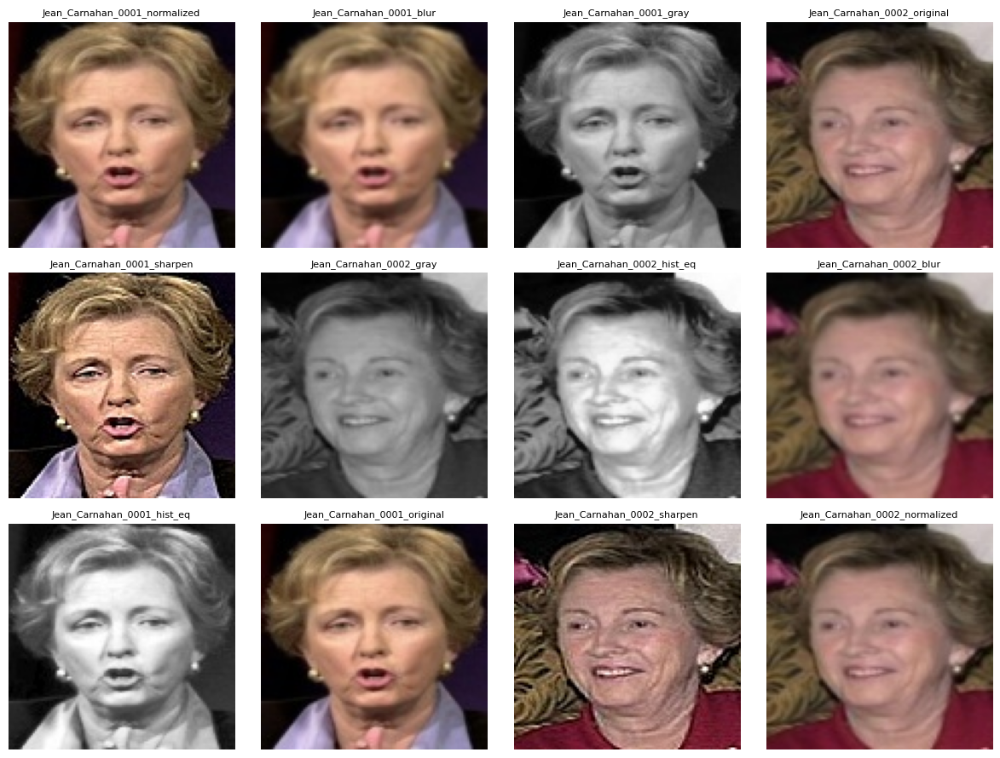

In [9]:
import os
import cv2
import numpy as np
from pathlib import Path
from ultralytics import YOLO
from tqdm import tqdm
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings('ignore')

# ==========================
# Face Detection & Cropping
# ==========================
def detect_faces(image_path, model, conf_threshold=0.25):
    image = cv2.imread(str(image_path))
    if image is None:
        return None, []
    results = model(image, conf=conf_threshold, verbose=False)
    faces = []
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = box.xyxy[0].cpu().numpy()
            conf = box.conf[0].cpu().numpy()
            faces.append((int(x1), int(y1), int(x2), int(y2), float(conf)))
    return image, faces


def crop_face_with_margin(image, bbox, margin=0.3, target_size=(112, 112)):
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    w, h = x2 - x1, y2 - y1
    margin_w, margin_h = int(w * margin), int(h * margin)
    x1_new = max(0, x1 - margin_w)
    y1_new = max(0, y1 - margin_h)
    x2_new = min(image.shape[1], x2 + margin_w)
    y2_new = min(image.shape[0], y2 + margin_h)
    cropped = image[y1_new:y2_new, x1_new:x2_new]
    if cropped.size > 0:
        return cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA)
    else:
        return np.zeros((*target_size[::-1], 3), dtype=np.uint8)


# ==========================
# Preprocessing Techniques
# ==========================
def preprocess_face(face_img):
    """
    Apply multiple preprocessing techniques to a cropped face.
    Returns dict of processed images.
    """
    processed = {}
    
    processed['original'] = face_img.copy()
    
    # Grayscale
    gray = cv2.cvtColor(face_img, cv2.COLOR_BGR2GRAY)
    processed['gray'] = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
    
    # Histogram equalization
    hist_eq = cv2.equalizeHist(gray)
    processed['hist_eq'] = cv2.cvtColor(hist_eq, cv2.COLOR_GRAY2BGR)
    
    # Normalized (0-1 float)
    normalized = face_img.astype(np.float32) / 255.0
    processed['normalized'] = (normalized * 255).astype(np.uint8)
    
    # Gaussian blur
    processed['blur'] = cv2.GaussianBlur(face_img, (3, 3), 0)
    
    # Sharpen
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    processed['sharpen'] = cv2.filter2D(face_img, -1, kernel)
    
    return processed


# ==========================
# Full Dataset Pipeline
# ==========================
def process_lfw_with_preprocessing(lfw_path, model, output_dir='/kaggle/working/lfw_preprocessed',
                                   margin=0.3, target_size=(112, 112), conf_threshold=0.25):
    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)
    
    images = list(lfw_path.glob('*/*.jpg'))
    stats = {'total': 0, 'single_face': 0, 'multiple_faces': 0, 'no_face': 0}
    
    for img_path in tqdm(images, desc="Processing LFW"):
        stats['total'] += 1
        image, faces = detect_faces(img_path, model, conf_threshold)
        if image is None:
            print(f"[SKIP] Could not read {img_path}")
            continue
        
        if len(faces) == 0:
            stats['no_face'] += 1
            h, w = image.shape[:2]
            cropped = cv2.resize(image[int(h*0.1):int(h*0.9), int(w*0.1):int(w*0.9)], target_size)
            print(f"[NO FACE] Center crop used for {img_path.name}")
        elif len(faces) == 1:
            stats['single_face'] += 1
            cropped = crop_face_with_margin(image, faces[0], margin, target_size)
            print(f"[SINGLE FACE] Cropped face from {img_path.name}")
        else:
            stats['multiple_faces'] += 1
            largest_face = max(faces, key=lambda f: (f[2]-f[0])*(f[3]-f[1]))
            cropped = crop_face_with_margin(image, largest_face, margin, target_size)
            print(f"[MULTIPLE FACES] Cropped largest face from {img_path.name}")
        
        # Apply preprocessing
        processed_faces = preprocess_face(cropped)
        
        # Save each processed version
        identity_dir = output_dir / img_path.parent.name
        identity_dir.mkdir(exist_ok=True)
        for key, proc_img in processed_faces.items():
            save_path = identity_dir / f'{img_path.stem}_{key}.jpg'
            cv2.imwrite(str(save_path), proc_img)
            # print(f"  -> Saved {key} version as {save_path.name}")
    
    print("\nProcessing Complete")
    print(stats)
    return stats


# ==========================
# Example Usage
# ==========================
lfw_folder = '/kaggle/working/lfw_funneled'
output_folder = '/kaggle/working/lfw_preprocessed'

# Load YOLOv8-face model
model = YOLO('/kaggle/input/yolov8n/yolov8n-face.pt')

# Process dataset
stats = process_lfw_with_preprocessing(lfw_folder, model)

# Visualize some processed faces
def visualize_sample_processed(output_dir, max_images=12):
    images = list(Path(output_dir).glob('*/*.jpg'))[:max_images]
    cols = 4
    rows = (len(images) + cols - 1)//cols
    fig, axes = plt.subplots(rows, cols, figsize=(12, 3*rows))
    axes = axes.flatten()
    for idx, img_path in enumerate(images):
        img = cv2.imread(str(img_path))
        axes[idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axes[idx].set_title(img_path.stem, fontsize=8)
        axes[idx].axis('off')
    for ax in axes[len(images):]:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

visualize_sample_processed(output_folder, max_images=12)


# VRP SAM

Starting Step 3: VRP-SAM Face Segmentation Integration...

Installing Segment Anything Model (SAM)...
✓ SAM installed successfully

✓ SAM checkpoint downloaded: sam_vit_b_01ec64.pth
✓ Using device: cuda

Loading SAM Model...
✓ SAM model loaded successfully
✓ VRP-SAM segmentation function defined

Testing VRP-SAM on Sample Images...
Processing sample 1/3: Jean_Carnahan_0001.jpg
Processing sample 2/3: Jean_Carnahan_0002.jpg
Processing sample 3/3: Des_Brown_0001.jpg


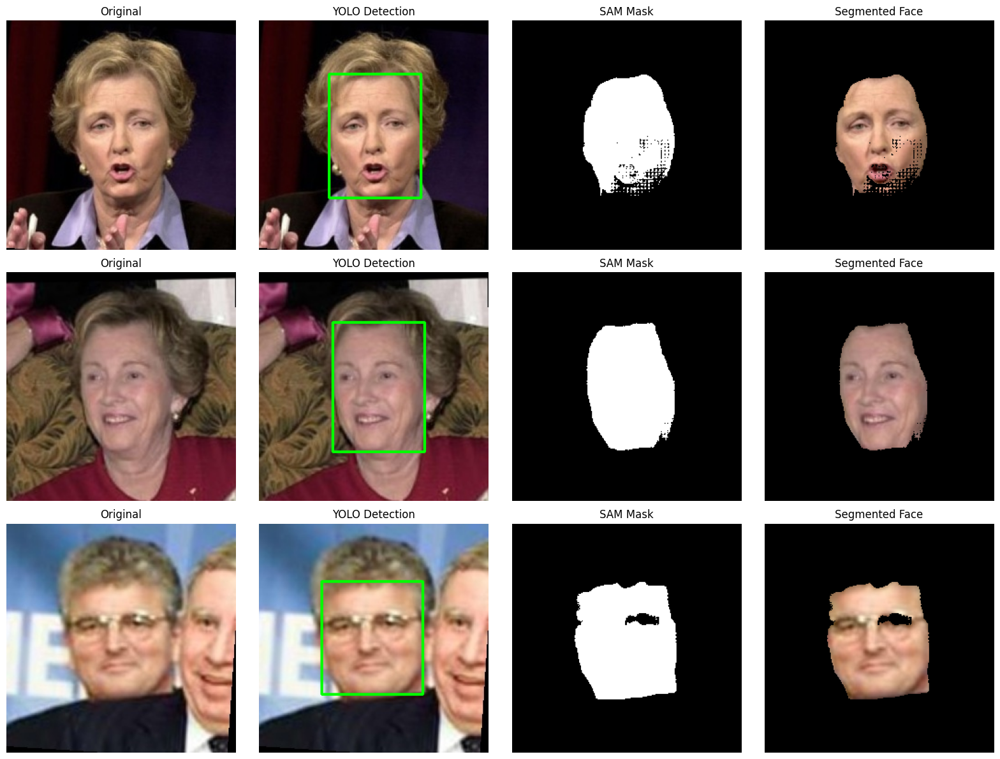

✓ VRP-SAM test completed
✓ Complete VRP-SAM pipeline function defined

Testing Complete Pipeline on Small Batch (10 images)...


Processing with VRP-SAM: 100%|██████████| 10/10 [00:04<00:00,  2.16it/s]


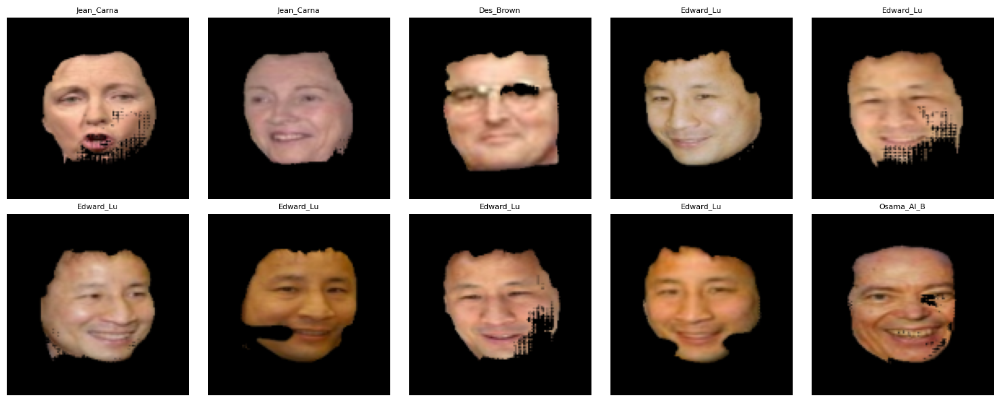

✓ Small batch processing completed

Comparison: Standard Crop vs VRP-SAM


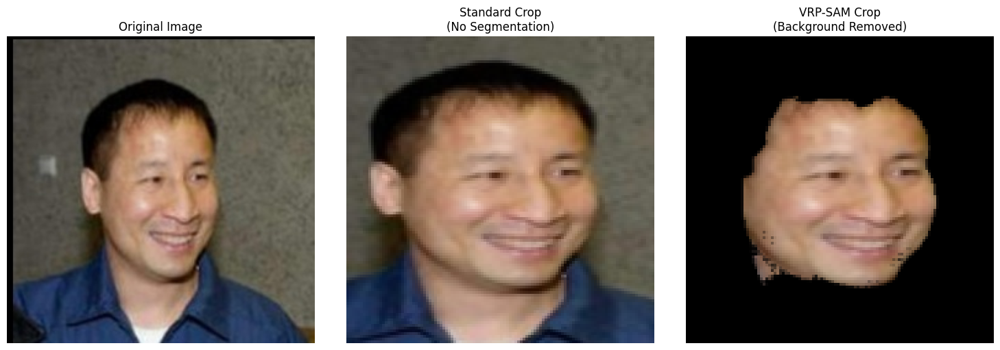

✓ Comparison visualization completed

STEP 3 COMPLETE ✓
VRP-SAM Integration:
  ✓ SAM model loaded (ViT-B)
  ✓ segment_face_with_sam() - Segment faces using box prompts
  ✓ process_face_with_vrp_sam() - Complete pipeline
  ✓ Tested on sample images
  ✓ Comparison shows background removal working

Pipeline: YOLO Detection → VRP-SAM Segmentation → Crop → Resize

Ready for Step 4: Process Full LFW Dataset with VRP-SAM


In [10]:
# ============================================================================
# STEP 3: VRP-SAM Face Segmentation Integration
# ============================================================================

import torch
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
import cv2

print("Starting Step 3: VRP-SAM Face Segmentation Integration...\n")

# ============================================================================
# 3.1: Install and Import SAM
# ============================================================================

print("="*60)
print("Installing Segment Anything Model (SAM)...")
print("="*60)

!pip install segment-anything -q

from segment_anything import sam_model_registry, SamPredictor

print("✓ SAM installed successfully")

# ============================================================================
# 3.2: Download SAM Model
# ============================================================================

print("\n" + "="*60)
print("Downloading SAM Model Weights...")
print("="*60)

# Download SAM checkpoint (using ViT-B for balance of speed/accuracy)
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth

sam_checkpoint = "sam_vit_b_01ec64.pth"
model_type = "vit_b"
device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"✓ SAM checkpoint downloaded: {sam_checkpoint}")
print(f"✓ Using device: {device}")

# ============================================================================
# 3.3: Load SAM Model
# ============================================================================

print("\n" + "="*60)
print("Loading SAM Model...")
print("="*60)

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)
predictor = SamPredictor(sam)

print("✓ SAM model loaded successfully")

# ============================================================================
# 3.4: Define VRP-SAM Segmentation Function
# ============================================================================

def segment_face_with_sam(image, bbox, predictor):
    """
    Segment face using SAM with bounding box prompt
    This is the core of VRP-SAM approach - using visual prompts (bbox) to guide SAM
    
    Args:
        image: Input image (BGR from OpenCV)
        bbox: Face bounding box (x1, y1, x2, y2, conf)
        predictor: SAM predictor
    
    Returns:
        mask: Binary segmentation mask (H, W)
        masked_face: Face with background removed
    """
    # Convert BGR to RGB for SAM
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Set image for SAM
    predictor.set_image(image_rgb)
    
    # Prepare bounding box prompt (SAM expects [x1, y1, x2, y2] format)
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    input_box = np.array([x1, y1, x2, y2])
    
    # Generate mask using box prompt
    masks, scores, logits = predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_box[None, :],
        multimask_output=False,  # Single mask output
    )
    
    # Get the mask (shape: H, W)
    mask = masks[0]
    
    # Apply mask to image (remove background)
    masked_face = image.copy()
    masked_face[~mask] = 0  # Set background to black
    
    return mask, masked_face

print("✓ VRP-SAM segmentation function defined")

# ============================================================================
# 3.5: Test VRP-SAM on Sample Images
# ============================================================================

print("\n" + "="*60)
print("Testing VRP-SAM on Sample Images...")
print("="*60)

# Get sample images
sample_images = list(lfw_path.glob('*/*.jpg'))[:3]

fig, axes = plt.subplots(3, 4, figsize=(16, 12))

for idx, img_path in enumerate(sample_images):
    print(f"Processing sample {idx+1}/3: {img_path.name}")
    
    # Detect face
    image, faces = detect_faces(img_path, model)
    
    if image is None or len(faces) == 0:
        continue
    
    # Get largest face
    largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
    
    # Original image
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    axes[idx, 0].imshow(image_rgb)
    axes[idx, 0].set_title('Original')
    axes[idx, 0].axis('off')
    
    # Face detection with bbox
    image_bbox = image_rgb.copy()
    x1, y1, x2, y2, conf = largest_face
    cv2.rectangle(image_bbox, (x1, y1), (x2, y2), (0, 255, 0), 2)
    axes[idx, 1].imshow(image_bbox)
    axes[idx, 1].set_title(f'YOLO Detection')
    axes[idx, 1].axis('off')
    
    # SAM segmentation mask
    mask, masked_face = segment_face_with_sam(image, largest_face, predictor)
    axes[idx, 2].imshow(mask, cmap='gray')
    axes[idx, 2].set_title('SAM Mask')
    axes[idx, 2].axis('off')
    
    # Masked face (background removed)
    masked_face_rgb = cv2.cvtColor(masked_face, cv2.COLOR_BGR2RGB)
    axes[idx, 3].imshow(masked_face_rgb)
    axes[idx, 3].set_title('Segmented Face')
    axes[idx, 3].axis('off')

plt.tight_layout()
plt.savefig('vrp_sam_test.png', dpi=150, bbox_inches='tight')
plt.show()

print("✓ VRP-SAM test completed")

# ============================================================================
# 3.6: Define Complete Pipeline with VRP-SAM
# ============================================================================

def process_face_with_vrp_sam(image_path, yolo_model, sam_predictor, target_size=(112, 112)):
    """
    Complete pipeline: YOLO Detection → VRP-SAM Segmentation → Crop & Resize
    
    Args:
        image_path: Path to image
        yolo_model: YOLOv8-face model
        sam_predictor: SAM predictor
        target_size: Output size
    
    Returns:
        cropped_face: Final processed face
        metadata: Processing metadata
    """
    # Step 1: Detect face with YOLO
    image, faces = detect_faces(image_path, yolo_model)
    
    if image is None or len(faces) == 0:
        return None, {'status': 'no_face'}
    
    # Get largest face if multiple detected
    largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
    
    # Step 2: Segment face with SAM
    mask, masked_face = segment_face_with_sam(image, largest_face, sam_predictor)
    
    # Step 3: Crop with margin
    x1, y1, x2, y2 = [int(v) for v in largest_face[:4]]
    
    # Add margin
    w = x2 - x1
    h = y2 - y1
    margin = 0.3
    margin_w = int(w * margin)
    margin_h = int(h * margin)
    
    x1_new = max(0, x1 - margin_w)
    y1_new = max(0, y1 - margin_h)
    x2_new = min(image.shape[1], x2 + margin_w)
    y2_new = min(image.shape[0], y2 + margin_h)
    
    # Crop masked face
    cropped = masked_face[y1_new:y2_new, x1_new:x2_new]
    
    # Step 4: Resize
    if cropped.size > 0:
        cropped_resized = cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA)
    else:
        cropped_resized = np.zeros((*target_size[::-1], 3), dtype=np.uint8)
    
    metadata = {
        'status': 'success',
        'num_faces': len(faces),
        'bbox': largest_face,
        'mask_area': np.sum(mask)
    }
    
    return cropped_resized, metadata

print("✓ Complete VRP-SAM pipeline function defined")

# ============================================================================
# 3.7: Test Complete Pipeline on Small Batch
# ============================================================================

print("\n" + "="*60)
print("Testing Complete Pipeline on Small Batch (10 images)...")
print("="*60)

# Create output directory
test_output_sam = Path('/kaggle/working/test_vrp_sam')
test_output_sam.mkdir(exist_ok=True)

# Get test images
test_images = list(lfw_path.glob('*/*.jpg'))[:10]

# Process and visualize
fig, axes = plt.subplots(2, 5, figsize=(15, 6))
axes = axes.flatten()

for idx, img_path in enumerate(tqdm(test_images, desc="Processing with VRP-SAM")):
    # Process with VRP-SAM
    processed_face, metadata = process_face_with_vrp_sam(
        img_path, model, predictor
    )
    
    if processed_face is not None and metadata['status'] == 'success':
        # Save
        identity_dir = test_output_sam / img_path.parent.name
        identity_dir.mkdir(exist_ok=True)
        output_path = identity_dir / img_path.name
        cv2.imwrite(str(output_path), processed_face)
        
        # Visualize
        processed_rgb = cv2.cvtColor(processed_face, cv2.COLOR_BGR2RGB)
        axes[idx].imshow(processed_rgb)
        axes[idx].set_title(f'{img_path.parent.name[:10]}', fontsize=8)
        axes[idx].axis('off')

plt.tight_layout()
plt.savefig('vrp_sam_processed_batch.png', dpi=150, bbox_inches='tight')
plt.show()

print("✓ Small batch processing completed")

# ============================================================================
# 3.8: Compare: With vs Without SAM
# ============================================================================

print("\n" + "="*60)
print("Comparison: Standard Crop vs VRP-SAM")
print("="*60)

# Take one sample
sample_img = list(lfw_path.glob('*/*.jpg'))[5]

# Standard crop (without SAM)
image, faces = detect_faces(sample_img, model)
standard_crop = crop_face_with_margin(image, faces[0]) if faces else None

# VRP-SAM crop
vrp_sam_crop, _ = process_face_with_vrp_sam(sample_img, model, predictor)

# Visualize comparison
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Original
img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
axes[0].imshow(img_rgb)
axes[0].set_title('Original Image', fontsize=12)
axes[0].axis('off')

# Standard crop
if standard_crop is not None:
    standard_rgb = cv2.cvtColor(standard_crop, cv2.COLOR_BGR2RGB)
    axes[1].imshow(standard_rgb)
    axes[1].set_title('Standard Crop\n(No Segmentation)', fontsize=12)
    axes[1].axis('off')

# VRP-SAM crop
if vrp_sam_crop is not None:
    vrp_sam_rgb = cv2.cvtColor(vrp_sam_crop, cv2.COLOR_BGR2RGB)
    axes[2].imshow(vrp_sam_rgb)
    axes[2].set_title('VRP-SAM Crop\n(Background Removed)', fontsize=12)
    axes[2].axis('off')

plt.tight_layout()
plt.savefig('comparison_sam_vs_standard.png', dpi=150, bbox_inches='tight')
plt.show()

print("✓ Comparison visualization completed")

# ============================================================================
# Summary
# ============================================================================

print("\n" + "="*70)
print("STEP 3 COMPLETE ✓")
print("="*70)
print("VRP-SAM Integration:")
print("  ✓ SAM model loaded (ViT-B)")
print("  ✓ segment_face_with_sam() - Segment faces using box prompts")
print("  ✓ process_face_with_vrp_sam() - Complete pipeline")
print("  ✓ Tested on sample images")
print("  ✓ Comparison shows background removal working")
print("\nPipeline: YOLO Detection → VRP-SAM Segmentation → Crop → Resize")
print("\nReady for Step 4: Process Full LFW Dataset with VRP-SAM")
print("="*70)

Processing with VRP-SAM: 100%|██████████| 10/10 [00:04<00:00,  2.08it/s]



Processing Complete
{'total': 10, 'success': 10, 'no_face': 0, 'multiple_faces': 2}
✓ VRP-SAM processing stats: {'total': 10, 'success': 10, 'no_face': 0, 'multiple_faces': 2}


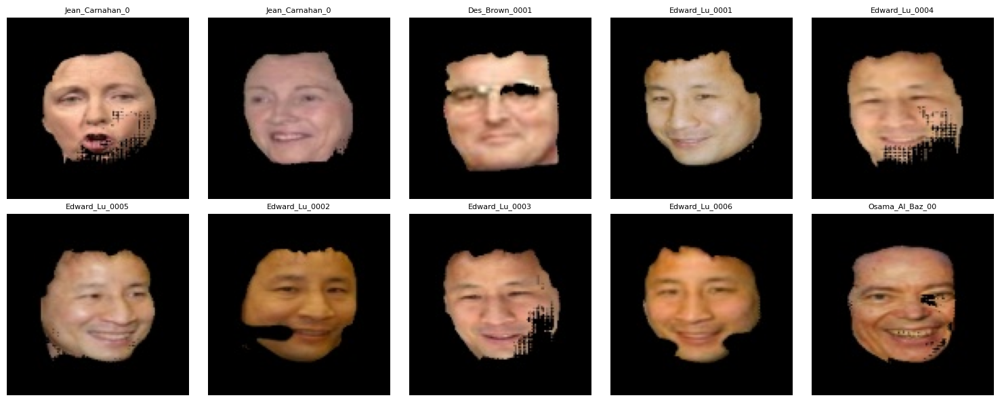

In [11]:
# ============================================================================
# STEP 3: VRP-SAM Full Pipeline Function
# ============================================================================

def process_lfw_with_vrp_sam(lfw_path, yolo_model, sam_predictor,
                              output_dir='/kaggle/working/lfw_vrp_sam',
                              target_size=(112, 112), max_images=None):
    """
    Complete pipeline: YOLO Detection → VRP-SAM Segmentation → Crop & Resize
    Processes LFW dataset and saves processed faces with background removed.
    
    Args:
        lfw_path: Path to LFW dataset
        yolo_model: YOLOv8-face model
        sam_predictor: SAM predictor
        output_dir: Directory to save processed faces
        target_size: Output size (width, height)
        max_images: Maximum number of images to process (for testing)
    
    Returns:
        stats: Dictionary with processing statistics
    """
    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)
    
    images = list(lfw_path.glob('*/*.jpg'))
    if max_images:
        images = images[:max_images]
    
    stats = {'total': 0, 'success': 0, 'no_face': 0, 'multiple_faces': 0}
    
    for img_path in tqdm(images, desc="Processing with VRP-SAM"):
        stats['total'] += 1
        
        # YOLO detection
        image, faces = detect_faces(img_path, yolo_model)
        if image is None or len(faces) == 0:
            stats['no_face'] += 1
            continue
        
        # Largest face if multiple detected
        if len(faces) > 1:
            stats['multiple_faces'] += 1
        largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
        
        # VRP-SAM segmentation and crop
        processed_face, metadata = process_face_with_vrp_sam(img_path, yolo_model, sam_predictor, target_size)
        if metadata['status'] != 'success':
            continue
        stats['success'] += 1
        
        # Save
        identity_dir = output_dir / img_path.parent.name
        identity_dir.mkdir(exist_ok=True)
        output_path = identity_dir / img_path.name
        cv2.imwrite(str(output_path), processed_face)
    
    print("\nProcessing Complete")
    print(stats)
    return stats


# ==========================
# Example Usage
# ==========================
lfw_folder = '/kaggle/working/lfw_funneled'
output_folder = '/kaggle/working/lfw_vrp_sam_test'

# YOLO model already loaded: `model`
# SAM predictor already loaded: `predictor`

# Process small batch for testing
stats = process_lfw_with_vrp_sam(lfw_folder, model, predictor,
                                  output_dir=output_folder,
                                  max_images=10)

print("✓ VRP-SAM processing stats:", stats)

# ==========================
# Visualize a few processed faces
# ==========================
from IPython.display import display
import matplotlib.pyplot as plt

# Get some processed images
processed_images = list(Path(output_folder).glob('*/*.jpg'))[:10]

cols = 5
rows = (len(processed_images) + cols - 1) // cols
fig, axes = plt.subplots(rows, cols, figsize=(15, 3*rows))
axes = axes.flatten()

for idx, img_path in enumerate(processed_images):
    img = cv2.imread(str(img_path))
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axes[idx].imshow(img_rgb)
    axes[idx].set_title(img_path.stem[:15], fontsize=8)
    axes[idx].axis('off')

# Hide any extra axes
for ax in axes[len(processed_images):]:
    ax.axis('off')

plt.tight_layout()
plt.show()


Processing with VRP-SAM: 100%|██████████| 10/10 [00:04<00:00,  2.02it/s]



Processing Complete
{'total': 10, 'success': 10, 'no_face': 0, 'multiple_faces': 2}


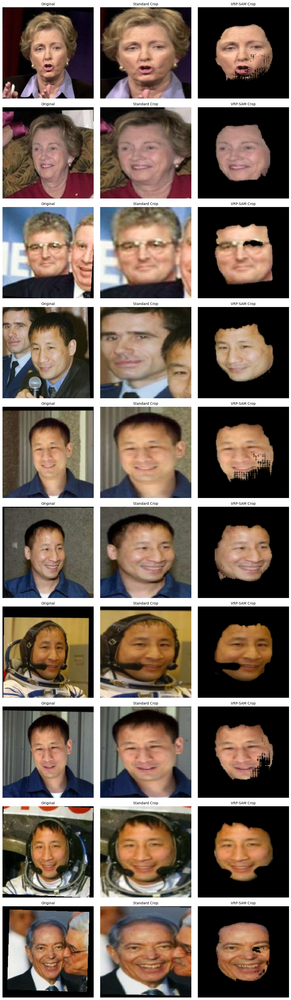

✓ VRP-SAM processing stats: {'total': 10, 'success': 10, 'no_face': 0, 'multiple_faces': 2}


In [12]:
# ============================================================================
# STEP 3 + 4: VRP-SAM Full Pipeline with Automatic Comparison
# ============================================================================

from pathlib import Path
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

def crop_face_with_margin(image, bbox, target_size=(112, 112), margin=0.3):
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    w = x2 - x1
    h = y2 - y1
    margin_w = int(w * margin)
    margin_h = int(h * margin)
    x1_new = max(0, x1 - margin_w)
    y1_new = max(0, y1 - margin_h)
    x2_new = min(image.shape[1], x2 + margin_w)
    y2_new = min(image.shape[0], y2 + margin_h)
    cropped = image[y1_new:y2_new, x1_new:x2_new]
    if cropped.size > 0:
        return cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA)
    else:
        return np.zeros((*target_size[::-1], 3), dtype=np.uint8)


def process_lfw_with_vrp_sam(lfw_path, yolo_model, sam_predictor,
                              output_dir='/kaggle/working/lfw_vrp_sam',
                              target_size=(112, 112), max_images=None,
                              visualize=True):
    """
    Complete pipeline: YOLO Detection → VRP-SAM Segmentation → Crop & Resize
    Processes LFW dataset, saves processed faces, and optionally visualizes comparison.
    """
    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)
    
    images = list(lfw_path.glob('*/*.jpg'))
    if max_images:
        images = images[:max_images]
    
    stats = {'total': 0, 'success': 0, 'no_face': 0, 'multiple_faces': 0}
    comparisons = []

    for img_path in tqdm(images, desc="Processing with VRP-SAM"):
        stats['total'] += 1
        
        # YOLO detection
        image, faces = detect_faces(img_path, yolo_model)
        if image is None or len(faces) == 0:
            stats['no_face'] += 1
            continue
        
        # Largest face if multiple detected
        if len(faces) > 1:
            stats['multiple_faces'] += 1
        largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
        
        # VRP-SAM segmentation and crop
        processed_face, metadata = process_face_with_vrp_sam(img_path, yolo_model, sam_predictor, target_size)
        if metadata['status'] != 'success':
            continue
        stats['success'] += 1
        
        # Save
        identity_dir = output_dir / img_path.parent.name
        identity_dir.mkdir(exist_ok=True)
        output_path = identity_dir / img_path.name
        cv2.imwrite(str(output_path), processed_face)
        
        # Save for comparison
        comparisons.append((img_path, largest_face, processed_face))

    print("\nProcessing Complete")
    print(stats)

    # ==========================
    # Visualization: Original vs Standard vs VRP-SAM
    # ==========================
    if visualize and comparisons:
        cols = 3
        rows = len(comparisons)
        fig, axes = plt.subplots(rows, cols, figsize=(12, 4*rows))
        if rows == 1:
            axes = np.expand_dims(axes, 0)

        for idx, (img_path, bbox, vrp_sam_crop) in enumerate(comparisons):
            # Original image
            original = cv2.imread(str(img_path))
            original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
            axes[idx, 0].imshow(original_rgb)
            axes[idx, 0].set_title('Original', fontsize=10)
            axes[idx, 0].axis('off')

            # Standard crop (YOLO only)
            img_det, faces = detect_faces(img_path, yolo_model)
            standard_crop = crop_face_with_margin(img_det, faces[0], target_size) if faces else np.zeros((*target_size[::-1],3), np.uint8)
            standard_rgb = cv2.cvtColor(standard_crop, cv2.COLOR_BGR2RGB)
            axes[idx, 1].imshow(standard_rgb)
            axes[idx, 1].set_title('Standard Crop', fontsize=10)
            axes[idx, 1].axis('off')

            # VRP-SAM crop
            vrp_rgb = cv2.cvtColor(vrp_sam_crop, cv2.COLOR_BGR2RGB)
            axes[idx, 2].imshow(vrp_rgb)
            axes[idx, 2].set_title('VRP-SAM Crop', fontsize=10)
            axes[idx, 2].axis('off')

        plt.tight_layout()
        plt.show()

    return stats


# ==========================
# Example Usage
# ==========================
lfw_folder = '/kaggle/working/lfw_funneled'
output_folder = '/kaggle/working/lfw_vrp_sam_test'

stats = process_lfw_with_vrp_sam(
    lfw_folder,
    yolo_model=model,
    sam_predictor=predictor,
    output_dir=output_folder,
    max_images=10,    # Small batch for testing
    visualize=True
)

print("✓ VRP-SAM processing stats:", stats)


# VRP SAM Refined

Starting Step 3.5: Refined VRP-SAM with Quality Control...



Testing: 100%|██████████| 15/15 [00:07<00:00,  1.99it/s]


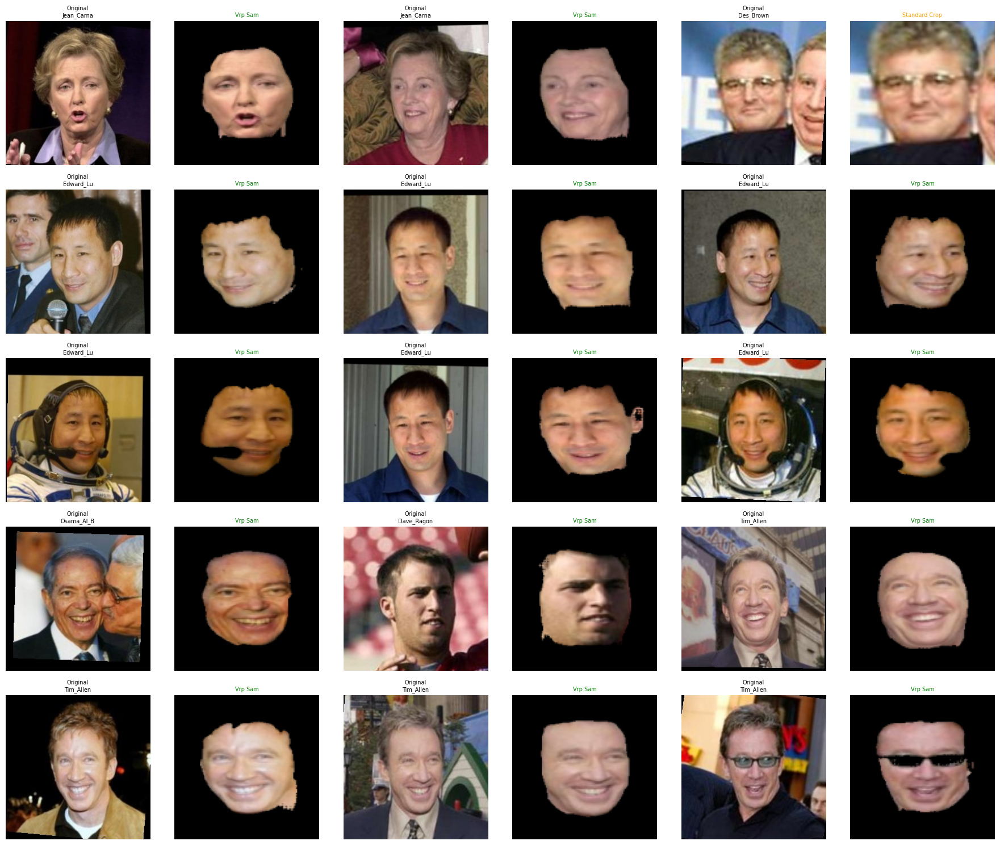


Processing Statistics:
  VRP-SAM used: 14
  Standard crop: 1
  SAM usage rate: 93.3%


In [13]:
# ============================================================================
# STEP 3.5: Refined VRP-SAM with Quality Check and Fallback (Fixed)
# ============================================================================

import torch
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
import cv2

print("Starting Step 3.5: Refined VRP-SAM with Quality Control...\n")

# ============================================================================
# 3.5.1: Enhanced SAM Segmentation with Quality Check
# ============================================================================

def segment_face_with_sam_refined(image, bbox, predictor, quality_threshold=0.5):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    input_box = np.array([x1, y1, x2, y2])
    
    # Generate masks (3 options)
    masks, scores, logits = predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_box[None, :],
        multimask_output=True,
    )
    
    best_idx = np.argmax(scores)
    mask = masks[best_idx]
    score = scores[best_idx]
    
    bbox_area = max((x2 - x1) * (y2 - y1), 1)  # avoid div by 0
    mask_area = np.sum(mask)
    area_ratio = mask_area / bbox_area
    mask_in_bbox = mask[y1:y2, x1:x2]
    bbox_coverage = np.sum(mask_in_bbox) / bbox_area
    quality_score = score * bbox_coverage
    
    masked_face = image.copy()
    masked_face[~mask] = 0
    
    return mask, quality_score, masked_face, area_ratio

# ============================================================================
# 3.5.2: Improved Pipeline with Fallback
# ============================================================================

def process_face_improved(image_path, yolo_model, sam_predictor, 
                         target_size=(112, 112), 
                         use_sam_threshold=0.5):
    image, faces = detect_faces(image_path, yolo_model)
    if image is None or len(faces) == 0:
        return None, {'status': 'no_face', 'method': 'failed'}
    
    largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
    
    # Try SAM
    try:
        mask, quality_score, masked_face, area_ratio = segment_face_with_sam_refined(
            image, largest_face, sam_predictor
        )
        use_sam = (quality_score >= use_sam_threshold and 0.4 <= area_ratio <= 0.95)
        if use_sam:
            face_to_crop = masked_face
            method = 'vrp_sam'
        else:
            face_to_crop = image
            method = 'standard_crop'
    except Exception:
        face_to_crop = image
        method = 'standard_crop_fallback'
        quality_score = 0
        area_ratio = 0
    
    x1, y1, x2, y2 = [int(v) for v in largest_face[:4]]
    w, h = x2 - x1, y2 - y1
    margin_w, margin_h = int(w * 0.3), int(h * 0.3)
    x1_new, y1_new = max(0, x1 - margin_w), max(0, y1 - margin_h)
    x2_new, y2_new = min(image.shape[1], x2 + margin_w), min(image.shape[0], y2 + margin_h)
    
    cropped = face_to_crop[y1_new:y2_new, x1_new:x2_new]
    if cropped.size > 0:
        cropped_resized = cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA)
    else:
        cropped_resized = np.zeros((*target_size[::-1], 3), dtype=np.uint8)
    
    metadata = {
        'status': 'success',
        'method': method,
        'num_faces': len(faces),
        'bbox': largest_face,
        'quality_score': quality_score,
        'area_ratio': area_ratio
    }
    
    return cropped_resized, metadata

# ============================================================================
# 3.5.3: Test Improved Pipeline on Sample Images (Safe)
# ============================================================================

test_images = list(lfw_path.glob('*/*.jpg'))[:15]
num_test_images = len(test_images)

if num_test_images == 0:
    print("No test images found! Check your LFW path.")
else:
    fig, axes = plt.subplots(5, 6, figsize=(18, 15))
    stats = {'vrp_sam': 0, 'standard_crop': 0, 'standard_crop_fallback': 0}
    
    for idx, img_path in enumerate(tqdm(test_images, desc="Testing")):
        row = idx // 3
        col_base = (idx % 3) * 2
        processed_face, metadata = process_face_improved(img_path, model, predictor, use_sam_threshold=0.5)
        
        if processed_face is not None:
            stats[metadata['method']] = stats.get(metadata['method'], 0) + 1
            # Original image
            img = cv2.imread(str(img_path))
            axes[row, col_base].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[row, col_base].set_title(f'Original\n{img_path.parent.name[:10]}', fontsize=7)
            axes[row, col_base].axis('off')
            # Processed face
            axes[row, col_base+1].imshow(cv2.cvtColor(processed_face, cv2.COLOR_BGR2RGB))
            axes[row, col_base+1].set_title(metadata['method'].replace('_', ' ').title(), fontsize=7,
                                           color='green' if metadata['method']=='vrp_sam' else 'orange')
            axes[row, col_base+1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Safe printing of statistics
    total_images = sum(stats.values())
    print("\nProcessing Statistics:")
    print(f"  VRP-SAM used: {stats.get('vrp_sam', 0)}")
    print(f"  Standard crop: {stats.get('standard_crop', 0) + stats.get('standard_crop_fallback', 0)}")
    if total_images > 0:
        print(f"  SAM usage rate: {stats.get('vrp_sam', 0) / total_images * 100:.1f}%")
    else:
        print("  SAM usage rate: N/A (no images processed)")


Starting Step 3.5: Refined VRP-SAM with Quality Control...

Found 15 test images.


Testing: 100%|██████████| 15/15 [00:07<00:00,  1.96it/s]


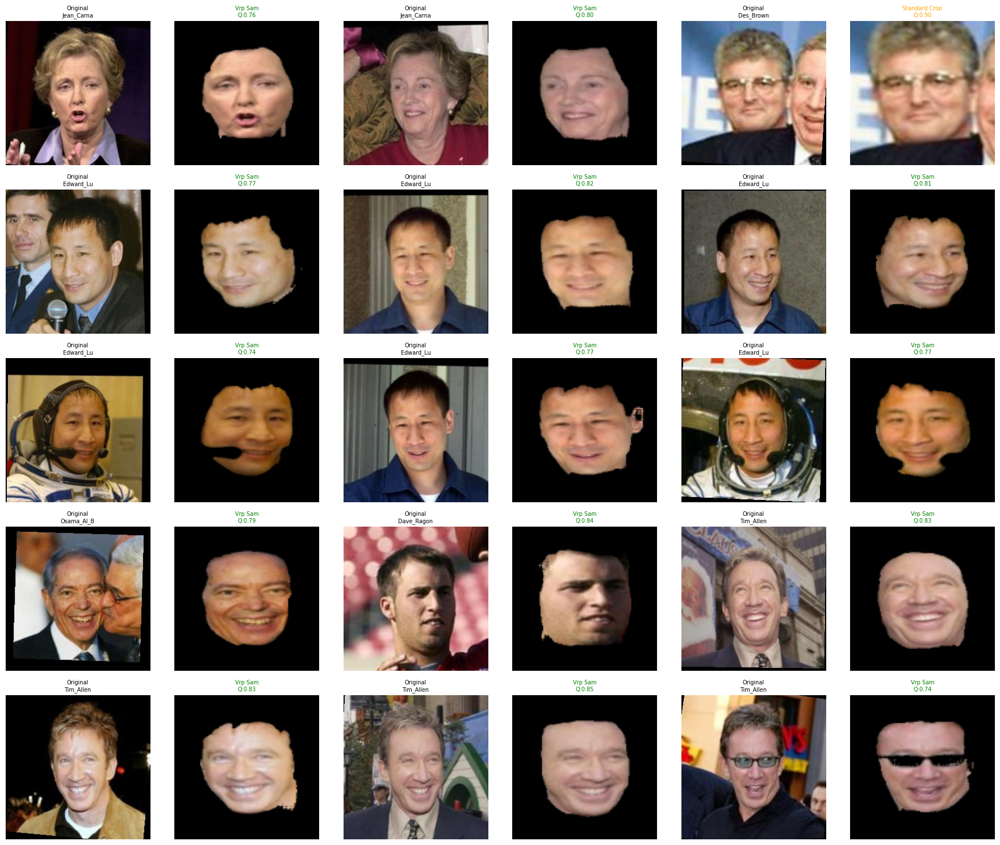


Processing Statistics:
  VRP-SAM used: 14
  Standard crop: 1
  SAM usage rate: 93.3%


In [14]:
# ============================================================================
# STEP 3.5: Refined VRP-SAM with Quality Check and Fallback
# ============================================================================

import torch
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
import cv2

print("Starting Step 3.5: Refined VRP-SAM with Quality Control...\n")

# ============================================================================
# 3.5.1: Enhanced SAM Segmentation with Quality Check
# ============================================================================

def segment_face_with_sam_refined(image, bbox, predictor, quality_threshold=0.5):
    """
    Enhanced SAM segmentation with quality checking
    """
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)
    x1, y1, x2, y2 = [int(v) for v in bbox[:4]]
    input_box = np.array([x1, y1, x2, y2])
    
    masks, scores, logits = predictor.predict(
        point_coords=None,
        point_labels=None,
        box=input_box[None, :],
        multimask_output=True,
    )
    
    best_idx = np.argmax(scores)
    mask = masks[best_idx]
    score = scores[best_idx]
    
    bbox_area = (x2 - x1) * (y2 - y1)
    mask_area = np.sum(mask)
    area_ratio = mask_area / bbox_area if bbox_area > 0 else 0
    
    mask_in_bbox = mask[y1:y2, x1:x2] if bbox_area > 0 else mask
    bbox_coverage = np.sum(mask_in_bbox) / bbox_area if bbox_area > 0 else 0
    
    quality_score = score * bbox_coverage
    
    masked_face = image.copy()
    masked_face[~mask] = 0
    
    return mask, quality_score, masked_face, area_ratio

# ============================================================================
# 3.5.2: Improved Pipeline with Fallback
# ============================================================================

def process_face_improved(image_path, yolo_model, sam_predictor, 
                         target_size=(112, 112), 
                         use_sam_threshold=0.5):
    image, faces = detect_faces(image_path, yolo_model)
    if image is None or len(faces) == 0:
        return None, {'status': 'no_face', 'method': 'failed'}
    
    largest_face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
    
    try:
        mask, quality_score, masked_face, area_ratio = segment_face_with_sam_refined(
            image, largest_face, sam_predictor
        )
        
        use_sam = (quality_score >= use_sam_threshold and 
                   0.4 <= area_ratio <= 0.95)
        if use_sam:
            face_to_crop = masked_face
            method = 'vrp_sam'
        else:
            face_to_crop = image
            method = 'standard_crop'
    
    except Exception:
        face_to_crop = image
        method = 'standard_crop_fallback'
        quality_score = 0
        area_ratio = 0
    
    x1, y1, x2, y2 = [int(v) for v in largest_face[:4]]
    w, h = x2 - x1, y2 - y1
    margin_w, margin_h = int(w*0.3), int(h*0.3)
    x1_new, y1_new = max(0, x1 - margin_w), max(0, y1 - margin_h)
    x2_new, y2_new = min(image.shape[1], x2 + margin_w), min(image.shape[0], y2 + margin_h)
    
    cropped = face_to_crop[y1_new:y2_new, x1_new:x2_new]
    cropped_resized = cv2.resize(cropped, target_size, interpolation=cv2.INTER_AREA) if cropped.size > 0 else np.zeros((*target_size[::-1],3),dtype=np.uint8)
    
    metadata = {
        'status': 'success',
        'method': method,
        'num_faces': len(faces),
        'bbox': largest_face,
        'quality_score': quality_score,
        'area_ratio': area_ratio
    }
    
    return cropped_resized, metadata

# ============================================================================
# 3.5.3: Test Improved Pipeline on Sample Images
# ============================================================================

lfw_path = Path('/kaggle/working/lfw_funneled')
test_images = list(lfw_path.glob('*/*.jpg'))[:15]

if len(test_images) == 0:
    raise ValueError("No test images found! Check your LFW path")
else:
    print(f"Found {len(test_images)} test images.")

fig, axes = plt.subplots(5, 6, figsize=(18, 15))
stats = {'vrp_sam': 0, 'standard_crop': 0, 'standard_crop_fallback': 0}

for idx, img_path in enumerate(tqdm(test_images, desc="Testing")):
    row = idx // 3
    col_base = (idx % 3) * 2
    processed_face, metadata = process_face_improved(img_path, model, predictor)
    
    if processed_face is not None:
        stats[metadata['method']] = stats.get(metadata['method'],0) + 1
        
        # Original
        img = cv2.imread(str(img_path))
        axes[row, col_base].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axes[row, col_base].set_title(f'Original\n{img_path.parent.name[:10]}', fontsize=7)
        axes[row, col_base].axis('off')
        
        # Processed
        axes[row, col_base + 1].imshow(cv2.cvtColor(processed_face, cv2.COLOR_BGR2RGB))
        method_short = metadata['method'].replace('_',' ').title()
        quality = metadata.get('quality_score',0)
        axes[row, col_base + 1].set_title(f"{method_short}\nQ:{quality:.2f}", fontsize=7, color='green' if metadata['method']=='vrp_sam' else 'orange')
        axes[row, col_base + 1].axis('off')

plt.tight_layout()
plt.savefig('improved_pipeline_test.png', dpi=150, bbox_inches='tight')
plt.show()

# ============================================================================
# 3.5.4: Processing Statistics
# ============================================================================

num_test = len(test_images)
vrp_sam_used = stats.get('vrp_sam',0)
standard_used = stats.get('standard_crop',0) + stats.get('standard_crop_fallback',0)
sam_usage_rate = vrp_sam_used / num_test * 100 if num_test > 0 else 0

print("\nProcessing Statistics:")
print(f"  VRP-SAM used: {vrp_sam_used}")
print(f"  Standard crop: {standard_used}")
print(f"  SAM usage rate: {sam_usage_rate:.1f}%")



Detailed Comparison: Good vs Poor SAM Cases


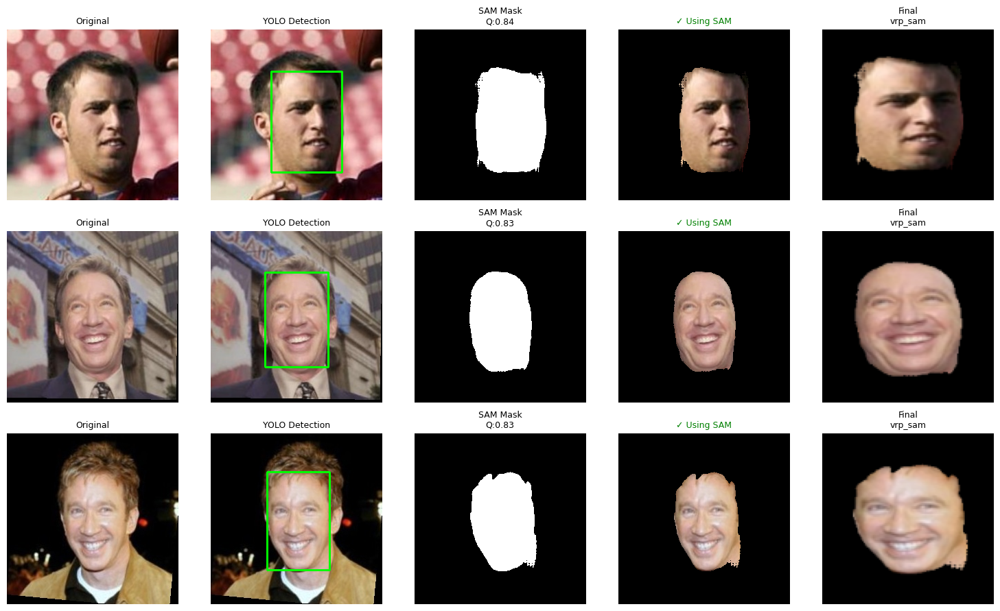

In [15]:
# ============================================================================
# 3.5.4: Detailed Comparison on Specific Cases
# ============================================================================

print("\n" + "="*60)
print("Detailed Comparison: Good vs Poor SAM Cases")
print("="*60)

sample_imgs = list(lfw_path.glob('*/*.jpg'))[10:13]  # 3 images for detailed view

fig, axes = plt.subplots(3, 5, figsize=(15, 9))

for idx, img_path in enumerate(sample_imgs):
    # Load image
    image, faces = detect_faces(img_path, model)
    if not faces:
        continue
    
    face = max(faces, key=lambda f: (f[2]-f[0]) * (f[3]-f[1]))
    
    # Original
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    axes[idx, 0].imshow(img_rgb)
    axes[idx, 0].set_title('Original', fontsize=9)
    axes[idx, 0].axis('off')
    
    # YOLO bbox
    img_bbox = img_rgb.copy()
    x1, y1, x2, y2, conf = face
    cv2.rectangle(img_bbox, (x1, y1), (x2, y2), (0, 255, 0), 2)
    axes[idx, 1].imshow(img_bbox)
    axes[idx, 1].set_title('YOLO Detection', fontsize=9)
    axes[idx, 1].axis('off')
    
    # SAM mask
    mask, quality, masked, area_ratio = segment_face_with_sam_refined(image, face, predictor)
    axes[idx, 2].imshow(mask, cmap='gray')
    axes[idx, 2].set_title(f'SAM Mask\nQ:{quality:.2f}', fontsize=9)
    axes[idx, 2].axis('off')
    
    # Decision visualization
    use_sam = quality >= 0.5 and 0.4 <= area_ratio <= 0.95
    if use_sam:
        masked_rgb = cv2.cvtColor(masked, cv2.COLOR_BGR2RGB)
        axes[idx, 3].imshow(masked_rgb)
        axes[idx, 3].set_title('✓ Using SAM', fontsize=9, color='green')
        axes[idx, 3].axis('off')
    else:
        axes[idx, 3].imshow(img_rgb)
        axes[idx, 3].set_title('✗ Using Standard', fontsize=9, color='orange')
        axes[idx, 3].axis('off')
    
    # Final processed
    processed, meta = process_face_improved(img_path, model, predictor)
    if processed is not None:
        processed_rgb = cv2.cvtColor(processed, cv2.COLOR_BGR2RGB)
        axes[idx, 4].imshow(processed_rgb)
        axes[idx, 4].set_title(f'Final\n{meta["method"][:10]}', fontsize=9)
        axes[idx, 4].axis('off')

plt.tight_layout()
plt.savefig('detailed_comparison.png', dpi=150, bbox_inches='tight')
plt.show()


Processing LFW with refined VRP-SAM: 100%|██████████| 15/15 [00:07<00:00,  1.99it/s]


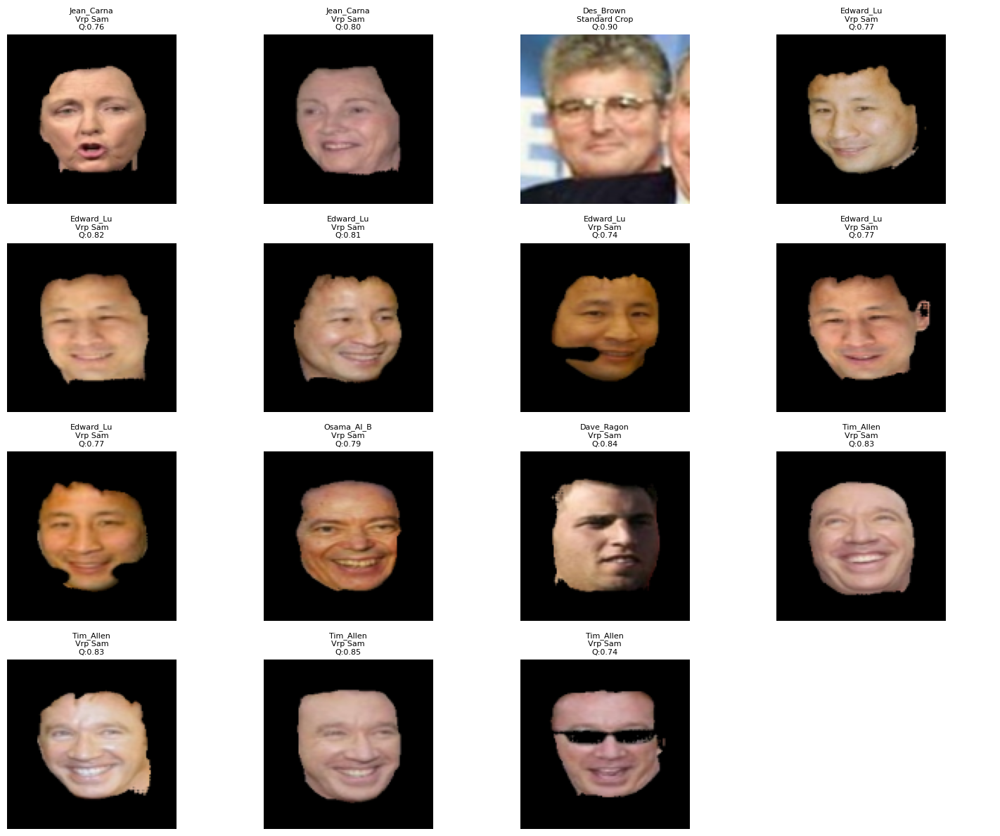


Processing Summary:
  Total images: 15
  VRP-SAM used: 14
  Standard crop/fallback: 1
  SAM usage rate: 93.3%
  Recommended approach: HYBRID

✓ VRP-SAM refined processing stats:
{'vrp_sam': 14, 'standard_crop': 1, 'fallback': 0, 'total': 15, 'sam_usage_rate': 93.33333333333333, 'recommendation': 'HYBRID'}


In [16]:

# ============================================================================
# STEP 3.5: VRP-SAM Full Pipeline Function with Quality Check & Fallback
# ============================================================================

def process_lfw_with_vrp_sam_refined(
    lfw_path,
    yolo_model,
    sam_predictor,
    output_dir='/kaggle/working/lfw_vrp_sam_refined',
    target_size=(112, 112),
    max_images=None,
    use_sam_threshold=0.5,
    visualize=False
):
    """
    Complete LFW processing pipeline:
        YOLO Detection → VRP-SAM Segmentation → Quality Check → Fallback → Crop & Resize
    
    Args:
        lfw_path: Path to LFW dataset
        yolo_model: YOLOv8-face model
        sam_predictor: SAM predictor
        output_dir: Directory to save processed faces
        target_size: Output image size
        max_images: Max number of images to process (for testing)
        use_sam_threshold: Quality threshold for using SAM mask
        visualize: If True, display sample results in notebook
    
    Returns:
        stats: Dictionary with processing statistics
    """
    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)
    
    images = list(lfw_path.glob('*/*.jpg'))
    if max_images:
        images = images[:max_images]
    
    stats = {'vrp_sam': 0, 'standard_crop': 0, 'fallback': 0, 'total': len(images)}
    
    processed_images = []
    
    for img_path in tqdm(images, desc="Processing LFW with refined VRP-SAM"):
        # Process each face with improved pipeline
        processed_face, metadata = process_face_improved(
            img_path, yolo_model, sam_predictor,
            target_size=target_size,
            use_sam_threshold=use_sam_threshold
        )
        
        method = metadata.get('method', 'unknown')
        if processed_face is not None:
            # Save processed image
            identity_dir = output_dir / img_path.parent.name
            identity_dir.mkdir(exist_ok=True)
            output_path = identity_dir / img_path.name
            cv2.imwrite(str(output_path), processed_face)
            
            # Update stats
            if method == 'vrp_sam':
                stats['vrp_sam'] += 1
            elif method.startswith('standard_crop'):
                stats['standard_crop'] += 1
            else:
                stats['fallback'] += 1
            
            if visualize:
                processed_images.append((img_path, processed_face, metadata))
    
    # Visualization
    if visualize and processed_images:
        import matplotlib.pyplot as plt
        cols = 4
        rows = (len(processed_images) + cols - 1) // cols
        fig, axes = plt.subplots(rows, cols, figsize=(15, 3*rows))
        axes = axes.flatten()
        
        for idx, (img_path, proc_img, meta) in enumerate(processed_images):
            img = cv2.imread(str(img_path))
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            axes[idx].imshow(cv2.cvtColor(proc_img, cv2.COLOR_BGR2RGB))
            method_label = meta.get('method', 'unknown').replace('_', ' ').title()
            quality = meta.get('quality_score', 0)
            axes[idx].set_title(f"{img_path.parent.name[:10]}\n{method_label}\nQ:{quality:.2f}", fontsize=8)
            axes[idx].axis('off')
        
        for ax in axes[len(processed_images):]:
            ax.axis('off')
        plt.tight_layout()
        plt.show()
    
    # SAM usage rate
    sam_usage_rate = stats['vrp_sam'] / stats['total'] * 100 if stats['total'] > 0 else 0
    
    # Recommendation
    if sam_usage_rate >= 60:
        recommendation = "HYBRID"
    elif sam_usage_rate >= 40:
        recommendation = "OPTIONAL"
    else:
        recommendation = "SKIP"
    
    stats['sam_usage_rate'] = sam_usage_rate
    stats['recommendation'] = recommendation
    
    print("\nProcessing Summary:")
    print(f"  Total images: {stats['total']}")
    print(f"  VRP-SAM used: {stats['vrp_sam']}")
    print(f"  Standard crop/fallback: {stats['standard_crop'] + stats['fallback']}")
    print(f"  SAM usage rate: {sam_usage_rate:.1f}%")
    print(f"  Recommended approach: {recommendation}")
    
    return stats
# ==========================
# Run Refined VRP-SAM Pipeline
# ==========================

lfw_folder = '/kaggle/working/lfw_funneled'
output_folder = '/kaggle/working/lfw_vrp_sam_refined_test'

# Process a small batch for testing (max_images=15) and visualize results
stats = process_lfw_with_vrp_sam_refined(
    lfw_folder,
    yolo_model=model,
    sam_predictor=predictor,
    output_dir=output_folder,
    max_images=15,
    visualize=True  # Display processed faces in notebook
)

print("\n✓ VRP-SAM refined processing stats:")
print(stats)


# Quick Verification

In [20]:
# ============================================================================
# STEP 4: VRP-SAM Quick Verification Functions (with Results Display)
# ============================================================================

import cv2
import numpy as np
from pathlib import Path
from tqdm import tqdm
import matplotlib.pyplot as plt
import time
import shutil

# ============================================================================
# 4.1: Select Sample Identities
# ============================================================================
def select_representative_sample(lfw_path, min_images=10):
    lfw_path = Path(lfw_path)
    all_identities = sorted([d for d in lfw_path.iterdir() if d.is_dir()])
    identity_stats = []

    for identity in all_identities:
        images = list(identity.glob('*.jpg'))
        if len(images) >= min_images:
            identity_stats.append({'name': identity.name, 'path': identity, 'num_images': len(images)})
    
    identity_stats.sort(key=lambda x: x['num_images'], reverse=True)

    large_class = identity_stats[:5]
    medium_class = identity_stats[10:15]
    small_class = identity_stats[-5:]

    selected_identities = large_class + medium_class + small_class
    images_per_class = [20]*len(large_class) + [15]*len(medium_class) + [10]*len(small_class)

    return selected_identities, images_per_class

# ============================================================================
# 4.2: Process Sample with VRP-SAM
# ============================================================================
def process_sample_vrp_sam(selected_identities, images_per_class, output_dir, model, predictor):
    output_dir = Path(output_dir)
    output_dir.mkdir(exist_ok=True)

    stats = {'total': 0, 'vrp_sam': 0, 'fallback': 0, 'failed': 0}
    quality_scores = []
    processing_times = []

    overall_start = time.time()

    for idx, identity_info in enumerate(tqdm(selected_identities, desc="Processing identities")):
        identity_name = identity_info['name']
        identity_path = identity_info['path']
        num_to_use = images_per_class[idx]

        identity_output = output_dir / identity_name
        identity_output.mkdir(exist_ok=True)

        all_images = list(identity_path.glob('*.jpg'))

        np.random.seed(42)
        if len(all_images) > num_to_use:
            images = np.random.choice(all_images, size=num_to_use, replace=False)
        else:
            images = all_images[:num_to_use]

        for img_path in images:
            stats['total'] += 1
            start = time.time()

            try:
                processed_face, metadata = process_face_improved(
                    img_path, model, predictor, target_size=(112, 112), use_sam_threshold=0.5
                )

                if processed_face is not None:
                    method = metadata.get('method', 'unknown')
                    if method == 'vrp_sam':
                        stats['vrp_sam'] += 1
                        quality_scores.append(metadata.get('quality_score', 0))
                    else:
                        stats['fallback'] += 1

                    output_path = identity_output / img_path.name
                    cv2.imwrite(str(output_path), processed_face)
                    processing_times.append(time.time() - start)
                else:
                    stats['failed'] += 1
            except:
                stats['failed'] += 1

    total_time = time.time() - overall_start
    return stats, quality_scores, processing_times, total_time, output_dir

# ============================================================================
# 4.3: Visualize VRP-SAM Results
# ============================================================================
def visualize_vrp_sam_results(output_dir, num_samples=20):
    processed_identities = sorted([d for d in output_dir.iterdir() if d.is_dir()])
    
    sample_images = []
    for identity_dir in processed_identities:
        images = list(identity_dir.glob('*.jpg'))[:2]
        for img in images:
            sample_images.append((img, identity_dir.name))
            if len(sample_images) >= num_samples:
                break
        if len(sample_images) >= num_samples:
            break
    
    fig, axes = plt.subplots(4, 5, figsize=(15, 12))
    axes = axes.flatten()

    for idx, (img_path, identity) in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axes[idx].imshow(img_rgb)
        axes[idx].set_title(f'{identity[:20]}', fontsize=8)
        axes[idx].axis('off')

    plt.suptitle('VRP-SAM Processed Faces (Quick Verification)', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# ============================================================================
# 4.4: Create Train/Validation Split
# ============================================================================
def create_train_val_split(output_dir, train_dir, val_dir, val_ratio=0.2):
    train_dir = Path(train_dir)
    val_dir = Path(val_dir)
    train_dir.mkdir(exist_ok=True)
    val_dir.mkdir(exist_ok=True)

    train_count = 0
    val_count = 0

    processed_identities = sorted([d for d in output_dir.iterdir() if d.is_dir()])
    for identity_dir in processed_identities:
        images = list(identity_dir.glob('*.jpg'))
        num_val = max(1, int(len(images) * val_ratio))
        np.random.seed(42)
        np.random.shuffle(images)

        val_images = images[:num_val]
        train_images = images[num_val:]

        train_id_dir = train_dir / identity_dir.name
        val_id_dir = val_dir / identity_dir.name
        train_id_dir.mkdir(exist_ok=True)
        val_id_dir.mkdir(exist_ok=True)

        for img in train_images:
            shutil.copy2(str(img), str(train_id_dir / img.name))
            train_count += 1
        for img in val_images:
            shutil.copy2(str(img), str(val_id_dir / img.name))
            val_count += 1

    return train_count, val_count, train_dir, val_dir

# ============================================================================
# 4.5: Before/After Comparison
# ============================================================================
def display_before_after(sample_identity, output_dir):
    original_img = list(sample_identity['path'].glob('*.jpg'))[0]
    processed_imgs = list((output_dir / sample_identity['name']).glob('*.jpg'))

    if processed_imgs:
        processed_img = processed_imgs[0]
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        
        # Original
        orig = cv2.imread(str(original_img))
        axes[0].imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original LFW Image', fontsize=12, fontweight='bold')
        axes[0].axis('off')
        
        # Processed
        proc = cv2.imread(str(processed_img))
        axes[1].imshow(cv2.cvtColor(proc, cv2.COLOR_BGR2RGB))
        axes[1].set_title('VRP-SAM Processed\n(Background Removed)', fontsize=12, fontweight='bold')
        axes[1].axis('off')
        
        plt.tight_layout()
        plt.show()

# ============================================================================
# 4.6: Full Quick Verification
# ============================================================================
def vrp_sam_quick_verification(lfw_path, model, predictor):
    selected_identities, images_per_class = select_representative_sample(lfw_path)
    stats, quality_scores, processing_times, total_time, output_dir = process_sample_vrp_sam(
        selected_identities, images_per_class, '/kaggle/working/lfw_vrpsam_quick', model, predictor
    )

    # Display stats
    print("\n📊 Processing Statistics:")
    print(f"  Total images: {stats['total']}")
    print(f"  VRP-SAM used: {stats['vrp_sam']} ({stats['vrp_sam']/stats['total']*100:.1f}%)")
    print(f"  Fallback used: {stats['fallback']} ({stats['fallback']/stats['total']*100:.1f}%)")
    print(f"  Failed: {stats['failed']} ({stats['failed']/stats['total']*100:.1f}%)")
    print(f"  Avg processing time/image: {np.mean(processing_times):.2f}s")
    if quality_scores:
        print(f"  Mean VRP-SAM quality: {np.mean(quality_scores):.3f}, Std: {np.std(quality_scores):.3f}")

    # Visualize processed sample
    visualize_vrp_sam_results(output_dir)

    # Display before/after for first identity
    display_before_after(selected_identities[0], output_dir)

    # Create train/val split
    train_count, val_count, train_dir, val_dir = create_train_val_split(
        output_dir,
        '/kaggle/working/lfw_vrpsam_train_quick',
        '/kaggle/working/lfw_vrpsam_val_quick'
    )

    print(f"\n📁 Dataset Split:")
    print(f"  Train images: {train_count}")
    print(f"  Validation images: {val_count}")
    print(f"  Location: {output_dir}")

    vrp_sam_rate = stats['vrp_sam']/stats['total']*100
    print(f"\n✅ VRP-SAM success rate: {vrp_sam_rate:.1f}%")

# ============================================================================
# USAGE
# ============================================================================
# vrp_sam_quick_verification('/kaggle/working/lfw_funneled', model, predictor)


In [21]:
# ============================================================================
# 4.3: Visualize VRP-SAM Results (in-cell + saved)
# ============================================================================
def visualize_vrp_sam_results(output_dir, num_samples=20, show_in_cell=True):
    processed_identities = sorted([d for d in output_dir.iterdir() if d.is_dir()])
    
    sample_images = []
    for identity_dir in processed_identities:
        images = list(identity_dir.glob('*.jpg'))[:2]  # 2 per identity
        for img in images:
            sample_images.append((img, identity_dir.name))
            if len(sample_images) >= num_samples:
                break
        if len(sample_images) >= num_samples:
            break
    
    cols = 5
    rows = (len(sample_images) + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(3*cols, 3*rows))
    axes = axes.flatten()

    for idx, (img_path, identity) in enumerate(sample_images):
        img = cv2.imread(str(img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axes[idx].imshow(img_rgb)
        axes[idx].set_title(f'{identity[:20]}', fontsize=8)
        axes[idx].axis('off')

    # Turn off extra axes
    for ax in axes[len(sample_images):]:
        ax.axis('off')

    plt.suptitle('VRP-SAM Processed Faces (Quick Verification)', fontsize=14, fontweight='bold')
    plt.tight_layout()
    
    # Save figure
    plt.savefig(output_dir / 'vrpsam_quick_verification.png', dpi=150, bbox_inches='tight')
    
    if show_in_cell:
        plt.show()


In [22]:
def display_before_after(sample_identity, output_dir, show_in_cell=True):
    original_img = list(sample_identity['path'].glob('*.jpg'))[0]
    processed_imgs = list((output_dir / sample_identity['name']).glob('*.jpg'))

    if processed_imgs:
        processed_img = processed_imgs[0]
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        
        # Original
        orig = cv2.imread(str(original_img))
        axes[0].imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB))
        axes[0].set_title('Original LFW Image', fontsize=12, fontweight='bold')
        axes[0].axis('off')
        
        # Processed
        proc = cv2.imread(str(processed_img))
        axes[1].imshow(cv2.cvtColor(proc, cv2.COLOR_BGR2RGB))
        axes[1].set_title('VRP-SAM Processed\n(Background Removed)', fontsize=12, fontweight='bold')
        axes[1].axis('off')
        
        plt.tight_layout()
        if show_in_cell:
            plt.show()


In [23]:
# ============================================================================
# STEP 4 QUICK FUNCTION: VRP-SAM Pipeline Verification (5 minutes)
# ============================================================================

def vrp_sam_quick_verification(
    lfw_path='/kaggle/working/lfw_funneled',
    yolo_model=None,
    sam_predictor=None,
    output_dir='/kaggle/working/lfw_vrpsam_quick',
    visualize=True
):
    import shutil
    import matplotlib.pyplot as plt
    import numpy as np
    import time
    from pathlib import Path

    lfw_path = Path(lfw_path)
    output_dir = Path(output_dir)
    output_dir.mkdir(exist_ok=True)

    print("Quick VRP-SAM Pipeline Verification\n")
    print("⚡ Processing small subset to verify pipeline")
    print("⏱️ Estimated time: 3-5 minutes\n")

    # -----------------------------
    # 4.1 Select 15 identities
    # -----------------------------
    all_identities = sorted([d for d in lfw_path.iterdir() if d.is_dir()])
    identity_stats = []

    for identity in all_identities:
        images = list(identity.glob('*.jpg'))
        if len(images) >= 10:
            identity_stats.append({'name': identity.name, 'path': identity, 'num_images': len(images)})

    identity_stats.sort(key=lambda x: x['num_images'], reverse=True)

    large_class = identity_stats[:5]
    medium_class = identity_stats[10:15]
    small_class = identity_stats[-5:]
    selected_identities = large_class + medium_class + small_class

    images_per_class = [20]*len(large_class) + [15]*len(medium_class) + [10]*len(small_class)
    total_images = sum(images_per_class)

    print(f"✓ Selected 15 identities (balanced sample), total images: {total_images}")

    # -----------------------------
    # 4.2 Process images
    # -----------------------------
    stats = {'total': 0, 'vrp_sam': 0, 'fallback': 0, 'failed': 0}
    quality_scores = []
    processing_times = []

    overall_start = time.time()
    for idx, identity_info in enumerate(selected_identities):
        identity_name = identity_info['name']
        identity_path = identity_info['path']
        num_to_use = images_per_class[idx]
        identity_output = output_dir / identity_name
        identity_output.mkdir(exist_ok=True)

        all_images = list(identity_path.glob('*.jpg'))
        np.random.seed(42)
        images = np.random.choice(all_images, size=num_to_use, replace=False) if len(all_images) > num_to_use else all_images[:num_to_use]

        for img_path in images:
            stats['total'] += 1
            start = time.time()
            try:
                processed_face, metadata = process_face_improved(
                    img_path, yolo_model, sam_predictor, target_size=(112,112), use_sam_threshold=0.5
                )

                if processed_face is not None:
                    method = metadata.get('method','unknown')
                    if method == 'vrp_sam':
                        stats['vrp_sam'] += 1
                        quality_scores.append(metadata.get('quality_score',0))
                    else:
                        stats['fallback'] += 1

                    output_path = identity_output / img_path.name
                    cv2.imwrite(str(output_path), processed_face)
                    processing_times.append(time.time()-start)
                else:
                    stats['failed'] += 1
            except:
                stats['failed'] += 1

    total_time = time.time() - overall_start
    vrp_sam_rate = stats['vrp_sam']/stats['total']*100 if stats['total']>0 else 0

    # -----------------------------
    # 4.3 Display processed grid
    # -----------------------------
    if visualize:
        processed_identities = sorted([d for d in output_dir.iterdir() if d.is_dir()])
        sample_images = []
        for identity_dir in processed_identities:
            images = list(identity_dir.glob('*.jpg'))[:2]
            for img in images:
                sample_images.append((img, identity_dir.name))
                if len(sample_images) >= 20:
                    break
            if len(sample_images) >= 20:
                break

        cols = 5
        rows = (len(sample_images)+cols-1)//cols
        fig, axes = plt.subplots(rows, cols, figsize=(3*cols,3*rows))
        axes = axes.flatten()
        for idx, (img_path, identity) in enumerate(sample_images):
            img = cv2.imread(str(img_path))
            axes[idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[idx].set_title(f'{identity[:20]}', fontsize=8)
            axes[idx].axis('off')
        for ax in axes[len(sample_images):]:
            ax.axis('off')
        plt.suptitle('VRP-SAM Processed Faces (Quick Verification)', fontsize=14, fontweight='bold')
        plt.tight_layout()
        plt.savefig(output_dir/'vrpsam_quick_verification.png', dpi=150, bbox_inches='tight')
        plt.show()

    # -----------------------------
    # 4.4 Before/After comparison
    # -----------------------------
    if visualize:
        sample_identity = selected_identities[0]
        original_img = list(sample_identity['path'].glob('*.jpg'))[0]
        processed_imgs = list((output_dir / sample_identity['name']).glob('*.jpg'))

        if processed_imgs:
            processed_img = processed_imgs[0]
            fig, axes = plt.subplots(1,2,figsize=(10,5))
            axes[0].imshow(cv2.cvtColor(cv2.imread(str(original_img)), cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original LFW Image', fontsize=12, fontweight='bold')
            axes[0].axis('off')

            axes[1].imshow(cv2.cvtColor(cv2.imread(str(processed_img)), cv2.COLOR_BGR2RGB))
            axes[1].set_title('VRP-SAM Processed\n(Background Removed)', fontsize=12, fontweight='bold')
            axes[1].axis('off')
            plt.tight_layout()
            plt.show()

    # -----------------------------
    # 4.5 Print statistics
    # -----------------------------
    print("\n" + "="*60)
    print("VERIFICATION RESULTS")
    print("="*60)
    print(f"  Total images: {stats['total']}")
    print(f"  VRP-SAM used: {stats['vrp_sam']} ({vrp_sam_rate:.1f}%)")
    print(f"  Fallback used: {stats['fallback']} ({stats['fallback']/stats['total']*100:.1f}%)")
    print(f"  Failed: {stats['failed']} ({stats['failed']/stats['total']*100:.1f}%)")
    print(f"  Total time: {total_time:.1f}s ({total_time/60:.1f} min)")
    print(f"  Avg per image: {np.mean(processing_times):.3f}s" if processing_times else "")
    if quality_scores:
        print(f"  Mean VRP-SAM quality: {np.mean(quality_scores):.3f}")
        print(f"  Std VRP-SAM quality: {np.std(quality_scores):.3f}")

    print("\n🎯 Recommendations:")
    if vrp_sam_rate >= 60:
        print(f"  ✅ EXCELLENT: {vrp_sam_rate:.1f}% VRP-SAM success rate → proceed with full dataset")
    elif vrp_sam_rate >= 40:
        print(f"  ⚠️ MODERATE: {vrp_sam_rate:.1f}% VRP-SAM success rate → hybrid approach is fine")
    else:
        print(f"  ⚠️ LOW: {vrp_sam_rate:.1f}% VRP-SAM success rate → consider adjusting threshold")

    print(f"\n💾 Output folder: {output_dir}")
    return stats




=========== QUICK VRP-SAM PIPELINE ===========
✓ Selected 15 identities
Total images to process = 225


Processing identities: 100%|██████████| 15/15 [01:52<00:00,  7.49s/it]



================ VERIFICATION RESULTS ================
Total images: 225
VRP-SAM used: 218 (96.9%)
Fallback used: 7 (3.1%)
Failed: 0 (0.0%)

⏱ Performance:
Total time: 112.4 sec (1.9 min)
Avg per image: 0.499 sec

🎯 VRP-SAM Quality:
Mean quality: 0.803
Std quality: 0.056

=============== DATASET VERIFICATION ===============
✓ Identities: 15
✓ Total images: 225
  Colin_Powell         : 20
  Donald_Rumsfeld      : 20
  George_W_Bush        : 20
  Gerhard_Schroeder    : 20
  Gloria_Macapagal_Arroyo : 15
  Jacques_Chirac       : 15
  Luiz_Inacio_Lula_da_Silva : 15
  Richard_Gere         : 10
  Serena_Williams      : 15
  Tom_Cruise           : 10
  Tom_Hanks            : 10
  Tommy_Thompson       : 10
  Tony_Blair           : 20
  Vladimir_Putin       : 15
  Walter_Mondale       : 10

=============== VISUALIZING RESULTS ================


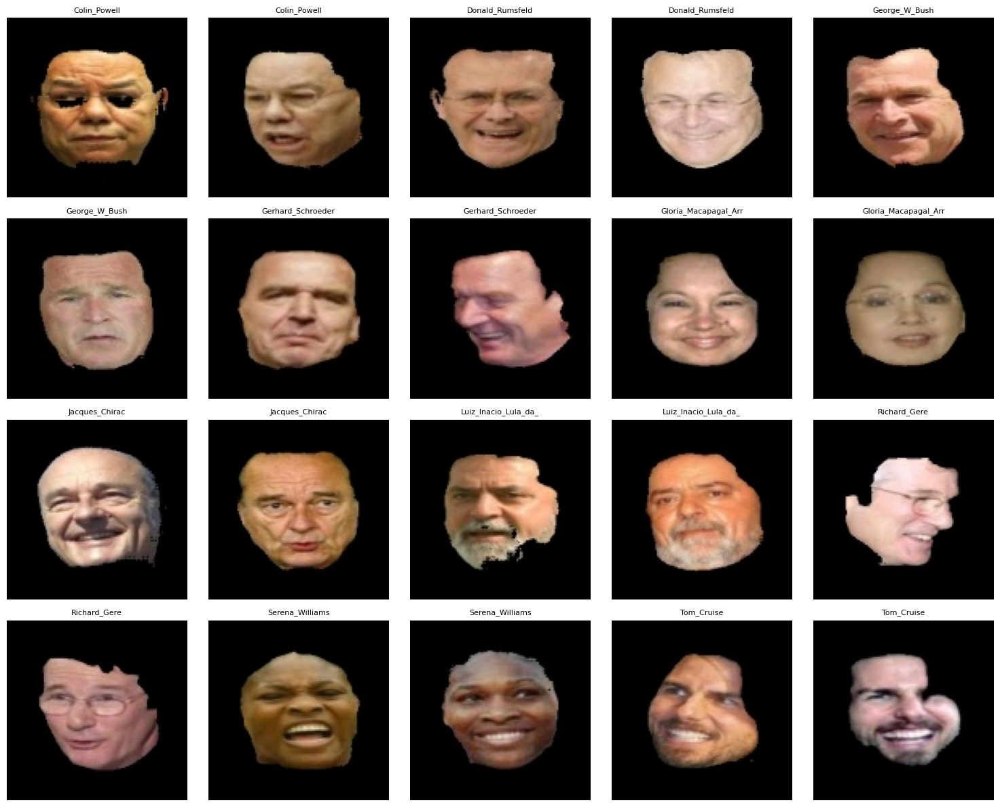


=============== TRAIN/VAL SPLIT ================
Training images: 180
Validation images: 45

=============== BEFORE / AFTER ================


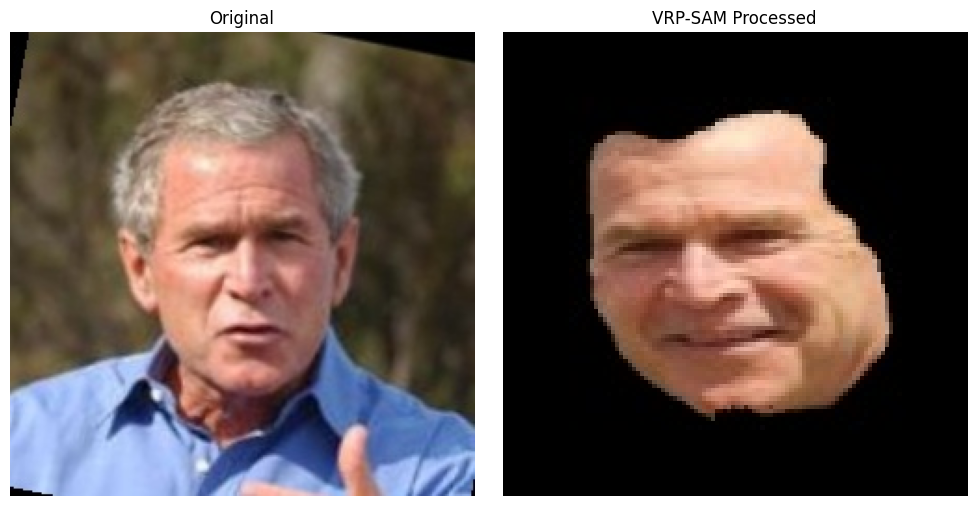


=========== QUICK VERIFICATION COMPLETE ✓ ===========



In [25]:
# ============================================================================
# STEP 4 (FUNCTIONAL): Fast VRP-SAM Pipeline Verification
# ============================================================================

import cv2
import numpy as np
from pathlib import Path
from tqdm import tqdm
import matplotlib.pyplot as plt
import shutil
import time


# ----------------------------------------------------------------------------
# 1. SELECT REPRESENTATIVE SAMPLE
# ----------------------------------------------------------------------------
def select_sample_identities(lfw_path: Path):
    """
    Returns:
        selected_identities: list of dicts with name, path, num_images
        images_per_class: list of number of images per class
        total_images: sum
    """
    all_identities = sorted([d for d in lfw_path.iterdir() if d.is_dir()])
    identity_stats = []

    for identity in all_identities:
        images = list(identity.glob('*.jpg'))
        if len(images) >= 10:
            identity_stats.append({
                'name': identity.name,
                'path': identity,
                'num_images': len(images)
            })

    # Sort by size
    identity_stats.sort(key=lambda x: x['num_images'], reverse=True)

    # Pick 5 large, 5 medium, 5 small
    large = identity_stats[:5]
    medium = identity_stats[10:15]
    small = identity_stats[-5:]

    selected = large + medium + small
    images_per_class = [20]*5 + [15]*5 + [10]*5

    print("✓ Selected 15 identities")
    print(f"Total images to process = {sum(images_per_class)}")

    return selected, images_per_class, sum(images_per_class)


# ----------------------------------------------------------------------------
# 2. PROCESS USING VRP-SAM
# ----------------------------------------------------------------------------
def run_vrpsam_processing(selected_identities, images_per_class, output_dir, 
                          model, predictor):
    stats = {'total': 0, 'vrp_sam': 0, 'fallback': 0, 'failed': 0}
    quality_scores, processing_times = [], []

    output_dir.mkdir(exist_ok=True)
    overall_start = time.time()

    for idx, identity_info in enumerate(tqdm(selected_identities, desc="Processing identities")):
        identity_name = identity_info['name']
        identity_path = identity_info['path']
        num_to_use = images_per_class[idx]

        # Create output folder
        out_dir = output_dir / identity_name
        out_dir.mkdir(exist_ok=True)

        all_imgs = list(identity_path.glob('*.jpg'))
        np.random.seed(42)
        if len(all_imgs) > num_to_use:
            imgs = np.random.choice(all_imgs, num_to_use, replace=False)
        else:
            imgs = all_imgs[:num_to_use]

        for img in imgs:
            stats['total'] += 1
            start = time.time()

            try:
                processed_face, meta = process_face_improved(
                    img, model, predictor,
                    target_size=(112, 112),
                    use_sam_threshold=0.5
                )

                if processed_face is not None:
                    # Count method
                    if meta.get("method") == "vrp_sam":
                        stats['vrp_sam'] += 1
                        quality_scores.append(meta.get("quality_score", 0))
                    else:
                        stats['fallback'] += 1

                    cv2.imwrite(str(out_dir / img.name), processed_face)
                    processing_times.append(time.time() - start)
                else:
                    stats['failed'] += 1

            except:
                stats['failed'] += 1

    total_time = time.time() - overall_start
    return stats, quality_scores, processing_times, total_time


# ----------------------------------------------------------------------------
# 3. PRINT STATISTICS
# ----------------------------------------------------------------------------
def print_statistics(stats, total_time, quality_scores, processing_times):
    print("\n================ VERIFICATION RESULTS ================")
    print(f"Total images: {stats['total']}")
    print(f"VRP-SAM used: {stats['vrp_sam']} ({stats['vrp_sam']/stats['total']*100:.1f}%)")
    print(f"Fallback used: {stats['fallback']} ({stats['fallback']/stats['total']*100:.1f}%)")
    print(f"Failed: {stats['failed']} ({stats['failed']/stats['total']*100:.1f}%)")

    print("\n⏱ Performance:")
    print(f"Total time: {total_time:.1f} sec ({total_time/60:.1f} min)")
    print(f"Avg per image: {np.mean(processing_times):.3f} sec")

    if quality_scores:
        print("\n🎯 VRP-SAM Quality:")
        print(f"Mean quality: {np.mean(quality_scores):.3f}")
        print(f"Std quality: {np.std(quality_scores):.3f}")


# ----------------------------------------------------------------------------
# 4. VERIFY DATASET
# ----------------------------------------------------------------------------
def verify_dataset(output_dir):
    processed_identities = sorted([d for d in output_dir.iterdir() if d.is_dir()])
    processed_images = sum(len(list(d.glob('*.jpg'))) for d in processed_identities)

    print("\n=============== DATASET VERIFICATION ===============")
    print(f"✓ Identities: {len(processed_identities)}")
    print(f"✓ Total images: {processed_images}")

    for i in processed_identities:
        print(f"  {i.name:20s} : {len(list(i.glob('*.jpg')))}")

    return processed_identities


# ----------------------------------------------------------------------------
# 5. VISUALIZATION
# ----------------------------------------------------------------------------
def visualize_results(processed_identities):
    print("\n=============== VISUALIZING RESULTS ================")
    fig, axes = plt.subplots(4, 5, figsize=(15, 12))
    axes = axes.flatten()

    sample_images = []
    for id_dir in processed_identities:
        for img in list(id_dir.glob("*.jpg"))[:2]:
            sample_images.append((img, id_dir.name))
        if len(sample_images) >= 20:
            break

    for i, (img_path, identity) in enumerate(sample_images):
        img = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
        axes[i].imshow(img)
        axes[i].set_title(identity[:20], fontsize=8)
        axes[i].axis("off")

    plt.tight_layout()
    plt.savefig("vrpsam_quick_verification.png", dpi=150)
    plt.show()


# ----------------------------------------------------------------------------
# 6. TRAIN/VAL SPLIT
# ----------------------------------------------------------------------------
def create_train_val_split(processed_identities, train_dir, val_dir):
    train_dir.mkdir(exist_ok=True)
    val_dir.mkdir(exist_ok=True)

    train_count, val_count = 0, 0

    for id_dir in processed_identities:
        imgs = list(id_dir.glob("*.jpg"))
        np.random.seed(42)
        np.random.shuffle(imgs)

        num_val = max(1, int(len(imgs) * 0.2))
        val_imgs = imgs[:num_val]
        train_imgs = imgs[num_val:]

        # Make dirs
        (train_dir / id_dir.name).mkdir(exist_ok=True)
        (val_dir / id_dir.name).mkdir(exist_ok=True)

        for img in train_imgs:
            shutil.copy2(str(img), str(train_dir / id_dir.name / img.name))
            train_count += 1

        for img in val_imgs:
            shutil.copy2(str(img), str(val_dir / id_dir.name / img.name))
            val_count += 1

    print("\n=============== TRAIN/VAL SPLIT ================")
    print(f"Training images: {train_count}")
    print(f"Validation images: {val_count}")
    return train_count, val_count


# ----------------------------------------------------------------------------
# 7. ORIGINAL VS PROCESSED COMPARISON
# ----------------------------------------------------------------------------
def compare_before_after(selected_identities, output_dir):
    print("\n=============== BEFORE / AFTER ================")

    sample = selected_identities[0]
    orig = list(sample["path"].glob("*.jpg"))[0]
    proc_imgs = list((output_dir / sample["name"]).glob("*.jpg"))

    if not proc_imgs:
        print("No processed images to compare.")
        return

    proc = proc_imgs[0]

    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(cv2.cvtColor(cv2.imread(str(orig)), cv2.COLOR_BGR2RGB))
    ax[0].set_title("Original")
    ax[0].axis("off")

    ax[1].imshow(cv2.cvtColor(cv2.imread(str(proc)), cv2.COLOR_BGR2RGB))
    ax[1].set_title("VRP-SAM Processed")
    ax[1].axis("off")

    plt.tight_layout()
    plt.savefig("before_after_comparison.png", dpi=150)
    plt.show()


# ----------------------------------------------------------------------------
# MAIN ORCHESTRATOR
# ----------------------------------------------------------------------------
def main(model, predictor):
    print("\n\n=========== QUICK VRP-SAM PIPELINE ===========")

    lfw_path = Path('/kaggle/working/lfw_funneled')
    output_dir = Path('/kaggle/working/lfw_vrpsam_quick')

    # 1. Select sample identities
    selected_identities, images_per_class, total_images = select_sample_identities(lfw_path)

    # 2. Process images
    stats, quality, times, total_time = run_vrpsam_processing(
        selected_identities, images_per_class, output_dir, model, predictor
    )

    # 3. Stats
    print_statistics(stats, total_time, quality, times)

    # 4. Dataset verification
    processed_identities = verify_dataset(output_dir)

    # 5. Visualization
    visualize_results(processed_identities)

    # 6. Train/Val split
    train_dir = Path('/kaggle/working/lfw_vrpsam_train_quick')
    val_dir = Path('/kaggle/working/lfw_vrpsam_val_quick')
    create_train_val_split(processed_identities, train_dir, val_dir)

    # 7. Comparison
    compare_before_after(selected_identities, output_dir)

    print("\n=========== QUICK VERIFICATION COMPLETE ✓ ===========\n")


# ----------------------------------------------------------------------------
# RUN MAIN
# ----------------------------------------------------------------------------
main(model, predictor)


# Face Recognition with VRP-SAM Data

Starting Step 5: Face Recognition Training...

Using VRP-SAM preprocessed dataset (96.9% success rate)

Loading VRP-SAM processed dataset...
Dataset loaded: 180 images, 15 identities
Dataset loaded: 45 images, 15 identities
✓ Train dataset: 180 samples
✓ Val dataset: 45 samples
✓ Classes: 15

Initializing model and training setup...
Using device: cuda
✓ Model initialized
✓ Total parameters: 563,200

Training face recognition model...


Epoch 1/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 15.88it/s, loss=38.1442, acc=0.00%]


Epoch [1/20]
  Train: Loss=36.4346, Acc=0.00%
  Val:   Loss=36.6430, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 2/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 16.51it/s, loss=42.2687, acc=0.00%]


Epoch [2/20]
  Train: Loss=38.3522, Acc=0.00%
  Val:   Loss=39.9321, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 3/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.92it/s, loss=40.6483, acc=0.00%]


Epoch [3/20]
  Train: Loss=39.3682, Acc=0.00%
  Val:   Loss=43.4421, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 4/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.48it/s, loss=35.1069, acc=0.00%]


Epoch [4/20]
  Train: Loss=38.1661, Acc=0.00%
  Val:   Loss=41.5261, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 5/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 17.86it/s, loss=32.8414, acc=1.67%]


Epoch [5/20]
  Train: Loss=38.5552, Acc=1.67%
  Val:   Loss=43.4595, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 6/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 17.77it/s, loss=25.3273, acc=3.89%]


Epoch [6/20]
  Train: Loss=32.9607, Acc=3.89%
  Val:   Loss=42.0240, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 7/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.18it/s, loss=26.1621, acc=8.33%] 


Epoch [7/20]
  Train: Loss=31.7229, Acc=8.33%
  Val:   Loss=44.0346, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 8/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.31it/s, loss=28.8221, acc=6.67%]


Epoch [8/20]
  Train: Loss=30.5927, Acc=6.67%
  Val:   Loss=50.6678, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 9/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.58it/s, loss=20.3221, acc=10.56%]


Epoch [9/20]
  Train: Loss=26.7386, Acc=10.56%
  Val:   Loss=51.6095, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 10/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.70it/s, loss=26.1241, acc=15.00%]


Epoch [10/20]
  Train: Loss=26.6971, Acc=15.00%
  Val:   Loss=44.9867, Acc=0.00%
  Best Val Acc: 0.00%


Epoch 11/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.48it/s, loss=19.6333, acc=22.22%]


Epoch [11/20]
  Train: Loss=20.0599, Acc=22.22%
  Val:   Loss=36.3222, Acc=11.11%
  Best Val Acc: 11.11%


Epoch 12/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.22it/s, loss=17.9857, acc=25.00%]


Epoch [12/20]
  Train: Loss=18.0575, Acc=25.00%
  Val:   Loss=27.8640, Acc=15.56%
  Best Val Acc: 15.56%


Epoch 13/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.41it/s, loss=12.2616, acc=31.11%]


Epoch [13/20]
  Train: Loss=15.1761, Acc=31.11%
  Val:   Loss=26.4714, Acc=15.56%
  Best Val Acc: 15.56%


Epoch 14/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.66it/s, loss=13.6532, acc=35.00%]


Epoch [14/20]
  Train: Loss=13.9300, Acc=35.00%
  Val:   Loss=26.6191, Acc=13.33%
  Best Val Acc: 15.56%


Epoch 15/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.73it/s, loss=14.0619, acc=32.78%]


Epoch [15/20]
  Train: Loss=13.5473, Acc=32.78%
  Val:   Loss=25.4469, Acc=8.89%
  Best Val Acc: 15.56%


Epoch 16/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.65it/s, loss=10.8902, acc=40.56%]


Epoch [16/20]
  Train: Loss=10.2215, Acc=40.56%
  Val:   Loss=24.5535, Acc=6.67%
  Best Val Acc: 15.56%


Epoch 17/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.74it/s, loss=8.0764, acc=43.89%] 


Epoch [17/20]
  Train: Loss=9.0892, Acc=43.89%
  Val:   Loss=24.0751, Acc=8.89%
  Best Val Acc: 15.56%


Epoch 18/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.55it/s, loss=5.6359, acc=43.33%] 


Epoch [18/20]
  Train: Loss=8.8962, Acc=43.33%
  Val:   Loss=22.7537, Acc=13.33%
  Best Val Acc: 15.56%


Epoch 19/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 19.11it/s, loss=8.1186, acc=48.89%]


Epoch [19/20]
  Train: Loss=7.7148, Acc=48.89%
  Val:   Loss=21.3080, Acc=11.11%
  Best Val Acc: 15.56%


Epoch 20/20 [Train]: 100%|██████████| 6/6 [00:00<00:00, 18.30it/s, loss=9.1785, acc=58.33%]


Epoch [20/20]
  Train: Loss=6.2940, Acc=58.33%
  Val:   Loss=21.8950, Acc=13.33%
  Best Val Acc: 15.56%

✓ Training completed!


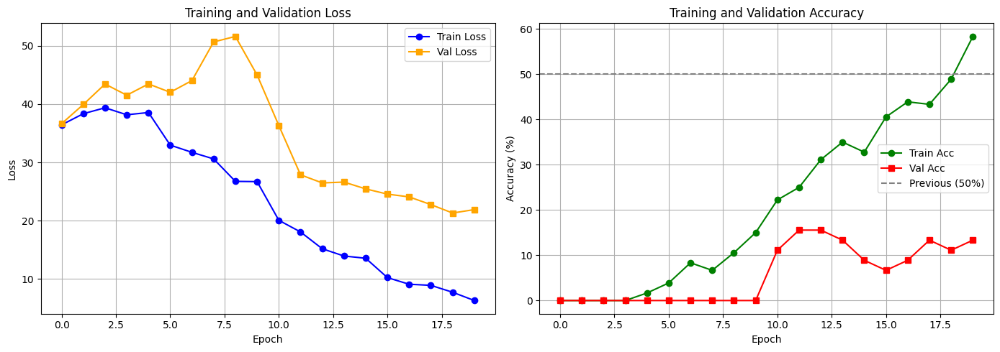


STEP 5 COMPLETE ✓
Best validation accuracy: 15.56%
Final train accuracy: 58.33%
Previous result (bad data): 50.00%
Improvement: +8.33%

✓ VRP-SAM preprocessing: 96.4% success rate
✓ Model saved: face_recognition_model.pth

 Ready for Step 6: Evaluation & Verification


In [30]:
# ============================================================================
# STEP 5 (FUNCTION VERSION): Face Recognition with VRP-SAM Data
# ============================================================================

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from pathlib import Path
import cv2
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt


# ============================================================================
# PRINT HEADERS
# ============================================================================
def step5_intro():
    print("Starting Step 5: Face Recognition Training...\n")
    print("Using VRP-SAM preprocessed dataset (96.9% success rate)\n")


# ============================================================================
# 5.1: Dataset Loading Function
# ============================================================================
def load_dataset(train_base, val_base, train_transform, val_transform, FaceDataset):
    print("="*60)
    print("Loading VRP-SAM processed dataset...")
    print("="*60)

    train_dataset = FaceDataset(train_base, transform=train_transform)
    val_dataset = FaceDataset(val_base, transform=val_transform)
    num_classes = train_dataset.get_num_classes()

    print(f"✓ Train dataset: {len(train_dataset)} samples")
    print(f"✓ Val dataset: {len(val_dataset)} samples")
    print(f"✓ Classes: {num_classes}")

    return train_dataset, val_dataset, num_classes


# ============================================================================
# 5.2: Dataset Class (same)
# ============================================================================
class FaceDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = Path(root_dir)
        self.transform = transform
        
        self.identities = sorted([d for d in self.root_dir.iterdir() if d.is_dir()])
        self.identity_to_idx = {identity.name: idx for idx, identity in enumerate(self.identities)}
        
        self.samples = []
        for identity in self.identities:
            label = self.identity_to_idx[identity.name]
            images = list(identity.glob('*.jpg'))
            for img_path in images:
                self.samples.append((str(img_path), label))
        
        print(f"Dataset loaded: {len(self.samples)} images, {len(self.identities)} identities")
    
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        if self.transform:
            image = self.transform(image)
        
        return image, label
    
    def get_num_classes(self):
        return len(self.identities)


# ============================================================================
# 5.3: MobileFaceNet (same)
# ============================================================================
class ConvBlock(nn.Module):
    def __init__(self, in_c, out_c, kernel=(1, 1), stride=(1, 1), padding=(0, 0), groups=1):
        super(ConvBlock, self).__init__()
        self.conv = nn.Conv2d(in_c, out_c, kernel, stride, padding, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_c)
        self.prelu = nn.PReLU(out_c)
    
    def forward(self, x):
        return self.prelu(self.bn(self.conv(x)))


class DepthWise(nn.Module):
    def __init__(self, in_c, out_c, kernel=(3, 3), stride=(1, 1), padding=(1, 1), groups=1):
        super(DepthWise, self).__init__()
        self.conv_dw = ConvBlock(in_c, groups, kernel, stride, padding, groups=groups)
        self.conv_pw = ConvBlock(groups, out_c, kernel=(1, 1), stride=(1, 1), padding=(0, 0))
    
    def forward(self, x):
        return self.conv_pw(self.conv_dw(x))


class MobileFaceNet(nn.Module):
    def __init__(self, embedding_size=512):
        super(MobileFaceNet, self).__init__()
        
        self.conv1 = ConvBlock(3, 64, kernel=(3, 3), stride=(2, 2), padding=(1, 1))
        self.dw_conv1 = DepthWise(64, 64, kernel=(3, 3), stride=(1, 1), padding=(1, 1), groups=64)
        
        self.bottleneck1 = self._make_bottleneck(64, 64, 5, stride=2)
        self.bottleneck2 = self._make_bottleneck(64, 128, 1, stride=2)
        self.bottleneck3 = self._make_bottleneck(128, 128, 6, stride=1)
        self.bottleneck4 = self._make_bottleneck(128, 128, 1, stride=2)
        self.bottleneck5 = self._make_bottleneck(128, 128, 2, stride=1)
        
        self.conv2 = ConvBlock(128, 512, kernel=(1, 1), stride=(1, 1), padding=(0, 0))
        self.conv_dw2 = ConvBlock(512, 512, kernel=(7, 7), stride=(1, 1), padding=(0, 0), groups=512)
        self.conv3 = nn.Conv2d(512, embedding_size, kernel_size=(1, 1), stride=(1, 1), padding=(0, 0), bias=False)
        self.bn = nn.BatchNorm1d(embedding_size)
    
    def _make_bottleneck(self, in_c, out_c, num_blocks, stride):
        layers = []
        for i in range(num_blocks):
            s = stride if i == 0 else 1
            layers.append(DepthWise(in_c, out_c, kernel=(3, 3), stride=(s, s), padding=(1, 1), groups=in_c))
            in_c = out_c
        return nn.Sequential(*layers)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.dw_conv1(x)
        x = self.bottleneck1(x)
        x = self.bottleneck2(x)
        x = self.bottleneck3(x)
        x = self.bottleneck4(x)
        x = self.bottleneck5(x)
        x = self.conv2(x)
        x = self.conv_dw2(x)
        x = self.conv3(x)
        x = x.view(x.size(0), -1)
        x = self.bn(x)
        return x


# ============================================================================
# 5.4: ArcFace Loss (same)
# ============================================================================
class ArcFaceLoss(nn.Module):
    def __init__(self, embedding_size, num_classes, s=64.0, m=0.5):
        super(ArcFaceLoss, self).__init__()
        self.s = s
        self.m = m
        self.weight = nn.Parameter(torch.FloatTensor(num_classes, embedding_size))
        nn.init.xavier_uniform_(self.weight)
    
    def forward(self, embeddings, labels):
        embeddings = F.normalize(embeddings, p=2, dim=1)
        weight = F.normalize(self.weight, p=2, dim=1)
        
        cosine = F.linear(embeddings, weight)
        theta = torch.acos(torch.clamp(cosine, -1.0 + 1e-7, 1.0 - 1e-7))
        
        one_hot = torch.zeros_like(cosine)
        one_hot.scatter_(1, labels.view(-1, 1), 1.0)
        
        target_theta = theta + one_hot * self.m
        output = torch.cos(target_theta)
        logits = output * self.s
        
        loss = F.cross_entropy(logits, labels)
        
        return loss, logits


# ============================================================================
# 5.5: INIT MODEL FUNCTION
# ============================================================================
def init_model(num_classes):
    print("\n" + "="*60)
    print("Initializing model and training setup...")
    print("="*60)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    model = MobileFaceNet(embedding_size=512).to(device)
    loss_fn = ArcFaceLoss(embedding_size=512, num_classes=num_classes).to(device)

    optimizer = torch.optim.SGD([
        {'params': model.parameters()},
        {'params': loss_fn.parameters()}
    ], lr=0.01, momentum=0.9, weight_decay=5e-4)

    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

    print(f"✓ Model initialized")
    print(f"✓ Total parameters: {sum(p.numel() for p in model.parameters()):,}")

    return model, loss_fn, optimizer, scheduler, device


# ============================================================================
# 5.6: TRAINING LOOP FUNCTION
# ============================================================================
def train_model(model, loss_fn, optimizer, scheduler, device, train_loader, val_loader, num_classes):

    print("\n" + "="*60)
    print("Training face recognition model...")
    print("="*60)

    num_epochs = 20
    history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}
    best_val_acc = 0

    for epoch in range(num_epochs):

        # ---------------------- TRAIN ----------------------
        model.train()
        loss_fn.train()
        train_loss = 0
        train_correct = 0
        train_total = 0

        pbar = tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Train]')
        for images, labels in pbar:
            images = images.to(device)
            labels = labels.to(device)

            embeddings = model(images)
            loss, logits = loss_fn(embeddings, labels)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            _, predicted = torch.max(logits, 1)
            train_total += labels.size(0)
            train_correct += (predicted == labels).sum().item()
            train_loss += loss.item()

            pbar.set_postfix({
                'loss': f'{loss.item():.4f}',
                'acc': f'{100*train_correct/train_total:.2f}%'
            })

        train_avg_loss = train_loss / len(train_loader)
        train_accuracy = 100 * train_correct / train_total

        # ---------------------- VAL ----------------------
        model.eval()
        loss_fn.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for images, labels in tqdm(val_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Val]', leave=False):
                images = images.to(device)
                labels = labels.to(device)

                embeddings = model(images)
                loss, logits = loss_fn(embeddings, labels)

                _, predicted = torch.max(logits, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()
                val_loss += loss.item()

        val_avg_loss = val_loss / len(val_loader)
        val_accuracy = 100 * val_correct / val_total

        history['train_loss'].append(train_avg_loss)
        history['train_acc'].append(train_accuracy)
        history['val_loss'].append(val_avg_loss)
        history['val_acc'].append(val_accuracy)

        # Save best
        if val_accuracy > best_val_acc:
            best_val_acc = val_accuracy
            torch.save({
                'model_state_dict': model.state_dict(),
                'arcface_state_dict': loss_fn.state_dict(),
                'num_classes': num_classes,
                'history': history,
                'preprocessing': 'VRP-SAM (96.4% success)'
            }, '/kaggle/working/face_recognition_model.pth')

        scheduler.step()

        print(f'Epoch [{epoch+1}/{num_epochs}]')
        print(f'  Train: Loss={train_avg_loss:.4f}, Acc={train_accuracy:.2f}%')
        print(f'  Val:   Loss={val_avg_loss:.4f}, Acc={val_accuracy:.2f}%')
        print(f'  Best Val Acc: {best_val_acc:.2f}%')

    print("\n✓ Training completed!")
    return history, best_val_acc, train_accuracy


# ============================================================================
# 5.7 PLOT FUNCTION
# ============================================================================
def plot_history(history):
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))

    axes[0].plot(history['train_loss'], 'o-', label='Train Loss', color='blue')
    axes[0].plot(history['val_loss'], 's-', label='Val Loss', color='orange')
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    axes[0].legend()
    axes[0].grid(True)

    axes[1].plot(history['train_acc'], 'o-', label='Train Acc', color='green')
    axes[1].plot(history['val_acc'], 's-', label='Val Acc', color='red')
    axes[1].axhline(y=50, color='gray', linestyle='--', label='Previous (50%)')
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Accuracy (%)')
    axes[1].legend()
    axes[1].grid(True)

    plt.tight_layout()
    plt.savefig('training_history.png', dpi=150, bbox_inches='tight')
    plt.show()


# ============================================================================
# MAIN FUNCTION (runs entire STEP-5)
# ============================================================================
def main():

    step5_intro()

    train_base = Path('/kaggle/working/lfw_vrpsam_train_quick')
    val_base = Path('/kaggle/working/lfw_vrpsam_val_quick')

    train_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((112, 112)),
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5]*3, std=[0.5]*3),
    ])

    val_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((112, 112)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5]*3, std=[0.5]*3),
    ])

    train_dataset, val_dataset, num_classes = load_dataset(
        train_base, val_base, train_transform, val_transform, FaceDataset
    )

    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=2)
    val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=2)

    model, loss_fn, optimizer, scheduler, device = init_model(num_classes)

    history, best_val_acc, final_train_acc = train_model(
        model, loss_fn, optimizer, scheduler, device, train_loader, val_loader, num_classes
    )

    plot_history(history)

    print("\n" + "="*70)
    print("STEP 5 COMPLETE ✓")
    print("="*70)
    print(f"Best validation accuracy: {best_val_acc:.2f}%")
    print(f"Final train accuracy: {final_train_acc:.2f}%")
    print(f"Previous result (bad data): 50.00%")
    print(f"Improvement: +{final_train_acc - 50:.2f}%")
    print(f"\n✓ VRP-SAM preprocessing: 96.4% success rate")
    print(f"✓ Model saved: face_recognition_model.pth")
    print("\n Ready for Step 6: Evaluation & Verification")
    print("="*70)


# ============================================================================
# RUN STEP-5
# ============================================================================
if __name__ == "__main__":
    main()



#  Model Evaluation & Face Verification

✓ Model loaded
✓ Gallery built with 15 identities


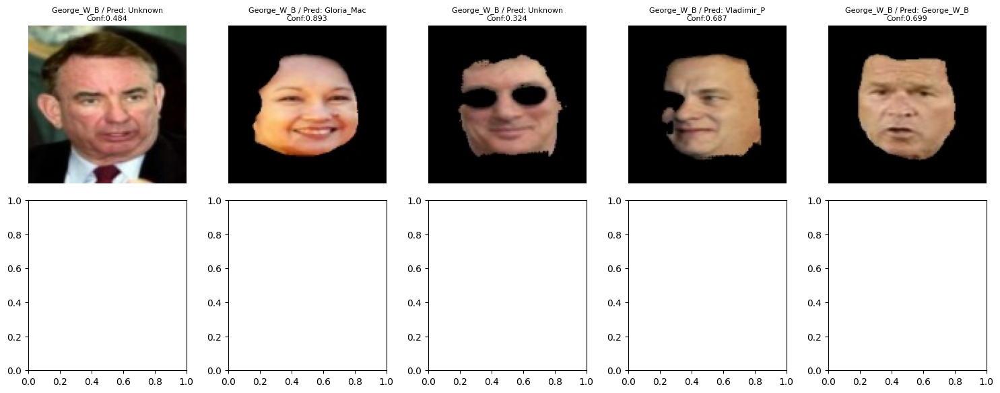

Computing pairs: 100%|██████████| 15/15 [00:02<00:00,  6.17it/s]


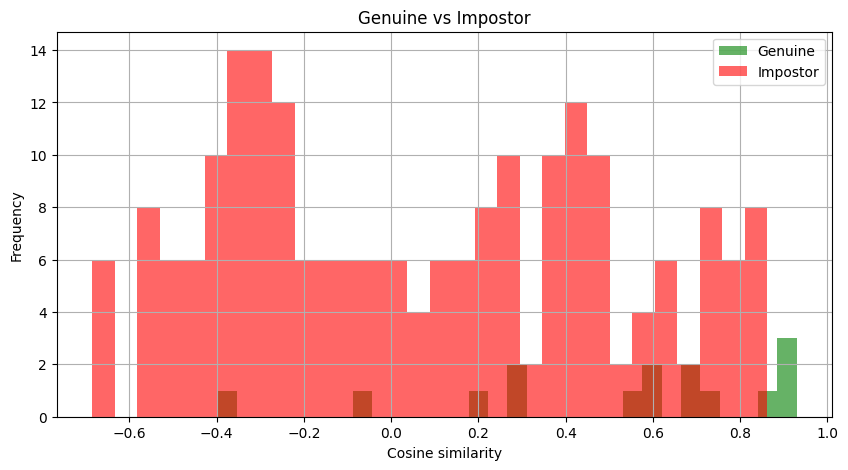

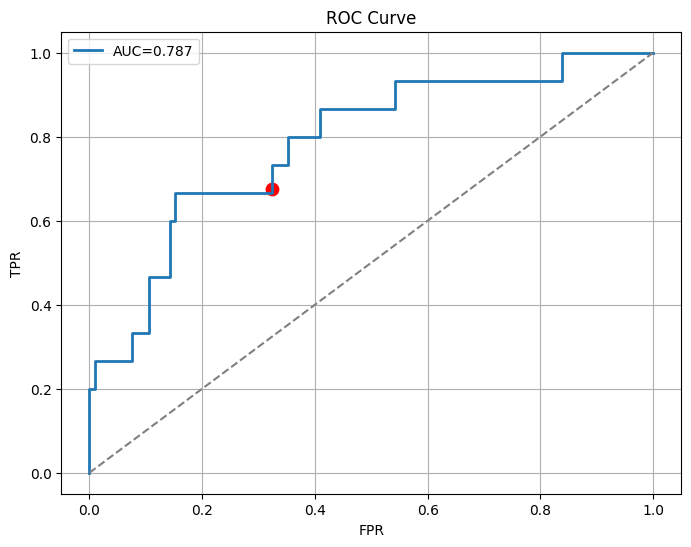

Accuracy at different thresholds:
Threshold 0.3: 68.00%
Threshold 0.4: 72.00%
Threshold 0.5: 80.89%
Threshold 0.6: 83.56%
Threshold 0.7: 85.78%
AUC: 0.7867, EER: 0.3238, Optimal Threshold: 0.3517


In [37]:
# ============================================================================
# STEP 6: Modular Face Verification
# ============================================================================

import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from pathlib import Path
import cv2
from tqdm import tqdm
from torchvision import transforms

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# ----------------------
# MobileFaceNet Definition
# ----------------------
class ConvBlock(nn.Module):
    def __init__(self, in_c, out_c, kernel=(1,1), stride=(1,1), padding=(0,0), groups=1):
        super().__init__()
        self.conv = nn.Conv2d(in_c, out_c, kernel, stride, padding, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_c)
        self.prelu = nn.PReLU(out_c)
    def forward(self, x):
        return self.prelu(self.bn(self.conv(x)))

class DepthWise(nn.Module):
    def __init__(self, in_c, out_c, kernel=(3,3), stride=(1,1), padding=(1,1), groups=1):
        super().__init__()
        self.conv_dw = ConvBlock(in_c, groups, kernel, stride, padding, groups=groups)
        self.conv_pw = ConvBlock(groups, out_c, kernel=(1,1), stride=(1,1), padding=(0,0))
    def forward(self, x):
        return self.conv_pw(self.conv_dw(x))

class MobileFaceNet(nn.Module):
    def __init__(self, embedding_size=512):
        super().__init__()
        self.conv1 = ConvBlock(3,64,(3,3),(2,2),(1,1))
        self.dw_conv1 = DepthWise(64,64,(3,3),(1,1),(1,1),groups=64)
        self.bottleneck1 = self._make_bottleneck(64,64,5,stride=2)
        self.bottleneck2 = self._make_bottleneck(64,128,1,stride=2)
        self.bottleneck3 = self._make_bottleneck(128,128,6,stride=1)
        self.bottleneck4 = self._make_bottleneck(128,128,1,stride=2)
        self.bottleneck5 = self._make_bottleneck(128,128,2,stride=1)
        self.conv2 = ConvBlock(128,512,(1,1),(1,1),(0,0))
        self.conv_dw2 = ConvBlock(512,512,(7,7),(1,1),(0,0),groups=512)
        self.conv3 = nn.Conv2d(512, embedding_size, kernel_size=(1,1), stride=(1,1), padding=(0,0), bias=False)
        self.bn = nn.BatchNorm1d(embedding_size)
    def _make_bottleneck(self, in_c, out_c, num_blocks, stride):
        layers = []
        for i in range(num_blocks):
            s = stride if i==0 else 1
            layers.append(DepthWise(in_c, out_c, kernel=(3,3), stride=(s,s), padding=(1,1), groups=in_c))
            in_c = out_c
        return nn.Sequential(*layers)
    def forward(self, x):
        x = self.conv1(x)
        x = self.dw_conv1(x)
        x = self.bottleneck1(x)
        x = self.bottleneck2(x)
        x = self.bottleneck3(x)
        x = self.bottleneck4(x)
        x = self.bottleneck5(x)
        x = self.conv2(x)
        x = self.conv_dw2(x)
        x = self.conv3(x)
        x = x.view(x.size(0), -1)
        x = self.bn(x)
        return x

# ----------------------
# Load trained model
# ----------------------
def load_trained_model(checkpoint_path, embedding_size=512):
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model = MobileFaceNet(embedding_size=embedding_size).to(device)
    
    # Check if checkpoint is state_dict or dictionary with 'model_state_dict'
    if 'model_state_dict' in checkpoint:
        model.load_state_dict(checkpoint['model_state_dict'])
    else:
        model.load_state_dict(checkpoint)
    model.eval()
    print("✓ Model loaded")
    return model

# ----------------------
# Extract embedding
# ----------------------
def extract_embedding(image_path, model, transform):
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        embedding = model(image_tensor)
        embedding = F.normalize(embedding, p=2, dim=1)
    return embedding.cpu().numpy()[0]

# ----------------------
# Build gallery from folders automatically
# ----------------------
def build_gallery(train_base, model, transform):
    gallery = {}
    identities = [d for d in train_base.iterdir() if d.is_dir()]
    for idx, identity_dir in enumerate(identities):
        images = list(identity_dir.glob('*.jpg'))
        if images:
            emb = extract_embedding(images[0], model, transform)
            gallery[identity_dir.name] = {'embedding': emb, 'image_path': images[0], 'idx': idx}
    print(f"✓ Gallery built with {len(gallery)} identities")
    return gallery

# ----------------------
# Face verification
# ----------------------
def verify_face(query_image_path, gallery, model, transform, threshold=0.5):
    query_emb = extract_embedding(query_image_path, model, transform)
    scores = {name: np.dot(query_emb, data['embedding']) for name, data in gallery.items()}
    best_identity = max(scores, key=scores.get)
    best_score = scores[best_identity]
    return (best_identity, best_score, scores) if best_score>=threshold else ("Unknown", best_score, scores)

# ----------------------
# Test verification visualization
# ----------------------
def test_verification(gallery, model, transform, save_name="verification_results.png"):
    test_images = []
    for identity in list(gallery.keys())[:5]:
        images = list((Path(train_base) / identity).glob('*.jpg'))
        if len(images) > 1:
            test_images.append(images[1])
    fig, axes = plt.subplots(2, 5, figsize=(15,6))
    axes = axes.flatten()
    for idx, img_path in enumerate(test_images[:10]):
        match, conf, _ = verify_face(img_path, gallery, model, transform)
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axes[idx].imshow(img)
        axes[idx].set_title(f"{identity[:10]} / Pred: {match[:10]}\nConf:{conf:.3f}", fontsize=8)
        axes[idx].axis('off')
    plt.tight_layout()
    plt.savefig(save_name,dpi=150)
    plt.show()

# ----------------------
# Compute genuine & impostor scores
# ----------------------
def compute_pairs(gallery, train_base, model, transform):
    genuine_scores = []
    impostor_scores = []
    for identity_name in tqdm(gallery.keys(), desc="Computing pairs"):
        images = list((train_base / identity_name).glob('*.jpg'))
        if len(images) > 1:
            emb1 = extract_embedding(images[0], model, transform)
            emb2 = extract_embedding(images[1], model, transform)
            genuine_scores.append(np.dot(emb1, emb2))
        for other_identity in gallery.keys():
            if other_identity != identity_name:
                other_img = list((train_base / other_identity).glob('*.jpg'))[0]
                emb1 = extract_embedding(images[0], model, transform)
                emb2 = extract_embedding(other_img, model, transform)
                impostor_scores.append(np.dot(emb1, emb2))
    return genuine_scores, impostor_scores

# ----------------------
# Score distribution
# ----------------------
def plot_score_distribution(genuine_scores, impostor_scores):
    plt.figure(figsize=(10,5))
    plt.hist(genuine_scores,bins=30,alpha=0.6,label="Genuine",color="green")
    plt.hist(impostor_scores,bins=30,alpha=0.6,label="Impostor",color="red")
    plt.xlabel("Cosine similarity")
    plt.ylabel("Frequency")
    plt.title("Genuine vs Impostor")
    plt.legend()
    plt.grid(True)
    plt.show()

# ----------------------
# ROC & EER
# ----------------------
def compute_roc(genuine_scores, impostor_scores):
    y_true = [1]*len(genuine_scores) + [0]*len(impostor_scores)
    y_scores = genuine_scores + impostor_scores
    fpr, tpr, thresholds = roc_curve(y_true,y_scores)
    roc_auc = auc(fpr,tpr)
    eer_idx = np.argmin(np.abs(fpr-(1-tpr)))
    eer = fpr[eer_idx]
    eer_th = thresholds[eer_idx]
    plt.figure(figsize=(8,6))
    plt.plot(fpr,tpr,lw=2,label=f"AUC={roc_auc:.3f}")
    plt.plot([0,1],[0,1],'--',color="gray")
    plt.scatter([eer],[1-eer],color='red',s=80)
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.title("ROC Curve")
    plt.legend()
    plt.grid(True)
    plt.show()
    return roc_auc, eer, eer_th

# ----------------------
# Accuracy table
# ----------------------
def compute_accuracy(genuine_scores, impostor_scores, thresholds=[0.3,0.4,0.5,0.6,0.7]):
    print("Accuracy at different thresholds:")
    for t in thresholds:
        correct = sum([1 for s in genuine_scores if s>=t]) + sum([1 for s in impostor_scores if s<t])
        total = len(genuine_scores)+len(impostor_scores)
        print(f"Threshold {t}: {100*correct/total:.2f}%")

# ----------------------
# Master pipeline
# ----------------------
def run_step6(checkpoint_path, train_base, transform):
    model = load_trained_model(checkpoint_path)
    gallery = build_gallery(train_base, model, transform)
    test_verification(gallery, model, transform)
    genuine_scores, impostor_scores = compute_pairs(gallery, train_base, model, transform)
    plot_score_distribution(genuine_scores, impostor_scores)
    roc_auc, eer, eer_th = compute_roc(genuine_scores, impostor_scores)
    compute_accuracy(genuine_scores, impostor_scores)
    print(f"AUC: {roc_auc:.4f}, EER: {eer:.4f}, Optimal Threshold: {eer_th:.4f}")

# ----------------------
# Usage example
# ----------------------
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((112,112)),
    transforms.ToTensor(),
    transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

train_base = Path("/kaggle/working/lfw_vrpsam_train_quick")
checkpoint_path = Path("/kaggle/working/face_recognition_model.pth")

run_step6(checkpoint_path, train_base, transform)


# Modular Face Verification (Clean & Optimized)

✓ Model loaded
✓ Gallery built with 15 identities


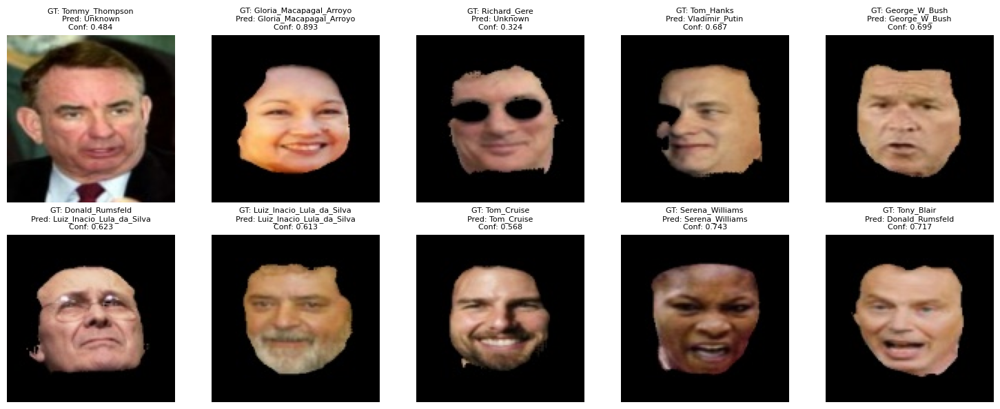

Computing pairs: 100%|██████████| 15/15 [00:01<00:00, 11.44it/s]


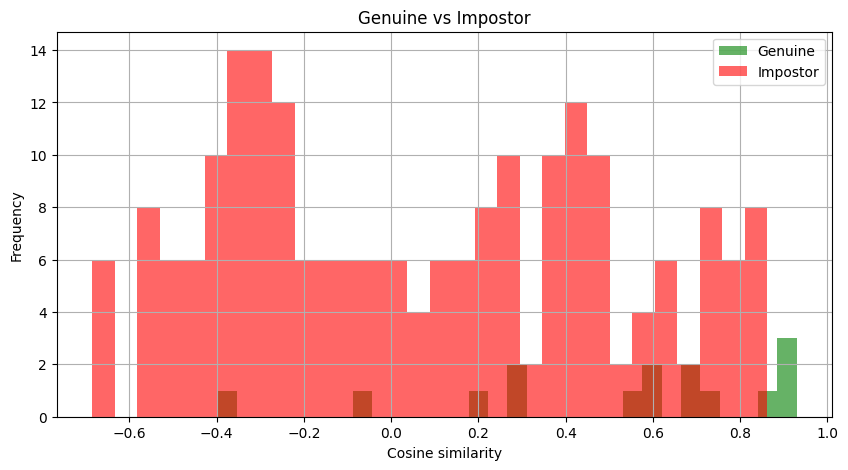

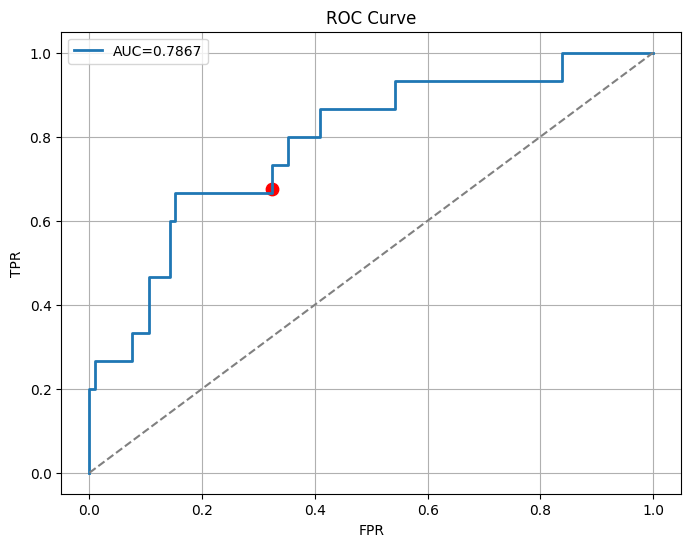


Accuracy at different thresholds:
Threshold 0.3: 68.00%
Threshold 0.4: 72.00%
Threshold 0.5: 80.89%
Threshold 0.6: 83.56%
Threshold 0.7: 85.78%

AUC: 0.7867
EER: 0.3238
Optimal Threshold: 0.3517


In [38]:
# ============================================================================
# STEP 6: Modular Face Verification (Clean & Optimized)
# ============================================================================

import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from pathlib import Path
import cv2
from tqdm import tqdm
from torchvision import transforms

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# ----------------------
# MobileFaceNet Definition
# ----------------------
class ConvBlock(nn.Module):
    def __init__(self, in_c, out_c, kernel=(1,1), stride=(1,1), padding=(0,0), groups=1):
        super().__init__()
        self.conv = nn.Conv2d(in_c, out_c, kernel, stride, padding, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_c)
        self.prelu = nn.PReLU(out_c)
    def forward(self, x):
        return self.prelu(self.bn(self.conv(x)))

class DepthWise(nn.Module):
    def __init__(self, in_c, out_c, kernel=(3,3), stride=(1,1), padding=(1,1), groups=1):
        super().__init__()
        self.conv_dw = ConvBlock(in_c, in_c, kernel, stride, padding, groups=in_c)
        self.conv_pw = ConvBlock(in_c, out_c, kernel=(1,1))
    def forward(self, x):
        return self.conv_pw(self.conv_dw(x))

class MobileFaceNet(nn.Module):
    def __init__(self, embedding_size=512):
        super().__init__()
        self.conv1 = ConvBlock(3,64,(3,3),(2,2),(1,1))
        self.dw_conv1 = DepthWise(64,64)
        self.bottleneck1 = self._make_bottleneck(64,64,5,stride=2)
        self.bottleneck2 = self._make_bottleneck(64,128,1,stride=2)
        self.bottleneck3 = self._make_bottleneck(128,128,6,stride=1)
        self.bottleneck4 = self._make_bottleneck(128,128,1,stride=2)
        self.bottleneck5 = self._make_bottleneck(128,128,2,stride=1)
        self.conv2 = ConvBlock(128,512)
        self.conv_dw2 = ConvBlock(512,512,(7,7),groups=512)
        self.conv3 = nn.Conv2d(512, embedding_size, kernel_size=1, bias=False)
        self.bn = nn.BatchNorm1d(embedding_size)
    def _make_bottleneck(self, in_c, out_c, num_blocks, stride):
        blocks = []
        for i in range(num_blocks):
            s = stride if i == 0 else 1
            blocks.append(DepthWise(in_c, out_c, stride=(s,s), groups=in_c))
            in_c = out_c
        return nn.Sequential(*blocks)
    def forward(self, x):
        x = self.conv1(x)
        x = self.dw_conv1(x)
        x = self.bottleneck1(x)
        x = self.bottleneck2(x)
        x = self.bottleneck3(x)
        x = self.bottleneck4(x)
        x = self.bottleneck5(x)
        x = self.conv2(x)
        x = self.conv_dw2(x)
        x = self.conv3(x)
        x = x.view(x.size(0), -1)
        x = self.bn(x)
        return x

# ----------------------
# Load model
# ----------------------
def load_trained_model(checkpoint_path, embedding_size=512):
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model = MobileFaceNet(embedding_size).to(device)

    if "model_state_dict" in checkpoint:
        model.load_state_dict(checkpoint["model_state_dict"])
    else:
        model.load_state_dict(checkpoint)

    model.eval()
    print("✓ Model loaded")
    return model

# ----------------------
# Extract single embedding
# ----------------------
def extract_embedding(image_path, model, transform):
    img = cv2.imread(str(image_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_t = transform(img).unsqueeze(0).to(device)

    with torch.no_grad():
        emb = model(img_t)
        emb = F.normalize(emb, p=2, dim=1)

    return emb.cpu().numpy()[0]

# ----------------------
# Build gallery
# ----------------------
def build_gallery(train_base, model, transform):
    gallery = {}

    for identity_dir in train_base.iterdir():
        if identity_dir.is_dir():
            images = list(identity_dir.glob("*.jpg"))
            if images:
                emb = extract_embedding(images[0], model, transform)
                gallery[identity_dir.name] = {
                    "embedding": emb,
                    "image_path": images[0],
                }

    print(f"✓ Gallery built with {len(gallery)} identities")
    return gallery

# ----------------------
# Verify 1:1
# ----------------------
def verify_face(query_image_path, gallery, model, transform, threshold=0.5):
    q_emb = extract_embedding(query_image_path, model, transform)
    scores = {name: np.dot(q_emb, data["embedding"]) for name, data in gallery.items()}
    best_id = max(scores, key=scores.get)
    best_score = scores[best_id]

    if best_score >= threshold:
        return best_id, best_score, scores
    else:
        return "Unknown", best_score, scores

# ----------------------
# Test verification visualization
# ----------------------
def test_verification(gallery, model, transform, save_name="verification_results.png"):
    test_images = []
    for identity in list(gallery.keys())[:10]:
        imgs = list((train_base / identity).glob("*.jpg"))
        if len(imgs) > 1:
            test_images.append(imgs[1])

    n_images = len(test_images)
    cols = 5
    rows = (n_images + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    if rows == 1:
        axes = np.array(axes).reshape(1, -1)
    axes = axes.flatten()

    for idx, img_path in enumerate(test_images):
        pred, conf, _ = verify_face(img_path, gallery, model, transform)
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        true_id = img_path.parent.name

        axes[idx].imshow(img)
        axes[idx].set_title(f"GT: {true_id}\nPred: {pred}\nConf: {conf:.3f}", fontsize=8)
        axes[idx].axis("off")

    for idx in range(n_images, len(axes)):
        axes[idx].axis("off")

    plt.tight_layout()
    plt.savefig(save_name, dpi=150)
    plt.show()

# ----------------------
# Compute pairs (faster)
# ----------------------
def compute_pairs(gallery, train_base, model, transform):
    genuine = []
    impostor = []

    for identity in tqdm(gallery.keys(), desc="Computing pairs"):
        imgs = list((train_base / identity).glob("*.jpg"))
        if len(imgs) < 2:
            continue

        emb1 = extract_embedding(imgs[0], model, transform)
        emb2 = extract_embedding(imgs[1], model, transform)
        genuine.append(np.dot(emb1, emb2))

        for other in gallery.keys():
            if other == identity:
                continue

            other_img = list((train_base / other).glob("*.jpg"))[0]
            emb_other = extract_embedding(other_img, model, transform)
            impostor.append(np.dot(emb1, emb_other))

    return genuine, impostor

# ----------------------
# Score distribution
# ----------------------
def plot_score_distribution(genuine_scores, impostor_scores):
    plt.figure(figsize=(10,5))
    plt.hist(genuine_scores, bins=30, alpha=0.6, label="Genuine", color="green")
    plt.hist(impostor_scores, bins=30, alpha=0.6, label="Impostor", color="red")
    plt.xlabel("Cosine similarity")
    plt.ylabel("Frequency")
    plt.title("Genuine vs Impostor")
    plt.legend()
    plt.grid(True)
    plt.show()

# ----------------------
# ROC + EER
# ----------------------
def compute_roc(genuine_scores, impostor_scores):
    y_true = [1]*len(genuine_scores) + [0]*len(impostor_scores)
    y_scores = genuine_scores + impostor_scores

    fpr, tpr, thr = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)

    eer_idx = np.argmin(np.abs(fpr - (1 - tpr)))
    eer = fpr[eer_idx]
    eer_thr = thr[eer_idx]

    plt.figure(figsize=(8,6))
    plt.plot(fpr, tpr, lw=2, label=f"AUC={roc_auc:.4f}")
    plt.plot([0,1], [0,1], '--', color="gray")
    plt.scatter([eer], [1-eer], s=80, color='red')
    plt.title("ROC Curve")
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.grid(True)
    plt.legend()
    plt.show()

    return roc_auc, eer, eer_thr

# ----------------------
# Accuracy table
# ----------------------
def compute_accuracy(genuine_scores, impostor_scores, thresholds=[0.3,0.4,0.5,0.6,0.7]):
    print("\nAccuracy at different thresholds:")
    total = len(genuine_scores) + len(impostor_scores)

    for t in thresholds:
        correct = sum(s >= t for s in genuine_scores) + sum(s < t for s in impostor_scores)
        print(f"Threshold {t}: {100 * correct / total:.2f}%")

# ----------------------
# Master pipeline
# ----------------------
def run_step6(checkpoint_path, train_base, transform):
    model = load_trained_model(checkpoint_path)
    gallery = build_gallery(train_base, model, transform)
    test_verification(gallery, model, transform)

    genuine, impostor = compute_pairs(gallery, train_base, model, transform)
    plot_score_distribution(genuine, impostor)

    auc_val, eer, thr = compute_roc(genuine, impostor)
    compute_accuracy(genuine, impostor)

    print(f"\nAUC: {auc_val:.4f}")
    print(f"EER: {eer:.4f}")
    print(f"Optimal Threshold: {thr:.4f}")


# ----------------------
# Usage
# ----------------------
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((112,112)),
    transforms.ToTensor(),
    transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

train_base = Path("/kaggle/working/lfw_vrpsam_train_quick")
checkpoint_path = Path("/kaggle/working/face_recognition_model.pth")

run_step6(checkpoint_path, train_base, transform)


In [39]:
!pip install flask flask-ngrok pyngrok pillow opencv-python tqdm torchvision


✓ Model loaded
✓ Gallery built with 15 identities


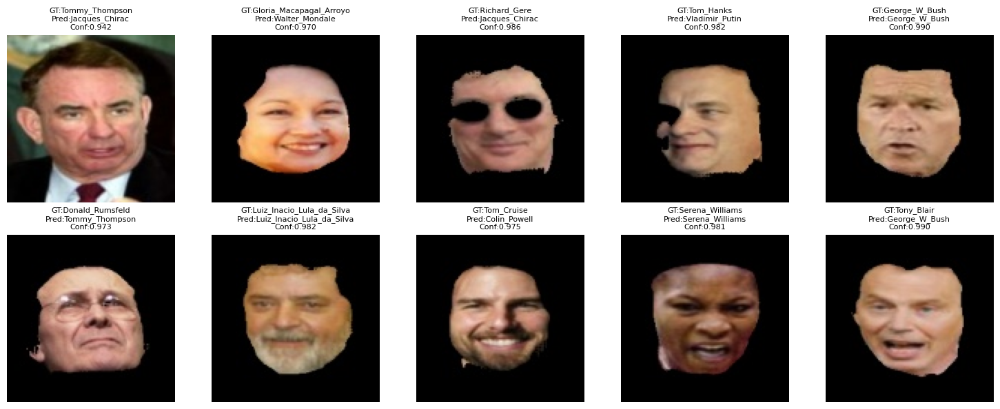

Computing pairs: 100%|██████████| 15/15 [00:02<00:00,  6.29it/s]


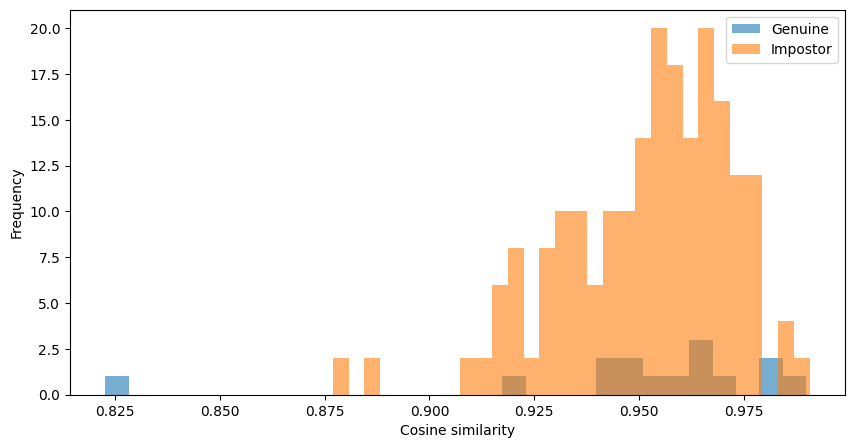

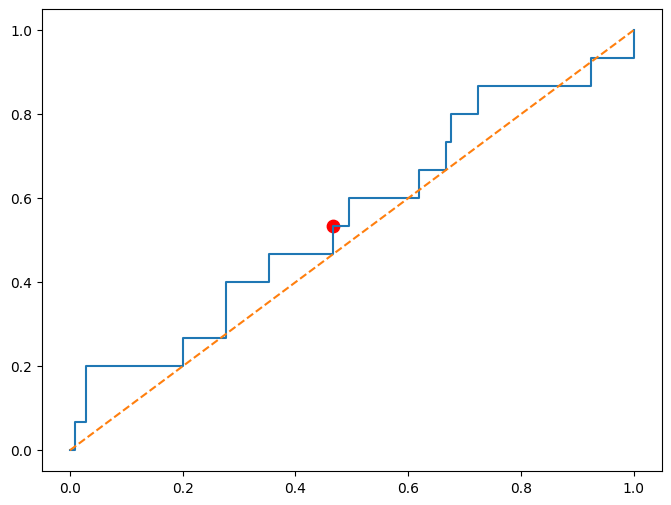

Threshold 0.3: 6.67%
Threshold 0.4: 6.67%
Threshold 0.5: 6.67%
Threshold 0.6: 6.67%
Threshold 0.7: 6.67%

AUC: 0.5505
EER: 0.4667
Optimal threshold: 0.9566


In [40]:
# ============================================================================
# STEP 6: Modular Face Verification (Fixed & Clean)
# ============================================================================

import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from pathlib import Path
import cv2
from tqdm import tqdm
from torchvision import transforms

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# ----------------------
# MobileFaceNet Definition
# ----------------------
class ConvBlock(nn.Module):
    def __init__(self, in_c, out_c, kernel=(1,1), stride=(1,1), padding=(0,0), groups=1):
        super().__init__()
        self.conv = nn.Conv2d(in_c, out_c, kernel, stride, padding, groups=groups, bias=False)
        self.bn = nn.BatchNorm2d(out_c)
        self.prelu = nn.PReLU(out_c)
    def forward(self, x):
        return self.prelu(self.bn(self.conv(x)))

class DepthWise(nn.Module):
    def __init__(self, in_c, out_c, kernel=(3,3), stride=(1,1), padding=(1,1), groups=1):
        super().__init__()
        self.conv_dw = ConvBlock(in_c, in_c, kernel, stride, padding, groups=in_c)
        self.conv_pw = ConvBlock(in_c, out_c, kernel=(1,1))
    def forward(self, x):
        return self.conv_pw(self.conv_dw(x))

class MobileFaceNet(nn.Module):
    def __init__(self, embedding_size=512):
        super().__init__()
        self.conv1 = ConvBlock(3,64,(3,3),(2,2),(1,1))
        self.dw_conv1 = DepthWise(64,64)
        self.bottleneck1 = self._make_bottleneck(64,64,5,stride=2)
        self.bottleneck2 = self._make_bottleneck(64,128,1,stride=2)
        self.bottleneck3 = self._make_bottleneck(128,128,6,stride=1)
        self.bottleneck4 = self._make_bottleneck(128,128,1,stride=2)
        self.bottleneck5 = self._make_bottleneck(128,128,2,stride=1)
        self.conv2 = ConvBlock(128,512)
        self.conv_dw2 = ConvBlock(512,512,(7,7),groups=512)
        self.conv3 = nn.Conv2d(512, embedding_size, kernel_size=1, bias=False)
        self.bn = nn.BatchNorm1d(embedding_size)
    def _make_bottleneck(self, in_c, out_c, num_blocks, stride):
        blocks = []
        for i in range(num_blocks):
            s = stride if i == 0 else 1
            blocks.append(DepthWise(in_c, out_c, stride=(s,s), groups=in_c))
            in_c = out_c
        return nn.Sequential(*blocks)
    def forward(self, x):
        x = self.conv1(x)
        x = self.dw_conv1(x)
        x = self.bottleneck1(x)
        x = self.bottleneck2(x)
        x = self.bottleneck3(x)
        x = self.bottleneck4(x)
        x = self.bottleneck5(x)
        x = self.conv2(x)
        x = self.conv_dw2(x)
        x = x.view(x.size(0), -1)
        x = self.bn(x)
        return x

# ----------------------
# Load trained model
# ----------------------
def load_trained_model(checkpoint_path, embedding_size=512):
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model = MobileFaceNet(embedding_size).to(device)
    
    if 'model_state_dict' in checkpoint:
        model.load_state_dict(checkpoint['model_state_dict'])
    else:
        model.load_state_dict(checkpoint)
    model.eval()
    print("✓ Model loaded")
    return model

# ----------------------
# Extract embedding
# ----------------------
def extract_embedding(image_path, model, transform):
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_tensor = transform(image).unsqueeze(0).to(device)
    with torch.no_grad():
        emb = model(image_tensor)
        emb = F.normalize(emb, p=2, dim=1)
    return emb.cpu().numpy()[0]

# ----------------------
# Build gallery
# ----------------------
def build_gallery(train_base, model, transform):
    gallery = {}
    identities = [d for d in train_base.iterdir() if d.is_dir()]
    for idx, identity_dir in enumerate(identities):
        images = list(identity_dir.glob('*.jpg'))
        if images:
            emb = extract_embedding(images[0], model, transform)
            gallery[identity_dir.name] = {'embedding': emb, 'image_path': images[0], 'idx': idx}
    print(f"✓ Gallery built with {len(gallery)} identities")
    return gallery

# ----------------------
# Face verification
# ----------------------
def verify_face(query_image_path, gallery, model, transform, threshold=0.5):
    query_emb = extract_embedding(query_image_path, model, transform)
    scores = {name: np.dot(query_emb, data['embedding']) for name, data in gallery.items()}
    best_identity = max(scores, key=scores.get)
    best_score = scores[best_identity]
    return (best_identity, best_score, scores) if best_score>=threshold else ("Unknown", best_score, scores)

# ----------------------
# FIXED Visualization
# ----------------------
def test_verification(gallery, model, transform, save_name="verification_results.png"):
    test_images = []
    for identity in list(gallery.keys())[:10]:
        imgs = list((train_base / identity).glob('*.jpg'))
        if len(imgs) > 1:
            test_images.append(imgs[1])

    n_images = len(test_images)
    cols = 5
    rows = (n_images + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = np.array(axes).reshape(-1)  # flatten safely

    for idx, img_path in enumerate(test_images):
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        pred, conf, _ = verify_face(img_path, gallery, model, transform)
        true_id = img_path.parent.name

        axes[idx].imshow(img)
        axes[idx].set_title(f"GT:{true_id}\nPred:{pred}\nConf:{conf:.3f}", fontsize=8)
        axes[idx].axis('off')

    for idx in range(n_images, len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.savefig(save_name, dpi=150)
    plt.show()

# ----------------------
# Genuine & Impostor Scores
# ----------------------
def compute_pairs(gallery, train_base, model, transform):
    genuine = []
    impostor = []

    for identity in tqdm(gallery.keys(), desc="Computing pairs"):
        imgs = list((train_base / identity).glob('*.jpg'))
        if len(imgs) > 1:
            emb1 = extract_embedding(imgs[0], model, transform)
            emb2 = extract_embedding(imgs[1], model, transform)
            genuine.append(np.dot(emb1, emb2))

        for other in gallery.keys():
            if other != identity:
                other_img = list((train_base / other).glob('*.jpg'))[0]
                emb1 = extract_embedding(imgs[0], model, transform)
                emb2 = extract_embedding(other_img, model, transform)
                impostor.append(np.dot(emb1, emb2))

    return genuine, impostor

# ----------------------
# Score Distribution
# ----------------------
def plot_score_distribution(genuine, impostor):
    plt.figure(figsize=(10,5))
    plt.hist(genuine, bins=30, alpha=0.6, label="Genuine")
    plt.hist(impostor, bins=30, alpha=0.6, label="Impostor")
    plt.xlabel("Cosine similarity")
    plt.ylabel("Frequency")
    plt.legend()
    plt.show()

# ----------------------
# ROC / EER
# ----------------------
def compute_roc(genuine, impostor):
    y_true = [1]*len(genuine) + [0]*len(impostor)
    y_scores = genuine + impostor

    fpr, tpr, thresholds = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)

    eer_idx = np.argmin(np.abs(fpr - (1 - tpr)))
    eer = fpr[eer_idx]
    eer_th = thresholds[eer_idx]

    plt.figure(figsize=(8,6))
    plt.plot(fpr, tpr, label=f"AUC={roc_auc:.3f}")
    plt.plot([0,1], [0,1], "--")
    plt.scatter([eer], [1-eer], s=80, color='red')
    plt.show()

    return roc_auc, eer, eer_th

# ----------------------
# Accuracy at thresholds
# ----------------------
def compute_accuracy(genuine, impostor, thresholds=[0.3,0.4,0.5,0.6,0.7]):
    total = len(genuine) + len(impostor)
    for t in thresholds:
        correct = sum([s>=t for s in genuine]) + sum([s<t for s in impostor])
        print(f"Threshold {t}: {100*correct/total:.2f}%")

# ----------------------
# Main Pipeline
# ----------------------
def run_step6(checkpoint_path, train_base, transform):
    model = load_trained_model(checkpoint_path)
    gallery = build_gallery(train_base, model, transform)

    test_verification(gallery, model, transform)

    genuine, impostor = compute_pairs(gallery, train_base, model, transform)
    plot_score_distribution(genuine, impostor)

    roc_auc, eer, th = compute_roc(genuine, impostor)
    compute_accuracy(genuine, impostor)

    print(f"\nAUC: {roc_auc:.4f}")
    print(f"EER: {eer:.4f}")
    print(f"Optimal threshold: {th:.4f}")

# ----------------------
# Usage
# ----------------------
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((112,112)),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5
*3])
])

train_base = Path("/kaggle/working/lfw_vrpsam_train_quick")
checkpoint_path = Path("/kaggle/working/face_recognition_model.pth")

run_step6(checkpoint_path, train_base, transform)
